# Libraries

In [1]:
import numpy as np
import random
import pickle
import os
# Change directory to the root of the folder (this script was launched from the subfolder python_scripts)
# All utils presuppose that we are working from the root directory of the github folder
os.chdir("../")
import sys
# Add utils directory in the list of directories to look for packages to import
sys.path.insert(0, os.path.join(os.getcwd(),'utils'))
from tqdm.notebook import tqdm
import pandas as pd
from datetime import datetime
import joblib
import gzip
from scipy.stats import pearsonr
from scipy.optimize import curve_fit
import matplotlib.pyplot as plt
from matplotlib.legend_handler import HandlerBase
from matplotlib import gridspec
from matplotlib.colors import ListedColormap, Normalize
from matplotlib.cm import ScalarMappable
import matplotlib.ticker
import pingouin as pg
from cycler import cycler
from scipy.stats import gaussian_kde
import copy
from scipy.integrate import odeint
import glob
from sklearn.linear_model import LinearRegression
import csv

from statsmodels.formula.api import ols

/data/home/ahw701/env_enrico/envs/gt/lib/python3.9/site-packages/outdated/utils.py:14: OutdatedPackageWarning: The package outdated is out of date. Your version is 0.2.1, the latest is 0.2.2.
Set the environment variable OUTDATED_IGNORE=1 to disable these warnings.
  return warn(
/data/home/ahw701/env_enrico/envs/gt/lib/python3.9/site-packages/outdated/utils.py:14: OutdatedPackageWarning: The package pingouin is out of date. Your version is 0.5.1, the latest is 0.5.3.
Set the environment variable OUTDATED_IGNORE=1 to disable these warnings.
  return warn(


In [2]:
# local utils
from powerlaw_regr import *
from find_files_with_pattern import *

In [3]:
figures_folder = "./figures/"
os.makedirs(figures_folder, exist_ok = True)

In [4]:
# DEFAULT PARAMETERS IN THE FIGURES TO BE ADJUSTED!!!!

plt.style.use("default")

multiplicator = 4
width_fig = 5.70978 * multiplicator # default text width in Comnet is 5.70978
height_fig = width_fig * 2 / 3

# this comes from "tableau-colorblind10",
CB_color_cycle = ['#006BA4', '#FF800E', '#ABABAB', '#595959',
                 '#5F9ED1', '#C85200', '#898989', '#A2C8EC', '#FFBC79', '#CFCFCF']
# Another good color blind one could be CB_color_cycle = ['#377eb8', '#ff7f00', '#4daf4a',
#                   '#f781bf', '#a65628', '#984ea3',
#                   '#999999', '#e41a1c', '#dede00']
cmap_label = 'cividis'
params_default = {
    # change matplotlib cycle colors
    'axes.prop_cycle' : cycler('color', CB_color_cycle), 
    # change colormap
    'image.cmap' : 'cividis',
    # no upper and right axes
    'axes.spines.right' : False,
    'axes.spines.top' : False,
    # no frame around the legend
    "legend.frameon" : False,

    # dimensions of figures and labels
    # we will play with these once we see how they are rendered in the latex
    'figure.figsize' : (width_fig, height_fig),

    'axes.labelsize' : 6 * multiplicator, #22,
    'axes.titlesize' : 6 * multiplicator, #25,
    'xtick.labelsize' : 5 * multiplicator, #18,
    'ytick.labelsize' : 5 * multiplicator, #18,
    'legend.fontsize' : 6 * multiplicator, #16,
    'font.size' : 6 * multiplicator,

    # no grids (?)
    'axes.grid' : False,

    # the default color(s) for lines in the plots: in order if multiple lines. We can change them or add colors if needed
#     'axes.prop_cycle' : mpl.cycler(color=["#00008B", "#BF0000", "#006400"]), 

    # default quality of the plot. Not too high but neither too low
    "savefig.dpi" : 300,
    "savefig.bbox" : 'tight', 
    
#     'mathtext.fontset': 'stix',
#     'font.family': 'STIXGeneral',
    'font.family' : 'sans-serif', 
    'font.sans-serif' : ['Tahoma', 'DejaVu Sans', 'Lucida Grande', 'Verdana'], 
#     'text.usetex' : True,
#     'text.latex.preamble': r"\usepackage{amsmath}",
}

plt.rcParams.update(params_default)
letters = 'ABCDEFGHIJKLMNOPQRSTUVWXYZ'.lower()

In [5]:
class continuous_and_dashed_line_handle(HandlerBase):
    def create_artists(self, legend, orig_handle,
                       x0, y0, width, height, fontsize, trans):
        if orig_handle[2]:
            l1 = plt.Line2D([x0,y0+width], [0.3*height,0.3*height],
                               linestyle=orig_handle[1], color=orig_handle[0])
            l2 = plt.Line2D([x0,y0+width], [0.7*height,0.7*height], 
                               color=orig_handle[0])
            return [l1, l2]
        else:
            l1 = plt.Line2D([x0,y0+width], [0.5*height,0.5*height],
                               linestyle=orig_handle[1], color=orig_handle[0])
            return [l1]

class line_and_filled_handle(HandlerBase):
    def create_artists(self, legend, orig_handle,
                       x0, y0, width, height, fontsize, trans):
            l1 = plt.Line2D([x0,y0+width], [0.5*height,0.5*height],
                               color=orig_handle[0])
            l2 = plt.Line2D([x0+width*0.1,y0+width*0.9], [0.5*height,0.5*height], 
                               color=orig_handle[1], lw=10)
            return [l1, l2]

Text(0, 0.5, 'Last.fm')

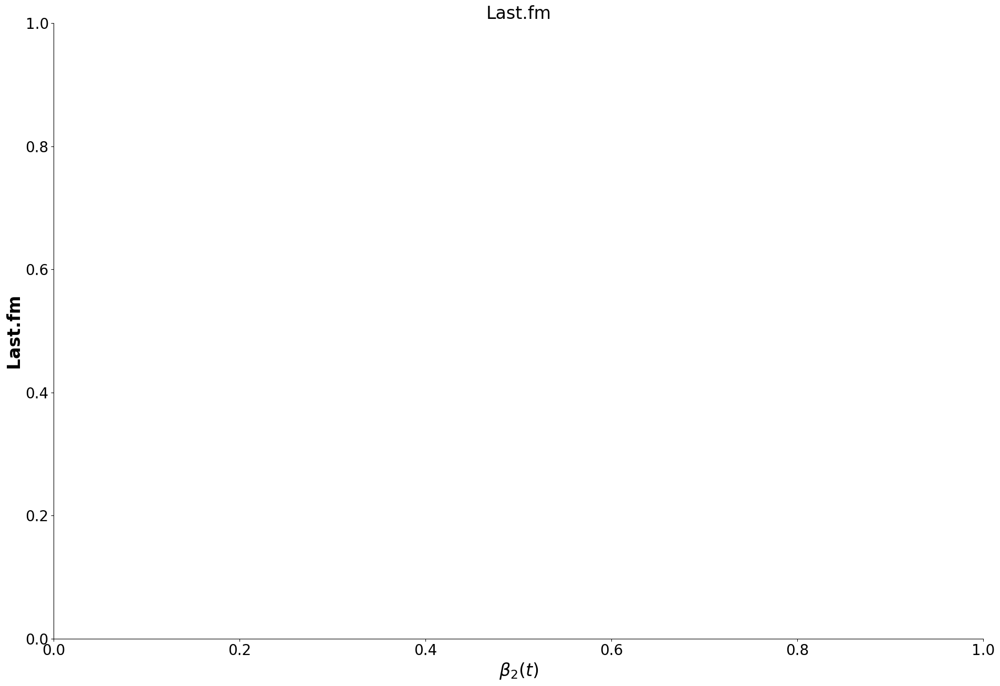

In [6]:
plt.title('Last.fm')
plt.xlabel(r"$\beta_2(t)$")
plt.ylabel('Last.fm', fontweight='bold')

# Load data

## Load essential data

In [7]:
with gzip.open('./data/essential_data_for_figures.pkl.gz', "rb") as fp:
    data = joblib.load(fp)

In [15]:
with gzip.open('./data/essential_data_labels_for_figures.pkl.gz', "rb") as fp:
    data_labels = joblib.load(fp)

## Prepare essential data

Use this section only on the first run. Otherwise, just load the prepared data on the previous section

### Load analyzed data

In [396]:
with gzip.open("./data/ocelma-dataset/lastfm-dataset-1K/results_light_users_lastfm.pkl.gz", "rb") as fp:
    results_light_individual_lastfm = joblib.load(fp)

In [9]:
with gzip.open("./data/ocelma-dataset/lastfm-dataset-1K/results_light_users_lastfm_artists.pkl.gz", "rb") as fp:
    results_light_individual_lastfm_artists = joblib.load(fp)

In [10]:
with open(os.path.join('./data/ocelma-dataset/lastfm-dataset-1K/', f"average_individual_results.pkl"), "rb") as fp:
    average_results_individual_lastfm = joblib.load(fp)

In [11]:
with open("./data/ocelma-dataset/lastfm-dataset-1K/average_individual_results_artists.pkl", "rb") as fp:
    average_results_individual_lastfm_artists = joblib.load(fp)

In [12]:
print(len(results_light_individual_lastfm))

890


In [796]:
# with gzip.open("./data/gutenberg/analysis/results_light_texts.pkl.gz", "rb") as fp:
with gzip.open("./data/gutenberg/analysis/results_light_texts_positive_intercept.pkl.gz", "rb") as fp:
    results_light_individual_gutenberg = joblib.load(fp)

In [14]:
with gzip.open("./data/gutenberg/analysis/results_light_stems.pkl.gz", "rb") as fp:
    results_light_individual_gutenberg_stems = joblib.load(fp)

In [15]:
with open("./data/gutenberg/analysis/average_individual_results.pkl", "rb") as fp:
    average_results_individual_gutenberg = joblib.load(fp)

In [16]:
with open("./data/gutenberg/analysis/average_individual_results_stems.pkl", "rb") as fp:
    average_results_individual_gutenberg_stems = joblib.load(fp)

In [17]:
print(len(results_light_individual_gutenberg))

19637


In [815]:
results_light_individual_journals_fieldsOfStudy['Art']['0'].keys()

dict_keys(['ts', 'indices', 'ts_geom', 'indices_geom', 'D_indices', 'D2_indices', 'D3_indices', 'D4_indices', 'weighted_diff_entropies', 'beta_mean_indices', 'beta2_mean_indices', 'beta3_mean_indices', 'beta4_mean_indices', 'beta_loglogregr_indices_geom', 'beta2_loglogregr_indices_geom', 'beta3_loglogregr_indices_geom', 'beta4_loglogregr_indices_geom'])

In [399]:
corpus_version = '2022-01-01'
with open(os.path.join('./data/semanticscholar',corpus_version, 'analysis', 'journals_fieldsOfStudy_light', 'results_light_texts.pkl'), 'rb') as fp:
    results_light_individual_journals_fieldsOfStudy = joblib.load(fp)

In [ ]:
corpus_version = '2022-01-01'
with open(os.path.join('./data/semanticscholar',corpus_version, 'analysis', 'journals_fieldsOfStudy_stems_light', 'results_light_stems.pkl'), 'rb') as fp:
    results_light_individual_journals_fieldsOfStudy_stems = joblib.load(fp)

In [ ]:
with open(os.path.join('./data/semanticscholar',corpus_version, 'analysis', 'average_individual_results_journals_fieldsOfStudy.pkl'), 'rb') as fp:
    average_results_individual_journals_fieldsOfStudy = joblib.load(fp)

In [ ]:
with open(os.path.join('./data/semanticscholar',corpus_version, 'analysis', 'average_individual_results_journals_fieldsOfStudy_stems.pkl'), 'rb') as fp:
    average_results_individual_journals_fieldsOfStudy_stems = joblib.load(fp)

In [ ]:
print(len(results_light_individual_journals_fieldsOfStudy), sum([len(tmp) for tmp in results_light_individual_journals_fieldsOfStudy.values()]))

### Get essential stats for figures

#### Functions

In [49]:
def adjust_positive_intercept_fit_result_sequence(result):
    indices_geom = result['indices_geom']
    ts_geom = result['ts_geom']
    D_indices_geom = result['D_indices'][indices_geom]
    D2_indices_geom = result['D2_indices'][indices_geom]
    D3_indices_geom = result['D3_indices'][indices_geom]
    D4_indices_geom = result['D4_indices'][indices_geom]

    beta_list = []
    beta2_list = []
    beta3_list = []
    beta4_list = []
    intercept_list = []
    intercept2_list = []
    intercept3_list = []
    intercept4_list = []
    std_err_beta_list = []
    std_err_beta2_list = []
    std_err_beta3_list = []
    std_err_beta4_list = []
    std_err_intercept_list = []
    std_err_intercept2_list = []
    std_err_intercept3_list = []
    std_err_intercept4_list = []
    for i in range(len(ts_geom)):
        slope, intercept, std_err = powerLawRegrPoints(ts_geom[max(0,i-100)+1:i+1], D_indices_geom[max(0,i-100)+1:i+1], intercept_left_lim = 0, intercept_right_lim = np.inf)
        beta_list.append(slope)
        intercept_list.append(intercept)
        std_err_beta_list.append(std_err[0])
        std_err_intercept_list.append(std_err[1])
        slope, intercept, std_err = powerLawRegrPoints(ts_geom[max(1,i-100)+1:i+1]-1, D2_indices_geom[max(1,i-100)+1:i+1], intercept_left_lim = 0, intercept_right_lim = np.inf)
        beta2_list.append(slope)
        intercept2_list.append(intercept)
        std_err_beta2_list.append(std_err[0])
        std_err_intercept2_list.append(std_err[1])
        slope, intercept, std_err = powerLawRegrPoints(ts_geom[max(2,i-100)+1:i+1]-2, D3_indices_geom[max(2,i-100)+1:i+1], intercept_left_lim = 0, intercept_right_lim = np.inf)
        beta3_list.append(slope)
        intercept3_list.append(intercept)
        std_err_beta3_list.append(std_err[0])
        std_err_intercept3_list.append(std_err[1])
        slope, intercept, std_err = powerLawRegrPoints(ts_geom[max(3,i-100)+1:i+1]-3, D4_indices_geom[max(3,i-100)+1:i+1], intercept_left_lim = 0, intercept_right_lim = np.inf)
        beta4_list.append(slope)
        intercept4_list.append(intercept)
        std_err_beta4_list.append(std_err[0])
        std_err_intercept4_list.append(std_err[1])
    result["beta"] = np.array(beta_list)
    result["beta2"] = np.array(beta2_list)
    result["beta3"] = np.array(beta3_list)
    result["beta4"] = np.array(beta4_list)
    result["intercept"] = np.array(intercept_list)
    result["intercept2"] = np.array(intercept2_list)
    result["intercept3"] = np.array(intercept3_list)
    result["intercept4"] = np.array(intercept4_list)
    result["std_err_beta"] = np.array(std_err_beta_list)
    result["std_err_beta2"] = np.array(std_err_beta2_list)
    result["std_err_beta3"] = np.array(std_err_beta3_list)
    result["std_err_beta4"] = np.array(std_err_beta4_list)
    result["std_err_intercept"] = np.array(std_err_intercept_list)
    result["std_err_intercept2"] = np.array(std_err_intercept2_list)
    result["std_err_intercept3"] = np.array(std_err_intercept3_list)
    result["std_err_intercept4"] = np.array(std_err_intercept4_list)
    return result

In [542]:
def get_info_stats_last_results(results):
    new_results = {}
    for order_index,order in enumerate(['', '2', '3', '4']):
        print(f"Order {order_index}")
        betas = []
        loglog_intercepts = []
        intercepts = []
        std_err_betas = []
        std_err_intercepts = []
        confidence_intervals_betas = []
        t_values_betas = []
        p_values_betas = []
        confidence_intervals_loglog_intercepts = []
        t_values_loglog_intercepts = []
        p_values_loglog_intercepts = []
        for result in results.values():
            indices_geom = result['indices_geom']
            ts_geom = result['ts_geom']
            D_indices_geom = result[f'D{order}_indices'][indices_geom]
            i = list(range(len(ts_geom)))[-1]
            xs = ts_geom[max(order_index,i-100)+1:i+1]-order_index
            ys = D_indices_geom[max(order_index,i-100)+1:i+1]
            xs = np.log10(xs)
            ys = np.log10(ys)
            beta, loglog_intercept, std_err, confidence_intervals, t_values, p_values = lin_regr_with_stats(
                xs, ys, 
                intercept_left_lim = 0, intercept_right_lim = np.inf, 
                get_more_statistcs = True, 
                alpha_for_conf_interv = 0.99
            )
            betas.append(beta)
            loglog_intercepts.append(loglog_intercept)
            intercepts.append(10**loglog_intercept)
            std_err_betas.append(std_err[0])
            std_err_intercepts.append(std_err[1])
            confidence_intervals_betas.append(confidence_intervals[0])
            t_values_betas.append(t_values[0])
            p_values_betas.append(p_values[0])
            confidence_intervals_loglog_intercepts.append(confidence_intervals[1])
            t_values_loglog_intercepts.append(t_values[1])
            p_values_loglog_intercepts.append(p_values[1])
        new_results[f'betas{order}'] = np.array(betas)
        new_results[f'loglog_intercepts{order}'] = np.array(loglog_intercepts)
        new_results[f'intercepts{order}'] = np.array(intercepts)
        new_results[f'std_err_betas{order}'] = np.array(std_err_betas)
        new_results[f'std_err_intercepts{order}'] = np.array(std_err_intercepts)
        new_results[f'confidence_intervals_betas{order}'] = np.array(confidence_intervals_betas)
        new_results[f't_values_betas{order}'] = np.array(t_values_betas)
        new_results[f'p_values_betas{order}'] = np.array(p_values_betas)
        new_results[f'confidence_intervals_loglog_intercepts{order}'] = np.array(confidence_intervals_loglog_intercepts)
        new_results[f't_values_loglog_intercepts{order}'] = np.array(t_values_loglog_intercepts)
        new_results[f'p_values_loglog_intercepts{order}'] = np.array(p_values_loglog_intercepts)
    new_results['len'] = np.array([result["ts"][-1] for result in results.values()])
    new_results['weighted_diff_entropies'] = np.array([result["weighted_diff_entropies"] for result in results.values()])
    return new_results

#### Data

In [63]:
results_light = {
    "Last.fm" : results_light_individual_lastfm,
    "Project Gutenberg" : results_light_individual_gutenberg,
    "Semantic Scholar" : {f"{field}_{index}" : result for field, field_results in results_light_individual_journals_fieldsOfStudy.items() for index, result in field_results.items()},
}

In [64]:
average_results_to_adjust = {
    "Last.fm" : average_results_individual_lastfm, 
    "Project Gutenberg" : average_results_individual_gutenberg, 
    "Semantic Scholar" : average_results_individual_journals_fieldsOfStudy, 
}

In [ ]:
data = {}
for dataset_name, results in results_light.items():
    print(f"Starting {dataset_name}")
    data[dataset_name] = get_info_stats_last_results(results)
    data[dataset_name]['average_results'] = adjust_positive_intercept_fit_result_sequence(average_results_to_adjust[dataset_name])
with gzip.open('./data/essential_data_for_figures.pkl.gz', "wb") as fp:
    joblib.dump(data, fp)
print('Dumped')

Starting Last.fm
Order 0


/tmp/2785684.1.all.q/ipykernel_27565/3776544883.py:182: RuntimeWarning: divide by zero encountered in true_divide
  tstat_beta = parameters / parameterStatistics.sd_beta # coeff t-statistics


Order 1
Order 2
Order 3
Starting Project Gutenberg
Order 0
Order 1
Order 2
Order 3
Starting Semantic Scholar
Order 0
Order 1


#### Data labels

In [ ]:
results_light_labels = {
    "Last.fm" : results_light_individual_lastfm_artists,
    "Project Gutenberg" : results_light_individual_gutenberg_stems,
    "Semantic Scholar" : {f"{field}_{index}" : result for field, field_results in results_light_individual_journals_fieldsOfStudy_stems.items() for index, result in field_results.items()},
}

In [ ]:
average_results_labels_to_adjust = {
    "Last.fm" : average_results_individual_lastfm_artists, 
    "Project Gutenberg" : average_results_individual_gutenberg_stems, 
    "Semantic Scholar" : average_results_individual_journals_fieldsOfStudy_stems
}

In [ ]:
data_labels = {}
for dataset_name, results in results_light_labels.items():
    print(f"Starting {dataset_name}")
    data_labels[dataset_name] = get_info_stats_last_results(results)
    data_labels[dataset_name]['average_results'] = adjust_positive_intercept_fit_result_sequence(average_results_labels_to_adjust[dataset_name])
with gzip.open('./data/essential_data_labels_for_figures.pkl.gz', "wb") as fp:
    joblib.dump(data_labels, fp)
print('Dumped')

# Figure: Higher order Heaps' exponents DATA

## Functions

In [8]:
def subplot_heaps_law(average_result, 
                    ax = None, marker_size = 20, alpha = 1, 
                    number_to_write = 0, 
                    xlim_left = 1, xlim_right = 1, 
                    ylim_bottom = 1, ylim_top = 1, 
                    xlabel = None, 
                    ylabel = None, 
                    title = None,
                    write_number = False):
    if ax == None:
        fig, ax = plt.subplots()
    labels = []
    for i,order in enumerate(['', '2', '3']): # , '4'
        ax.plot(average_result["ts"]-i, average_result[f"D{order}_indices"], color = CB_color_cycle[i])
#         ax.plot([1]+list(average_result["ts"]-i+1), [1]+list(average_result[f"D{order}_indices"]), color = CB_color_cycle[i])
#         ax.plot(average_result["ts"],average_result["ts"]**average_result[f"beta{order}"][-1] * (average_result[f"D{order}_indices"][-1]/average_result["ts"][-1]**average_result[f"beta{order}"][-1]), 
        if f"intercept{order}" in average_result:
            intercept = average_result[f"intercept{order}"][-1]
        else:
            intercept = 1
        ax.plot(average_result["ts"], intercept * average_result["ts"]**average_result[f"beta{order}"][-1], # * (average_result[f"D{order}_indices"][-1]/average_result["ts"][-1]**average_result[f"beta{order}"][-1]), 
                color = CB_color_cycle[i], ls = "--", alpha=alpha)
        if order == '':
            labels.append(r"$D_1(t)\sim t^{%.2f}$"%(average_result["beta"][-1]))
        else:
            labels.append(r"$D_{%s}(t)\sim t^{%.2f}$"%(order, average_result[f"beta{order}"][-1]))
    ax.set_xlim(left = xlim_left, right = xlim_right)
    ax.set_ylim(bottom = ylim_bottom, top = ylim_top)
    ax.set_xlabel(xlabel)#, fontweight='bold')
    ax.set_ylabel(ylabel)#, fontweight='bold')
    ax.set_title(title)#, fontweight='bold')
    ax.loglog()
    # Impose xticks
    locmaj = matplotlib.ticker.LogLocator(base=10,numticks=20) 
    ax.xaxis.set_major_locator(locmaj)
    locmin = matplotlib.ticker.LogLocator(base=10.0,subs=(np.arange(0.1,1,0.1)),numticks=20)
    ax.xaxis.set_minor_locator(locmin)
    ax.xaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
    # Impose yticks
    ax.yaxis.set_major_locator(locmaj)
    ax.yaxis.set_minor_locator(locmin)
    ax.yaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
    # Legend
#     leg1 = ax.legend([(color,"--",True) for color in CB_color_cycle[:2]], labels[:2] , 
#                      handler_map={tuple: continuous_and_dashed_line_handle()},
#                      handletextpad=0.1, bbox_to_anchor=(-0.06,1.1), loc="upper left", labelspacing = 0, handlelength = 1.5
#     ) 

#     leg2 = ax.legend([(color,"--",True) for color in CB_color_cycle[2:4]], labels[2:] , 
    leg = ax.legend([(color,"--",True) for color in CB_color_cycle], labels, 
                     handler_map={tuple: continuous_and_dashed_line_handle()},
                     handletextpad=0.1, bbox_to_anchor=(1.06,-0.06), loc="lower right", labelspacing = 0, handlelength = 1.5
    )
#     ax.add_artist(leg1)
    if write_number == True:
#         ax.text(0.5, 1.08, f"{letters[number_to_write]}", transform=ax.transAxes,fontweight='bold', horizontalalignment='center')
        ax.text(0.05, 1, f"{letters[number_to_write]}", transform=ax.transAxes,fontweight='bold', horizontalalignment='left', verticalalignment='bottom')
    return ax

In [9]:
def scatter_with_density(x, y, z=None, ax = None, alpha = 1, marker_size = 20, label_scatter = None):
    if ax == None:
        fig, ax = plt.subplots()
    x = np.array(x)
    y = np.array(y)

    if z is None:
        # Calculate the point density
        xy = np.vstack([x,y])
        z = gaussian_kde(xy)(xy)
    else:
        z = np.array(z)
        
    # Sort the points by density, so that the densest points are plotted last
    idx = z.argsort()
    x, y, z = x[idx], y[idx], z[idx]
        
    ax.scatter(x, y, c=z, s=marker_size, alpha = alpha, label = label_scatter, rasterized=True)

In [10]:
def plot_distribution_histograms_on_axes(x, y, ax = None, color_x = None, color_y = None, alpha = 0.3, max_hist = 0.25, min_x = None, max_x = None, min_y = None, max_y = None):
    if min_x == None:
        min_x = min(x)
    if max_x == None:
        max_x = max(x)
    if min_y == None:
        min_y = min(y)
    if max_y == None:
        max_y = max(y)
    
    n, bins, rects = ax.hist(x,density=True, bins = np.linspace(min_x,max_x, 30),alpha=alpha, bottom=min_y-0.02, color=color_x, rasterized=True)
    max_hist_proportioned = max_hist * (max_y-0.02 - min_y+0.02)
    max_height = max(1,max([r.get_height() for r in rects]))
    for r in rects:
        r.set_height(r.get_height()*max_hist_proportioned/max_height)
    n, bins, rects = ax.hist(y,density=True, bins = np.linspace(min_y,max_y, 30),alpha=alpha, bottom=min_x-0.02, orientation='horizontal',color=color_y, rasterized=True)
    max_hist_proportioned = max_hist * (max_x-0.02 - min_x+0.02)
    max_width = max(1,max([r.get_width() for r in rects]))
    for r in rects:
        r.set_width(r.get_width()*max_hist_proportioned/max_width)
        

In [11]:
def last_modifications_subplot_scatter_beta(x, y, number_to_write = 0, write_number = False, 
                                         do_dashed_line = True, do_dashed_line_label = False,plot_pearson = True,
                                         x_correlation_text = 0.63, y_correlation_text = .32, ax = None, ylabel = None, xlabel = None, min_x = None, max_x = None, min_y = None, max_y = None):
    if min_x == None:
        min_x = min(x)
    if max_x == None:
        max_x = max(x)
    if min_y == None:
        min_y = min(y)
    if max_y == None:
        max_y = max(y)
    xlim = [min_x-0.02, max_x + 0.02]
    ylim = [min_y-0.02, max_y + 0.02]
    if do_dashed_line == True:
#         ax.plot([min_x-0.02, max_x + 0.02], [min_x-0.02,max_x + 0.02], '--', color="gray") 
        ax.plot([-100000, 100000], [-100000, 100000], '--', color="gray", label = r"y=x" if do_dashed_line_label else None) 
    
#     leg = ax.legend(handletextpad=0.1,bbox_to_anchor=(1.06,0.5), loc="center right", labelspacing = 0, handlelength = 1.5)
    if plot_pearson:
        model = ols("y ~ x", data={"x":x, "y":y}).fit()
        intercept, slope = model.params
        print('intercept',intercept, 'slope', slope, flush=True)
        pearsonr_test = pearsonr(x,y)
    #     text_to_write = r'$R^2=%.2f$'%(pearsonr_test[0]**2)
        if intercept >= 0:
            text_to_write = r'$y=%.2fx+%.2f$'%(slope,intercept) + '\n' + r'($R^2=%.2f$)'%(pearsonr_test[0]**2)
        else:
            text_to_write = r'$y=%.2fx-%.2f$'%(slope,-intercept) + '\n' + r'($R^2=%.2f$)'%(pearsonr_test[0]**2)
        ax.plot([-100000, 100000], np.array([-100000, 100000])*slope + intercept, ':', c="red", label = text_to_write)
        print(f"p-value pearson between {xlabel} and {ylabel}", pearsonr_test[1], flush=True)
    #     ax.text(x_correlation_text, y_correlation_text, text_to_write, transform=ax.transAxes, fontsize=multiplicator*6) #  fontsize=32, 
    
    ax.set_ylabel(ylabel)
    ax.set_xlabel(xlabel)
    # Impose xticks
    if min_x > -0.1 and min_x <=0 and max_x >= 1 and max_x < 1.1: 
        ax.set_xticks(np.arange(0,1.0000001,0.1), minor=True)
        ax.set_yticks(np.arange(0,1.0000001,0.1), minor=True)
        ax.set_xticks(np.arange(0,1.0000001,0.2), minor=False)
        ax.set_yticks(np.arange(0,1.0000001,0.2), minor=False)
    ax.set_xlim(xlim)
    ax.set_ylim(ylim)
    
    ax.legend(handletextpad=0.1, bbox_to_anchor=(x_correlation_text, y_correlation_text), loc="lower right", labelspacing = 0, handlelength = 1.5, fontsize=multiplicator*5) #  fontsize=32, 
    
    if write_number == True:
        letters = 'ABCDEFGHIJKLMNOPQRSTUVWXYZ'.lower()
#         ax.text(0.5, 1.08, f"{letters[number_to_write]}", transform=ax.transAxes,fontweight='bold', horizontalalignment='center')
        ax.text(0.05, 1, f"{letters[number_to_write]}", transform=ax.transAxes,fontweight='bold', horizontalalignment='left', verticalalignment='bottom')

In [12]:
def subplot_scatter_beta(
    x, 
    y, 
    z = None,
    ax = None, 
    marker_size = 20, 
    alpha_scatter = 1, 
    alpha_histogram = 0.3, 
    plot_pearson = True,
    x_correlation_text = 0.63, 
    y_correlation_text = .32,
    color_x = CB_color_cycle[0], 
    color_y = CB_color_cycle[1], 
    max_hist = 0.25, 
    number_to_write = 0, 
    write_number = False, 
    ylabel = None, 
    xlabel = None, 
    min_x = None, 
    max_x = None,
    min_y = None, 
    max_y = None,
    do_dashed_line = True,
    do_dashed_line_label = True,
):
    if min_x == None:
        min_x = min(x)
    if max_x == None:
        max_x = max(x)
    if min_y == None:
        min_y = min(y)
    if max_y == None:
        max_y = max(y)
    if ax == None:
        fig, ax = plt.subplots()
    scatter_with_density(x, y, z = z, ax = ax, alpha = alpha_scatter, marker_size = marker_size)
    plot_distribution_histograms_on_axes(x, y, ax = ax, color_x = color_x, color_y = color_y, alpha = alpha_histogram, max_hist = max_hist, min_x=min_x, max_x=max_x, min_y=min_y, max_y=max_y)
    last_modifications_subplot_scatter_beta(x, y, do_dashed_line = do_dashed_line,do_dashed_line_label = do_dashed_line_label, plot_pearson = plot_pearson,
                                         number_to_write = number_to_write, write_number = write_number, x_correlation_text = x_correlation_text, y_correlation_text = y_correlation_text, ax = ax, ylabel = ylabel, xlabel = xlabel, min_x=min_x, max_x=max_x, min_y=min_y, max_y=max_y)


In [13]:
def fig_1(data, marker_size = 20, alpha_scatter = 1, alpha_histogram = 0.3, color_x = CB_color_cycle[0], color_y = CB_color_cycle[1], max_hist = 0.25, xlim_left_a = 1, ylim_bottom_a = 1,
          min_beta = None,
          max_beta = None,
          min_beta_higher = None,
          max_beta_higher = None,
          use_same_x_y_max_lim = True,
          do_dashed_line = True,
          do_dashed_line_label = True,
        x_correlation_text = 1.06, 
        y_correlation_text = .27,
         ):
    higher_orders = [2,3]
    nrows = len(higher_orders) + 1
    ncols = num_datasets = len(data)
    fig = plt.figure(figsize=(width_fig*ncols/3,width_fig*4/5*nrows/3))
#     outer = gridspec.GridSpec(nrows=num_datasets+1, ncols=1,height_ratios = [10]*num_datasets+[3],hspace=0.35) # 0.25
    outer = gridspec.GridSpec(nrows=2, ncols=1, height_ratios=[10*nrows]+[3], hspace=0.15, wspace=0.15) # 0.25
    
    
    wspace = 0.25
    hspace = 0.35
    
    # get highest t and D to unify panel a
    if use_same_x_y_max_lim == True:
        max_t = 1
        max_D = 1
        for dataset_label, dataset_dict in data.items():
            max_t = max(max_t, dataset_dict['average_results']["ts"][-1]+1)
            for order in ['', '2', '3']: #  '4'
                max_D = max(max_D, dataset_dict['average_results'][f"D{order}_indices"][-1]+1)
    
    inner = gridspec.GridSpecFromSubplotSpec(nrows, ncols,
                        subplot_spec=outer[0],wspace=wspace,hspace=hspace)
                
    for column, (dataset_label, dataset_dict) in enumerate(data.items()):
        print(dataset_label)
        ax = plt.Subplot(fig, inner[column])
        if use_same_x_y_max_lim == False:
            max_t = dataset_dict['average_results']["ts"][-1]+1
            max_D = 1
            for order in ['']+[str(tmp_order) for tmp_order in higher_orders]:
                max_D = max(max_D, dataset_dict['average_results'][f"D{order}_indices"][-1]+1)
        xlabel_heaps_law = r"$t$"
        ylabel_heaps_law = r'$D_n(t)$' if column == 0 else None
        subplot_heaps_law(dataset_dict['average_results'], 
                        ax = ax, 
                        marker_size = marker_size, alpha = alpha_scatter, 
                        number_to_write = column, 
                        xlim_left = xlim_left_a, xlim_right = max_t, 
                        ylim_bottom = ylim_bottom_a, ylim_top = max_D, 
                        title = '\n'.join(dataset_label.split(' ')),
                        xlabel = xlabel_heaps_law, 
                        ylabel = ylabel_heaps_law, write_number = True,
                       )
        fig.add_subplot(ax)
        for i_order,n_order in enumerate(higher_orders, start=1):
            order = str(n_order)
            ax = plt.Subplot(fig, inner[(i_order)*ncols + column])
            xlabel_scatter_beta = r"$\beta_1$"
            ylabel_scatter_beta = fr"$\beta_{order}$" if column == 0 else None
            subplot_scatter_beta(dataset_dict['betas'], dataset_dict[f'betas{order}'], 
                              ax = ax, 
                              marker_size = 20, alpha_scatter = alpha_scatter,
                              alpha_histogram = alpha_histogram, 
                              color_x = color_x, color_y = color_y, 
                              max_hist = max_hist, 
                              number_to_write = (i_order)*ncols + column, 
                              write_number = True, #i==0, 
                              do_dashed_line = do_dashed_line,
                              do_dashed_line_label = do_dashed_line_label,
                              ylabel = ylabel_scatter_beta, xlabel = xlabel_scatter_beta, 
                              min_x=min_beta, max_x=max_beta, min_y=min_beta_higher, max_y=max_beta_higher,
                              x_correlation_text = x_correlation_text, 
                              y_correlation_text = y_correlation_text,
                             )
            do_dashed_line_label = False
            fig.add_subplot(ax)
    
    ####################### COLORBAR #######################
#     inner = gridspec.GridSpecFromSubplotSpec(2, 1,
#                             subplot_spec=outer[-1],height_ratios=[1,1],hspace=0)
#     ax_cmap = plt.Subplot(fig, inner[1])
    ax_cmap = plt.Subplot(fig, outer[-1])
    vmin = 0
    vmax = 1
    cb = fig.colorbar(ScalarMappable(norm=Normalize(vmin=vmin,vmax=vmax)), ax=ax_cmap,shrink=0.5,pad=0., fraction=1,orientation='horizontal')
    cb.ax.get_xaxis().set_ticks([0,1]) 
    cb.ax.get_xaxis().set_ticklabels(['low density', 'high density']) 
#     cb = fig.colorbar(ScalarMappable(norm=Normalize(vmin=vmin,vmax=vmax)), ax=ax_cmap,shrink=0.75,pad=0., fraction=1,orientation='vertical')
#     cb.ax.get_yaxis().set_ticks([0,1]) 
#     cb.ax.get_yaxis().set_ticklabels(['low density', 'high density'],rotation=90,verticalalignment='center') 
    ax_cmap.axis('off')
    fig.add_subplot(ax_cmap)
    
    return fig

## Figure

Last.fm
intercept 0.7440039991045124 slope 0.22878413030490352
p-value pearson between $\beta_1$ and $\beta_2$ 1.428738990674999e-36
intercept 0.8140704581222868 slope 0.16290588469165912
p-value pearson between $\beta_1$ and $\beta_3$ 1.6898241661829013e-25
Project Gutenberg
intercept 0.5783093602184439 slope 0.4814251814601065
p-value pearson between $\beta_1$ and None 0.0
intercept 0.8570638773182496 slope 0.17876032434314015
p-value pearson between $\beta_1$ and None 0.0
Semantic Scholar
intercept 0.5968480579684067 slope 0.43715873684101214
p-value pearson between $\beta_1$ and None 0.0
intercept 0.8427770233971309 slope 0.17690533906763628
p-value pearson between $\beta_1$ and None 0.0


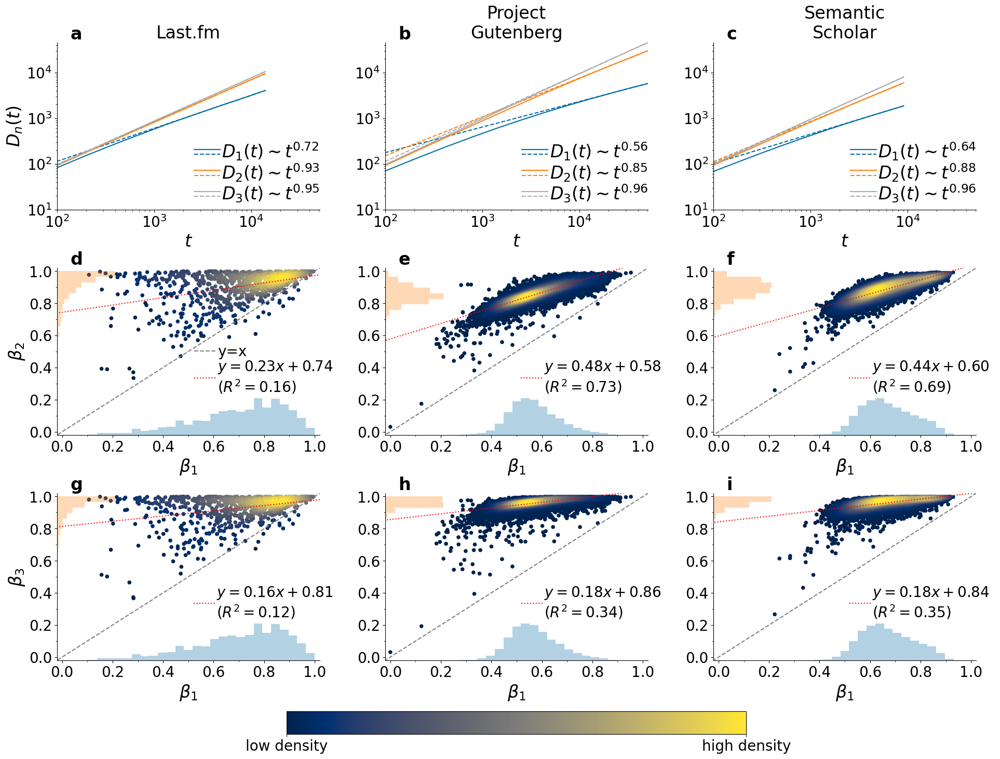

In [953]:
fig = fig_1(
    data, 
    marker_size = 20, 
    alpha_scatter = 1, 
    alpha_histogram = 0.3, 
    color_x = CB_color_cycle[0], 
    color_y = CB_color_cycle[1], 
    max_hist = 0.23, 
    xlim_left_a = 1e2, 
    ylim_bottom_a = 1e1,
    min_beta = 0,
    max_beta = 1,
    min_beta_higher = 0,
    max_beta_higher = 1,
    use_same_x_y_max_lim = True,
    do_dashed_line = True,
    x_correlation_text = 1.1, 
    y_correlation_text = .16,
)

fig.savefig(os.path.join(figures_folder, f"Fig1_Heaps_datasets.png"))
fig.savefig(os.path.join(figures_folder, f"Fig1_Heaps_datasets_low_res.pdf"),format='pdf',dpi=100)
fig.savefig(os.path.join(figures_folder, f"Fig1_Heaps_datasets.pdf"),format='pdf')

## Figure for abstract

In [356]:
def fig_1_for_abstract(data, marker_size = 20, alpha_scatter = 1, alpha_histogram = 0.3, color_x = CB_color_cycle[0], color_y = CB_color_cycle[1], max_hist = 0.25, xlim_left_a = 1, ylim_bottom_a = 1,
          min_beta = None,
          max_beta = None,
          min_beta_higher = None,
          max_beta_higher = None,
          use_same_x_y_max_lim = True,
          do_dashed_line = True,
        x_correlation_text = 0.63, 
        y_correlation_text = .32,
         ):
    higher_orders = [2,3]
    nrows = 1
    ncols = num_datasets = len(data)
    fig = plt.figure(figsize=(width_fig*ncols/3,width_fig*9/10*nrows/3))
#     outer = gridspec.GridSpec(nrows=num_datasets+1, ncols=1,height_ratios = [10]*num_datasets+[3],hspace=0.35) # 0.25
    outer = gridspec.GridSpec(nrows=2, ncols=1, height_ratios=[10*nrows]+[3], hspace=0.45, wspace=0.15) # 0.25
    
    
    wspace = 0.25
    hspace = 0.35
    
    # get highest t and D to unify panel a
    if use_same_x_y_max_lim == True:
        max_t = 1
        max_D = 1
        for dataset_label, dataset_dict in data.items():
            max_t = max(max_t, dataset_dict['average_results']["ts"][-1]+1)
            for order in ['', '2', '3']: #  '4'
                max_D = max(max_D, dataset_dict['average_results'][f"D{order}_indices"][-1]+1)
    
    inner = gridspec.GridSpecFromSubplotSpec(nrows, ncols,
                        subplot_spec=outer[0],wspace=wspace,hspace=hspace)
                
    for column, (dataset_label, dataset_dict) in enumerate(data.items()):
        print(dataset_label)
        ax = plt.Subplot(fig, inner[column])
        xlabel_scatter_beta = r"$\beta_1$"
        order = 2
        ylabel_scatter_beta = fr"$\beta_{order}$" if column == 0 else None
        subplot_scatter_beta(dataset_dict['betas'], dataset_dict[f'betas{order}'], 
                          ax = ax, 
                          marker_size = 20, alpha_scatter = alpha_scatter,
                          alpha_histogram = alpha_histogram, 
                          color_x = color_x, color_y = color_y, 
                          max_hist = max_hist, 
                          number_to_write = column, 
                          write_number = True, #i==0, 
                          do_dashed_line = do_dashed_line,
                          ylabel = ylabel_scatter_beta, xlabel = xlabel_scatter_beta, 
                          min_x=min_beta, max_x=max_beta, min_y=min_beta_higher, max_y=max_beta_higher,
                          x_correlation_text = x_correlation_text, 
                          y_correlation_text = y_correlation_text,
                         )
        ax.set_title('\n'.join(dataset_label.split(' ')))
        fig.add_subplot(ax)
    
    ####################### COLORBAR #######################
#     inner = gridspec.GridSpecFromSubplotSpec(2, 1,
#                             subplot_spec=outer[-1],height_ratios=[1,1],hspace=0)
#     ax_cmap = plt.Subplot(fig, inner[1])
    ax_cmap = plt.Subplot(fig, outer[-1])
    vmin = 0
    vmax = 1
    cb = fig.colorbar(ScalarMappable(norm=Normalize(vmin=vmin,vmax=vmax)), ax=ax_cmap,shrink=0.5,pad=0., fraction=1,orientation='horizontal')
    cb.ax.get_xaxis().set_ticks([0,1]) 
    cb.ax.get_xaxis().set_ticklabels(['low density', 'high density']) 
#     cb = fig.colorbar(ScalarMappable(norm=Normalize(vmin=vmin,vmax=vmax)), ax=ax_cmap,shrink=0.75,pad=0., fraction=1,orientation='vertical')
#     cb.ax.get_yaxis().set_ticks([0,1]) 
#     cb.ax.get_yaxis().set_ticklabels(['low density', 'high density'],rotation=90,verticalalignment='center') 
    ax_cmap.axis('off')
    fig.add_subplot(ax_cmap)
    
    return fig

Last.fm
p-value pearson between $\beta_1$ and $\beta_2$ 1.428738990674999e-36
Project Gutenberg
p-value pearson between $\beta_1$ and None 0.0
Semantic Scholar
p-value pearson between $\beta_1$ and None 0.0


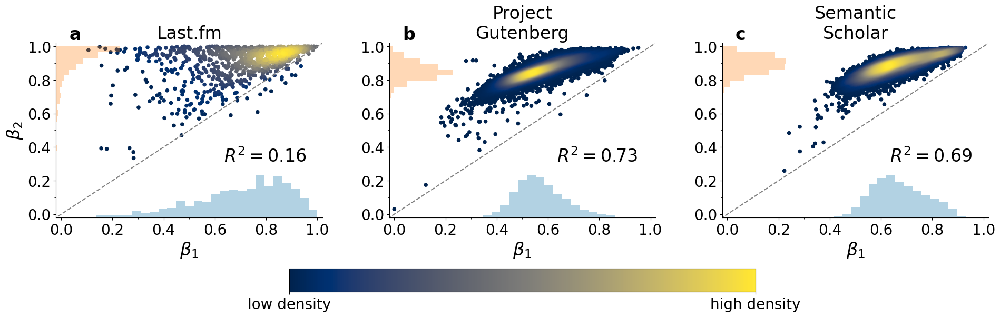

In [358]:
fig = fig_1_for_abstract(
    data, 
    marker_size = 20, 
    alpha_scatter = 1, 
    alpha_histogram = 0.3, 
    color_x = CB_color_cycle[0], 
    color_y = CB_color_cycle[1], 
    max_hist = 0.25, 
    xlim_left_a = 1e2, 
    ylim_bottom_a = 1e1,
    min_beta = 0,
    max_beta = 1,
    min_beta_higher = 0,
    max_beta_higher = 1,
    use_same_x_y_max_lim = True,
    do_dashed_line = True,
)

fig.savefig(os.path.join(figures_folder, f"Fig_abstract_Heaps_datasets.png"))
fig.savefig(os.path.join(figures_folder, f"Fig_abstract_Heaps_datasets_low_res.pdf"),format='pdf',dpi=100)
fig.savefig(os.path.join(figures_folder, f"Fig_abstract_Heaps_datasets.pdf"),format='pdf')

## Table SI: info heaps exponents

In [63]:
data_to_table = {
    'datasets' : [],
    'mean_beta' : [], 
    'std_beta' : [], 
    'min_betas' : [],
    'first_percentile_betas' : [],
    'first_quartile_betas' : [],
    'median_betas' : [],
    'third_quartile_betas' : [],
    'last_percentile_betas' : [],
    'max_betas' : [],
}

for dataset_label, dataset_dict in data.items():
    for i,order in enumerate(['', '2', '3', '4']):
        i += 1
        data_to_table['datasets'].append(fr"{dataset_label} ($\beta_{i}$)")
        data_to_table['mean_beta'].append(np.mean(dataset_dict[f'betas{order}']))
        data_to_table['std_beta'].append(np.std(dataset_dict[f'betas{order}']))
        data_to_table['min_betas'].append(np.min(dataset_dict[f'betas{order}']))
        data_to_table['first_percentile_betas'].append(np.percentile(dataset_dict[f'betas{order}'], 1))
        data_to_table['first_quartile_betas'].append(np.percentile(dataset_dict[f'betas{order}'], 25))
        data_to_table['median_betas'].append(np.median(dataset_dict[f'betas{order}']))
        data_to_table['third_quartile_betas'].append(np.percentile(dataset_dict[f'betas{order}'], 75))
        data_to_table['last_percentile_betas'].append(np.percentile(dataset_dict[f'betas{order}'], 99))
        data_to_table['max_betas'].append(np.max(dataset_dict[f'betas{order}']))

df = pd.DataFrame(data = {
    r'Dataset ($\beta_n$)' : data_to_table['datasets'],
    r"mean" : data_to_table['mean_beta'],
    r"std" : data_to_table['std_beta'],
    r"min" : data_to_table['min_betas'],
    r"$1$\textsuperscript{st} perc." : data_to_table['first_percentile_betas'],
    r"$25$\textsuperscript{th} perc." : data_to_table['first_quartile_betas'],
    r"median" : data_to_table['median_betas'],
    r"$75$\textsuperscript{th} perc." : data_to_table['third_quartile_betas'],
    r"$99$\textsuperscript{th} perc." : data_to_table['last_percentile_betas'],
    r"max" : data_to_table['max_betas'],
})
print(df.to_latex(index=False, column_format='c'*len(df.columns), float_format="%.4f", escape=False))

\begin{tabular}{cccccccccc}
\toprule
          Dataset ($\beta_n$) &   mean &    std &     min &  $1$\textsuperscript{st} perc. &  $25$\textsuperscript{th} perc. &  median &  $75$\textsuperscript{th} perc. &  $99$\textsuperscript{th} perc. &    max \\
\midrule
          Last.fm ($\beta_1$) & 0.7029 & 0.1797 &  0.1063 &                         0.2010 &                          0.5965 &  0.7395 &                          0.8436 &                          0.9761 & 0.9959 \\
          Last.fm ($\beta_2$) & 0.9048 & 0.1014 &  0.3342 &                         0.5725 &                          0.8699 &  0.9388 &                          0.9754 &                          0.9999 & 0.9999 \\
          Last.fm ($\beta_3$) & 0.9286 & 0.0862 &  0.3664 &                         0.6123 &                          0.9041 &  0.9583 &                          0.9861 &                          0.9999 & 1.0000 \\
          Last.fm ($\beta_4$) & 0.9411 & 0.0759 &  0.3837 &                         0.6643 &  

In [64]:
data_to_table = {
    'datasets' : [],
    'min_betas' : [],
    'first_percentile_betas' : [],
    'first_quartile_betas' : [],
    'median_betas' : [],
    'third_quartile_betas' : [],
    'last_percentile_betas' : [],
    'max_betas' : [],
}

for dataset_label, dataset_dict in data.items():
    for i,order in enumerate(['', '2', '3', '4']):
        i += 1
        data_to_table['datasets'].append(fr"{dataset_label} ($\beta_{i}$)")
        data_to_table['min_betas'].append(np.min(dataset_dict[f'std_err_betas{order}']))
        data_to_table['first_percentile_betas'].append(np.percentile(dataset_dict[f'std_err_betas{order}'], 1))
        data_to_table['first_quartile_betas'].append(np.percentile(dataset_dict[f'std_err_betas{order}'], 25))
        data_to_table['median_betas'].append(np.median(dataset_dict[f'std_err_betas{order}']))
        data_to_table['third_quartile_betas'].append(np.percentile(dataset_dict[f'std_err_betas{order}'], 75))
        data_to_table['last_percentile_betas'].append(np.percentile(dataset_dict[f'std_err_betas{order}'], 99))
        data_to_table['max_betas'].append(np.max(dataset_dict[f'std_err_betas{order}']))

df = pd.DataFrame(data = {
    r'Dataset ($\beta_n$)' : data_to_table['datasets'],
    r"min" : data_to_table['min_betas'],
    r"$1$\textsuperscript{st} perc." : data_to_table['first_percentile_betas'],
    r"$25$\textsuperscript{th} perc." : data_to_table['first_quartile_betas'],
    r"median" : data_to_table['median_betas'],
    r"$75$\textsuperscript{th} perc." : data_to_table['third_quartile_betas'],
    r"$99$\textsuperscript{th} perc." : data_to_table['last_percentile_betas'],
    r"max" : data_to_table['max_betas']
})
print(df.to_latex(index=False, column_format='c'*len(df.columns), float_format="%.4f", escape=False))

\begin{tabular}{cccccccc}
\toprule
          Dataset ($\beta_n$) &    min &  $1$\textsuperscript{st} perc. &  $25$\textsuperscript{th} perc. &  median &  $75$\textsuperscript{th} perc. &  $99$\textsuperscript{th} perc. &    max \\
\midrule
          Last.fm ($\beta_1$) & 0.0007 &                         0.0016 &                          0.0052 &  0.0079 &                          0.0129 &                          0.0693 & 0.1988 \\
          Last.fm ($\beta_2$) & 0.0000 &                         0.0001 &                          0.0026 &  0.0047 &                          0.0091 &                          0.0510 & 0.1497 \\
          Last.fm ($\beta_3$) & 0.0000 &                         0.0000 &                          0.0019 &  0.0038 &                          0.0073 &                          0.0388 & 0.1366 \\
          Last.fm ($\beta_4$) & 0.0000 &                         0.0000 &                          0.0015 &  0.0031 &                          0.0064 &                     

### Average Heaps' exponent fits and standard error

(or standard deviation of its estimator)

For each, do min, 1st quartile, mean, 3rd quartile and max, for the last regression.

Compare with std of previous table

In [65]:
data_to_table = {
    'datasets' : [],
    'mean_value_beta' : [], 
    'std_value_beta' : [], 
    'min_betas' : [],
    'first_percentile_betas' : [],
    'first_quartile_betas' : [],
    'median_betas' : [],
    'third_quartile_betas' : [],
    'last_percentile_betas' : [],
    'max_betas' : [],
}

for dataset_label, dataset_dict in data.items():
    for i,order in enumerate(['', '2', '3', '4']):
        i += 1
        data_to_table['datasets'].append(fr"{dataset_label} ($\beta_{i}$)")
        data_to_table['mean_value_beta'].append(np.mean(dataset_dict[f'betas{order}']))
        data_to_table['std_value_beta'].append(np.std(dataset_dict[f'betas{order}']))
        data_to_table['min_betas'].append(np.min(dataset_dict[f'std_err_betas{order}']))
        data_to_table['first_percentile_betas'].append(np.percentile(dataset_dict[f'std_err_betas{order}'], 1))
        data_to_table['first_quartile_betas'].append(np.percentile(dataset_dict[f'std_err_betas{order}'], 25))
        data_to_table['median_betas'].append(np.median(dataset_dict[f'std_err_betas{order}']))
        data_to_table['third_quartile_betas'].append(np.percentile(dataset_dict[f'std_err_betas{order}'], 75))
        data_to_table['last_percentile_betas'].append(np.percentile(dataset_dict[f'std_err_betas{order}'], 99))
        data_to_table['max_betas'].append(np.max(dataset_dict[f'std_err_betas{order}']))

df = pd.DataFrame(data = {
    r'Dataset ($\beta_n$)' : data_to_table['datasets'],
    r"mean value" : data_to_table['mean_value_beta'],
    r"std value" : data_to_table['std_value_beta'],
    r"min" : data_to_table['min_betas'],
    r"$1$\textsuperscript{st} perc." : data_to_table['first_percentile_betas'],
    r"$25$\textsuperscript{th} perc." : data_to_table['first_quartile_betas'],
    r"median" : data_to_table['median_betas'],
    r"$75$\textsuperscript{th} perc." : data_to_table['third_quartile_betas'],
    r"$99$\textsuperscript{th} perc." : data_to_table['last_percentile_betas'],
    r"max" : data_to_table['max_betas'],
})
print(df.to_latex(index=False, column_format='c'*len(df.columns), float_format="%.4f", escape=False))

\begin{tabular}{cccccccccc}
\toprule
          Dataset ($\beta_n$) &  mean value &  std value &    min &  $1$\textsuperscript{st} perc. &  $25$\textsuperscript{th} perc. &  median &  $75$\textsuperscript{th} perc. &  $99$\textsuperscript{th} perc. &    max \\
\midrule
          Last.fm ($\beta_1$) &      0.7029 &     0.1797 & 0.0007 &                         0.0016 &                          0.0052 &  0.0079 &                          0.0129 &                          0.0693 & 0.1988 \\
          Last.fm ($\beta_2$) &      0.9048 &     0.1014 & 0.0000 &                         0.0001 &                          0.0026 &  0.0047 &                          0.0091 &                          0.0510 & 0.1497 \\
          Last.fm ($\beta_3$) &      0.9286 &     0.0862 & 0.0000 &                         0.0000 &                          0.0019 &  0.0038 &                          0.0073 &                          0.0388 & 0.1366 \\
          Last.fm ($\beta_4$) &      0.9411 &     0.0759 & 0.0

### Repeat for t-values and p-values (safety check)

In [66]:
data_to_table = {
    'datasets' : [],
    'min_betas' : [],
    'first_percentile_betas' : [],
    'first_quartile_betas' : [],
    'median_betas' : [],
    'third_quartile_betas' : [],
    'last_percentile_betas' : [],
    'max_betas' : [],
}

for dataset_label, dataset_dict in data.items():
    for i,order in enumerate(['', '2', '3', '4']):
        i += 1
        data_to_table['datasets'].append(fr"{dataset_label} ($\beta_{i}$)")
        data_to_table['min_betas'].append(np.min(dataset_dict[f't_values_betas{order}']))
        data_to_table['first_percentile_betas'].append(np.percentile(dataset_dict[f't_values_betas{order}'], 1))
        data_to_table['first_quartile_betas'].append(np.percentile(dataset_dict[f't_values_betas{order}'], 25))
        data_to_table['median_betas'].append(np.median(dataset_dict[f't_values_betas{order}']))
        data_to_table['third_quartile_betas'].append(np.percentile(dataset_dict[f't_values_betas{order}'], 75))
        data_to_table['last_percentile_betas'].append(np.percentile(dataset_dict[f't_values_betas{order}'], 99))
        data_to_table['max_betas'].append(np.max(dataset_dict[f't_values_betas{order}']))

df = pd.DataFrame(data = {
    r'Dataset ($\beta_n$)' : data_to_table['datasets'],
    r"min" : data_to_table['min_betas'],
    r"$1$\textsuperscript{st} percentile" : data_to_table['first_percentile_betas'],
    r"$25$\textsuperscript{th} percentile" : data_to_table['first_quartile_betas'],
    r"median" : data_to_table['median_betas'],
    r"$75$\textsuperscript{th} percentile" : data_to_table['third_quartile_betas'],
    r"$99$\textsuperscript{th} percentile" : data_to_table['last_percentile_betas'],
    r"max" : data_to_table['max_betas']
})
print(df.to_latex(index=False, column_format='c'*len(df.columns), float_format="%.12f", escape=False))

\begin{tabular}{cccccccc}
\toprule
          Dataset ($\beta_n$) &             min &  $1$\textsuperscript{st} percentile &  $25$\textsuperscript{th} percentile &            median &  $75$\textsuperscript{th} percentile &  $99$\textsuperscript{th} percentile &                             max \\
\midrule
          Last.fm ($\beta_1$) &  5.326220648471 &                     19.313237622896 &                      69.078834646016 &  116.179885496063 &                     278.816724995955 &                    6446.215071571602 &              25460.161078702229 \\
          Last.fm ($\beta_2$) &  6.524946234118 &                     44.867339773862 &                     176.688264084273 &  478.168878113243 &                    2601.230651784433 &                   74428.846836042198 &             312359.616596910288 \\
          Last.fm ($\beta_3$) &  7.519964675021 &                     40.161934913262 &                     220.861246125754 &  604.919937700397 &                    3415.49879

In [67]:
data_to_table = {
    'datasets' : [],
    'min_betas' : [],
    'first_percentile_betas' : [],
    'first_quartile_betas' : [],
    'median_betas' : [],
    'third_quartile_betas' : [],
    'last_percentile_betas' : [],
    'max_betas' : [],
}

for dataset_label, dataset_dict in data.items():
    for i,order in enumerate(['', '2', '3', '4']):
        i += 1
        data_to_table['datasets'].append(fr"{dataset_label} ($\beta_{i}$)")
        data_to_table['min_betas'].append(np.min(dataset_dict[f'p_values_betas{order}']))
        data_to_table['first_percentile_betas'].append(np.percentile(dataset_dict[f'p_values_betas{order}'], 1))
        data_to_table['first_quartile_betas'].append(np.percentile(dataset_dict[f'p_values_betas{order}'], 25))
        data_to_table['median_betas'].append(np.median(dataset_dict[f'p_values_betas{order}']))
        data_to_table['third_quartile_betas'].append(np.percentile(dataset_dict[f'p_values_betas{order}'], 75))
        data_to_table['last_percentile_betas'].append(np.percentile(dataset_dict[f'p_values_betas{order}'], 99))
        data_to_table['max_betas'].append(np.max(dataset_dict[f'p_values_betas{order}']))

df = pd.DataFrame(data = {
    r'Dataset ($\beta_n$)' : data_to_table['datasets'],
    r"min" : data_to_table['min_betas'],
    r"$1$\textsuperscript{st} percentile" : data_to_table['first_percentile_betas'],
    r"$25$\textsuperscript{th} percentile" : data_to_table['first_quartile_betas'],
    r"median" : data_to_table['median_betas'],
    r"$75$\textsuperscript{th} percentile" : data_to_table['third_quartile_betas'],
    r"$99$\textsuperscript{th} percentile" : data_to_table['last_percentile_betas'],
    r"max" : data_to_table['max_betas']
})
print(df.to_latex(index=False, column_format='c'*len(df.columns), float_format="%.12f", escape=False))

\begin{tabular}{cccccccc}
\toprule
          Dataset ($\beta_n$) &            min &  $1$\textsuperscript{st} percentile &  $25$\textsuperscript{th} percentile &         median &  $75$\textsuperscript{th} percentile &  $99$\textsuperscript{th} percentile &            max \\
\midrule
          Last.fm ($\beta_1$) & 0.000000000000 &                      0.000000000000 &                       0.000000000000 & 0.000000000000 &                       0.000000000000 &                       0.000000000000 & 0.000000638950 \\
          Last.fm ($\beta_2$) & 0.000000000000 &                      0.000000000000 &                       0.000000000000 & 0.000000000000 &                       0.000000000000 &                       0.000000000000 & 0.000000003004 \\
          Last.fm ($\beta_3$) & 0.000000000000 &                      0.000000000000 &                       0.000000000000 & 0.000000000000 &                       0.000000000000 &                       0.000000000000 & 0.000000000026 \\


## Figure SI: Distribution lengths

Last.fm	median:	13985.0
Project Gutenberg	median:	50726.0
Semantic Scholar	median:	9114.5


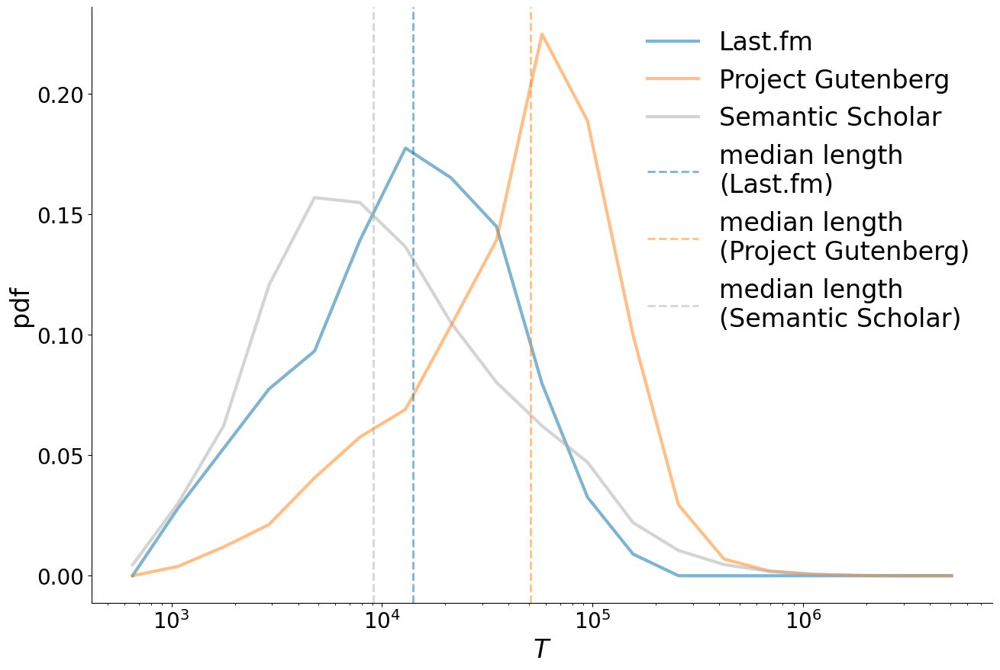

In [14]:
fig = plt.figure(figsize=(width_fig*2/3,width_fig*2/3*2/3))
ax = plt.gca()
minimum = min([min(dataset_dict['len']) for dataset_dict in data.values()])
maximum = max([max(dataset_dict['len']) for dataset_dict in data.values()])
num_bins = 20
colors = []
for dataset_label, dataset_dict in data.items():
    len_data = dataset_dict['len']
    hist,bin_edges = np.histogram(len_data, 
            np.geomspace(minimum, maximum+1, num_bins), 
            density=False)
    bin_centers = 10**((np.log10(bin_edges[1:])+np.log10(bin_edges[:-1]))/2)
    total = len(len_data)
    p = ax.plot(bin_centers, hist/total, label=dataset_label,alpha=0.5,lw=3)
    colors.append(p[0].get_color())

# ax.set_prop_cycle(None)
for i, (dataset_label, dataset_dict) in enumerate(data.items()):
    len_data = dataset_dict['len']
    ax.axvline(np.median(len_data), color=colors[i], ls= '--', lw=2, alpha=0.5, label='median length\n('+ dataset_label + ')')
    print(dataset_label, "median:", np.median(len_data), sep="\t")

ax.legend()
ax.set_xlabel(r"$T$")
ax.set_ylabel(r"pdf")
ax.set_xscale("log")

fig.savefig(os.path.join(figures_folder, f"FigSI_distribution_length_datasets.png"))
fig.savefig(os.path.join(figures_folder, f"FigSI_distribution_length_datasets.pdf"),format='pdf')

## Figure SI: Heaps on seq. of labels

In [16]:
min_beta_labels = min([min(_['betas']) for _ in data_labels.values()])
max_beta_labels = max([max(_['betas']) for _ in data_labels.values()])

min_beta_higher_labels = min([min(list(_['betas2']) + list(_['betas3']) + list(_['betas4'])) for _ in data_labels.values()])
max_beta_higher_labels = max([max(list(_['betas2']) + list(_['betas3']) + list(_['betas4'])) for _ in data_labels.values()])

min_beta_labels, max_beta_labels, min_beta_higher_labels, max_beta_higher_labels

(-1.3748081562070524e-09,
 0.9503719989766061,
 0.03043417692512353,
 0.9999537137863118)

In [17]:
min_beta_labels = min_beta_higher_labels = min(min_beta_labels, min_beta_higher_labels)
max_beta_labels = max_beta_higher_labels = max(max_beta_labels, max_beta_higher_labels)

Last.fm
intercept 0.58853743263606 slope 0.4062661105722397
p-value pearson between $\beta_1$ and $\beta_2$ 2.9805432465304643e-62
intercept 0.7360318251630289 slope 0.23871644147567686
p-value pearson between $\beta_1$ and $\beta_3$ 9.896115505091258e-26
Project Gutenberg
intercept 0.6144372992260767 slope 0.4458778293726334
p-value pearson between $\beta_1$ and None 0.0
intercept 0.8821936864199273 slope 0.14688876979961135
p-value pearson between $\beta_1$ and None 0.0
Semantic Scholar
intercept 0.617626215672674 slope 0.41503803957251006
p-value pearson between $\beta_1$ and None 0.0
intercept 0.8581711825611271 slope 0.15885804939574077
p-value pearson between $\beta_1$ and None 0.0


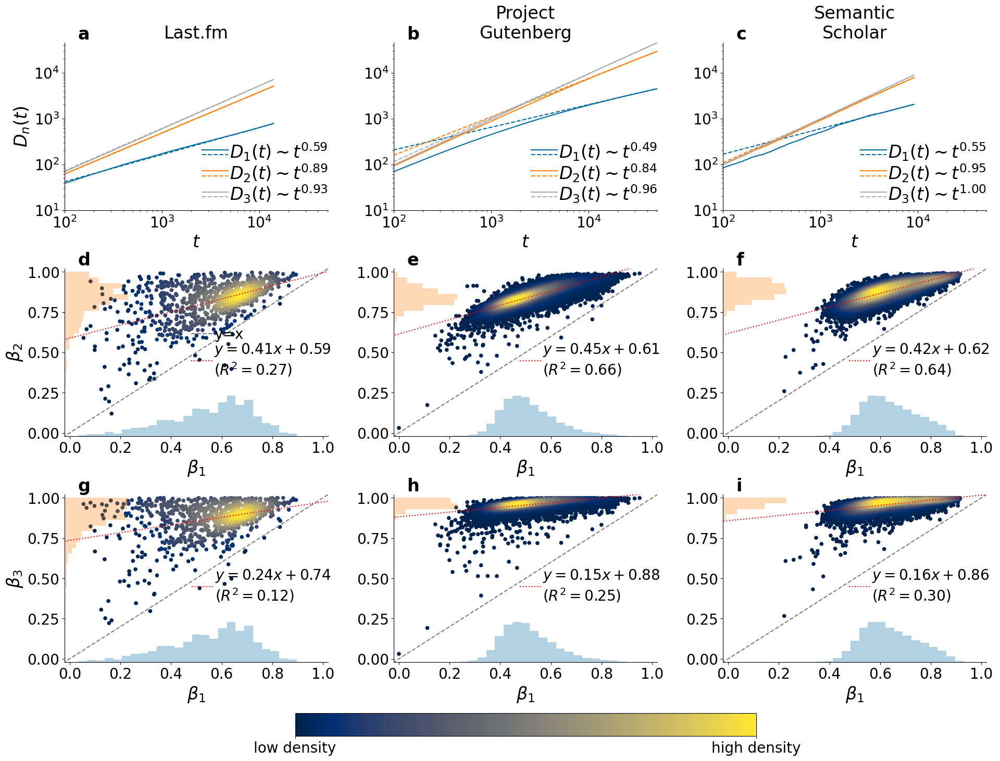

In [18]:
fig = fig_1(
    data_labels, 
    marker_size = 20, 
    alpha_scatter = 1, 
    alpha_histogram = 0.3, 
    color_x = CB_color_cycle[0], 
    color_y = CB_color_cycle[1], 
    max_hist = 0.25, 
    xlim_left_a = 1e2, 
    ylim_bottom_a = 1e1,
    min_beta = min_beta_labels,
    max_beta = max_beta_labels,
    min_beta_higher = min_beta_higher_labels,
    max_beta_higher = max_beta_higher_labels,
)

fig.savefig(os.path.join(figures_folder, f"FigSI_Heaps_datasets_labels.png"))
fig.savefig(os.path.join(figures_folder, f"FigSI_Heaps_datasets_labels_low_res.pdf"),format='pdf',dpi=100)
fig.savefig(os.path.join(figures_folder, f"FigSI_Heaps_datasets_labels.pdf"),format='pdf')

## Figure SI: Distribution of exponents compared

In [19]:
data.keys()

dict_keys(['Last.fm', 'Project Gutenberg', 'Semantic Scholar'])

In [20]:
minimum_1 = min([min(list(_['betas']) + list(_['betas2']) + list(_['betas3']) + list(_['betas4'])) for _ in data_labels.values()])
maximum_1 = max([max(list(_['betas']) + list(_['betas2']) + list(_['betas3']) + list(_['betas4'])) for _ in data_labels.values()])
minimum_1, maximum_1

(-1.3748081562070524e-09, 0.9999537137863118)

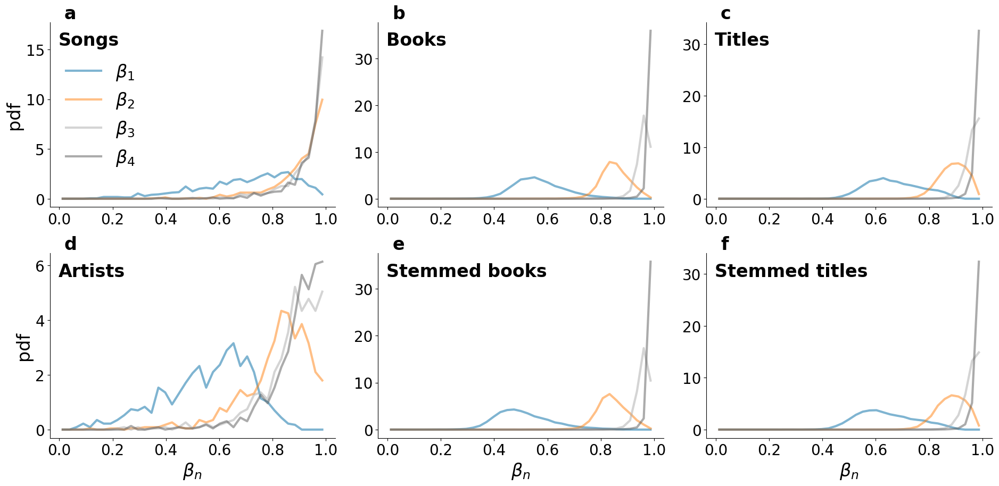

In [26]:
num_datasets = len(data)
write_number = True
fig = plt.figure(figsize=(width_fig*num_datasets/3,width_fig*2/3*2/3))
outer = gridspec.GridSpec(nrows=2, ncols=num_datasets,width_ratios = [10]*num_datasets, hspace=0.25, wspace=0.15)

minimum_0 = min([min(list(_['betas']) + list(_['betas2']) + list(_['betas3']) + list(_['betas4'])) for _ in data.values()])
maximum_0 = max([max(list(_['betas']) + list(_['betas2']) + list(_['betas3']) + list(_['betas4'])) for _ in data.values()])
minimum_1 = min([min(list(_['betas']) + list(_['betas2']) + list(_['betas3']) + list(_['betas4'])) for _ in data_labels.values()])
maximum_1 = max([max(list(_['betas']) + list(_['betas2']) + list(_['betas3']) + list(_['betas4'])) for _ in data_labels.values()])
minimum = min([minimum_0,minimum_1])
maximum = max([maximum_0,maximum_1])
num_bins = 40
letters = 'ABCDEFGHIJKLMNOPQRSTUVWXYZ'.lower()
number_to_write = -1

first_row_labels = {'Last.fm': 'Songs', 'Project Gutenberg': 'Books', 'Semantic Scholar': 'Titles'}
second_row_labels = {'Last.fm': 'Artists', 'Project Gutenberg': 'Stemmed books', 'Semantic Scholar': 'Stemmed titles'}
for i, (dataset_label, dataset_dict) in enumerate(data.items()):
    colors = []
    legend_labels = []
    ax = plt.Subplot(fig, outer[0,i])
    for order,key in enumerate(['betas', 'betas2', 'betas3', 'betas4']):
        data_to_hist = dataset_dict[key]
        hist,bin_edges = np.histogram(data_to_hist, 
                np.linspace(minimum, maximum, num_bins), 
                density=True)
        bin_centers = (bin_edges[1:]+bin_edges[:-1])/2
        p = ax.plot(bin_centers, hist, alpha=0.5,lw=3, label = r"$\beta_%d$"%(order+1))
    ax.text(0.03, 0.95, first_row_labels[dataset_label], transform=ax.transAxes, fontweight='bold', horizontalalignment='left', verticalalignment='top')
    if i == 0:
        ax.legend(loc='center left')
        ax.set_ylabel('pdf')
    
    if write_number == True:
        number_to_write += 1
#         ax.text(0.5, 1.08, f"{letters[number_to_write]}", transform=ax.transAxes,fontweight='bold', horizontalalignment='center')
        ax.text(0.05, 1, f"{letters[number_to_write]}", transform=ax.transAxes,fontweight='bold', horizontalalignment='left', verticalalignment='bottom')
    fig.add_subplot(ax)

    
for i, (dataset_label, dataset_dict) in enumerate(data_labels.items()):
    colors = []
    legend_labels = []
    ax = plt.Subplot(fig, outer[1,i])
    for order,key in enumerate(['betas', 'betas2', 'betas3', 'betas4']):
        data_to_hist = dataset_dict[key]
        hist,bin_edges = np.histogram(data_to_hist, 
                np.linspace(minimum, maximum, num_bins), 
                density=True)
        bin_centers = (bin_edges[1:]+bin_edges[:-1])/2
        p = ax.plot(bin_centers, hist, alpha=0.5,lw=3, label = r"$\beta_%d$"%(order+1))
    ax.text(0.03, 0.95, second_row_labels[dataset_label], transform=ax.transAxes, fontweight='bold', horizontalalignment='left', verticalalignment='top')
    ax.set_xlabel(r"$\beta_n$")
    if i == 0:
#         ax.legend(labelspacing=0.1)
        ax.set_ylabel('pdf')
    
    if write_number == True:
        number_to_write += 1
#         ax.text(0.5, 1.08, f"{letters[number_to_write]}", transform=ax.transAxes,fontweight='bold', horizontalalignment='center')
        ax.text(0.05, 1, f"{letters[number_to_write]}", transform=ax.transAxes,fontweight='bold', horizontalalignment='left', verticalalignment='bottom')
    fig.add_subplot(ax)

fig.savefig(os.path.join(figures_folder, f"FigSI_distribution_beta_datasets.png"))
fig.savefig(os.path.join(figures_folder, f"FigSI_distribution_beta_datasets.pdf"),format='pdf')

# Figure: Clustering (Entropy) in DATA

## Load data with entropy

In [27]:
with gzip.open('./data/essential_entropy_data_for_figure.pkl.gz', "rb") as fp:
    data_with_entropy = joblib.load(fp)

## Create data with entropy

Use this section only on the first run. Otherwise, just load the prepared data on the previous section

In [802]:
data_with_entropy = {}
data_with_entropy['Last.fm'] = {}
data_with_entropy['Project Gutenberg'] = {}
data_with_entropy['Semantic Scholar'] = {}

### Last.fm

In [831]:
data_folder = "./data/ocelma-dataset/lastfm-dataset-1K/"
analysis_folder = data_folder

dataset = {}

paths = glob.glob(os.path.join(analysis_folder, 'individual_results_entropy','*.pkl'))

dataset['len'] = []
dataset['mean_entropies'] = {}
dataset['mean_entropies_glob'] = {}
dataset['mean_entropies_pairs'] = {}
dataset['mean_entropies_glob_pairs'] = {}
dataset['weighted_diff_entropies'] = []
dataset['weighted_diff_entropies_pairs'] = []
for n_order, order in enumerate(['','2','3','4'], start=1):
    dataset[f'betas{order}'] = []
    dataset[f'intercepts{order}'] = []
count = 0
for path in tqdm(paths):
    try:
        file_name = path[-path[::-1].index('/'):path.index('.pkl')]
        with open(path, 'rb') as fp:
            entropy_result = joblib.load(fp)
        with open(os.path.join(analysis_folder, 'individual_results_light',f'{file_name}_light.pkl'), 'rb') as fp:
            result = joblib.load(fp)
        for i_order,order in enumerate(['', '_pairs']):
            n_order = i_order + 1
            for freq,value in entropy_result[f'mean_entropies{order}'].items():
                try:
                    dataset[f'mean_entropies{order}'][freq].append(value)
                except KeyError:
                    dataset[f'mean_entropies{order}'][freq] = [value]
            for freq,value in entropy_result[f'mean_entropies_glob{order}'].items():
                try:
                    dataset[f'mean_entropies_glob{order}'][freq].append(value)
                except KeyError:
                    dataset[f'mean_entropies_glob{order}'][freq] = [value]
        dataset['weighted_diff_entropies'].append(entropy_result['weighted_diff_entropies'])
        dataset['weighted_diff_entropies_pairs'].append(entropy_result['weighted_diff_entropies_pairs'])
        dataset['len'].append(result["ts"][-1])
        # Add also information on beta
        for n_order, order in enumerate(['','2','3','4'], start=1):
            dataset[f'betas{order}'].append(result[f'beta{order}_loglogregr_indices_geom'][-1])
            dataset[f'intercepts{order}'].append(result[f'intercept{order}_loglogregr_indices_geom'][-1])
        # Add correct entropy difference to light result
        result['weighted_diff_entropies'] = entropy_result['weighted_diff_entropies']
        result['weighted_diff_entropies_pairs'] = entropy_result['weighted_diff_entropies_pairs']
        result['len'] = result["ts"][-1]
        with open(os.path.join(analysis_folder, 'individual_results_light',f'{file_name}_light.pkl'), 'wb') as fp:
            pickle.dump(result,fp)
        count += 1
    except:
        pass
print(count)
data_with_entropy['Last.fm'] = dataset.copy()

  0%|          | 0/890 [00:00<?, ?it/s]

889


### Gutenberg

In [851]:
data_folder = './data/gutenberg/sequences_indexed/'
analysis_folder = './data/gutenberg/analysis/'

dataset = {}

paths = glob.glob(os.path.join(analysis_folder, 'individual_results_entropy','*.pkl'))

dataset['len'] = []
dataset['mean_entropies'] = {}
dataset['mean_entropies_glob'] = {}
dataset['mean_entropies_pairs'] = {}
dataset['mean_entropies_glob_pairs'] = {}
dataset['weighted_diff_entropies'] = []
dataset['weighted_diff_entropies_pairs'] = []
for n_order, order in enumerate(['','2','3','4'], start=1):
    dataset[f'betas{order}'] = []
    dataset[f'intercepts{order}'] = []
count = 0
for path in tqdm(paths):
#     try:
        file_name = path[-path[::-1].index('/'):path.index('.pkl')]
        with open(path, 'rb') as fp:
            entropy_result = joblib.load(fp)
        with open(os.path.join(analysis_folder, 'individual_results_light',f'{file_name}_light.pkl'), 'rb') as fp:
            result = joblib.load(fp)
#         result = results_light_individual_gutenberg[file_name]
        for i_order,order in enumerate(['', '_pairs']):
            n_order = i_order + 1
            for freq,value in entropy_result[f'mean_entropies{order}'].items():
                try:
                    dataset[f'mean_entropies{order}'][freq].append(value)
                except KeyError:
                    dataset[f'mean_entropies{order}'][freq] = [value]
            for freq,value in entropy_result[f'mean_entropies_glob{order}'].items():
                try:
                    dataset[f'mean_entropies_glob{order}'][freq].append(value)
                except KeyError:
                    dataset[f'mean_entropies_glob{order}'][freq] = [value]
        dataset['weighted_diff_entropies'].append(entropy_result['weighted_diff_entropies'])
        dataset['weighted_diff_entropies_pairs'].append(entropy_result['weighted_diff_entropies_pairs'])
        dataset['len'].append(result["ts"][-1])
        # Add also information on beta
        for n_order, order in enumerate(['','2','3','4'], start=1):
            dataset[f'betas{order}'].append(result[f'beta{order}_loglogregr_indices_geom'][-1])
            dataset[f'intercepts{order}'].append(result[f'intercept{order}_loglogregr_indices_geom'][-1])
        # Add correct entropy difference to light result
        result['weighted_diff_entropies'] = entropy_result['weighted_diff_entropies']
        result['weighted_diff_entropies_pairs'] = entropy_result['weighted_diff_entropies_pairs']
        result['len'] = result["ts"][-1]
        with open(os.path.join(analysis_folder, 'individual_results_light',f'{file_name}_light.pkl'), 'wb') as fp:
            pickle.dump(result,fp)
        count += 1
#     except:
#         pass
print(count)
data_with_entropy['Project Gutenberg'] = dataset.copy()

  0%|          | 0/19637 [00:00<?, ?it/s]

19637


### Semantic Scholar

In [852]:
corpus_version = '2022-01-01'
data_folder = os.path.join('./data/semanticscholar',corpus_version, 'data')
analysis_folder = os.path.join('./data/semanticscholar',corpus_version, 'analysis')
with open(os.path.join(data_folder,'all_fieldsOfStudy.tsv'), 'r', newline='\n') as fp:
    tsv_output = csv.reader(fp, delimiter='\n')
    all_fieldsOfStudy = [] 
    for _ in tsv_output:
        all_fieldsOfStudy.append(_[0])

dataset = {}
dataset['len'] = []
dataset['mean_entropies'] = {}
dataset['mean_entropies_glob'] = {}
dataset['mean_entropies_pairs'] = {}
dataset['mean_entropies_glob_pairs'] = {}
dataset['weighted_diff_entropies'] = []
dataset['weighted_diff_entropies_pairs'] = []
for n_order, order in enumerate(['','2','3','4'], start=1):
    dataset[f'betas{order}'] = []
    dataset[f'intercepts{order}'] = []
count = 0

num_journals = 1000
for fieldOfStudy in tqdm(all_fieldsOfStudy):
    paths = sorted(find_pattern('*.pkl', os.path.join(analysis_folder, 'journals_fieldsOfStudy_entropy',fieldOfStudy)))
    if len(paths) != num_journals:
        print(f'Error! Found {len(paths)} journals for {fieldOfStudy} instead of {num_journals}')
#         break

    for path in tqdm(paths):
        try:
            file_name = path[-path[::-1].index('/'):path.index('.pkl')]
            with open(path, 'rb') as fp:
                entropy_result = joblib.load(fp)
            try:
                os.rename(os.path.join(analysis_folder, 'journals_fieldsOfStudy_light', fieldOfStudy,f'{file_name}.pkl'), os.path.join(analysis_folder, 'journals_fieldsOfStudy_light', fieldOfStudy,f'{file_name}_light.pkl'))
            except:
                pass
            with open(os.path.join(analysis_folder, 'journals_fieldsOfStudy_light', fieldOfStudy,f'{file_name}_light.pkl'), 'rb') as fp:
                result = joblib.load(fp)
            for i_order,order in enumerate(['', '_pairs']):
                n_order = i_order + 1
                for freq,value in entropy_result[f'mean_entropies{order}'].items():
                    try:
                        dataset[f'mean_entropies{order}'][freq].append(value)
                    except KeyError:
                        dataset[f'mean_entropies{order}'][freq] = [value]
                for freq,value in entropy_result[f'mean_entropies_glob{order}'].items():
                    try:
                        dataset[f'mean_entropies_glob{order}'][freq].append(value)
                    except KeyError:
                        dataset[f'mean_entropies_glob{order}'][freq] = [value]
            dataset['weighted_diff_entropies'].append(entropy_result['weighted_diff_entropies'])
            dataset['weighted_diff_entropies_pairs'].append(entropy_result['weighted_diff_entropies_pairs'])
            dataset['len'].append(result["ts"][-1])
            # Add also information on beta
            for n_order, order in enumerate(['','2','3','4'], start=1):
                dataset[f'betas{order}'].append(result[f'beta{order}_loglogregr_indices_geom'][-1])
                dataset[f'intercepts{order}'].append(result[f'intercept{order}_loglogregr_indices_geom'][-1])
            # Add correct entropy difference to light result
            result['weighted_diff_entropies'] = entropy_result['weighted_diff_entropies']
            result['weighted_diff_entropies_pairs'] = entropy_result['weighted_diff_entropies_pairs']
            result['len'] = result["ts"][-1]
            with open(os.path.join(analysis_folder, 'journals_fieldsOfStudy_light', fieldOfStudy, f'{file_name}_light.pkl'), 'wb') as fp:
                pickle.dump(result,fp)
            count += 1
        except:
            pass
print(count)
data_with_entropy['Semantic Scholar'] = dataset.copy()

  0%|          | 0/19 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

19000


### Dump data

In [853]:
for key,val in data_with_entropy.items():
    print(key,len(val['betas']))

Last.fm 889
Project Gutenberg 19637
Semantic Scholar 19000


In [854]:
with gzip.open('./data/essential_entropy_data_for_figure.pkl.gz', "wb") as fp:
    joblib.dump(data_with_entropy, fp)
print('Dumped')

Dumped


## Functions

In [28]:
def subplot_entropy_by_freq(result, 
                    ax = None, marker_size = 20, alpha = 0.5, 
                    dataset_label = None, 
                    number_to_write = 0, 
                    do_legend = True,
                    num_bins = 35,
                    xlim_left = 1, xlim_right = None, 
                    ylim_bottom = 0, ylim_top = 1, 
                    ylabel = r"$S(f)$", xlabel = r"$f$", 
                    write_number = False):
    if ax == None:
        fig, ax = plt.subplots()
    # color cycle
    colors_old = plt.rcParams['axes.prop_cycle'].by_key()['color']
    colors = colors_old.copy()
    colors[0] = colors_old[2]
    colors[1] = colors_old[0]
    colors[2] = colors_old[1]
    markers = ['s', 'o', 'd']
    
    
    x = [freq for i_order,order in enumerate(['', '_pairs']) for freq,values in result[f"mean_entropies{order}"].items() for value in values]
    max_x = max(x)
    min_x = min(x)
    num_bins = num_bins
    x_bins_lim = np.array([min_x-0.5] + list(np.array(np.unique(np.geomspace(min_x, max_x, num = num_bins, dtype=int)),dtype=float) + 0.5))
    x_bins_centers = (x_bins_lim[1:] + x_bins_lim[:-1]) / 2

    x = [freq  for freq,values in result[f"mean_entropies_glob"].items() for value in values]
    y = [value  for freq,values in result[f"mean_entropies_glob"].items() for value in values]
    y_bins_count = np.zeros(len(x_bins_centers))
    y_bins_sum = np.zeros(len(x_bins_centers))
    for index,freq in enumerate(x):
        value = y[index]
        for index_bin, x_bins_lim_right in enumerate(x_bins_lim[1:]):
            if freq < x_bins_lim_right:
                break
        y_bins_sum[index_bin] += value
        y_bins_count[index_bin] += 1
    y_bins = np.zeros(len(x_bins_centers))
    for index,y_sum in enumerate(y_bins_sum):
        y_count = y_bins_count[index]
        if y_count > 0:
            y_bins[index] = y_sum / y_count
    ax.scatter(
        [_ for i_,_ in enumerate(x_bins_centers) if y_bins_count[i_] > 0], 
        [_ for i_,_ in enumerate(y_bins) if y_bins_count[i_] > 0],
        marker=markers[0], rasterized = True, facecolors='none', edgecolor=colors[0], #next(cycler)['color'], 
        linewidth=1.5, label=r"$\tilde{S}(f)$", alpha=alpha, s=marker_size, )
    
    for i_order,order in enumerate(['', '_pairs']):
        n_order = i_order + 1  
        x = [freq  for freq,values in result[f"mean_entropies{order}"].items() for value in values]
        y = [value  for freq,values in result[f"mean_entropies{order}"].items() for value in values]
        y_bins_count = np.zeros(len(x_bins_centers))
        y_bins_sum = np.zeros(len(x_bins_centers))
        for index,freq in enumerate(x):
            value = y[index]
            for index_bin, x_bins_lim_right in enumerate(x_bins_lim[1:]):
                if freq < x_bins_lim_right:
                    break
            y_bins_sum[index_bin] += value
            y_bins_count[index_bin] += 1
        y_bins = np.zeros(len(x_bins_centers))
        for index,y_sum in enumerate(y_bins_sum):
            y_count = y_bins_count[index]
            if y_count > 0:
                y_bins[index] = y_sum / y_count
        ax.scatter(
        [_ for i_,_ in enumerate(x_bins_centers) if y_bins_count[i_] > 0], 
        [_ for i_,_ in enumerate(y_bins) if y_bins_count[i_] > 0],
        marker=markers[n_order], rasterized = True, facecolors='none', edgecolor=colors[n_order], #next(cycler)['color'], 
            linewidth=1.5, label=r'$S_%d(f)$'%n_order, alpha=alpha, s=marker_size) # r"$\mathcal{S}_{%d}$"%n_order
    
    ax.set_xscale("log")
    ax.set_xlim(left = xlim_left, right = xlim_right)
    ax.set_ylim(bottom = ylim_bottom, top = ylim_top)
    ax.set_ylabel(ylabel)
    ax.set_xlabel(xlabel)
    
    if do_legend == True:
        leg = ax.legend(handletextpad=0.1, loc="best", labelspacing = 0.1) # , bbox_to_anchor=(1.06,-0.06), loc="lower right"
#         for lh in leg.legendHandles: 
#             lh.set_alpha(1)
    if dataset_label != None:
#         ax.text(-0.33,0.5, dataset_label, rotation=90,verticalalignment='center',horizontalalignment='right',fontweight='bold', transform=ax.transAxes) 
        ax.set_title(dataset_label,verticalalignment='center',horizontalalignment='center', transform=ax.transAxes)  # ,fontweight='bold'

    # Impose xticks
    locmaj = matplotlib.ticker.LogLocator(base=10,numticks=20) 
    ax.xaxis.set_major_locator(locmaj)
    locmin = matplotlib.ticker.LogLocator(base=10.0,subs=(np.arange(0.1,1,0.1)),numticks=20)
    ax.xaxis.set_minor_locator(locmin)
    ax.xaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
    # Impose yticks
    locmaj = matplotlib.ticker.LinearLocator(numticks=6) 
    ax.yaxis.set_major_locator(locmaj)
    locmin = matplotlib.ticker.LinearLocator(numticks=11)
    ax.yaxis.set_minor_locator(locmin)
    ax.yaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
    if write_number == True:
        ax.text(0.05, 1, f"{letters[number_to_write]}", transform=ax.transAxes,fontweight='bold', horizontalalignment='left', verticalalignment='bottom')
    return ax

In [29]:
def subplot_entropy_diff_distr(dataset_dict, 
                    ax = None, alpha = 0.5, 
                    number_to_write = 0, 
                    num_bins = 35,
                    xlim_left = -0.1, xlim_right = 0.6, 
                    xlabel = r"$\langle \Delta S_n \rangle$", 
                    ylabel = r"pdf", 
                    do_legend = True,
                    write_number = False):
    if ax == None:
        fig, ax = plt.subplots()
    
    if xlim_left == None:
        xlim_left = 1000000
        for n_order,key in enumerate(['weighted_diff_entropies', 'weighted_diff_entropies_pairs'], start = 1):
            xlim_left = min(xlim_left, min(dataset_dict[key]))
    if xlim_right == None:
        xlim_right = -10000
        for n_order,key in enumerate(['weighted_diff_entropies', 'weighted_diff_entropies_pairs'], start = 1):
            xlim_right = max(xlim_right, max(dataset_dict[key]))

    for n_order,key in enumerate(['weighted_diff_entropies', 'weighted_diff_entropies_pairs'], start = 1):
        data_to_hist = dataset_dict[key]
        hist,bin_edges = np.histogram(data_to_hist, 
                np.linspace(xlim_left, xlim_right, num_bins), 
                density=True)
        bin_centers = (bin_edges[1:]+bin_edges[:-1])/2
        p = ax.plot(bin_centers, hist, alpha=0.5,lw=3, label = r"$\langle \Delta S_{%d} \rangle$"%(n_order))
    
    # Impose xticks
    ax.set_xticks(np.arange(-10,10.0000001,0.1), minor=True)
    ax.set_xticks(np.arange(-10,10.0000001,0.2), minor=False)
    
    ax.set_xlim(left = xlim_left, right = xlim_right)
    
    ax.set_xlabel(xlabel)
    ax.set_ylabel(ylabel)

    if do_legend == True:
        leg = ax.legend(handletextpad=0.2, loc="best", labelspacing = 0.1) # , bbox_to_anchor=(0.0,1.06), loc="upper left") # labelspacing = 0, 
#         for lh in leg.legendHandles: 
#             lh.set_alpha(1)

    if write_number == True:
        ax.text(0.05, 1.0, f"{letters[number_to_write]}", transform=ax.transAxes,fontweight='bold', horizontalalignment='left', verticalalignment='bottom')
    return ax

In [30]:
def fig_2(data, marker_size = 20, alpha_scatter = 1, 
          num_bins = 35,
          min_x_entropy_by_freq = 1,
          max_x_entropy_by_freq = None,
          min_x_entropy_diff_distr = None,
          max_x_entropy_diff_distr = None,
          use_same_x_y_max_lim = True,
         ):
    """
        use_same_x_y_max_lim changes the limits so that they all plots have the same lim, BUT ONLY IF they have the related limit parameter is None, otherwise it is set to that value for everyone.
    """
    num_datasets = len(data)
    nrows = 2
    ncols = num_datasets
    fig = plt.figure(figsize=(width_fig*ncols/3,width_fig*2/3*nrows/3*9/10))
    wspace = 0.25
    hspace = 0.35
    outer = gridspec.GridSpec(nrows=nrows, ncols=ncols,wspace=wspace,hspace=hspace)
    
    # get highest f to unify first row
    if use_same_x_y_max_lim == True:
        if max_x_entropy_by_freq is None:
            max_x_entropy_by_freq_tmp = -9999999999
        if min_x_entropy_diff_distr is None:
            min_x_entropy_diff_distr_tmp = 9999999999
        if max_x_entropy_diff_distr is None:
            max_x_entropy_diff_distr_tmp = -9999999999
        for dataset_label, dataset_dict in data.items():
            x = [freq for i_order,order in enumerate(['', '_pairs']) for freq,values in dataset_dict[f"mean_entropies"].items() for value in values]
            if max_x_entropy_by_freq is None:
                max_x_entropy_by_freq_tmp = max(max_x_entropy_by_freq_tmp, max(x))
            x = dataset_dict[f"weighted_diff_entropies"]
            if min_x_entropy_diff_distr is None:
                min_x_entropy_diff_distr_tmp = min(min_x_entropy_diff_distr_tmp, min(x))
            if max_x_entropy_diff_distr is None:
                max_x_entropy_diff_distr_tmp = max(max_x_entropy_diff_distr_tmp, max(x))
            x = dataset_dict[f"weighted_diff_entropies_pairs"]
            if min_x_entropy_diff_distr is None:
                min_x_entropy_diff_distr_tmp = min(min_x_entropy_diff_distr_tmp, min(x))
            if max_x_entropy_diff_distr is None:
                max_x_entropy_diff_distr_tmp = max(max_x_entropy_diff_distr_tmp, max(x))
        if max_x_entropy_by_freq is None:
            max_x_entropy_by_freq = max_x_entropy_by_freq_tmp
        if min_x_entropy_diff_distr is None:
            min_x_entropy_diff_distr = min_x_entropy_diff_distr_tmp
        if max_x_entropy_diff_distr is None:
            max_x_entropy_diff_distr = max_x_entropy_diff_distr_tmp
        
    for column, (dataset_label, dataset_dict) in enumerate(data.items()):
        row = 0
        ax = plt.Subplot(fig, outer[row*ncols+column])
        subplot_entropy_by_freq(dataset_dict, 
                        ax = ax, dataset_label = '\n'.join(dataset_label.split(' ')),
                        marker_size = marker_size, alpha = alpha_scatter, 
                        number_to_write = row*ncols+column, 
                        num_bins = num_bins,
                        do_legend = column == 0,
                        xlim_left = min_x_entropy_by_freq, xlim_right = max_x_entropy_by_freq, 
                        ylim_bottom = 0, ylim_top = 1, 
                        xlabel = r"$f$", write_number = True,
                        ylabel = r"$S(f)$" if column == 0 else None, 
                       )
        fig.add_subplot(ax)
        
        row = 1
        ax = plt.Subplot(fig, outer[row*ncols+column])
        subplot_entropy_diff_distr(dataset_dict,
                          ax = ax, 
                          num_bins = num_bins,
                          number_to_write = row*ncols+column, 
                          write_number = True, 
                          do_legend = column == 0,
                          xlabel = r"$\langle \Delta S_n \rangle$", 
                          ylabel = r"pdf" if column == 0 else None, 
                          xlim_left=min_x_entropy_diff_distr, xlim_right=max_x_entropy_diff_distr, 
                         )
        fig.add_subplot(ax)
    
    return fig

### Fig 4

In [31]:
def fig_4_subplot_a(result, 
                    ax = None, marker_size = 20, alpha = 0.5, 
                    dataset_label = None, 
                    number_to_write = 0, 
                    num_bins = 50,
                    xlim_left = 1, xlim_right = None, 
                    ylim_bottom = 0, ylim_top = 1, 
                    ylabel = r"$S(f)$", xlabel = r"$f$", 
                    write_number = False):
    if ax == None:
        fig, ax = plt.subplots()
       # orig 
#     ax.scatter(list(result["mean_entropies"].keys()),list(result["mean_entropies"].values()), rasterized = True, label=r"original", alpha=alpha)
#     ax.scatter(list(result["mean_entropies_glob"].keys()),list(result["mean_entropies_glob"].values()), marker='s', rasterized = True, label=r"reshuffled", alpha=alpha)
    # with all of them
#     ax.scatter(
#         [freq for tmp_i, tmp_dict in result["mean_entropies"].items() for freq,value in tmp_dict.items()],
#         [value for tmp_i, tmp_dict in result["mean_entropies"].items() for freq,value in tmp_dict.items()], 
#         rasterized = True, label=r"original", alpha=alpha, s=marker_size)
#     ax.scatter(
#         [freq for tmp_i, tmp_dict in result["mean_entropies_glob"].items() for freq,value in tmp_dict.items()],
#         [value for tmp_i, tmp_dict in result["mean_entropies_glob"].items() for freq,value in tmp_dict.items()], 
#         marker='s', rasterized = True, label=r"reshuffled", alpha=alpha, s=marker_size)
#     # with average of them
#     ax.scatter(
#         [freq  for freq,value in result["mean_entropies"].items()],
#         [np.mean(value)  for freq,value in result["mean_entropies"].items()],
#         rasterized = True, label=r"original", alpha=alpha, s=marker_size)
#     ax.scatter(
#         [freq for freq,value in result["mean_entropies_glob"].items()],
#         [np.mean(value) for freq,value in result["mean_entropies_glob"].items()],
#         marker='s', rasterized = True, label=r"reshuffled", alpha=alpha, s=marker_size)
    # with average of them binned
    x = [freq for i_order,order in enumerate(['', '_pairs']) for freq,values in result[f"mean_entropies{order}"].items() for value in values]
    max_x = max(x)
    min_x = min(x)
    num_bins = num_bins
    x_bins_lim = np.array([min_x-0.5] + list(np.array(np.unique(np.geomspace(min_x, max_x, num = num_bins, dtype=int)),dtype=float) + 0.5))
    x_bins_centers = (x_bins_lim[1:] + x_bins_lim[:-1]) / 2

    cycler = ax._get_lines.prop_cycler # to get the cycle of colors to use
    
    for i_order,order in enumerate(['', '_pairs']):
        n_order = i_order + 1  
        x = [freq  for freq,values in result[f"mean_entropies{order}"].items() for value in values]
#         max_x = max(x)
#         min_x = min(x)
#         num_bins = num_bins
#         x_bins_lim = np.array([min_x-0.5] + list(np.array(np.unique(np.geomspace(min_x, max_x, num = num_bins, dtype=int)),dtype=float) + 0.5))
#         x_bins_centers = (x_bins_lim[1:] + x_bins_lim[:-1]) / 2
        y = [value  for freq,values in result[f"mean_entropies{order}"].items() for value in values]
        y_bins_count = np.zeros(len(x_bins_centers))
        y_bins_sum = np.zeros(len(x_bins_centers))
        for index,freq in enumerate(x):
            value = y[index]
            for index_bin, x_bins_lim_right in enumerate(x_bins_lim[1:]):
                if freq < x_bins_lim_right:
                    break
            y_bins_sum[index_bin] += value
            y_bins_count[index_bin] += 1
        y_bins = np.zeros(len(x_bins_centers))
        for index,y_sum in enumerate(y_bins_sum):
            y_count = y_bins_count[index]
            if y_count > 0:
                y_bins[index] = y_sum / y_count
    #     y_bins = y_bins_sum / y_bins_count
        if i_order == 1:
            ax.scatter(
            [_ for i_,_ in enumerate(x_bins_centers) if y_bins_count[i_] > 0], 
            [_ for i_,_ in enumerate(y_bins) if y_bins_count[i_] > 0],
            marker='d', rasterized = True, facecolors='none', edgecolor=next(cycler)['color'], 
                linewidth=2, label='pairs', alpha=alpha, s=marker_size) # r"$\mathcal{S}_{%d}$"%n_order
        else:
#         if i_order == 0:
            ax.scatter(
            [_ for i_,_ in enumerate(x_bins_centers) if y_bins_count[i_] > 0], 
            [_ for i_,_ in enumerate(y_bins) if y_bins_count[i_] > 0],
            rasterized = True, facecolors='none', edgecolor=next(cycler)['color'], 
                linewidth=2, label='singletons', alpha=alpha, s=marker_size) # r"$\mathcal{Q}_{%d}$"%n_order
        
#             x = [freq  for freq,values in result[f"mean_entropies_glob{order}"].items() for value in values]
#             max_x = max(x)
#             min_x = min(x)
#             x_bins_lim = np.array([min_x-0.5] + list(np.array(np.unique(np.geomspace(min_x, max_x, num = num_bins, dtype=int)),dtype=float) + 0.5))
#             x_bins_centers = (x_bins_lim[1:] + x_bins_lim[:-1]) / 2
            y = [value  for freq,values in result[f"mean_entropies_glob{order}"].items() for value in values]
            y_bins_count = np.zeros(len(x_bins_centers))
            y_bins_sum = np.zeros(len(x_bins_centers))
            for index,freq in enumerate(x):
                value = y[index]
                for index_bin, x_bins_lim_right in enumerate(x_bins_lim[1:]):
                    if freq < x_bins_lim_right:
                        break
                y_bins_sum[index_bin] += value
                y_bins_count[index_bin] += 1
            y_bins = np.zeros(len(x_bins_centers))
            for index,y_sum in enumerate(y_bins_sum):
                y_count = y_bins_count[index]
                if y_count > 0:
                    y_bins[index] = y_sum / y_count
        #     y_bins = y_bins_sum / y_bins_count
            ax.scatter(
                [_ for i_,_ in enumerate(x_bins_centers) if y_bins_count[i_] > 0], 
                [_ for i_,_ in enumerate(y_bins) if y_bins_count[i_] > 0],
                marker='s', rasterized = True, facecolors='none', edgecolor=next(cycler)['color'], 
                linewidth=2, label="random", alpha=alpha, s=marker_size)

    ax.set_xscale("log")
    ax.set_xlim(left = xlim_left, right = xlim_right)
    ax.set_ylim(bottom = ylim_bottom, top = ylim_top)
    ax.set_ylabel(ylabel)
    ax.set_xlabel(xlabel)
    if number_to_write == 0:
        leg = ax.legend(handletextpad=0.1, bbox_to_anchor=(1.06,-0.06), loc="lower right", labelspacing = 0) # , bbox_to_anchor=(0.0,1.06), loc="upper left") # labelspacing = 0, 
        for lh in leg.legendHandles: 
            lh.set_alpha(1)
    if dataset_label != None:
        ax.text(-0.33,0.5, dataset_label, rotation=90,verticalalignment='center',horizontalalignment='right',fontweight='bold', transform=ax.transAxes) 

    # Impose xticks
    locmaj = matplotlib.ticker.LogLocator(base=10,numticks=20) 
    ax.xaxis.set_major_locator(locmaj)
    locmin = matplotlib.ticker.LogLocator(base=10.0,subs=(np.arange(0.1,1,0.1)),numticks=20)
    ax.xaxis.set_minor_locator(locmin)
    ax.xaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
    # Impose yticks
    locmaj = matplotlib.ticker.LinearLocator(numticks=6) 
    ax.yaxis.set_major_locator(locmaj)
    locmin = matplotlib.ticker.LinearLocator(numticks=11)
    ax.yaxis.set_minor_locator(locmin)
    ax.yaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
    if write_number == True:
        ax.text(0.5, 1.08, f"{letters[number_to_write]}", transform=ax.transAxes,fontweight='bold', horizontalalignment='center')
    return ax

In [32]:
def scatter_with_third_variable(x, y, z, ax = None, alpha = 1, marker_size = 20, label_scatter = None):
    if ax == None:
        fig, ax = plt.subplots()
    idx = z.argsort()
    x, y, z = x[idx], y[idx], z[idx]
    ax.scatter(x, y, c=z, s=marker_size, alpha = alpha, label = label_scatter, rasterized=True)

In [33]:
def fig_4_subplot_b_d(x, y, z, ax = None, plot_pearson = False, marker_size = 20, alpha_scatter = 1, alpha_histogram = 0.3, x_correlation_text = .1, y_correlation_text = .8, color_x = CB_color_cycle[0], color_y = CB_color_cycle[1], max_hist = 0.25, number_to_write = 0, write_number = False, ylabel = None, xlabel = None, min_x = None, max_x = None, min_y = None, max_y = None):
    if min_x == None:
        min_x = min(x)
    if max_x == None:
        max_x = max(x)
    if min_y == None:
        min_y = min(y)
    if max_y == None:
        max_y = max(y)
    if ax == None:
        fig, ax = plt.subplots()
    scatter_with_third_variable(x, y, z, ax = ax, alpha = alpha_scatter, marker_size = marker_size)
#     plot_distribution_histograms_on_axes(x, y, ax = ax, color_x = color_x, color_y = color_y, alpha = alpha_histogram, max_hist = max_hist, min_x=min_x, max_x=max_x, min_y=min_y, max_y=max_y)
    last_modifications_subplot_scatter_beta(x, y, plot_pearson = plot_pearson, number_to_write = number_to_write, write_number = write_number, x_correlation_text = x_correlation_text, y_correlation_text = y_correlation_text, ax = ax, ylabel = ylabel, xlabel = xlabel, min_x=min_x, max_x=max_x, min_y=min_y, max_y=max_y)


In [34]:
def fig_4(data, marker_size = 20, alpha_scatter = 1, 
          min_x = 0,
          max_x = 1,
          min_y = None,
          max_y = None,
          x_correlation_text = .1, 
          y_correlation_text = .8,
          use_same_x_y_max_lim = True,
         ):
    num_datasets = len(data)
    fig = plt.figure(figsize=(width_fig,width_fig*2/3*num_datasets/3))
    outer = gridspec.GridSpec(nrows=num_datasets+1, ncols=1,height_ratios = [10]*num_datasets+[3],hspace=0.25)
    wspace = 0.38
    ncols = 4
    
    # get highest t and D to unify panel a
    if use_same_x_y_max_lim == True:
        min_x = 1
        max_x = -1
        min_y = 1
        max_y = -1
#         for i, (dataset_label, dataset_dict) in enumerate(data.items()):
        for dataset_label, dataset_dict in data.items():
            for i_order,order in enumerate(['2', '3', '4'], start=1):
                min_x = min(min_x, min(dataset_dict[f'betas{order}']))
                max_x = max(max_x, max(dataset_dict[f'betas{order}']))
            min_y = min(min_y, min(dataset_dict[f'weighted_diff_entropies']))
            max_y = max(max_y, max(dataset_dict[f'weighted_diff_entropies']))
                
    for i, (dataset_label, dataset_dict) in enumerate(data.items()):
        inner = gridspec.GridSpecFromSubplotSpec(1, ncols,
                            subplot_spec=outer[i],width_ratios=[1,1,1,1],wspace=wspace)
        if i == num_datasets - 1:
            xlabel_a = r"$f$"
            xlabel_b_d = {i_order: fr"$\beta_{order}$" for i_order,order in enumerate(['2', '3', '4'], start=1)}
        else:
            xlabel_a = None
            xlabel_b_d = {i_order: None for i_order,order in enumerate(['2', '3', '4'], start=1)}
        ax = plt.Subplot(fig, inner[0])
#         if use_same_x_y_max_lim == False:
#             max_t = dataset_dict['average_results']["ts"][-1]+1
#             max_D = 1
#             for order in ['', '2', '3', '4']:
#                 max_D = max(max_D, dataset_dict['average_results'][f"D{order}_indices"][-1]+1)
#         fig_4_subplot_a(dataset_dict['random_individual'], 
        fig_4_subplot_a(dataset_dict, 
                        ax = ax, dataset_label = dataset_label,
                        marker_size = marker_size, alpha = alpha_scatter, 
                        number_to_write = i*ncols, 
                        xlim_left = 1, xlim_right = None, 
                        ylim_bottom = 0, ylim_top = 1, 
                        ylabel = r"$S(f)$", xlabel = xlabel_a, write_number = i==0,
                       )
        fig.add_subplot(ax)
        
        for i_order,order in enumerate(['2', '3', '4'], start=1):
            ax = plt.Subplot(fig, inner[i_order])
            fig_4_subplot_b_d(np.array(dataset_dict[f'betas{order}']), np.array(dataset_dict['weighted_diff_entropies']), np.array(dataset_dict[f'betas']), 
                              ax = ax, 
                              marker_size = marker_size, alpha_scatter = alpha_scatter,
                              x_correlation_text = x_correlation_text, y_correlation_text = y_correlation_text,
#                               alpha_histogram = alpha_histogram, 
#                               color_x = color_x, color_y = color_y, 
#                               max_hist = max_hist, 
                              number_to_write = i*ncols+i_order, 
                              write_number = i==0, 
                              ylabel = r"$\langle\Delta S \rangle$", xlabel = xlabel_b_d[i_order], 
                              min_x=min_x, max_x=max_x, min_y=min_y, max_y=max_y,
                             )
            fig.add_subplot(ax)
    
    ####################### COLORBAR #######################
    
    inner = gridspec.GridSpecFromSubplotSpec(2, 1,
                            subplot_spec=outer[-1],height_ratios=[1,1],hspace=0)
    ax_cmap = plt.Subplot(fig, inner[1])
    vmin = 0
    vmax = 1
    cb = fig.colorbar(ScalarMappable(norm=Normalize(vmin=vmin,vmax=vmax)), ax=ax_cmap,shrink=0.5,pad=0., fraction=1,orientation='horizontal')
    cb.ax.get_xaxis().set_ticks([0,1]) 
    cb.ax.get_xaxis().set_ticklabels([r'$\min\,\left(\beta_1\right)$', r'$\max\,\left(\beta_1\right)$']) 
    ax_cmap.axis('off')
    fig.add_subplot(ax_cmap)
    
    return fig

In [35]:
def fig_4_old(data, marker_size = 20, alpha_scatter = 1, 
#           min_x = 0,
#           max_x = 1,
#           min_y = None,
#           max_y = None,
              marker_size_b_d = 1,
            min_x = -0.15,
            max_x = 1,
            min_y = -0.15,
            max_y = 1,
          x_correlation_text = .1, 
          y_correlation_text = .8,
          use_same_x_y_max_lim = True,
         ):
    num_datasets = len(data)
    fig = plt.figure(figsize=(width_fig,width_fig*2/3*num_datasets/3))
    outer = gridspec.GridSpec(nrows=num_datasets+1, ncols=1,height_ratios = [10]*num_datasets+[3],hspace=0.25)
    wspace = 0.38
    ncols = 4
    
    # get highest t and D to unify panel a
    if use_same_x_y_max_lim == True:
        min_x = 1
        max_x = -1
        min_y = 1
        max_y = -1
#         for i, (dataset_label, dataset_dict) in enumerate(data.items()):
        for dataset_label, dataset_dict in data.items():
            for i_order,order in enumerate(['2', '3', '4'], start=1):
                min_x = min(min_x, min(dataset_dict[f'betas{order}']))
                max_x = max(max_x, max(dataset_dict[f'betas{order}']))
            min_y = min(min_y, min(dataset_dict[f'weighted_diff_entropies']))
            max_y = max(max_y, max(dataset_dict[f'weighted_diff_entropies']))
                
    for i, (dataset_label, dataset_dict) in enumerate(data.items()):
        inner = gridspec.GridSpecFromSubplotSpec(1, ncols,
                            subplot_spec=outer[i],width_ratios=[1,1,1,1],wspace=wspace)
        if i == num_datasets - 1:
            xlabel_a = r"$f$"
            xlabel_b_d = {i_order: fr"$\beta_{order}$" for i_order,order in enumerate(['2', '3', '4'], start=1)}
        else:
            xlabel_a = None
            xlabel_b_d = {i_order: None for i_order,order in enumerate(['2', '3', '4'], start=1)}
        ax = plt.Subplot(fig, inner[0])
#         if use_same_x_y_max_lim == False:
#             max_t = dataset_dict['average_results']["ts"][-1]+1
#             max_D = 1
#             for order in ['', '2', '3', '4']:
#                 max_D = max(max_D, dataset_dict['average_results'][f"D{order}_indices"][-1]+1)
#         fig_4_subplot_a(dataset_dict['random_individual'], 
        fig_4_subplot_a(dataset_dict, 
                        ax = ax, dataset_label = dataset_label,
                        marker_size = marker_size, alpha = alpha_scatter, 
                        number_to_write = i*ncols, 
                        xlim_left = 1, xlim_right = None, 
                        ylim_bottom = 0, ylim_top = 1, 
                        ylabel = r"$S(f)$", xlabel = xlabel_a, write_number = i==0,
                       )
        fig.add_subplot(ax)
        
#         for i_order,order in enumerate(['2', '3', '4'], start=1):
#         n_order_beta = 1
#         order_beta = str(n_order_beta) if n_order_beta in [2,3,4] else ''
        for i_panel,(x_key, y_key, z_key) in enumerate([(f'betas{""}', f'betas{"2"}','weighted_diff_entropies'), (f'betas{""}',f'betas{"2"}', 'weighted_diff_entropies_pairs'), ('weighted_diff_entropies', 'weighted_diff_entropies_pairs', f'betas{""}')], start=1):
            labels = []
            for key in [x_key, y_key,z_key]:
                if key == 'betas':
                    labels.append(fr"$\beta_{1}$")
                elif key == 'betas2':
                    labels.append(fr"$\beta_{2}$")
                elif key == 'weighted_diff_entropies':
                    labels.append(r"$\langle\Delta S \rangle$")
                elif key == 'weighted_diff_entropies_pairs':
                    labels.append(r"$\langle\Delta S_2 \rangle$")
                else:
                    labels.append(None)
            if i != num_datasets - 1:
                labels[0] = None
            ax = plt.Subplot(fig, inner[i_panel])
            fig_4_subplot_b_d(np.array(dataset_dict[x_key]), np.array(dataset_dict[y_key]), np.array(dataset_dict[z_key]), 
                              ax = ax, 
                              marker_size = marker_size_b_d, alpha_scatter = alpha_scatter,
                              x_correlation_text = x_correlation_text, y_correlation_text = y_correlation_text,
#                               alpha_histogram = alpha_histogram, 
#                               color_x = color_x, color_y = color_y, 
#                               max_hist = max_hist, 
                              number_to_write = i*ncols+i_panel, 
                              write_number = i==0, 
                              xlabel = labels[0], 
                              ylabel = labels[1], 
#                               ylabel = r"$\langle\Delta S \rangle$", xlabel = xlabel_b_d[i_order], 
#                               min_x=min_x, max_x=max_x, min_y=min_y, max_y=max_y,
                              min_x=None, max_x=None, min_y=None, max_y=None,
                             )
            if i == 0:
                ax.set_title(labels[2])
            fig.add_subplot(ax)
    
    ####################### COLORBAR #######################
    
    inner = gridspec.GridSpecFromSubplotSpec(2, 1,
                            subplot_spec=outer[-1],height_ratios=[1,1],hspace=0)
    ax_cmap = plt.Subplot(fig, inner[1])
    vmin = 0
    vmax = 1
    cb = fig.colorbar(ScalarMappable(norm=Normalize(vmin=vmin,vmax=vmax)), ax=ax_cmap,shrink=0.5,pad=0., fraction=1,orientation='horizontal')
    cb.ax.get_xaxis().set_ticks([0,1]) 
#     cb.ax.get_xaxis().set_ticklabels([r'$\min\,\left(\beta_1\right)$', r'$\max\,\left(\beta_1\right)$']) 
    cb.ax.get_xaxis().set_ticklabels([r'low density', r'high density']) 
    ax_cmap.axis('off')
    fig.add_subplot(ax_cmap)
    
    return fig

## Tries with partial determination R squared

In [798]:
dataset_label = 'Last.fm' # 'Last.fm'

In [799]:
dataset = data[dataset_label]

In [800]:
order_in_dataset = {}
order_in_dataset_inverse = {}
for i,beta in enumerate(dataset['betas']):
    order_in_dataset_inverse[i] = beta
    order_in_dataset[beta] = i

In [801]:
dataset_with_entropy = data_with_entropy[dataset_label]

In [802]:
len(set(dataset['betas'])) == len(set(dataset_with_entropy['betas']))# == len(dataset_with_entropy['betas'])

True

In [803]:
order_in_dataset_with_entropy = {}
order_in_dataset_with_entropy_inverse = {}
for i,beta in enumerate(dataset_with_entropy['betas']):
    order_in_dataset_with_entropy[beta] = i    
    order_in_dataset_with_entropy_inverse[i] = beta

In [804]:
new_len = 10000*np.ones(len(dataset['betas']),dtype=int)
for i,l in enumerate(dataset['len']):
    new_len[order_in_dataset_with_entropy[order_in_dataset_inverse[i]]] = l
dataset_with_entropy['len'] = new_len

In [805]:
dataset_with_entropy.keys()

dict_keys(['mean_entropies', 'mean_entropies_glob', 'mean_entropies_pairs', 'mean_entropies_glob_pairs', 'weighted_diff_entropies', 'weighted_diff_entropies_pairs', 'betas', 'intercepts', 'betas2', 'intercepts2', 'betas3', 'intercepts3', 'betas4', 'intercepts4', 'len'])

In [806]:
df = pd.DataFrame(data={k:v for k,v in dataset_with_entropy.items() if k in ['betas', 'weighted_diff_entropies', 'len', 'betas2']})

In [807]:
betas = np.array(df.betas)
betas2 = np.array(df.betas2)
betas2_relative = (betas2 - betas) / (1 - betas)
df['betas2_relative'] = betas2_relative

In [808]:
columns = ['weighted_diff_entropies', 'len']
partial_corr = pg.partial_corr(data = df, x = columns, y = 'betas2', covar = 'betas')
print(partial_corr)
partial_corr.r ** 2

           n         r        CI95%     p-val
pearson  890  0.135576  [0.07, 0.2]  0.000051


pearson    0.018381
Name: r, dtype: float64

In [809]:
columns = ['weighted_diff_entropies', 'betas','len']
Rxx = pg.pairwise_corr(df,columns = [columns, columns])
Rxx = np.ndarray((len(columns),len(columns)), buffer = np.array(Rxx.r))
c = pg.pairwise_corr(df,columns = [columns,['betas2']])
c = np.ndarray((len(columns)), buffer = np.array(c.r))
Rxx, c

(array([[ 1.        ,  0.15717734,  0.04507071],
        [ 0.15717734,  1.        , -0.18071526],
        [ 0.04507071, -0.18071526,  1.        ]]),
 array([-0.37231577,  0.40561976,  0.0059739 ]))

In [810]:
c.T.dot(np.linalg.inv(Rxx)).dot(c)

0.3725730285692201

In [811]:
model = ols("betas2 ~ betas + weighted_diff_entropies + len", data=df).fit()

In [812]:
model1 = ols("betas2 ~ betas", data=df).fit()

In [813]:
model2 = ols("betas2 ~ weighted_diff_entropies + len", data=df).fit()

In [814]:
model.rsquared, model1.rsquared, model2.rsquared, 

(0.3725730285692198, 0.16452738941978517, 0.13913784740881452)

In [815]:
perc1 = model1.ess / model.centered_tss
perc1_g2 = (model.ess - model1.ess) / model.centered_tss
perc2 = model2.ess / model.centered_tss
perc2_g1 = (model.ess - model2.ess) / model.centered_tss
percerr = model.ssr / model.centered_tss
perc1, perc1_g2, perc2, perc2_g1, model.rsquared, percerr

(0.1645273894197852,
 0.20804563914943464,
 0.13913784740881452,
 0.23343518116040535,
 0.3725730285692198,
 0.6274269714307802)

In [816]:
pRsquared1 = (model2.ssr - model.ssr) / model2.ssr # (model.ess - model2.ess) / model.ssr
pRsquared2 = (model1.ssr - model.ssr) / model1.ssr
print(pRsquared1, pRsquared2)

0.2711644140211857 0.249015511118853


In [817]:
model = ols("betas2_relative ~ betas + weighted_diff_entropies + len", data=df).fit()

In [818]:
model1 = ols("betas2_relative ~ betas", data=df).fit()

In [819]:
model2 = ols("betas2_relative ~ weighted_diff_entropies + len", data=df).fit()

In [820]:
model.rsquared, model1.rsquared, model2.rsquared, 

(0.27702730370367445, 0.023627014953933156, 0.2735596868047676)

In [821]:
perc1 = model1.ess / model.centered_tss
perc1_g2 = (model.ess - model1.ess) / model.centered_tss
perc2 = model2.ess / model.centered_tss
perc2_g1 = (model.ess - model2.ess) / model.centered_tss
percerr = model.ssr / model.centered_tss
perc1, perc1_g2, perc2, perc2_g1, model.rsquared, percerr

(0.023627014953933115,
 0.25340028874974135,
 0.2735596868047676,
 0.0034676168989068367,
 0.27702730370367445,
 0.7229726962963255)

In [822]:
pRsquared1 = (model2.ssr - model.ssr) / model2.ssr # (model.ess - model2.ess) / model.ssr
pRsquared2 = (model1.ssr - model.ssr) / model1.ssr
print(pRsquared1, pRsquared2)

0.004773436765444083 0.2595322613701622


More generally, consider partitioning the predictors into two groups, A and B, containing u and k - u predictors, respectively. The proportion of variation explained by the predictors in group B that cannot be explained by the predictors in group A is given by pRsquared2, also called coefficient of partial correlation of the reduced predictors in group B with respect to the full model

## Figure

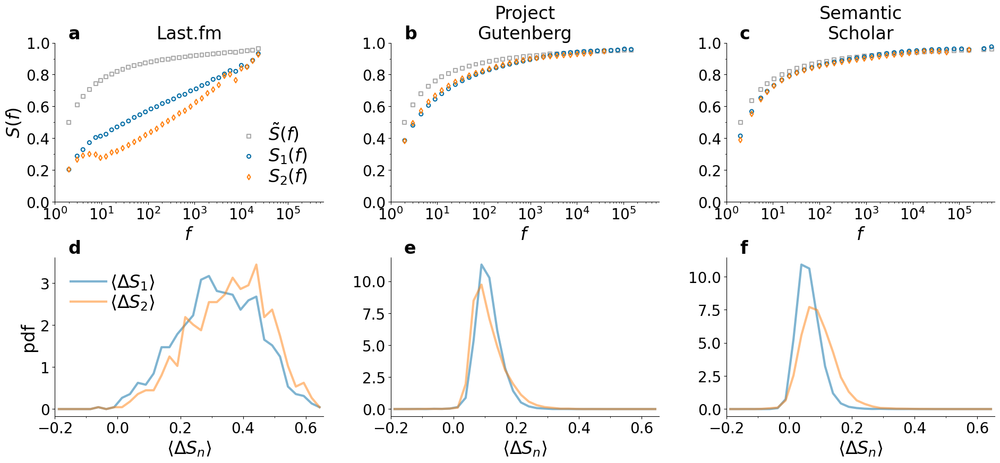

In [302]:
fig = fig_2(data_with_entropy, marker_size = 25, alpha_scatter = 1, 
          num_bins = 35,
          min_x_entropy_by_freq = 1,
          max_x_entropy_by_freq = None,
          min_x_entropy_diff_distr = -0.2,
          max_x_entropy_diff_distr = None,
          use_same_x_y_max_lim = True,
         )
fig.savefig(os.path.join(figures_folder, f"Fig2_entropy.png"))
fig.savefig(os.path.join(figures_folder, f"Fig2_entropy_low_res.pdf"),dpi=100)
fig.savefig(os.path.join(figures_folder, f"Fig2_entropy.pdf"))

### Fig 4

p-value pearson between None and $\langle\Delta S \rangle$ 2.4556612484583385e-06
p-value pearson between None and $\langle\Delta S_2 \rangle$ 4.596948264111428e-11
p-value pearson between None and $\langle\Delta S_2 \rangle$ 6.907131956589577e-158
p-value pearson between None and $\langle\Delta S \rangle$ 1.0797027291466465e-131
p-value pearson between None and $\langle\Delta S_2 \rangle$ 0.0
p-value pearson between None and $\langle\Delta S_2 \rangle$ 0.0
p-value pearson between None and $\langle\Delta S \rangle$ 8.185399436005836e-218
p-value pearson between None and $\langle\Delta S_2 \rangle$ 1.3305214081438763e-301
p-value pearson between None and $\langle\Delta S_2 \rangle$ 0.0
p-value pearson between $\beta_1$ and $\langle\Delta S \rangle$ 2.2839264783179714e-210
p-value pearson between $\beta_2$ and $\langle\Delta S_2 \rangle$ 0.0
p-value pearson between $\langle\Delta S \rangle$ and $\langle\Delta S_2 \rangle$ 1.6221697216721574e-23


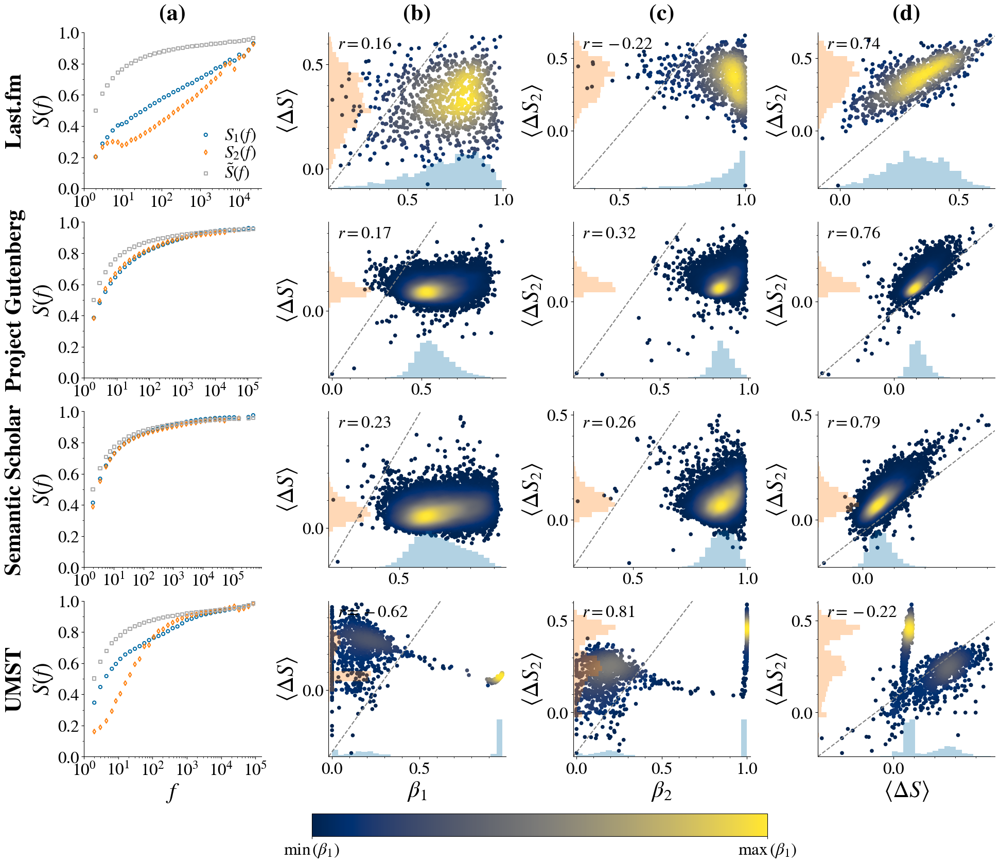

In [947]:
fig = fig_4(data_with_entropy, marker_size = 20, alpha_scatter = 1, 
          min_x = 0,
          max_x = 1,
          min_y = -0.1,
          max_y = 0.7,
          x_correlation_text = .05,
          y_correlation_text = .9,
          use_same_x_y_max_lim = False,
         )
fig.savefig(os.path.join(figures_folder, f"Fig4_entropy_beta_2.png"))
fig.savefig(os.path.join(figures_folder, f"Fig4_entropy_low_res_beta_2.pdf"),dpi=100)
fig.savefig(os.path.join(figures_folder, f"Fig4_entropy_beta_2.pdf"))

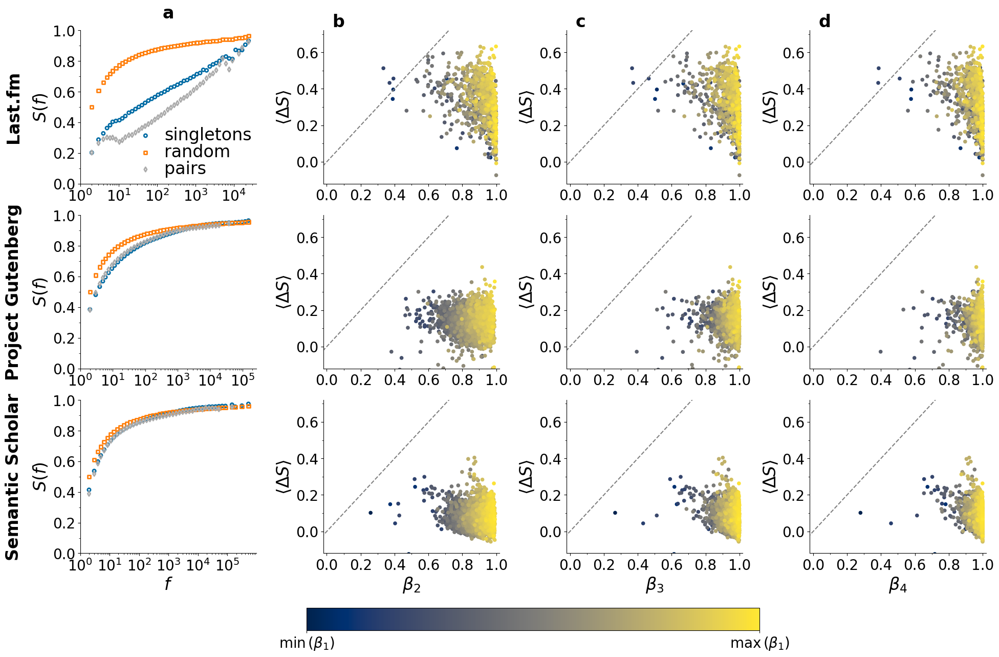

In [197]:
fig = fig_4(data_with_entropy, marker_size = 20, alpha_scatter = 1, 
          min_x = 0,
          max_x = 1,
          min_y = -0.1,
          max_y = 0.7,
          x_correlation_text = .05,
          y_correlation_text = .9,
          use_same_x_y_max_lim = False,
         )
fig.savefig(os.path.join(figures_folder, f"Fig4_entropy_beta_2.png"))
fig.savefig(os.path.join(figures_folder, f"Fig4_entropy_low_res_beta_2.pdf"),dpi=100)
fig.savefig(os.path.join(figures_folder, f"Fig4_entropy_beta_2.pdf"))

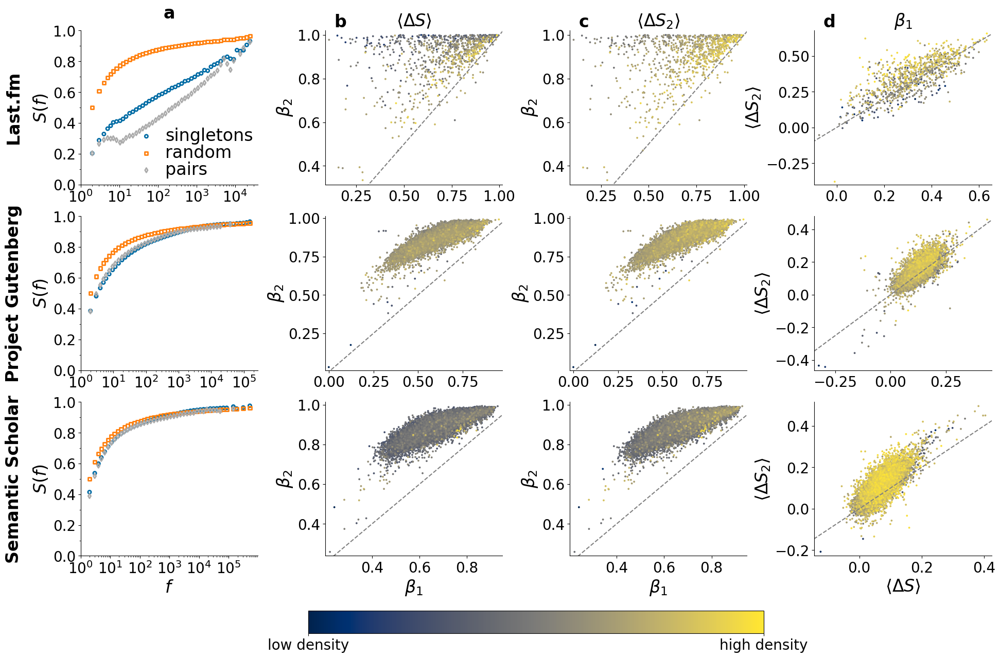

In [196]:
fig4_old = fig_4_old(data_with_entropy, marker_size = 20, alpha_scatter = 1, 
    #           min_x = 0,
    #           max_x = 1,
    #           min_y = None,
    #           max_y = None,
    marker_size_b_d = 3,
    min_x = -0.15,
    max_x = 1,
    min_y = -0.15,
    max_y = 1,
    x_correlation_text = .1, 
    y_correlation_text = .8,
    use_same_x_y_max_lim = True,
)

# Figure: Higher-order Heaps' exponents in model simulations

## Get data functions

In [38]:
def get_index_in_indices_geom_closest_t(
    t_to_use = 1e5,
    Tmax = int(1e5),
    num_to_save = 1000,
):
    if Tmax > num_to_save*2:
        indices = set(np.geomspace(1,Tmax,num_to_save,dtype=int)-1).union(set(np.linspace(1,Tmax,num_to_save,dtype=int)-1))
    else:
        indices = set(np.arange(Tmax))
    indices = list(indices)
    indices.sort()
    ts = np.array(indices)+1
    indices_geom = []
    set_geom = set(np.geomspace(1,indices[-1]+1,num_to_save,dtype=int)-1)
    ts_geom = list(np.array(list(set_geom))+1)
    ts_geom.sort()

    index_to_use = np.argmin(np.abs(np.array(ts_geom)-t_to_use))
    return index_to_use

### UMST

In [92]:
def get_data_UMST(
    eta, rho, starting_nu, ending_nu,do_fig = True,
    t_to_use = 1e5,
    Tmax = int(1e5),
    num_to_save = 1000,
):
    dataset = {}
    dataset['len'] = []
    dataset['mean_entropies'] = {}
    dataset['mean_entropies_glob'] = {}
    dataset['mean_entropies_pairs'] = {}
    dataset['mean_entropies_glob_pairs'] = {}
    dataset['weighted_diff_entropies'] = []
    dataset['weighted_diff_entropies_pairs'] = []
    for n_order, order in enumerate(['','2','3','4'], start=1):
        dataset[f'betas{order}'] = []
        dataset[f'intercepts{order}'] = []
    count = 0
    
    index_to_use = get_index_in_indices_geom_closest_t(
        t_to_use = t_to_use,
        Tmax = Tmax,
        num_to_save = num_to_save,
    )

    
    num_runs = 100
    for nu in tqdm(range(starting_nu, ending_nu+1)):
        data_folder = f"./data/UMST/simulations/analysis/rho_{rho:.5f}/nu_{nu}/Tmax_{Tmax}/eta_{eta:.5f}/"
        analysis_folder = data_folder
        for run in range(num_runs):
            path = os.path.join(analysis_folder,f'UMT_entropy_run_{run}.pkl')
            try:
                try:
                    with open(path, 'rb') as fp:
                        entropy_result = joblib.load(fp)
                except:
                    path = os.path.join(analysis_folder,f'UMT_entropies_run_{run}.pkl')
                    with open(path, 'rb') as fp:
                        entropy_result = joblib.load(fp)
                with open(os.path.join(analysis_folder,f'UMT_light_run_{run}.pkl'), 'rb') as fp:
                    result = joblib.load(fp)
                for i_order,order in enumerate(['', '_pairs']):
                    n_order = i_order + 1
                    for freq,value in entropy_result[f'mean_entropies{order}'].items():
                        try:
                            dataset[f'mean_entropies{order}'][freq].append(value)
                        except KeyError:
                            dataset[f'mean_entropies{order}'][freq] = [value]
                    for freq,value in entropy_result[f'mean_entropies_glob{order}'].items():
                        try:
                            dataset[f'mean_entropies_glob{order}'][freq].append(value)
                        except KeyError:
                            dataset[f'mean_entropies_glob{order}'][freq] = [value]
                dataset['weighted_diff_entropies'].append(entropy_result['weighted_diff_entropies'])
                dataset['weighted_diff_entropies_pairs'].append(entropy_result['weighted_diff_entropies_pairs'])
                dataset['len'].append(result["ts"][-1])
                # Add also information on beta
                for n_order, order in enumerate(['','2','3','4'], start=1):
                    dataset[f'betas{order}'].append(result[f'beta{order}_loglogregr_indices_geom'][index_to_use])
                    dataset[f'intercepts{order}'].append(result[f'intercept{order}_loglogregr_indices_geom'][index_to_use])
                # Add correct entropy difference to light result
    #             result['len'] = result["ts"][-1]
    #             result['weighted_diff_entropies'] = entropy_result['weighted_diff_entropies']
    #             result['weighted_diff_entropies_pairs'] = entropy_result['weighted_diff_entropies_pairs']
    #             with open(os.path.join(analysis_folder,f'UMT_light_run_{run}.pkl'), 'wb') as fp:
    #                 pickle.dump(result,fp)
                count += 1
            except:
                pass
    print('FOUND ',count, sep = "\t")
    if count > 0 and do_fig == True:
        fig,ax = plt.subplots(figsize=(6,4))
        num_bins = 20
        for order,key in enumerate(['betas', 'betas2']):#, 'weighted_diff_entropies', 'weighted_diff_entropies_pairs']):
            data_to_hist = dataset[key]
            hist,bin_edges = np.histogram(data_to_hist, 
                    np.linspace(np.min(data_to_hist), np.max(data_to_hist), num_bins), 
                    density=True)
            bin_centers = (bin_edges[1:]+bin_edges[:-1])/2
            p = ax.plot(bin_centers, hist, alpha=0.5,lw=3, label = r"$\beta_%d$"%(order+1) if order<2 else r"$\langle( S_%d \rangle)$"%(order+1))
        ax.axhline(0, ls='--', color='gray')
        ax.legend(loc='best')
        ax.set_ylabel('pdf')
        ax.set_title(r'$\eta = %s$, $\rho = %s$'%(str(eta), str(rho)))
        fig.add_subplot(ax)
    
    return dataset

In [100]:
def get_data_UMST_by_parameter(
    eta, rho, starting_nu, ending_nu,
    t_to_use = 1e5,
    Tmax = int(1e5),
    num_to_save = 1000,
):
    data_by_parameter = {}
    count = 0
    
    index_to_use = get_index_in_indices_geom_closest_t(
        t_to_use = t_to_use,
        Tmax = Tmax,
        num_to_save = num_to_save,
    )

    num_runs = 100
    for nu in tqdm(range(starting_nu, ending_nu+1)):
        data_folder = f"./data/UMST/simulations/analysis/rho_{rho:.5f}/nu_{nu}/Tmax_{Tmax}/eta_{eta:.5f}/"
        analysis_folder = data_folder
        for run in range(num_runs):
            path = os.path.join(analysis_folder,f'UMT_entropy_run_{run}.pkl')
            try:
                try:
                    with open(path, 'rb') as fp:
                        entropy_result = joblib.load(fp)
                except:
                    path = os.path.join(analysis_folder,f'UMT_entropies_run_{run}.pkl')
                    with open(path, 'rb') as fp:
                        entropy_result = joblib.load(fp)
                with open(os.path.join(analysis_folder,f'UMT_light_run_{run}.pkl'), 'rb') as fp:
                    result = joblib.load(fp)
                if nu not in data_by_parameter:
                    data_by_parameter[nu] = {}
                    data_by_parameter[nu]['len'] = []
                    data_by_parameter[nu]['mean_entropies'] = {}
                    data_by_parameter[nu]['mean_entropies_glob'] = {}
                    data_by_parameter[nu]['mean_entropies_pairs'] = {}
                    data_by_parameter[nu]['mean_entropies_glob_pairs'] = {}
                    data_by_parameter[nu]['weighted_diff_entropies'] = []
                    data_by_parameter[nu]['weighted_diff_entropies_pairs'] = []
                    for n_order, order in enumerate(['','2','3','4'], start=1):
                        data_by_parameter[nu][f'betas{order}'] = []
                        data_by_parameter[nu][f'intercepts{order}'] = []
                dataset = data_by_parameter[nu]
                for i_order,order in enumerate(['', '_pairs']):
                    n_order = i_order + 1
                    for freq,value in entropy_result[f'mean_entropies{order}'].items():
                        try:
                            dataset[f'mean_entropies{order}'][freq].append(value)
                        except KeyError:
                            dataset[f'mean_entropies{order}'][freq] = [value]
                    for freq,value in entropy_result[f'mean_entropies_glob{order}'].items():
                        try:
                            dataset[f'mean_entropies_glob{order}'][freq].append(value)
                        except KeyError:
                            dataset[f'mean_entropies_glob{order}'][freq] = [value]
                dataset['weighted_diff_entropies'].append(entropy_result['weighted_diff_entropies'])
                dataset['weighted_diff_entropies_pairs'].append(entropy_result['weighted_diff_entropies_pairs'])
                dataset['len'].append(result["ts"][-1])
                # Add also information on beta
                for n_order, order in enumerate(['','2','3','4'], start=1):
                    dataset[f'betas{order}'].append(result[f'beta{order}_loglogregr_indices_geom'][index_to_use])
                    dataset[f'intercepts{order}'].append(result[f'intercept{order}_loglogregr_indices_geom'][index_to_use])
                count += 1
            except:
                pass
    print('FOUND ',count, sep = "\t")
    return data_by_parameter

### ERRW

In [94]:
def get_data_ERRW(
    p=None,dw=None,min_dw = None, max_dw = None, do_fig = True, 
    use_mean_indices = False,
    consider_temporal_order_in_tuples = True,
    label_title_fig = None,
    folder = 'SW',
    t_to_use = 1e5,
    Tmax = int(1e5),
    num_to_save = 1000,
    dir_ERRW = False,
):
    dataset = {}
    dataset['len'] = []
    dataset['mean_entropies'] = {}
    dataset['mean_entropies_glob'] = {}
    dataset['mean_entropies_pairs'] = {}
    dataset['mean_entropies_glob_pairs'] = {}
    dataset['weighted_diff_entropies'] = []
    dataset['weighted_diff_entropies_pairs'] = []
    for n_order, order in enumerate(['','2','3','4'], start=1):
        dataset[f'betas{order}'] = []
        dataset[f'intercepts{order}'] = []
    count = 0
    
    index_to_use = get_index_in_indices_geom_closest_t(
        t_to_use = t_to_use,
        Tmax = Tmax,
        num_to_save = num_to_save,
    )
    
    if dir_ERRW == True:
        main_folder_name = 'dir_ERRW'
    else:
        main_folder_name = 'ERRW'
    if consider_temporal_order_in_tuples:
        light_folder = f"./data/{main_folder_name}/{folder}/analysis/light_results/"
        entropies_folder = f"./data/{main_folder_name}/{folder}/analysis/entropies_results/"
    else:
        light_folder = f"./data/{main_folder_name}/{folder}/analysis_tuples_without_order/light_results/"
        entropies_folder = f"./data/{main_folder_name}/{folder}/analysis_tuples_without_order/entropies_results/"
    pattern = '*'
    if p is not None:
        pattern += f'p{p:.3f}*'
    if dw is not None:
        pattern += f'dw{dw:.5f}*' # f'dw{dw:.2f}*'
    filepaths = sorted(find_pattern(pattern+'.pkl', light_folder))
    for path in tqdm(filepaths):
        file_name = path[-path[::-1].index('/'):path.index('.pkl')]
        dw = float(file_name[-file_name[::-1].index('wd_'):file_name.index('_sim')])
        if (min_dw is None or min_dw is not None and dw >= min_dw) and (max_dw is None or max_dw is not None and dw <= max_dw):
            try:
                with open(os.path.join(entropies_folder, f'{file_name}.pkl'), 'rb') as fp:
                    entropy_result = joblib.load(fp)
                with open(os.path.join(light_folder, f'{file_name}.pkl'), 'rb') as fp:
                    result = joblib.load(fp)
                for i_order,order in enumerate(['', '_pairs']):
                    n_order = i_order + 1
                    for freq,value in entropy_result[f'mean_entropies{order}'].items():
                        try:
                            dataset[f'mean_entropies{order}'][freq].append(value)
                        except KeyError:
                            dataset[f'mean_entropies{order}'][freq] = [value]
                    for freq,value in entropy_result[f'mean_entropies_glob{order}'].items():
                        try:
                            dataset[f'mean_entropies_glob{order}'][freq].append(value)
                        except KeyError:
                            dataset[f'mean_entropies_glob{order}'][freq] = [value]
                dataset['weighted_diff_entropies'].append(entropy_result['weighted_diff_entropies'])
                dataset['weighted_diff_entropies_pairs'].append(entropy_result['weighted_diff_entropies_pairs'])
                dataset['len'].append(result["ts"][-1])
                # Add also information on beta
                for n_order, order in enumerate(['','2','3','4'], start=1):
    #                 dataset[f'betas{order}'].append(result[f'beta{order}_loglogregr_indices_geom'][index_to_use)
                    if use_mean_indices:
                        dataset[f'betas{order}'].append(result[f'beta{order}_mean_indices'][index_to_use]) # _mean_indices # _loglogregr_indices_geom
                    else:
                        dataset[f'betas{order}'].append(result[f'beta{order}_loglogregr_indices_geom'][index_to_use]) # _mean_indices # _loglogregr_indices_geom
                        dataset[f'intercepts{order}'].append(result[f'intercept{order}_loglogregr_indices_geom'][index_to_use])
                count += 1
            except:
                pass
    print('FOUND ',count, len(dataset[f'betas']),sep = "\t")
    if count > 0 and do_fig == True:
        fig,ax = plt.subplots(figsize=(6,4))
        num_bins = 20
        for order,key in enumerate(['betas', 'betas2']):#, 'weighted_diff_entropies', 'weighted_diff_entropies_pairs']):
            data_to_hist = dataset[key]
            hist,bin_edges = np.histogram(data_to_hist, 
                    np.linspace(np.min(data_to_hist), np.max(data_to_hist), num_bins), 
                    density=True)
            bin_centers = (bin_edges[1:]+bin_edges[:-1])/2
            ax.plot(bin_centers, hist, alpha=0.5,lw=3, label = r"$\beta_%d$"%(order+1) if order<2 else r"$\langle( S_%d \rangle)$"%(order+1))
        ax.axhline(0, ls='--', color='gray')
        ax.legend(loc='best')
        ax.set_ylabel('pdf')
        ax.set_title(label_title_fig)#(fr'ERRW SW ($p={str(p)},dw={str(dw)}$)')
        fig.add_subplot(ax)
    
    return dataset

In [101]:
def get_data_ERRW_by_parameter(
    p=None,dw=None,min_dw = None, max_dw = None,
    use_mean_indices = False,
    consider_temporal_order_in_tuples = True,
    label_title_fig = None,
    folder = 'SW',
    t_to_use = 1e5,
    Tmax = int(1e5),
    num_to_save = 1000,
    dir_ERRW = False,
):
    data_by_parameter = {}
    count = 0
    
    index_to_use = get_index_in_indices_geom_closest_t(
        t_to_use = t_to_use,
        Tmax = Tmax,
        num_to_save = num_to_save,
    )
    
    if dir_ERRW == True:
        main_folder_name = 'dir_ERRW'
    else:
        main_folder_name = 'ERRW'
    if consider_temporal_order_in_tuples:
        light_folder = f"./data/{main_folder_name}/{folder}/analysis/light_results/"
        entropies_folder = f"./data/{main_folder_name}/{folder}/analysis/entropies_results/"
    else:
        light_folder = f"./data/{main_folder_name}/{folder}/analysis_tuples_without_order/light_results/"
        entropies_folder = f"./data/{main_folder_name}/{folder}/analysis_tuples_without_order/entropies_results/"
    pattern = '*'
    if p is not None:
        pattern += f'p{p:.3f}*'
    if dw is not None:
        pattern += f'dw{dw:.5f}*' # f'dw{dw:.2f}*'
    filepaths = sorted(find_pattern(pattern+'.pkl', light_folder))
    for path in tqdm(filepaths):
        file_name = path[-path[::-1].index('/'):path.index('.pkl')]
        dw = float(file_name[-file_name[::-1].index('wd_'):file_name.index('_sim')])
        if (min_dw is None or min_dw is not None and dw >= min_dw) and (max_dw is None or max_dw is not None and dw <= max_dw):
            try:
                with open(os.path.join(entropies_folder, f'{file_name}.pkl'), 'rb') as fp:
                    entropy_result = joblib.load(fp)
                with open(os.path.join(light_folder, f'{file_name}.pkl'), 'rb') as fp:
                    result = joblib.load(fp)
                if dw not in data_by_parameter:
                    data_by_parameter[dw] = {}
                    data_by_parameter[dw]['len'] = []
                    data_by_parameter[dw]['mean_entropies'] = {}
                    data_by_parameter[dw]['mean_entropies_glob'] = {}
                    data_by_parameter[dw]['mean_entropies_pairs'] = {}
                    data_by_parameter[dw]['mean_entropies_glob_pairs'] = {}
                    data_by_parameter[dw]['weighted_diff_entropies'] = []
                    data_by_parameter[dw]['weighted_diff_entropies_pairs'] = []
                    for n_order, order in enumerate(['','2','3','4'], start=1):
                        data_by_parameter[dw][f'betas{order}'] = []
                        data_by_parameter[dw][f'intercepts{order}'] = []
                dataset = data_by_parameter[dw]
                for i_order,order in enumerate(['', '_pairs']):
                    n_order = i_order + 1
                    for freq,value in entropy_result[f'mean_entropies{order}'].items():
                        try:
                            dataset[f'mean_entropies{order}'][freq].append(value)
                        except KeyError:
                            dataset[f'mean_entropies{order}'][freq] = [value]
                    for freq,value in entropy_result[f'mean_entropies_glob{order}'].items():
                        try:
                            dataset[f'mean_entropies_glob{order}'][freq].append(value)
                        except KeyError:
                            dataset[f'mean_entropies_glob{order}'][freq] = [value]
                dataset['weighted_diff_entropies'].append(entropy_result['weighted_diff_entropies'])
                dataset['weighted_diff_entropies_pairs'].append(entropy_result['weighted_diff_entropies_pairs'])
                dataset['len'].append(result["ts"][-1])
                # Add also information on beta
                for n_order, order in enumerate(['','2','3','4'], start=1):
    #                 dataset[f'betas{order}'].append(result[f'beta{order}_loglogregr_indices_geom'][index_to_use)
                    if use_mean_indices:
                        dataset[f'betas{order}'].append(result[f'beta{order}_mean_indices'][index_to_use]) # _mean_indices # _loglogregr_indices_geom
                    else:
                        dataset[f'betas{order}'].append(result[f'beta{order}_loglogregr_indices_geom'][index_to_use]) # _mean_indices # _loglogregr_indices_geom
                        dataset[f'intercepts{order}'].append(result[f'intercept{order}_loglogregr_indices_geom'][index_to_use])
                count += 1
            except:
                pass
    print('FOUND ',count, len(dataset[f'betas']),sep = "\t")
    return data_by_parameter

### New model

In [48]:
def get_data_new_pairs_UMT(
    rho, 
    starting_nu_1, ending_nu_1,
    starting_nu_2, ending_nu_2,
    fraction_nu_2_cut = 2,
    N_0 = 2, 
    M_0 = 2, 
    Tmax = int(1e4),
    do_fig = True,
    t_to_use = 1e5,
    num_to_save = 1000,
    do_non_overlapping_simulation = False,
    trigger_pairs_with_reinforcement = False,
    triggering_pairs_among_all_non_explored_pairs = False,
    look_among_all_non_explored_pairs_if_not_enough = False,
    trigger_links_with_new_colors_if_not_enough = False,
    trigger_links_between_new_colors_if_not_enough = False,
    color_by_key = None,
    directed = True,
):
    nu1_eq_nu2_beta_1 = []
    nu1_eq_nu2_beta_2 = []
    individual_data = {}
    all_exponents = {}
    all_exponents['nu_1'] = []
    all_exponents['nu_2'] = []
    all_exponents['nu_1+nu_2'] = []
    all_exponents['nu_1/(nu_2+rho)'] = []
    all_exponents['nu_2/(nu_1+rho)'] = []
    all_exponents['nu_1/(nu_1+nu_2+rho)'] = []
    all_exponents['nu_2/(nu_1+nu_2+rho)'] = []
    all_exponents['nu_1/(nu_1+nu_2)'] = []
    all_exponents['nu_2/(nu_1+nu_2)'] = []
    all_exponents['nu_1/(nu_1+rho)'] = []
    all_exponents['nu_2/(nu_2+rho)'] = []
    all_exponents['nu_2_not_1'] = []
    all_exponents['expected_betas'] = []
    all_exponents['expected_betas2'] = []
    all_exponents['len'] = []
    all_exponents['mean_entropies'] = {}
    all_exponents['mean_entropies_glob'] = {}
    all_exponents['mean_entropies_pairs'] = {}
    all_exponents['mean_entropies_glob_pairs'] = {}
    all_exponents['weighted_diff_entropies'] = []
    all_exponents['weighted_diff_entropies_pairs'] = []
    for n_order, order in enumerate(['','2','3','4'], start=1):
        all_exponents[f'betas{order}'] = []
        all_exponents[f'intercepts{order}'] = []
    count = 0
    
    index_to_use = get_index_in_indices_geom_closest_t(
        t_to_use = t_to_use,
        Tmax = Tmax,
        num_to_save = num_to_save,
    )
    
    average_beta = {}
    average_beta2 = {}
    average_beta_inverse = {}
    average_beta2_inverse = {}
    average_beta_dict = {}
    average_beta2_dict = {}
    
    main_dir = f"./data/"
    main_dir += 'new_model/'
    
    if directed:
        main_dir += 'directed/'
    
    if do_non_overlapping_simulation:
        main_dir += 'do_non_overlapping_simulation/'

    
    if trigger_pairs_with_reinforcement:
        main_dir += 'trigger_links_with_reinforcement/'

    if triggering_pairs_among_all_non_explored_pairs:
        main_dir += 'triggering_links_among_all_non_explored_links/'
    elif look_among_all_non_explored_pairs_if_not_enough:
        main_dir += 'look_among_all_non_explored_links_if_not_enough/'
    if trigger_links_with_new_colors_if_not_enough:
        main_dir += 'trigger_links_with_new_nodes_if_not_enough/'
    if trigger_links_between_new_colors_if_not_enough:
        main_dir += 'trigger_links_between_new_nodes_if_not_enough/'
        


    num_runs = 100
    for nu_1 in tqdm(range(starting_nu_1, ending_nu_1 + 1)):
        if starting_nu_2 is None:
            starting_nu_2_tmp = 0 # nu_1
        else:
            starting_nu_2_tmp = starting_nu_2
        if ending_nu_2 is None:
            ending_nu_2_tmp = fraction_nu_2_cut*nu_1
        else:
            ending_nu_2_tmp = ending_nu_2
        
        average_beta[nu_1] = []
        average_beta2[nu_1] = []
        individual_data[nu_1] = {}
        average_beta_dict[nu_1] = {}
        average_beta2_dict[nu_1] = {}
        
        for nu_2 in tqdm(range(starting_nu_2_tmp, ending_nu_2_tmp + 1)):
            analysis_folder = data_folder = work_dir = os.path.join(main_dir, f"simulations/analysis/rho_{rho:.5f}/nu_1{nu_1}/nu_2{nu_2}/Tmax_{Tmax}/N_0_{N_0}/M_0_{M_0}/")
            try:
#             if True:
                path = os.path.join(analysis_folder,f'average_light_results.pkl')
                with open(path, 'rb') as fp:
                    average_result = joblib.load(fp)
                individual_data[nu_1][nu_2] = average_result
                count += len(average_result[f'beta_loglogregr_indices_geom_list_finals'])
                # get info on beta
                for n_order, order in enumerate(['','2','3','4'], start=1):
                    all_exponents[f'betas{order}'] += average_result[f'beta{order}_loglogregr_indices_geom_list_finals']
                    all_exponents[f'intercepts{order}'] += average_result[f'intercept{order}_loglogregr_indices_geom_list_finals']
                    individual_data[nu_1][nu_2][f'betas{order}'] = average_result[f'beta{order}_loglogregr_indices_geom_list_finals']
                    individual_data[nu_1][nu_2][f'intercepts{order}'] = average_result[f'beta{order}_loglogregr_indices_geom_list_finals']
                average_beta[nu_1].append(np.mean(average_result[f'beta_loglogregr_indices_geom_list_finals']))
                average_beta2[nu_1].append(np.mean(average_result[f'beta2_loglogregr_indices_geom_list_finals']))
                try:
                    average_beta_inverse[nu_2].append(np.mean(average_result[f'beta_loglogregr_indices_geom_list_finals']))
                    average_beta2_inverse[nu_2].append(np.mean(average_result[f'beta2_loglogregr_indices_geom_list_finals']))
                except:
                    average_beta_inverse[nu_2] = [np.mean(average_result[f'beta_loglogregr_indices_geom_list_finals'])]
                    average_beta2_inverse[nu_2] = [np.mean(average_result[f'beta2_loglogregr_indices_geom_list_finals'])]
                average_beta_dict[nu_1][nu_2] = np.mean(average_result[f'beta_loglogregr_indices_geom_list_finals'])
                average_beta2_dict[nu_1][nu_2] = np.mean(average_result[f'beta2_loglogregr_indices_geom_list_finals'])
                # get entropies
                all_exponents['weighted_diff_entropies'] += average_result[f'weighted_diff_entropies_list']
                all_exponents['weighted_diff_entropies_pairs'] += average_result[f'weighted_diff_entropies_pairs_list']
                
                individual_data[nu_1][nu_2][f'weighted_diff_entropies'] = average_result[f'weighted_diff_entropies_list']
                individual_data[nu_1][nu_2][f'weighted_diff_entropies_pairs'] = average_result[f'weighted_diff_entropies_pairs_list']
                if nu_2 == nu_1:
                    nu1_eq_nu2_beta_1.append(np.mean(average_result[f'beta_loglogregr_indices_geom_list_finals']))
                    nu1_eq_nu2_beta_2.append(np.mean(average_result[f'beta2_loglogregr_indices_geom_list_finals']))
                # get other info
                if len(average_result[f'beta_loglogregr_indices_geom_list_finals']) != 100:
                    print(len(average_result[f'beta_loglogregr_indices_geom_list_finals']), nu_1, nu_2)
                all_exponents['len'] += [average_result["ts"][-1]] * len(average_result[f'beta_loglogregr_indices_geom_list_finals'])
                all_exponents['nu_1'] += [nu_1] * len(average_result[f'beta_loglogregr_indices_geom_list_finals'])
                all_exponents['nu_2'] += [nu_2] * len(average_result[f'beta_loglogregr_indices_geom_list_finals'])
                all_exponents['nu_1+nu_2'] += [nu_1+nu_2] * len(average_result[f'beta_loglogregr_indices_geom_list_finals'])
                all_exponents['nu_1/(nu_1+rho)'] += [nu_1/(nu_1+rho)] * len(average_result[f'beta_loglogregr_indices_geom_list_finals'])
#                 all_exponents['nu_1/(2*rho)'] += [nu_1/(2*rho)] * len(average_result[f'beta_loglogregr_indices_geom_list_finals'])
                all_exponents['nu_1/(nu_2+rho)'] += [nu_1/(nu_2+rho)] * len(average_result[f'beta_loglogregr_indices_geom_list_finals'])
                all_exponents['nu_2/(nu_1+rho)'] += [nu_2/(nu_1+rho)] * len(average_result[f'beta_loglogregr_indices_geom_list_finals'])
                all_exponents['nu_2/(nu_2+rho)'] += [nu_2/(nu_2+rho)] * len(average_result[f'beta_loglogregr_indices_geom_list_finals'])
                all_exponents['nu_1/(nu_1+nu_2+rho)'] += [nu_1/(nu_1+nu_2+rho)] * len(average_result[f'beta_loglogregr_indices_geom_list_finals'])
                all_exponents['nu_2/(nu_1+nu_2+rho)'] += [nu_2/(nu_1+nu_2+rho)] * len(average_result[f'beta_loglogregr_indices_geom_list_finals'])
                if nu_1 + nu_2 == 0:
                    all_exponents['nu_1/(nu_1+nu_2)'] += [0] * len(average_result[f'beta_loglogregr_indices_geom_list_finals'])
                    all_exponents['nu_2/(nu_1+nu_2)'] += [0] * len(average_result[f'beta_loglogregr_indices_geom_list_finals'])
                else:
                    all_exponents['nu_1/(nu_1+nu_2)'] += [nu_1/(nu_1+nu_2)] * len(average_result[f'beta_loglogregr_indices_geom_list_finals'])
                    all_exponents['nu_2/(nu_1+nu_2)'] += [nu_2/(nu_1+nu_2)] * len(average_result[f'beta_loglogregr_indices_geom_list_finals'])
#                 all_exponents['nu_2_not_1'] += [nu_2_not_1] * len(average_result[f'beta_loglogregr_indices_geom_list_finals'])
                all_exponents['expected_betas'] += [nu_1/rho] * len(average_result[f'beta_loglogregr_indices_geom_list_finals'])
                all_exponents['expected_betas2'] += [min(1,(nu_2)/rho)] * len(average_result[f'beta_loglogregr_indices_geom_list_finals'])
                
                path = os.path.join(analysis_folder,f'average_entropy.pkl')
                with open(path, 'rb') as fp:
                    entropy_result = joblib.load(fp)
                for i_order,order in enumerate(['', '_pairs']):
                    n_order = i_order + 1
                    individual_data[nu_1][nu_2][f'mean_entropies{order}'] = {}
                    individual_data[nu_1][nu_2][f'mean_entropies_glob{order}'] = {}
                    for freq,value in entropy_result[f'mean_entropies{order}'].items():
                        try:
                            individual_data[nu_1][nu_2][f'mean_entropies{order}'][freq] += value
                        except KeyError:
                            individual_data[nu_1][nu_2][f'mean_entropies{order}'][freq] = value
                        try:
                            all_exponents[f'mean_entropies{order}'][freq] += value
                        except KeyError:
                            all_exponents[f'mean_entropies{order}'][freq] = value
                    for freq,value in entropy_result[f'mean_entropies_glob{order}'].items():
                        try:
                            individual_data[nu_1][nu_2][f'mean_entropies_glob{order}'][freq] += value
                        except KeyError:
                            individual_data[nu_1][nu_2][f'mean_entropies_glob{order}'][freq] = value
                        try:
                            all_exponents[f'mean_entropies_glob{order}'][freq] += value
                        except KeyError:
                            all_exponents[f'mean_entropies_glob{order}'][freq] = value
#                     for freq,value in entropy_result[f'mean_entropies{order}'].items():
#                         individual_data[nu_1][nu_2][f'mean_entropies{order}'][freq] = np.mean(value)
#                     for freq,value in entropy_result[f'mean_entropies_glob{order}'].items():
#                         individual_data[nu_1][nu_2][f'mean_entropies_glob{order}'][freq] = np.mean(value)
            except:
                pass
    print('FOUND ',count, sep = "\t")
    if count > 0 and do_fig == True:
        fig,ax = plt.subplots(figsize=(6,4))
        num_bins = 20
        for order,key in enumerate(['betas', 'betas2']):#, 'weighted_diff_entropies', 'weighted_diff_entropies_pairs']):
            data_to_hist = all_exponents[key]
            hist,bin_edges = np.histogram(data_to_hist, 
                    np.linspace(np.min(data_to_hist), np.max(data_to_hist), num_bins), 
                    density=True)
            bin_centers = (bin_edges[1:]+bin_edges[:-1])/2
            p = ax.plot(bin_centers, hist, alpha=0.5,lw=3, label = r"$\beta_%d$"%(order+1) if order<2 else r"$\langle( S_%d \rangle)$"%(order+1))
        ax.axhline(0, ls='--', color='gray')
        ax.legend(loc='best')
        ax.set_ylabel('pdf')
        ax.set_title(fr'$\rho = {rho}$, Tmax = {Tmax}, look_among_all_non_explored_pairs_if_not_enough = {look_among_all_non_explored_pairs_if_not_enough}')
        fig.add_subplot(ax)
    
        fig,ax = plt.subplots(figsize=(6,4))
        x = np.array(all_exponents['betas'])
        y = np.array(all_exponents['betas2'])
#         if add_nu_2_not_1:
#             z = x / (x+y)
#         else:
#             z = x / y
        if color_by_key is not None:
            z = np.array(all_exponents[color_by_key])
        else:
            z = None
        subplot_scatter_beta(
            x = x, 
            y = y, 
#             z = None,
            z = z,
            ax = ax, 
            min_x = 0,
            max_x = 1,
            min_y = 0,
            max_y = 1,
            marker_size = 20, 
            xlabel = r"$\beta_1$", 
            ylabel = fr"$\beta_2$", 
        )
        ax.plot([0, 0.5], [0,1])
        fig.add_subplot(ax)
        
        
        fig,ax = plt.subplots(figsize=(8,8))
        plot_average_beta_1_beta2_by_two_parameters(
            average_beta,
            average_beta2,
            ax = ax,
            fig = fig,
        )
        ax.plot([0, 1], [0,1])
        ax.plot([0, 0.5], [0,1])
        ax.plot(nu1_eq_nu2_beta_1, nu1_eq_nu2_beta_2, '--b')
        ax.set_title('each line is a nu_1')
        fig.add_subplot(ax)
        
        
        fig,ax = plt.subplots(figsize=(8,8))
        plot_average_beta_1_beta2_by_two_parameters(
            average_beta_inverse,
            average_beta2_inverse,
            ax = ax,
            fig = fig,
        )
        ax.plot([0, 1], [0,1])
        ax.plot([0, 0.5], [0,1])
        ax.set_title('each line is a nu_2')
        fig.add_subplot(ax)
        
    return individual_data, all_exponents, average_beta, average_beta2, average_beta_inverse, average_beta2_inverse, average_beta_dict, average_beta2_dict

## Plotting functions

In [158]:
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.collections as mcoll
import matplotlib.path as mpath

def colorline(
    x, y, z=None, cmap=plt.get_cmap(cmap_label), norm=plt.Normalize(0.0, 1.0),
        linewidth=3, alpha=1.0, ax = None):
    """
    http://nbviewer.ipython.org/github/dpsanders/matplotlib-examples/blob/master/colorline.ipynb
    http://matplotlib.org/examples/pylab_examples/multicolored_line.html
    Plot a colored line with coordinates x and y
    Optionally specify colors in the array z
    Optionally specify a colormap, a norm function and a line width
    """

    # Default colors equally spaced on [0,1]:
    if z is None:
        z = np.linspace(0.0, 1.0, len(x))

    # Special case if a single number:
    if not hasattr(z, "__iter__"):  # to check for numerical input -- this is a hack
        z = np.array([z])

    z = np.asarray(z)

    segments = make_segments(x, y)
    lc = mcoll.LineCollection(segments, array=z, cmap=cmap, norm=norm,
                              linewidth=linewidth, alpha=alpha)

#     ax = plt.gca()
    ax.add_collection(lc)

    return lc


def make_segments(x, y):
    """
    Create list of line segments from x and y coordinates, in the correct format
    for LineCollection: an array of the form numlines x (points per line) x 2 (x
    and y) array
    """

    points = np.array([x, y]).T.reshape(-1, 1, 2)
    segments = np.concatenate([points[:-1], points[1:]], axis=1)
    return segments

def plot_average_beta_1_beta2_by_two_parameters(
    average_beta,
    average_beta2,
    ax = None,
    fig = None,
):
    if ax == None:
        fig,ax = plt.subplots(figsize=(8,8))
    
    for nu_1 in average_beta.keys():
        x = np.array(average_beta[nu_1])
        y = np.array(average_beta2[nu_1])
        if len(x) > 1:
            path = mpath.Path(np.column_stack([x, y]))
            verts = path.interpolated(steps=3).vertices
            x, y = verts[:, 0], verts[:, 1]
            z = np.linspace(0, 1, len(x))

            colorline(x, y, z, cmap=plt.get_cmap(cmap_label), linewidth=2, ax = ax)


In [159]:
def fig_3(data, marker_size = 20, alpha_scatter = 1, alpha_histogram = 0.3, color_x = CB_color_cycle[0], color_y = CB_color_cycle[1], max_hist = 0.25, 
          min_x_a = None,
          max_x_a = None,
          min_y_a = None,
          max_y_a = None,
          use_same_x_y_max_lim = True,
          do_dashed_line = True,
        x_correlation_text = 0.63, 
        y_correlation_text = .32,
          num_bins = 35,
          min_x_b = None,
          max_x_b = None,
          min_x_c = None,
          max_x_c = None,
         ):
    nrows = num_datasets = len(data)
    fig = plt.figure(figsize=(width_fig,width_fig*2/3*num_datasets/3))
#     outer = gridspec.GridSpec(nrows=num_datasets+1, ncols=1,height_ratios = [10]*num_datasets+[3],hspace=0.35) # 0.25
    outer = gridspec.GridSpec(nrows=1, ncols=2, width_ratios = [1]+[10], wspace=0.1) # 0.25
    wspace = 0.38
    hspace = 0.38
    ncols = 3
    
    # get highest f to unify first row
    if use_same_x_y_max_lim == True:
        min_x_a = 100000
        max_x_a = -100000
        min_y_a = 100000
        max_y_a = -100000
        max_x_b = 1
        min_x_c = 100000
        max_x_c = -100000
        for dataset_label, dataset_dict in data.items():
            x = dataset_dict[f"betas"]
            min_x_a = min(min_x_a, min(x))
            max_x_a = max(max_x_a, max(x))
            y = dataset_dict[f"betas2"]
            min_y_a = min(min_y_a, min(y))
            max_y_a = max(max_y_a, max(y))
            x = [freq for i_order,order in enumerate(['', '_pairs']) for freq,values in dataset_dict[f"mean_entropies"].items() for value in values]
            max_x_b = max(max_x_b, max(x))
            x = dataset_dict[f"weighted_diff_entropies"]
            min_x_c = min(min_x_c, min(x))
            max_x_c = max(max_x_c, max(x))
            x = dataset_dict[f"weighted_diff_entropies_pairs"]
            min_x_c = min(min_x_c, min(x))
            max_x_c = max(max_x_c, max(x))
    
    
    inner = gridspec.GridSpecFromSubplotSpec(nrows, ncols,
                        subplot_spec=outer[-1],wspace=wspace,hspace=hspace)
                
    for i, (dataset_label, dataset_dict) in enumerate(data.items()):
        row = i
        print(dataset_label)
        ax = plt.Subplot(fig, inner[i*ncols])
        i_order = 1
        n_order = 2
        order = str(n_order)
        
        subplot_scatter_beta(np.array(dataset_dict['betas']), np.array(dataset_dict[f'betas{order}']), 
                          ax = ax, 
                          marker_size = 20, alpha_scatter = alpha_scatter,
                          alpha_histogram = alpha_histogram, 
                          color_x = color_x, color_y = color_y, 
                          max_hist = max_hist, 
                          number_to_write = i*ncols, 
                          write_number = True, #i==0, 
                          do_dashed_line = do_dashed_line,
                          ylabel = fr"$\beta_{order}$", xlabel = r"$\beta_1$" if i == num_datasets - 1 else None, 
                          min_x=min_x_a, max_x=max_x_a, min_y=min_y_a, max_y=max_y_a,
                          x_correlation_text = x_correlation_text, 
                          y_correlation_text = y_correlation_text,
                         )
        fig.add_subplot(ax)
    
        # ENTROPY
    
        column = 1
        ax = plt.Subplot(fig, inner[row*ncols+column])
        subplot_entropy_by_freq(dataset_dict, 
                        ax = ax, dataset_label = '\n'.join(dataset_label.split(' ')),
                        marker_size = marker_size, alpha = alpha_scatter, 
                        number_to_write = row*ncols+column, 
                        num_bins = num_bins,
                        xlim_left = min_x_b, xlim_right = max_x_b, 
                        ylim_bottom = 0, ylim_top = 1, 
                        do_legend = row == 0,
                        xlabel = r"$f$" if row == nrows-1 else None, write_number = True,
                        ylabel = r"S(f)", 
                       )
        fig.add_subplot(ax)

        column = 2
        ax = plt.Subplot(fig, inner[row*ncols+column])
        subplot_entropy_diff_distr(dataset_dict,
                          ax = ax, 
                          num_bins = num_bins,
                          number_to_write = row*ncols+column, 
                          write_number = True, 
                          do_legend = row == 0,
                          xlabel = r"$\langle \Delta S_n \rangle$" if row == nrows-1 else None, 
                          ylabel = r"pdf", 
                          xlim_left=min_x_c, xlim_right=max_x_c, 
                         )
        fig.add_subplot(ax)
        
        
    ####################### COLORBAR #######################
    
#     inner = gridspec.GridSpecFromSubplotSpec(2, 1,
#                             subplot_spec=outer[-1],height_ratios=[1,1],hspace=0)
#     ax_cmap = plt.Subplot(fig, inner[1])
    ax_cmap = plt.Subplot(fig, outer[0])
    vmin = 0
    vmax = 1
    cb = fig.colorbar(ScalarMappable(norm=Normalize(vmin=vmin,vmax=vmax)), ax=ax_cmap,shrink=0.5,pad=0., fraction=1,orientation='vertical')
#     cb.ax.get_xaxis().set_ticks([0,1]) 
#     cb.ax.get_xaxis().set_ticklabels(['low density', 'high density']) 
    cb.ax.get_yaxis().set_ticks([0,1]) 
    cb.ax.get_yaxis().set_ticklabels(['low density', 'high density'],rotation=90,verticalalignment='center') 
    ax_cmap.axis('off')
    fig.add_subplot(ax_cmap)
    
    return fig

In [160]:
def fig_3_switched_rows_columns(
    data, marker_size = 20, alpha_scatter = 1, alpha_histogram = 0.3, color_x = CB_color_cycle[0], color_y = CB_color_cycle[1], max_hist = 0.25, 
    min_x_scatter_heaps = None,
    max_x_scatter_heaps = None,
    min_y_scatter_heaps = None,
    max_y_scatter_heaps = None,
    use_same_x_y_max_lim = True,
    do_dashed_line = True,
    do_dashed_line_label = False,
    x_correlation_text = 0.63, 
    y_correlation_text = .32,
    num_bins = 35,
    min_x_entropy_by_freq = None,
    max_x_entropy_by_freq = None,
    min_x_entropy_diff_distr = None,
    max_x_entropy_diff_distr = None,
    use_beta2_relative = True,
    plot_pearson = True,
    color_by_parameter_key = None, # if a key "mu" is given, it colors by the array "mu" (must be same length as x and y)
):
    nrows = 3
    ncols = num_datasets = len(data)
    
    fig = plt.figure(figsize=(width_fig,width_fig*2/3))
    outer = gridspec.GridSpec(nrows=1+1, ncols=1,height_ratios = [10*nrows]+[3],hspace=0.2) # 0.25
#     outer = gridspec.GridSpec(nrows=1, ncols=2, width_ratios = [1]+[10], wspace=0.1) # 0.25
    wspace = 0.3
    hspace = 0.45
    
    # get highest f to unify first row
    if use_same_x_y_max_lim == True:
        if min_x_scatter_heaps is None:
            min_x_scatter_heaps_tmp = 9999999999
        if max_x_scatter_heaps is None:
            max_x_scatter_heaps_tmp = -9999999999
        if min_y_scatter_heaps is None:
            min_y_scatter_heaps_tmp = 9999999999
        if max_y_scatter_heaps is None:
            max_y_scatter_heaps_tmp = -9999999999
        if max_x_entropy_by_freq is None:
            max_x_entropy_by_freq_tmp = -9999999999
        if min_x_entropy_diff_distr is None:
            min_x_entropy_diff_distr_tmp = 9999999999
        if max_x_entropy_diff_distr is None:
            max_x_entropy_diff_distr_tmp = -9999999999
        for dataset_label, dataset_dict in data.items():
            x = dataset_dict[f"betas"]
            if min_x_scatter_heaps is None:
                min_x_scatter_heaps_tmp = min(min_x_scatter_heaps_tmp, min(x))
            if max_x_scatter_heaps is None:
                max_x_scatter_heaps_tmp = max(max_x_scatter_heaps_tmp, max(x))
            y = dataset_dict[f"betas2"]
            if min_y_scatter_heaps is None:
                min_y_scatter_heaps_tmp = min(min_y_scatter_heaps_tmp, min(y))
            if max_y_scatter_heaps is None:
                max_y_scatter_heaps_tmp = max(max_y_scatter_heaps_tmp, max(y))
            x = [freq for i_order,order in enumerate(['', '_pairs']) for freq,values in dataset_dict[f"mean_entropies"].items() for value in values]
            if max_x_entropy_by_freq is None:
                max_x_entropy_by_freq_tmp = max(max_x_entropy_by_freq_tmp, max(x))
            x = dataset_dict[f"weighted_diff_entropies"]
            if min_x_entropy_diff_distr is None:
                min_x_entropy_diff_distr_tmp = min(min_x_entropy_diff_distr_tmp, min(x))
            if max_x_entropy_diff_distr is None:
                max_x_entropy_diff_distr_tmp = max(max_x_entropy_diff_distr_tmp, max(x))
            x = dataset_dict[f"weighted_diff_entropies_pairs"]
            if min_x_entropy_diff_distr is None:
                min_x_entropy_diff_distr_tmp = min(min_x_entropy_diff_distr_tmp, min(x))
            if max_x_entropy_diff_distr is None:
                max_x_entropy_diff_distr_tmp = max(max_x_entropy_diff_distr_tmp, max(x))
        if min_x_scatter_heaps is None:
            min_x_scatter_heaps = min_x_scatter_heaps_tmp
        if max_x_scatter_heaps is None:
            max_x_scatter_heaps = max_x_scatter_heaps_tmp
        if min_y_scatter_heaps is None:
            min_y_scatter_heaps = min_y_scatter_heaps_tmp
        if max_y_scatter_heaps is None:
            max_y_scatter_heaps = max_y_scatter_heaps_tmp
        if max_x_entropy_by_freq is None:
            max_x_entropy_by_freq = max_x_entropy_by_freq_tmp
        if min_x_entropy_diff_distr is None:
            min_x_entropy_diff_distr = min_x_entropy_diff_distr_tmp
        if max_x_entropy_diff_distr is None:
            max_x_entropy_diff_distr = max_x_entropy_diff_distr_tmp
    
    inner = gridspec.GridSpecFromSubplotSpec(nrows, ncols,
                        subplot_spec=outer[0],wspace=wspace,hspace=hspace)
                
    for column, (dataset_label, dataset_dict) in enumerate(data.items()):
        row = 0
        print(dataset_label)
        ax = plt.Subplot(fig, inner[row*ncols + column])
        x = np.array(dataset_dict['betas'])
        n_order = 2
        order = str(n_order)
        y = np.array(dataset_dict[f'betas{order}'])
        if use_beta2_relative == True:
            y = (y-x) / (1-x)
        problem = True
        if color_by_parameter_key is not None:
            try:
                z = np.array(dataset_dict[color_by_parameter_key])
                problem = False
            except KeyError:
                problem = True
        if problem == True or len(z) != len(x):
            z = None
        subplot_scatter_beta(x, y, 
                             z = z,
                          ax = ax, 
                          marker_size = 20, alpha_scatter = alpha_scatter,
                          alpha_histogram = alpha_histogram, 
                          color_x = color_x, color_y = color_y, 
                          max_hist = max_hist, 
                          number_to_write = row*ncols + column, 
                          write_number = True, #i==0, 
                             plot_pearson = plot_pearson,
                          do_dashed_line = do_dashed_line,
                          do_dashed_line_label = do_dashed_line_label if column == 0 else None, 
                          ylabel = fr"$\beta_{order}$" if column == 0 else None, xlabel = r"$\beta_1$", 
                          min_x=min_x_scatter_heaps, max_x=max_x_scatter_heaps, 
                          min_y=min_y_scatter_heaps, max_y=max_y_scatter_heaps,
                          x_correlation_text = x_correlation_text, 
                          y_correlation_text = y_correlation_text,
                         )
        
        ax.set_title('\n'.join(dataset_label.split(' ')))
        fig.add_subplot(ax)
    
        # ENTROPY
    
        row = 1
        ax = plt.Subplot(fig, inner[row*ncols + column])
        subplot_entropy_by_freq(dataset_dict, 
                        ax = ax, dataset_label = None, #'\n'.join(dataset_label.split(' ')),
                        marker_size = marker_size, alpha = alpha_scatter, 
                        number_to_write = row*ncols+column, 
                        write_number = True, 
                        num_bins = num_bins,
                        xlim_left = min_x_entropy_by_freq, xlim_right = max_x_entropy_by_freq, 
                        ylim_bottom = 0, ylim_top = 1, 
                        do_legend = column == 0,
                        xlabel = r"$f$",
                        ylabel = r"S(f)" if column == 0 else None, 
                       )
        fig.add_subplot(ax)

        row = 2
        ax = plt.Subplot(fig, inner[row*ncols + column])
        subplot_entropy_diff_distr(dataset_dict,
                          ax = ax, 
                          num_bins = num_bins,
                          number_to_write = row*ncols+column, 
                          write_number = True, 
                          do_legend = column == 0,
                          xlabel = r"$\langle \Delta S_n \rangle$",#,  if row == nrows-1 else None, 
                          ylabel = r"pdf" if column == 0 else None, 
                          xlim_left=min_x_entropy_diff_distr, xlim_right=max_x_entropy_diff_distr, 
                         )
        fig.add_subplot(ax)
        
        
    ####################### COLORBAR #######################
#     inner = gridspec.GridSpecFromSubplotSpec(2, 1,
#                             subplot_spec=outer[-1],height_ratios=[1,1],hspace=0)
#     ax_cmap = plt.Subplot(fig, inner[1])
    ax_cmap = plt.Subplot(fig, outer[-1])
    vmin = 0
    vmax = 1
    cb = fig.colorbar(ScalarMappable(norm=Normalize(vmin=vmin,vmax=vmax)), ax=ax_cmap,shrink=0.5,pad=0., fraction=1,orientation='horizontal')
    cb.ax.get_xaxis().set_ticks([0,1]) 
    cb.ax.get_xaxis().set_ticklabels(['low density', 'high density']) 
#     cb = fig.colorbar(ScalarMappable(norm=Normalize(vmin=vmin,vmax=vmax)), ax=ax_cmap,shrink=0.75,pad=0., fraction=1,orientation='vertical')
#     cb.ax.get_yaxis().set_ticks([0,1]) 
#     cb.ax.get_yaxis().set_ticklabels(['low density', 'high density'],rotation=90,verticalalignment='center') 
    ax_cmap.axis('off')
    fig.add_subplot(ax_cmap)
    
    return fig

In [161]:
def fig_3_only_scatter(
    data, marker_size = 20, alpha_scatter = 1, alpha_histogram = 0.3, color_x = CB_color_cycle[0], color_y = CB_color_cycle[1], max_hist = 0.25, 
    min_x_scatter_heaps = None,
    max_x_scatter_heaps = None,
    min_y_scatter_heaps = None,
    max_y_scatter_heaps = None,
    use_same_x_y_max_lim = True,
    do_dashed_line = True,
    do_dashed_line_label = False,
    x_correlation_text = 0.63, 
    y_correlation_text = .32,
    num_bins = 35,
    min_x_entropy_by_freq = None,
    max_x_entropy_by_freq = None,
    min_x_entropy_diff_distr = None,
    max_x_entropy_diff_distr = None,
    use_beta2_relative = True,
    x_key = 'betas',
    y_key = 'betas2',
    color_by_parameter_key = None, # if a key "mu" is given, it colors by the array "mu" (must be same length as x and y)
    num_max_cols = 4,
):
    if len(data) <= num_max_cols:
        nrows = 1
        ncols = num_datasets = len(data)
    else:
        nrows = np.ceil(len(data)/num_max_cols)
        ncols = num_max_cols
    
    fig = plt.figure(figsize=(width_fig/num_max_cols*ncols,width_fig*2/3/3*nrows))
    outer = gridspec.GridSpec(nrows=1+1, ncols=1,height_ratios = [10*nrows]+[3],hspace=0.2) # 0.25
#     outer = gridspec.GridSpec(nrows=1, ncols=2, width_ratios = [1]+[10], wspace=0.1) # 0.25
    wspace = 0.3
    hspace = 0.45
    
    # get highest f to unify first row
    if use_same_x_y_max_lim == True:
        if min_x_scatter_heaps is None:
            min_x_scatter_heaps_tmp = 9999999999
        if max_x_scatter_heaps is None:
            max_x_scatter_heaps_tmp = -9999999999
        if min_y_scatter_heaps is None:
            min_y_scatter_heaps_tmp = 9999999999
        if max_y_scatter_heaps is None:
            max_y_scatter_heaps_tmp = -9999999999
        for dataset_label, dataset_dict in data.items():
            x = dataset_dict[x_key]
            if min_x_scatter_heaps is None:
                min_x_scatter_heaps_tmp = min(min_x_scatter_heaps_tmp, min(x))
            if max_x_scatter_heaps is None:
                max_x_scatter_heaps_tmp = max(max_x_scatter_heaps_tmp, max(x))
            y = dataset_dict[y_key]
            if min_y_scatter_heaps is None:
                min_y_scatter_heaps_tmp = min(min_y_scatter_heaps_tmp, min(y))
            if max_y_scatter_heaps is None:
                max_y_scatter_heaps_tmp = max(max_y_scatter_heaps_tmp, max(y))
        if min_x_scatter_heaps is None:
            min_x_scatter_heaps = min_x_scatter_heaps_tmp
        if max_x_scatter_heaps is None:
            max_x_scatter_heaps = max_x_scatter_heaps_tmp
        if min_y_scatter_heaps is None:
            min_y_scatter_heaps = min_y_scatter_heaps_tmp
        if max_y_scatter_heaps is None:
            max_y_scatter_heaps = max_y_scatter_heaps_tmp
    
    inner = gridspec.GridSpecFromSubplotSpec(nrows, ncols,
                        subplot_spec=outer[0],wspace=wspace,hspace=hspace)
                
    for index, (dataset_label, dataset_dict) in enumerate(data.items()):
        row = int(index/num_max_cols)
        column = index % num_max_cols
        print(dataset_label)
        ax = plt.Subplot(fig, inner[row*ncols + column])
        x = np.array(dataset_dict[x_key])
        n_order = 2
        order = str(n_order)
        y = np.array(dataset_dict[y_key])
        if use_beta2_relative == True:
            y = (y-x) / (1-x)
        problem = True
        if color_by_parameter_key is not None:
            try:
                z = np.array(dataset_dict[color_by_parameter_key])
                problem = False
            except KeyError:
                problem = True
        if problem == True or len(z) != len(x):
            z = None
        subplot_scatter_beta(x, y, 
                             z = z,
                          ax = ax, 
                          marker_size = 20, alpha_scatter = alpha_scatter,
                          alpha_histogram = alpha_histogram, 
                          color_x = color_x, color_y = color_y, 
                          max_hist = max_hist, 
                          number_to_write = row*ncols + column, 
                          write_number = True, #i==0, 
                          do_dashed_line = do_dashed_line,
                          do_dashed_line_label = do_dashed_line_label if column == 0 else None, 
                          xlabel = x_key if row == nrows-1 else None, 
                          ylabel = y_key if column == 0 else None, 
                          min_x=min_x_scatter_heaps, max_x=max_x_scatter_heaps, 
                          min_y=min_y_scatter_heaps, max_y=max_y_scatter_heaps,
                          x_correlation_text = x_correlation_text, 
                          y_correlation_text = y_correlation_text,
                         )
#         if row == 0:
        ax.set_title('\n'.join(dataset_label.split(' ')))
        fig.add_subplot(ax)
    
        
    ####################### COLORBAR #######################
#     inner = gridspec.GridSpecFromSubplotSpec(2, 1,
#                             subplot_spec=outer[-1],height_ratios=[1,1],hspace=0)
#     ax_cmap = plt.Subplot(fig, inner[1])
    ax_cmap = plt.Subplot(fig, outer[-1])
    vmin = 0
    vmax = 1
    cb = fig.colorbar(ScalarMappable(norm=Normalize(vmin=vmin,vmax=vmax)), ax=ax_cmap,shrink=0.5,pad=0., fraction=1,orientation='horizontal')
    cb.ax.get_xaxis().set_ticks([0,1]) 
    cb.ax.get_xaxis().set_ticklabels(['low density', 'high density']) 
#     cb = fig.colorbar(ScalarMappable(norm=Normalize(vmin=vmin,vmax=vmax)), ax=ax_cmap,shrink=0.75,pad=0., fraction=1,orientation='vertical')
#     cb.ax.get_yaxis().set_ticks([0,1]) 
#     cb.ax.get_yaxis().set_ticklabels(['low density', 'high density'],rotation=90,verticalalignment='center') 
    ax_cmap.axis('off')
    fig.add_subplot(ax_cmap)
    
    return fig

In [162]:
def fig_seq_data_vs_best_model(
    best_representation_new_model,
    keys_to_scatter_2_label_dict = {'betas':r'$\beta_1$', 'betas2':r'$\beta_2$', 'weighted_diff_entropies':r'$\langle \Delta S_1 \rangle$', 'weighted_diff_entropies_pairs':r'$\langle \Delta S_2 \rangle$'},
    marker_size = 20, alpha_scatter = 1, alpha_histogram = 0.3, color_x = CB_color_cycle[0], color_y = CB_color_cycle[1], max_hist = 0.25, 
    plot_pearson = True,
    x_correlation_text = 1.06, 
    y_correlation_text = .27,
):
    nrows = len(keys_to_scatter_2_label_dict)
    ncols = len(best_representation_new_model)
    fig = plt.figure(figsize=(width_fig*ncols/3,width_fig*nrows/4))
#     outer = gridspec.GridSpec(nrows=nrows, ncols=ncols, height_ratios=[10*nrows], hspace=0.35, wspace=0.15) # 0.25
    outer = gridspec.GridSpec(nrows=2, ncols=1, height_ratios=[10*nrows]+[1], hspace=0.1, wspace=0.15) # 0.25
    
    
    wspace = 0.25
    hspace = 0.35
    
    
    inner = gridspec.GridSpecFromSubplotSpec(nrows, ncols,
                    subplot_spec=outer[0],wspace=wspace,hspace=hspace)
    
    for col, (dataset_label, best_dataset_dict) in enumerate(best_representation_new_model.items()):
        for row, (key, label) in enumerate(keys_to_scatter_2_label_dict.items()):
            x = best_dataset_dict[key]
            y = best_dataset_dict[key + '_best_model']
            if len(y) < len(x):
                x = x.copy()
                x = x[:len(y)]
            
            ax = plt.Subplot(fig, inner[row,col])
            
            xlabel = label
            ylabel = label + "model"
            subplot_scatter_beta(
                x, y, 
                ax = ax, 
                marker_size = marker_size, alpha_scatter = alpha_scatter,
                alpha_histogram = alpha_histogram, 
                color_x = color_x, color_y = color_y, 
                max_hist = max_hist, 
                number_to_write = row * ncols + col, 
                write_number = True, #i==0, 
                do_dashed_line = True,
                do_dashed_line_label = row == 0 and col == 0,
                xlabel = xlabel, ylabel = ylabel, 
                min_x=None, max_x=None, min_y=None, max_y=None,
                plot_pearson = plot_pearson,
                x_correlation_text = x_correlation_text, 
                y_correlation_text = y_correlation_text,
            )
            if row == 0:
                ax.set_title(dataset_label)
#             ax.plot([0, 1], [0,1], '--', lw = 4, color = 'gray', label = r"$y=x$")
#             ax.plot([0, 0.5], [0,1], '--', lw = 4, color = CB_color_cycle[1], label = r"$y=2x$")
#             ax.legend(handletextpad=0.1, bbox_to_anchor=(x_correlation_text, y_correlation_text), loc="lower right", labelspacing = 0, handlelength = 1.5, fontsize=multiplicator*5) #  fontsize=32, 
            fig.add_subplot(ax)
    

    ####################### COLORBAR #######################
#     inner = gridspec.GridSpecFromSubplotSpec(2, 1,
#                             subplot_spec=outer[-1],height_ratios=[1,1],hspace=0)
#     ax_cmap = plt.Subplot(fig, inner[1])
    ax_cmap = plt.Subplot(fig, outer[-1])
    vmin = 0
    vmax = 1
    cb = fig.colorbar(ScalarMappable(norm=Normalize(vmin=vmin,vmax=vmax)), ax=ax_cmap,shrink=0.5,pad=0., fraction=1,orientation='horizontal')
    cb.ax.get_xaxis().set_ticks([0,1]) 
    cb.ax.get_xaxis().set_ticklabels(['low', 'high']) 
#     cb = fig.colorbar(ScalarMappable(norm=Normalize(vmin=vmin,vmax=vmax)), ax=ax_cmap,shrink=0.75,pad=0., fraction=1,orientation='vertical')
#     cb.ax.get_yaxis().set_ticks([0,1]) 
#     cb.ax.get_yaxis().set_ticklabels(['low density', 'high density'],rotation=90,verticalalignment='center') 
    ax_cmap.axis('off')
    fig.add_subplot(ax_cmap)
    
    return fig

In [163]:
def subplot_distr(data, 
                  key,
                    ax = None, alpha = 0.5, 
                    number_to_write = 0, 
                    num_bins = 35,
                    xlim_left = -0.1, xlim_right = 0.6, 
                    xlabel = r"$\langle \Delta S_n \rangle$", 
                    ylabel = r"pdf", 
                    do_legend = True,
                    write_number = False,
):
    if ax == None:
        fig, ax = plt.subplots()
    
    if xlim_left == None:
        xlim_left = 1000000
        for dataset_label, dataset_dict in data.items():        
            xlim_left = min(xlim_left, min(dataset_dict[key]))
    if xlim_right == None:
        xlim_right = -10000
        for dataset_label, dataset_dict in data.items():        
            xlim_right = max(xlim_right, max(dataset_dict[key]))

    for i, (dataset_label, dataset_dict) in enumerate(data.items()):
        data_to_hist = dataset_dict[key]
        hist,bin_edges = np.histogram(data_to_hist, 
                np.linspace(xlim_left, xlim_right, num_bins), 
                density=True)
        bin_centers = (bin_edges[1:]+bin_edges[:-1])/2
        p = ax.plot(bin_centers, hist, alpha=0.5,lw=3, label = dataset_label if do_legend else None, color = CB_color_cycle[i])#r"$\langle \Delta S_{%d} \rangle$"%(n_order))
        ax.axvline(np.mean(data_to_hist), ls = '--', alpha=0.5,lw=3, label = f'avg: {np.mean(data_to_hist):.3f}', color = CB_color_cycle[i])
    
#     # Impose xticks
#     ax.set_xticks(np.arange(-10,10.0000001,0.1), minor=True)
#     ax.set_xticks(np.arange(-10,10.0000001,0.2), minor=False)
    
    ax.set_xlim(left = xlim_left, right = xlim_right)
    
    ax.set_xlabel(xlabel)
    ax.set_ylabel(ylabel)

#     if do_legend == True:
    leg = ax.legend(handletextpad=0.2, loc="best", labelspacing = 0.1, fontsize = 16) # , bbox_to_anchor=(0.0,1.06), loc="upper left") # labelspacing = 0, 
#         for lh in leg.legendHandles: 
#             lh.set_alpha(1)

    if write_number == True:
        ax.text(0.05, 1.0, f"{letters[number_to_write]}", transform=ax.transAxes,fontweight='bold', horizontalalignment='left', verticalalignment='bottom')
    return ax

In [164]:
def fig_hist_dist_data_vs_best_model(
    best_representation_new_model,
    keys_to_scatter_2_label_dict = {
        'dist_avg_betas' : r'dist avg $\beta_1$', 
        'dist_avg_betas2' : r'dist avg $\beta_2$', 
        'dist_avg_weighted_diff_entropies' : r'dist avg $\langle \Delta S_1 \rangle$', 
        'dist_avg_weighted_diff_entropies_pairs' : r'dist avg $\langle \Delta S_2 \rangle$',
        'avg_dist_betas' : r'avg dist $\beta_1$', 
        'avg_dist_betas2' : r'avg dist $\beta_2$', 
        'avg_dist_weighted_diff_entropies' : r'avg dist $\langle \Delta S_1 \rangle$', 
        'avg_dist_weighted_diff_entropies_pairs' : r'avg dist $\langle \Delta S_2 \rangle$'
    },
    marker_size = 20, alpha_scatter = 1, alpha_histogram = 0.3, color_x = CB_color_cycle[0], color_y = CB_color_cycle[1], max_hist = 0.25, 
    plot_pearson = True,
    x_correlation_text = 1.06, 
    y_correlation_text = .27,
    xlim_left = 0, xlim_right = 1, 
):
    nrows = int((len(keys_to_scatter_2_label_dict)-1)/4)+1
    ncols = min(4,len(keys_to_scatter_2_label_dict))
    fig = plt.figure(figsize=(width_fig*ncols/3,width_fig*nrows/3))
#     outer = gridspec.GridSpec(nrows=nrows, ncols=ncols, height_ratios=[10*nrows], hspace=0.35, wspace=0.15) # 0.25
    outer = gridspec.GridSpec(nrows=2, ncols=1, height_ratios=[10*nrows]+[2], hspace=0.4, wspace=0.15) # 0.25
    
    
    wspace = 0.25
    hspace = 0.35
    
    
    inner = gridspec.GridSpecFromSubplotSpec(nrows, ncols,
                    subplot_spec=outer[0],wspace=wspace,hspace=hspace)
    
    for tmp_index, (key, label) in enumerate(keys_to_scatter_2_label_dict.items()):
        row = int(tmp_index/ncols)
        col = tmp_index % ncols
        ax = plt.Subplot(fig, inner[row,col])
        subplot_distr(best_representation_new_model, 
                  key,
    #                   label = dataset_label,
                    ax = ax, alpha = 0.5, 
                    number_to_write = tmp_index, 
                    num_bins = 35,
                    xlim_left = xlim_left, xlim_right = xlim_right, 
                    xlabel = label, 
                    ylabel = r"pdf" if col == 0 else None, 
                    do_legend = True if tmp_index == 0 else None,
                    write_number = True)
#             ax.plot([0, 1], [0,1], '--', lw = 4, color = 'gray', label = r"$y=x$")
#             ax.plot([0, 0.5], [0,1], '--', lw = 4, color = CB_color_cycle[1], label = r"$y=2x$")
#             ax.legend(handletextpad=0.1, bbox_to_anchor=(x_correlation_text, y_correlation_text), loc="lower right", labelspacing = 0, handlelength = 1.5, fontsize=multiplicator*5) #  fontsize=32, 
        fig.add_subplot(ax)
    

    ####################### COLORBAR #######################
#     inner = gridspec.GridSpecFromSubplotSpec(2, 1,
#                             subplot_spec=outer[-1],height_ratios=[1,1],hspace=0)
#     ax_cmap = plt.Subplot(fig, inner[1])
    ax_cmap = plt.Subplot(fig, outer[-1])
    vmin = 0
    vmax = 1
    cb = fig.colorbar(ScalarMappable(norm=Normalize(vmin=vmin,vmax=vmax)), ax=ax_cmap,shrink=0.5,pad=0., fraction=1,orientation='horizontal')
    cb.ax.get_xaxis().set_ticks([0,1]) 
    cb.ax.get_xaxis().set_ticklabels(['low', 'high']) 
#     cb = fig.colorbar(ScalarMappable(norm=Normalize(vmin=vmin,vmax=vmax)), ax=ax_cmap,shrink=0.75,pad=0., fraction=1,orientation='vertical')
#     cb.ax.get_yaxis().set_ticks([0,1]) 
#     cb.ax.get_yaxis().set_ticklabels(['low density', 'high density'],rotation=90,verticalalignment='center') 
    ax_cmap.axis('off')
    fig.add_subplot(ax_cmap)
    
    return fig

In [653]:
def fig_new_model(
#     rho = 10, 
#     starting_nu_1 = 0, ending_nu_1 = 20,
#     starting_nu_2 = 0, ending_nu_2 = None,
#     look_only_among_extracted_colors = True,
#     add_nu_2_not_1 = False,
#     attach_new_colors_to_random = False,
#     directed = False,
#     fraction_nu_2_cut = 2,
#     N_0 = 1, 
#     M_0 = 0, 
#     Tmax = int(1e4),
    individual_data, all_exponents, average_beta, average_beta2, average_beta_inverse, average_beta2_inverse, average_beta_dict, average_beta2_dict, average_data,
    color_by_key = 'nu_2',
    marker_size = 20, alpha_scatter = 1, alpha_histogram = 0.3, color_x = CB_color_cycle[0], color_y = CB_color_cycle[1], max_hist = 0.25, xlim_left_a = 1, ylim_bottom_a = 1,
    min_beta = None,
    max_beta = None,
    min_beta_higher = None,
    max_beta_higher = None,
    use_same_x_y_max_lim = True,
    plot_pearson = False,
    x_correlation_text = 1.06, 
    y_correlation_text = .27,
    rho = 10,
    special_nu_1_list = [10],
    special_nu_2_list = [20],
):
    higher_orders = [2]
    nrows = 1
    ncols = 4
    fig = plt.figure(figsize=(width_fig*ncols/3,width_fig*nrows/3))
#     outer = gridspec.GridSpec(nrows=num_datasets+1, ncols=1,height_ratios = [10]*num_datasets+[3],hspace=0.35) # 0.25
    outer = gridspec.GridSpec(nrows=2, ncols=1, height_ratios=[10*nrows]+[3], hspace=0.35, wspace=0.15) # 0.25
    
    
    wspace = 0.25
    hspace = 0.35
    
    inner = gridspec.GridSpecFromSubplotSpec(nrows, ncols,
                        subplot_spec=outer[0],wspace=wspace,hspace=hspace)
    
    # HEAPS LAW
    max_t = 1
    max_D = 1
    ax = plt.Subplot(fig, inner[0])
    for i, nu_1 in enumerate(special_nu_1_list):
        nu_2 = special_nu_2_list[i]
        dataset_label = fr'$\rho={rho}$,$\nu_1={nu_1}$,$\nu_2={nu_2}$'
        dataset_dict = individual_data[nu_1][nu_2]
        for order in ['', '2', '3', '4']:
            dataset_dict[f'beta{order}'] = dataset_dict[f'beta{order}_loglogregr_indices_geom']
            dataset_dict[f'intercept{order}'] = dataset_dict[f'intercept{order}_loglogregr_indices_geom']
        print(dataset_label)
        if use_same_x_y_max_lim == False:
            max_t = dataset_dict["ts"][-1]+1
            max_D = 1
        else:
            max_t = max(max_t,dataset_dict["ts"][-1]+1)
        for order in ['']+[str(tmp_order) for tmp_order in higher_orders]:
            max_D = max(max_D, dataset_dict[f"D{order}_indices"][-1]+1)
        xlabel_heaps_law = r"$t$"
        ylabel_heaps_law = r'$D_n(t)$'
        subplot_heaps_law(dataset_dict, 
            ax = ax, 
            marker_size = marker_size, alpha = alpha_scatter, 
            number_to_write = 0, 
            xlim_left = xlim_left_a, xlim_right = max_t, 
            ylim_bottom = ylim_bottom_a, ylim_top = max_D, 
            title = '\n'.join(dataset_label.split(' ')),
            xlabel = xlabel_heaps_law, 
            ylabel = ylabel_heaps_law, write_number = True,
        )
    fig.add_subplot(ax)
    
    
    # BETAS VS BETAS_2
    n_order = 2
    order = str(n_order)
    ax = plt.Subplot(fig, inner[1])
    xlabel_scatter_beta = r"$\beta_1$"
    ylabel_scatter_beta = fr"$\beta_{order}$"
    x = np.array(all_exponents['betas'])
    y = np.array(all_exponents[f'betas{order}'])
    subplot_scatter_beta(
        x, y, 
        ax = ax, 
        marker_size = 20, alpha_scatter = alpha_scatter,
        alpha_histogram = alpha_histogram, 
        color_x = color_x, color_y = color_y, 
        max_hist = max_hist, 
        number_to_write = 1, 
        write_number = True, #i==0, 
        do_dashed_line = False,
        do_dashed_line_label = False,
        ylabel = ylabel_scatter_beta, xlabel = xlabel_scatter_beta, 
        min_x=min_beta, max_x=max_beta, min_y=min_beta_higher, max_y=max_beta_higher,
        plot_pearson = plot_pearson,
        x_correlation_text = x_correlation_text, 
        y_correlation_text = y_correlation_text,
    )
    ax.plot([0, 1], [0,1], '--', lw = 4, color = 'gray', label = r"$y=x$")
    ax.plot([0, 0.5], [0,1], '--', lw = 4, color = CB_color_cycle[1], label = r"$y=2x$")
    ax.legend(handletextpad=0.1, bbox_to_anchor=(x_correlation_text, y_correlation_text), loc="lower right", labelspacing = 0, handlelength = 1.5, fontsize=multiplicator*5) #  fontsize=32, 
    fig.add_subplot(ax)
    

    # BETAS VS BETAS_2 BY nu_1
    ax = plt.Subplot(fig, inner[2])
    plot_average_beta_1_beta2_by_two_parameters(
        average_beta,
        average_beta2,
        ax = ax,
        fig = fig,
    )
    ax.plot([0, 1], [0,1], '--', color = 'gray', label = r"$y=x$")
    ax.plot([0, 0.5], [0,1], '--', color = CB_color_cycle[1], label = r"$y=2x$")
    ax.set_title(r'each line is a $\nu_1$')
    ax.set_xlabel(r'$\beta_1$')
    ax.set_ylabel(r'$\beta_2$')
#     ax.legend(handletextpad=0.1, bbox_to_anchor=(x_correlation_text, y_correlation_text), loc="lower right", labelspacing = 0, handlelength = 1.5, fontsize=multiplicator*5) #  fontsize=32, 
    ax.legend(loc='lower right', handletextpad=0.1, labelspacing = 0, handlelength = 1.5, fontsize=multiplicator*5) # fontsize=16
    ax.text(0.05, 1, f"{letters[2]}", transform=ax.transAxes,fontweight='bold', horizontalalignment='left', verticalalignment='bottom')
    fig.add_subplot(ax)
    
    
    # BETA MODEL VS DATA
    ax = plt.Subplot(fig, inner[3])
    for i, (dataset_label, dataset) in enumerate(average_data.items()):
        min_, min_nu_1, min_nu_2 = find_minimum_with_sq_d(
            average_beta_dict,
            average_beta2_dict,
            average_data,
            dataset_label,
        )
        model_label = fr'$\rho={rho}$,$\nu_1={min_nu_1}$,$\nu_2={min_nu_2}$'
        
        beta_1 = average_beta_dict[min_nu_1][min_nu_2]
        beta_2 = average_beta2_dict[min_nu_1][min_nu_2]
        data_beta_1 = average_data[dataset_label]['beta']
        data_beta_2 = average_data[dataset_label]['beta2']
        scatter_marker_size = 200
        ax.scatter([data_beta_1], [data_beta_2], color = CB_color_cycle[i], label = dataset_label, marker = 'o',edgecolor='black',s = scatter_marker_size, alpha=0.5,linewidths=3)
        ax.scatter([beta_1], [beta_2], color = CB_color_cycle[i], label = model_label, marker = 'x',s = scatter_marker_size, alpha=1,linewidths=3)
    ax.plot([0, 1], [0,1], '--', color = 'gray', ) #label = r"$y=x$")
    ax.plot([0, 0.5], [0,1], '--', color = CB_color_cycle[1], ) #label = r"$y=2x$")
    ax.set_xlabel(r'$\beta_1$')
    ax.set_ylabel(r'$\beta_2$')
#     ax.legend(loc='lower right',labelspacing=0, fontsize=20,) 
    ax.legend(loc='lower right', handletextpad=0.1, labelspacing = 0, handlelength = 1.5, fontsize=multiplicator*5)
    ax.text(0.05, 1, f"{letters[3]}", transform=ax.transAxes,fontweight='bold', horizontalalignment='left', verticalalignment='bottom')
    fig.add_subplot(ax)
    ####################### COLORBAR #######################
#     inner = gridspec.GridSpecFromSubplotSpec(2, 1,
#                             subplot_spec=outer[-1],height_ratios=[1,1],hspace=0)
#     ax_cmap = plt.Subplot(fig, inner[1])
    ax_cmap = plt.Subplot(fig, outer[-1])
    vmin = 0
    vmax = 1
    cb = fig.colorbar(ScalarMappable(norm=Normalize(vmin=vmin,vmax=vmax)), ax=ax_cmap,shrink=0.5,pad=0., fraction=1,orientation='horizontal')
    cb.ax.get_xaxis().set_ticks([0,1]) 
    cb.ax.get_xaxis().set_ticklabels(['low', 'high']) 
#     cb = fig.colorbar(ScalarMappable(norm=Normalize(vmin=vmin,vmax=vmax)), ax=ax_cmap,shrink=0.75,pad=0., fraction=1,orientation='vertical')
#     cb.ax.get_yaxis().set_ticks([0,1]) 
#     cb.ax.get_yaxis().set_ticklabels(['low density', 'high density'],rotation=90,verticalalignment='center') 
    ax_cmap.axis('off')
    fig.add_subplot(ax_cmap)
    
    return fig

## Get data (1e5)

In [97]:
model_data_with_entropy_all = {}
model_data_by_parameter = {}

### UMT eta 1 rho 20

  0%|          | 0/21 [00:00<?, ?it/s]

FOUND 	2000


  0%|          | 0/21 [00:00<?, ?it/s]

FOUND 	2000


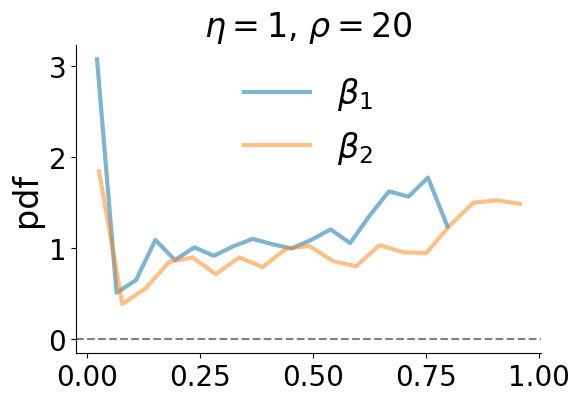

In [98]:
Tmax = int(1e5)
eta = 1
rho = 20
starting_nu = 0 # 3
ending_nu = 20
# starting_nu = 8
# ending_nu = 19

model_data_with_entropy_all[r"UMT($\eta=%s)$"%(str(eta))] = get_data_UMST(eta, rho, starting_nu, ending_nu,do_fig = True)
model_data_by_parameter[r"UMT($\eta=%s)$"%(str(eta))] = get_data_UMST_by_parameter(eta, rho, starting_nu, ending_nu)

### UMST eta 0.5 rho 20

  0%|          | 0/31 [00:00<?, ?it/s]

FOUND 	3000


  0%|          | 0/31 [00:00<?, ?it/s]

FOUND 	3000


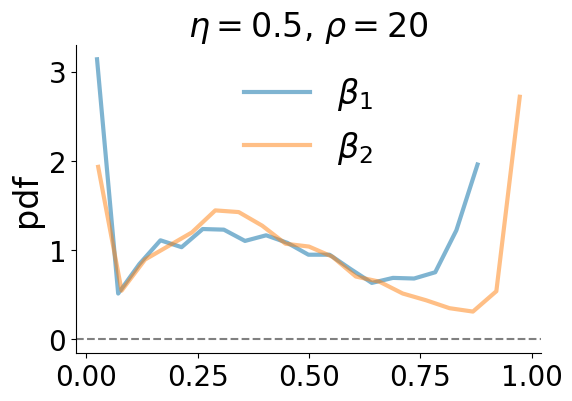

In [99]:
Tmax = int(1e5)
eta = 0.5
rho = 20
starting_nu = 0 # 5
ending_nu = 30 # 27
# starting_nu = 20
# ending_nu = 25 

model_data_with_entropy_all[r"UMST($\eta=%s)$"%(str(eta))] = get_data_UMST(eta, rho, starting_nu, ending_nu,do_fig = True)
model_data_by_parameter[r"UMST($\eta=%s)$"%(str(eta))] = get_data_UMST_by_parameter(eta, rho, starting_nu, ending_nu)

### UMST eta 0.1 rho 4

  0%|          | 0/21 [00:00<?, ?it/s]

FOUND 	2000


  0%|          | 0/21 [00:00<?, ?it/s]

FOUND 	2000


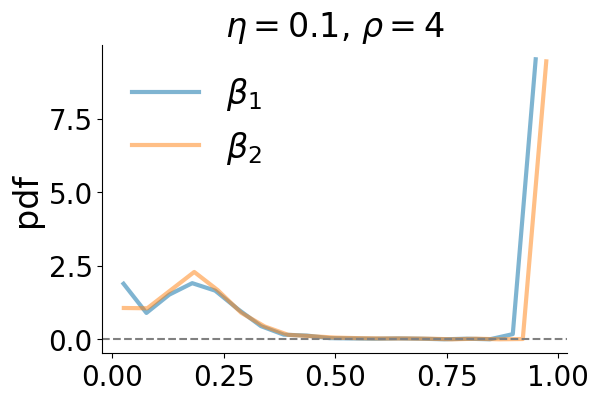

In [102]:
Tmax = int(1e5)
eta = 0.1
rho = 4
starting_nu = 0 # 1
ending_nu = 20 #12 #min(20, int(rho/eta))

model_data_with_entropy_all[r"UMST($\eta=%s)$"%(str(eta))] = get_data_UMST(eta, rho, starting_nu, ending_nu,do_fig = True)
model_data_by_parameter[r"UMST($\eta=%s)$"%(str(eta))] = get_data_UMST_by_parameter(eta, rho, starting_nu, ending_nu)

### ERRW on SW

  0%|          | 0/2100 [00:00<?, ?it/s]

FOUND 	2100	2100


  0%|          | 0/2100 [00:00<?, ?it/s]

FOUND 	2100	2100


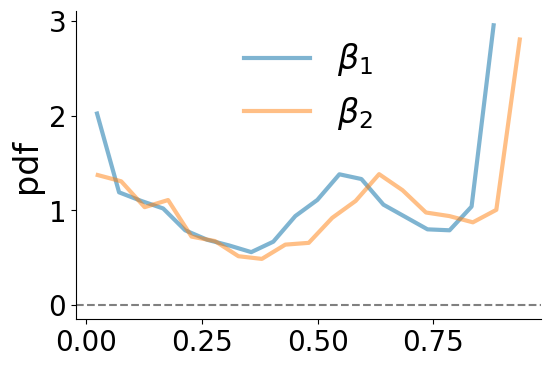

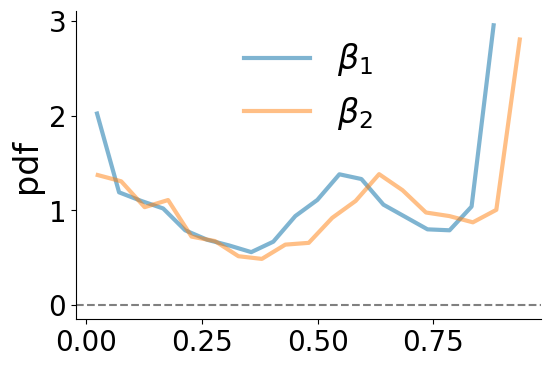

In [103]:
k = 4
model_data_with_entropy_all[fr"ERRW"] = get_data_ERRW(folder=f'SW_special_space_k_{k}_T_100000', do_fig = True)
model_data_by_parameter[fr"ERRW"] = get_data_ERRW_by_parameter(folder=f'SW_special_space_k_{k}_T_100000')

  0%|          | 0/2100 [00:00<?, ?it/s]

FOUND 	2100	2100


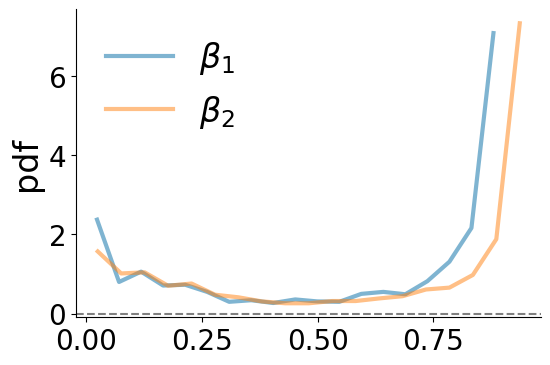

In [104]:
k = 4
log_ERRW = get_data_ERRW(folder=f'SW_logspace_k_{k}_T_100000', do_fig = True)

#### compare various sampling ERRWs

ERRW k=4-log
intercept 0.026935556627014086 slope 1.0437301539803052
p-value pearson between $\beta_1$ and $\beta_2$ 0.0
ERRW k=4
intercept 0.018956636209103234 slope 1.0628187902695405
p-value pearson between $\beta_1$ and None 0.0
ERRW2 k=4
intercept 0.022506320196834198 slope 1.058854174429118
p-value pearson between $\beta_1$ and None 0.0
ERRW5 k=4
intercept 0.0229940485810471 slope 1.0568316778423381
p-value pearson between $\beta_1$ and None 0.0


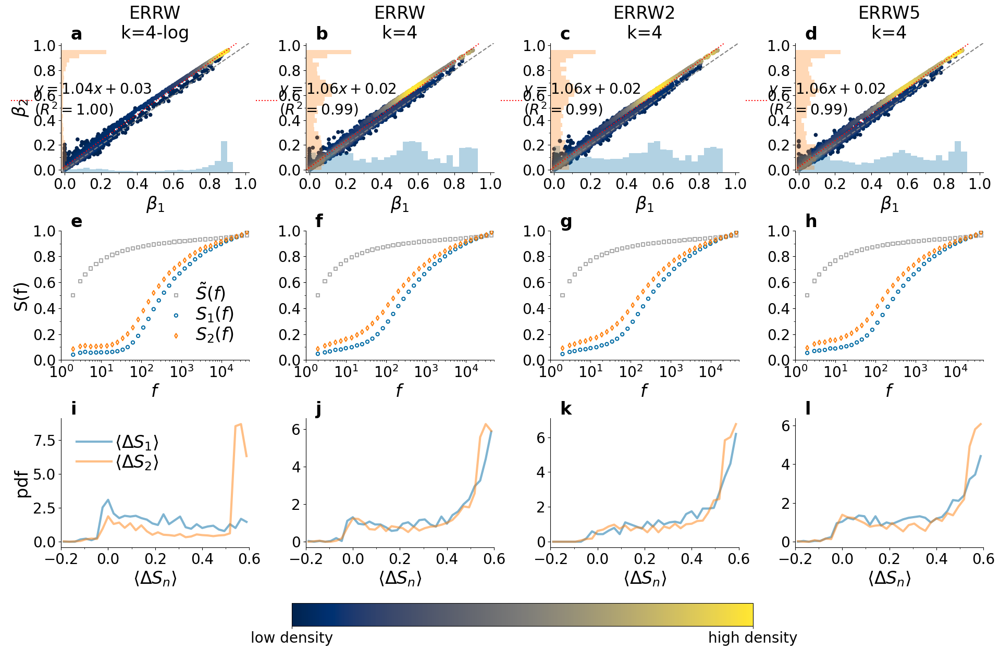

In [87]:
fig = fig_3_switched_rows_columns(
    {fr"ERRW k={4}-log":model_data_with_entropy_all[f"ERRW k={4}-log"], fr"ERRW k={4}":model_data_with_entropy_all[fr"ERRW k={4}"],f"ERRW2 k={4}":model_data_with_entropy_all[f"ERRW2 k={4}"],f"ERRW5 k={4}":model_data_with_entropy_all[f"ERRW5 k={4}"]}, 
    marker_size = 20, alpha_scatter = 1, alpha_histogram = 0.3, color_x = CB_color_cycle[0], color_y = CB_color_cycle[1], max_hist = 0.25, 
    min_x_scatter_heaps = 0,
    max_x_scatter_heaps = 1,
    min_y_scatter_heaps = 0,
    max_y_scatter_heaps = 1,
                                        use_same_x_y_max_lim = True,
    do_dashed_line = True,
    x_correlation_text = 0.55, 
    y_correlation_text = .32,
    num_bins = 35,
    min_x_entropy_by_freq = 1,
    max_x_entropy_by_freq = None,
    min_x_entropy_diff_distr = -0.2,
    max_x_entropy_diff_distr = 0.6,
    use_beta2_relative = False,
)

### New model

  0%|          | 0/31 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

FOUND 	159100
intercept 0.373211551258702 slope 0.8164517263545588
p-value pearson between $\beta_1$ and $\beta_2$ 0.0


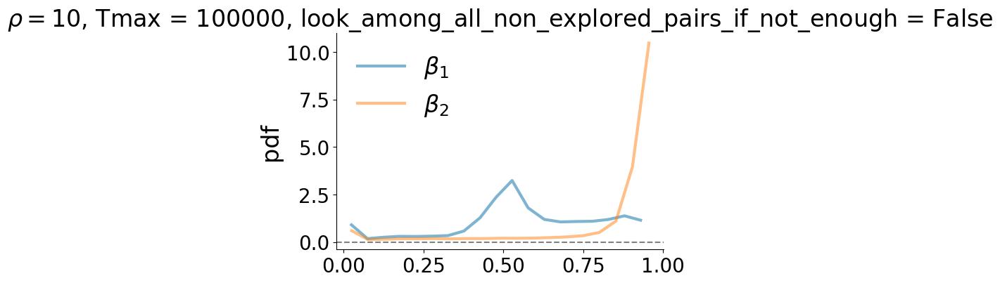

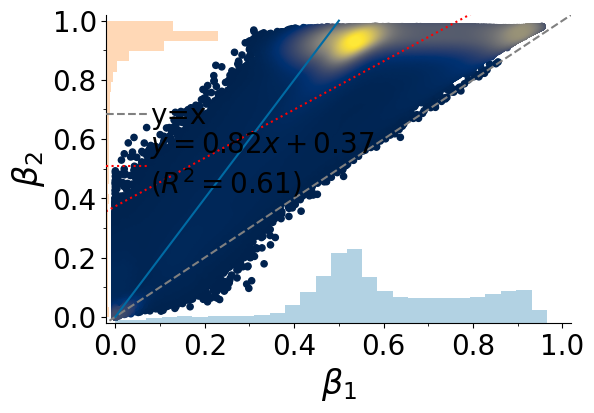

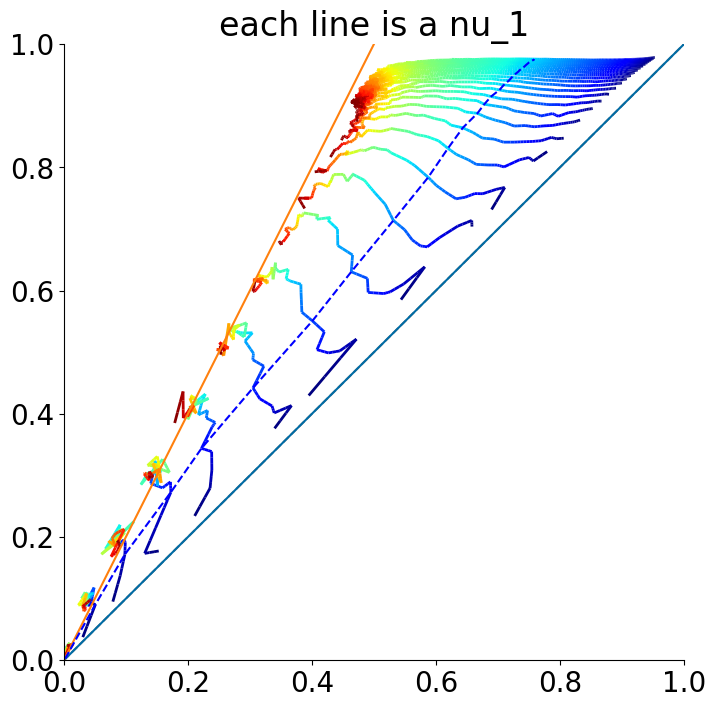

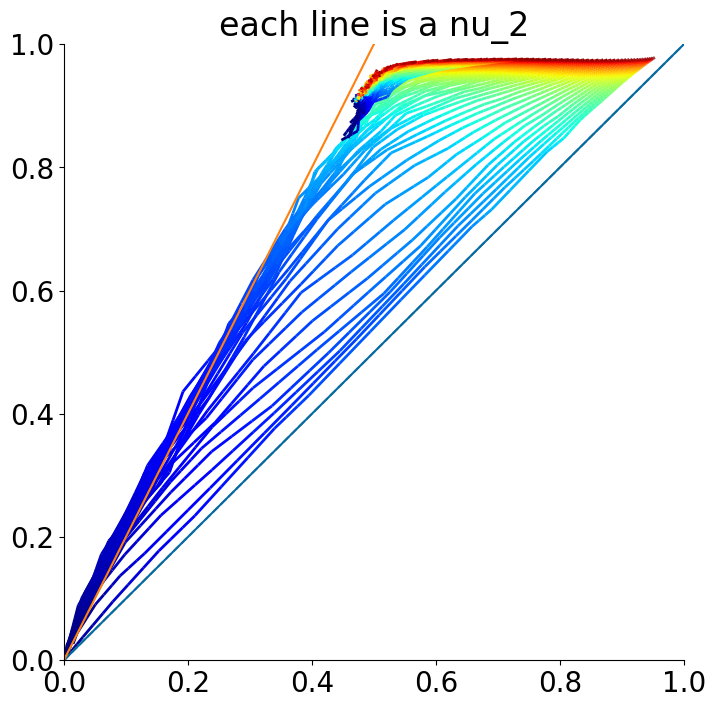

In [113]:
directed = False
do_non_overlapping_simulation = False
trigger_pairs_with_reinforcement = True
triggering_pairs_among_all_non_explored_pairs = False
look_among_all_non_explored_pairs_if_not_enough = False
trigger_links_with_new_colors_if_not_enough = False
trigger_links_between_new_colors_if_not_enough = False
Tmax = int(1e5)
new_model_data = get_data_new_pairs_UMT(
    rho = 10, 
    starting_nu_1 = 0, ending_nu_1 = 30,
    starting_nu_2 = 0, ending_nu_2 = 90,
    fraction_nu_2_cut = None,
    N_0 = 10, 
    M_0 = 0, 
    Tmax = Tmax,
    do_fig = True,
    t_to_use = Tmax,
    num_to_save = 1000,
    do_non_overlapping_simulation = do_non_overlapping_simulation,
    trigger_pairs_with_reinforcement = trigger_pairs_with_reinforcement,
    triggering_pairs_among_all_non_explored_pairs = triggering_pairs_among_all_non_explored_pairs,
    look_among_all_non_explored_pairs_if_not_enough = look_among_all_non_explored_pairs_if_not_enough,
    trigger_links_with_new_colors_if_not_enough = trigger_links_with_new_colors_if_not_enough, 
    trigger_links_between_new_colors_if_not_enough = trigger_links_between_new_colors_if_not_enough, 
    color_by_key = None,
    directed = directed,
)

In [138]:
individual_data, all_exponents, average_beta, average_beta2, average_beta_inverse, average_beta2_inverse, average_beta_dict, average_beta2_dict = dataset

In [139]:
model_data_by_parameter[fr"new model"] = {(nu_1, nu_2) : tmp_dict for nu_1,_ in individual_data.items() for nu_2,tmp_dict in _.items()}

### Get best parameter per model (dist w/ beta_1 and beta_2)

#### Functions for script

In [116]:
def sq_distance(x, y):
    assert len(x) == len (y), f'x and y must have the same length, here they are {len(x)} and {len(y)}'
    x = np.array(x)
    y = np.array(y)
    return np.sum((y-x)**2)

In [117]:
def get_best_parameter_sq_distance(
    x = np.array([0,1]), # point to fit
    model_2_ys_dict = {}, # parameter(s tuple) as key, np.ndarray long as the number of simulations, wide as dimension of x for values
    return_sorted_all = False,
    return_sqrt_dist = True,
):
    '''
    Confronts the given value x with the simulated values of the various models. Computes the average distance obtained by each model.
    If return_sorted_all, it returns the sorted models and average distances, sorted according to their distance.
    Otherwise it returns only the best model and its average distance.
    '''
    model_2_avg_dist_list = []
    for model, ys in model_2_ys_dict.items():
        distances = []
        for y in ys:
            distances.append(sq_distance(x, y))
        model_2_avg_dist_list.append((np.mean(distances), model))
    if return_sorted_all:
        sorted_model_2_avg_dist_list = sorted(model_2_avg_dist_list)
        avg_dists, best_models = np.array([_[1] for _ in sorted_model_2_avg_dist_list]) , [_[0] for _ in sorted_model_2_avg_dist_list]
        if return_sqrt_dist:
            avg_dists = np.sqrt(avg_dists)
        return avg_dists, best_models
    else:
        avg_dist, best_model = min(model_2_avg_dist_list)
        if return_sqrt_dist:
            avg_dist = np.sqrt(avg_dist)
        return best_model, avg_dist

#### Collect and dump necessary data

In [27]:
with gzip.open('./data/essential_entropy_data_for_figure.pkl.gz', "rb") as fp:
    data_with_entropy = joblib.load(fp)

In [118]:
data_to_compare_with_models = {}
for dataset_label, dataset_dict in tqdm(data_with_entropy.items()):
    data_to_compare_with_models[dataset_label] = {
        'betas' : dataset_dict['betas'],
        'betas2' : dataset_dict['betas2'],
        'weighted_diff_entropies' : dataset_dict['weighted_diff_entropies'],
        'weighted_diff_entropies_pairs' : dataset_dict['weighted_diff_entropies_pairs'],
    }

  0%|          | 0/3 [00:00<?, ?it/s]

In [119]:
with open('./data/data_to_compare_with_models.pkl', 'wb') as fp:
    pickle.dump(data_to_compare_with_models, fp)

In [121]:
model_data_by_parameter.keys()

dict_keys(['UMT($\\eta=1)$', 'UMT($\\eta=0.5)$', 'UMT($\\eta=0.1)$', 'ERRW', 'new model'])

In [140]:
models_2_betas_betas2_dict = {}
models_2_weighted_diff_entropies_dict = {}
models_2_weighted_diff_entropies_pairs_dict = {}
models_2_average_individual_data = {}

for model_label, model_data in tqdm(model_data_by_parameter.items()):
    models_2_betas_betas2_dict[model_label] = {}
    models_2_weighted_diff_entropies_dict[model_label] = {}
    models_2_weighted_diff_entropies_pairs_dict[model_label] = {}
    models_2_average_individual_data[model_label] = {}
    for param, tmp_dict in model_data.items():
        models_2_betas_betas2_dict[model_label][param] = np.array([np.array([tmp_dict['betas'][i], tmp_dict['betas2'][i]]) for i in range(len(tmp_dict['betas']))])
        models_2_weighted_diff_entropies_dict[model_label][param] = np.array([tmp_dict['weighted_diff_entropies'][i] for i in range(len(tmp_dict['betas']))])
        models_2_weighted_diff_entropies_pairs_dict[model_label][param] = np.array([tmp_dict['weighted_diff_entropies_pairs'][i] for i in range(len(tmp_dict['betas']))])
        models_2_average_individual_data[model_label][param] = {}
        models_2_average_individual_data[model_label][param]['beta'] = np.mean(tmp_dict['betas'])
        models_2_average_individual_data[model_label][param]['beta2'] = np.mean(tmp_dict['betas2'])
        models_2_average_individual_data[model_label][param]['weighted_diff_entropies'] = np.mean(tmp_dict['weighted_diff_entropies'])
        models_2_average_individual_data[model_label][param]['weighted_diff_entropies_pairs'] = np.mean(tmp_dict['weighted_diff_entropies_pairs'])

  0%|          | 0/5 [00:00<?, ?it/s]

In [141]:
with open('./data/models_2_betas_betas2_dict.pkl', 'wb') as fp:
    pickle.dump(models_2_betas_betas2_dict, fp)

with open('./data/models_2_weighted_diff_entropies_dict.pkl', 'wb') as fp:
    pickle.dump(models_2_weighted_diff_entropies_dict, fp)

with open('./data/models_2_weighted_diff_entropies_pairs_dict.pkl', 'wb') as fp:
    pickle.dump(models_2_weighted_diff_entropies_pairs_dict, fp)

with open('./data/models_2_average_individual_data.pkl', 'wb') as fp:
    pickle.dump(models_2_average_individual_data, fp)

In [177]:
best_representation_models = {}
for model_label in tqdm(models_2_betas_betas2_dict.keys()):
    print('Model:', model_label, flush=True)
    best_representation_model = best_representation_models[model_label] = {}
    model_2_betas_betas2_dict = models_2_betas_betas2_dict[model_label]
    model_2_weighted_diff_entropies_dict = models_2_weighted_diff_entropies_dict[model_label]
    model_2_weighted_diff_entropies_pairs_dict = models_2_weighted_diff_entropies_pairs_dict[model_label]
    model_2_average_individual_data = models_2_average_individual_data[model_label]
    for dataset_label, dataset_dict in tqdm(data_to_compare_with_models.items()):
        print('\tDataset:', dataset_label, flush=True)
        best_dataset_dict = best_representation_model[dataset_label] = {
            'betas' : dataset_dict['betas'],
            'betas2' : dataset_dict['betas2'],
            'weighted_diff_entropies' : dataset_dict['weighted_diff_entropies'],
            'weighted_diff_entropies_pairs' : dataset_dict['weighted_diff_entropies_pairs'],
            'best_model' : [], 
            'avg_distance_best_model' : [], 
            'betas_best_model' : [],
            'betas2_best_model' : [],
            'weighted_diff_entropies_best_model' : [],
            'weighted_diff_entropies_pairs_best_model' : [],
            'dist_avg_betas' : [],
            'dist_avg_betas2' : [],
            'avg_dist_betas' : [],
            'avg_dist_betas2' : [],
            'dist_avg_weighted_diff_entropies' : [],
            'dist_avg_weighted_diff_entropies_pairs' : [],
            'avg_dist_weighted_diff_entropies' : [],
            'avg_dist_weighted_diff_entropies_pairs' : [],
        }
        for i in tqdm(range(len(best_dataset_dict['betas']))):
            beta = best_dataset_dict['betas'][i]
            beta2 = best_dataset_dict['betas2'][i]
            weighted_diff_entropies = best_dataset_dict['weighted_diff_entropies'][i]
            weighted_diff_entropies_pairs = best_dataset_dict['weighted_diff_entropies_pairs'][i]

            best_model, avg_distance_best_model = get_best_parameter_sq_distance(
                x = np.array([beta, beta2]), # point to fit
                model_2_ys_dict = model_2_betas_betas2_dict, # parameter(s tuple) as key, np.ndarray long as the number of simulations, wide as dimension of x for values
    #             return_sorted_all = False,
            )

            best_dataset_dict['best_model'].append(best_model)
            best_dataset_dict['avg_distance_best_model'].append(avg_distance_best_model)
            best_dataset_dict['betas_best_model'].append(model_2_average_individual_data[best_model]['beta'])
            best_dataset_dict['betas2_best_model'].append(model_2_average_individual_data[best_model]['beta2'])
            best_dataset_dict['weighted_diff_entropies_best_model'].append(model_2_average_individual_data[best_model]['weighted_diff_entropies'])
            best_dataset_dict['weighted_diff_entropies_pairs_best_model'].append(model_2_average_individual_data[best_model]['weighted_diff_entropies_pairs'])

            best_dataset_dict['dist_avg_betas'].append(np.abs(model_2_average_individual_data[best_model]['beta'] - beta))
            best_dataset_dict['dist_avg_betas2'].append(np.abs(model_2_average_individual_data[best_model]['beta2'] - beta2))
            best_dataset_dict['dist_avg_weighted_diff_entropies'].append(np.abs(model_2_average_individual_data[best_model]['weighted_diff_entropies'] - weighted_diff_entropies))
            best_dataset_dict['dist_avg_weighted_diff_entropies_pairs'].append(np.abs(model_2_average_individual_data[best_model]['weighted_diff_entropies_pairs'] - weighted_diff_entropies_pairs))
            avg_dist_betas, avg_dist_betas2 = np.mean(np.abs(model_2_betas_betas2_dict[best_model] - np.array([beta,beta2])), axis = 0)
            best_dataset_dict['avg_dist_betas'].append(avg_dist_betas)
            best_dataset_dict['avg_dist_betas2'].append(avg_dist_betas2)
            avg_dist_weighted_diff_entropies = np.mean(np.abs(model_2_weighted_diff_entropies_dict[best_model] - weighted_diff_entropies))
            best_dataset_dict['avg_dist_weighted_diff_entropies'].append(avg_dist_weighted_diff_entropies)
            avg_dist_weighted_diff_entropies_pairs = np.mean(np.abs(model_2_weighted_diff_entropies_pairs_dict[best_model] - weighted_diff_entropies_pairs))
            best_dataset_dict['avg_dist_weighted_diff_entropies_pairs'].append(avg_dist_weighted_diff_entropies_pairs)
        with open('./data/best_representation_models_all.pkl', 'wb') as fp:
            pickle.dump(best_representation_models, fp)

  0%|          | 0/5 [00:00<?, ?it/s]

Model: UMT($\eta=1)$


  0%|          | 0/3 [00:00<?, ?it/s]

	Dataset: Last.fm


  0%|          | 0/889 [00:00<?, ?it/s]

	Dataset: Project Gutenberg


  0%|          | 0/19637 [00:00<?, ?it/s]

	Dataset: Semantic Scholar


  0%|          | 0/19000 [00:00<?, ?it/s]

Model: ERRW


  0%|          | 0/3 [00:00<?, ?it/s]

	Dataset: Last.fm


  0%|          | 0/889 [00:00<?, ?it/s]

	Dataset: Project Gutenberg


  0%|          | 0/19637 [00:00<?, ?it/s]

	Dataset: Semantic Scholar


  0%|          | 0/19000 [00:00<?, ?it/s]

Model: new model


  0%|          | 0/3 [00:00<?, ?it/s]

	Dataset: Last.fm


  0%|          | 0/889 [00:00<?, ?it/s]

	Dataset: Project Gutenberg


  0%|          | 0/19637 [00:00<?, ?it/s]

	Dataset: Semantic Scholar


  0%|          | 0/19000 [00:00<?, ?it/s]

Model: UMST($\eta=0.5)$


  0%|          | 0/3 [00:00<?, ?it/s]

	Dataset: Last.fm


  0%|          | 0/889 [00:00<?, ?it/s]

	Dataset: Project Gutenberg


  0%|          | 0/19637 [00:00<?, ?it/s]

	Dataset: Semantic Scholar


  0%|          | 0/19000 [00:00<?, ?it/s]

Model: UMST($\eta=0.1)$


  0%|          | 0/3 [00:00<?, ?it/s]

	Dataset: Last.fm


  0%|          | 0/889 [00:00<?, ?it/s]

	Dataset: Project Gutenberg


  0%|          | 0/19637 [00:00<?, ?it/s]

	Dataset: Semantic Scholar


  0%|          | 0/19000 [00:00<?, ?it/s]

In [151]:
with open('./data/best_representation_models.pkl', 'wb') as fp:
    pickle.dump(best_representation_models, fp)

## Figure comparison previous models

UMT($\eta=1)$


No handles with labels found to put in legend.


UMST($\eta=0.5)$


No handles with labels found to put in legend.


UMST($\eta=0.1)$


No handles with labels found to put in legend.


ERRW k=4


No handles with labels found to put in legend.


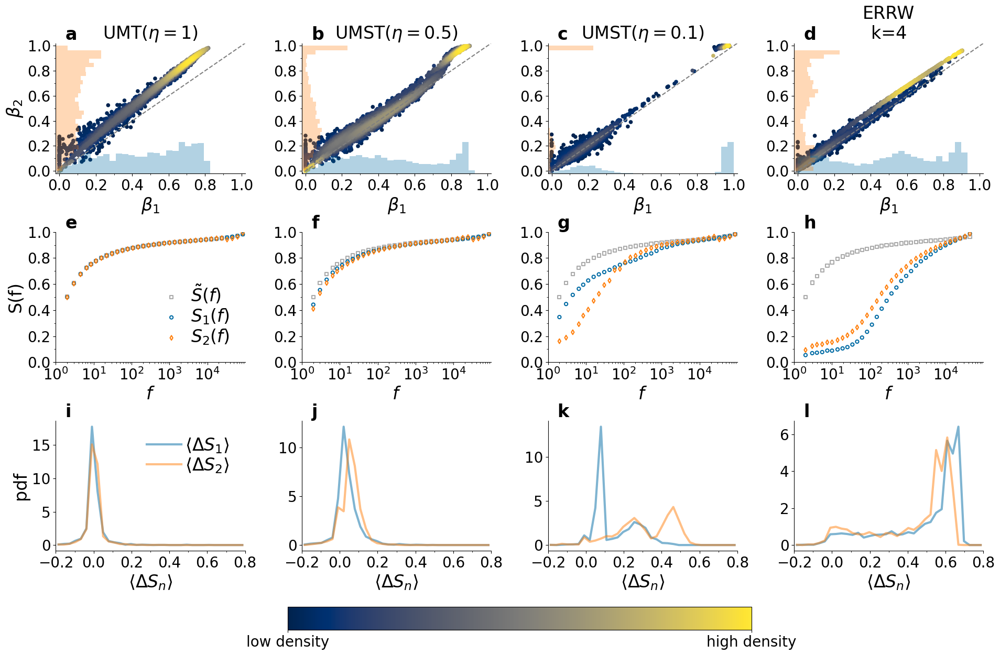

In [135]:
fig = fig_3_switched_rows_columns(
    model_data_with_entropy_all, 
    marker_size = 20, alpha_scatter = 1, alpha_histogram = 0.3, color_x = CB_color_cycle[0], color_y = CB_color_cycle[1], max_hist = 0.25, 
    min_x_scatter_heaps = 0,
    max_x_scatter_heaps = 1,
    min_y_scatter_heaps = 0,
    max_y_scatter_heaps = 1,
                                        use_same_x_y_max_lim = True,
    do_dashed_line = True,
    x_correlation_text = 0.55, 
    y_correlation_text = .32,
    num_bins = 35,
    min_x_entropy_by_freq = 1,
    max_x_entropy_by_freq = None,
    min_x_entropy_diff_distr = -0.2,
    max_x_entropy_diff_distr = 0.8,
    use_beta2_relative = False,
    plot_pearson = False,
)


fig.savefig(os.path.join(figures_folder, f"Fig_model_simulations_all_new.png"))
fig.savefig(os.path.join(figures_folder, f"Fig_model_simulations_low_res_all_new.pdf"),format='pdf',dpi=100)
fig.savefig(os.path.join(figures_folder, f"Fig_model_simulations_all_new.pdf"),format='pdf')

## Figures distances data - model

### Hist dist 2d

Text(0.5, 1.0, 'sqrt min. dist eucl. 2d')

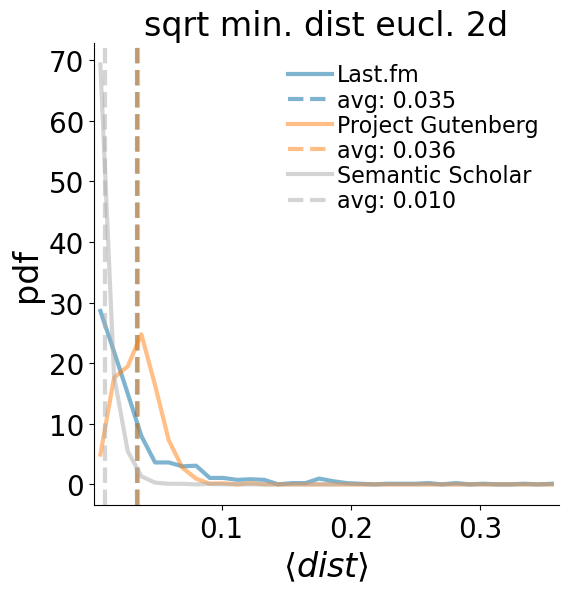

In [167]:
fig, ax = plt.subplots(figsize=(6,6))
key = 'avg_distance_best_model'
# for col, (dataset_label, best_dataset_dict) in enumerate(best_representation_new_model.items()):
subplot_distr(best_representation_new_model, 
              key,
#                   label = dataset_label,
                ax = ax, alpha = 0.5, 
                number_to_write = 0, 
                num_bins = 35,
                xlim_left = None, xlim_right = None, 
                xlabel = r"$\langle dist \rangle$", 
                ylabel = r"pdf", 
                do_legend = True,
                write_number = False)
ax.set_title('sqrt min. dist eucl. 2d')

Text(0.5, 0.98, 'sqrt min. dist eucl. 2d')

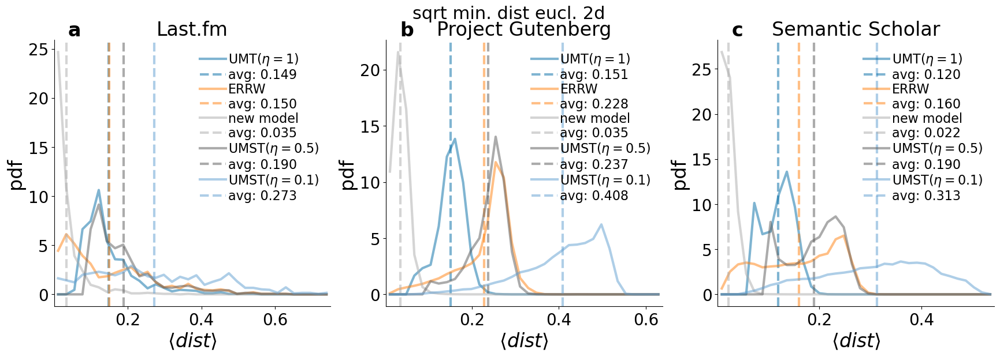

In [178]:
fig, axes = plt.subplots(ncols=3,figsize=(21,6))
key = 'avg_distance_best_model'
# for col, (dataset_label, best_dataset_dict) in enumerate(best_representation_new_model.items()):
model_labels = list(best_representation_models.keys())
for i,dataset_label in enumerate(['Last.fm', 'Project Gutenberg', 'Semantic Scholar']):
    ax = axes[i]
    subplot_distr({model_label:best_representation_models[model_label][dataset_label] for model_label in model_labels}, 
                  key,
    #                   label = dataset_label,
                    ax = ax, alpha = 0.5, 
                    number_to_write = i, 
                    num_bins = 35,
                    xlim_left = None, xlim_right = None, 
                    xlabel = r"$\langle dist \rangle$", 
                    ylabel = r"pdf", 
                    do_legend = True,
                    write_number = True)
    ax.set_title(dataset_label)
fig.suptitle('sqrt min. dist eucl. 2d', fontsize = 22)


### Dist avg. variable

In [155]:
best_representation_models.keys()

dict_keys(['UMT($\\eta=1)$', 'ERRW', 'new model', 'UMST($\\eta=0.5)$', 'UMST($\\eta=0.1)$'])

In [179]:
best_representation_new_model = best_representation_models['new model']

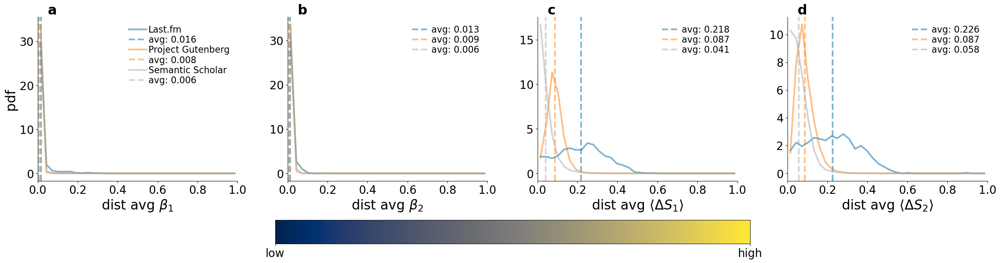

In [180]:
fig = fig_hist_dist_data_vs_best_model(
    best_representation_new_model,
    keys_to_scatter_2_label_dict = {
        'dist_avg_betas' : r'dist avg $\beta_1$', 
        'dist_avg_betas2' : r'dist avg $\beta_2$', 
        'dist_avg_weighted_diff_entropies' : r'dist avg $\langle \Delta S_1 \rangle$', 
        'dist_avg_weighted_diff_entropies_pairs' : r'dist avg $\langle \Delta S_2 \rangle$',
#         'avg_dist_betas' : r'avg dist $\beta_1$', 
#         'avg_dist_betas2' : r'avg dist $\beta_2$', 
#         'avg_dist_weighted_diff_entropies' : r'avg dist $\langle \Delta S_1 \rangle$', 
#         'avg_dist_weighted_diff_entropies_pairs' : r'avg dist $\langle \Delta S_2 \rangle$'
    },
    marker_size = 20, alpha_scatter = 1, alpha_histogram = 0.3, color_x = CB_color_cycle[0], color_y = CB_color_cycle[1], max_hist = 0.25, 
    plot_pearson = True,
    x_correlation_text = 1.06, 
    y_correlation_text = .27,
    xlim_left = 0, xlim_right = 1, 
)


fig.savefig(os.path.join(figures_folder, f"Fig_hist_dist_data_vs_new_model.png"))
fig.savefig(os.path.join(figures_folder, f"Fig_hist_dist_data_vs_new_model_low_res.pdf"),dpi=100)
fig.savefig(os.path.join(figures_folder, f"Fig_hist_dist_data_vs_new_model.pdf"))

Text(0.5, 0.98, 'NEW MODEL')

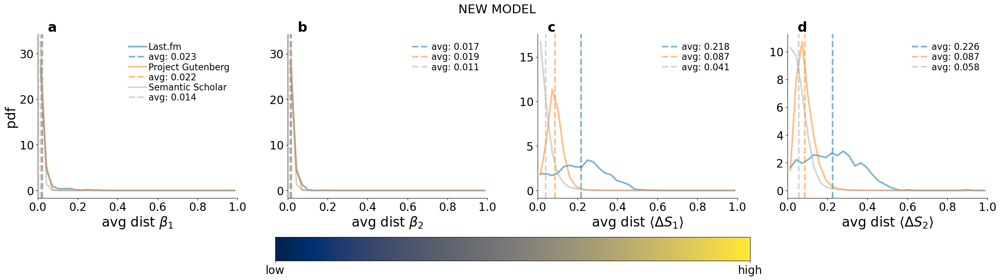

In [181]:
fig = fig_hist_dist_data_vs_best_model(
    best_representation_new_model,
    keys_to_scatter_2_label_dict = {
#         'dist_avg_betas' : r'dist avg $\beta_1$', 
#         'dist_avg_betas2' : r'dist avg $\beta_2$', 
#         'dist_avg_weighted_diff_entropies' : r'dist avg $\langle \Delta S_1 \rangle$', 
#         'dist_avg_weighted_diff_entropies_pairs' : r'dist avg $\langle \Delta S_2 \rangle$',
        'avg_dist_betas' : r'avg dist $\beta_1$', 
        'avg_dist_betas2' : r'avg dist $\beta_2$', 
        'avg_dist_weighted_diff_entropies' : r'avg dist $\langle \Delta S_1 \rangle$', 
        'avg_dist_weighted_diff_entropies_pairs' : r'avg dist $\langle \Delta S_2 \rangle$'
    },
    marker_size = 20, alpha_scatter = 1, alpha_histogram = 0.3, color_x = CB_color_cycle[0], color_y = CB_color_cycle[1], max_hist = 0.25, 
    plot_pearson = True,
    x_correlation_text = 1.06, 
    y_correlation_text = .27,
    xlim_left = 0, xlim_right = 1, 
)

fig.suptitle('NEW MODEL', fontsize=22)
# fig.savefig(os.path.join(figures_folder, f"Fig_hist2_dist_data_vs_new_model.png"))
# fig.savefig(os.path.join(figures_folder, f"Fig_hist2_dist_data_vs_new_model_low_res.pdf"),dpi=100)
# fig.savefig(os.path.join(figures_folder, f"Fig_hist2_dist_data_vs_new_model.pdf"))

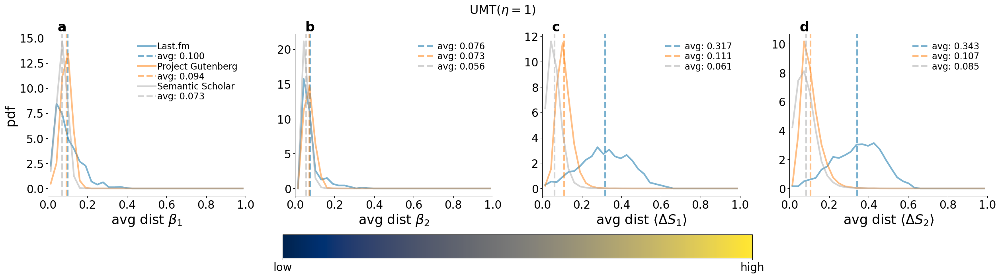

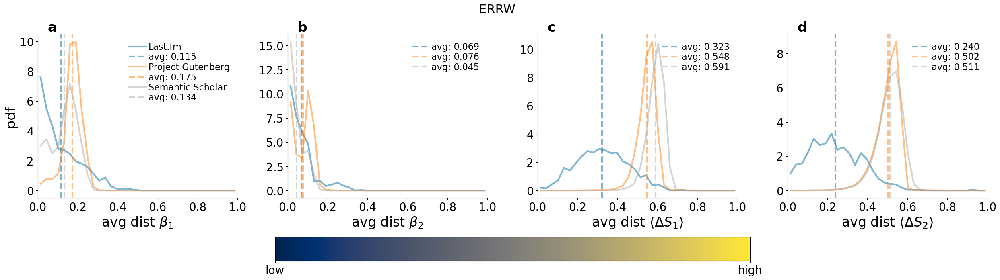

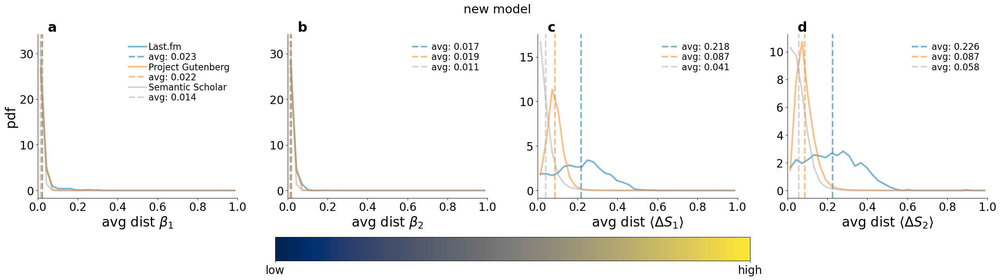

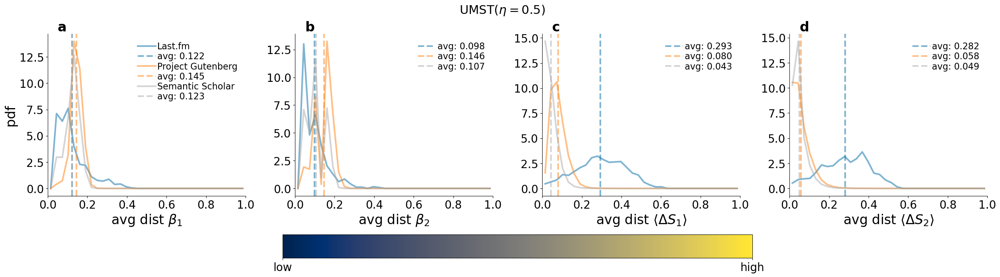

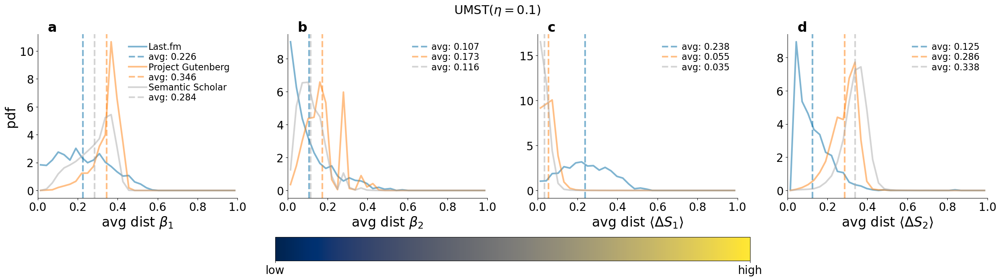

In [182]:
for model_label, model_data in best_representation_models.items():
    fig = fig_hist_dist_data_vs_best_model(
        model_data,
        keys_to_scatter_2_label_dict = {
    #         'dist_avg_betas' : r'dist avg $\beta_1$', 
    #         'dist_avg_betas2' : r'dist avg $\beta_2$', 
    #         'dist_avg_weighted_diff_entropies' : r'dist avg $\langle \Delta S_1 \rangle$', 
    #         'dist_avg_weighted_diff_entropies_pairs' : r'dist avg $\langle \Delta S_2 \rangle$',
            'avg_dist_betas' : r'avg dist $\beta_1$', 
            'avg_dist_betas2' : r'avg dist $\beta_2$', 
            'avg_dist_weighted_diff_entropies' : r'avg dist $\langle \Delta S_1 \rangle$', 
            'avg_dist_weighted_diff_entropies_pairs' : r'avg dist $\langle \Delta S_2 \rangle$'
        },
        marker_size = 20, alpha_scatter = 1, alpha_histogram = 0.3, color_x = CB_color_cycle[0], color_y = CB_color_cycle[1], max_hist = 0.25, 
        plot_pearson = True,
        x_correlation_text = 1.06, 
        y_correlation_text = .27,
        xlim_left = 0, xlim_right = 1, 
    )
    fig.suptitle(model_label, fontsize=22)


    # fig.savefig(os.path.join(figures_folder, f"Fig_hist2_dist_data_vs_new_model.png"))
    # fig.savefig(os.path.join(figures_folder, f"Fig_hist2_dist_data_vs_new_model_low_res.pdf"),dpi=100)
    # fig.savefig(os.path.join(figures_folder, f"Fig_hist2_dist_data_vs_new_model.pdf"))

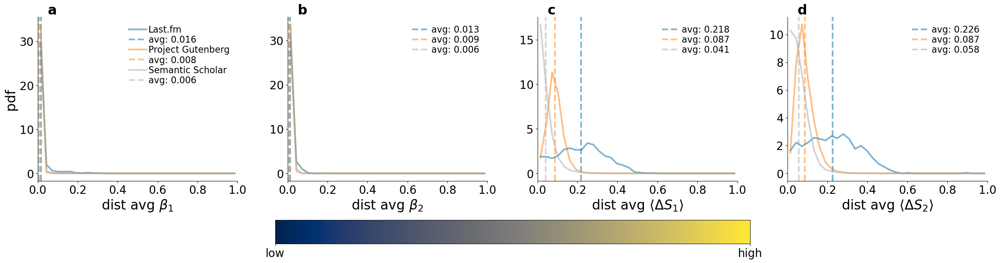

In [183]:
fig = fig_hist_dist_data_vs_best_model(
    best_representation_new_model,
    keys_to_scatter_2_label_dict = {
        'dist_avg_betas' : r'dist avg $\beta_1$', 
        'dist_avg_betas2' : r'dist avg $\beta_2$', 
        'dist_avg_weighted_diff_entropies' : r'dist avg $\langle \Delta S_1 \rangle$', 
        'dist_avg_weighted_diff_entropies_pairs' : r'dist avg $\langle \Delta S_2 \rangle$',
#         'avg_dist_betas' : r'avg dist $\beta_1$', 
#         'avg_dist_betas2' : r'avg dist $\beta_2$', 
#         'avg_dist_weighted_diff_entropies' : r'avg dist $\langle \Delta S_1 \rangle$', 
#         'avg_dist_weighted_diff_entropies_pairs' : r'avg dist $\langle \Delta S_2 \rangle$'
    },
    marker_size = 20, alpha_scatter = 1, alpha_histogram = 0.3, color_x = CB_color_cycle[0], color_y = CB_color_cycle[1], max_hist = 0.25, 
    plot_pearson = True,
    x_correlation_text = 1.06, 
    y_correlation_text = .27,
    xlim_left = 0, xlim_right = 1, 
)


fig.savefig(os.path.join(figures_folder, f"Fig_hist_dist_data_vs_new_model.png"))
fig.savefig(os.path.join(figures_folder, f"Fig_hist_dist_data_vs_new_model_low_res.pdf"),dpi=100)
fig.savefig(os.path.join(figures_folder, f"Fig_hist_dist_data_vs_new_model.pdf"))

### Scatter distance variables new model

intercept 0.1091177145750322 slope 0.8580514032225568
p-value pearson between $\beta_1$ and $\beta_1$model 0.0
intercept 0.0860418650107684 slope 0.9008867642634577
p-value pearson between $\beta_2$ and $\beta_2$model 0.0
intercept 0.013534293891983722 slope 0.4619051531431422
p-value pearson between $\langle \Delta S_1 \rangle$ and $\langle \Delta S_1 \rangle$model 2.1206286346050103e-21
intercept 0.029613496526963587 slope 0.3777234718211657
p-value pearson between $\langle \Delta S_2 \rangle$ and $\langle \Delta S_2 \rangle$model 9.536760491201498e-19
intercept 0.022195534584389744 slope 0.9681808704544834
p-value pearson between $\beta_1$ and $\beta_1$model 0.0
intercept 0.060613309047761466 slope 0.935615538864418
p-value pearson between $\beta_2$ and $\beta_2$model 0.0
intercept 0.0003352963145061683 slope 0.24414256053610164
p-value pearson between $\langle \Delta S_1 \rangle$ and $\langle \Delta S_1 \rangle$model 0.0
intercept 0.00021328157572767144 slope 0.23611798637456505
p-

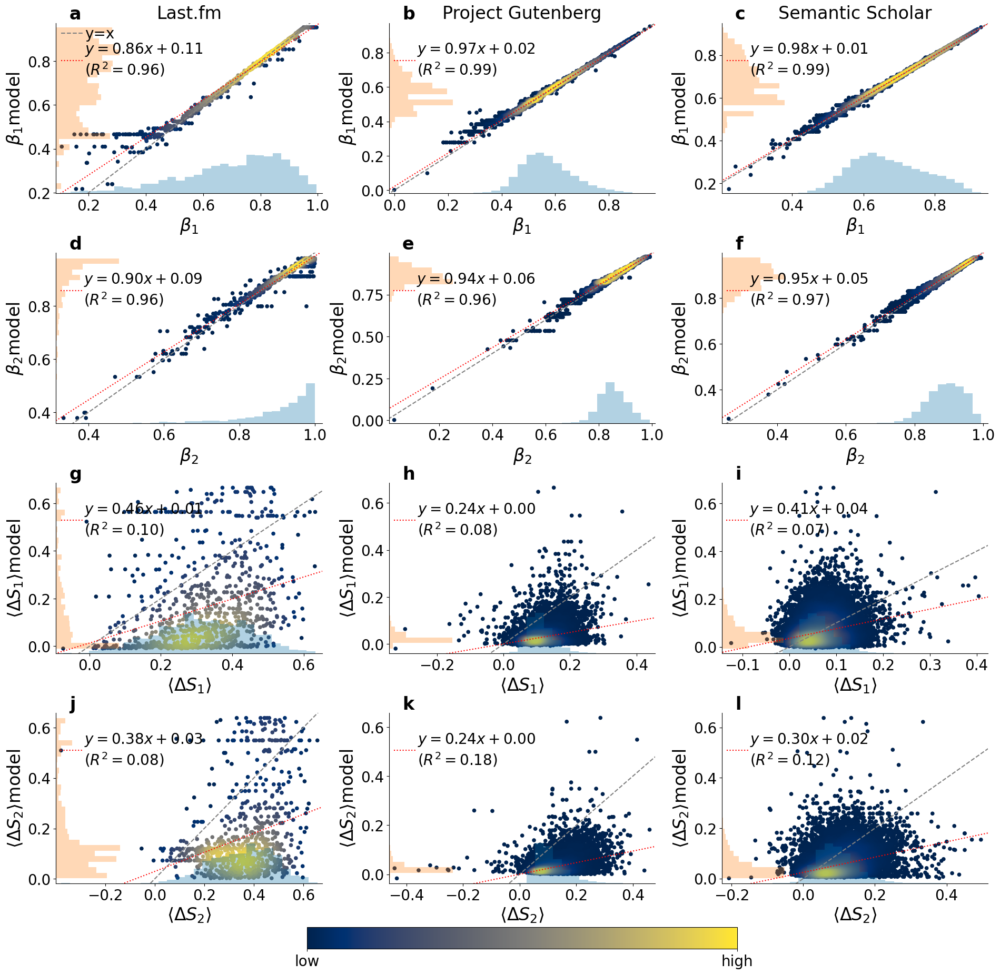

In [184]:
fig = fig_seq_data_vs_best_model(
    best_representation_new_model,
    keys_to_scatter_2_label_dict = {'betas':r'$\beta_1$', 'betas2':r'$\beta_2$', 'weighted_diff_entropies':r'$\langle \Delta S_1 \rangle$', 'weighted_diff_entropies_pairs':r'$\langle \Delta S_2 \rangle$'},
    marker_size = 20, alpha_scatter = 1, alpha_histogram = 0.3, color_x = CB_color_cycle[0], color_y = CB_color_cycle[1], max_hist = 0.25, 
    plot_pearson = True,
    x_correlation_text = .6, 
    y_correlation_text = .6,
)


fig.savefig(os.path.join(figures_folder, f"Fig_data_vs_new_model.png"))
fig.savefig(os.path.join(figures_folder, f"Fig_data_vs_new_model_low_res.pdf"),dpi=100)
fig.savefig(os.path.join(figures_folder, f"Fig_data_vs_new_model.pdf"))

## Figure new model

In [656]:
average_data = {}
for dataset_label, dataset in data.items():
    x_data = np.array(dataset[f'betas'])
    y_data = np.array(dataset[f'betas2'])
    average_data[dataset_label] = {}
    average_data[dataset_label]['beta'] = np.mean(x_data)
    average_data[dataset_label]['beta2'] = np.mean(y_data)

$\rho=10$,$\nu_1=5$,$\nu_2=5$


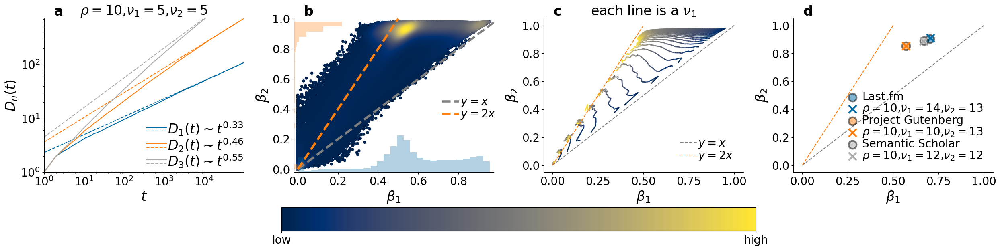

In [962]:
fig = fig_new_model(
    individual_data, all_exponents, average_beta, average_beta2, average_beta_inverse, average_beta2_inverse, average_beta_dict, average_beta2_dict, average_data,
    color_by_key = 'nu_2',
    marker_size = 20, alpha_scatter = 1, alpha_histogram = 0.3, color_x = CB_color_cycle[0], color_y = CB_color_cycle[1], max_hist = 0.25, xlim_left_a = 1, ylim_bottom_a = 1,
    min_beta = None,
    max_beta = None,
    min_beta_higher = None,
    max_beta_higher = None,
    use_same_x_y_max_lim = True,
    x_correlation_text = 1.06, 
    y_correlation_text = .27,
    rho = 10,
    special_nu_1_list = [5],
    special_nu_2_list = [5],
)

fig.savefig(os.path.join(figures_folder, f"Fig_new_model.png"))
fig.savefig(os.path.join(figures_folder, f"Fig_new_model_low_res.pdf"),dpi=100)
fig.savefig(os.path.join(figures_folder, f"Fig_new_model.pdf"))

$\rho=10$,$\nu_1=10$,$\nu_2=20$


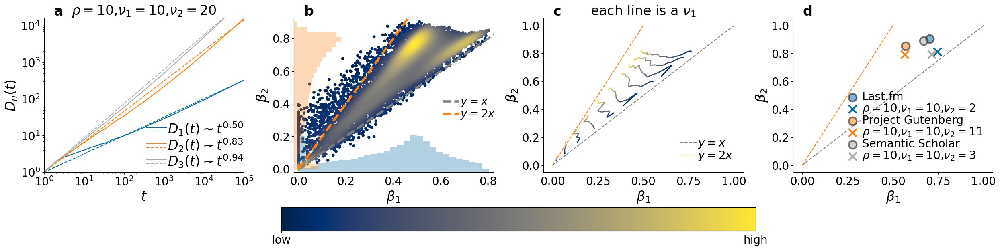

In [706]:
fig = fig_new_model(
    individual_data, all_exponents, average_beta, average_beta2, average_beta_inverse, average_beta2_inverse, average_beta_dict, average_beta2_dict, average_data,
    color_by_key = 'nu_1',
    marker_size = 20, alpha_scatter = 1, alpha_histogram = 0.3, color_x = CB_color_cycle[0], color_y = CB_color_cycle[1], max_hist = 0.25, xlim_left_a = 1, ylim_bottom_a = 1,
    min_beta = None,
    max_beta = None,
    min_beta_higher = None,
    max_beta_higher = None,
    use_same_x_y_max_lim = True,
    x_correlation_text = 1.06, 
    y_correlation_text = .27,
    rho = 10,
    special_nu_1_list = [10],
    special_nu_2_list = [20],
)

fig.savefig(os.path.join(figures_folder, f"Fig_new_model.png"))
fig.savefig(os.path.join(figures_folder, f"Fig_new_model_low_res.pdf"),dpi=100)
fig.savefig(os.path.join(figures_folder, f"Fig_new_model.pdf"))

### Check Heaps

$\rho=10$,$\nu_1=5$,$\nu_2=5$


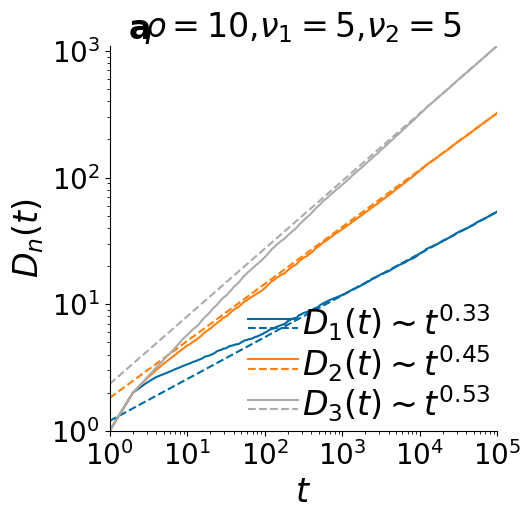

In [707]:
rho = 10
special_nu_1_list = [5]
special_nu_2_list = [5]
use_same_x_y_max_lim = False
higher_orders = [2,3]
marker_size = 20
alpha_scatter = 1
fig,ax = plt.subplots(figsize=(5,5))
# HEAPS LAW
max_t = 1
max_D = 1
# ax = plt.Subplot(fig, inner[0])
for i, nu_1 in enumerate(special_nu_1_list):
    nu_2 = special_nu_2_list[i]
    dataset_label = fr'$\rho={rho}$,$\nu_1={nu_1}$,$\nu_2={nu_2}$'
    dataset_dict = individual_data[nu_1][nu_2]
    for order in ['', '2', '3', '4']:
        dataset_dict[f'beta{order}'] = dataset_dict[f'beta{order}_loglogregr_indices_geom']
        dataset_dict[f'intercept{order}'] = dataset_dict[f'intercept{order}_loglogregr_indices_geom']
    print(dataset_label)
    if use_same_x_y_max_lim == False:
        max_t = dataset_dict["ts"][-1]+1
        max_D = 1
    else:
        max_t = max(max_t,dataset_dict["ts"][-1]+1)
    for order in ['']+[str(tmp_order) for tmp_order in higher_orders]:
        max_D = max(max_D, dataset_dict[f"D{order}_indices"][-1]+1)
    xlabel_heaps_law = r"$t$"
    ylabel_heaps_law = r'$D_n(t)$'
    subplot_heaps_law(dataset_dict, 
        ax = ax, 
        marker_size = marker_size, alpha = alpha_scatter, 
        number_to_write = 0, 
        xlim_left = 1, xlim_right = max_t, 
        ylim_bottom = 1, ylim_top = max_D, 
        title = '\n'.join(dataset_label.split(' ')),
        xlabel = xlabel_heaps_law, 
        ylabel = ylabel_heaps_law, write_number = True,
    )
# fig.add_subplot(ax)

$\rho=10$,$\nu_1=5$,$\nu_2=10$


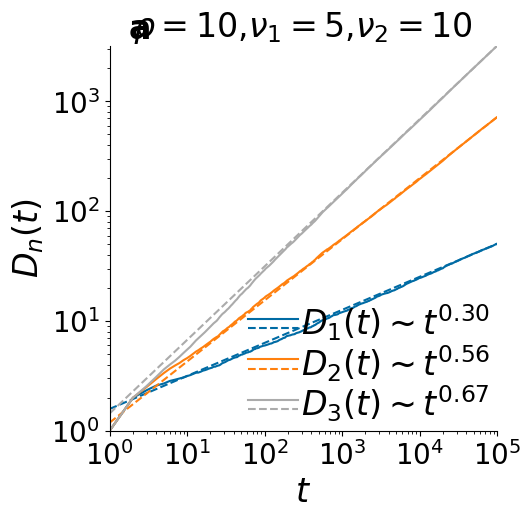

In [708]:
rho = 10
special_nu_1_list = [5]
special_nu_2_list = [10]
use_same_x_y_max_lim = False
higher_orders = [2,3]
marker_size = 20
alpha_scatter = 1
fig,ax = plt.subplots(figsize=(5,5))
# HEAPS LAW
max_t = 1
max_D = 1
# ax = plt.Subplot(fig, inner[0])
for i, nu_1 in enumerate(special_nu_1_list):
    nu_2 = special_nu_2_list[i]
    dataset_label = fr'$\rho={rho}$,$\nu_1={nu_1}$,$\nu_2={nu_2}$'
    dataset_dict = individual_data[nu_1][nu_2]
    for order in ['', '2', '3', '4']:
        dataset_dict[f'beta{order}'] = dataset_dict[f'beta{order}_loglogregr_indices_geom']
        dataset_dict[f'intercept{order}'] = dataset_dict[f'intercept{order}_loglogregr_indices_geom']
    print(dataset_label)
    if use_same_x_y_max_lim == False:
        max_t = dataset_dict["ts"][-1]+1
        max_D = 1
    else:
        max_t = max(max_t,dataset_dict["ts"][-1]+1)
    for order in ['']+[str(tmp_order) for tmp_order in higher_orders]:
        max_D = max(max_D, dataset_dict[f"D{order}_indices"][-1]+1)
    xlabel_heaps_law = r"$t$"
    ylabel_heaps_law = r'$D_n(t)$'
    subplot_heaps_law(dataset_dict, 
        ax = ax, 
        marker_size = marker_size, alpha = alpha_scatter, 
        number_to_write = 0, 
        xlim_left = 1, xlim_right = max_t, 
        ylim_bottom = 1, ylim_top = max_D, 
        title = '\n'.join(dataset_label.split(' ')),
        xlabel = xlabel_heaps_law, 
        ylabel = ylabel_heaps_law, write_number = True,
    )
# fig.add_subplot(ax)

### Check Entropy

In [641]:
individual_data, all_exponents, average_beta, average_beta2, average_beta_inverse, average_beta2_inverse, average_beta_dict, average_beta2_dict = dataset

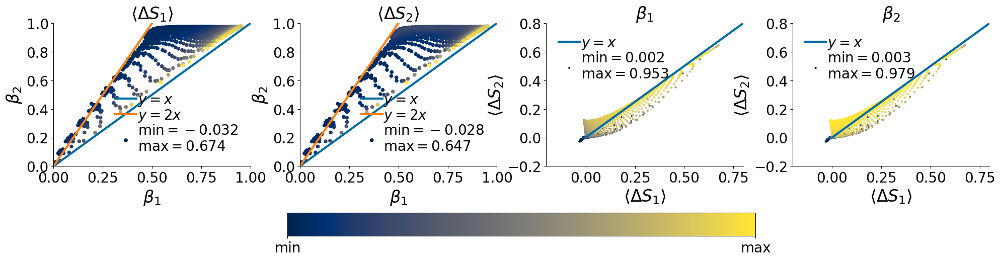

In [966]:
fig = plt.figure(figsize=(24,6))

outer = gridspec.GridSpec(nrows=2, ncols=1, height_ratios=[10]+[3], hspace=0.5, wspace=0.15) # 0.25

wspace = 0.25
hspace = 0.35

# outer = gridspec.GridSpec(nrows=1, ncols=2, width_ratios=[10]+[10], hspace=0.35, wspace=0.15) # 0.25
# HEAPS

x = []
y = []
z1 = []
z2 = []
for nu_1 in individual_data.keys():
    for nu_2 in individual_data[nu_1].keys():
        x.append(average_beta_dict[nu_1][nu_2])
        y.append(average_beta2_dict[nu_1][nu_2])
        z1.append(np.mean(individual_data[nu_1][nu_2]['weighted_diff_entropies_list']))
        z2.append(np.mean(individual_data[nu_1][nu_2]['weighted_diff_entropies_pairs_list']))

inner = gridspec.GridSpecFromSubplotSpec(1, 4,
                    subplot_spec=outer[0],wspace=wspace,hspace=hspace)
ax = plt.Subplot(fig, inner[0])
scatter_with_density(
    x = x,
    y = y,
    z = z1,
    ax = ax,
    label_scatter = fr'$\min={np.min(z1):.3f}$' + '\n' + fr'$\max={np.max(z1):.3f}$',
)
ax.set_title(fr'$\langle\Delta S_1 \rangle$')
ax.set_xlim([0,1])
ax.set_ylim([0,1])
ax.set_xlabel(r'$\beta_1$')
ax.set_ylabel(r'$\beta_2$')
xxxxx = np.array([0,1])
ax.plot(xxxxx, xxxxx, label = r'$y=x$', lw = 3, alpha = 1)
ax.plot(0.5*xxxxx, xxxxx, label = r'$y=2x$', lw = 3, alpha = 1)
ax.legend(loc='lower right', handletextpad=0.1, labelspacing = 0, handlelength = 1.5, fontsize=multiplicator*5)
fig.add_subplot(ax)

ax = plt.Subplot(fig, inner[1])
scatter_with_density(
    x = x,
    y = y,
    z = z2,
    ax = ax,
    label_scatter = fr'$\min={np.min(z2):.3f}$' + '\n' + fr'$\max={np.max(z2):.3f}$',
)
ax.set_title(fr'$\langle\Delta S_2 \rangle$')
ax.set_xlim([0,1])
ax.set_ylim([0,1])
ax.set_xlabel(r'$\beta_1$')
ax.set_ylabel(r'$\beta_2$')
xxxxx = np.array([0,1])
ax.plot(xxxxx, xxxxx, label = r'$y=x$', lw = 3, alpha = 1)
ax.plot(0.5*xxxxx, xxxxx, label = r'$y=2x$', lw = 3, alpha = 1)
ax.legend(loc='lower right', handletextpad=0.1, labelspacing = 0, handlelength = 1.5, fontsize=multiplicator*5)
fig.add_subplot(ax)



# inner = gridspec.GridSpecFromSubplotSpec(1, 2,
#                     subplot_spec=outer[1],wspace=wspace,hspace=hspace)
ax = plt.Subplot(fig, inner[2])
scatter_with_density(
    x = z1,
    y = z2,
    z = x,
    ax = ax,
    marker_size = 4,
    label_scatter = fr'$\min={np.min(x):.3f}$' + '\n' + fr'$\max={np.max(x):.3f}$',
)
ax.set_title(fr'$\beta_1$')
ax.set_xlim([-0.2, 0.8])
ax.set_ylim([-0.2, 0.8])
ax.set_xlabel(r'$\langle\Delta S_1 \rangle$')
ax.set_ylabel(r'$\langle\Delta S_2 \rangle$')
xxxxx = np.array([0,1])
ax.plot(xxxxx, xxxxx, label = r'$y=x$', lw = 3, alpha = 1)
# ax.plot(0.5*xxxxx, xxxxx, label = r'$y=2x$', lw = 3, alpha = 1)
ax.legend(loc='upper left', handletextpad=0.1, labelspacing = 0, handlelength = 1.5, fontsize=multiplicator*5)
fig.add_subplot(ax)

ax = plt.Subplot(fig, inner[3])
scatter_with_density(
    x = z1,
    y = z2,
    z = y,
    ax = ax,
    marker_size = 4,
    label_scatter = fr'$\min={np.min(y):.3f}$' + '\n' + fr'$\max={np.max(y):.3f}$',
)
ax.set_title(fr'$\beta_2$')
ax.set_xlim([-0.2, 0.8])
ax.set_ylim([-0.2, 0.8])
ax.set_xlabel(r'$\langle\Delta S_1 \rangle$')
ax.set_ylabel(r'$\langle\Delta S_2 \rangle$')
xxxxx = np.array([0,1])
ax.plot(xxxxx, xxxxx, label = r'$y=x$', lw = 3, alpha = 1)
# ax.plot(0.5*xxxxx, xxxxx, label = r'$y=2x$', lw = 3, alpha = 1)
ax.legend(loc='upper left', handletextpad=0.1, labelspacing = 0, handlelength = 1.5, fontsize=multiplicator*5)
fig.add_subplot(ax)



    ####################### COLORBAR #######################
#     inner = gridspec.GridSpecFromSubplotSpec(2, 1,
#                             subplot_spec=outer[-1],height_ratios=[1,1],hspace=0)
#     ax_cmap = plt.Subplot(fig, inner[1])
ax_cmap = plt.Subplot(fig, outer[-1])
vmin = 0
vmax = 1
cb = fig.colorbar(ScalarMappable(norm=Normalize(vmin=vmin,vmax=vmax)), ax=ax_cmap,shrink=.5,pad=0., fraction=1,orientation='horizontal')
cb.ax.get_xaxis().set_ticks([0,1]) 
cb.ax.get_xaxis().set_ticklabels(['min', 'max']) 
#     cb = fig.colorbar(ScalarMappable(norm=Normalize(vmin=vmin,vmax=vmax)), ax=ax_cmap,shrink=0.75,pad=0., fraction=1,orientation='vertical')
#     cb.ax.get_yaxis().set_ticks([0,1]) 
#     cb.ax.get_yaxis().set_ticklabels(['low density', 'high density'],rotation=90,verticalalignment='center') 
ax_cmap.axis('off')
fig.add_subplot(ax_cmap)

fig.savefig(os.path.join(figures_folder, f"Fig_entropy_nu_new_model.png"))
fig.savefig(os.path.join(figures_folder, f"Fig_entropy_nu_new_model_low_res.pdf"),dpi=100)
fig.savefig(os.path.join(figures_folder, f"Fig_entropy_nu_new_model.pdf"))

<AxesSubplot:>

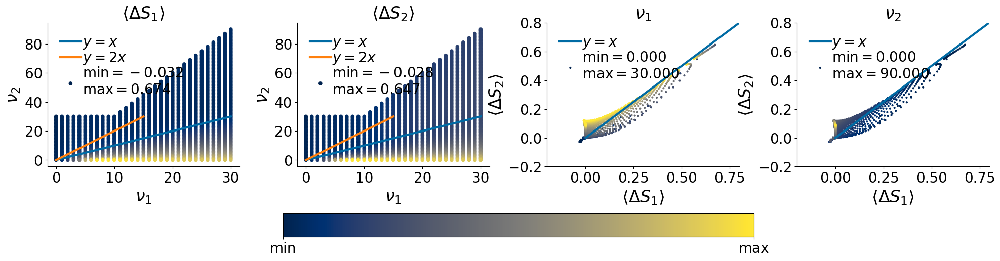

In [967]:
fig = plt.figure(figsize=(24,6))

outer = gridspec.GridSpec(nrows=2, ncols=1, height_ratios=[10]+[3], hspace=0.5, wspace=0.25) # 0.25

wspace = 0.3
hspace = 0.35

# outer = gridspec.GridSpec(nrows=1, ncols=2, width_ratios=[10]+[10], hspace=0.35, wspace=0.15) # 0.25
# HEAPS

x = []
y = []
z1 = []
z2 = []
for nu_1 in individual_data.keys():
    for nu_2 in individual_data[nu_1].keys():
        x.append(nu_1)
        y.append(nu_2)
        z1.append(np.mean(individual_data[nu_1][nu_2]['weighted_diff_entropies_list']))
        z2.append(np.mean(individual_data[nu_1][nu_2]['weighted_diff_entropies_pairs_list']))

inner = gridspec.GridSpecFromSubplotSpec(1, 4,
                    subplot_spec=outer[0],wspace=wspace,hspace=hspace)
ax = plt.Subplot(fig, inner[0])
scatter_with_density(
    x = x,
    y = y,
    z = z1,
    ax = ax,
    label_scatter = fr'$\min={np.min(z1):.3f}$' + '\n' + fr'$\max={np.max(z1):.3f}$',
)
ax.set_title(fr'$\langle\Delta S_1 \rangle$')
# ax.set_xlim([0,1])
# ax.set_ylim([0,1])
ax.set_xlabel(r'$\nu_1$')
ax.set_ylabel(r'$\nu_2$')
xxxxx = np.array([0,max(x)])
ax.plot(xxxxx, xxxxx, label = r'$y=x$', lw = 3, alpha = 1)
ax.plot(0.5*xxxxx, xxxxx, label = r'$y=2x$', lw = 3, alpha = 1)
ax.legend(loc='upper left', handletextpad=0.1, labelspacing = 0, handlelength = 1.5, fontsize=multiplicator*5)
fig.add_subplot(ax)

ax = plt.Subplot(fig, inner[1])
scatter_with_density(
    x = x,
    y = y,
    z = z2,
    ax = ax,
    label_scatter = fr'$\min={np.min(z2):.3f}$' + '\n' + fr'$\max={np.max(z2):.3f}$',
)
ax.set_title(fr'$\langle\Delta S_2 \rangle$')
# ax.set_xlim([0,1])
# ax.set_ylim([0,1])
ax.set_xlabel(r'$\nu_1$')
ax.set_ylabel(r'$\nu_2$')
xxxxx = np.array([0,max(x)])
ax.plot(xxxxx, xxxxx, label = r'$y=x$', lw = 3, alpha = 1)
ax.plot(0.5*xxxxx, xxxxx, label = r'$y=2x$', lw = 3, alpha = 1)
ax.legend(loc='upper left', handletextpad=0.1, labelspacing = 0, handlelength = 1.5, fontsize=multiplicator*5)
fig.add_subplot(ax)



# inner = gridspec.GridSpecFromSubplotSpec(1, 2,
#                     subplot_spec=outer[1],wspace=wspace,hspace=hspace)
ax = plt.Subplot(fig, inner[2])
scatter_with_density(
    x = z1,
    y = z2,
    z = x,
    ax = ax,
    marker_size = 4,
    label_scatter = fr'$\min={np.min(x):.3f}$' + '\n' + fr'$\max={np.max(x):.3f}$',
)
ax.set_title(fr'$\nu_1$')
ax.set_xlim([-0.2, 0.8])
ax.set_ylim([-0.2, 0.8])
ax.set_xlabel(r'$\langle\Delta S_1 \rangle$')
ax.set_ylabel(r'$\langle\Delta S_2 \rangle$')
xxxxx = np.array([0,1])
ax.plot(xxxxx, xxxxx, label = r'$y=x$', lw = 3, alpha = 1)
# ax.plot(0.5*xxxxx, xxxxx, label = r'$y=2x$', lw = 3, alpha = 1)
ax.legend(loc='upper left', handletextpad=0.1, labelspacing = 0, handlelength = 1.5, fontsize=multiplicator*5)
fig.add_subplot(ax)

ax = plt.Subplot(fig, inner[3])
scatter_with_density(
    x = z1,
    y = z2,
    z = y,
    ax = ax,
    marker_size = 4,
    label_scatter = fr'$\min={np.min(y):.3f}$' + '\n' + fr'$\max={np.max(y):.3f}$',
)
ax.set_title(fr'$\nu_2$')
ax.set_xlim([-0.2, 0.8])
ax.set_ylim([-0.2, 0.8])
ax.set_xlabel(r'$\langle\Delta S_1 \rangle$')
ax.set_ylabel(r'$\langle\Delta S_2 \rangle$')
xxxxx = np.array([0,1])
ax.plot(xxxxx, xxxxx, label = r'$y=x$', lw = 3, alpha = 1)
# ax.plot(0.5*xxxxx, xxxxx, label = r'$y=2x$', lw = 3, alpha = 1)
ax.legend(loc='upper left', handletextpad=0.1, labelspacing = 0, handlelength = 1.5, fontsize=multiplicator*5)
fig.add_subplot(ax)



    ####################### COLORBAR #######################
#     inner = gridspec.GridSpecFromSubplotSpec(2, 1,
#                             subplot_spec=outer[-1],height_ratios=[1,1],hspace=0)
#     ax_cmap = plt.Subplot(fig, inner[1])
ax_cmap = plt.Subplot(fig, outer[-1])
vmin = 0
vmax = 1
cb = fig.colorbar(ScalarMappable(norm=Normalize(vmin=vmin,vmax=vmax)), ax=ax_cmap,shrink=.5,pad=0., fraction=1,orientation='horizontal')
cb.ax.get_xaxis().set_ticks([0,1]) 
cb.ax.get_xaxis().set_ticklabels(['min', 'max']) 
#     cb = fig.colorbar(ScalarMappable(norm=Normalize(vmin=vmin,vmax=vmax)), ax=ax_cmap,shrink=0.75,pad=0., fraction=1,orientation='vertical')
#     cb.ax.get_yaxis().set_ticks([0,1]) 
#     cb.ax.get_yaxis().set_ticklabels(['low density', 'high density'],rotation=90,verticalalignment='center') 
ax_cmap.axis('off')
fig.add_subplot(ax_cmap)

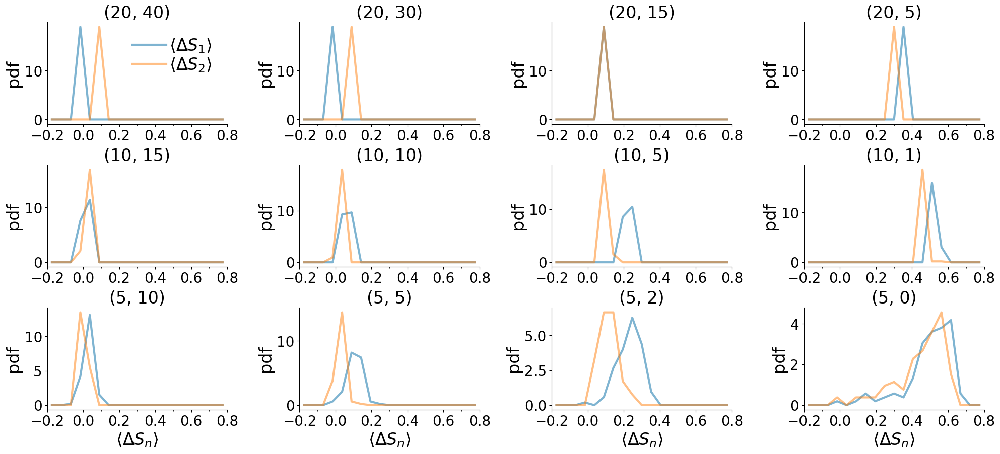

In [976]:
fig, axes = plt.subplots(nrows = 3, ncols= 4, figsize=(24,10), gridspec_kw={'wspace':0.4, 'hspace':0.4})

for i, (nu_1,nu_2) in enumerate([(20,40), (20,30), (20,15),(20,5),(10,15), (10,10), (10,5),(10,1),(5,10), (5,5), (5,2), (5,0)]):
    ax = subplot_entropy_diff_distr(individual_data[nu_1][nu_2],
                      ax = axes[int(i/4), i %4], 
                      num_bins = 20,
                      number_to_write = 0,
                      write_number = False, 
                      do_legend = i == 0,
                      xlabel = r"$\langle \Delta S_n \rangle$" if int(i/4) == 3-1 else None, 
                      ylabel = r"pdf" , 
                      xlim_left=-0.2, xlim_right=0.8, 
                     )
    ax.set_title(f'{nu_1,nu_2}')
# fig.add_subplot(ax)


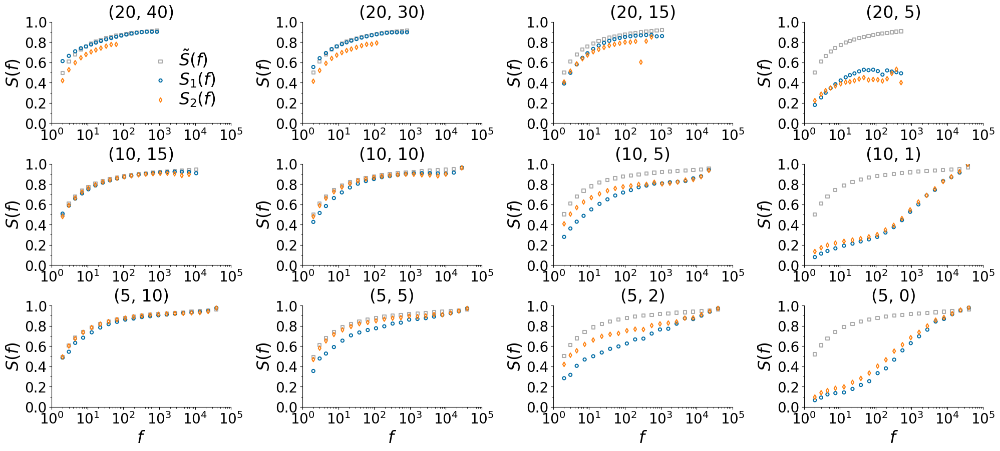

In [977]:
fig, axes = plt.subplots(nrows = 3, ncols= 4, figsize=(24,10), gridspec_kw={'wspace':0.4, 'hspace':0.4})

for i, (nu_1,nu_2) in enumerate([(20,40), (20,30), (20,15),(20,5),(10,15), (10,10), (10,5),(10,1),(5,10), (5,5), (5,2), (5,0)]):
    ax = subplot_entropy_by_freq(individual_data[nu_1][nu_2],
                      ax = axes[int(i/4), i %4], 
                      num_bins = 20,
                                 xlim_left=1,
                                 alpha = 1,
    xlim_right=1e5,
    ylim_bottom=0,
    ylim_top=1,
                      number_to_write = 0,
                      write_number = False, 
                      do_legend = i == 0,
                      xlabel = r"$f$" if int(i/4) == 3-1 else None, 
                     )
    ax.set_title(f'{nu_1,nu_2}')
# fig.add_subplot(ax)


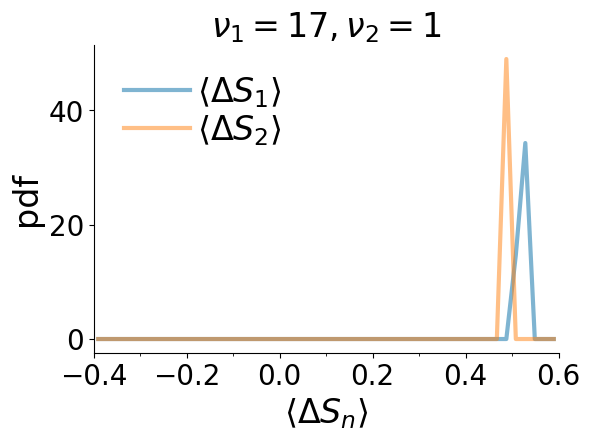

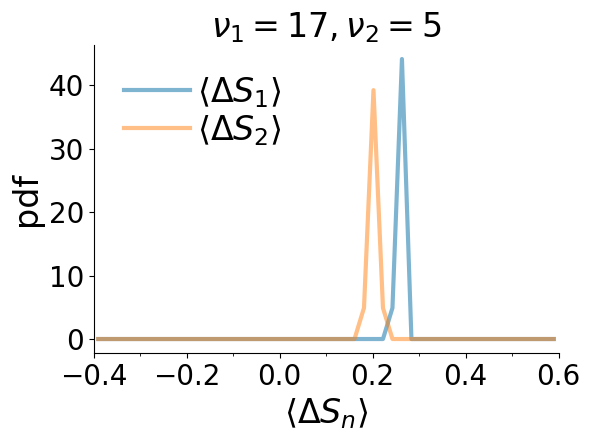

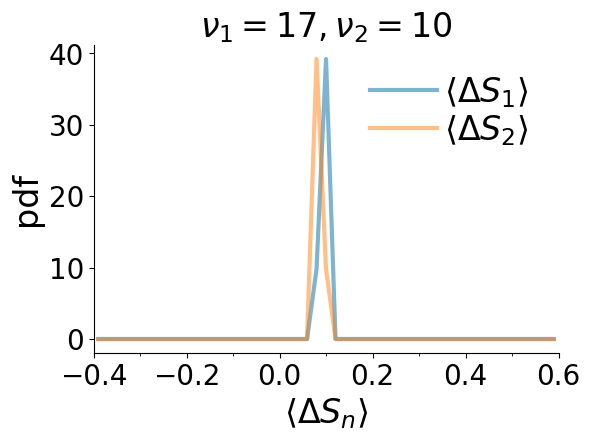

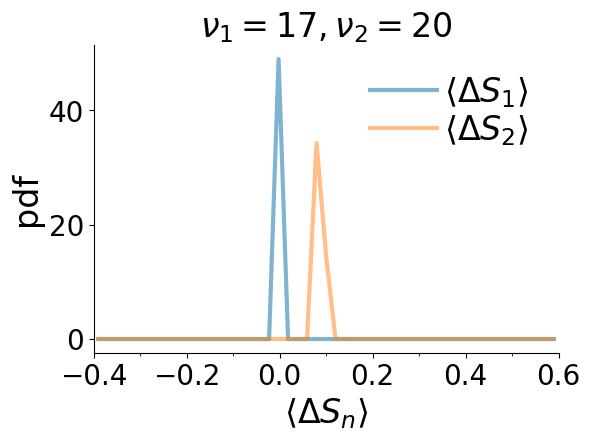

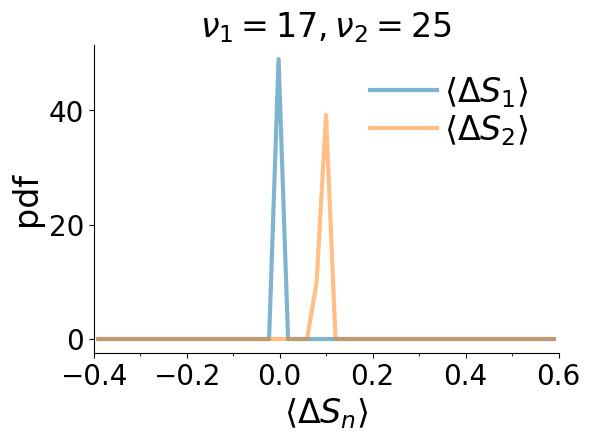

In [610]:
    
for nu_1 in [17]:
    for nu_2 in [1,5,10,20,25]:
        fig = plt.figure(figsize=(12,4))
        
        outer = gridspec.GridSpec(nrows=1, ncols=2, width_ratios=[10]+[10], hspace=0.35, wspace=0.15) # 0.25
        # HEAPS
        ax = plt.Subplot(fig, outer[0])
        
        
        max_t = 1
        max_D = 1
        
        
        
        # ENTROPY
        ax = plt.Subplot(fig, outer[1])
        
        individual_data[nu_1][nu_2]['weighted_diff_entropies'] = individual_data[nu_1][nu_2]['weighted_diff_entropies_list']
        individual_data[nu_1][nu_2]['weighted_diff_entropies_pairs'] = individual_data[nu_1][nu_2]['weighted_diff_entropies_pairs_list']
        subplot_entropy_diff_distr(individual_data[nu_1][nu_2],
                          ax = ax, 
                          num_bins = 50,
                          number_to_write = 0,
                          write_number = False, 
                          do_legend = True,
                          xlabel = r"$\langle \Delta S_n \rangle$",#,  if row == nrows-1 else None, 
                          ylabel = r"pdf" , 
                          xlim_left=-.4, xlim_right=.6, 
                         )
        ax.set_title(fr'$\nu_1={nu_1},\nu_2={nu_2}$')
        fig.add_subplot(ax)
        
    fig = plt.figure(figsize=(width_fig*ncols/3,width_fig*nrows/3))
#     outer = gridspec.GridSpec(nrows=num_datasets+1, ncols=1,height_ratios = [10]*num_datasets+[3],hspace=0.35) # 0.25
    outer = gridspec.GridSpec(nrows=2, ncols=1, height_ratios=[10*nrows]+[3], hspace=0.35, wspace=0.15) # 0.25
    
    
        wspace = 0.25
        hspace = 0.35

        inner = gridspec.GridSpecFromSubplotSpec(nrows, ncols,
                            subplot_spec=outer[0],wspace=wspace,hspace=hspace)

        # HEAPS LAW
        ax = plt.Subplot(fig, inner[0])
        for i, nu_1 in enumerate(special_nu_1_list):
            nu_2 = special_nu_2_list[i]
            dataset_label = fr'$\rho={rho}$,$\nu_1={nu_1}$,$\nu_2={nu_2}$'
            dataset_dict = individual_data[nu_1][nu_2]
            for order in ['', '2', '3', '4']:
                dataset_dict[f'beta{order}'] = dataset_dict[f'beta{order}_loglogregr_indices_geom']
                dataset_dict[f'intercept{order}'] = dataset_dict[f'intercept{order}_loglogregr_indices_geom']
            print(dataset_label)
            if use_same_x_y_max_lim == False:
                max_t = dataset_dict["ts"][-1]+1
                max_D = 1
            else:
                max_t = max(max_t,dataset_dict["ts"][-1]+1)
            for order in ['']+[str(tmp_order) for tmp_order in higher_orders]:
                max_D = max(max_D, dataset_dict[f"D{order}_indices"][-1]+1)
            xlabel_heaps_law = r"$t$"
            ylabel_heaps_law = r'$D_n(t)$'
            subplot_heaps_law(dataset_dict, 
                ax = ax, 
                marker_size = marker_size, alpha = alpha_scatter, 
                number_to_write = 0, 
                xlim_left = xlim_left_a, xlim_right = max_t, 
                ylim_bottom = ylim_bottom_a, ylim_top = max_D, 
                title = '\n'.join(dataset_label.split(' ')),
                xlabel = xlabel_heaps_law, 
                ylabel = ylabel_heaps_law, write_number = True,
            )
        fig.add_subplot(ax)


5
intercept 0.2470393833552071 slope 0.5742072434942124
p-value pearson between $\beta_1$ and $\beta_2$ 1.6366779354287707e-19


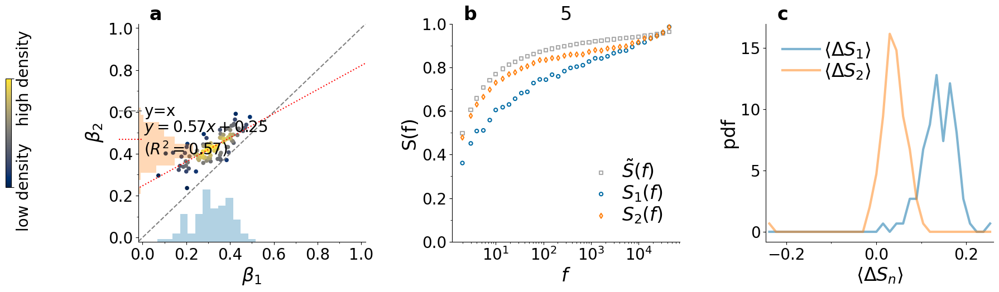

In [626]:
fig = fig_3(
    {'5':individual_data[5][4]}, marker_size = 20, alpha_scatter = 1, alpha_histogram = 0.3, color_x = CB_color_cycle[0], color_y = CB_color_cycle[1], max_hist = 0.25, 
    min_x_a = 0,
    max_x_a = 1,
    min_y_a = 0,
    max_y_a = 1,
    use_same_x_y_max_lim = False,
#     do_dashed_line = False,
#     do_dashed_line_label = False,
#     x_correlation_text = 0.63, 
#     y_correlation_text = .32,
#     num_bins = 35,
#     min_x_entropy_by_freq = None,
#     max_x_entropy_by_freq = None,
#     min_x_entropy_diff_distr = None,
#     max_x_entropy_diff_distr = None,
#     use_beta2_relative = True,
#     color_by_parameter_key = None, # if a key "mu" is given, it colors by the array "mu" (must be same length as x and y)
)

### Check beta vs t

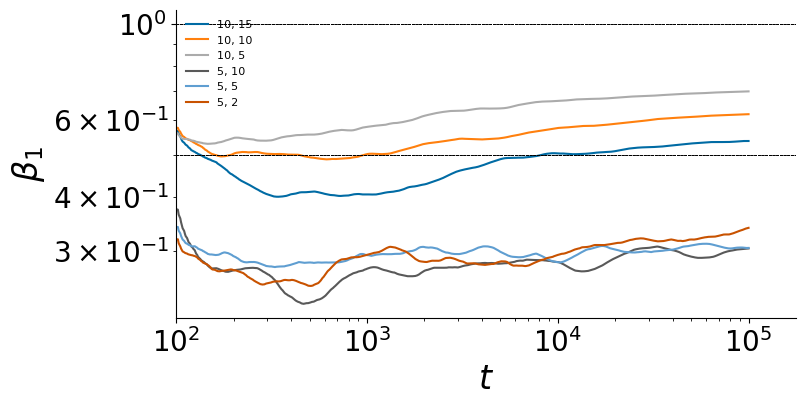

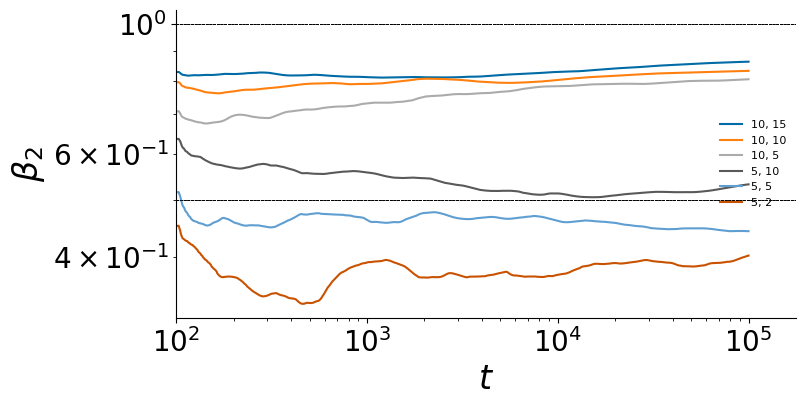

In [188]:
plt.subplots(figsize=(8,4))
for nu_1,nu_2 in [(10,15), (10,10), (10,5), (5,10), (5,5), (5,2)]:
    sim = dataset[0][nu_1][nu_2]
    plt.plot(sim['ts_geom'], sim['average_beta_loglogregr_indices_geom'], label = f"{nu_1}, {nu_2}")
    plt.xscale('log')
    plt.yscale('log')
    plt.legend(fontsize = 8)
    plt.xlabel(r'$t$')
    plt.ylabel(r'$\beta_1$')
    plt.xlim(left = 1e2)
    plt.axhline(0.5, ls = '--', color = 'black', lw = 0.5)
    plt.axhline(1, ls = '--', color = 'black', lw = 0.5)
plt.subplots(figsize=(8,4))
for nu_1,nu_2 in [(10,15), (10,10), (10,5), (5,10), (5,5), (5,2)]:
    sim = dataset[0][nu_1][nu_2]
    plt.plot(sim['ts_geom'], sim['average_beta2_loglogregr_indices_geom'], label = f"{nu_1}, {nu_2}")
    plt.xscale('log')
    plt.yscale('log')
    plt.legend(fontsize = 8)
    plt.xlabel(r'$t$')
    plt.ylabel(r'$\beta_2$')
    plt.xlim(left = 1e2)
    plt.axhline(0.5, ls = '--', color = 'black', lw = 0.5)
    plt.axhline(1, ls = '--', color = 'black', lw = 0.5)

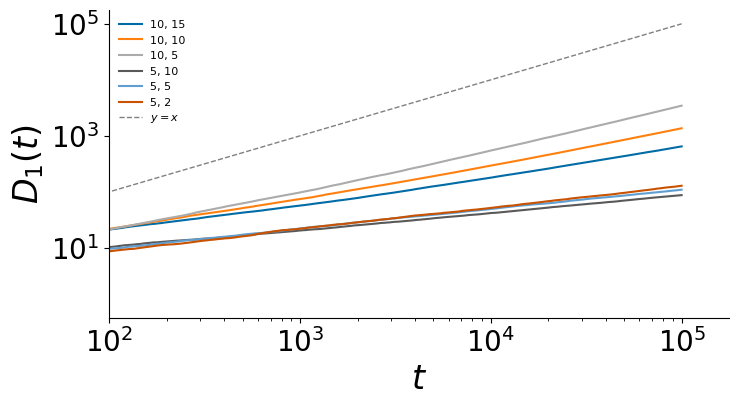

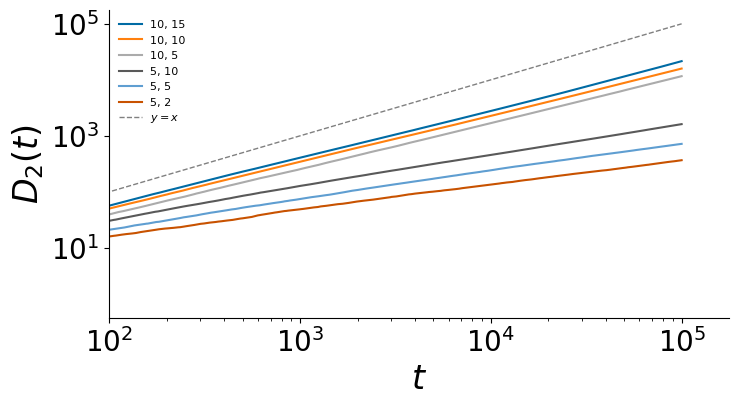

In [193]:
plt.subplots(figsize=(8,4))
for nu_1,nu_2 in [(10,15), (10,10), (10,5), (5,10), (5,5), (5,2)]:
    sim = dataset[0][nu_1][nu_2]
    plt.plot(sim['ts'], sim['average_D_indices'], label = f"{nu_1}, {nu_2}")
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$t$')
plt.ylabel(r'$D_1(t)$')
plt.xlim(left = 1e2)
plt.plot(sim['ts'], sim['ts'], ls = '--', color = 'gray', lw = 1, label = r'$y=x$')
plt.legend(fontsize = 8)
    
plt.subplots(figsize=(8,4))
for nu_1,nu_2 in [(10,15), (10,10), (10,5), (5,10), (5,5), (5,2)]:
    sim = dataset[0][nu_1][nu_2]
    plt.plot(sim['ts'], sim['average_D2_indices'], label = f"{nu_1}, {nu_2}")
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$t$')
plt.ylabel(r'$D_2(t)$')
plt.xlim(left = 1e2)
plt.plot(sim['ts'], sim['ts'], ls = '--', color = 'gray', lw = 1, label = r'$y=x$')
plt.legend(fontsize = 8)


## Other versions new model

In [49]:
def get_average_data_new_pairs_UMT(
    rho, 
    starting_nu_1, ending_nu_1,
    starting_nu_2, ending_nu_2,
    fraction_nu_2_cut = 2,
    N_0 = 2, 
    M_0 = 2, 
    Tmax = int(1e4),
    do_fig = True,
    t_to_use = 1e5,
    num_to_save = 1000,
    do_non_overlapping_simulation = False,
    trigger_pairs_with_reinforcement = False,
    triggering_pairs_among_all_non_explored_pairs = False,
    look_among_all_non_explored_pairs_if_not_enough = False,
    trigger_links_with_new_colors_if_not_enough = False,
    trigger_links_between_new_colors_if_not_enough = False,
    color_by_key = None,
    directed = True,
):
    count = 0
    
    index_to_use = get_index_in_indices_geom_closest_t(
        t_to_use = t_to_use,
        Tmax = Tmax,
        num_to_save = num_to_save,
    )
    
    average_beta_dict = {}
    average_beta2_dict = {}
    average_beta = {}
    average_beta2 = {}
    average_beta_inverse = {}
    average_beta2_inverse = {}
    
    main_dir = f"./data/"
    main_dir += 'pairs_UMT/'
    if directed:
        main_dir += 'directed/'
    if do_non_overlapping_simulation:
        main_dir += 'do_non_overlapping_simulation/'
    
    if trigger_pairs_with_reinforcement:
        main_dir += 'trigger_pairs_with_reinforcement/'

    if triggering_pairs_among_all_non_explored_pairs:
        main_dir += 'triggering_pairs_among_all_non_explored_pairs/'
    elif look_among_all_non_explored_pairs_if_not_enough:
        main_dir += 'look_among_all_non_explored_pairs_if_not_enough/'
    if trigger_links_with_new_colors_if_not_enough:
        main_dir += 'trigger_links_with_new_colors_if_not_enough/'
    if trigger_links_between_new_colors_if_not_enough:
        main_dir += 'trigger_links_between_new_colors_if_not_enough/'
        

    num_runs = 100
    for nu_1 in tqdm(range(starting_nu_1, ending_nu_1 + 1)):
        if starting_nu_2 is None:
            starting_nu_2_tmp = 0 # nu_1
        else:
            starting_nu_2_tmp = starting_nu_2
        if ending_nu_2 is None:
            ending_nu_2_tmp = fraction_nu_2_cut*nu_1
        else:
            ending_nu_2_tmp = ending_nu_2
        
        average_beta_dict[nu_1] = {}
        average_beta2_dict[nu_1] = {}
        average_beta[nu_1] = []
        average_beta2[nu_1] = []
        
        for nu_2 in tqdm(range(starting_nu_2_tmp, ending_nu_2_tmp + 1)):
            analysis_folder = data_folder = work_dir = os.path.join(main_dir, f"simulations/analysis/rho_{rho:.5f}/nu_1{nu_1}/nu_2{nu_2}/Tmax_{Tmax}/N_0_{N_0}/M_0_{M_0}/")
            try:
#             if True:
                path = os.path.join(analysis_folder,f'average_light_results.pkl')
                with open(path, 'rb') as fp:
                    average_result = joblib.load(fp)
                count += len(average_result[f'beta_loglogregr_indices_geom_list_finals'])
                average_beta_dict[nu_1][nu_2]  = np.mean(average_result[f'beta_loglogregr_indices_geom_list_finals'])
                average_beta2_dict[nu_1][nu_2]  = np.mean(average_result[f'beta2_loglogregr_indices_geom_list_finals'])
                average_beta[nu_1].append(np.mean(average_result[f'beta_loglogregr_indices_geom_list_finals']))
                average_beta2[nu_1].append(np.mean(average_result[f'beta2_loglogregr_indices_geom_list_finals']))
                try:
                    average_beta_inverse[nu_2].append(np.mean(average_result[f'beta_loglogregr_indices_geom_list_finals']))
                    average_beta2_inverse[nu_2].append(np.mean(average_result[f'beta2_loglogregr_indices_geom_list_finals']))
                except:
                    average_beta_inverse[nu_2] = [np.mean(average_result[f'beta_loglogregr_indices_geom_list_finals'])]
                    average_beta2_inverse[nu_2] = [np.mean(average_result[f'beta2_loglogregr_indices_geom_list_finals'])]
            except:
                pass
    print('FOUND ',count, sep = "\t")
    if count > 0 and do_fig == True:
        fig,ax = plt.subplots(figsize=(8,8))
        plot_average_beta_1_beta2_by_two_parameters(
            average_beta,
            average_beta2,
            ax = ax,
            fig = fig,
        )
        ax.plot([0, 1], [0,1])
        ax.plot([0, 0.5], [0,1])
        ax.set_title('each line is a nu_1')
        fig.add_subplot(ax)
        
        
        fig,ax = plt.subplots(figsize=(8,8))
        plot_average_beta_1_beta2_by_two_parameters(
            average_beta_inverse,
            average_beta2_inverse,
            ax = ax,
            fig = fig,
        )
        ax.plot([0, 1], [0,1])
        ax.plot([0, 0.5], [0,1])
        ax.set_title('each line is a nu_2')
        fig.add_subplot(ax)
        
        
    return average_beta_dict, average_beta2_dict, average_beta, average_beta2, average_beta_inverse, average_beta2_inverse


### Best choice rules

#### 1e4

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/13 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

  0%|          | 0/17 [00:00<?, ?it/s]

  0%|          | 0/19 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

FOUND 	12100
intercept 0.11334498343339508 slope 1.1329403544410643
p-value pearson between $\beta_1$ and $\beta_2$ 0.0


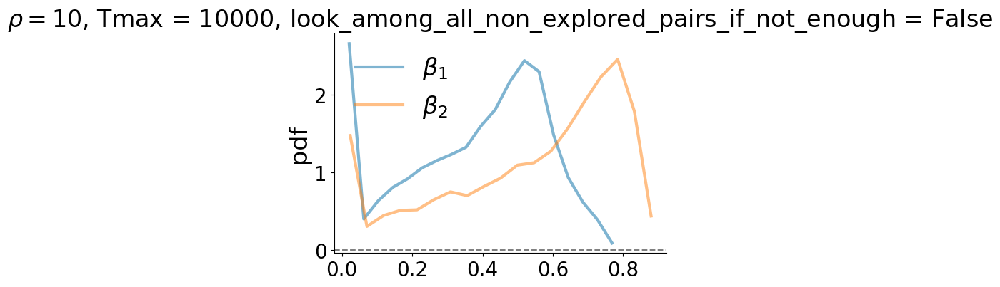

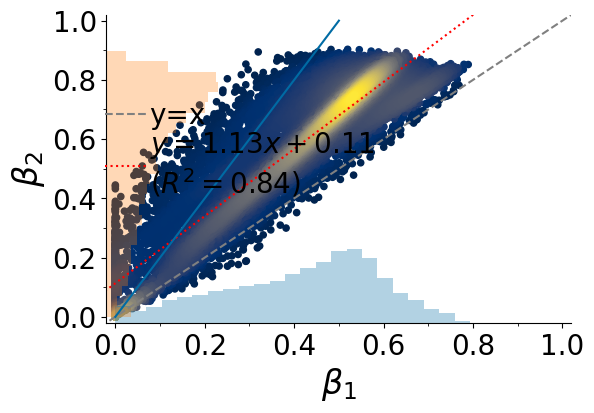

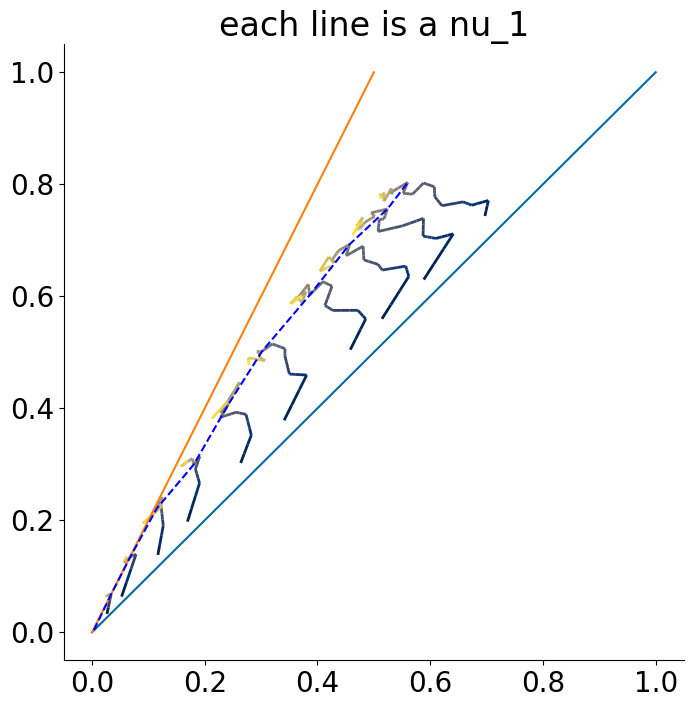

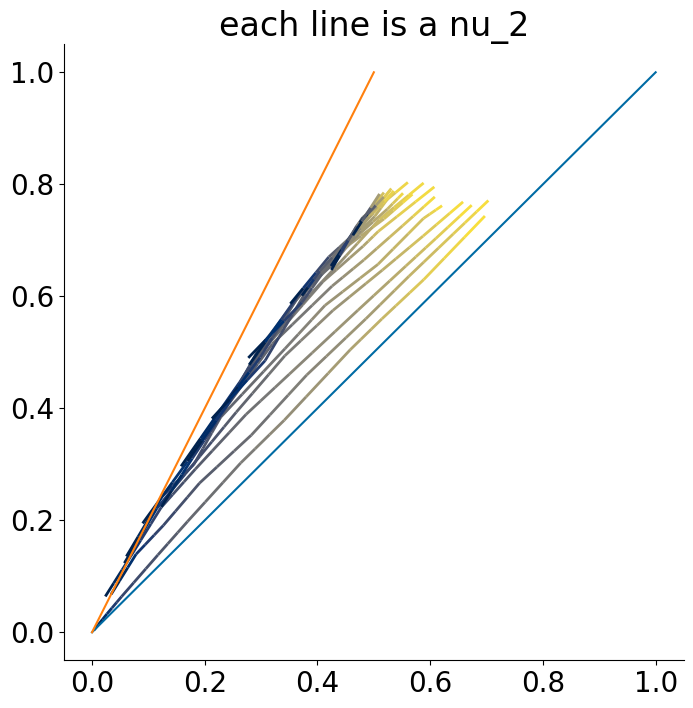

In [395]:
directed = False
do_non_overlapping_simulation = False
look_among_all_non_explored_pairs_if_not_enough = False
trigger_links_with_new_colors_if_not_enough = False
trigger_links_between_new_colors_if_not_enough = False
Tmax = int(1e4)
dataset = get_data_new_pairs_UMT(
    rho = 10, 
    starting_nu_1 = 0, ending_nu_1 = 10,
    starting_nu_2 = 0, ending_nu_2 = None,
    fraction_nu_2_cut = 2,
    N_0 = 1, 
    M_0 = 0, 
    Tmax = Tmax,
    do_fig = True,
    t_to_use = Tmax,
    num_to_save = 1000,
    do_non_overlapping_simulation = do_non_overlapping_simulation,
    look_among_all_non_explored_pairs_if_not_enough = look_among_all_non_explored_pairs_if_not_enough,
    trigger_links_with_new_colors_if_not_enough = trigger_links_with_new_colors_if_not_enough, 
    trigger_links_between_new_colors_if_not_enough = trigger_links_between_new_colors_if_not_enough, 
    color_by_key = None,
    directed = directed,
)
new_pairs_UMT[(do_non_overlapping_simulation, look_among_all_non_explored_pairs_if_not_enough, trigger_links_with_new_colors_if_not_enough, trigger_links_between_new_colors_if_not_enough,Tmax)] = dataset

In [396]:
dataset[0][10][15]['average_D2_indices'][-1]

1723.32

In [397]:
dataset[0][10][15]['average_counter_times_not_enough_with_extracted']

1029.03

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/13 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

  0%|          | 0/17 [00:00<?, ?it/s]

  0%|          | 0/19 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

FOUND 	12100
intercept 0.14354139510447217 slope 1.0573916006592423
p-value pearson between $\beta_1$ and $\beta_2$ 0.0


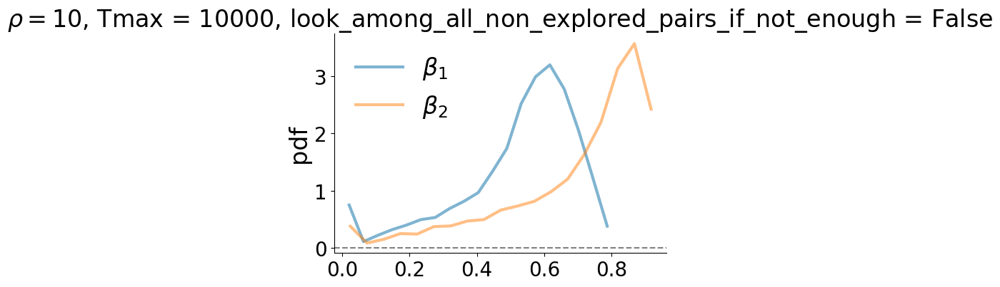

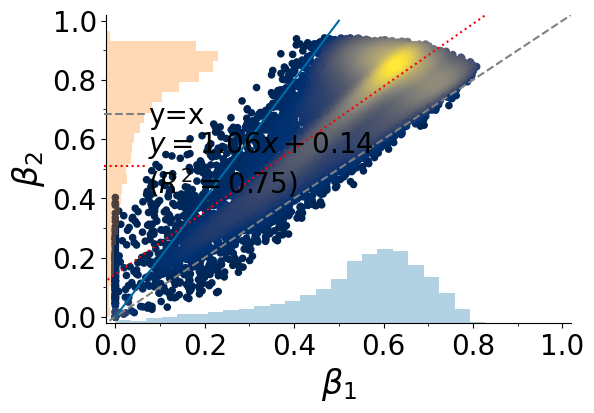

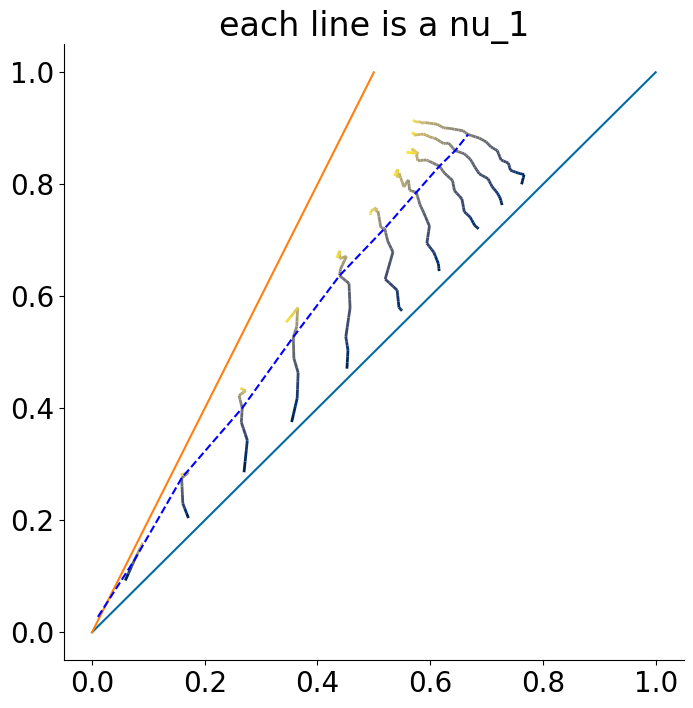

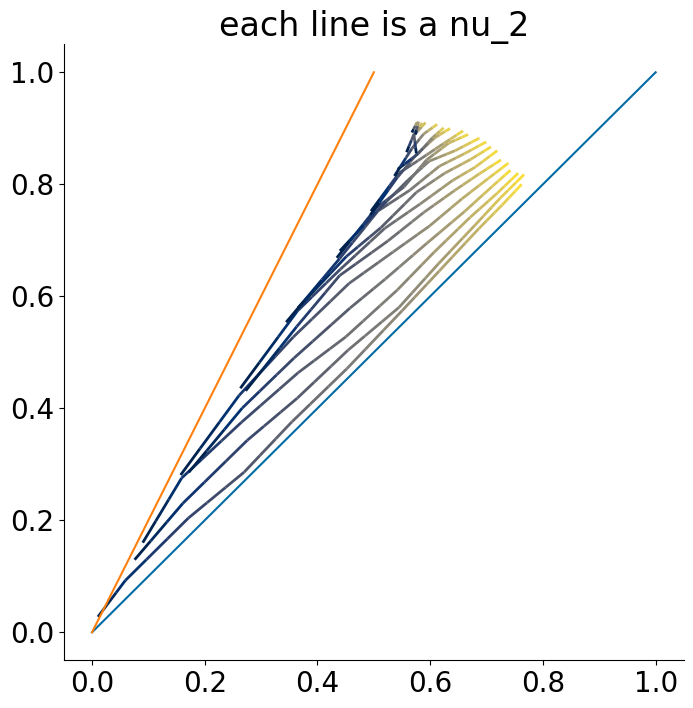

In [398]:
directed = False
do_non_overlapping_simulation = True
look_among_all_non_explored_pairs_if_not_enough = False
trigger_links_with_new_colors_if_not_enough = False
trigger_links_between_new_colors_if_not_enough = False
Tmax = int(1e4)
dataset = get_data_new_pairs_UMT(
    rho = 10, 
    starting_nu_1 = 0, ending_nu_1 = 10,
    starting_nu_2 = 0, ending_nu_2 = None,
    fraction_nu_2_cut = 2,
    N_0 = 1, 
    M_0 = 0, 
    Tmax = Tmax,
    do_fig = True,
    t_to_use = Tmax,
    num_to_save = 1000,
    do_non_overlapping_simulation = do_non_overlapping_simulation,
    look_among_all_non_explored_pairs_if_not_enough = look_among_all_non_explored_pairs_if_not_enough,
    trigger_links_with_new_colors_if_not_enough = trigger_links_with_new_colors_if_not_enough, 
    trigger_links_between_new_colors_if_not_enough = trigger_links_between_new_colors_if_not_enough, 
    color_by_key = None,
    directed = directed,
)
new_pairs_UMT[(do_non_overlapping_simulation, look_among_all_non_explored_pairs_if_not_enough, trigger_links_with_new_colors_if_not_enough, trigger_links_between_new_colors_if_not_enough,Tmax)] = dataset

In [399]:
dataset[0][10][15]['average_D2_indices'][-1]

4702.78

In [400]:
dataset[0][10][15]['average_counter_times_not_enough_with_extracted']

635.98

##### Look among extracted colors if not enough

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/13 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

  0%|          | 0/17 [00:00<?, ?it/s]

  0%|          | 0/19 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

FOUND 	12100
intercept 0.12034140937117296 slope 1.1327887303986364
p-value pearson between $\beta_1$ and $\beta_2$ 0.0


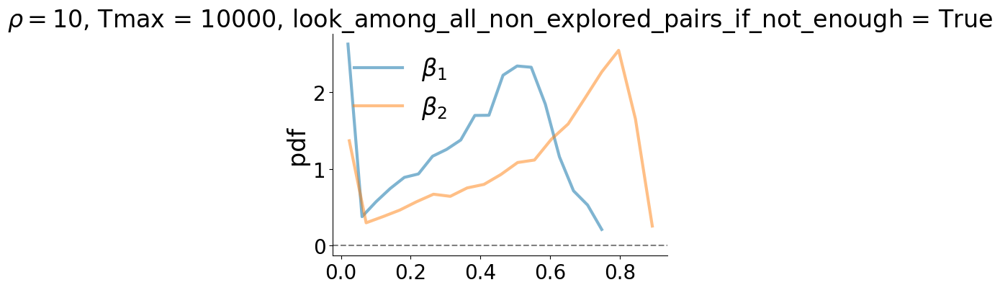

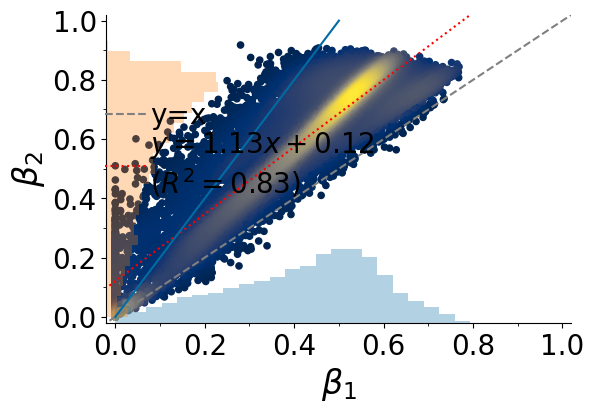

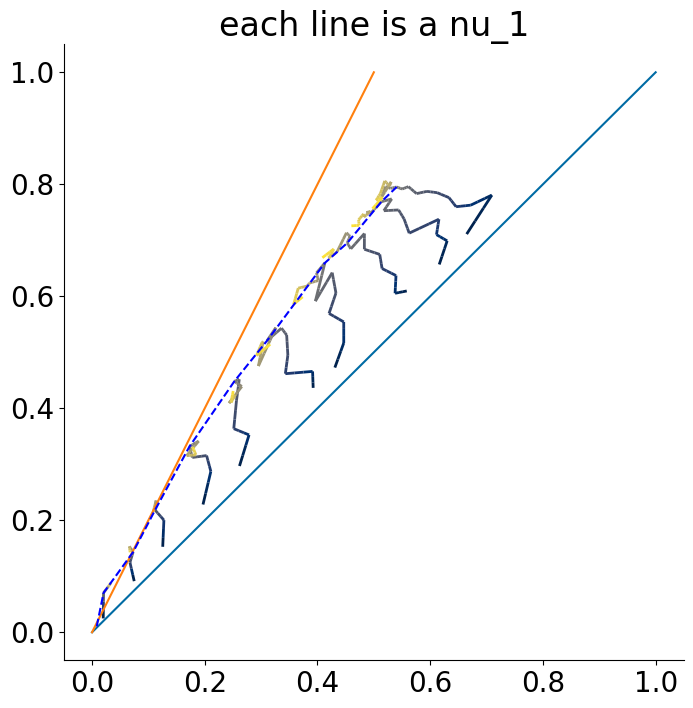

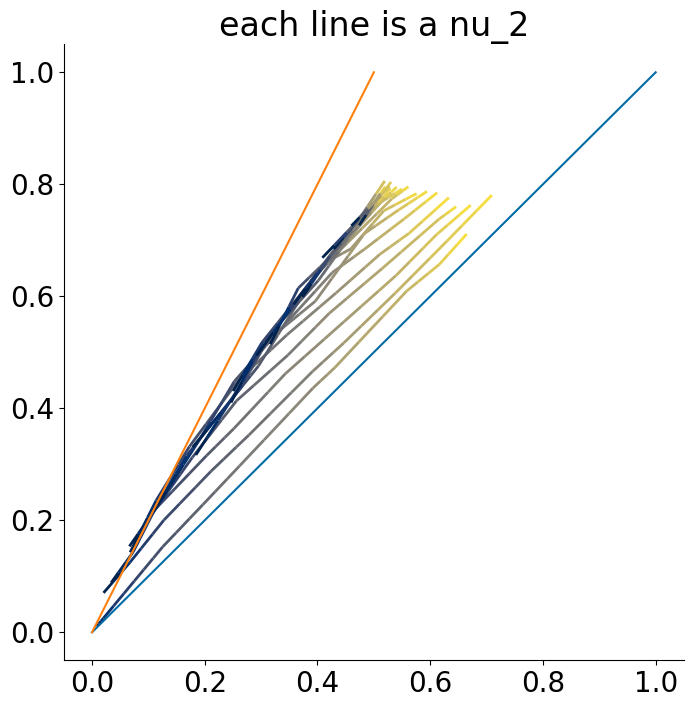

In [387]:
directed = False
do_non_overlapping_simulation = False
look_among_all_non_explored_pairs_if_not_enough = True
trigger_links_with_new_colors_if_not_enough = False
trigger_links_between_new_colors_if_not_enough = False
Tmax = int(1e4)
dataset = get_data_new_pairs_UMT(
    rho = 10, 
    starting_nu_1 = 0, ending_nu_1 = 10,
    starting_nu_2 = 0, ending_nu_2 = None,
    fraction_nu_2_cut = 2,
    N_0 = 1, 
    M_0 = 0, 
    Tmax = Tmax,
    do_fig = True,
    t_to_use = Tmax,
    num_to_save = 1000,
    do_non_overlapping_simulation = do_non_overlapping_simulation,
    look_among_all_non_explored_pairs_if_not_enough = look_among_all_non_explored_pairs_if_not_enough,
    trigger_links_with_new_colors_if_not_enough = trigger_links_with_new_colors_if_not_enough, 
    trigger_links_between_new_colors_if_not_enough = trigger_links_between_new_colors_if_not_enough, 
    color_by_key = None,
    directed = directed,
)
new_pairs_UMT[(do_non_overlapping_simulation, look_among_all_non_explored_pairs_if_not_enough, trigger_links_with_new_colors_if_not_enough, trigger_links_between_new_colors_if_not_enough,Tmax)] = dataset

In [388]:
dataset[0][10][15]['average_D2_indices'][-1]

1988.77

In [389]:
dataset[0][10][15]['average_counter_times_not_enough_with_extracted']

1762.34

In [390]:
dataset[0][10][15]['average_counter_times_not_enough_among_extracted']

765.16

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/13 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

  0%|          | 0/17 [00:00<?, ?it/s]

  0%|          | 0/19 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

FOUND 	12100
intercept 0.1629209690125853 slope 1.044039104586779
p-value pearson between $\beta_1$ and $\beta_2$ 0.0


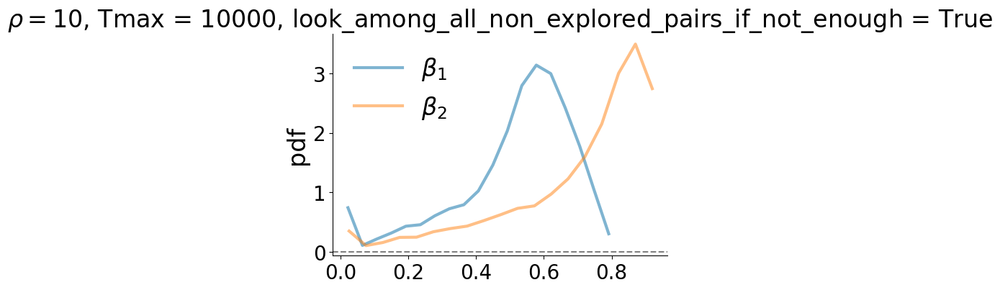

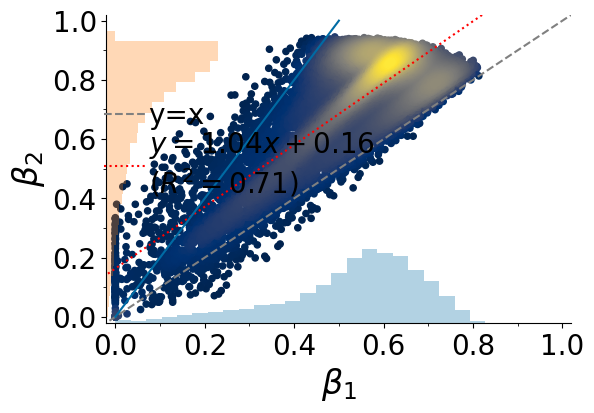

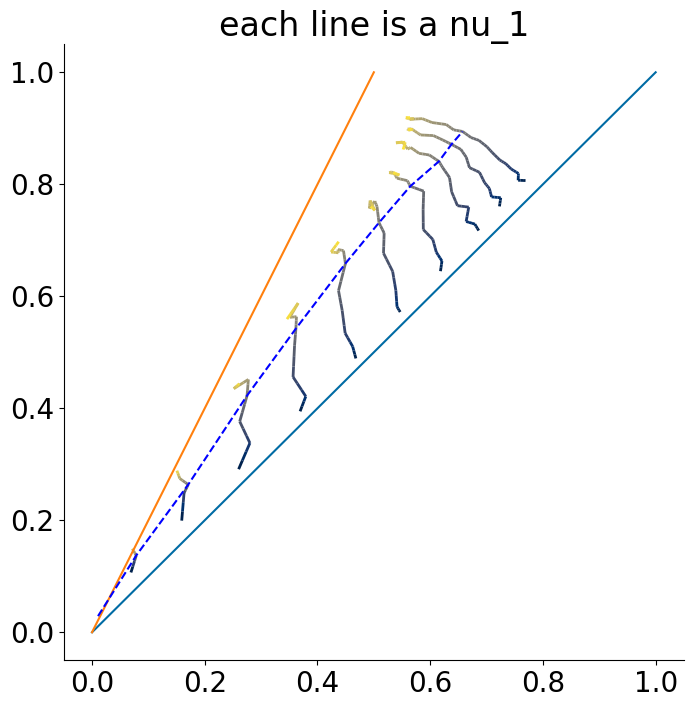

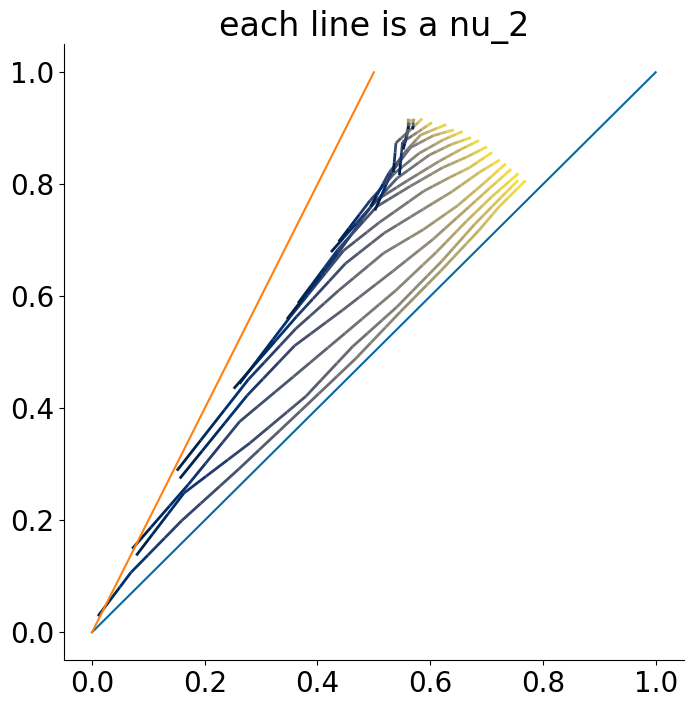

In [391]:
directed = False
do_non_overlapping_simulation = True
look_among_all_non_explored_pairs_if_not_enough = True
trigger_links_with_new_colors_if_not_enough = False
trigger_links_between_new_colors_if_not_enough = False
Tmax = int(1e4)
dataset = get_data_new_pairs_UMT(
    rho = 10, 
    starting_nu_1 = 0, ending_nu_1 = 10,
    starting_nu_2 = 0, ending_nu_2 = None,
    fraction_nu_2_cut = 2,
    N_0 = 1, 
    M_0 = 0, 
    Tmax = Tmax,
    do_fig = True,
    t_to_use = Tmax,
    num_to_save = 1000,
    do_non_overlapping_simulation = do_non_overlapping_simulation,
    look_among_all_non_explored_pairs_if_not_enough = look_among_all_non_explored_pairs_if_not_enough,
    trigger_links_with_new_colors_if_not_enough = trigger_links_with_new_colors_if_not_enough, 
    trigger_links_between_new_colors_if_not_enough = trigger_links_between_new_colors_if_not_enough, 
    color_by_key = None,
    directed = directed,
)
new_pairs_UMT[(do_non_overlapping_simulation, look_among_all_non_explored_pairs_if_not_enough, trigger_links_with_new_colors_if_not_enough, trigger_links_between_new_colors_if_not_enough,Tmax)] = dataset

In [392]:
dataset[0][10][15]['average_D2_indices'][-1]

4957.21

In [393]:
dataset[0][10][15]['average_counter_times_not_enough_with_extracted']

2789.68

In [394]:
dataset[0][10][15]['average_counter_times_not_enough_among_extracted']

211.39

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/13 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

  0%|          | 0/17 [00:00<?, ?it/s]

  0%|          | 0/19 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

FOUND 	12100
intercept 0.12072991005596045 slope 1.0027523442117476
p-value pearson between $\beta_1$ and $\beta_2$ 0.0


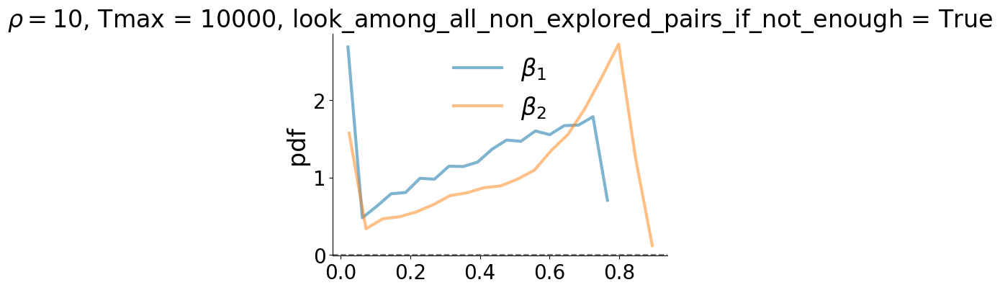

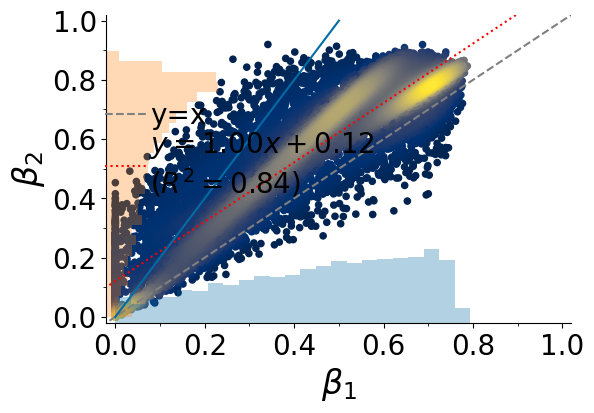

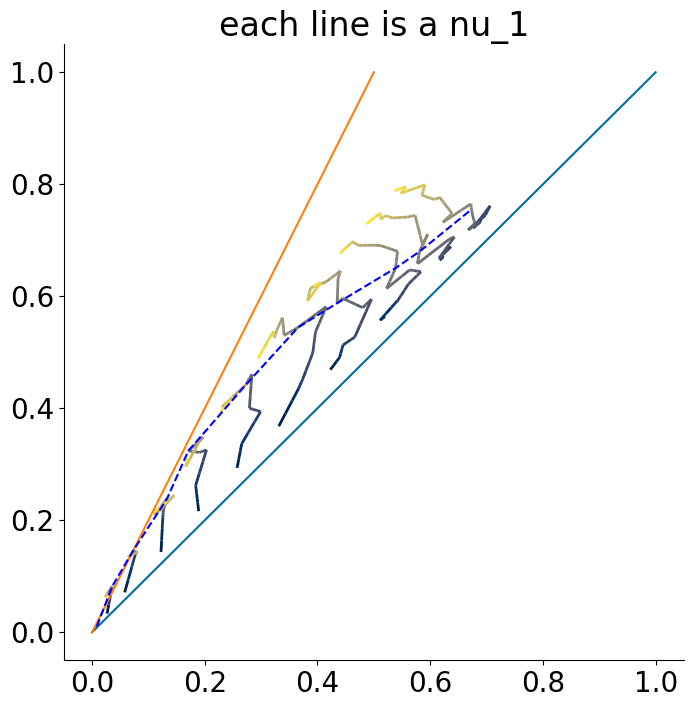

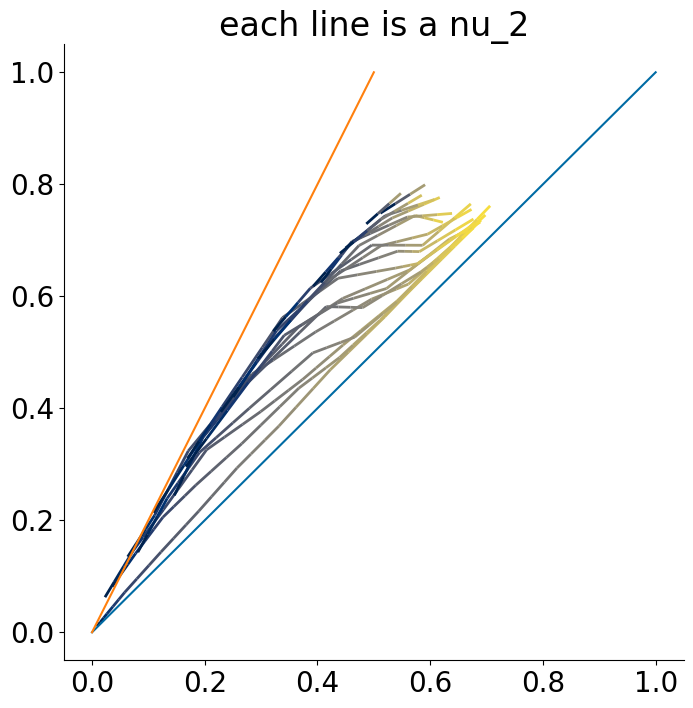

In [348]:
directed = False
do_non_overlapping_simulation = False
triggering_pairs_among_all_non_explored_pairs = True
look_among_all_non_explored_pairs_if_not_enough = True
trigger_links_with_new_colors_if_not_enough = False
trigger_links_between_new_colors_if_not_enough = False
Tmax = int(1e4)
dataset = get_data_new_pairs_UMT(
    rho = 10, 
    starting_nu_1 = 0, ending_nu_1 = 10,
    starting_nu_2 = 0, ending_nu_2 = None,
    fraction_nu_2_cut = 2,
    N_0 = 1, 
    M_0 = 0, 
    Tmax = Tmax,
    do_fig = True,
    t_to_use = Tmax,
    num_to_save = 1000,
    do_non_overlapping_simulation = do_non_overlapping_simulation,
    triggering_pairs_among_all_non_explored_pairs = triggering_pairs_among_all_non_explored_pairs,
    look_among_all_non_explored_pairs_if_not_enough = look_among_all_non_explored_pairs_if_not_enough,
    trigger_links_with_new_colors_if_not_enough = trigger_links_with_new_colors_if_not_enough, 
    trigger_links_between_new_colors_if_not_enough = trigger_links_between_new_colors_if_not_enough, 
    color_by_key = None,
    directed = directed,
)
new_pairs_UMT[(do_non_overlapping_simulation, triggering_pairs_among_all_non_explored_pairs, look_among_all_non_explored_pairs_if_not_enough, trigger_links_with_new_colors_if_not_enough, trigger_links_between_new_colors_if_not_enough,Tmax)] = dataset

In [349]:
dataset[0][10][15]['average_D2_indices'][-1]

2075.15

In [350]:
dataset[0][10][15]['average_counter_times_not_enough_with_extracted']

2075.15

In [351]:
dataset[0][10][15]['average_counter_times_not_enough_among_extracted']

341.79

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/13 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

  0%|          | 0/17 [00:00<?, ?it/s]

  0%|          | 0/19 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

FOUND 	12100
intercept 0.16674297405694186 slope 1.037443922502475
p-value pearson between $\beta_1$ and $\beta_2$ 0.0


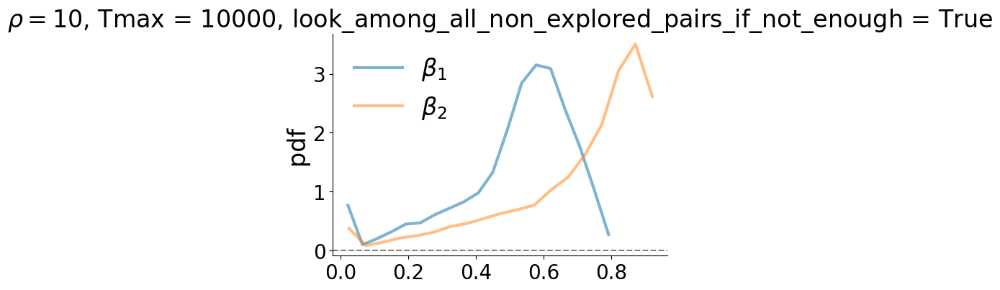

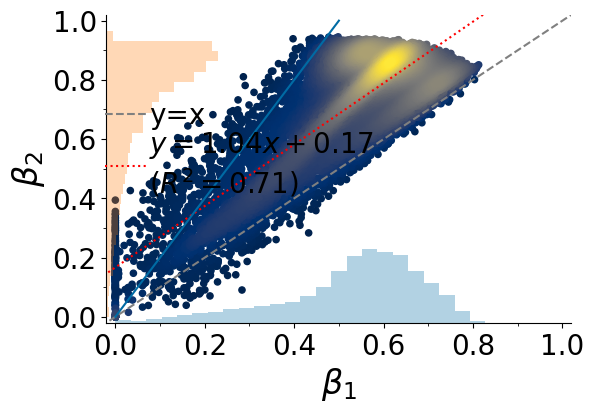

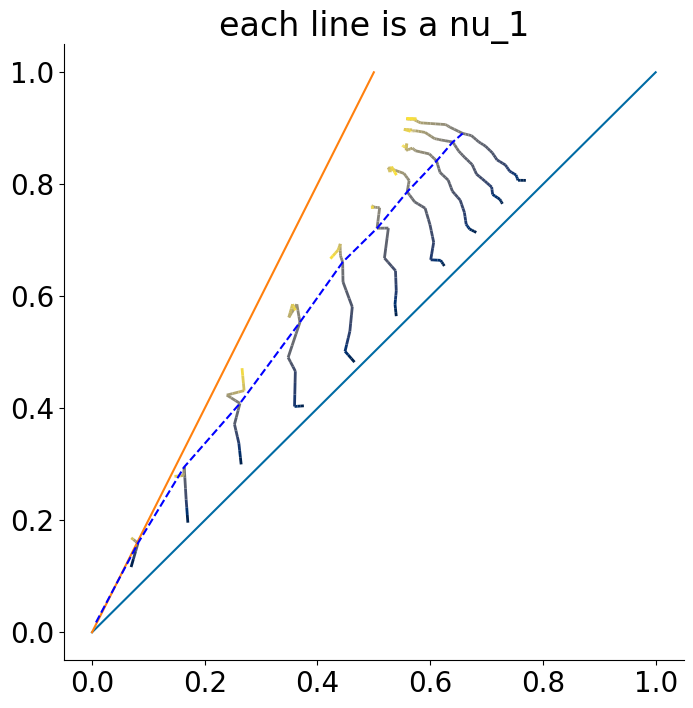

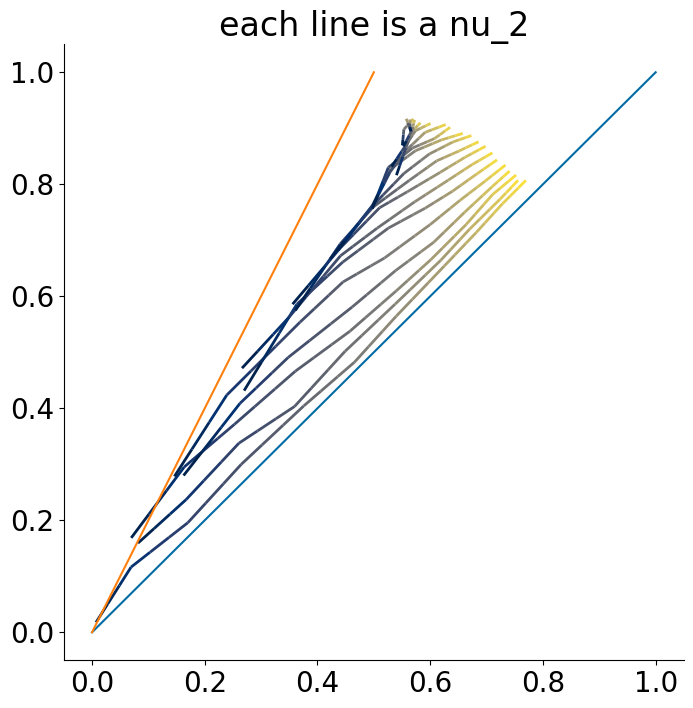

In [352]:
directed = False
do_non_overlapping_simulation = True
triggering_pairs_among_all_non_explored_pairs = True
look_among_all_non_explored_pairs_if_not_enough = True
trigger_links_with_new_colors_if_not_enough = False
trigger_links_between_new_colors_if_not_enough = False
Tmax = int(1e4)
dataset = get_data_new_pairs_UMT(
    rho = 10, 
    starting_nu_1 = 0, ending_nu_1 = 10,
    starting_nu_2 = 0, ending_nu_2 = None,
    fraction_nu_2_cut = 2,
    N_0 = 1, 
    M_0 = 0, 
    Tmax = Tmax,
    do_fig = True,
    t_to_use = Tmax,
    num_to_save = 1000,
    do_non_overlapping_simulation = do_non_overlapping_simulation,
    triggering_pairs_among_all_non_explored_pairs = triggering_pairs_among_all_non_explored_pairs,
    look_among_all_non_explored_pairs_if_not_enough = look_among_all_non_explored_pairs_if_not_enough,
    trigger_links_with_new_colors_if_not_enough = trigger_links_with_new_colors_if_not_enough, 
    trigger_links_between_new_colors_if_not_enough = trigger_links_between_new_colors_if_not_enough, 
    color_by_key = None,
    directed = directed,
)
new_pairs_UMT[(do_non_overlapping_simulation, triggering_pairs_among_all_non_explored_pairs, look_among_all_non_explored_pairs_if_not_enough, trigger_links_with_new_colors_if_not_enough, trigger_links_between_new_colors_if_not_enough,Tmax)] = dataset

In [353]:
dataset[0][10][15]['average_D2_indices'][-1]

4899.14

In [354]:
dataset[0][10][15]['average_counter_times_not_enough_with_extracted']

4899.14

In [355]:
dataset[0][10][15]['average_counter_times_not_enough_among_extracted']

196.93

##### add with new colors if not enough

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/13 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

  0%|          | 0/17 [00:00<?, ?it/s]

  0%|          | 0/19 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

FOUND 	12100
intercept 0.18427371491792133 slope 1.1615310252269568
p-value pearson between $\beta_1$ and $\beta_2$ 0.0


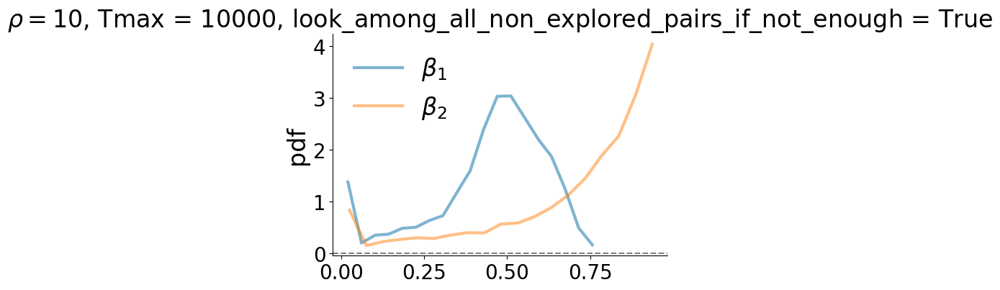

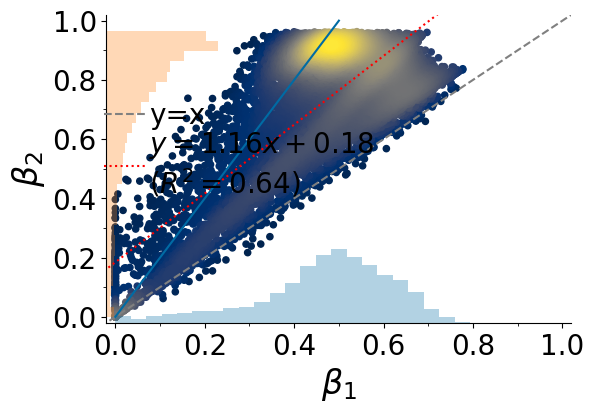

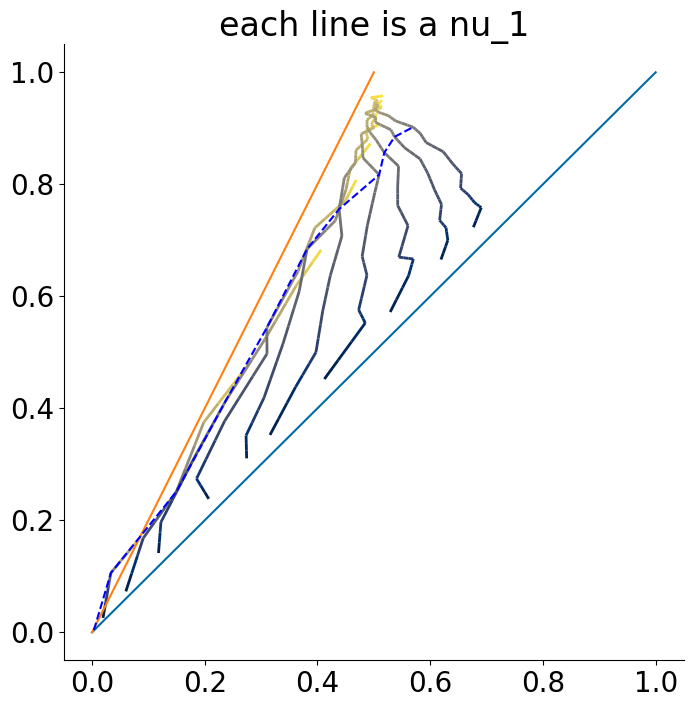

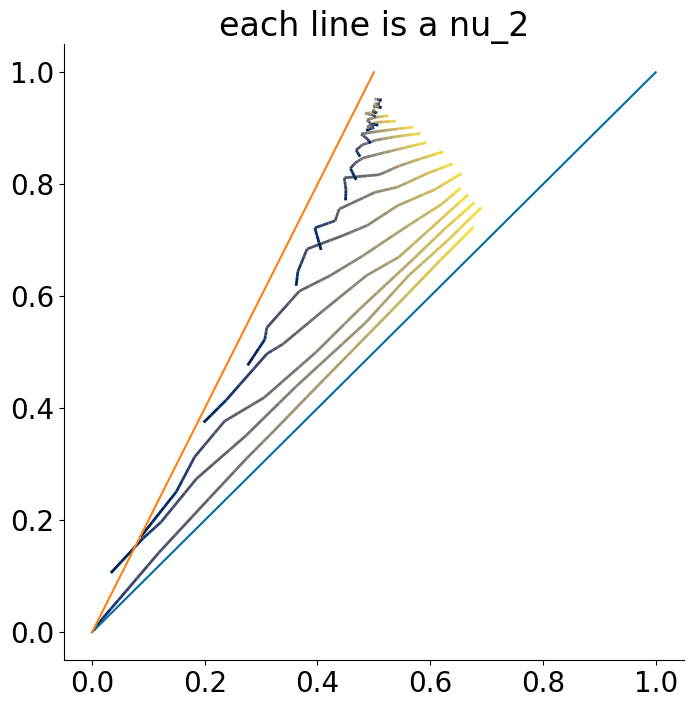

In [379]:
directed = False
do_non_overlapping_simulation = False
look_among_all_non_explored_pairs_if_not_enough = True
trigger_links_with_new_colors_if_not_enough = True
trigger_links_between_new_colors_if_not_enough = True
Tmax = int(1e4)
dataset = get_data_new_pairs_UMT(
    rho = 10, 
    starting_nu_1 = 0, ending_nu_1 = 10,
    starting_nu_2 = 0, ending_nu_2 = None,
    fraction_nu_2_cut = 2,
    N_0 = 1, 
    M_0 = 0, 
    Tmax = Tmax,
    do_fig = True,
    t_to_use = Tmax,
    num_to_save = 1000,
    do_non_overlapping_simulation = do_non_overlapping_simulation,
    look_among_all_non_explored_pairs_if_not_enough = look_among_all_non_explored_pairs_if_not_enough,
    trigger_links_with_new_colors_if_not_enough = trigger_links_with_new_colors_if_not_enough, 
    trigger_links_between_new_colors_if_not_enough = trigger_links_between_new_colors_if_not_enough, 
    color_by_key = None,
    directed = directed,
)
new_pairs_UMT[(do_non_overlapping_simulation, look_among_all_non_explored_pairs_if_not_enough, trigger_links_with_new_colors_if_not_enough, trigger_links_between_new_colors_if_not_enough,Tmax)] = dataset

In [380]:
dataset[0][10][15]['average_D2_indices'][-1]

5893.74

In [381]:
dataset[0][10][15]['average_counter_times_not_enough_with_extracted']

2301.79

In [382]:
dataset[0][10][15]['average_counter_times_not_enough_among_extracted']

314.26

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/13 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

  0%|          | 0/17 [00:00<?, ?it/s]

  0%|          | 0/19 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/23 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/27 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/31 [00:00<?, ?it/s]

  0%|          | 0/33 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/37 [00:00<?, ?it/s]

  0%|          | 0/39 [00:00<?, ?it/s]

  0%|          | 0/41 [00:00<?, ?it/s]

FOUND 	12100
intercept 0.31509857690704834 slope 0.8537224147252215
p-value pearson between $\beta_1$ and $\beta_2$ 0.0


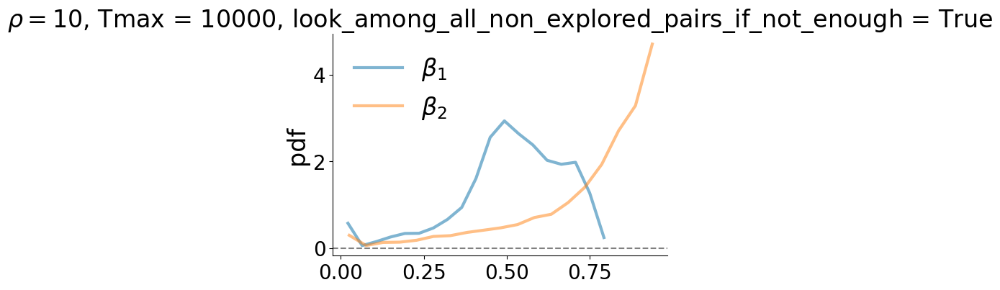

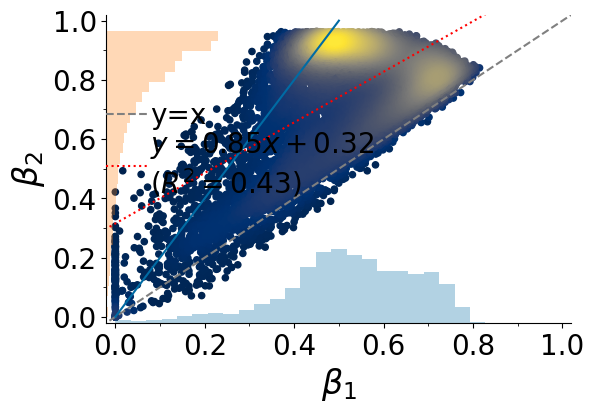

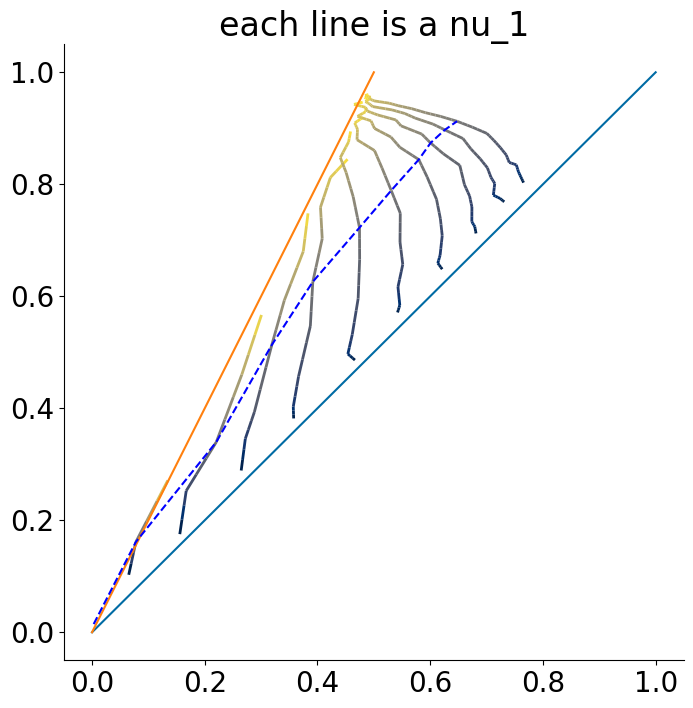

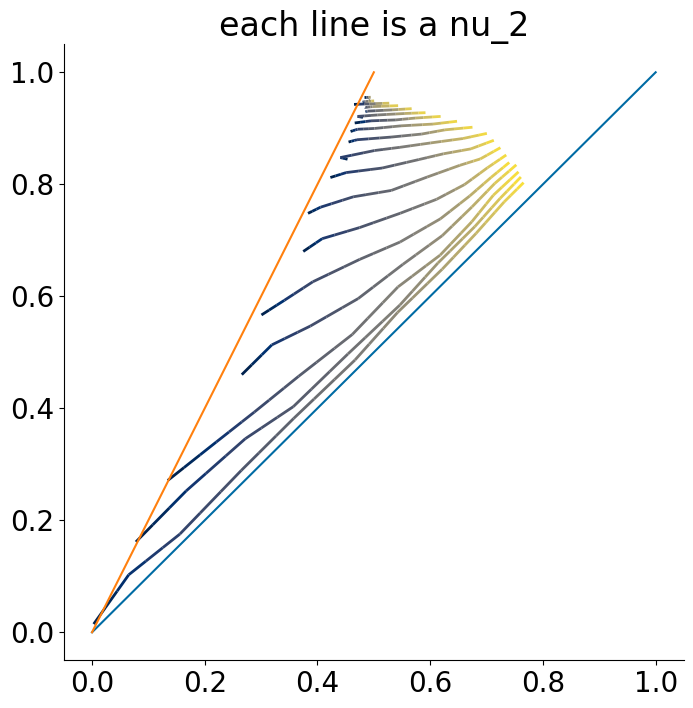

In [383]:
directed = False
do_non_overlapping_simulation = True
look_among_all_non_explored_pairs_if_not_enough = True
trigger_links_with_new_colors_if_not_enough = True
trigger_links_between_new_colors_if_not_enough = True
Tmax = int(1e4)
dataset = get_data_new_pairs_UMT(
    rho = 10, 
    starting_nu_1 = 0, ending_nu_1 = 20,
    starting_nu_2 = 0, ending_nu_2 = None,
    fraction_nu_2_cut = 2,
    N_0 = 1, 
    M_0 = 0, 
    Tmax = Tmax,
    do_fig = True,
    t_to_use = Tmax,
    num_to_save = 1000,
    do_non_overlapping_simulation = do_non_overlapping_simulation,
    look_among_all_non_explored_pairs_if_not_enough = look_among_all_non_explored_pairs_if_not_enough,
    trigger_links_with_new_colors_if_not_enough = trigger_links_with_new_colors_if_not_enough, 
    trigger_links_between_new_colors_if_not_enough = trigger_links_between_new_colors_if_not_enough, 
    color_by_key = None,
    directed = directed,
)
new_pairs_UMT[(do_non_overlapping_simulation, look_among_all_non_explored_pairs_if_not_enough, trigger_links_with_new_colors_if_not_enough, trigger_links_between_new_colors_if_not_enough,Tmax)] = dataset

In [384]:
dataset[0][10][15]['average_D2_indices'][-1]

6106.09

In [385]:
dataset[0][10][15]['average_counter_times_not_enough_with_extracted']

1066.05

In [386]:
dataset[0][10][15]['average_counter_times_not_enough_among_extracted']

81.32

##### With replacement

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/13 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

  0%|          | 0/17 [00:00<?, ?it/s]

  0%|          | 0/19 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

FOUND 	1210
intercept 0.12078524569114978 slope 1.0910668601547662
p-value pearson between $\beta_1$ and $\beta_2$ 0.0


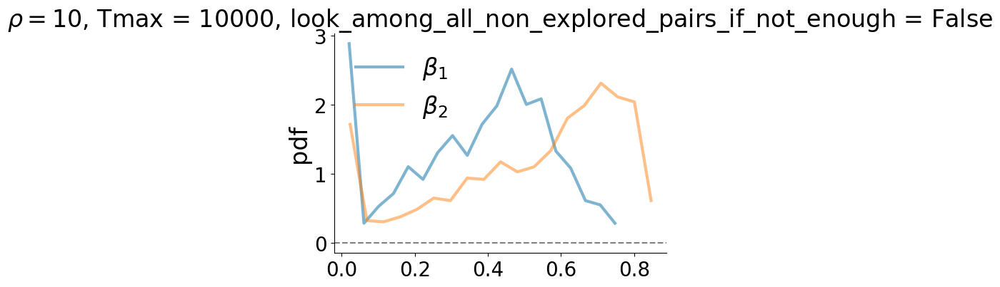

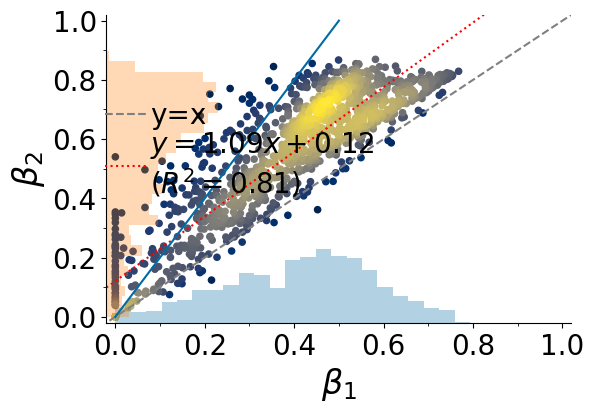

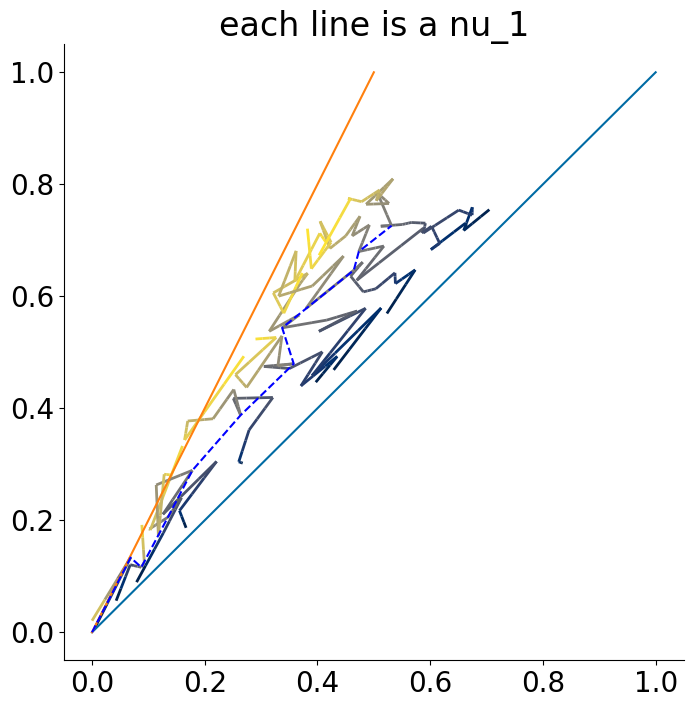

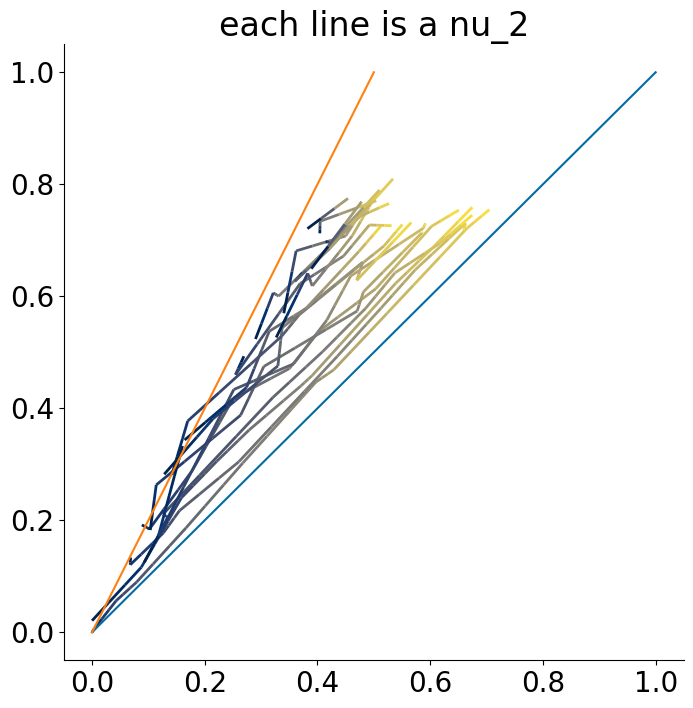

In [559]:
directed = False
do_non_overlapping_simulation = False
trigger_pairs_with_reinforcement = True
triggering_pairs_among_all_non_explored_pairs = False
look_among_all_non_explored_pairs_if_not_enough = False
trigger_links_with_new_colors_if_not_enough = False
trigger_links_between_new_colors_if_not_enough = False
Tmax = int(1e4)
dataset = get_data_new_pairs_UMT(
    rho = 10, 
    starting_nu_1 = 0, ending_nu_1 = 10,
    starting_nu_2 = 0, ending_nu_2 = None,
    fraction_nu_2_cut = 2,
    N_0 = 1, 
    M_0 = 0, 
    Tmax = Tmax,
    do_fig = True,
    t_to_use = Tmax,
    num_to_save = 1000,
    do_non_overlapping_simulation = do_non_overlapping_simulation,
    trigger_pairs_with_reinforcement = trigger_pairs_with_reinforcement,
    triggering_pairs_among_all_non_explored_pairs = triggering_pairs_among_all_non_explored_pairs,
    look_among_all_non_explored_pairs_if_not_enough = look_among_all_non_explored_pairs_if_not_enough,
    trigger_links_with_new_colors_if_not_enough = trigger_links_with_new_colors_if_not_enough, 
    trigger_links_between_new_colors_if_not_enough = trigger_links_between_new_colors_if_not_enough, 
    color_by_key = None,
    directed = directed,
)
new_pairs_UMT[(do_non_overlapping_simulation, look_among_all_non_explored_pairs_if_not_enough, trigger_links_with_new_colors_if_not_enough, trigger_links_between_new_colors_if_not_enough,Tmax)] = dataset

In [561]:
for nu_1 in range(11):
    for nu_2 in range(2*nu_1 + 1):
        if dataset[0][nu_1][nu_2]['average_counter_times_not_enough'] > 0:
            print(nu_1, nu_2, dataset[0][nu_1][nu_2]['average_D2_indices'][-1], dataset[0][nu_1][nu_2]['average_counter_times_not_enough'], flush=True)

1 1 11.3 1.2
1 2 5.7 1.6
2 1 17.3 1.4
2 2 20.6 1.8
2 3 16.8 2.0
2 4 27.6 2.0
3 1 27.1 1.5
3 2 37.4 1.4
3 3 36.3 1.6
3 4 24.9 2.5
3 5 32.8 2.1
3 6 88.2 2.1
4 1 44.0 1.2
4 2 65.6 1.6
4 3 52.0 1.3
4 4 88.0 2.0
4 5 71.2 2.4
4 6 56.8 2.3
4 7 60.9 3.5
4 8 57.8 3.3
5 1 106.6 1.3
5 2 106.1 1.5
5 3 122.6 1.7
5 4 206.8 1.8
5 5 156.1 1.8
5 6 159.3 2.6
5 7 159.7 2.7
5 8 91.7 3.7
5 9 112.4 3.9
5 10 236.4 3.1
6 1 247.9 1.1
6 2 265.5 1.1
6 3 235.1 1.3
6 4 185.1 1.8
6 5 270.2 1.8
6 6 320.7 1.8
6 7 306.3 2.2
6 8 377.6 2.6
6 9 230.1 2.7
6 10 208.8 3.1
6 11 353.5 4.0
6 12 402.7 4.6
7 1 401.8 1.0
7 2 197.2 1.5
7 3 372.1 1.4
7 4 446.6 1.5
7 5 430.3 1.6
7 6 563.0 1.7
7 7 350.1 2.4
7 8 454.7 2.1
7 9 367.3 3.2
7 10 522.8 3.4
7 11 601.7 3.3
7 12 594.3 4.0
7 13 420.8 4.0
7 14 647.8 3.4
8 1 626.8 1.2
8 2 541.6 1.0
8 3 488.7 1.2
8 4 631.3 2.4
8 5 599.9 2.1
8 6 700.7 1.7
8 7 685.6 1.8
8 8 628.2 3.1
8 9 590.9 2.5
8 10 771.9 2.2
8 11 527.3 3.5
8 12 652.9 3.4
8 13 828.6 2.9
8 14 832.2 3.9
8 15 877.9 3.1
8 16 898.1 4.

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/13 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

  0%|          | 0/17 [00:00<?, ?it/s]

  0%|          | 0/19 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

FOUND 	12100
intercept 0.15707478139240794 slope 1.0444946810453866
p-value pearson between $\beta_1$ and $\beta_2$ 0.0


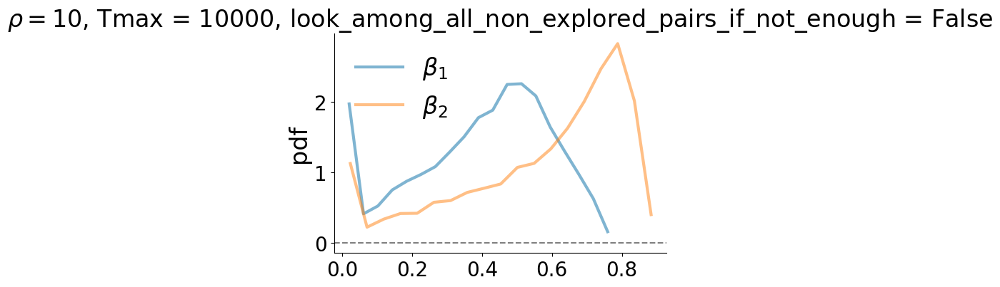

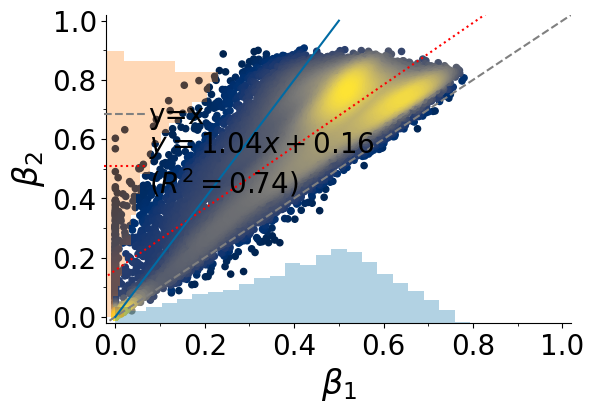

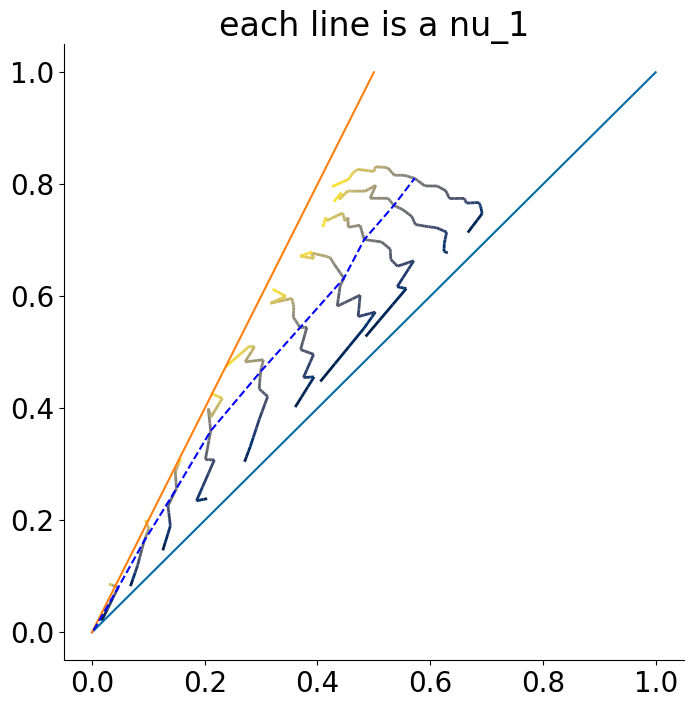

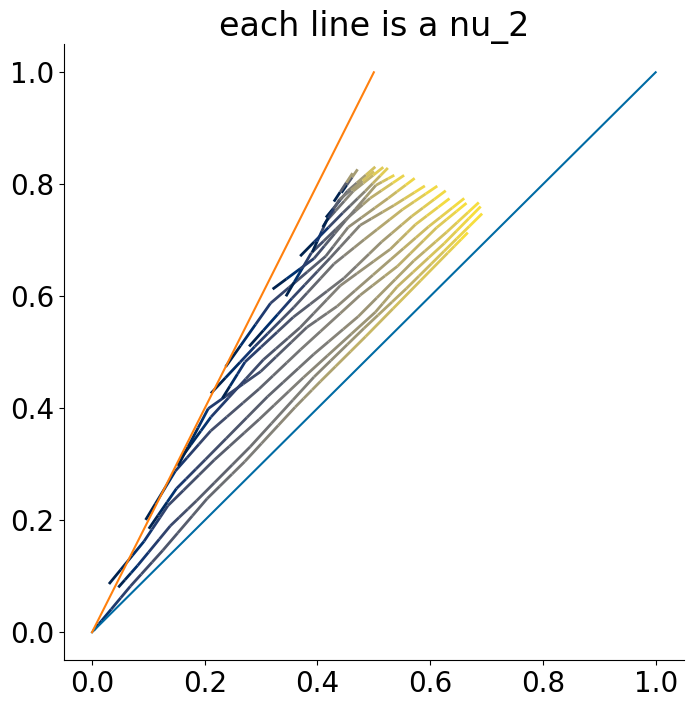

In [562]:
directed = False
do_non_overlapping_simulation = False
trigger_pairs_with_reinforcement = True
triggering_pairs_among_all_non_explored_pairs = False
look_among_all_non_explored_pairs_if_not_enough = False
trigger_links_with_new_colors_if_not_enough = False
trigger_links_between_new_colors_if_not_enough = False
Tmax = int(1e4)
dataset = get_data_new_pairs_UMT(
    rho = 10, 
    starting_nu_1 = 0, ending_nu_1 = 10,
    starting_nu_2 = 0, ending_nu_2 = None,
    fraction_nu_2_cut = 2,
    N_0 = 10, 
    M_0 = 0, 
    Tmax = Tmax,
    do_fig = True,
    t_to_use = Tmax,
    num_to_save = 1000,
    do_non_overlapping_simulation = do_non_overlapping_simulation,
    trigger_pairs_with_reinforcement = trigger_pairs_with_reinforcement,
    triggering_pairs_among_all_non_explored_pairs = triggering_pairs_among_all_non_explored_pairs,
    look_among_all_non_explored_pairs_if_not_enough = look_among_all_non_explored_pairs_if_not_enough,
    trigger_links_with_new_colors_if_not_enough = trigger_links_with_new_colors_if_not_enough, 
    trigger_links_between_new_colors_if_not_enough = trigger_links_between_new_colors_if_not_enough, 
    color_by_key = None,
    directed = directed,
)
new_pairs_UMT[(do_non_overlapping_simulation, look_among_all_non_explored_pairs_if_not_enough, trigger_links_with_new_colors_if_not_enough, trigger_links_between_new_colors_if_not_enough,Tmax)] = dataset

In [563]:
for nu_1 in range(11):
    for nu_2 in range(2*nu_1 + 1):
        if dataset[0][nu_1][nu_2]['average_counter_times_not_enough'] > 0:
            print(nu_1, nu_2, dataset[0][nu_1][nu_2]['average_D2_indices'][-1], dataset[0][nu_1][nu_2]['average_counter_times_not_enough'], flush=True)

1 1 9.5 0.27
1 2 11.64 0.65
2 1 18.19 0.05
2 2 24.87 0.23
2 3 27.34 0.41
2 4 38.02 0.71
3 3 56.02 0.07
3 4 72.9 0.07
3 5 80.32 0.35
3 6 108.94 0.67
4 3 95.09 0.02
4 4 131.06 0.02
4 5 165.88 0.08
4 6 174.77 0.25
4 7 220.54 0.24
4 8 230.6 0.41
5 6 316.49 0.02
5 7 337.07 0.05
5 8 421.24 0.03
5 9 474.63 0.22
5 10 442.46 0.39
6 6 486.76 0.01
6 9 731.06 0.05
6 10 740.94 0.05
6 11 839.69 0.06
6 12 883.83 0.08
7 8 878.17 0.03
7 9 1022.42 0.01
7 11 1162.89 0.04
7 12 1164.75 0.09
7 13 1216.24 0.17
7 14 1316.75 0.06
8 11 1588.33 0.01
8 12 1636.59 0.01
8 14 1767.43 0.02
8 15 1837.64 0.04
9 16 2251.07 0.01
9 17 2355.25 0.02
9 18 2241.85 0.03
10 12 2543.62 0.01
10 19 2821.87 0.03
10 20 2849.67 0.04


In [531]:
directed = False
do_non_overlapping_simulation = False
trigger_pairs_with_reinforcement = True
triggering_pairs_among_all_non_explored_pairs = True
look_among_all_non_explored_pairs_if_not_enough = False
trigger_links_with_new_colors_if_not_enough = False
trigger_links_between_new_colors_if_not_enough = False
Tmax = int(1e4)
dataset = get_data_new_pairs_UMT(
    rho = 10, 
    starting_nu_1 = 0, ending_nu_1 = 10,
    starting_nu_2 = 0, ending_nu_2 = None,
    fraction_nu_2_cut = 2,
    N_0 = 1, 
    M_0 = 0, 
    Tmax = Tmax,
    do_fig = True,
    t_to_use = Tmax,
    num_to_save = 1000,
    do_non_overlapping_simulation = do_non_overlapping_simulation,
    trigger_pairs_with_reinforcement = trigger_pairs_with_reinforcement,
    triggering_pairs_among_all_non_explored_pairs = triggering_pairs_among_all_non_explored_pairs,
    look_among_all_non_explored_pairs_if_not_enough = look_among_all_non_explored_pairs_if_not_enough,
    trigger_links_with_new_colors_if_not_enough = trigger_links_with_new_colors_if_not_enough, 
    trigger_links_between_new_colors_if_not_enough = trigger_links_between_new_colors_if_not_enough, 
    color_by_key = None,
    directed = directed,
)
new_pairs_UMT[(do_non_overlapping_simulation, look_among_all_non_explored_pairs_if_not_enough, trigger_links_with_new_colors_if_not_enough, trigger_links_between_new_colors_if_not_enough,Tmax)] = dataset

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

FileNotFoundError: [Errno 2] No such file or directory: './data/new_model/trigger_links_with_reinforcement/triggering_links_among_all_non_explored_links/simulations/analysis/rho_10.00000/nu_10/nu_20/Tmax_10000/N_0_1/M_0_0/average_light_results.pkl'

In [523]:
for nu_1 in range(11):
    for nu_2 in range(2*nu_1 + 1):
        if dataset[0][nu_1][nu_2]['average_counter_times_not_enough'] > 0:
            print(nu_1, nu_2, dataset[0][nu_1][nu_2]['average_D2_indices'][-1], dataset[0][nu_1][nu_2]['average_counter_times_not_enough'], flush=True)

1 1 11.3 1.2
1 2 5.7 1.6
2 1 17.3 1.4
2 2 20.6 1.8
2 3 16.8 2.0
2 4 27.6 2.0
3 1 27.1 1.5
3 2 37.4 1.4
3 3 36.3 1.6
3 4 24.9 2.5
3 5 32.8 2.1
3 6 88.2 2.1
4 1 44.0 1.2
4 2 65.6 1.6
4 3 52.0 1.3
4 4 88.0 2.0
4 5 71.2 2.4
4 6 56.8 2.3
4 7 60.9 3.5
4 8 57.8 3.3
5 1 106.6 1.3
5 2 106.1 1.5
5 3 122.6 1.7
5 4 206.8 1.8
5 5 156.1 1.8
5 6 159.3 2.6
5 7 159.7 2.7
5 8 91.7 3.7
5 9 112.4 3.9
5 10 236.4 3.1
6 1 247.9 1.1
6 2 265.5 1.1
6 3 235.1 1.3
6 4 185.1 1.8
6 5 270.2 1.8
6 6 320.7 1.8
6 7 306.3 2.2
6 8 377.6 2.6
6 9 230.1 2.7
6 10 208.8 3.1
6 11 353.5 4.0
6 12 402.7 4.6
7 1 401.8 1.0
7 2 197.2 1.5
7 3 372.1 1.4
7 4 446.6 1.5
7 5 430.3 1.6
7 6 563.0 1.7
7 7 350.1 2.4
7 8 454.7 2.1
7 9 367.3 3.2
7 10 522.8 3.4
7 11 601.7 3.3
7 12 594.3 4.0
7 13 420.8 4.0
7 14 647.8 3.4
8 1 626.8 1.2
8 2 541.6 1.0
8 3 488.7 1.2
8 4 631.3 2.4
8 5 599.9 2.1
8 6 700.7 1.7
8 7 685.6 1.8
8 8 628.2 3.1
8 9 590.9 2.5
8 10 771.9 2.2
8 11 527.3 3.5
8 12 652.9 3.4
8 13 828.6 2.9
8 14 832.2 3.9
8 15 877.9 3.1
8 16 898.1 4.

In [529]:
directed = False
do_non_overlapping_simulation = False
trigger_pairs_with_reinforcement = True
triggering_pairs_among_all_non_explored_pairs = True
look_among_all_non_explored_pairs_if_not_enough = False
trigger_links_with_new_colors_if_not_enough = False
trigger_links_between_new_colors_if_not_enough = False
Tmax = int(1e4)
dataset = get_data_new_pairs_UMT(
    rho = 10, 
    starting_nu_1 = 0, ending_nu_1 = 10,
    starting_nu_2 = 0, ending_nu_2 = None,
    fraction_nu_2_cut = 2,
    N_0 = 10, 
    M_0 = 0, 
    Tmax = Tmax,
    do_fig = True,
    t_to_use = Tmax,
    num_to_save = 1000,
    do_non_overlapping_simulation = do_non_overlapping_simulation,
    trigger_pairs_with_reinforcement = trigger_pairs_with_reinforcement,
    triggering_pairs_among_all_non_explored_pairs = triggering_pairs_among_all_non_explored_pairs,
    look_among_all_non_explored_pairs_if_not_enough = look_among_all_non_explored_pairs_if_not_enough,
    trigger_links_with_new_colors_if_not_enough = trigger_links_with_new_colors_if_not_enough, 
    trigger_links_between_new_colors_if_not_enough = trigger_links_between_new_colors_if_not_enough, 
    color_by_key = None,
    directed = directed,
)
new_pairs_UMT[(do_non_overlapping_simulation, look_among_all_non_explored_pairs_if_not_enough, trigger_links_with_new_colors_if_not_enough, trigger_links_between_new_colors_if_not_enough,Tmax)] = dataset

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

FileNotFoundError: [Errno 2] No such file or directory: './data/new_model/trigger_links_with_reinforcement/triggering_links_among_all_non_explored_links/simulations/analysis/rho_10.00000/nu_10/nu_20/Tmax_10000/N_0_10/M_0_0/average_light_results.pkl'

In [525]:
for nu_1 in range(11):
    for nu_2 in range(2*nu_1 + 1):
        if dataset[0][nu_1][nu_2]['average_counter_times_not_enough'] > 0:
            print(nu_1, nu_2, dataset[0][nu_1][nu_2]['average_D2_indices'][-1], dataset[0][nu_1][nu_2]['average_counter_times_not_enough'], flush=True)

1 1 9.5 0.6
1 2 10.8 0.5
2 1 21.3 0.1
2 3 38.2 0.6
2 4 38.5 0.4
3 5 76.3 0.2
3 6 82.1 0.4
4 6 185.1 0.2
4 7 141.8 0.2
4 8 226.4 0.4
5 7 274.7 0.1
5 8 439.3 0.4
5 10 374.6 0.1
6 11 777.0 0.4
6 12 902.2 0.1
8 13 1778.1 0.1


##### other

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/13 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

  0%|          | 0/17 [00:00<?, ?it/s]

  0%|          | 0/19 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

FOUND 	12100
intercept 0.18559939655538094 slope 1.0292184842314214
p-value pearson between $\beta_1$ and $\beta_2$ 0.0


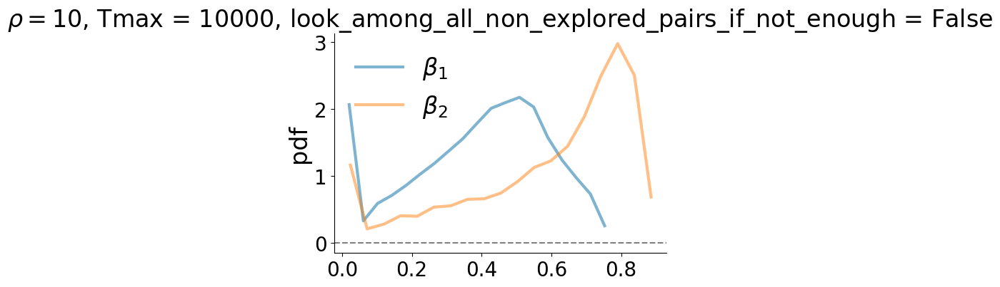

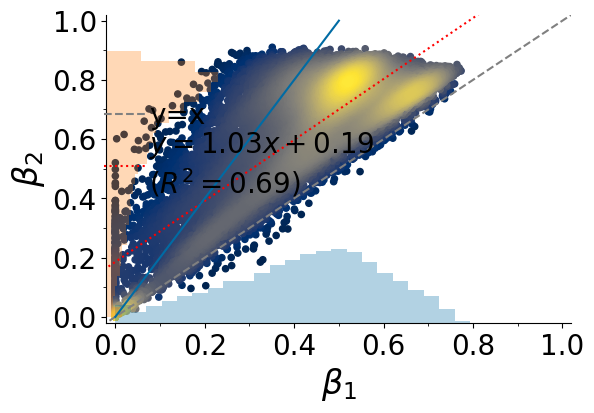

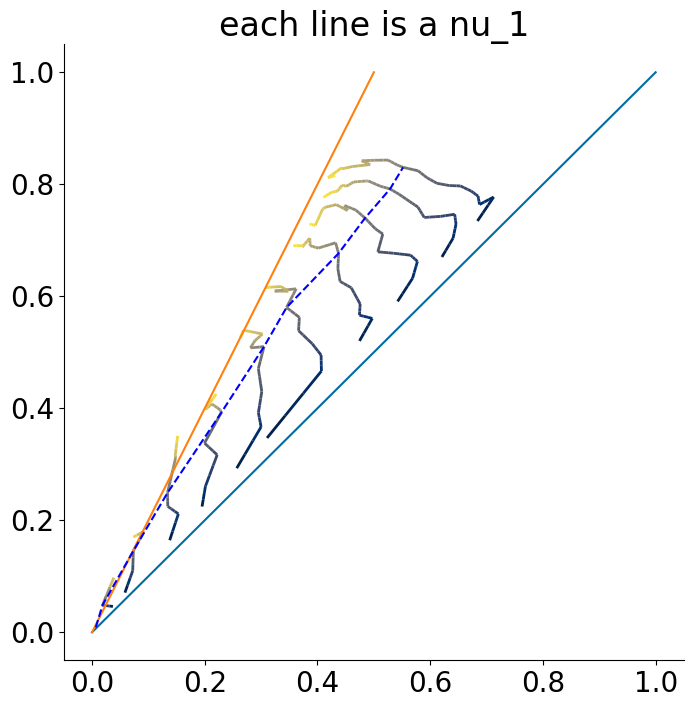

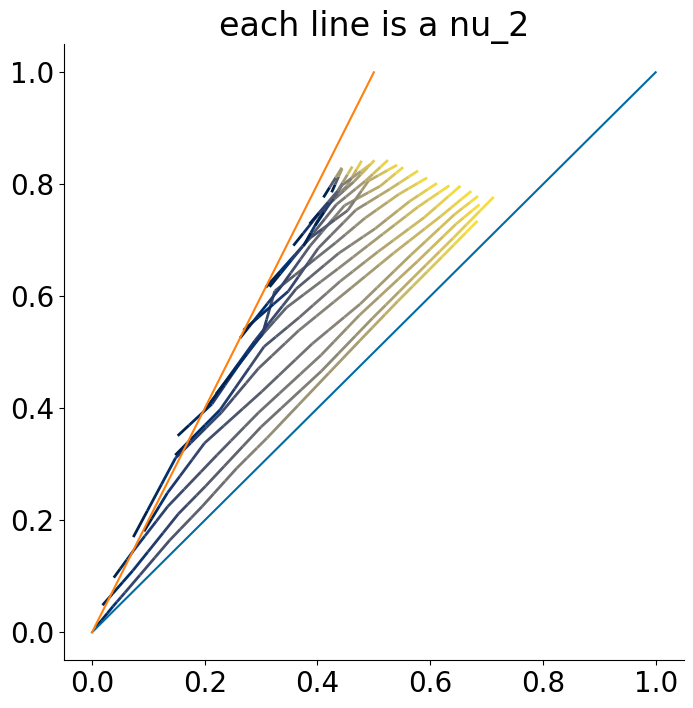

In [511]:
directed = False
do_non_overlapping_simulation = False
trigger_pairs_with_reinforcement = True
triggering_pairs_among_all_non_explored_pairs = False
look_among_all_non_explored_pairs_if_not_enough = False
trigger_links_with_new_colors_if_not_enough = False
trigger_links_between_new_colors_if_not_enough = False
Tmax = int(1e4)
dataset = get_data_new_pairs_UMT(
    rho = 10, 
    starting_nu_1 = 0, ending_nu_1 = 10,
    starting_nu_2 = 0, ending_nu_2 = None,
    fraction_nu_2_cut = 2,
    N_0 = 10, 
    M_0 = 0, 
    Tmax = Tmax,
    do_fig = True,
    t_to_use = Tmax,
    num_to_save = 1000,
    do_non_overlapping_simulation = do_non_overlapping_simulation,
    trigger_pairs_with_reinforcement = trigger_pairs_with_reinforcement,
    triggering_pairs_among_all_non_explored_pairs = triggering_pairs_among_all_non_explored_pairs,
    look_among_all_non_explored_pairs_if_not_enough = look_among_all_non_explored_pairs_if_not_enough,
    trigger_links_with_new_colors_if_not_enough = trigger_links_with_new_colors_if_not_enough, 
    trigger_links_between_new_colors_if_not_enough = trigger_links_between_new_colors_if_not_enough, 
    color_by_key = None,
    directed = directed,
)
new_pairs_UMT[(do_non_overlapping_simulation, look_among_all_non_explored_pairs_if_not_enough, trigger_links_with_new_colors_if_not_enough, trigger_links_between_new_colors_if_not_enough,Tmax)] = dataset

In [512]:
dataset[0][10][15]['average_D2_indices'][-1]

2913.68

In [513]:
dataset[0][10][15]['average_counter_times_not_enough']

0.0

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/13 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

  0%|          | 0/17 [00:00<?, ?it/s]

  0%|          | 0/19 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/23 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/27 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/31 [00:00<?, ?it/s]

  0%|          | 0/33 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/37 [00:00<?, ?it/s]

  0%|          | 0/39 [00:00<?, ?it/s]

  0%|          | 0/41 [00:00<?, ?it/s]

FOUND 	12100
intercept 0.17160688825805123 slope 1.0275913598788178
p-value pearson between $\beta_1$ and $\beta_2$ 0.0


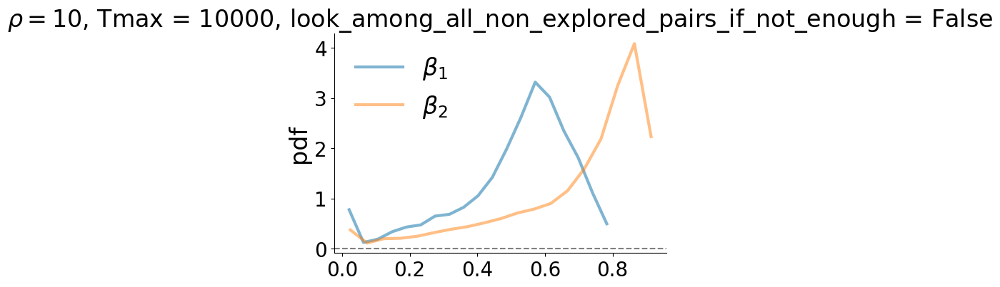

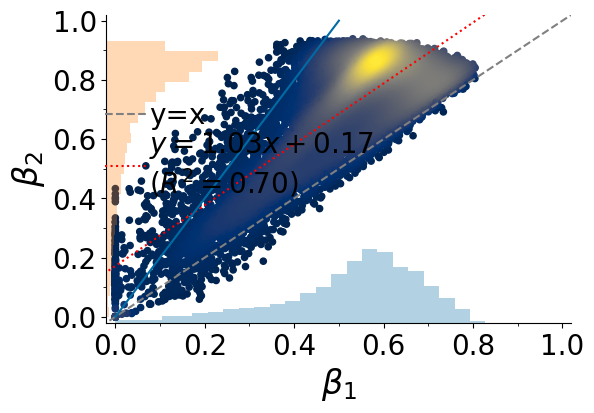

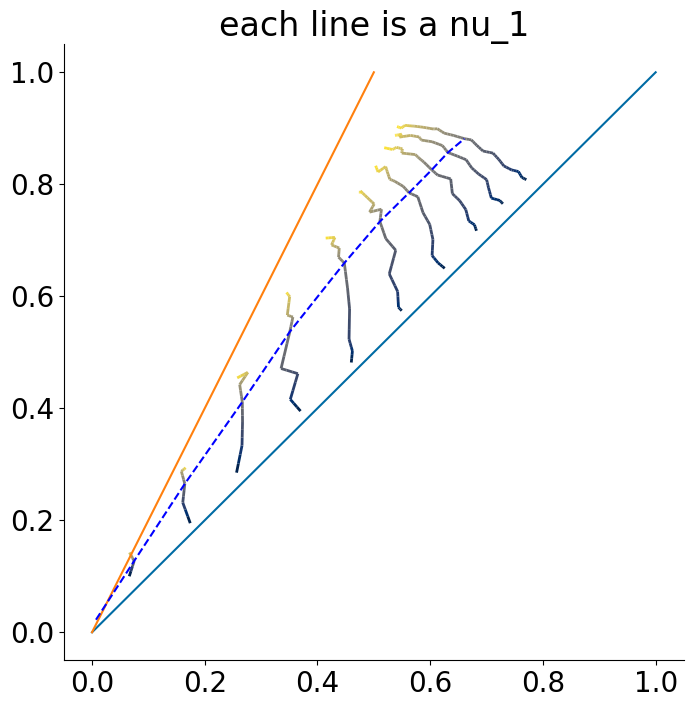

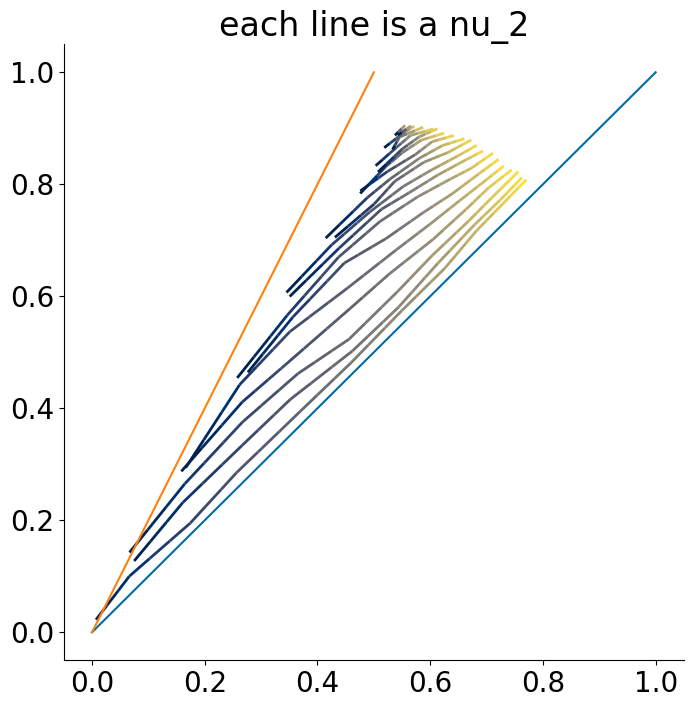

In [330]:
directed = False
do_non_overlapping_simulation = True
trigger_pairs_with_reinforcement = True
triggering_pairs_among_all_non_explored_pairs = False
look_among_all_non_explored_pairs_if_not_enough = False
trigger_links_with_new_colors_if_not_enough = False
trigger_links_between_new_colors_if_not_enough = False
Tmax = int(1e4)
dataset = get_data_new_pairs_UMT(
    rho = 10, 
    starting_nu_1 = 0, ending_nu_1 = 20,
    starting_nu_2 = 0, ending_nu_2 = None,
    fraction_nu_2_cut = 2,
    N_0 = 1, 
    M_0 = 0, 
    Tmax = Tmax,
    do_fig = True,
    t_to_use = Tmax,
    num_to_save = 1000,
    do_non_overlapping_simulation = do_non_overlapping_simulation,
    trigger_pairs_with_reinforcement = trigger_pairs_with_reinforcement,
    triggering_pairs_among_all_non_explored_pairs = triggering_pairs_among_all_non_explored_pairs,
    look_among_all_non_explored_pairs_if_not_enough = look_among_all_non_explored_pairs_if_not_enough,
    trigger_links_with_new_colors_if_not_enough = trigger_links_with_new_colors_if_not_enough, 
    trigger_links_between_new_colors_if_not_enough = trigger_links_between_new_colors_if_not_enough, 
    color_by_key = None,
    directed = directed,
)
new_pairs_UMT[(do_non_overlapping_simulation, look_among_all_non_explored_pairs_if_not_enough, trigger_links_with_new_colors_if_not_enough, trigger_links_between_new_colors_if_not_enough,Tmax)] = dataset

In [331]:
dataset[0][10][15]['average_D2_indices'][-1]

4327.84

In [332]:
dataset[0][10][15]['average_counter_times_not_enough_with_extracted']

144.39

In [333]:
dataset[0][10][15]['average_counter_times_not_enough_among_extracted']

0.0

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/13 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

  0%|          | 0/17 [00:00<?, ?it/s]

  0%|          | 0/19 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/23 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/27 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/31 [00:00<?, ?it/s]

  0%|          | 0/33 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/37 [00:00<?, ?it/s]

  0%|          | 0/39 [00:00<?, ?it/s]

  0%|          | 0/41 [00:00<?, ?it/s]

FOUND 	12100
intercept 0.12728076852271852 slope 0.9983128207542755
p-value pearson between $\beta_1$ and $\beta_2$ 0.0
(False, True, True, False, False, False, 10000)


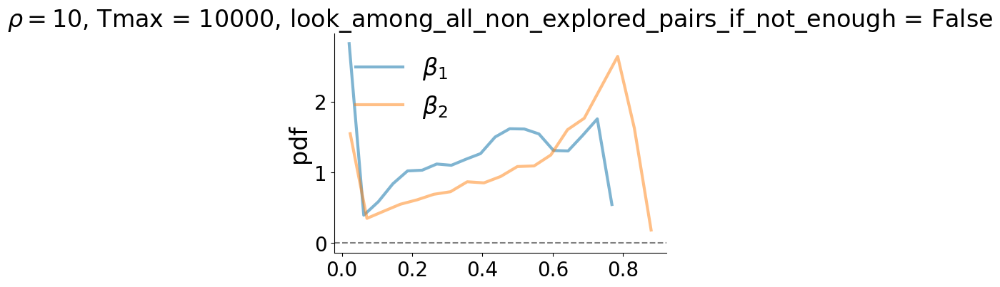

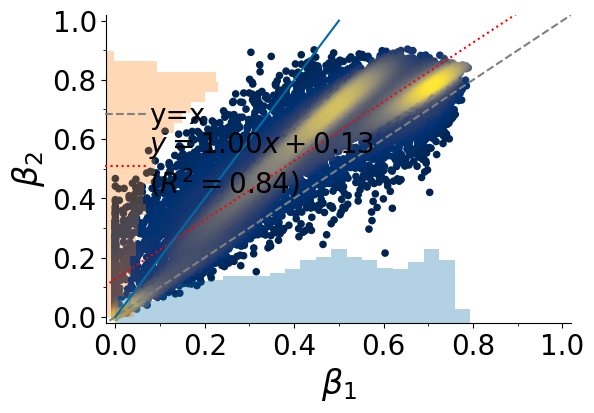

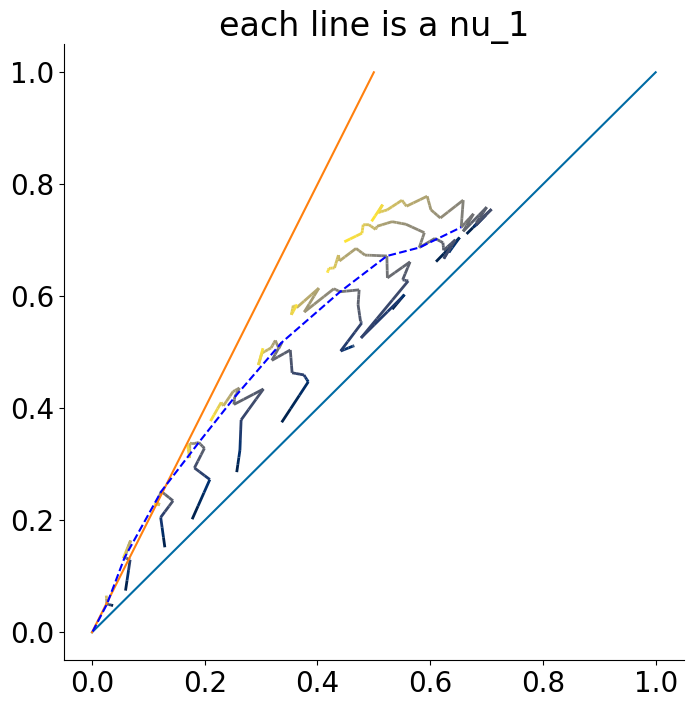

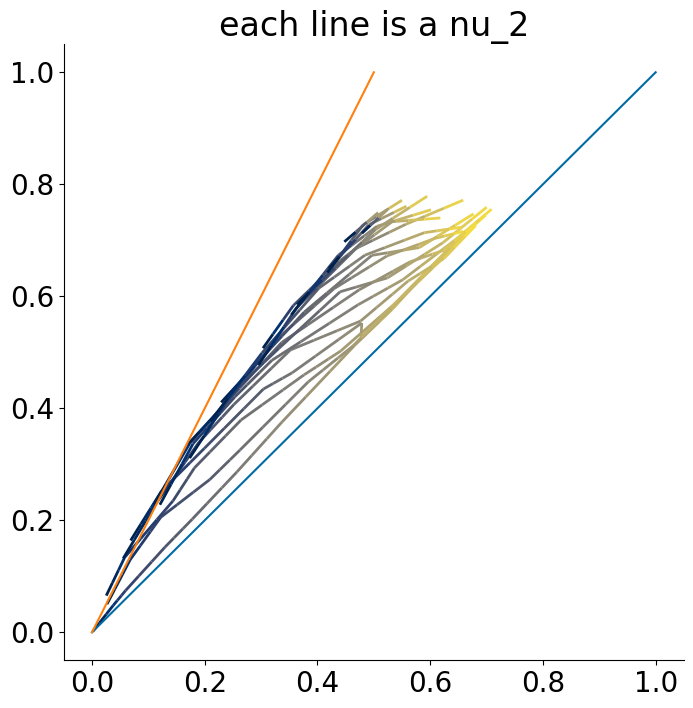

In [334]:
directed = False
do_non_overlapping_simulation = False
trigger_pairs_with_reinforcement = True
triggering_pairs_among_all_non_explored_pairs = True
look_among_all_non_explored_pairs_if_not_enough = False
trigger_links_with_new_colors_if_not_enough = False
trigger_links_between_new_colors_if_not_enough = False
Tmax = int(1e4)
dataset = get_data_new_pairs_UMT(
    rho = 10, 
    starting_nu_1 = 0, ending_nu_1 = 20,
    starting_nu_2 = 0, ending_nu_2 = None,
    fraction_nu_2_cut = 2,
    N_0 = 1, 
    M_0 = 0, 
    Tmax = Tmax,
    do_fig = True,
    t_to_use = Tmax,
    num_to_save = 1000,
    do_non_overlapping_simulation = do_non_overlapping_simulation,
    trigger_pairs_with_reinforcement = trigger_pairs_with_reinforcement,
    triggering_pairs_among_all_non_explored_pairs = triggering_pairs_among_all_non_explored_pairs,
    look_among_all_non_explored_pairs_if_not_enough = look_among_all_non_explored_pairs_if_not_enough,
    trigger_links_with_new_colors_if_not_enough = trigger_links_with_new_colors_if_not_enough, 
    trigger_links_between_new_colors_if_not_enough = trigger_links_between_new_colors_if_not_enough, 
    color_by_key = None,
    directed = directed,
)
new_pairs_UMT[(do_non_overlapping_simulation, trigger_pairs_with_reinforcement, triggering_pairs_among_all_non_explored_pairs, look_among_all_non_explored_pairs_if_not_enough, trigger_links_with_new_colors_if_not_enough, trigger_links_between_new_colors_if_not_enough,Tmax)] = dataset
print((do_non_overlapping_simulation, trigger_pairs_with_reinforcement, triggering_pairs_among_all_non_explored_pairs, look_among_all_non_explored_pairs_if_not_enough, trigger_links_with_new_colors_if_not_enough, trigger_links_between_new_colors_if_not_enough,Tmax))

In [335]:
dataset[0][10][15]['average_D2_indices'][-1]

1779.95

In [336]:
dataset[0][10][15]['average_counter_times_not_enough_with_extracted']

1779.95

In [337]:
dataset[0][10][15]['average_counter_times_not_enough_among_extracted']

404.07

In [457]:
nu_1 = 10
nu_2 = 10
dataset[0][nu_1][nu_2]['average_D2_indices'][-1], dataset[0][nu_1][nu_2]['average_counter_times_not_enough_with_extracted'], dataset[0][nu_1][nu_2]['average_counter_times_not_enough_among_extracted']

(1973.4, 1973.4, 105.5)

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/13 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

  0%|          | 0/17 [00:00<?, ?it/s]

  0%|          | 0/19 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/23 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/27 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/31 [00:00<?, ?it/s]

  0%|          | 0/33 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/37 [00:00<?, ?it/s]

  0%|          | 0/39 [00:00<?, ?it/s]

  0%|          | 0/41 [00:00<?, ?it/s]

FOUND 	12100
intercept 0.14855310016487694 slope 1.0574285781861663
p-value pearson between $\beta_1$ and $\beta_2$ 0.0
(True, True, True, False, False, False, 10000)


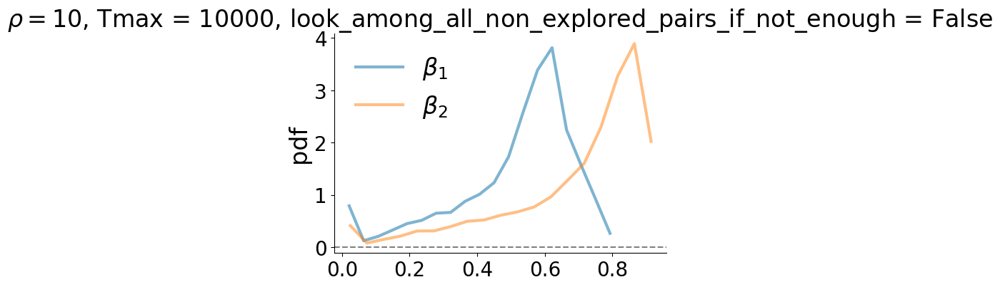

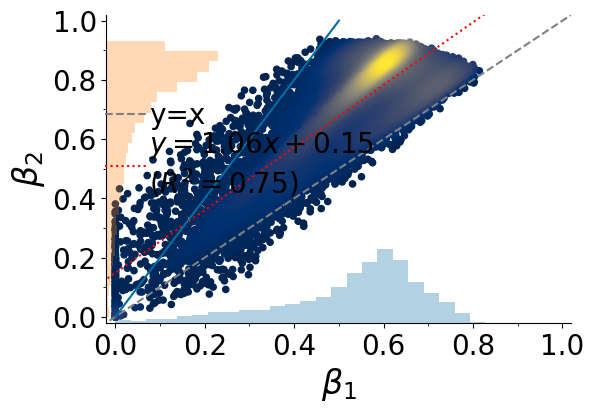

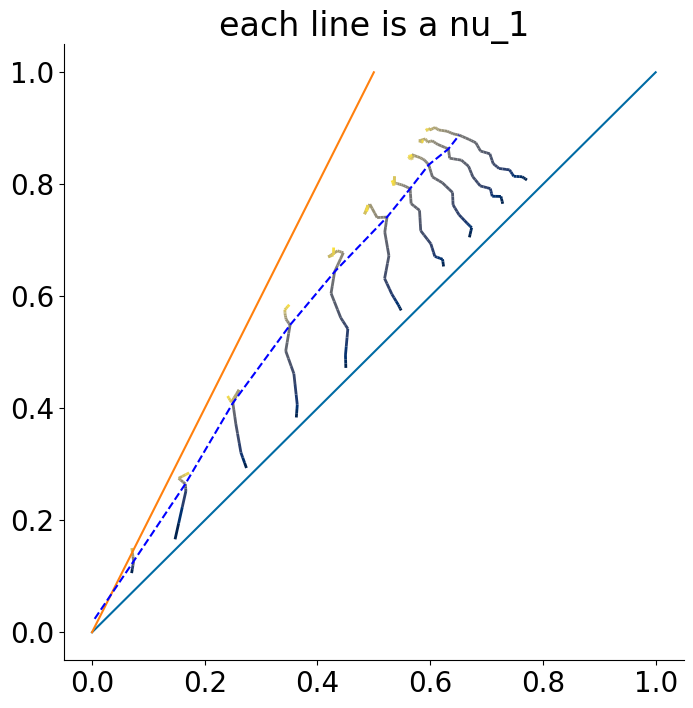

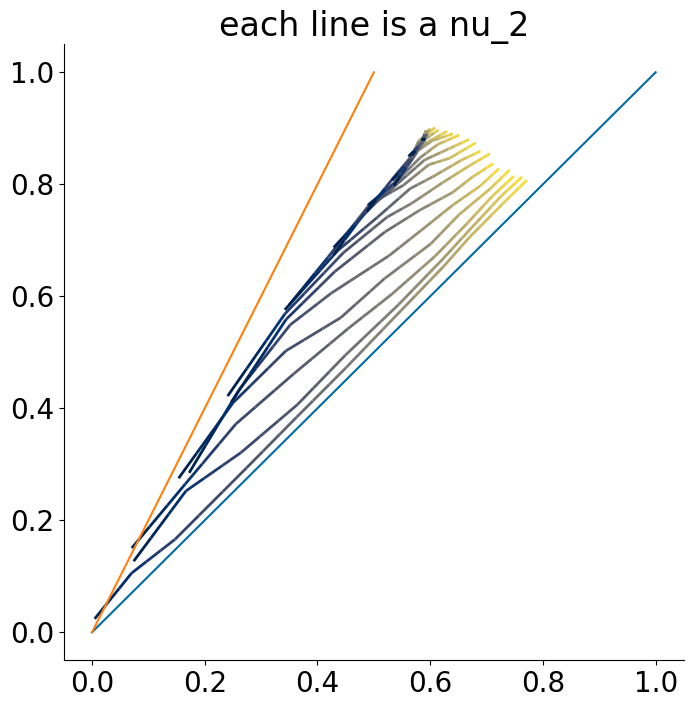

In [338]:
directed = False
do_non_overlapping_simulation = True
trigger_pairs_with_reinforcement = True
triggering_pairs_among_all_non_explored_pairs = True
look_among_all_non_explored_pairs_if_not_enough = False
trigger_links_with_new_colors_if_not_enough = False
trigger_links_between_new_colors_if_not_enough = False
Tmax = int(1e4)
dataset = get_data_new_pairs_UMT(
    rho = 10, 
    starting_nu_1 = 0, ending_nu_1 = 20,
    starting_nu_2 = 0, ending_nu_2 = None,
    fraction_nu_2_cut = 2,
    N_0 = 1, 
    M_0 = 0, 
    Tmax = Tmax,
    do_fig = True,
    t_to_use = Tmax,
    num_to_save = 1000,
    do_non_overlapping_simulation = do_non_overlapping_simulation,
    trigger_pairs_with_reinforcement = trigger_pairs_with_reinforcement,
    triggering_pairs_among_all_non_explored_pairs = triggering_pairs_among_all_non_explored_pairs,
    look_among_all_non_explored_pairs_if_not_enough = look_among_all_non_explored_pairs_if_not_enough,
    trigger_links_with_new_colors_if_not_enough = trigger_links_with_new_colors_if_not_enough, 
    trigger_links_between_new_colors_if_not_enough = trigger_links_between_new_colors_if_not_enough, 
    color_by_key = None,
    directed = directed,
)
new_pairs_UMT[(do_non_overlapping_simulation, trigger_pairs_with_reinforcement, triggering_pairs_among_all_non_explored_pairs, look_among_all_non_explored_pairs_if_not_enough, trigger_links_with_new_colors_if_not_enough, trigger_links_between_new_colors_if_not_enough,Tmax)] = dataset
print((do_non_overlapping_simulation, trigger_pairs_with_reinforcement, triggering_pairs_among_all_non_explored_pairs, look_among_all_non_explored_pairs_if_not_enough, trigger_links_with_new_colors_if_not_enough, trigger_links_between_new_colors_if_not_enough,Tmax))

In [339]:
dataset[0][10][15]['average_D2_indices'][-1]

4283.16

In [340]:
dataset[0][10][15]['average_counter_times_not_enough_with_extracted']

4283.16

In [341]:
dataset[0][10][15]['average_counter_times_not_enough_among_extracted']

274.54

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/13 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

  0%|          | 0/17 [00:00<?, ?it/s]

  0%|          | 0/19 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

FOUND 	12100
intercept 0.07266555333139231 slope 0.8596876020135836
p-value pearson between $\beta_1$ and $\beta_2$ 0.0


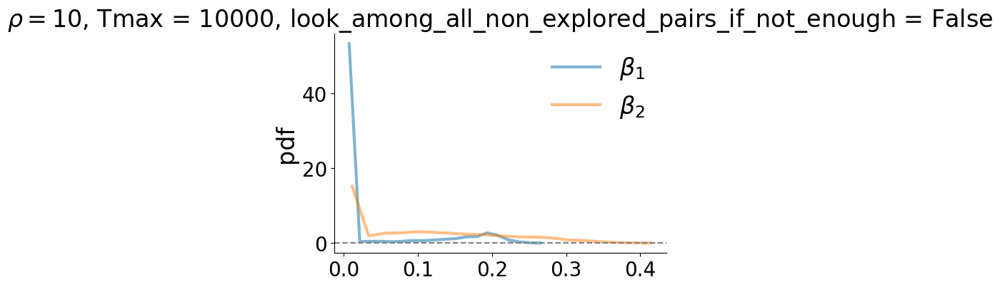

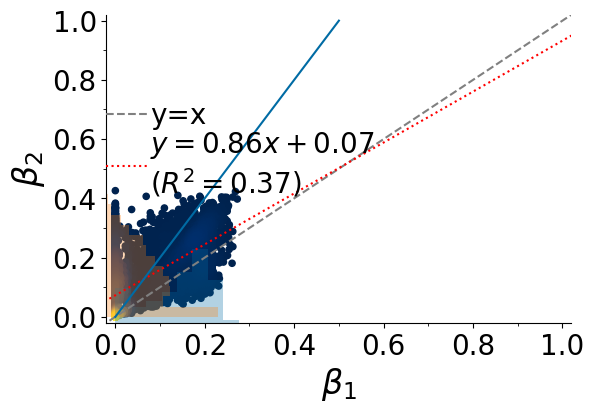

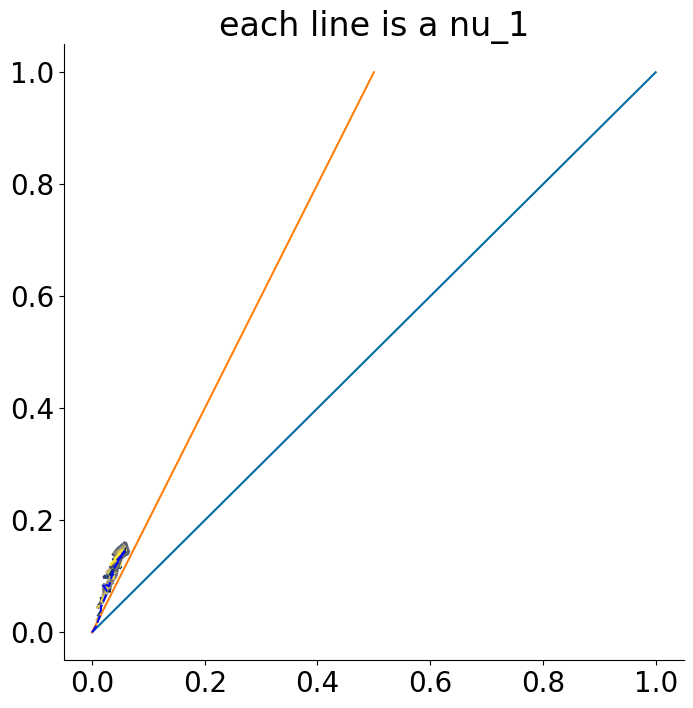

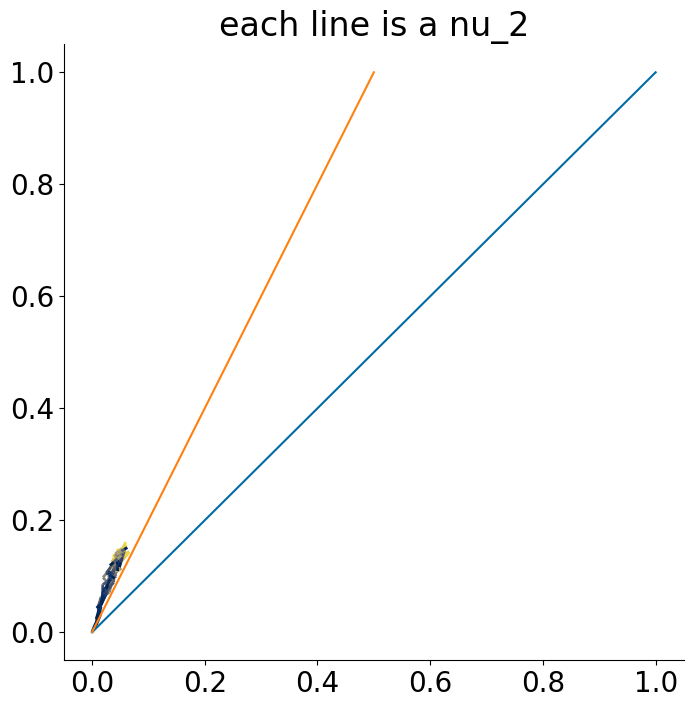

In [495]:
directed = False
do_non_overlapping_simulation = False
trigger_pairs_with_reinforcement = True
triggering_pairs_among_all_non_explored_pairs = True
look_among_all_non_explored_pairs_if_not_enough = False
trigger_links_with_new_colors_if_not_enough = False
trigger_links_between_new_colors_if_not_enough = False
Tmax = int(1e4)
dataset = get_data_new_pairs_UMT(
    rho = 10, 
    starting_nu_1 = 0, ending_nu_1 = 10,
    starting_nu_2 = 0, ending_nu_2 = None,
    fraction_nu_2_cut = 2,
    N_0 = 1, 
    M_0 = 0, 
    Tmax = Tmax,
    do_fig = True,
    t_to_use = Tmax,
    num_to_save = 1000,
    do_non_overlapping_simulation = do_non_overlapping_simulation,
    trigger_pairs_with_reinforcement = trigger_pairs_with_reinforcement,
    triggering_pairs_among_all_non_explored_pairs = triggering_pairs_among_all_non_explored_pairs,
    look_among_all_non_explored_pairs_if_not_enough = look_among_all_non_explored_pairs_if_not_enough,
    trigger_links_with_new_colors_if_not_enough = trigger_links_with_new_colors_if_not_enough, 
    trigger_links_between_new_colors_if_not_enough = trigger_links_between_new_colors_if_not_enough, 
    color_by_key = None,
    directed = directed,
)
new_pairs_UMT[(do_non_overlapping_simulation, look_among_all_non_explored_pairs_if_not_enough, trigger_links_with_new_colors_if_not_enough, trigger_links_between_new_colors_if_not_enough,Tmax)] = dataset

In [503]:
dataset[0][10][15]['average_D_indices'][-1]

7.92

In [500]:
dataset[0][10][15]['average_D2_indices'][-1]

35.08

In [501]:
dataset[0][10][10]['average_counter_times_not_enough']

0.0

In [498]:
dataset[0][10][15]['average_counter_times_not_enough_among_extracted']

KeyError: 'average_counter_times_not_enough_among_extracted'

#### 1e5

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/13 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

  0%|          | 0/17 [00:00<?, ?it/s]

  0%|          | 0/19 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

FOUND 	12100
intercept 0.1142437141476124 slope 1.1366523675044191
p-value pearson between $\beta_1$ and $\beta_2$ 0.0


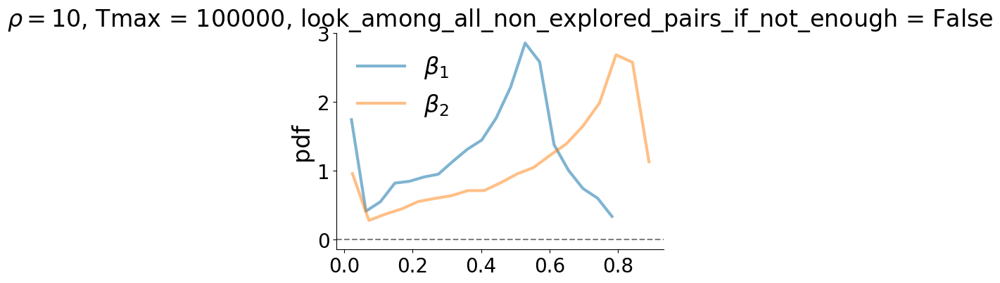

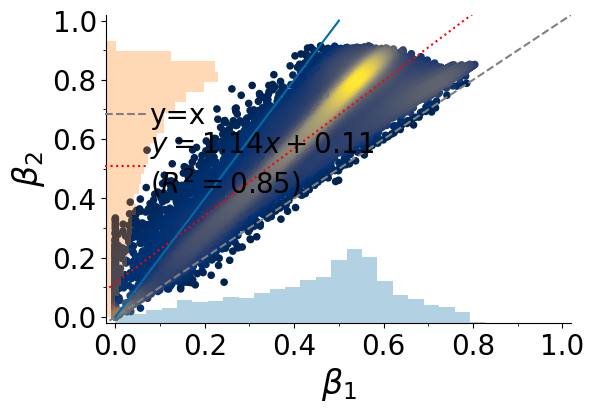

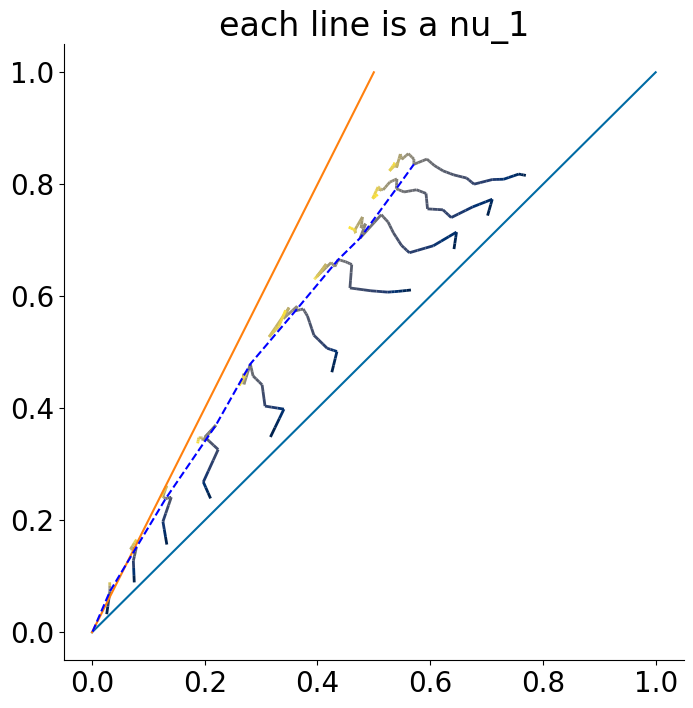

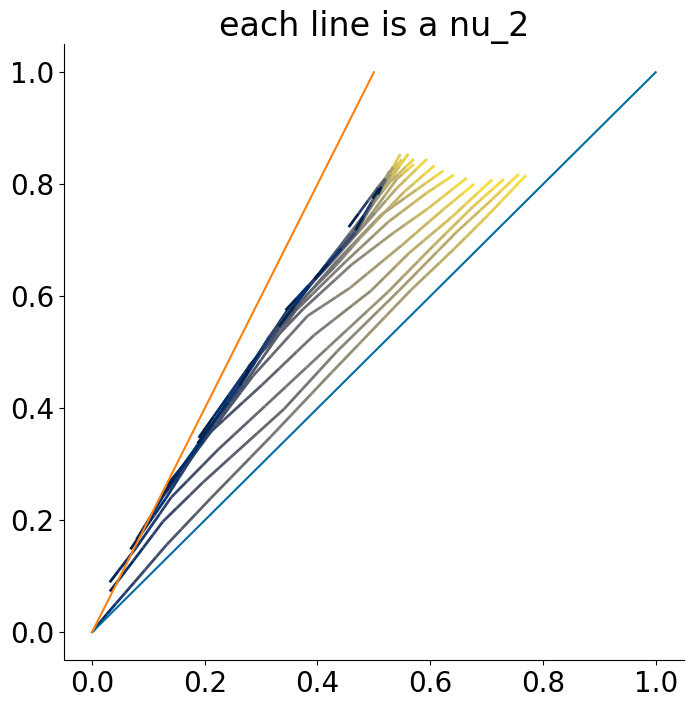

In [358]:
directed = False
do_non_overlapping_simulation = False
look_among_all_non_explored_pairs_if_not_enough = False
trigger_links_with_new_colors_if_not_enough = False
trigger_links_between_new_colors_if_not_enough = False
Tmax = int(1e5)
dataset = get_data_new_pairs_UMT(
    rho = 10, 
    starting_nu_1 = 0, ending_nu_1 = 10,
    starting_nu_2 = 0, ending_nu_2 = None,
    fraction_nu_2_cut = 2,
    N_0 = 1, 
    M_0 = 0, 
    Tmax = Tmax,
    do_fig = True,
    t_to_use = Tmax,
    num_to_save = 1000,
    do_non_overlapping_simulation = do_non_overlapping_simulation,
    look_among_all_non_explored_pairs_if_not_enough = look_among_all_non_explored_pairs_if_not_enough,
    trigger_links_with_new_colors_if_not_enough = trigger_links_with_new_colors_if_not_enough, 
    trigger_links_between_new_colors_if_not_enough = trigger_links_between_new_colors_if_not_enough, 
    color_by_key = None,
    directed = directed,
)
new_pairs_UMT[(do_non_overlapping_simulation, look_among_all_non_explored_pairs_if_not_enough, trigger_links_with_new_colors_if_not_enough, trigger_links_between_new_colors_if_not_enough,Tmax)] = dataset

In [359]:
dataset[0][10][15]['average_D2_indices'][-1]

20709.29

In [360]:
dataset[0][10][15]['average_counter_times_not_enough_with_extracted']

8130.64

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/13 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

  0%|          | 0/17 [00:00<?, ?it/s]

  0%|          | 0/19 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

FOUND 	1210
intercept 0.1723169037920726 slope 1.0282509278230507
p-value pearson between $\beta_1$ and $\beta_2$ 2.5574554833710543e-293


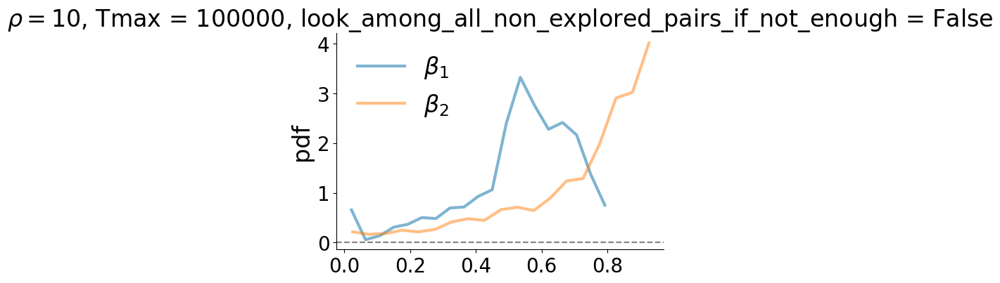

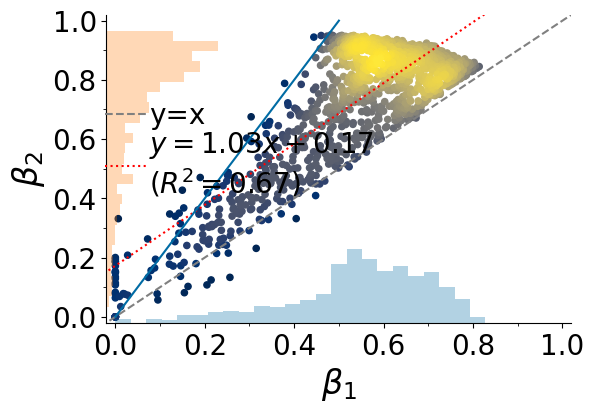

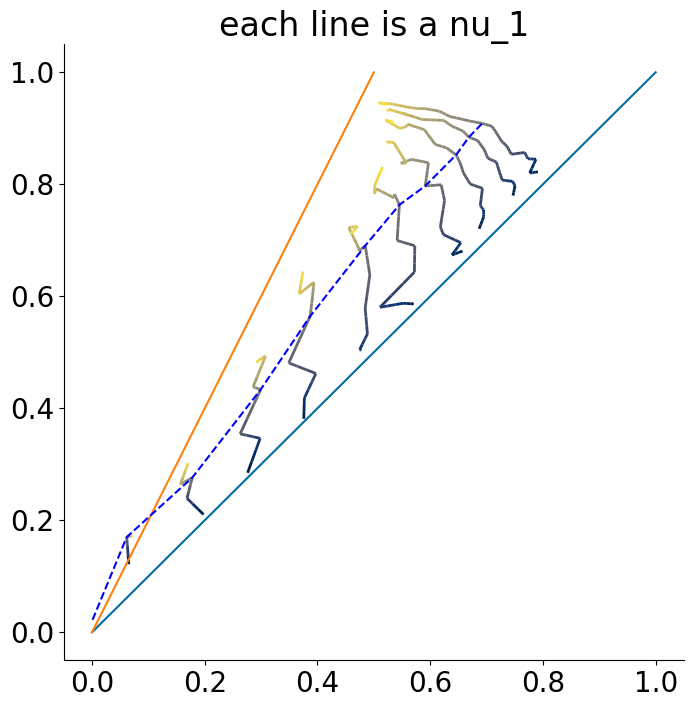

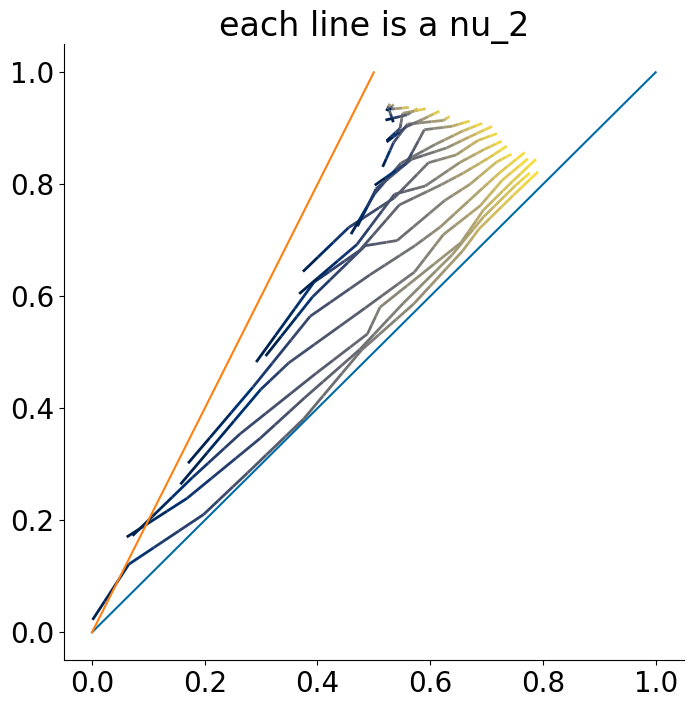

In [361]:
directed = False
do_non_overlapping_simulation = True
look_among_all_non_explored_pairs_if_not_enough = False
trigger_links_with_new_colors_if_not_enough = False
trigger_links_between_new_colors_if_not_enough = False
Tmax = int(1e5)
dataset = get_data_new_pairs_UMT(
    rho = 10, 
    starting_nu_1 = 0, ending_nu_1 = 10,
    starting_nu_2 = 0, ending_nu_2 = None,
    fraction_nu_2_cut = 2,
    N_0 = 1, 
    M_0 = 0, 
    Tmax = Tmax,
    do_fig = True,
    t_to_use = Tmax,
    num_to_save = 1000,
    do_non_overlapping_simulation = do_non_overlapping_simulation,
    look_among_all_non_explored_pairs_if_not_enough = look_among_all_non_explored_pairs_if_not_enough,
    trigger_links_with_new_colors_if_not_enough = trigger_links_with_new_colors_if_not_enough, 
    trigger_links_between_new_colors_if_not_enough = trigger_links_between_new_colors_if_not_enough, 
    color_by_key = None,
    directed = directed,
)
new_pairs_UMT[(do_non_overlapping_simulation, look_among_all_non_explored_pairs_if_not_enough, trigger_links_with_new_colors_if_not_enough, trigger_links_between_new_colors_if_not_enough,Tmax)] = dataset

In [362]:
dataset[0][10][15]['average_D2_indices'][-1]

50204.8

In [363]:
dataset[0][10][15]['average_counter_times_not_enough_with_extracted']

1492.5

##### With replacement

In [639]:
directed = False
do_non_overlapping_simulation = False
trigger_pairs_with_reinforcement = True
triggering_pairs_among_all_non_explored_pairs = False
look_among_all_non_explored_pairs_if_not_enough = False
trigger_links_with_new_colors_if_not_enough = False
trigger_links_between_new_colors_if_not_enough = False
Tmax = int(1e5)
dataset = get_data_new_pairs_UMT(
    rho = 10, 
    starting_nu_1 = 0, ending_nu_1 = 20,
    starting_nu_2 = 0, ending_nu_2 = None,
    fraction_nu_2_cut = 2,
    N_0 = 1, 
    M_0 = 0, 
    Tmax = Tmax,
    do_fig = True,
    t_to_use = Tmax,
    num_to_save = 1000,
    do_non_overlapping_simulation = do_non_overlapping_simulation,
    trigger_pairs_with_reinforcement = trigger_pairs_with_reinforcement,
    triggering_pairs_among_all_non_explored_pairs = triggering_pairs_among_all_non_explored_pairs,
    look_among_all_non_explored_pairs_if_not_enough = look_among_all_non_explored_pairs_if_not_enough,
    trigger_links_with_new_colors_if_not_enough = trigger_links_with_new_colors_if_not_enough, 
    trigger_links_between_new_colors_if_not_enough = trigger_links_between_new_colors_if_not_enough, 
    color_by_key = None,
    directed = directed,
)
new_pairs_UMT[(do_non_overlapping_simulation, trigger_pairs_with_reinforcement, triggering_pairs_among_all_non_explored_pairs, look_among_all_non_explored_pairs_if_not_enough, trigger_links_with_new_colors_if_not_enough, trigger_links_between_new_colors_if_not_enough,Tmax)] = dataset
print((do_non_overlapping_simulation, trigger_pairs_with_reinforcement, triggering_pairs_among_all_non_explored_pairs, look_among_all_non_explored_pairs_if_not_enough, trigger_links_with_new_colors_if_not_enough, trigger_links_between_new_colors_if_not_enough,Tmax))

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

FileNotFoundError: [Errno 2] No such file or directory: './data/new_model/trigger_links_with_reinforcement/simulations/analysis/rho_10.00000/nu_10/nu_20/Tmax_100000/N_0_1/M_0_0/average_light_results.pkl'

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/13 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

  0%|          | 0/17 [00:00<?, ?it/s]

  0%|          | 0/19 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

FOUND 	12100
intercept 0.1308856389035986 slope 1.0700414768108275
p-value pearson between $\beta_1$ and $\beta_2$ 0.0
(False, True, False, False, False, False, 100000)


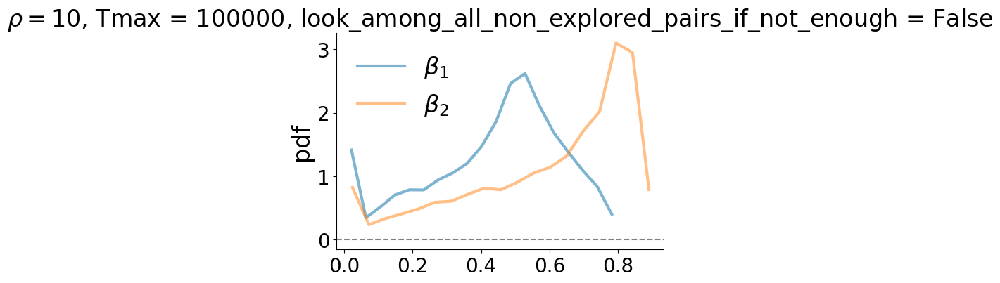

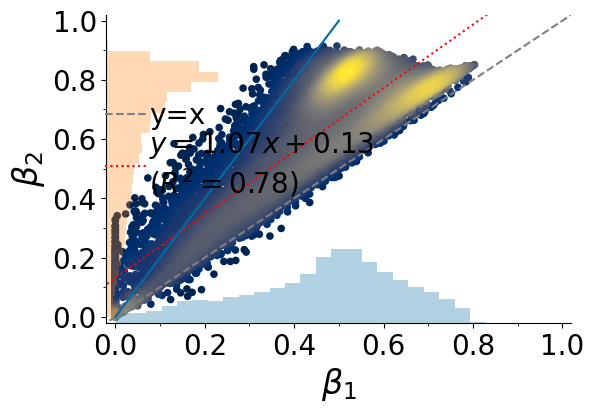

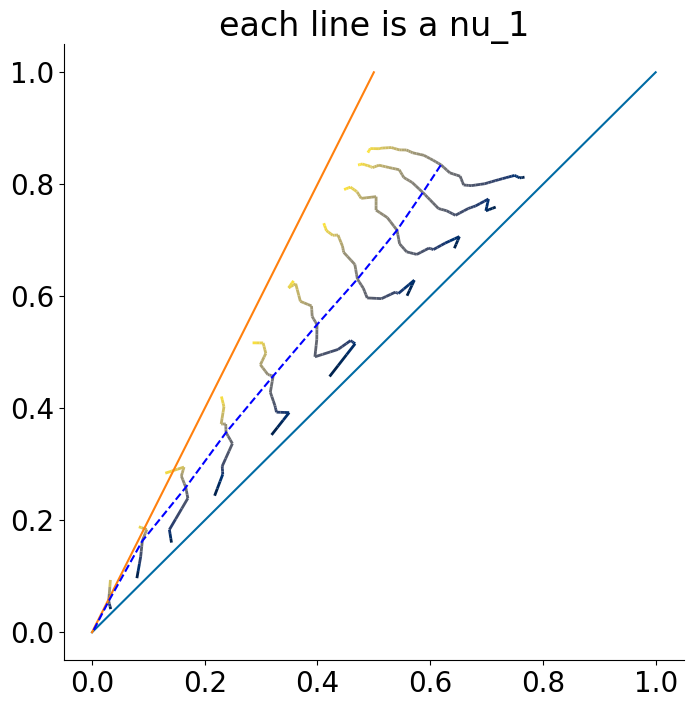

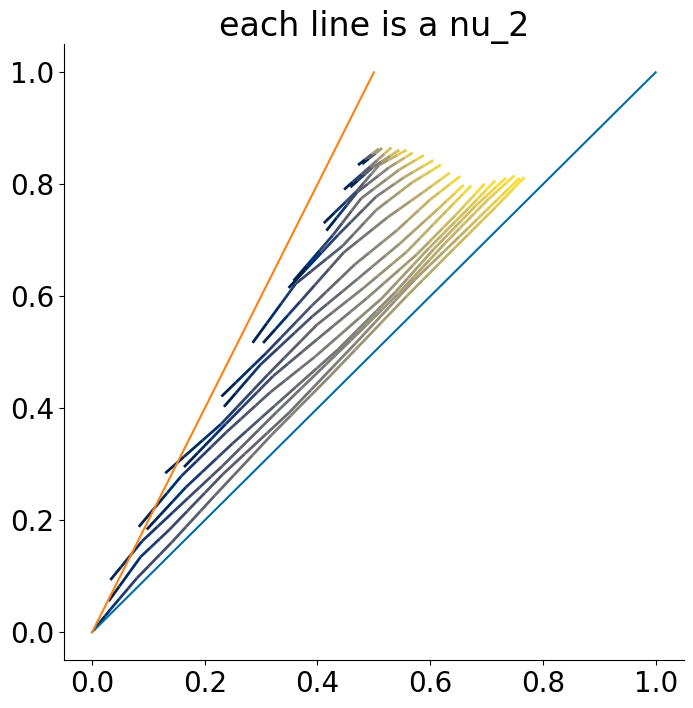

In [640]:
directed = False
do_non_overlapping_simulation = False
trigger_pairs_with_reinforcement = True
triggering_pairs_among_all_non_explored_pairs = False
look_among_all_non_explored_pairs_if_not_enough = False
trigger_links_with_new_colors_if_not_enough = False
trigger_links_between_new_colors_if_not_enough = False
Tmax = int(1e5)
dataset = get_data_new_pairs_UMT(
    rho = 10, 
    starting_nu_1 = 0, ending_nu_1 = 20,
    starting_nu_2 = 0, ending_nu_2 = None,
    fraction_nu_2_cut = 2,
    N_0 = 10, 
    M_0 = 0, 
    Tmax = Tmax,
    do_fig = True,
    t_to_use = Tmax,
    num_to_save = 1000,
    do_non_overlapping_simulation = do_non_overlapping_simulation,
    trigger_pairs_with_reinforcement = trigger_pairs_with_reinforcement,
    triggering_pairs_among_all_non_explored_pairs = triggering_pairs_among_all_non_explored_pairs,
    look_among_all_non_explored_pairs_if_not_enough = look_among_all_non_explored_pairs_if_not_enough,
    trigger_links_with_new_colors_if_not_enough = trigger_links_with_new_colors_if_not_enough, 
    trigger_links_between_new_colors_if_not_enough = trigger_links_between_new_colors_if_not_enough, 
    color_by_key = None,
    directed = directed,
)
new_pairs_UMT[(do_non_overlapping_simulation, trigger_pairs_with_reinforcement, triggering_pairs_among_all_non_explored_pairs, look_among_all_non_explored_pairs_if_not_enough, trigger_links_with_new_colors_if_not_enough, trigger_links_between_new_colors_if_not_enough,Tmax)] = dataset
print((do_non_overlapping_simulation, trigger_pairs_with_reinforcement, triggering_pairs_among_all_non_explored_pairs, look_among_all_non_explored_pairs_if_not_enough, trigger_links_with_new_colors_if_not_enough, trigger_links_between_new_colors_if_not_enough,Tmax))

  0%|          | 0/31 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/13 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/19 [00:00<?, ?it/s]

  0%|          | 0/22 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/28 [00:00<?, ?it/s]

  0%|          | 0/31 [00:00<?, ?it/s]

  0%|          | 0/34 [00:00<?, ?it/s]

  0%|          | 0/37 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/43 [00:00<?, ?it/s]

  0%|          | 0/46 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/52 [00:00<?, ?it/s]

  0%|          | 0/55 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/61 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/67 [00:00<?, ?it/s]

  0%|          | 0/70 [00:00<?, ?it/s]

  0%|          | 0/73 [00:00<?, ?it/s]

  0%|          | 0/76 [00:00<?, ?it/s]

  0%|          | 0/79 [00:00<?, ?it/s]

  0%|          | 0/82 [00:00<?, ?it/s]

  0%|          | 0/85 [00:00<?, ?it/s]

  0%|          | 0/88 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

FOUND 	62500
intercept 0.43191779117831175 slope 0.6979397101049651
p-value pearson between $\beta_1$ and $\beta_2$ 0.0
(False, True, False, False, False, False, 100000)


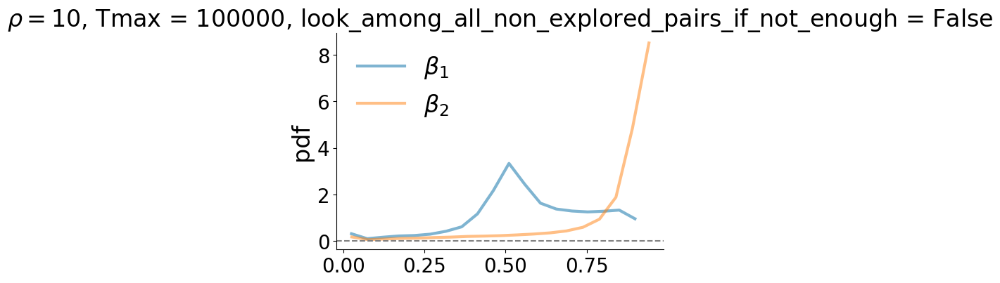

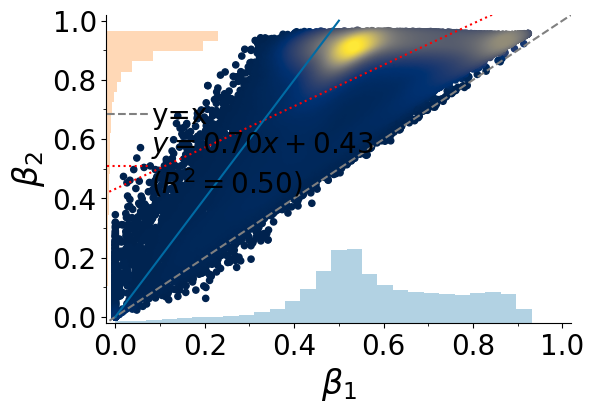

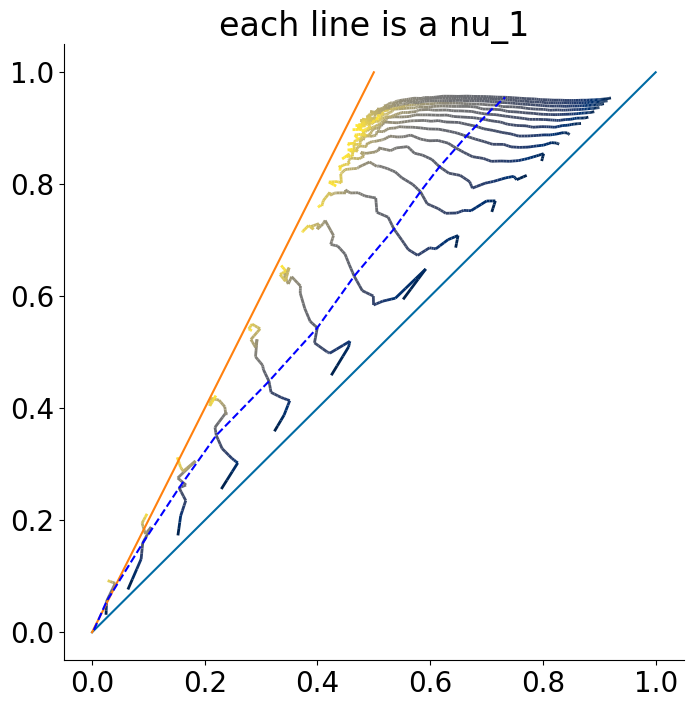

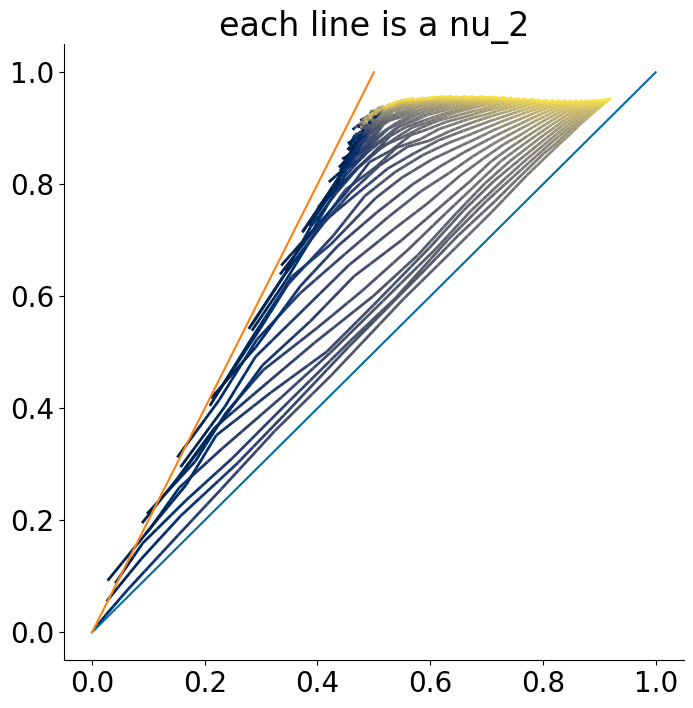

In [662]:
directed = False
do_non_overlapping_simulation = False
trigger_pairs_with_reinforcement = True
triggering_pairs_among_all_non_explored_pairs = False
look_among_all_non_explored_pairs_if_not_enough = False
trigger_links_with_new_colors_if_not_enough = False
trigger_links_between_new_colors_if_not_enough = False
Tmax = int(1e5)
dataset = get_data_new_pairs_UMT(
    rho = 10, 
    starting_nu_1 = 0, ending_nu_1 = 30,
    starting_nu_2 = 0, ending_nu_2 = None,
    fraction_nu_2_cut = 3,
    N_0 = 10, 
    M_0 = 0, 
    Tmax = Tmax,
    do_fig = True,
    t_to_use = Tmax,
    num_to_save = 1000,
    do_non_overlapping_simulation = do_non_overlapping_simulation,
    trigger_pairs_with_reinforcement = trigger_pairs_with_reinforcement,
    triggering_pairs_among_all_non_explored_pairs = triggering_pairs_among_all_non_explored_pairs,
    look_among_all_non_explored_pairs_if_not_enough = look_among_all_non_explored_pairs_if_not_enough,
    trigger_links_with_new_colors_if_not_enough = trigger_links_with_new_colors_if_not_enough, 
    trigger_links_between_new_colors_if_not_enough = trigger_links_between_new_colors_if_not_enough, 
    color_by_key = None,
    directed = directed,
)
new_pairs_UMT[(do_non_overlapping_simulation, trigger_pairs_with_reinforcement, triggering_pairs_among_all_non_explored_pairs, look_among_all_non_explored_pairs_if_not_enough, trigger_links_with_new_colors_if_not_enough, trigger_links_between_new_colors_if_not_enough,Tmax)] = dataset
print((do_non_overlapping_simulation, trigger_pairs_with_reinforcement, triggering_pairs_among_all_non_explored_pairs, look_among_all_non_explored_pairs_if_not_enough, trigger_links_with_new_colors_if_not_enough, trigger_links_between_new_colors_if_not_enough,Tmax))

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/13 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/19 [00:00<?, ?it/s]

  0%|          | 0/22 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/28 [00:00<?, ?it/s]

  0%|          | 0/31 [00:00<?, ?it/s]

  0%|          | 0/34 [00:00<?, ?it/s]

  0%|          | 0/37 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/43 [00:00<?, ?it/s]

  0%|          | 0/46 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/52 [00:00<?, ?it/s]

  0%|          | 0/55 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/61 [00:00<?, ?it/s]

FOUND 	65100
intercept 0.4465718111958865 slope 0.6815494480918849
p-value pearson between $\beta_1$ and $\beta_2$ 0.0
(False, True, False, False, False, False, 100000)


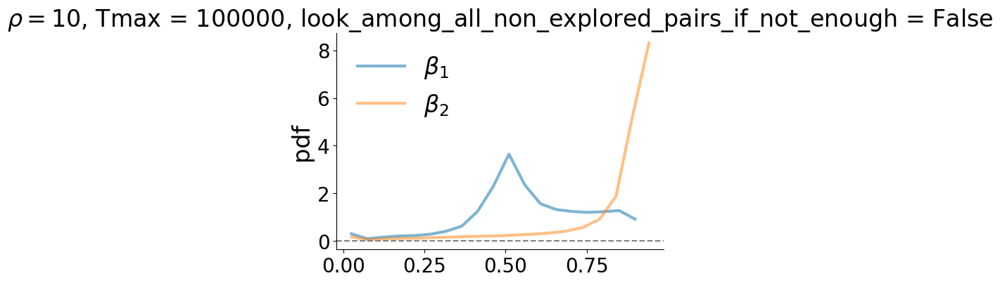

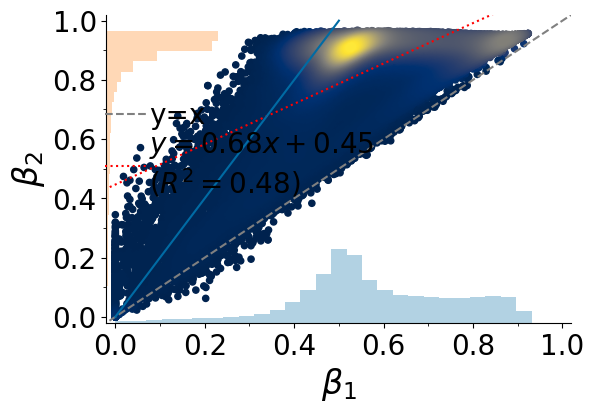

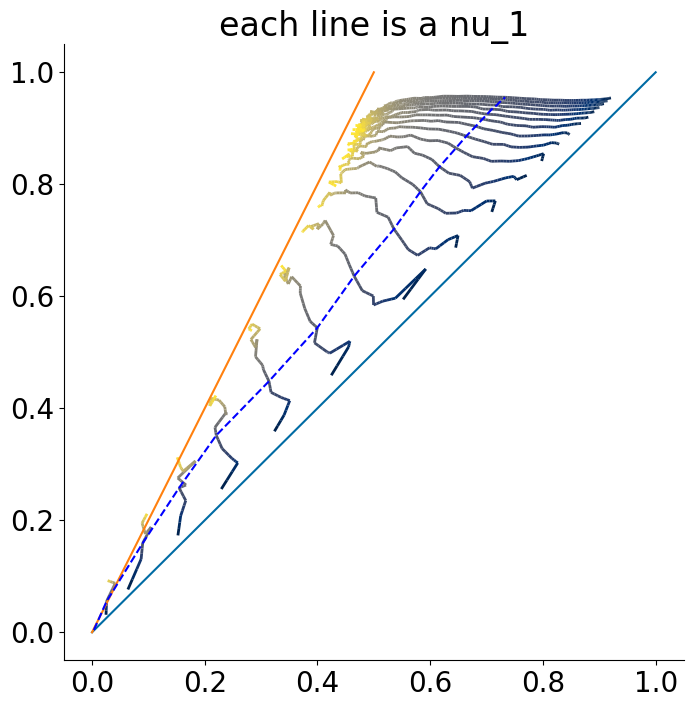

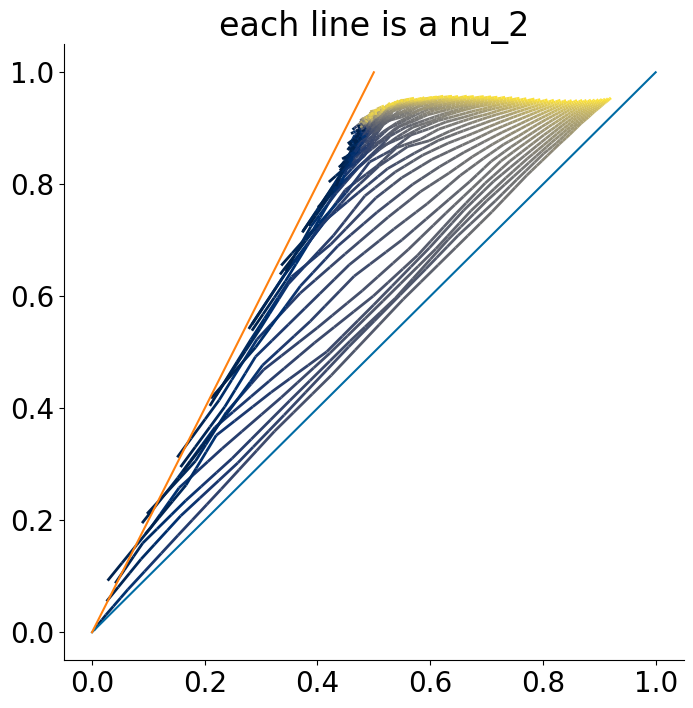

In [675]:
directed = False
do_non_overlapping_simulation = False
trigger_pairs_with_reinforcement = True
triggering_pairs_among_all_non_explored_pairs = False
look_among_all_non_explored_pairs_if_not_enough = False
trigger_links_with_new_colors_if_not_enough = False
trigger_links_between_new_colors_if_not_enough = False
Tmax = int(1e5)
dataset = get_data_new_pairs_UMT(
    rho = 10, 
    starting_nu_1 = 0, ending_nu_1 = 20,
    starting_nu_2 = 0, ending_nu_2 = None,
    fraction_nu_2_cut = 3,
    N_0 = 10, 
    M_0 = 0, 
    Tmax = Tmax,
    do_fig = True,
    t_to_use = Tmax,
    num_to_save = 1000,
    do_non_overlapping_simulation = do_non_overlapping_simulation,
    trigger_pairs_with_reinforcement = trigger_pairs_with_reinforcement,
    triggering_pairs_among_all_non_explored_pairs = triggering_pairs_among_all_non_explored_pairs,
    look_among_all_non_explored_pairs_if_not_enough = look_among_all_non_explored_pairs_if_not_enough,
    trigger_links_with_new_colors_if_not_enough = trigger_links_with_new_colors_if_not_enough, 
    trigger_links_between_new_colors_if_not_enough = trigger_links_between_new_colors_if_not_enough, 
    color_by_key = None,
    directed = directed,
)
new_pairs_UMT[(do_non_overlapping_simulation, trigger_pairs_with_reinforcement, triggering_pairs_among_all_non_explored_pairs, look_among_all_non_explored_pairs_if_not_enough, trigger_links_with_new_colors_if_not_enough, trigger_links_between_new_colors_if_not_enough,Tmax)] = dataset
print((do_non_overlapping_simulation, trigger_pairs_with_reinforcement, triggering_pairs_among_all_non_explored_pairs, look_among_all_non_explored_pairs_if_not_enough, trigger_links_with_new_colors_if_not_enough, trigger_links_between_new_colors_if_not_enough,Tmax))

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

FOUND 	36400
intercept 0.24718988865371594 slope 0.8662034620667112
p-value pearson between $\beta_1$ and $\beta_2$ 0.0
(False, True, False, False, False, False, 100000)


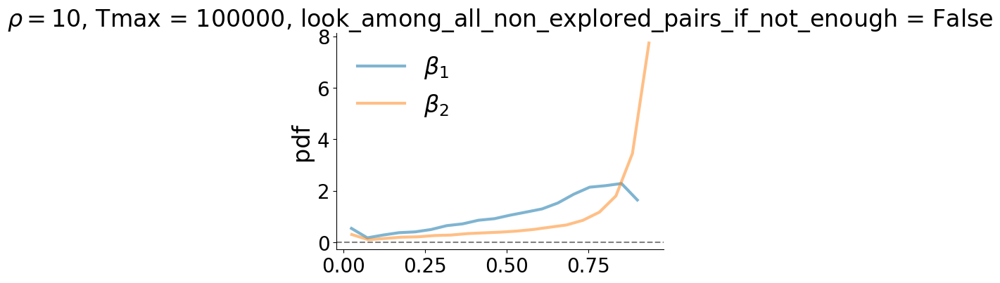

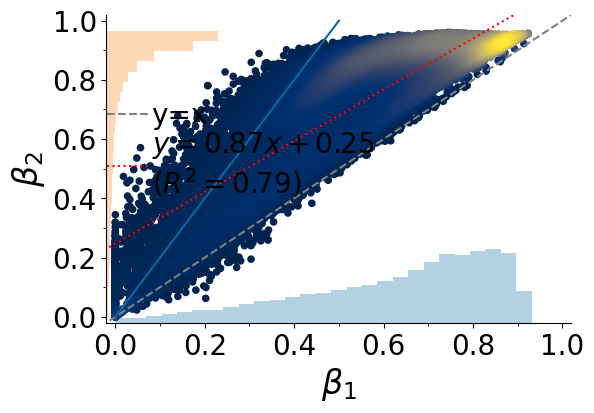

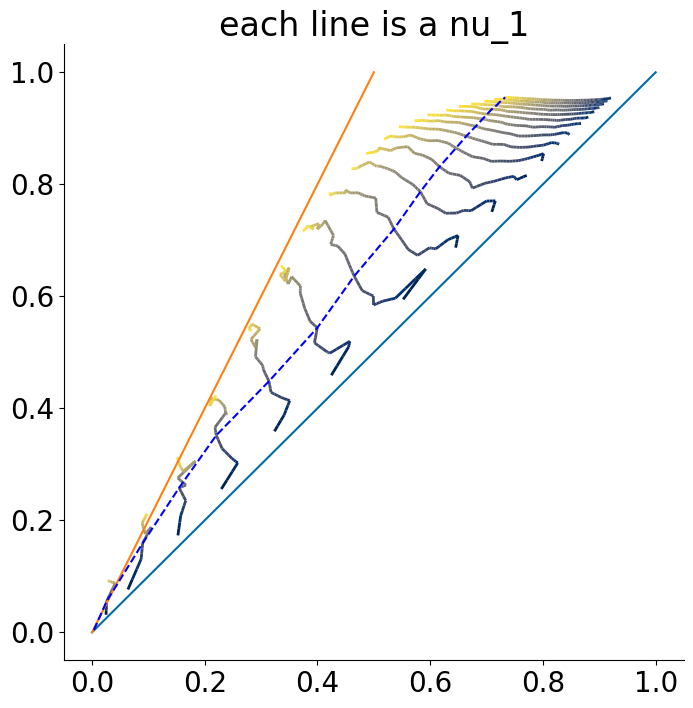

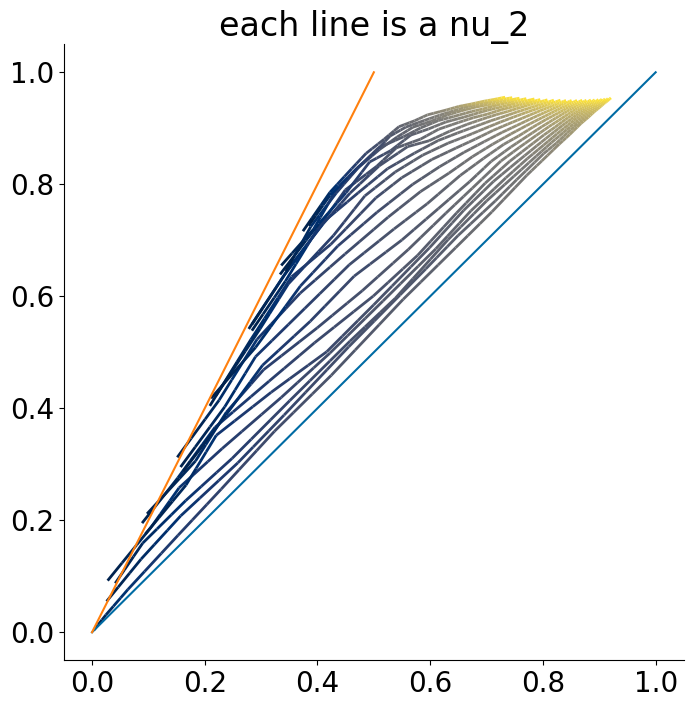

In [667]:
directed = False
do_non_overlapping_simulation = False
trigger_pairs_with_reinforcement = True
triggering_pairs_among_all_non_explored_pairs = False
look_among_all_non_explored_pairs_if_not_enough = False
trigger_links_with_new_colors_if_not_enough = False
trigger_links_between_new_colors_if_not_enough = False
Tmax = int(1e5)
dataset = get_data_new_pairs_UMT(
    rho = 10, 
    starting_nu_1 = 0, ending_nu_1 = 20,
    starting_nu_2 = 0, ending_nu_2 = 20,
    fraction_nu_2_cut = 3,
    N_0 = 10, 
    M_0 = 0, 
    Tmax = Tmax,
    do_fig = True,
    t_to_use = Tmax,
    num_to_save = 1000,
    do_non_overlapping_simulation = do_non_overlapping_simulation,
    trigger_pairs_with_reinforcement = trigger_pairs_with_reinforcement,
    triggering_pairs_among_all_non_explored_pairs = triggering_pairs_among_all_non_explored_pairs,
    look_among_all_non_explored_pairs_if_not_enough = look_among_all_non_explored_pairs_if_not_enough,
    trigger_links_with_new_colors_if_not_enough = trigger_links_with_new_colors_if_not_enough, 
    trigger_links_between_new_colors_if_not_enough = trigger_links_between_new_colors_if_not_enough, 
    color_by_key = None,
    directed = directed,
)
new_pairs_UMT[(do_non_overlapping_simulation, trigger_pairs_with_reinforcement, triggering_pairs_among_all_non_explored_pairs, look_among_all_non_explored_pairs_if_not_enough, trigger_links_with_new_colors_if_not_enough, trigger_links_between_new_colors_if_not_enough,Tmax)] = dataset
print((do_non_overlapping_simulation, trigger_pairs_with_reinforcement, triggering_pairs_among_all_non_explored_pairs, look_among_all_non_explored_pairs_if_not_enough, trigger_links_with_new_colors_if_not_enough, trigger_links_between_new_colors_if_not_enough,Tmax))

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/13 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

  0%|          | 0/17 [00:00<?, ?it/s]

  0%|          | 0/19 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/23 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/27 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/31 [00:00<?, ?it/s]

FOUND 	25600
intercept 0.22433337744753695 slope 0.943283614798861
p-value pearson between $\beta_1$ and $\beta_2$ 0.0
(False, True, False, False, False, False, 100000)


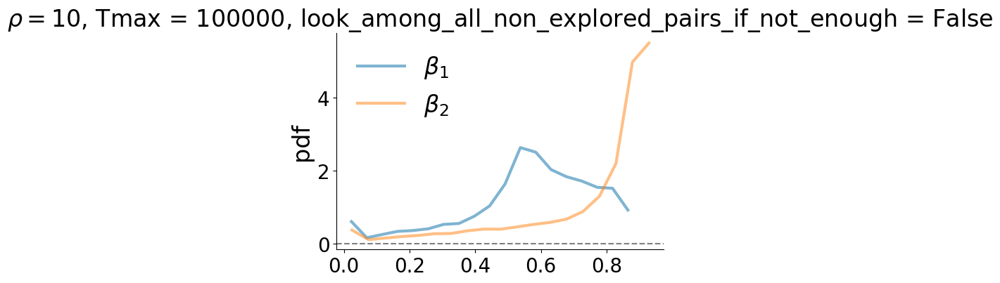

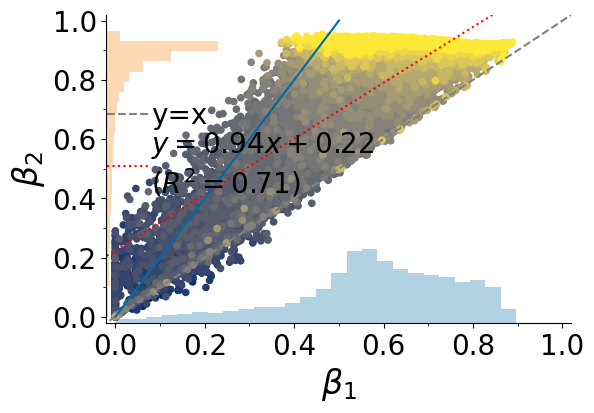

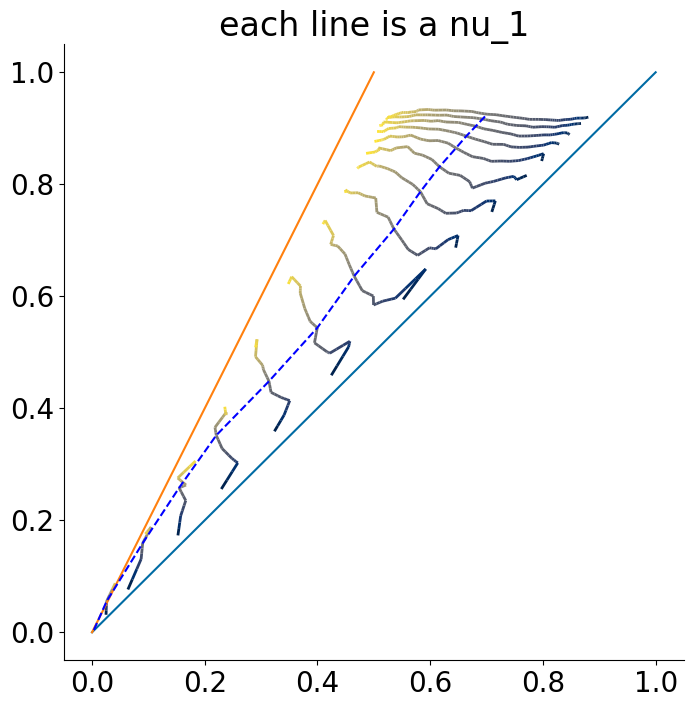

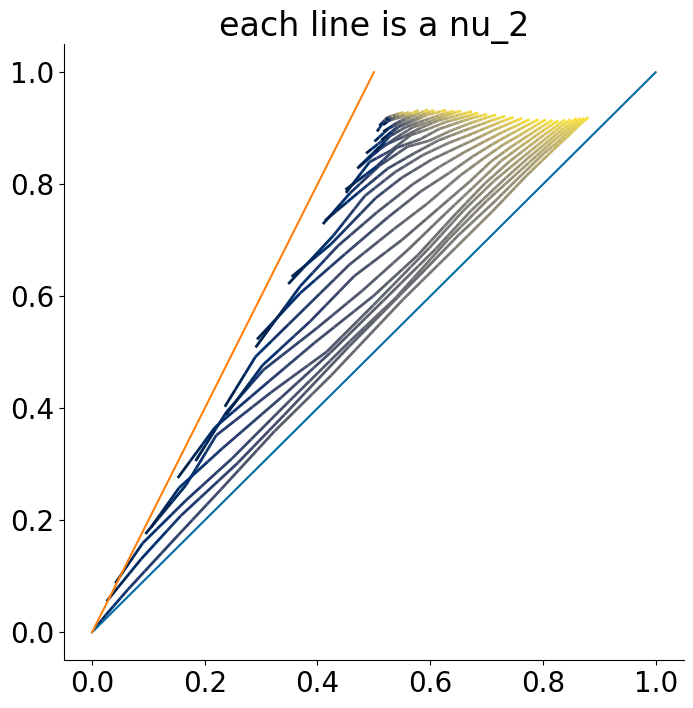

In [668]:
directed = False
do_non_overlapping_simulation = False
trigger_pairs_with_reinforcement = True
triggering_pairs_among_all_non_explored_pairs = False
look_among_all_non_explored_pairs_if_not_enough = False
trigger_links_with_new_colors_if_not_enough = False
trigger_links_between_new_colors_if_not_enough = False
Tmax = int(1e5)
dataset = get_data_new_pairs_UMT(
    rho = 10, 
    starting_nu_1 = 0, ending_nu_1 = 15,
    starting_nu_2 = 0, ending_nu_2 = None,
    fraction_nu_2_cut = 2,
    N_0 = 10, 
    M_0 = 0, 
    Tmax = Tmax,
    do_fig = True,
    t_to_use = Tmax,
    num_to_save = 1000,
    do_non_overlapping_simulation = do_non_overlapping_simulation,
    trigger_pairs_with_reinforcement = trigger_pairs_with_reinforcement,
    triggering_pairs_among_all_non_explored_pairs = triggering_pairs_among_all_non_explored_pairs,
    look_among_all_non_explored_pairs_if_not_enough = look_among_all_non_explored_pairs_if_not_enough,
    trigger_links_with_new_colors_if_not_enough = trigger_links_with_new_colors_if_not_enough, 
    trigger_links_between_new_colors_if_not_enough = trigger_links_between_new_colors_if_not_enough, 
    color_by_key = 'nu_1',
    directed = directed,
)
new_pairs_UMT[(do_non_overlapping_simulation, trigger_pairs_with_reinforcement, triggering_pairs_among_all_non_explored_pairs, look_among_all_non_explored_pairs_if_not_enough, trigger_links_with_new_colors_if_not_enough, trigger_links_between_new_colors_if_not_enough,Tmax)] = dataset
print((do_non_overlapping_simulation, trigger_pairs_with_reinforcement, triggering_pairs_among_all_non_explored_pairs, look_among_all_non_explored_pairs_if_not_enough, trigger_links_with_new_colors_if_not_enough, trigger_links_between_new_colors_if_not_enough,Tmax))

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/13 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

  0%|          | 0/17 [00:00<?, ?it/s]

  0%|          | 0/19 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/23 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/27 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/31 [00:00<?, ?it/s]

FOUND 	25600
intercept 0.22433337744753695 slope 0.943283614798861
p-value pearson between $\beta_1$ and $\beta_2$ 0.0
(False, True, False, False, False, False, 100000)


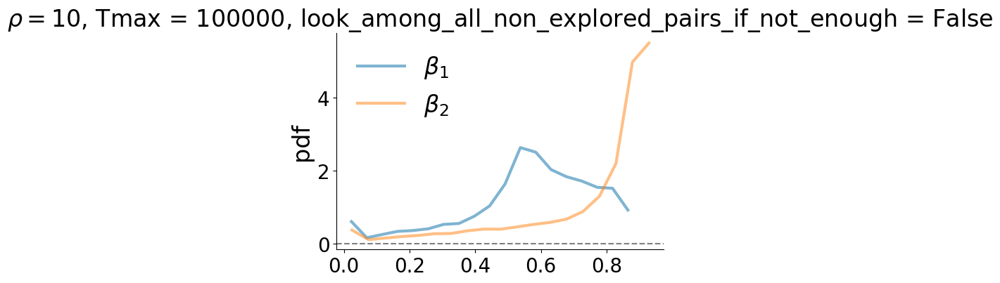

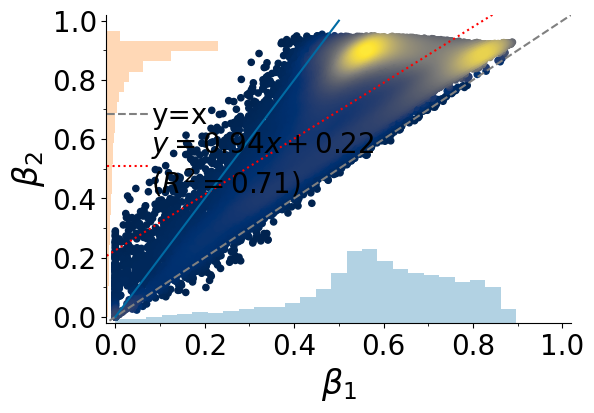

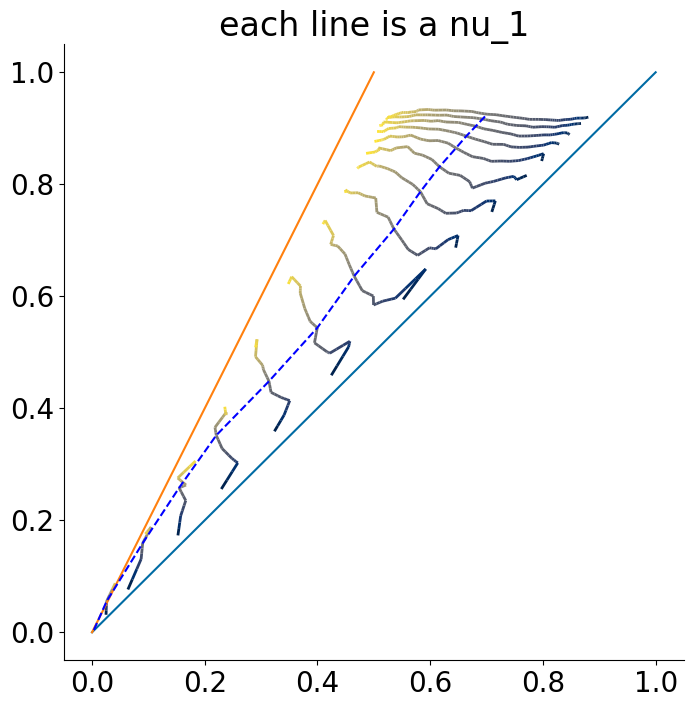

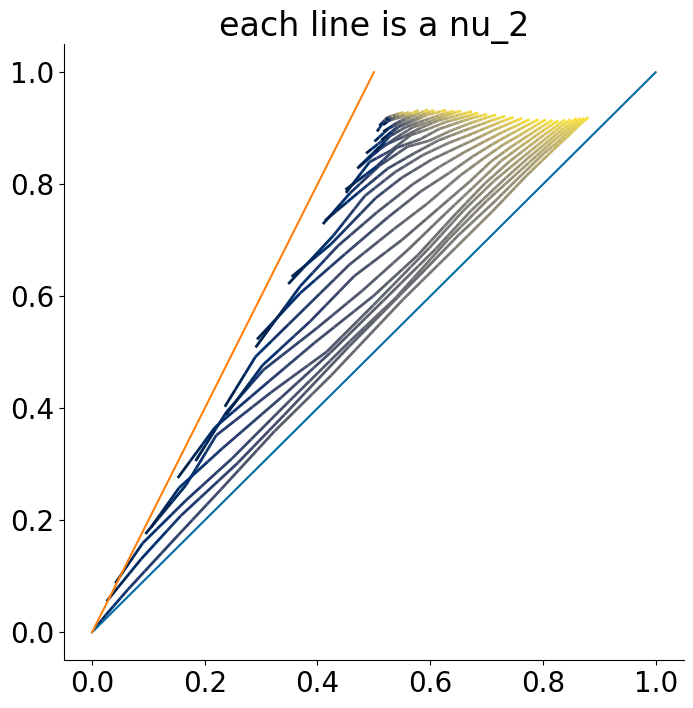

In [669]:
directed = False
do_non_overlapping_simulation = False
trigger_pairs_with_reinforcement = True
triggering_pairs_among_all_non_explored_pairs = False
look_among_all_non_explored_pairs_if_not_enough = False
trigger_links_with_new_colors_if_not_enough = False
trigger_links_between_new_colors_if_not_enough = False
Tmax = int(1e5)
dataset = get_data_new_pairs_UMT(
    rho = 10, 
    starting_nu_1 = 0, ending_nu_1 = 15,
    starting_nu_2 = 0, ending_nu_2 = None,
    fraction_nu_2_cut = 2,
    N_0 = 10, 
    M_0 = 0, 
    Tmax = Tmax,
    do_fig = True,
    t_to_use = Tmax,
    num_to_save = 1000,
    do_non_overlapping_simulation = do_non_overlapping_simulation,
    trigger_pairs_with_reinforcement = trigger_pairs_with_reinforcement,
    triggering_pairs_among_all_non_explored_pairs = triggering_pairs_among_all_non_explored_pairs,
    look_among_all_non_explored_pairs_if_not_enough = look_among_all_non_explored_pairs_if_not_enough,
    trigger_links_with_new_colors_if_not_enough = trigger_links_with_new_colors_if_not_enough, 
    trigger_links_between_new_colors_if_not_enough = trigger_links_between_new_colors_if_not_enough, 
    color_by_key = None,
    directed = directed,
)
new_pairs_UMT[(do_non_overlapping_simulation, trigger_pairs_with_reinforcement, triggering_pairs_among_all_non_explored_pairs, look_among_all_non_explored_pairs_if_not_enough, trigger_links_with_new_colors_if_not_enough, trigger_links_between_new_colors_if_not_enough,Tmax)] = dataset
print((do_non_overlapping_simulation, trigger_pairs_with_reinforcement, triggering_pairs_among_all_non_explored_pairs, look_among_all_non_explored_pairs_if_not_enough, trigger_links_with_new_colors_if_not_enough, trigger_links_between_new_colors_if_not_enough,Tmax))

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/13 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

  0%|          | 0/17 [00:00<?, ?it/s]

  0%|          | 0/19 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/23 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/27 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/31 [00:00<?, ?it/s]

  0%|          | 0/33 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/37 [00:00<?, ?it/s]

  0%|          | 0/39 [00:00<?, ?it/s]

  0%|          | 0/41 [00:00<?, ?it/s]

FOUND 	44100
intercept 0.3321969223657564 slope 0.7994185437274453
p-value pearson between $\beta_1$ and $\beta_2$ 0.0
(False, True, False, False, False, False, 100000)


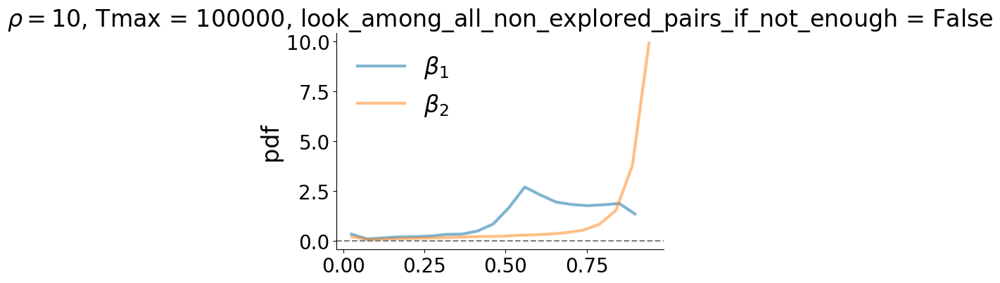

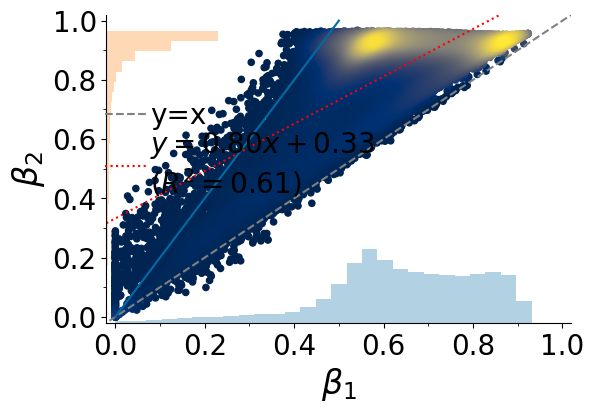

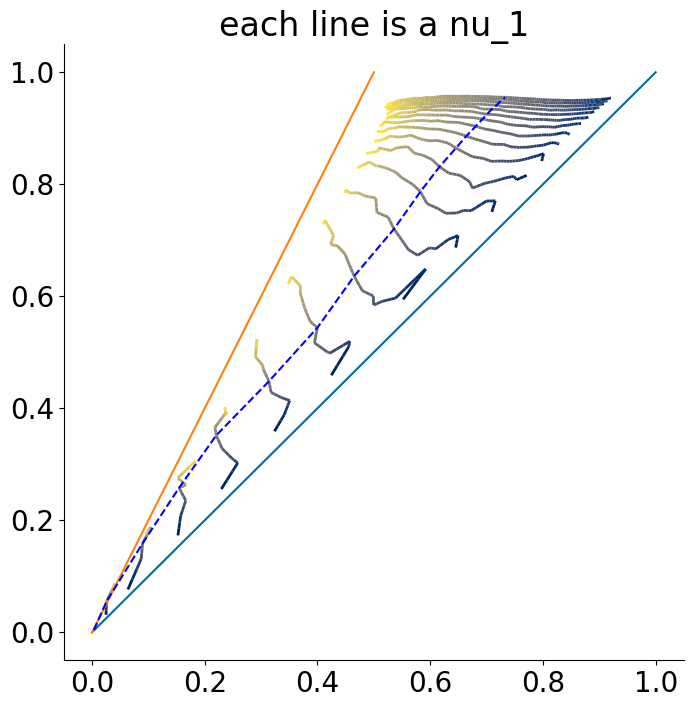

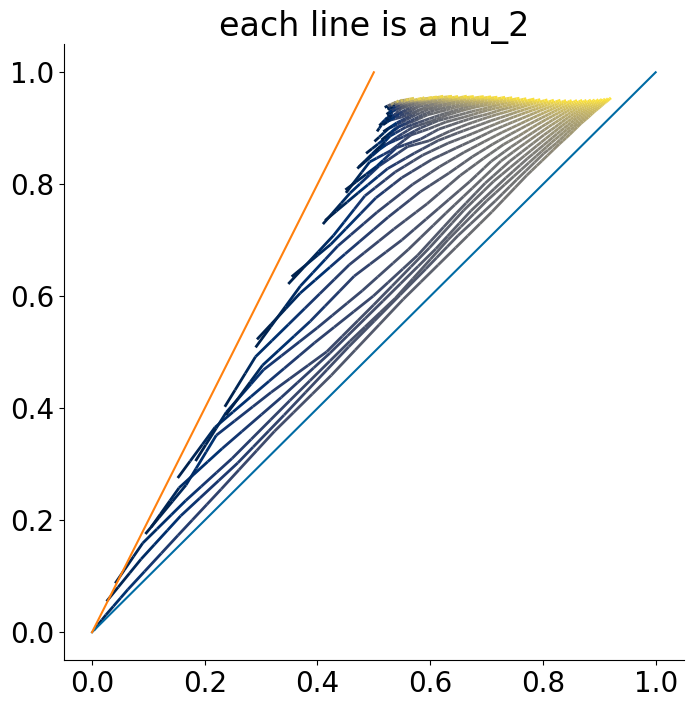

In [670]:
directed = False
do_non_overlapping_simulation = False
trigger_pairs_with_reinforcement = True
triggering_pairs_among_all_non_explored_pairs = False
look_among_all_non_explored_pairs_if_not_enough = False
trigger_links_with_new_colors_if_not_enough = False
trigger_links_between_new_colors_if_not_enough = False
Tmax = int(1e5)
dataset = get_data_new_pairs_UMT(
    rho = 10, 
    starting_nu_1 = 0, ending_nu_1 = 20,
    starting_nu_2 = 0, ending_nu_2 = None,
    fraction_nu_2_cut = 2,
    N_0 = 10, 
    M_0 = 0, 
    Tmax = Tmax,
    do_fig = True,
    t_to_use = Tmax,
    num_to_save = 1000,
    do_non_overlapping_simulation = do_non_overlapping_simulation,
    trigger_pairs_with_reinforcement = trigger_pairs_with_reinforcement,
    triggering_pairs_among_all_non_explored_pairs = triggering_pairs_among_all_non_explored_pairs,
    look_among_all_non_explored_pairs_if_not_enough = look_among_all_non_explored_pairs_if_not_enough,
    trigger_links_with_new_colors_if_not_enough = trigger_links_with_new_colors_if_not_enough, 
    trigger_links_between_new_colors_if_not_enough = trigger_links_between_new_colors_if_not_enough, 
    color_by_key = None,
    directed = directed,
)
new_pairs_UMT[(do_non_overlapping_simulation, trigger_pairs_with_reinforcement, triggering_pairs_among_all_non_explored_pairs, look_among_all_non_explored_pairs_if_not_enough, trigger_links_with_new_colors_if_not_enough, trigger_links_between_new_colors_if_not_enough,Tmax)] = dataset
print((do_non_overlapping_simulation, trigger_pairs_with_reinforcement, triggering_pairs_among_all_non_explored_pairs, look_among_all_non_explored_pairs_if_not_enough, trigger_links_with_new_colors_if_not_enough, trigger_links_between_new_colors_if_not_enough,Tmax))

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/13 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

  0%|          | 0/17 [00:00<?, ?it/s]

  0%|          | 0/19 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

FOUND 	12100
intercept 0.2631872864134901 slope 0.9076238484222179
p-value pearson between $\beta_1$ and $\beta_2$ 0.0
(False, True, False, False, False, False, 100000)


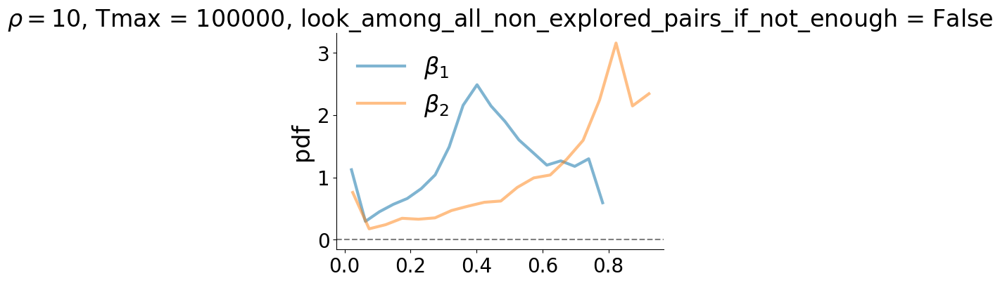

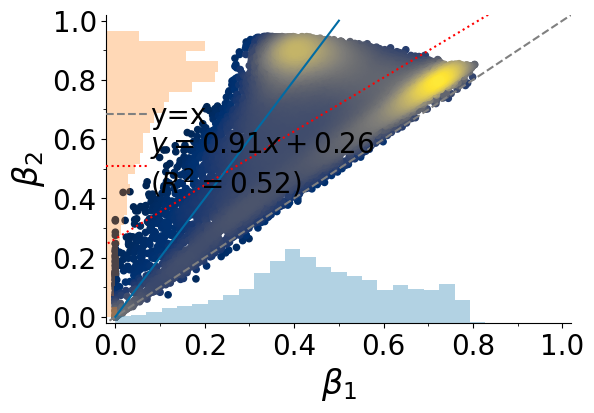

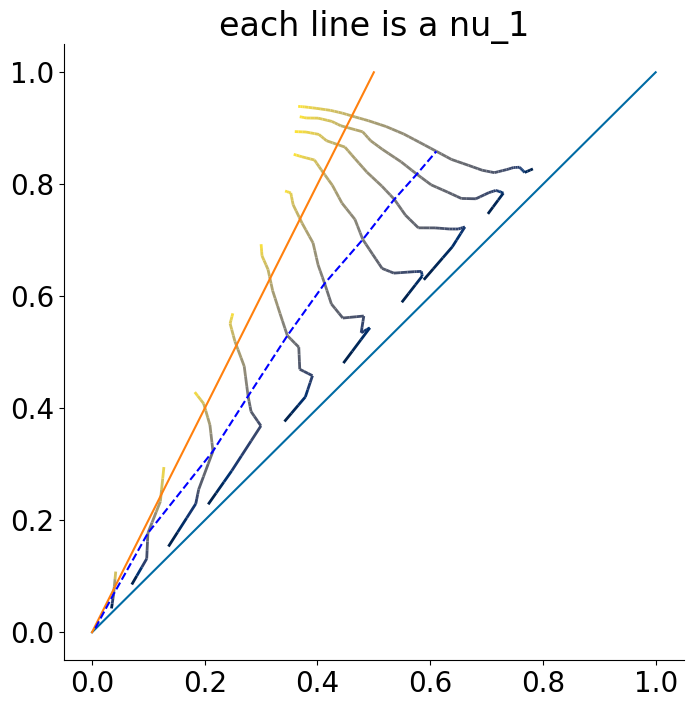

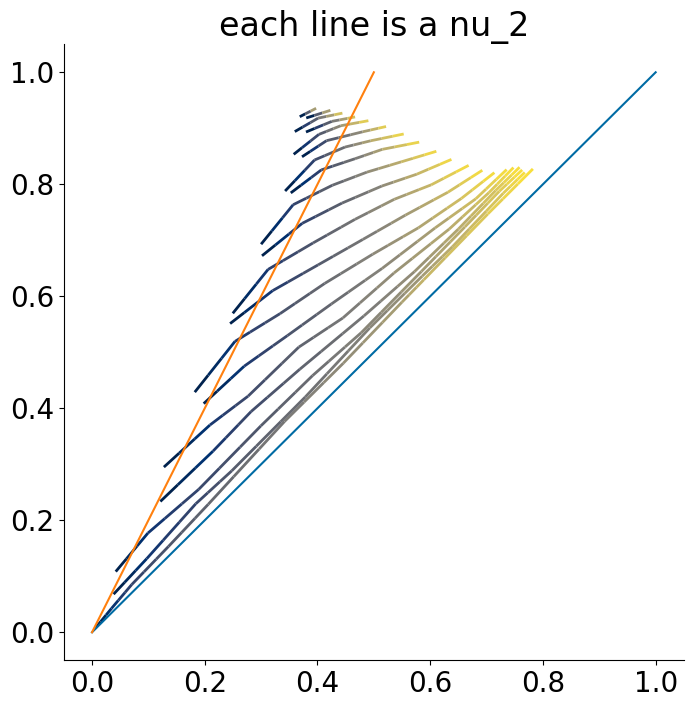

In [671]:
directed = False
do_non_overlapping_simulation = False
trigger_pairs_with_reinforcement = True
triggering_pairs_among_all_non_explored_pairs = False
look_among_all_non_explored_pairs_if_not_enough = False
trigger_links_with_new_colors_if_not_enough = False
trigger_links_between_new_colors_if_not_enough = False
Tmax = int(1e5)
dataset = get_data_new_pairs_UMT(
    rho = 10, 
    starting_nu_1 = 0, ending_nu_1 = 10,
    starting_nu_2 = 0, ending_nu_2 = None,
    fraction_nu_2_cut = 2,
    N_0 = 100, 
    M_0 = 0, 
    Tmax = Tmax,
    do_fig = True,
    t_to_use = Tmax,
    num_to_save = 1000,
    do_non_overlapping_simulation = do_non_overlapping_simulation,
    trigger_pairs_with_reinforcement = trigger_pairs_with_reinforcement,
    triggering_pairs_among_all_non_explored_pairs = triggering_pairs_among_all_non_explored_pairs,
    look_among_all_non_explored_pairs_if_not_enough = look_among_all_non_explored_pairs_if_not_enough,
    trigger_links_with_new_colors_if_not_enough = trigger_links_with_new_colors_if_not_enough, 
    trigger_links_between_new_colors_if_not_enough = trigger_links_between_new_colors_if_not_enough, 
    color_by_key = None,
    directed = directed,
)
new_pairs_UMT[(do_non_overlapping_simulation, trigger_pairs_with_reinforcement, triggering_pairs_among_all_non_explored_pairs, look_among_all_non_explored_pairs_if_not_enough, trigger_links_with_new_colors_if_not_enough, trigger_links_between_new_colors_if_not_enough,Tmax)] = dataset
print((do_non_overlapping_simulation, trigger_pairs_with_reinforcement, triggering_pairs_among_all_non_explored_pairs, look_among_all_non_explored_pairs_if_not_enough, trigger_links_with_new_colors_if_not_enough, trigger_links_between_new_colors_if_not_enough,Tmax))

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

FOUND 	1200
intercept 0.8990101165215911 slope 0.054495174461021034
p-value pearson between $\beta_1$ and $\beta_2$ 2.574985766133739e-07
(False, True, False, False, False, False, 100000)


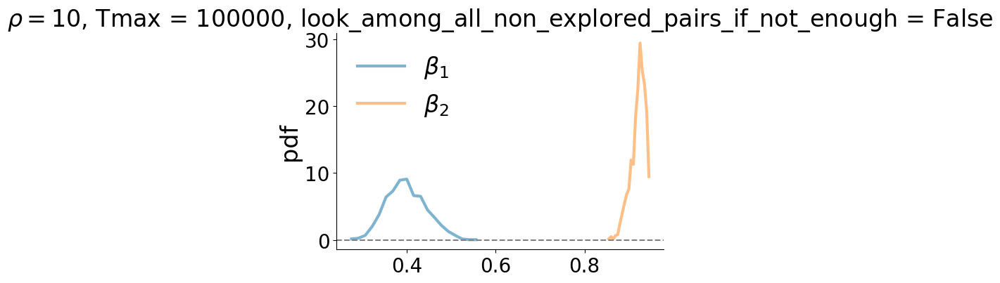

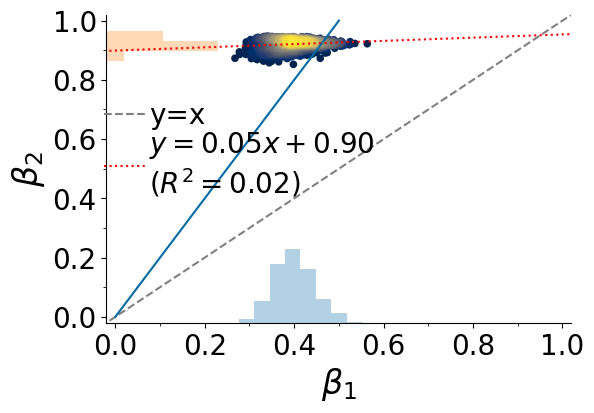

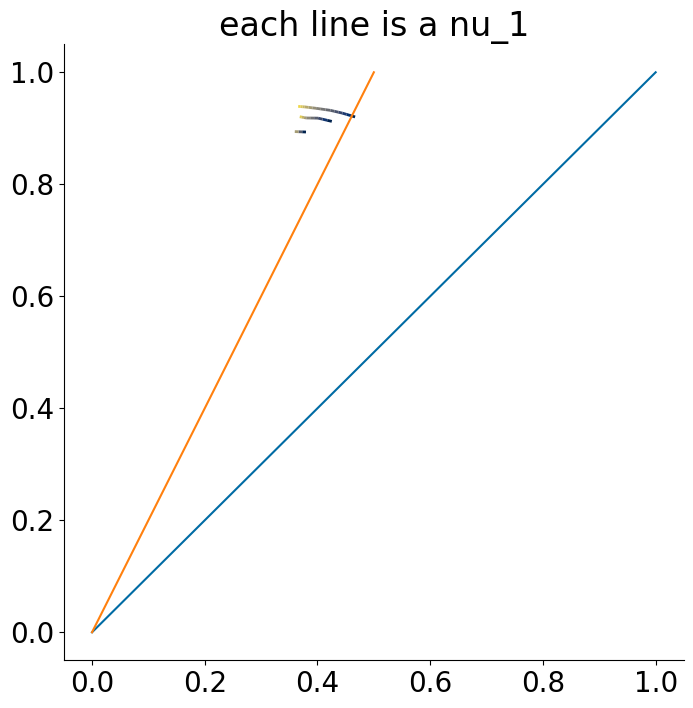

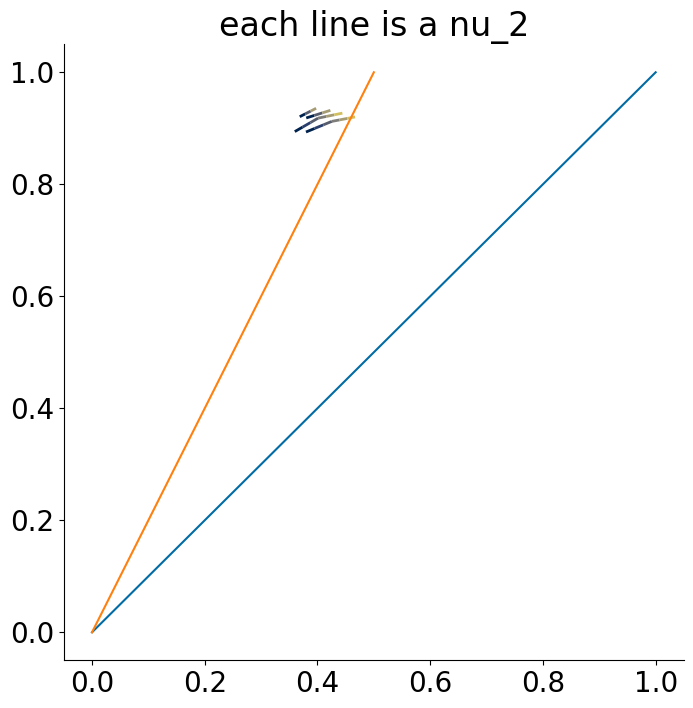

In [676]:
directed = False
do_non_overlapping_simulation = False
trigger_pairs_with_reinforcement = True
triggering_pairs_among_all_non_explored_pairs = False
look_among_all_non_explored_pairs_if_not_enough = False
trigger_links_with_new_colors_if_not_enough = False
trigger_links_between_new_colors_if_not_enough = False
Tmax = int(1e5)
dataset = get_data_new_pairs_UMT(
    rho = 10, 
    starting_nu_1 = 0, ending_nu_1 = 10,
    starting_nu_2 = 15, ending_nu_2 = 20,
    fraction_nu_2_cut = 2,
    N_0 = 100, 
    M_0 = 0, 
    Tmax = Tmax,
    do_fig = True,
    t_to_use = Tmax,
    num_to_save = 1000,
    do_non_overlapping_simulation = do_non_overlapping_simulation,
    trigger_pairs_with_reinforcement = trigger_pairs_with_reinforcement,
    triggering_pairs_among_all_non_explored_pairs = triggering_pairs_among_all_non_explored_pairs,
    look_among_all_non_explored_pairs_if_not_enough = look_among_all_non_explored_pairs_if_not_enough,
    trigger_links_with_new_colors_if_not_enough = trigger_links_with_new_colors_if_not_enough, 
    trigger_links_between_new_colors_if_not_enough = trigger_links_between_new_colors_if_not_enough, 
    color_by_key = None,
    directed = directed,
)
new_pairs_UMT[(do_non_overlapping_simulation, trigger_pairs_with_reinforcement, triggering_pairs_among_all_non_explored_pairs, look_among_all_non_explored_pairs_if_not_enough, trigger_links_with_new_colors_if_not_enough, trigger_links_between_new_colors_if_not_enough,Tmax)] = dataset
print((do_non_overlapping_simulation, trigger_pairs_with_reinforcement, triggering_pairs_among_all_non_explored_pairs, look_among_all_non_explored_pairs_if_not_enough, trigger_links_with_new_colors_if_not_enough, trigger_links_between_new_colors_if_not_enough,Tmax))

In [673]:
for nu_1 in range(30):
    for nu_2 in range(3*nu_1 + 1):
        try:
            if dataset[0][nu_1][nu_2]['average_counter_times_not_enough'] > 0:
                print(nu_1, nu_2, dataset[0][nu_1][nu_2]['average_D2_indices'][-1], dataset[0][nu_1][nu_2]['average_counter_times_not_enough'], flush=True)
        except:
            pass

1 2 21.05 0.05


In [365]:
dataset[0][10][15]['average_D2_indices'][-1]

22413.55

In [366]:
dataset[0][10][15]['average_counter_times_not_enough_with_extracted']

2821.76

In [367]:
dataset[0][10][15]['average_counter_times_not_enough_among_extracted']

0.0

In [465]:
nu_1 = 10
nu_2 = 10
dataset[0][nu_1][nu_2]['average_D2_indices'][-1], dataset[0][nu_1][nu_2]['average_counter_times_not_enough_with_extracted'], dataset[0][nu_1][nu_2]['average_counter_times_not_enough_among_extracted']

(22344.08, 178.93, 0.0)

In [440]:
directed = False
do_non_overlapping_simulation = True
trigger_pairs_with_reinforcement = True
triggering_pairs_among_all_non_explored_pairs = False
look_among_all_non_explored_pairs_if_not_enough = False
trigger_links_with_new_colors_if_not_enough = False
trigger_links_between_new_colors_if_not_enough = False
Tmax = int(1e5)
dataset = get_data_new_pairs_UMT(
    rho = 10, 
    starting_nu_1 = 0, ending_nu_1 = 20,
    starting_nu_2 = 0, ending_nu_2 = None,
    fraction_nu_2_cut = 2,
    N_0 = 1, 
    M_0 = 0, 
    Tmax = Tmax,
    do_fig = True,
    t_to_use = Tmax,
    num_to_save = 1000,
    do_non_overlapping_simulation = do_non_overlapping_simulation,
    trigger_pairs_with_reinforcement = trigger_pairs_with_reinforcement,
    triggering_pairs_among_all_non_explored_pairs = triggering_pairs_among_all_non_explored_pairs,
    look_among_all_non_explored_pairs_if_not_enough = look_among_all_non_explored_pairs_if_not_enough,
    trigger_links_with_new_colors_if_not_enough = trigger_links_with_new_colors_if_not_enough, 
    trigger_links_between_new_colors_if_not_enough = trigger_links_between_new_colors_if_not_enough, 
    color_by_key = None,
    directed = directed,
)
new_pairs_UMT[(do_non_overlapping_simulation, look_among_all_non_explored_pairs_if_not_enough, trigger_links_with_new_colors_if_not_enough, trigger_links_between_new_colors_if_not_enough,Tmax)] = dataset

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/13 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

  0%|          | 0/17 [00:00<?, ?it/s]

  0%|          | 0/19 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/23 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/27 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/31 [00:00<?, ?it/s]

  0%|          | 0/33 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/37 [00:00<?, ?it/s]

  0%|          | 0/39 [00:00<?, ?it/s]

  0%|          | 0/41 [00:00<?, ?it/s]

FOUND 	0


In [369]:
dataset[0][10][15]['average_D2_indices'][-1]

KeyError: 15

In [ ]:
dataset[0][10][15]['average_counter_times_not_enough_with_extracted']

In [ ]:
dataset[0][10][15]['average_counter_times_not_enough_among_extracted']

In [445]:
directed = False
do_non_overlapping_simulation = False
trigger_pairs_with_reinforcement = True
triggering_pairs_among_all_non_explored_pairs = True
look_among_all_non_explored_pairs_if_not_enough = False
trigger_links_with_new_colors_if_not_enough = False
trigger_links_between_new_colors_if_not_enough = False
Tmax = int(1e5)
dataset = get_data_new_pairs_UMT(
    rho = 10, 
    starting_nu_1 = 0, ending_nu_1 = 20,
    starting_nu_2 = 0, ending_nu_2 = None,
    fraction_nu_2_cut = 2,
    N_0 = 1, 
    M_0 = 0, 
    Tmax = Tmax,
    do_fig = True,
    t_to_use = Tmax,
    num_to_save = 1000,
    do_non_overlapping_simulation = do_non_overlapping_simulation,
    trigger_pairs_with_reinforcement = trigger_pairs_with_reinforcement,
    triggering_pairs_among_all_non_explored_pairs = triggering_pairs_among_all_non_explored_pairs,
    look_among_all_non_explored_pairs_if_not_enough = look_among_all_non_explored_pairs_if_not_enough,
    trigger_links_with_new_colors_if_not_enough = trigger_links_with_new_colors_if_not_enough, 
    trigger_links_between_new_colors_if_not_enough = trigger_links_between_new_colors_if_not_enough, 
    color_by_key = None,
    directed = directed,
)
new_pairs_UMT[(do_non_overlapping_simulation, look_among_all_non_explored_pairs_if_not_enough, trigger_links_with_new_colors_if_not_enough, trigger_links_between_new_colors_if_not_enough,Tmax)] = dataset

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/13 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

  0%|          | 0/17 [00:00<?, ?it/s]

  0%|          | 0/19 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/23 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/27 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/31 [00:00<?, ?it/s]

  0%|          | 0/33 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/37 [00:00<?, ?it/s]

  0%|          | 0/39 [00:00<?, ?it/s]

  0%|          | 0/41 [00:00<?, ?it/s]

FOUND 	0


In [437]:
dataset[0][10][15]['average_D2_indices'][-1]

22413.55

In [438]:
dataset[0][10][15]['average_counter_times_not_enough_with_extracted']

2821.76

In [439]:
dataset[0][10][15]['average_counter_times_not_enough_among_extracted']

0.0

In [442]:
directed = False
do_non_overlapping_simulation = True
trigger_pairs_with_reinforcement = True
triggering_pairs_among_all_non_explored_pairs = True
look_among_all_non_explored_pairs_if_not_enough = False
trigger_links_with_new_colors_if_not_enough = False
trigger_links_between_new_colors_if_not_enough = False
Tmax = int(1e5)
dataset = get_data_new_pairs_UMT(
    rho = 10, 
    starting_nu_1 = 0, ending_nu_1 = 20,
    starting_nu_2 = 0, ending_nu_2 = None,
    fraction_nu_2_cut = 2,
    N_0 = 1, 
    M_0 = 0, 
    Tmax = Tmax,
    do_fig = True,
    t_to_use = Tmax,
    num_to_save = 1000,
    do_non_overlapping_simulation = do_non_overlapping_simulation,
    trigger_pairs_with_reinforcement = trigger_pairs_with_reinforcement,
    triggering_pairs_among_all_non_explored_pairs = triggering_pairs_among_all_non_explored_pairs,
    look_among_all_non_explored_pairs_if_not_enough = look_among_all_non_explored_pairs_if_not_enough,
    trigger_links_with_new_colors_if_not_enough = trigger_links_with_new_colors_if_not_enough, 
    trigger_links_between_new_colors_if_not_enough = trigger_links_between_new_colors_if_not_enough, 
    color_by_key = None,
    directed = directed,
)
new_pairs_UMT[(do_non_overlapping_simulation, look_among_all_non_explored_pairs_if_not_enough, trigger_links_with_new_colors_if_not_enough, trigger_links_between_new_colors_if_not_enough,Tmax)] = dataset

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/13 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

  0%|          | 0/17 [00:00<?, ?it/s]

  0%|          | 0/19 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/23 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/27 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/31 [00:00<?, ?it/s]

  0%|          | 0/33 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/37 [00:00<?, ?it/s]

  0%|          | 0/39 [00:00<?, ?it/s]

  0%|          | 0/41 [00:00<?, ?it/s]

FOUND 	0


In [369]:
dataset[0][10][15]['average_D2_indices'][-1]

KeyError: 15

In [ ]:
dataset[0][10][15]['average_counter_times_not_enough_with_extracted']

In [ ]:
dataset[0][10][15]['average_counter_times_not_enough_among_extracted']

#### Undirected, star initialization, nu_2 up to nu_1, no add_nu_2_not_1

##### Checking up to 2*nu_1

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/13 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

  0%|          | 0/17 [00:00<?, ?it/s]

  0%|          | 0/19 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/23 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/27 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/31 [00:00<?, ?it/s]

  0%|          | 0/33 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/37 [00:00<?, ?it/s]

  0%|          | 0/39 [00:00<?, ?it/s]

  0%|          | 0/41 [00:00<?, ?it/s]

FOUND 	33840
intercept 0.19815763430862027 slope 0.9666473680402146
p-value pearson between $\beta_1$ and $\beta_2$ 0.0


/tmp/2852511.1.all.q/ipykernel_32443/408663478.py:162: RuntimeWarning: divide by zero encountered in true_divide
  z = x / y


intercept 0.13733067462363688 slope 0.36939607767464355
p-value pearson between expected_betas and $\beta_1$ 0.0
intercept 0.2878468593893626 slope 0.39176656795141457
p-value pearson between expected_betas and $\beta_2$ 0.0
intercept 0.13733067462363688 slope 0.36939607767464355
p-value pearson between $exp. \beta_1$ and $\beta_1$ 0.0
intercept 0.6073094918454538 slope 0.2429233736869591
p-value pearson between $exp. \beta_2$ and $\beta_2$ 0.0


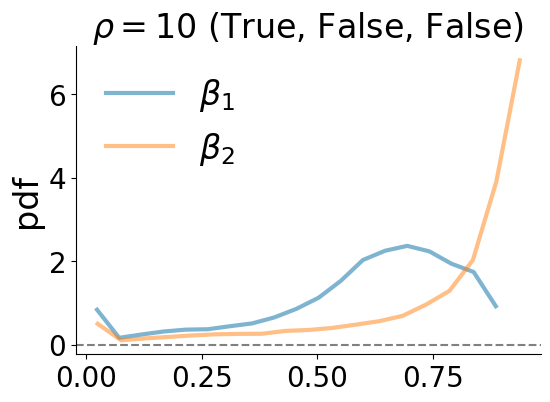

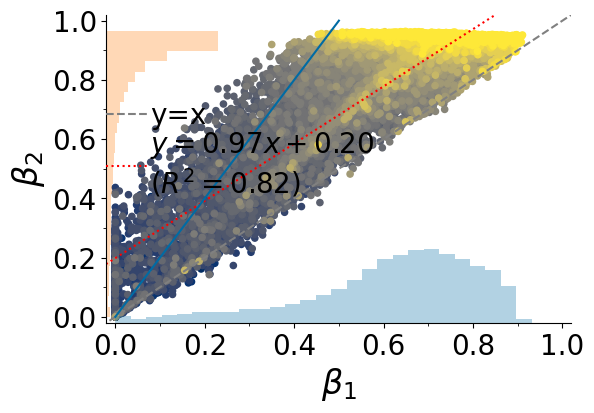

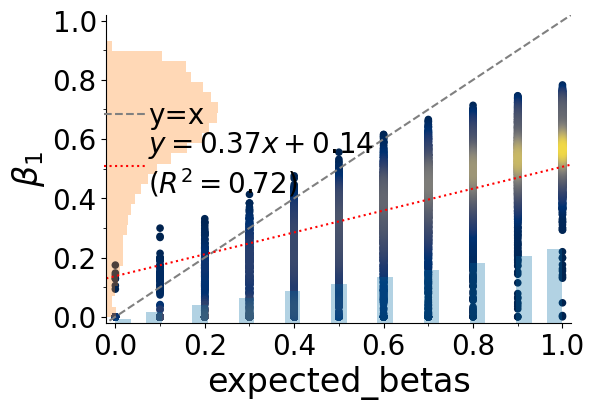

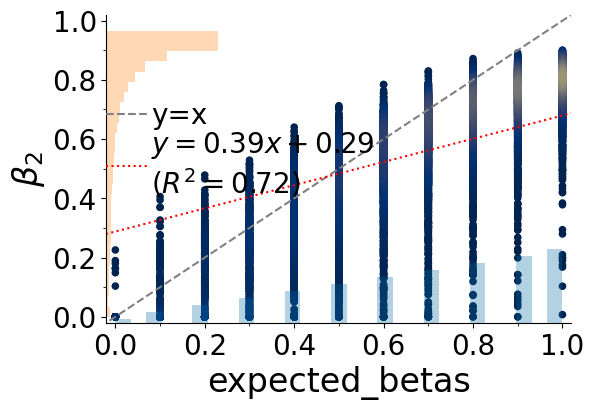

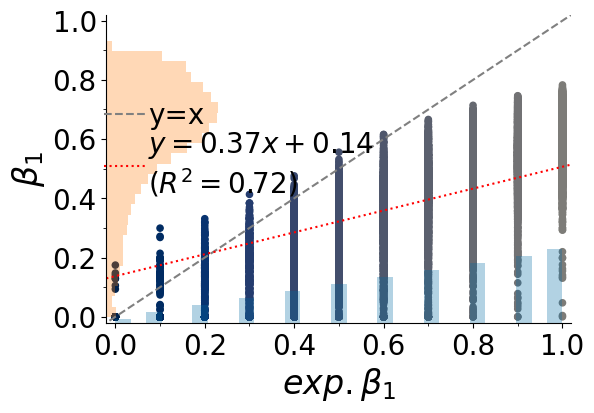

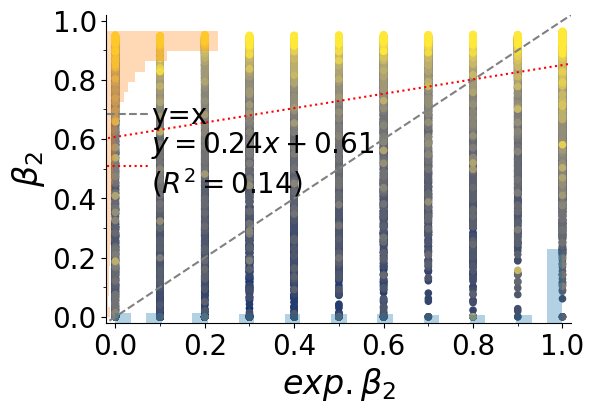

In [200]:
for look_only_among_extracted_colors in [True]:
    for add_nu_2_not_1 in [False]:
        attach_new_colors_to_random = False
        directed = False
        dataset = get_data_new_pairs_UMT(
            rho = 10, 
            starting_nu_1 = 0, ending_nu_1 = 20,
            starting_nu_2 = 0, ending_nu_2 = None,
            N_0 = 1, 
            M_0 = 0, 
            Tmax = int(1e4),
            do_fig = True,
            t_to_use = 1e5,
            num_to_save = 1000,
            look_only_among_extracted_colors = look_only_among_extracted_colors,
            add_nu_2_not_1 = add_nu_2_not_1,
            attach_new_colors_to_random = attach_new_colors_to_random,
            color_by_key = 'expected_betas',
            directed = directed,
        )
        new_pairs_UMT[(1,0)] = dataset

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/13 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

  0%|          | 0/17 [00:00<?, ?it/s]

  0%|          | 0/19 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/23 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/27 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/31 [00:00<?, ?it/s]

  0%|          | 0/33 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/37 [00:00<?, ?it/s]

  0%|          | 0/39 [00:00<?, ?it/s]

  0%|          | 0/41 [00:00<?, ?it/s]

FOUND 	33840
intercept 0.19815763430862027 slope 0.9666473680402146
p-value pearson between $\beta_1$ and $\beta_2$ 0.0


/tmp/2852511.1.all.q/ipykernel_32443/3321529597.py:163: RuntimeWarning: divide by zero encountered in true_divide
  z = x / y


intercept 0.13733067462363688 slope 0.36939607767464355
p-value pearson between expected_betas and $\beta_1$ 0.0
intercept 0.2878468593893626 slope 0.39176656795141457
p-value pearson between expected_betas and $\beta_2$ 0.0
intercept 0.13733067462363688 slope 0.36939607767464355
p-value pearson between $exp. \beta_1$ and $\beta_1$ 0.0
intercept 0.6073094918454538 slope 0.2429233736869591
p-value pearson between $exp. \beta_2$ and $\beta_2$ 0.0


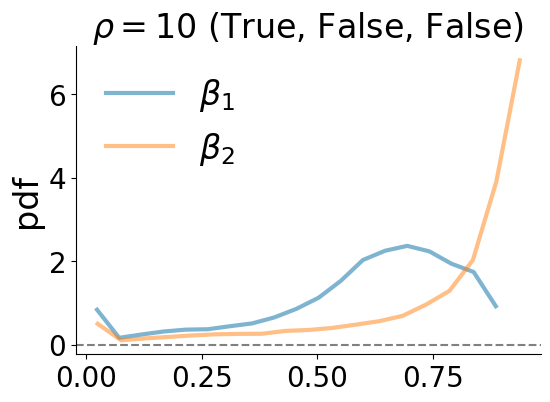

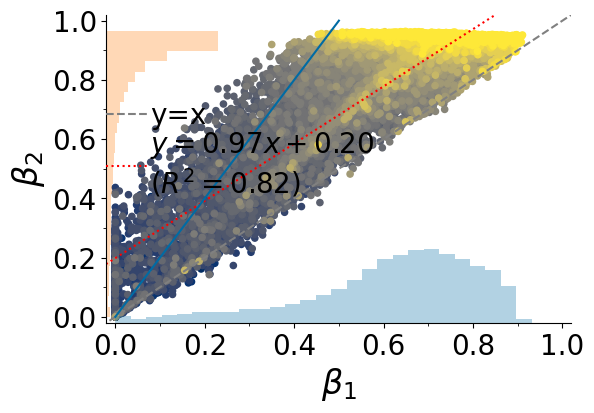

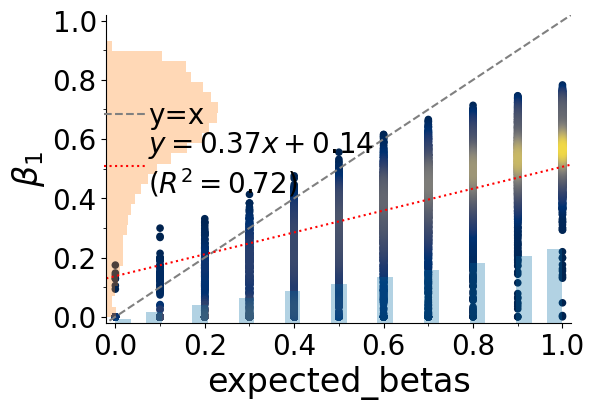

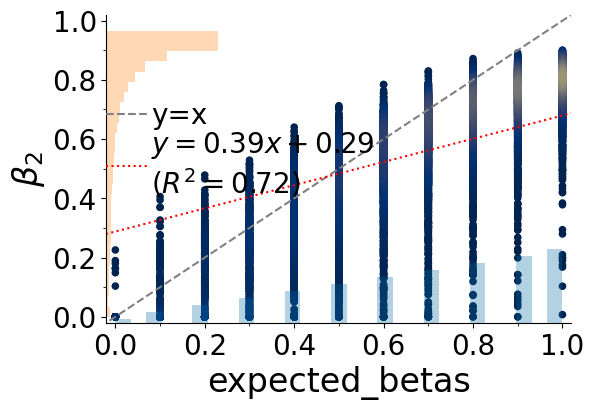

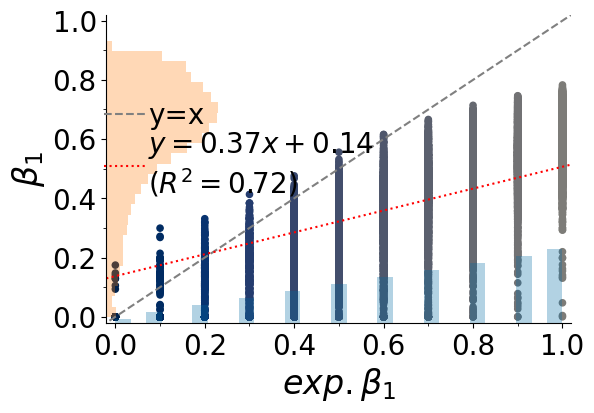

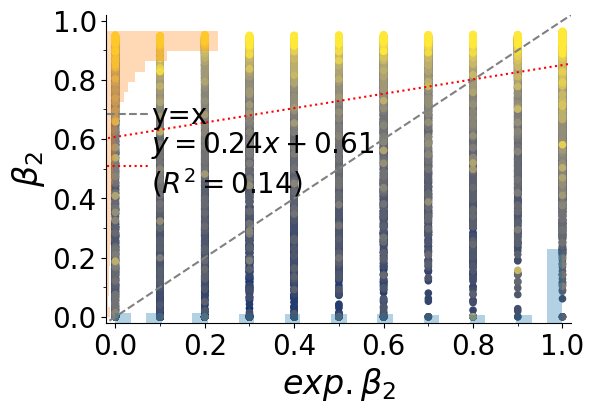

In [398]:
for look_only_among_extracted_colors in [True]:
    for add_nu_2_not_1 in [False]:
        attach_new_colors_to_random = False
        directed = False
        dataset = get_data_new_pairs_UMT(
            rho = 10, 
            starting_nu_1 = 0, ending_nu_1 = 20,
            starting_nu_2 = 0, ending_nu_2 = None,
            fraction_nu_2_cut = 2,
            N_0 = 1, 
            M_0 = 0, 
            Tmax = int(1e4),
            do_fig = True,
            t_to_use = 1e5,
            num_to_save = 1000,
            look_only_among_extracted_colors = look_only_among_extracted_colors,
            add_nu_2_not_1 = add_nu_2_not_1,
            attach_new_colors_to_random = attach_new_colors_to_random,
            color_by_key = 'expected_betas',
            directed = directed,
        )
        new_pairs_UMT[(1,0)] = dataset

#### Check best parameter for each sequence, using only beta1 and beta2

##### get models

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/13 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

  0%|          | 0/17 [00:00<?, ?it/s]

  0%|          | 0/19 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/23 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/27 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/31 [00:00<?, ?it/s]

  0%|          | 0/33 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/37 [00:00<?, ?it/s]

  0%|          | 0/39 [00:00<?, ?it/s]

  0%|          | 0/41 [00:00<?, ?it/s]

FOUND 	44100
intercept 0.3321969223657564 slope 0.7994185437274453
p-value pearson between $\beta_1$ and $\beta_2$ 0.0


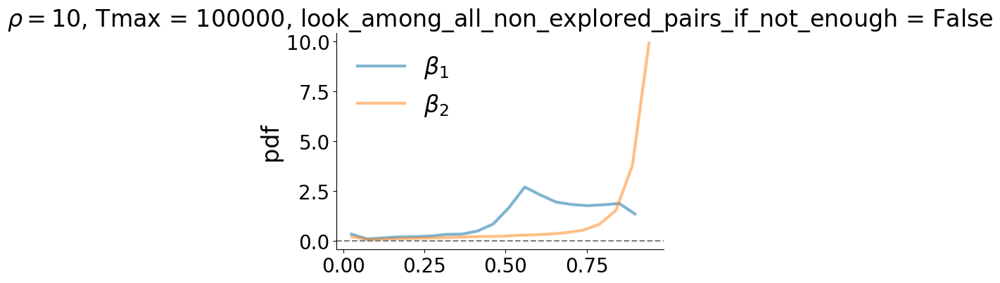

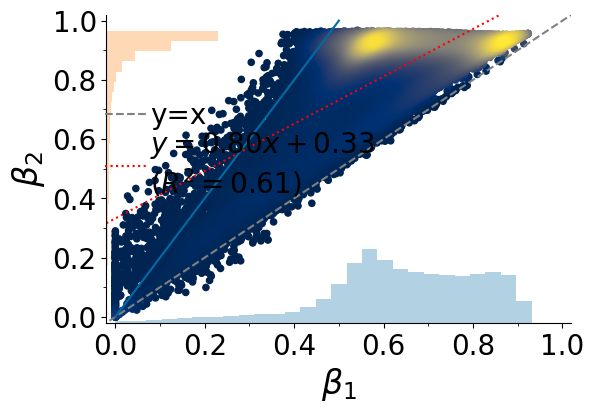

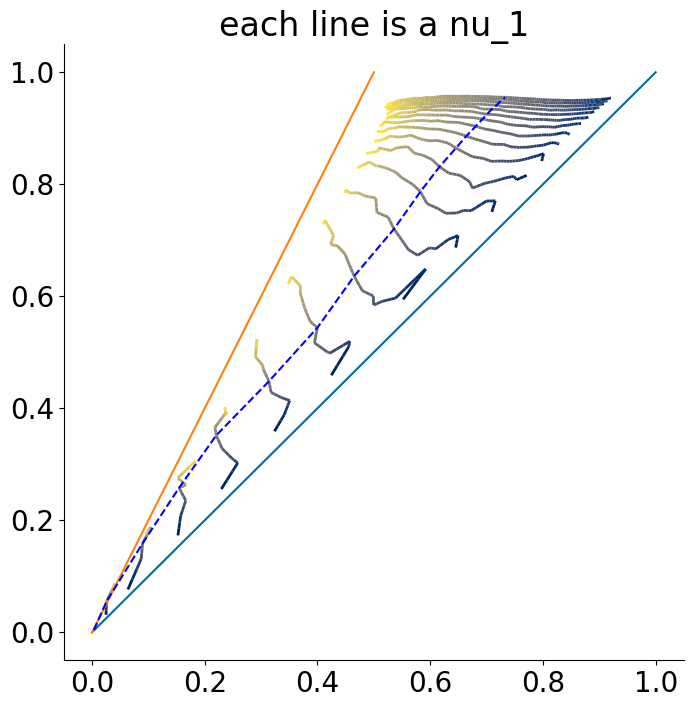

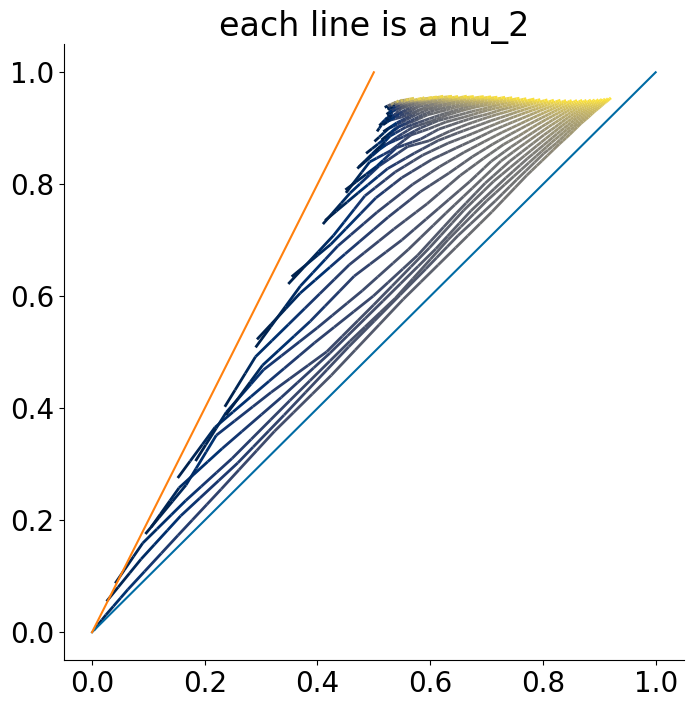

In [752]:
directed = False
do_non_overlapping_simulation = False
trigger_pairs_with_reinforcement = True
triggering_pairs_among_all_non_explored_pairs = False
look_among_all_non_explored_pairs_if_not_enough = False
trigger_links_with_new_colors_if_not_enough = False
trigger_links_between_new_colors_if_not_enough = False
Tmax = int(1e5)
dataset = get_data_new_pairs_UMT(
    rho = 10, 
    starting_nu_1 = 0, ending_nu_1 = 20,
    starting_nu_2 = 0, ending_nu_2 = None,
    fraction_nu_2_cut = 2,
    N_0 = 10, 
    M_0 = 0, 
    Tmax = Tmax,
    do_fig = True,
    t_to_use = Tmax,
    num_to_save = 1000,
    do_non_overlapping_simulation = do_non_overlapping_simulation,
    trigger_pairs_with_reinforcement = trigger_pairs_with_reinforcement,
    triggering_pairs_among_all_non_explored_pairs = triggering_pairs_among_all_non_explored_pairs,
    look_among_all_non_explored_pairs_if_not_enough = look_among_all_non_explored_pairs_if_not_enough,
    trigger_links_with_new_colors_if_not_enough = trigger_links_with_new_colors_if_not_enough, 
    trigger_links_between_new_colors_if_not_enough = trigger_links_between_new_colors_if_not_enough, 
    color_by_key = None,
    directed = directed,
)

  0%|          | 0/31 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/13 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/19 [00:00<?, ?it/s]

  0%|          | 0/22 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/28 [00:00<?, ?it/s]

  0%|          | 0/31 [00:00<?, ?it/s]

  0%|          | 0/34 [00:00<?, ?it/s]

  0%|          | 0/37 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/43 [00:00<?, ?it/s]

  0%|          | 0/46 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/52 [00:00<?, ?it/s]

  0%|          | 0/55 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/61 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/67 [00:00<?, ?it/s]

  0%|          | 0/70 [00:00<?, ?it/s]

  0%|          | 0/73 [00:00<?, ?it/s]

  0%|          | 0/76 [00:00<?, ?it/s]

  0%|          | 0/79 [00:00<?, ?it/s]

  0%|          | 0/82 [00:00<?, ?it/s]

  0%|          | 0/85 [00:00<?, ?it/s]

  0%|          | 0/88 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

FOUND 	142600
intercept 0.6283504599333272 slope 0.43972330493548945
p-value pearson between $\beta_1$ and $\beta_2$ 0.0


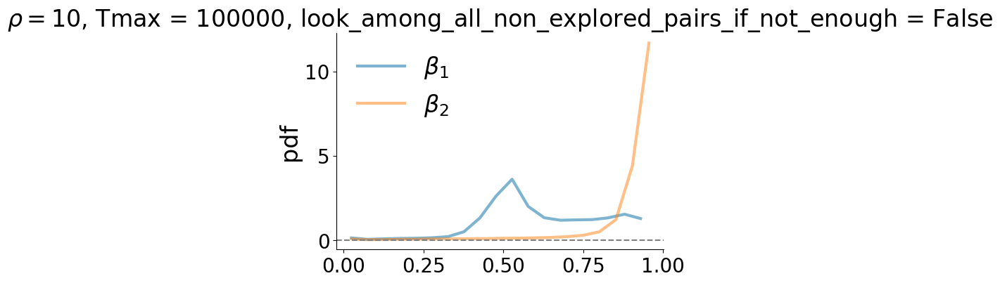

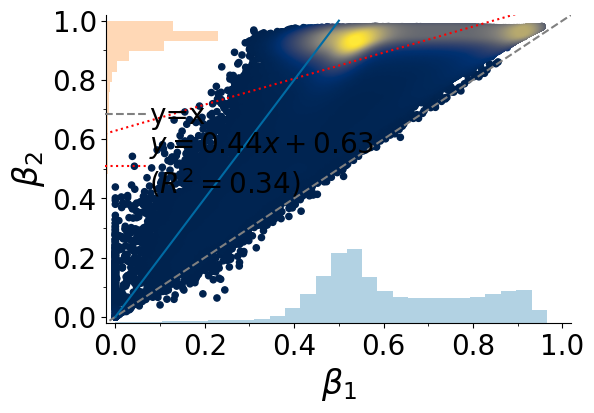

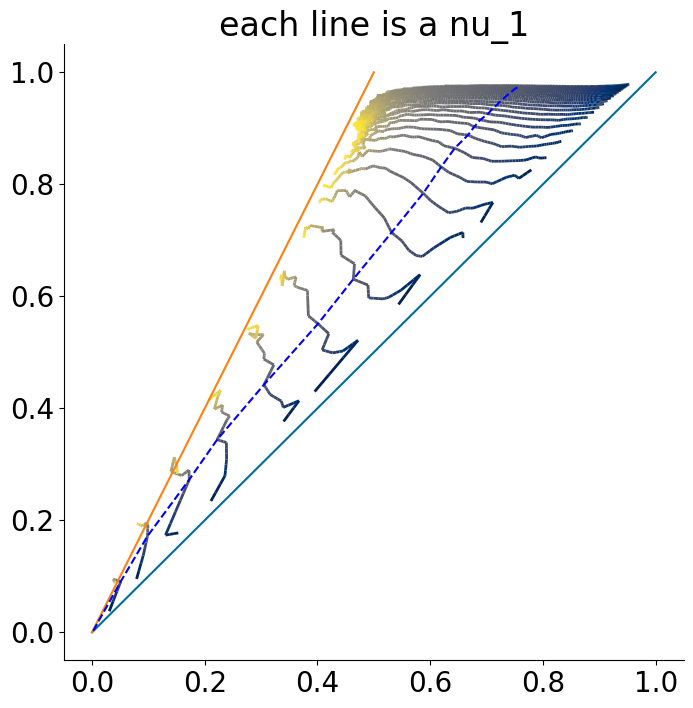

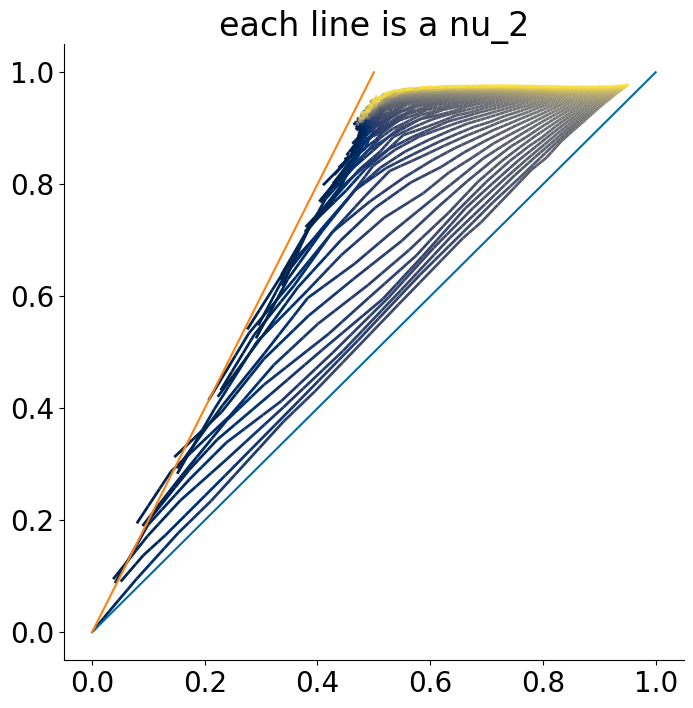

In [50]:
directed = False
do_non_overlapping_simulation = False
trigger_pairs_with_reinforcement = True
triggering_pairs_among_all_non_explored_pairs = False
look_among_all_non_explored_pairs_if_not_enough = False
trigger_links_with_new_colors_if_not_enough = False
trigger_links_between_new_colors_if_not_enough = False
Tmax = int(1e5)
dataset = get_data_new_pairs_UMT(
    rho = 10, 
    starting_nu_1 = 0, ending_nu_1 = 30,
    starting_nu_2 = 0, ending_nu_2 = None,
    fraction_nu_2_cut = 3,
    N_0 = 10, 
    M_0 = 0, 
    Tmax = Tmax,
    do_fig = True,
    t_to_use = Tmax,
    num_to_save = 1000,
    do_non_overlapping_simulation = do_non_overlapping_simulation,
    trigger_pairs_with_reinforcement = trigger_pairs_with_reinforcement,
    triggering_pairs_among_all_non_explored_pairs = triggering_pairs_among_all_non_explored_pairs,
    look_among_all_non_explored_pairs_if_not_enough = look_among_all_non_explored_pairs_if_not_enough,
    trigger_links_with_new_colors_if_not_enough = trigger_links_with_new_colors_if_not_enough, 
    trigger_links_between_new_colors_if_not_enough = trigger_links_between_new_colors_if_not_enough, 
    color_by_key = None,
    directed = directed,
)

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

ERROR! Session/line number was not unique in database. History logging moved to new session 1274


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/13 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

  0%|          | 0/17 [00:00<?, ?it/s]

  0%|          | 0/19 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/23 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/27 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/31 [00:00<?, ?it/s]

  0%|          | 0/33 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/37 [00:00<?, ?it/s]

  0%|          | 0/39 [00:00<?, ?it/s]

  0%|          | 0/41 [00:00<?, ?it/s]

FOUND 	44100
intercept 0.33443995627976386 slope 0.7962847225312528
p-value pearson between $\beta_1$ and $\beta_2$ 0.0


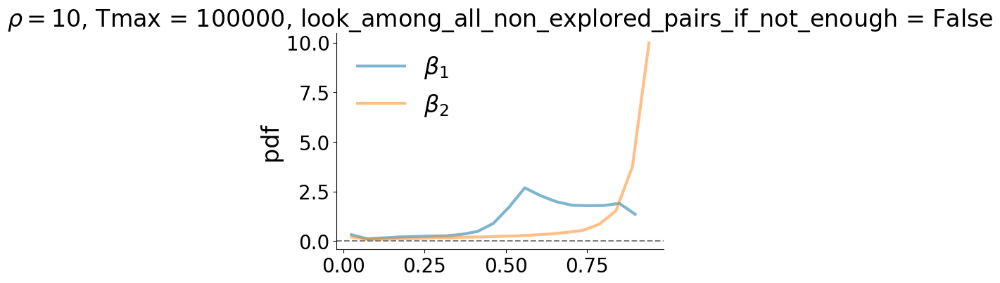

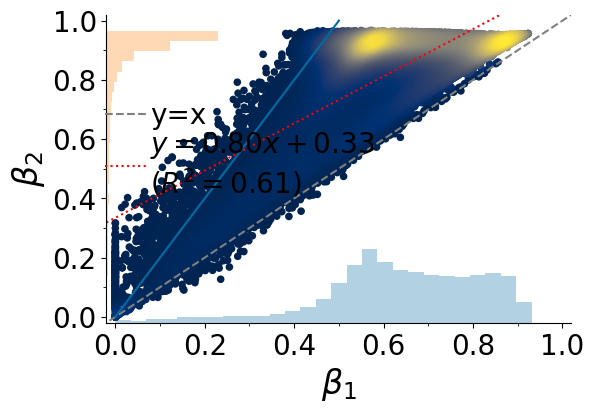

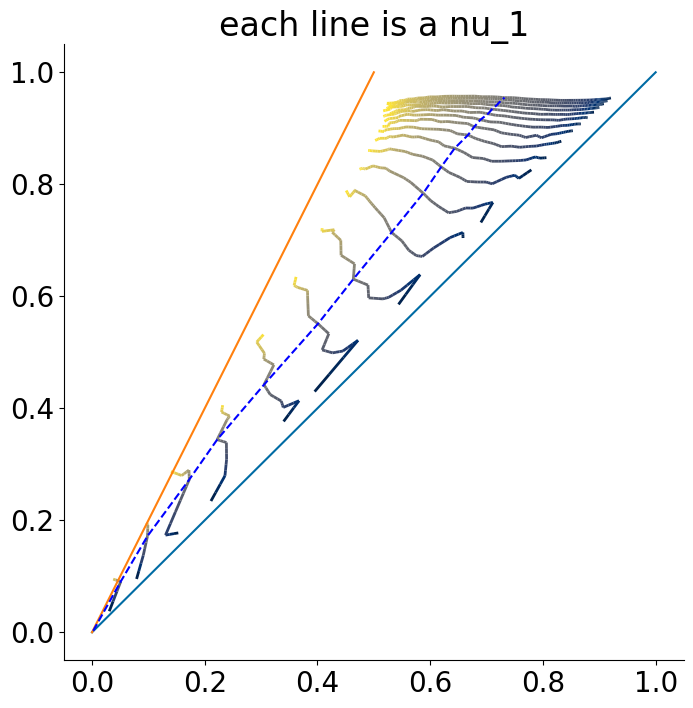

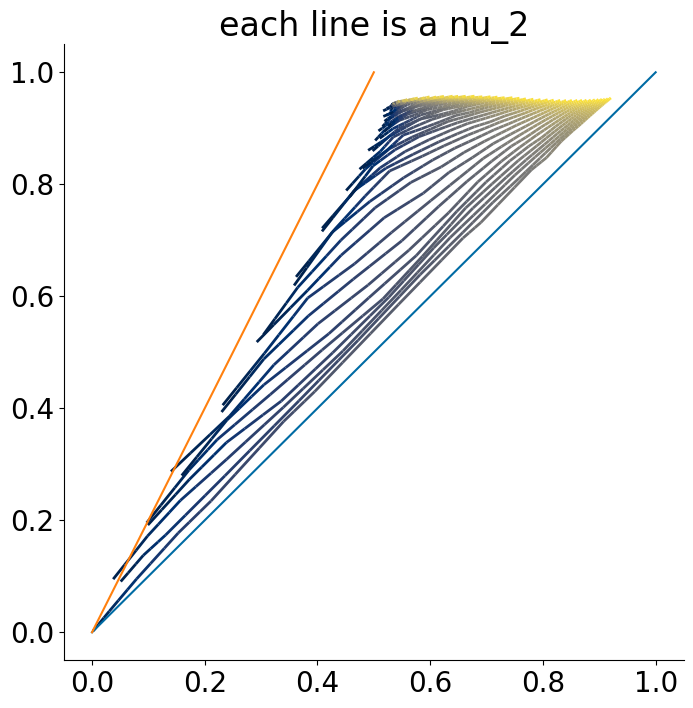

In [957]:
directed = False
do_non_overlapping_simulation = False
trigger_pairs_with_reinforcement = True
triggering_pairs_among_all_non_explored_pairs = False
look_among_all_non_explored_pairs_if_not_enough = False
trigger_links_with_new_colors_if_not_enough = False
trigger_links_between_new_colors_if_not_enough = False
Tmax = int(1e5)
dataset6 = get_data_new_pairs_UMT(
    rho = 10, 
    starting_nu_1 = 0, ending_nu_1 = 20,
    starting_nu_2 = 0, ending_nu_2 = None,
    fraction_nu_2_cut = 2,
    N_0 = 10, 
    M_0 = 0, 
    Tmax = Tmax,
    do_fig = True,
    t_to_use = Tmax,
    num_to_save = 1000,
    do_non_overlapping_simulation = do_non_overlapping_simulation,
    trigger_pairs_with_reinforcement = trigger_pairs_with_reinforcement,
    triggering_pairs_among_all_non_explored_pairs = triggering_pairs_among_all_non_explored_pairs,
    look_among_all_non_explored_pairs_if_not_enough = look_among_all_non_explored_pairs_if_not_enough,
    trigger_links_with_new_colors_if_not_enough = trigger_links_with_new_colors_if_not_enough, 
    trigger_links_between_new_colors_if_not_enough = trigger_links_between_new_colors_if_not_enough, 
    color_by_key = None,
    directed = directed,
)

  0%|          | 0/31 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/13 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

  0%|          | 0/17 [00:00<?, ?it/s]

  0%|          | 0/19 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/23 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/27 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/31 [00:00<?, ?it/s]

  0%|          | 0/33 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/37 [00:00<?, ?it/s]

  0%|          | 0/39 [00:00<?, ?it/s]

  0%|          | 0/41 [00:00<?, ?it/s]

  0%|          | 0/43 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/47 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/53 [00:00<?, ?it/s]

  0%|          | 0/55 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/59 [00:00<?, ?it/s]

  0%|          | 0/61 [00:00<?, ?it/s]

FOUND 	96100
intercept 0.527955882848345 slope 0.5499676752800788
p-value pearson between $\beta_1$ and $\beta_2$ 0.0


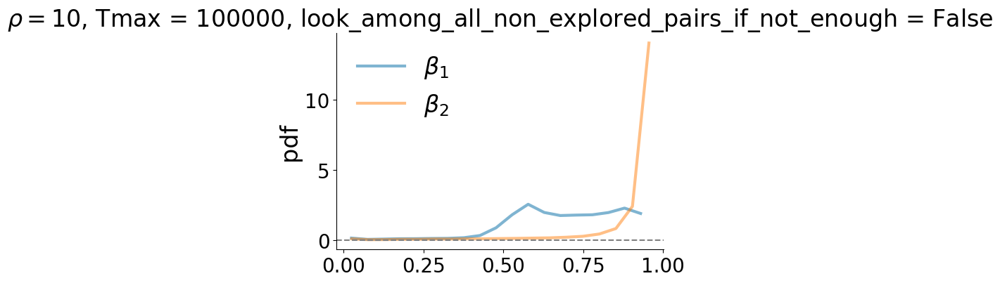

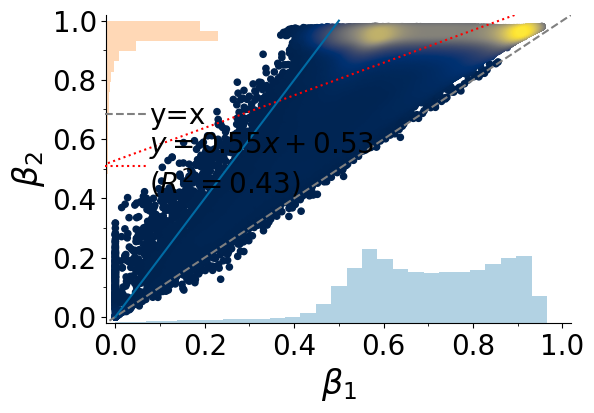

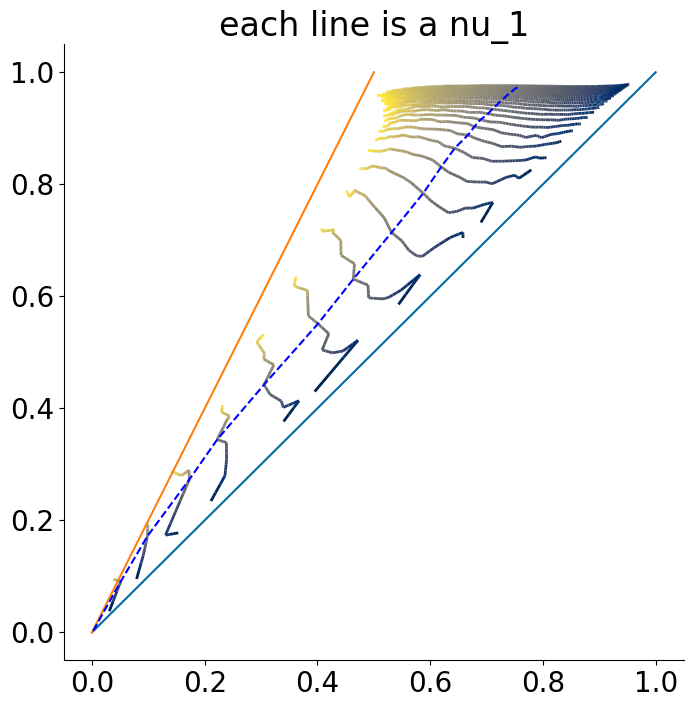

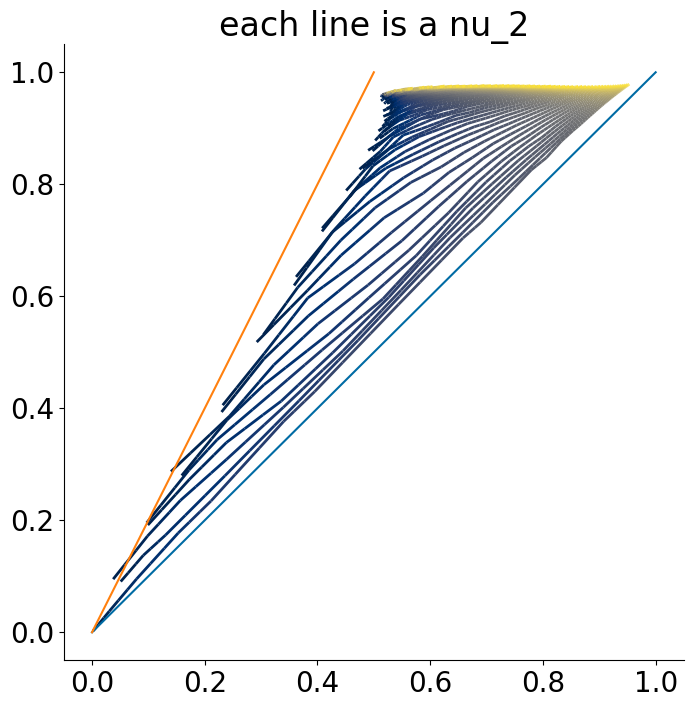

In [958]:
directed = False
do_non_overlapping_simulation = False
trigger_pairs_with_reinforcement = True
triggering_pairs_among_all_non_explored_pairs = False
look_among_all_non_explored_pairs_if_not_enough = False
trigger_links_with_new_colors_if_not_enough = False
trigger_links_between_new_colors_if_not_enough = False
Tmax = int(1e5)
dataset7 = get_data_new_pairs_UMT(
    rho = 10, 
    starting_nu_1 = 0, ending_nu_1 = 30,
    starting_nu_2 = 0, ending_nu_2 = None,
    fraction_nu_2_cut = 2,
    N_0 = 10, 
    M_0 = 0, 
    Tmax = Tmax,
    do_fig = True,
    t_to_use = Tmax,
    num_to_save = 1000,
    do_non_overlapping_simulation = do_non_overlapping_simulation,
    trigger_pairs_with_reinforcement = trigger_pairs_with_reinforcement,
    triggering_pairs_among_all_non_explored_pairs = triggering_pairs_among_all_non_explored_pairs,
    look_among_all_non_explored_pairs_if_not_enough = look_among_all_non_explored_pairs_if_not_enough,
    trigger_links_with_new_colors_if_not_enough = trigger_links_with_new_colors_if_not_enough, 
    trigger_links_between_new_colors_if_not_enough = trigger_links_between_new_colors_if_not_enough, 
    color_by_key = None,
    directed = directed,
)

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/13 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/19 [00:00<?, ?it/s]

  0%|          | 0/22 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/28 [00:00<?, ?it/s]

  0%|          | 0/31 [00:00<?, ?it/s]

  0%|          | 0/34 [00:00<?, ?it/s]

  0%|          | 0/37 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/43 [00:00<?, ?it/s]

  0%|          | 0/46 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/52 [00:00<?, ?it/s]

  0%|          | 0/55 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/61 [00:00<?, ?it/s]

FOUND 	65100
intercept 0.4467619493631817 slope 0.6812016536779344
p-value pearson between $\beta_1$ and $\beta_2$ 0.0


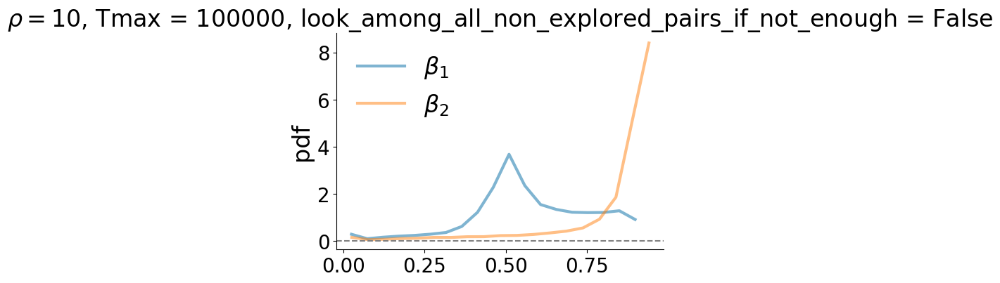

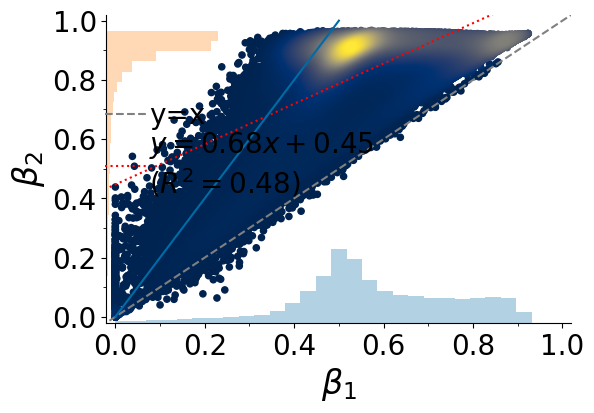

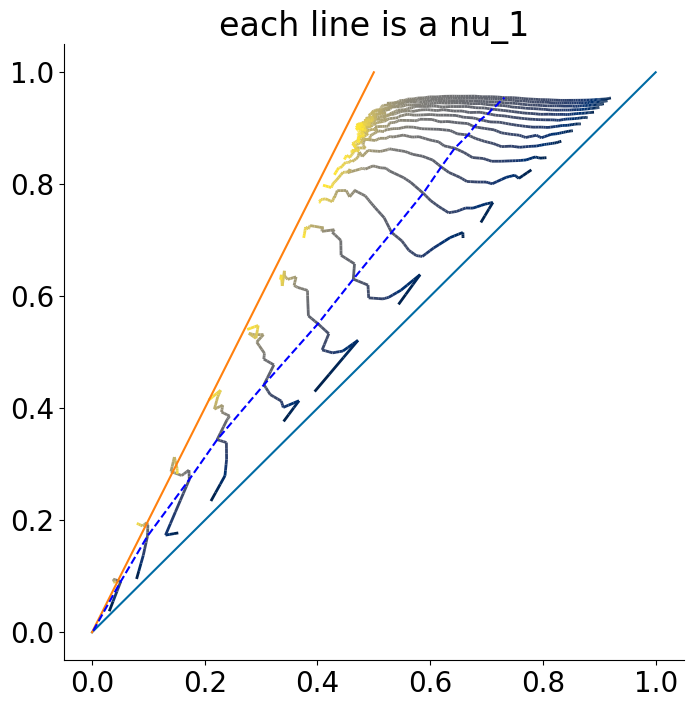

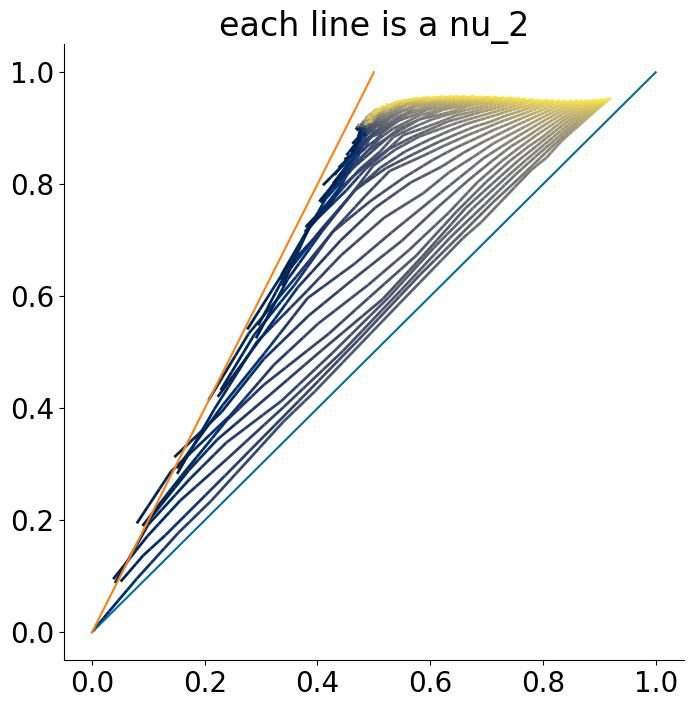

In [959]:
directed = False
do_non_overlapping_simulation = False
trigger_pairs_with_reinforcement = True
triggering_pairs_among_all_non_explored_pairs = False
look_among_all_non_explored_pairs_if_not_enough = False
trigger_links_with_new_colors_if_not_enough = False
trigger_links_between_new_colors_if_not_enough = False
Tmax = int(1e5)
dataset4 = get_data_new_pairs_UMT(
    rho = 10, 
    starting_nu_1 = 0, ending_nu_1 = 20,
    starting_nu_2 = 0, ending_nu_2 = None,
    fraction_nu_2_cut = 3,
    N_0 = 10, 
    M_0 = 0, 
    Tmax = Tmax,
    do_fig = True,
    t_to_use = Tmax,
    num_to_save = 1000,
    do_non_overlapping_simulation = do_non_overlapping_simulation,
    trigger_pairs_with_reinforcement = trigger_pairs_with_reinforcement,
    triggering_pairs_among_all_non_explored_pairs = triggering_pairs_among_all_non_explored_pairs,
    look_among_all_non_explored_pairs_if_not_enough = look_among_all_non_explored_pairs_if_not_enough,
    trigger_links_with_new_colors_if_not_enough = trigger_links_with_new_colors_if_not_enough, 
    trigger_links_between_new_colors_if_not_enough = trigger_links_between_new_colors_if_not_enough, 
    color_by_key = None,
    directed = directed,
)

  0%|          | 0/31 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

FOUND 	159100
intercept 0.373211551258702 slope 0.8164517263545588
p-value pearson between $\beta_1$ and $\beta_2$ 0.0


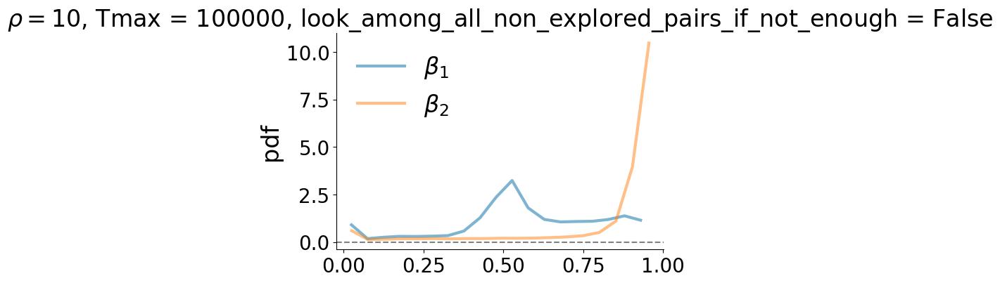

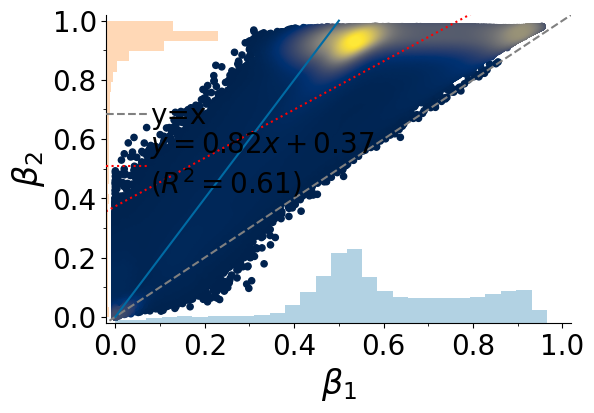

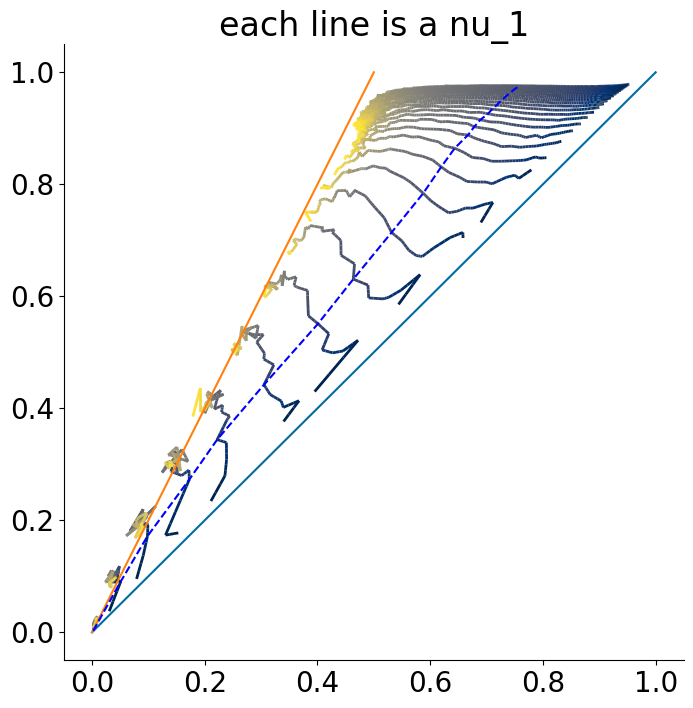

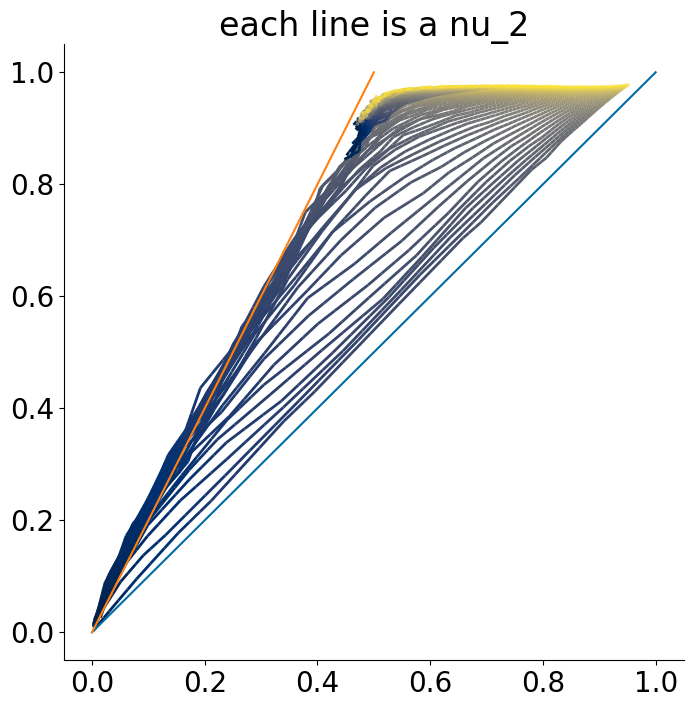

In [960]:
directed = False
do_non_overlapping_simulation = False
trigger_pairs_with_reinforcement = True
triggering_pairs_among_all_non_explored_pairs = False
look_among_all_non_explored_pairs_if_not_enough = False
trigger_links_with_new_colors_if_not_enough = False
trigger_links_between_new_colors_if_not_enough = False
Tmax = int(1e5)
dataset8 = get_data_new_pairs_UMT(
    rho = 10, 
    starting_nu_1 = 0, ending_nu_1 = 30,
    starting_nu_2 = 0, ending_nu_2 = 90,
    fraction_nu_2_cut = 3,
    N_0 = 10, 
    M_0 = 0, 
    Tmax = Tmax,
    do_fig = True,
    t_to_use = Tmax,
    num_to_save = 1000,
    do_non_overlapping_simulation = do_non_overlapping_simulation,
    trigger_pairs_with_reinforcement = trigger_pairs_with_reinforcement,
    triggering_pairs_among_all_non_explored_pairs = triggering_pairs_among_all_non_explored_pairs,
    look_among_all_non_explored_pairs_if_not_enough = look_among_all_non_explored_pairs_if_not_enough,
    trigger_links_with_new_colors_if_not_enough = trigger_links_with_new_colors_if_not_enough, 
    trigger_links_between_new_colors_if_not_enough = trigger_links_between_new_colors_if_not_enough, 
    color_by_key = None,
    directed = directed,
)

### other figs

In [58]:
def scatter_with_expected(
    average_betas_dict,
    average_beta2_dict,
    rho = 10,
    m = 2,
    divisor_1 = 1,
    divisor_2 = 1,
    divisor_3 = 1,
):
    
    betas = []
    expected_betas = []
    betas2 = []
    expected_betas2 = []
    
    for nu_1 in average_betas_dict.keys():
        for nu_2 in average_betas_dict[nu_1].keys():
            betas.append(average_betas_dict[nu_1][nu_2])
            betas2.append(average_beta2_dict[nu_1][nu_2])
            expected_betas.append(min(1,1/m*nu_1/divisor_1/rho + (1 - 1/m)*nu_2/divisor_2/rho))
            expected_betas2.append(min(1,nu_2/divisor_3/rho))
    
    
    fig,ax = plt.subplots(figsize=(8,8))
    x = np.array(expected_betas)
    y = np.array(betas)
    z = None
    subplot_scatter_beta(
        x = x, 
        y = y, 
        z = z,
        ax = ax, 
#         min_x = 0,
#         max_x = 1,
#         min_y = 0,
#         max_y = 1,
        marker_size = 20, 
        xlabel = fr"exp. $\beta_1$", 
        ylabel = fr"$\beta_1$", 
    )
    fig.add_subplot(ax)
    
    fig,ax = plt.subplots(figsize=(8,8))
    x = np.array(expected_betas2)
    y = np.array(betas2)
    z = None
    subplot_scatter_beta(
        x = x, 
        y = y, 
        z = z,
        ax = ax, 
#         min_x = 0,
#         max_x = 1,
#         min_y = 0,
#         max_y = 1,
        marker_size = 20, 
        xlabel = fr"exp. $\beta_2$", 
        ylabel = fr"$\beta_2$", 
    )
    fig.add_subplot(ax)


#     ax.set_xlim([0,1])
#     ax.set_ylim([0,1])

intercept 0.21480626792737273 slope 0.5908272117008295
p-value pearson between exp. $\beta_1$ and $\beta_1$ 7.227992159776023e-147
intercept 0.08103776503084986 slope 0.8484950126560433
p-value pearson between exp. $\beta_2$ and $\beta_2$ 4.612146590430374e-290


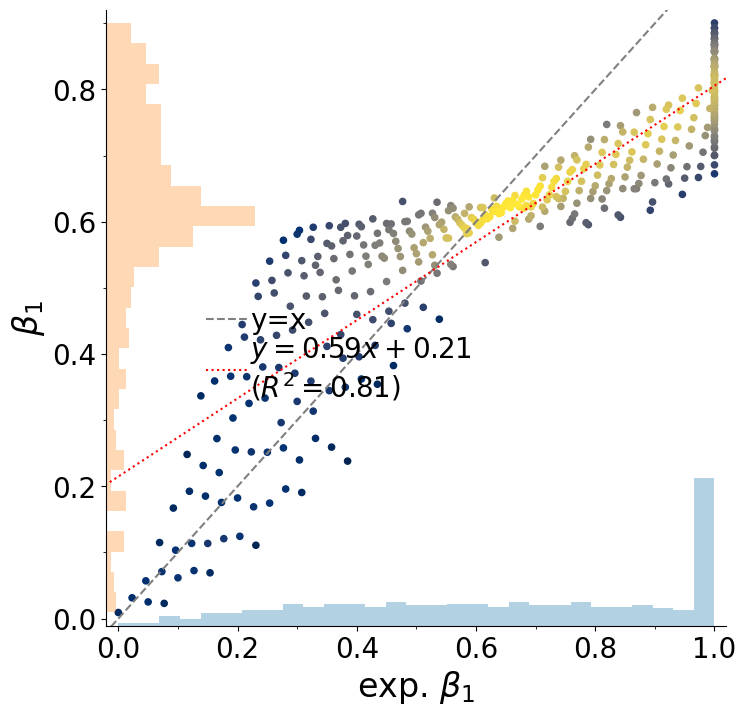

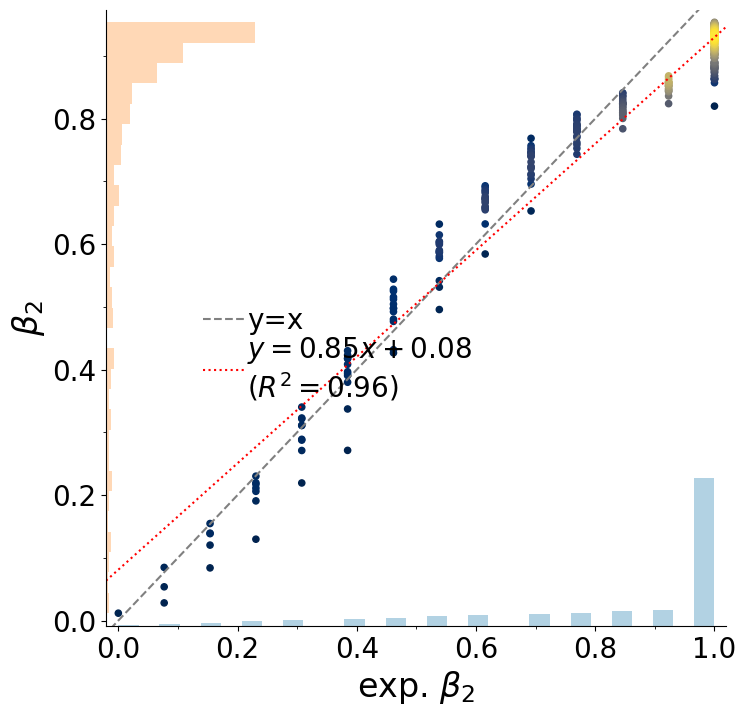

In [217]:
scatter_with_expected(
    average_betas_dict = average_betas_dict_new_pairs_UMT[(1, 0)],
    average_beta2_dict = average_beta2_dict_new_pairs_UMT[(1, 0)],
    rho = 10,
    m = .65,
    divisor_1 = 2.,
    divisor_2 = 2,
    divisor_3 = 1.3,
)

In [59]:
def plot_average_beta_1_beta2_by_two_parameters(
    average_beta,
    average_beta2,
    ax = None,
    fig = None,
    print_values_parameters_plotted = False,
):
    if ax == None:
        fig,ax = plt.subplots(figsize=(8,8))
    
    for nu_1 in average_beta.keys():
        x = np.array(average_beta[nu_1])
        y = np.array(average_beta2[nu_1])
        if len(x) > 1:
            if print_values_parameters_plotted:
                print('nu_1', nu_1)
            path = mpath.Path(np.column_stack([x, y]))
            verts = path.interpolated(steps=3).vertices
            x, y = verts[:, 0], verts[:, 1]
            z = np.linspace(0, 1, len(x))

            colorline(x, y, z, cmap=plt.get_cmap('jet'), linewidth=2, ax = ax)
    ax.plot([0,1],[0,1], '--', color='gray')
    ax.set_xlim([0,1])
    ax.set_ylim([0,1])

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

nu_1 1
nu_1 2
nu_1 3
nu_1 4
nu_1 5
nu_1 6
nu_1 7
nu_1 8
nu_1 9
nu_1 10
nu_1 11
nu_1 12
nu_1 13
nu_1 14
nu_1 15
nu_1 16
nu_1 17
nu_1 18
nu_1 19
nu_1 20


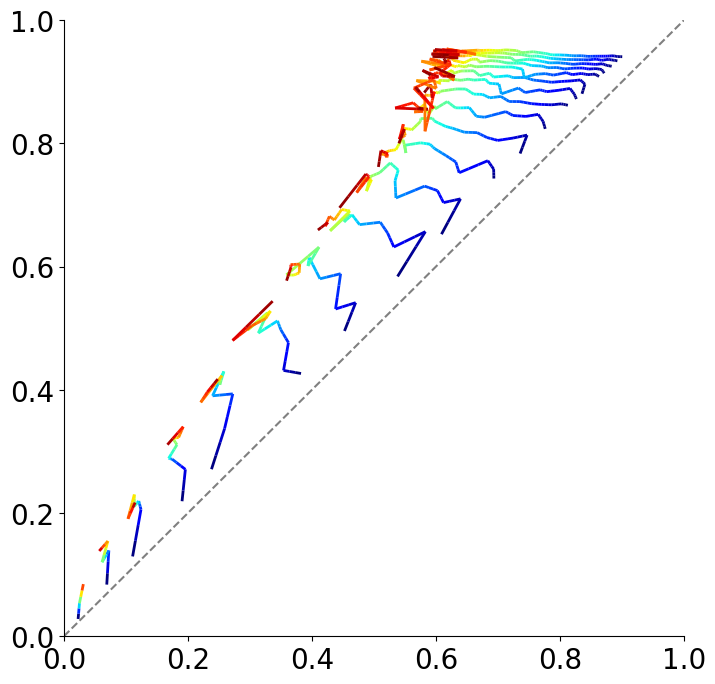

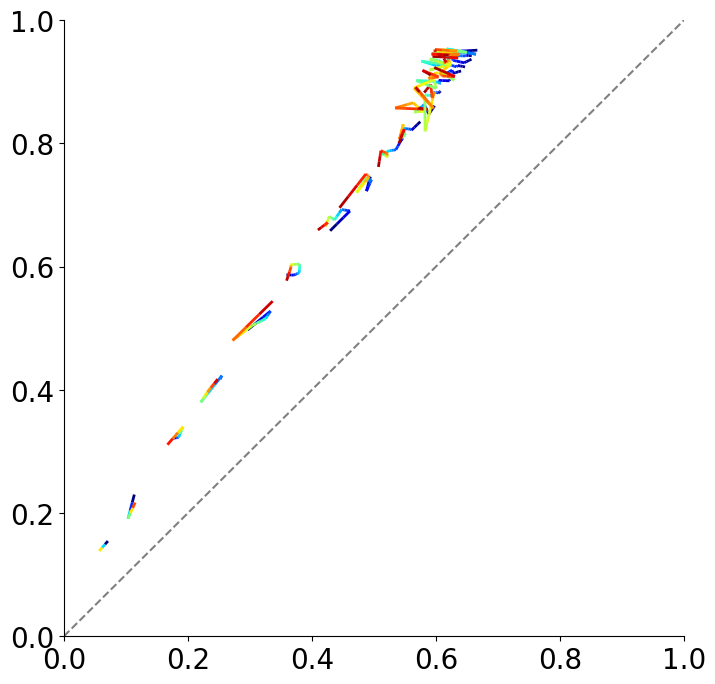

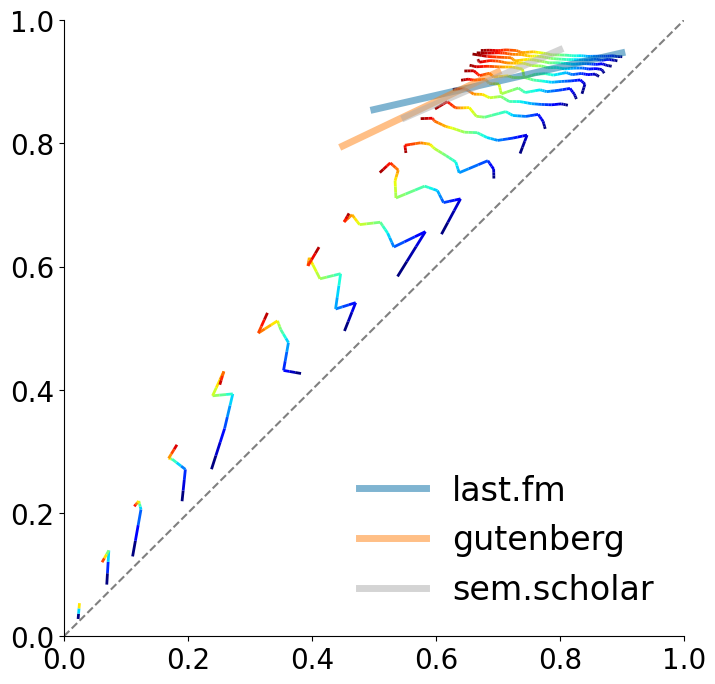

In [231]:

average_beta_dict = average_betas_dict_new_pairs_UMT[(1, 0)]
average_beta2_dict = average_beta2_dict_new_pairs_UMT[(1, 0)]


min_nu_1_cut = 0
max_nu_1_cut = 30
min_nu_2_cut = 0
fraction_nu_2_cut = 1
    
average_beta_to_plot = {}
average_beta2_to_plot = {}
for nu_1 in tqdm(sorted(average_beta_dict.keys())):
    nu_1_dict = average_beta_dict[nu_1]
    average_beta_to_plot[nu_1] = []
    average_beta2_to_plot[nu_1] = []
    for nu_2 in sorted(nu_1_dict.keys()):
        beta = average_beta_dict[nu_1][nu_2]
        beta_2 = average_beta2_dict[nu_1][nu_2]
        average_beta_to_plot[nu_1].append(beta)
        average_beta2_to_plot[nu_1].append(beta_2)


plot_average_beta_1_beta2_by_two_parameters(
    average_beta_to_plot,
    average_beta2_to_plot,
    ax = None,
    fig = None,
)

    
average_beta_to_plot = {}
average_beta2_to_plot = {}
for nu_1 in tqdm(sorted(average_beta_dict.keys())):
    if nu_1 > max_nu_1_cut or nu_1 < min_nu_1_cut:
        nu_1_dict = average_beta_dict[nu_1]
        average_beta_to_plot[nu_1] = []
        average_beta2_to_plot[nu_1] = []
        for nu_2 in sorted(nu_1_dict.keys()):
            beta = average_beta_dict[nu_1][nu_2]
            beta_2 = average_beta2_dict[nu_1][nu_2]
            average_beta_to_plot[nu_1].append(beta)
            average_beta2_to_plot[nu_1].append(beta_2)
    elif nu_1 <= max_nu_1_cut:
        nu_1_dict = average_beta_dict[nu_1]
        average_beta_to_plot[nu_1] = []
        average_beta2_to_plot[nu_1] = []
        for nu_2 in sorted(nu_1_dict.keys()):
            if nu_2 > fraction_nu_2_cut*nu_1 or nu_2 < min_nu_2_cut:
                beta = average_beta_dict[nu_1][nu_2]
                beta_2 = average_beta2_dict[nu_1][nu_2]
                average_beta_to_plot[nu_1].append(beta)
                average_beta2_to_plot[nu_1].append(beta_2)


plot_average_beta_1_beta2_by_two_parameters(
    average_beta_to_plot,
    average_beta2_to_plot,
    ax = None,
    fig = None,
)


fig,ax = plt.subplots(figsize=(8,8))

average_beta_to_plot = {}
average_beta2_to_plot = {}
for nu_1 in tqdm(sorted(average_beta_dict.keys())):
    if nu_1 <= max_nu_1_cut and nu_1 >= min_nu_1_cut:
        nu_1_dict = average_beta_dict[nu_1]
        average_beta_to_plot[nu_1] = []
        average_beta2_to_plot[nu_1] = []
        for nu_2 in sorted(nu_1_dict.keys()):
            if nu_2 <= fraction_nu_2_cut*nu_1 and nu_2 >= min_nu_2_cut:
                beta = average_beta_dict[nu_1][nu_2]
                beta_2 = average_beta2_dict[nu_1][nu_2]
                average_beta_to_plot[nu_1].append(beta)
                average_beta2_to_plot[nu_1].append(beta_2)


plot_average_beta_1_beta2_by_two_parameters(
    average_beta_to_plot,
    average_beta2_to_plot,
    ax = ax,
    fig = fig,
    print_values_parameters_plotted=True
)
x = np.array([0.5,.9])
plt.plot(x, 0.23*x+0.74, label = 'last.fm', lw = 5, alpha = 0.5)
x = np.array([.45,.7])
plt.plot(x, 0.48*x+0.58, label = 'gutenberg', lw = 5, alpha = 0.5)
x = np.array([0.55,.8])
plt.plot(x, 0.44*x+0.60, label = 'sem.scholar', lw = 5, alpha = 0.5)
plt.legend()

In [215]:
min_nu_1_cut = 0
max_nu_1_cut = 20
min_nu_2_cut = 0
fraction_nu_2_cut = 1
    
average_beta_dict = average_betas_dict_new_pairs_UMT[(1, 0)]
average_beta2_dict = average_beta2_dict_new_pairs_UMT[(1, 0)]

average_beta_dict_to_plot = {}
average_beta2_dict_to_plot = {}
for nu_1 in tqdm(sorted(average_beta_dict.keys())):
    if nu_1 <= max_nu_1_cut and nu_1 >= min_nu_1_cut:
        average_beta_dict_to_plot[nu_1] = {}
        average_beta2_dict_to_plot[nu_1] = {}
        nu_1_dict = average_beta_dict[nu_1]
        for nu_2 in sorted(nu_1_dict.keys()):
            if nu_2 <= fraction_nu_2_cut*nu_1 and nu_2 >= min_nu_2_cut:
                beta = average_beta_dict[nu_1][nu_2]
                beta_2 = average_beta2_dict[nu_1][nu_2]
                average_beta_dict_to_plot[nu_1][nu_2] = beta
                average_beta2_dict_to_plot[nu_1][nu_2] = beta_2

  0%|          | 0/21 [00:00<?, ?it/s]

intercept 0.07831176419660689 slope 0.7382789504493898
p-value pearson between exp. $\beta_1$ and $\beta_1$ 5.137028636174845e-125
intercept 0.05574524687714329 slope 0.8732747889261274
p-value pearson between exp. $\beta_2$ and $\beta_2$ 4.10463816802053e-169


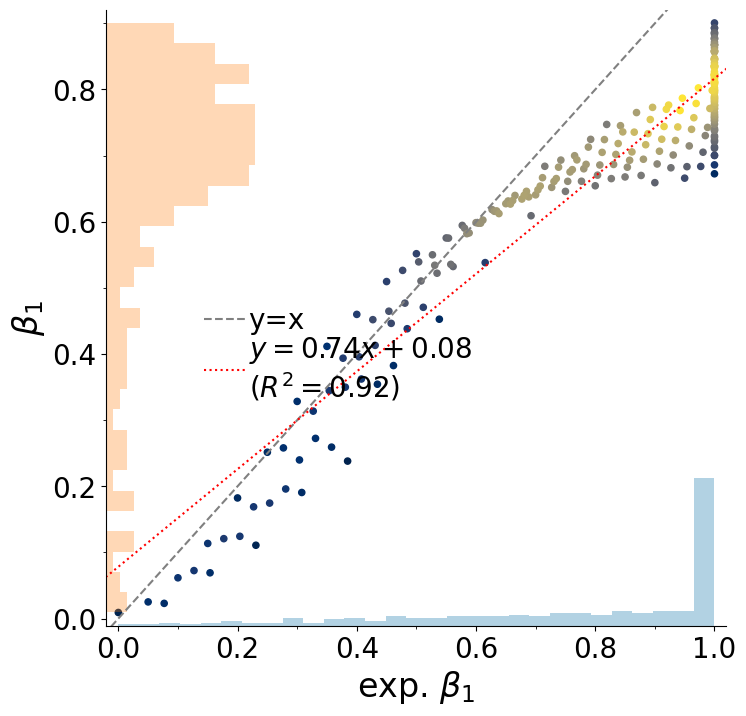

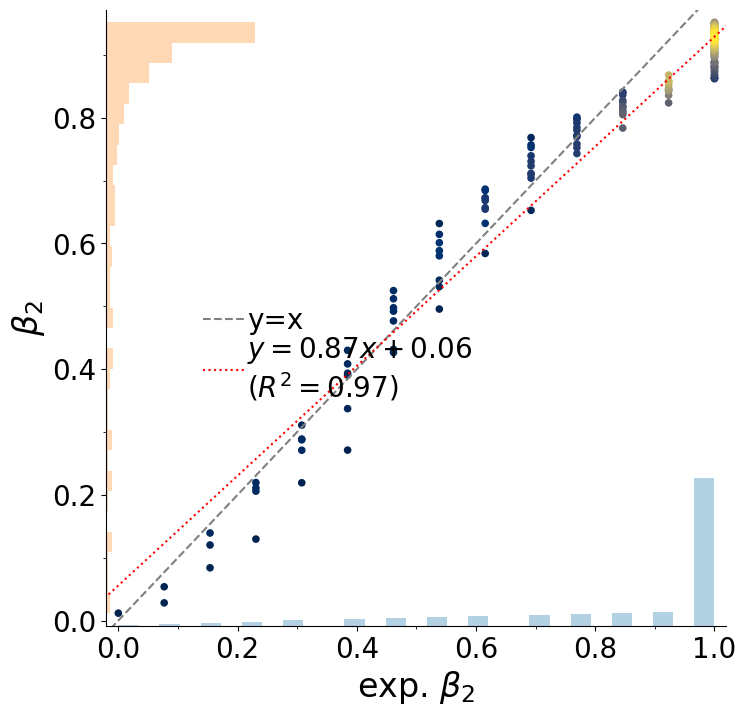

In [216]:
scatter_with_expected(
    average_betas_dict = average_beta_dict_to_plot,
    average_beta2_dict = average_beta2_dict_to_plot,
    rho = 10,
    m = .65,
    divisor_1 = 2.,
    divisor_2 = 2,
    divisor_3 = 1.3,
)

#### Check with gutenberg KS2D

  0%|          | 0/31 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/13 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/19 [00:00<?, ?it/s]

  0%|          | 0/22 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/28 [00:00<?, ?it/s]

  0%|          | 0/31 [00:00<?, ?it/s]

  0%|          | 0/34 [00:00<?, ?it/s]

  0%|          | 0/37 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/43 [00:00<?, ?it/s]

  0%|          | 0/46 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/52 [00:00<?, ?it/s]

  0%|          | 0/55 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/61 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/67 [00:00<?, ?it/s]

  0%|          | 0/70 [00:00<?, ?it/s]

  0%|          | 0/73 [00:00<?, ?it/s]

  0%|          | 0/76 [00:00<?, ?it/s]

  0%|          | 0/79 [00:00<?, ?it/s]

  0%|          | 0/82 [00:00<?, ?it/s]

  0%|          | 0/85 [00:00<?, ?it/s]

  0%|          | 0/88 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

FOUND 	40210
look_only_among_extracted_colors,add_nu_2_not_1,attach_new_colors_to_random,directed
True False False False


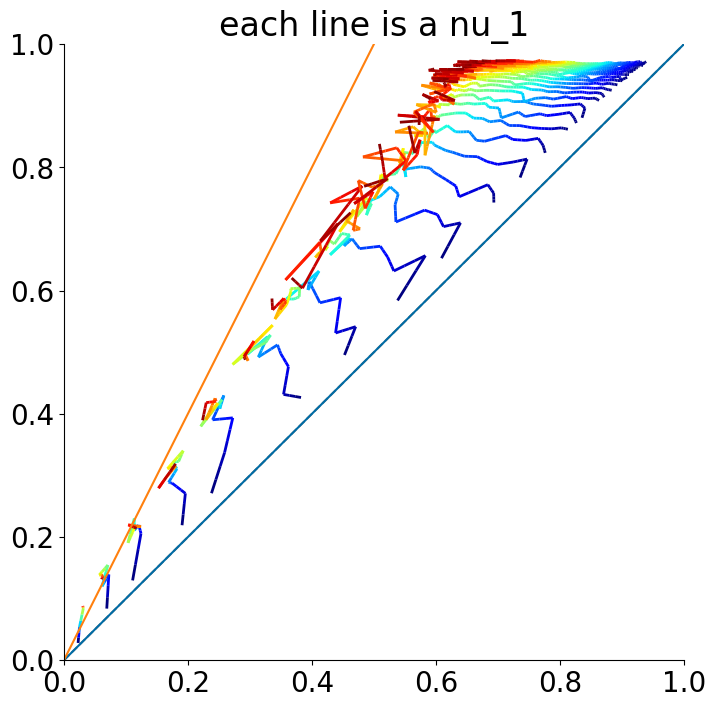

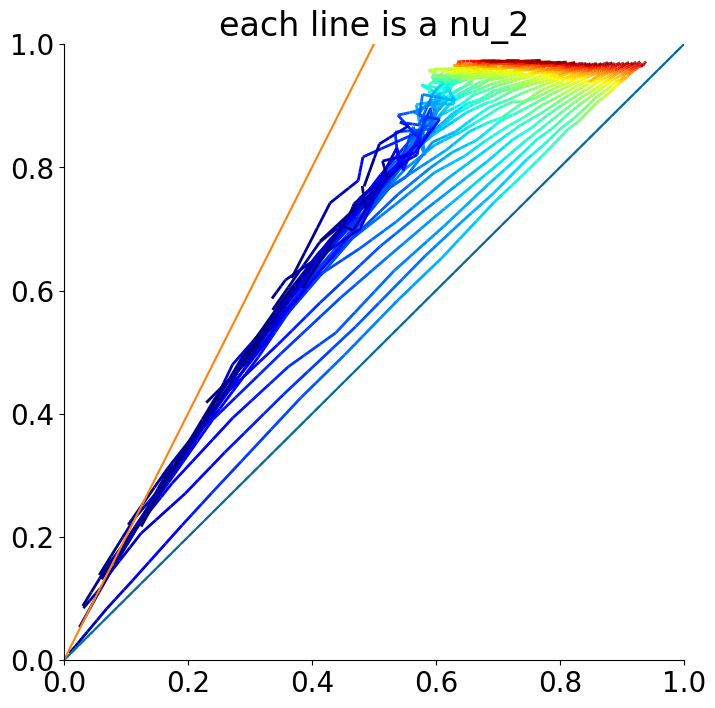

In [284]:
for look_only_among_extracted_colors in [True]:
    for add_nu_2_not_1 in [False]:
        attach_new_colors_to_random = False
        directed = False
        average_beta_dict, average_beta2_dict, average_beta, average_beta2, average_beta_inverse, average_beta2_inverse = get_average_data_new_pairs_UMT(
            rho = 10, 
            starting_nu_1 = 0, ending_nu_1 = 30,
            starting_nu_2 = 0, ending_nu_2 = None,
            fraction_nu_2_cut=3,
            N_0 = 1, 
            M_0 = 0, 
            Tmax = int(1e4),
            do_fig = True,
            t_to_use = 1e5,
            num_to_save = 1000,
            look_only_among_extracted_colors = look_only_among_extracted_colors,
            add_nu_2_not_1 = add_nu_2_not_1,
            attach_new_colors_to_random = attach_new_colors_to_random,
            look_among_all_non_explored_pairs_if_not_enough = False,
            color_by_key = 'nu_1/(nu_2+rho)',
            directed = directed,
        )
        average_betas_dict_new_pairs_UMT[(1,0)] = average_beta_dict
        average_beta2_dict_new_pairs_UMT[(1,0)] = average_beta2_dict
        average_betas_new_pairs_UMT[(1,0)] = average_beta
        average_beta2_new_pairs_UMT[(1,0)] = average_beta2
        average_beta_inverse_new_pairs_UMT[(1,0)] = average_beta_inverse
        average_beta2_inverse_new_pairs_UMT[(1,0)] = average_beta2_inverse
print('look_only_among_extracted_colors,add_nu_2_not_1,attach_new_colors_to_random,directed')
print(look_only_among_extracted_colors,add_nu_2_not_1,attach_new_colors_to_random,directed)

  0%|          | 0/31 [00:00<?, ?it/s]

  0%|          | 0/31 [00:00<?, ?it/s]

  0%|          | 0/31 [00:00<?, ?it/s]

nu_1 1
nu_1 2
nu_1 3
nu_1 4
nu_1 5
nu_1 6
nu_1 7
nu_1 8
nu_1 9
nu_1 10
nu_1 11
nu_1 12
nu_1 13
nu_1 14
nu_1 15
nu_1 16
nu_1 17
nu_1 18
nu_1 19
nu_1 20


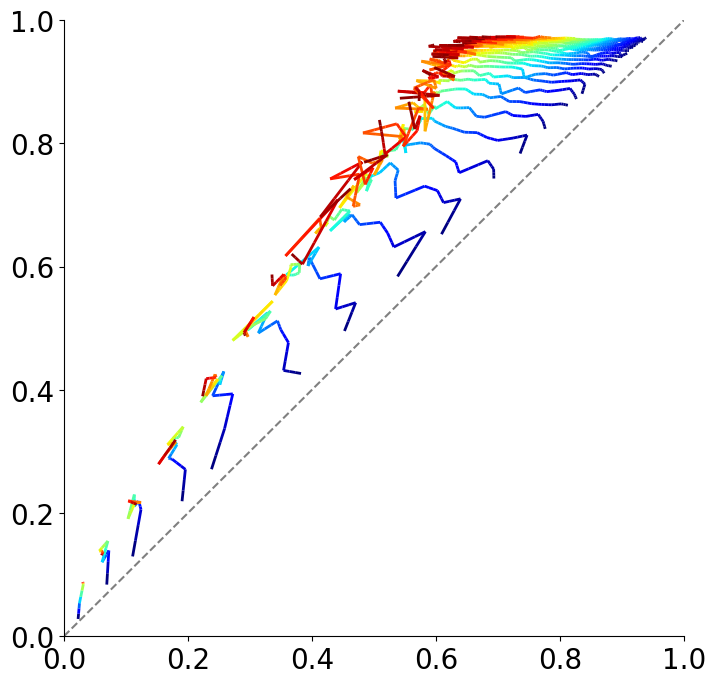

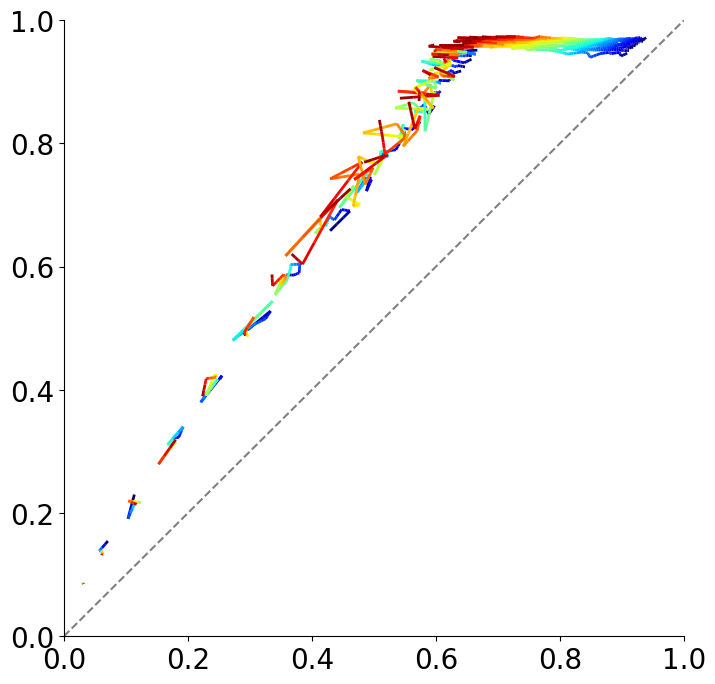

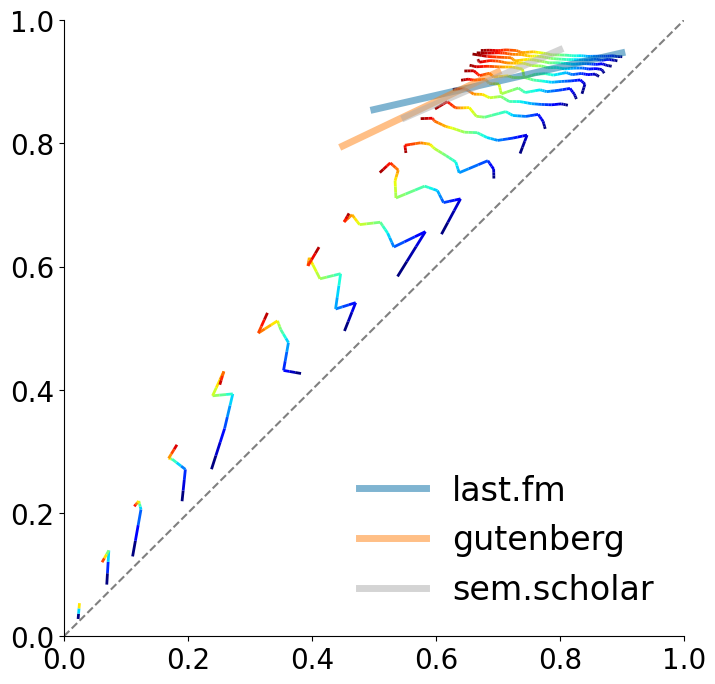

In [285]:

average_beta_dict = average_betas_dict_new_pairs_UMT[(1, 0)]
average_beta2_dict = average_beta2_dict_new_pairs_UMT[(1, 0)]


min_nu_1_cut = 0
max_nu_1_cut = 20
min_nu_2_cut = 0
fraction_nu_2_cut = 1
    
average_beta_to_plot = {}
average_beta2_to_plot = {}
for nu_1 in tqdm(sorted(average_beta_dict.keys())):
    nu_1_dict = average_beta_dict[nu_1]
    average_beta_to_plot[nu_1] = []
    average_beta2_to_plot[nu_1] = []
    for nu_2 in sorted(nu_1_dict.keys()):
        beta = average_beta_dict[nu_1][nu_2]
        beta_2 = average_beta2_dict[nu_1][nu_2]
        average_beta_to_plot[nu_1].append(beta)
        average_beta2_to_plot[nu_1].append(beta_2)


plot_average_beta_1_beta2_by_two_parameters(
    average_beta_to_plot,
    average_beta2_to_plot,
    ax = None,
    fig = None,
)

    
average_beta_to_plot = {}
average_beta2_to_plot = {}
for nu_1 in tqdm(sorted(average_beta_dict.keys())):
    if nu_1 > max_nu_1_cut or nu_1 < min_nu_1_cut:
        nu_1_dict = average_beta_dict[nu_1]
        average_beta_to_plot[nu_1] = []
        average_beta2_to_plot[nu_1] = []
        for nu_2 in sorted(nu_1_dict.keys()):
            beta = average_beta_dict[nu_1][nu_2]
            beta_2 = average_beta2_dict[nu_1][nu_2]
            average_beta_to_plot[nu_1].append(beta)
            average_beta2_to_plot[nu_1].append(beta_2)
    elif nu_1 <= max_nu_1_cut:
        nu_1_dict = average_beta_dict[nu_1]
        average_beta_to_plot[nu_1] = []
        average_beta2_to_plot[nu_1] = []
        for nu_2 in sorted(nu_1_dict.keys()):
            if nu_2 > fraction_nu_2_cut*nu_1 or nu_2 < min_nu_2_cut:
                beta = average_beta_dict[nu_1][nu_2]
                beta_2 = average_beta2_dict[nu_1][nu_2]
                average_beta_to_plot[nu_1].append(beta)
                average_beta2_to_plot[nu_1].append(beta_2)


plot_average_beta_1_beta2_by_two_parameters(
    average_beta_to_plot,
    average_beta2_to_plot,
    ax = None,
    fig = None,
)


fig,ax = plt.subplots(figsize=(8,8))

average_beta_to_plot = {}
average_beta2_to_plot = {}
for nu_1 in tqdm(sorted(average_beta_dict.keys())):
    if nu_1 <= max_nu_1_cut and nu_1 >= min_nu_1_cut:
        nu_1_dict = average_beta_dict[nu_1]
        average_beta_to_plot[nu_1] = []
        average_beta2_to_plot[nu_1] = []
        for nu_2 in sorted(nu_1_dict.keys()):
            if nu_2 <= fraction_nu_2_cut*nu_1 and nu_2 >= min_nu_2_cut:
                beta = average_beta_dict[nu_1][nu_2]
                beta_2 = average_beta2_dict[nu_1][nu_2]
                average_beta_to_plot[nu_1].append(beta)
                average_beta2_to_plot[nu_1].append(beta_2)


plot_average_beta_1_beta2_by_two_parameters(
    average_beta_to_plot,
    average_beta2_to_plot,
    ax = ax,
    fig = fig,
    print_values_parameters_plotted=True
)
x = np.array([0.5,.9])
plt.plot(x, 0.23*x+0.74, label = 'last.fm', lw = 5, alpha = 0.5)
x = np.array([.45,.7])
plt.plot(x, 0.48*x+0.58, label = 'gutenberg', lw = 5, alpha = 0.5)
x = np.array([0.55,.8])
plt.plot(x, 0.44*x+0.60, label = 'sem.scholar', lw = 5, alpha = 0.5)
plt.legend()

In [247]:
data.keys()

dict_keys(['Last.fm', 'Project Gutenberg', 'Semantic Scholar'])

In [248]:
data['Project Gutenberg'].keys()

dict_keys(['betas', 'loglog_intercepts', 'intercepts', 'std_err_betas', 'std_err_intercepts', 'confidence_intervals_betas', 't_values_betas', 'p_values_betas', 'confidence_intervals_loglog_intercepts', 't_values_loglog_intercepts', 'p_values_loglog_intercepts', 'betas2', 'loglog_intercepts2', 'intercepts2', 'std_err_betas2', 'std_err_intercepts2', 'confidence_intervals_betas2', 't_values_betas2', 'p_values_betas2', 'confidence_intervals_loglog_intercepts2', 't_values_loglog_intercepts2', 'p_values_loglog_intercepts2', 'betas3', 'loglog_intercepts3', 'intercepts3', 'std_err_betas3', 'std_err_intercepts3', 'confidence_intervals_betas3', 't_values_betas3', 'p_values_betas3', 'confidence_intervals_loglog_intercepts3', 't_values_loglog_intercepts3', 'p_values_loglog_intercepts3', 'betas4', 'loglog_intercepts4', 'intercepts4', 'std_err_betas4', 'std_err_intercepts4', 'confidence_intervals_betas4', 't_values_betas4', 'p_values_betas4', 'confidence_intervals_loglog_intercepts4', 't_values_logl

In [249]:
import two_dimensional_ks_two_samples

In [250]:
def get_ks2d_with_data(
    data,
    rho, 
    starting_nu_1, ending_nu_1,
    starting_nu_2, ending_nu_2,
    fraction_nu_2_cut = 2,
    N_0 = 2, 
    M_0 = 2, 
    Tmax = int(1e4),
    do_fig = True,
    t_to_use = 1e5,
    num_to_save = 1000,
    look_only_among_extracted_colors = True,
    add_nu_2_not_1 = True,
    attach_new_colors_to_random = False,
    look_among_all_non_explored_pairs_if_not_enough = False,
    color_by_key = None,
    directed = True,
):
    count = 0
    
    index_to_use = get_index_in_indices_geom_closest_t(
        t_to_use = t_to_use,
        Tmax = Tmax,
        num_to_save = num_to_save,
    )
    
    d_statistic_ks2d_dict = {}
    p_value_ks2d_dict = {}
    
    main_dir = f"./data/"
    main_dir += 'new_pairs_UMT/'
    if directed:
        main_dir += 'directed/'
    if look_only_among_extracted_colors:
        main_dir += 'look_only_among_extracted_colors/'
    if attach_new_colors_to_random:
        main_dir += 'attach_new_colors_to_random/'
    if look_among_all_non_explored_pairs_if_not_enough:
        main_dir += 'look_among_all_non_explored_pairs_if_not_enough/'
    num_runs = 100
    for nu_1 in tqdm(range(starting_nu_1, ending_nu_1 + 1)):
        if starting_nu_2 is None:
            starting_nu_2_tmp = 0 # nu_1
        else:
            starting_nu_2_tmp = starting_nu_2
        if ending_nu_2 is None:
            ending_nu_2_tmp = fraction_nu_2_cut*nu_1
        else:
            ending_nu_2_tmp = ending_nu_2
        
        d_statistic_ks2d_dict[nu_1] = {}
        p_value_ks2d_dict[nu_1] = {}
        
        for nu_2 in tqdm(range(starting_nu_2_tmp, ending_nu_2_tmp + 1)):
            if add_nu_2_not_1:
                nu_2_not_1 = nu_1 + 1
            else:
                nu_2_not_1 = 0
            analysis_folder = data_folder = work_dir = os.path.join(main_dir, f"simulations/analysis/rho_{rho:.5f}/nu_1{nu_1}/nu_2{nu_2}/nu_2_not_1{nu_2_not_1}/Tmax_{Tmax}/N_0_{N_0}/M_0_{M_0}/")
            try:
#             if True:
                path = os.path.join(analysis_folder,f'average_light_results.pkl')
                with open(path, 'rb') as fp:
                    average_result = joblib.load(fp)
                count += len(average_result[f'beta_loglogregr_indices_geom_list_finals'])
                d_statistic_ks2d_dict[nu_1][nu_2]  = {}
                p_value_ks2d_dict[nu_1][nu_2]  = {}
                x_model = np.array(average_result[f'beta_loglogregr_indices_geom_list_finals'])
                y_model = np.array(average_result[f'beta2_loglogregr_indices_geom_list_finals'])
                for dataset_label, dataset in data.items():
                    x_data = np.array(dataset[f'betas'])
                    y_data = np.array(dataset[f'betas2'])
                    p, d = two_dimensional_ks_two_samples.ks2d2s(x_data, y_data, x_model, y_model, extra=True)
                    d_statistic_ks2d_dict[nu_1][nu_2][dataset_label] = d
                    p_value_ks2d_dict[nu_1][nu_2][dataset_label] = p
            except:
                pass
    return d_statistic_ks2d_dict, p_value_ks2d_dict


In [274]:
d_statistic_ks2d_dict2, p_value_ks2d_dict2 = get_ks2d_with_data(
    data,
    rho = 10, 
    starting_nu_1 = 0, ending_nu_1 = 30,
    starting_nu_2 = 0, ending_nu_2 = None,
    fraction_nu_2_cut = 3,
    N_0 = 1, 
    M_0 = 0, 
    Tmax = int(1e4),
    do_fig = True,
    t_to_use = 1e5,
    num_to_save = 1000,
    look_only_among_extracted_colors = True,
    add_nu_2_not_1 = False,
    attach_new_colors_to_random = False,
    look_among_all_non_explored_pairs_if_not_enough = False,
    color_by_key = None,
    directed = False,
)

ERROR! Session/line number was not unique in database. History logging moved to new session 1252


  0%|          | 0/31 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/13 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/19 [00:00<?, ?it/s]

  0%|          | 0/22 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/28 [00:00<?, ?it/s]

  0%|          | 0/31 [00:00<?, ?it/s]

  0%|          | 0/34 [00:00<?, ?it/s]

  0%|          | 0/37 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/43 [00:00<?, ?it/s]

  0%|          | 0/46 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/52 [00:00<?, ?it/s]

  0%|          | 0/55 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/61 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/67 [00:00<?, ?it/s]

  0%|          | 0/70 [00:00<?, ?it/s]

  0%|          | 0/73 [00:00<?, ?it/s]

  0%|          | 0/76 [00:00<?, ?it/s]

  0%|          | 0/79 [00:00<?, ?it/s]

  0%|          | 0/82 [00:00<?, ?it/s]

  0%|          | 0/85 [00:00<?, ?it/s]

  0%|          | 0/88 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

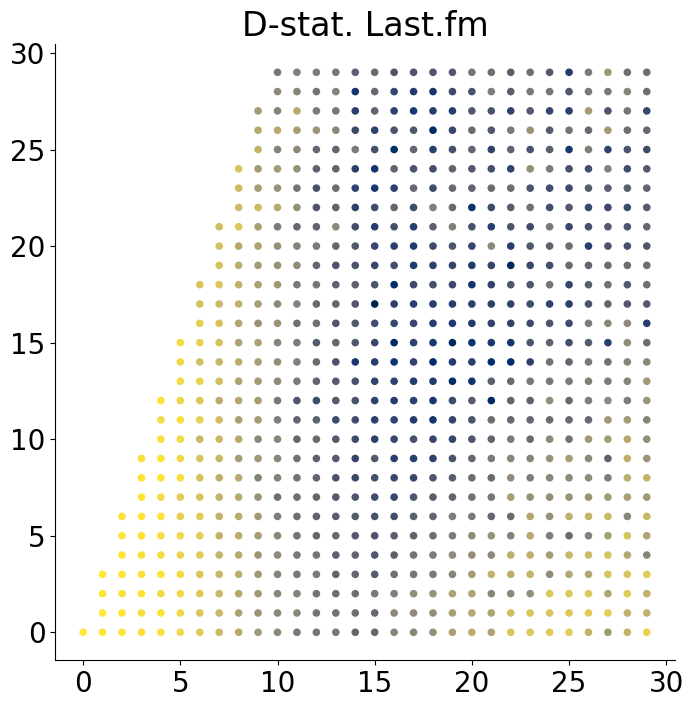

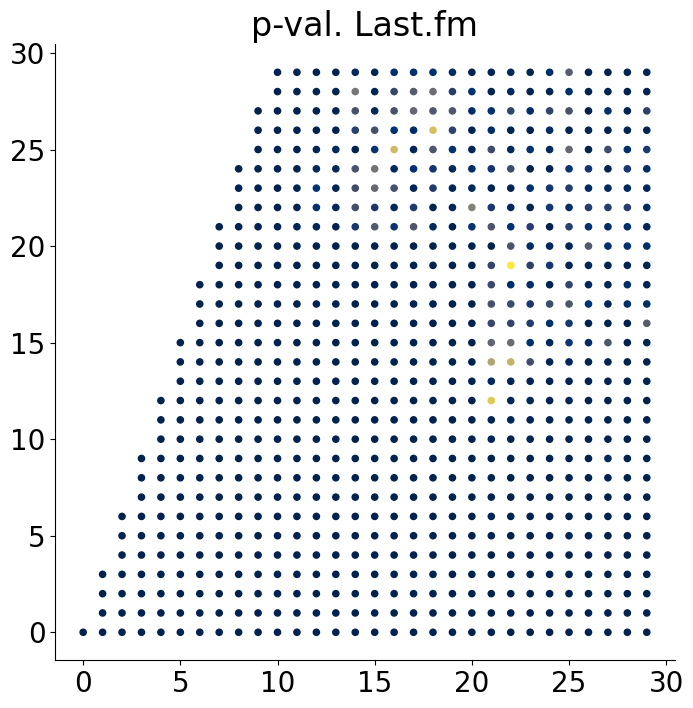

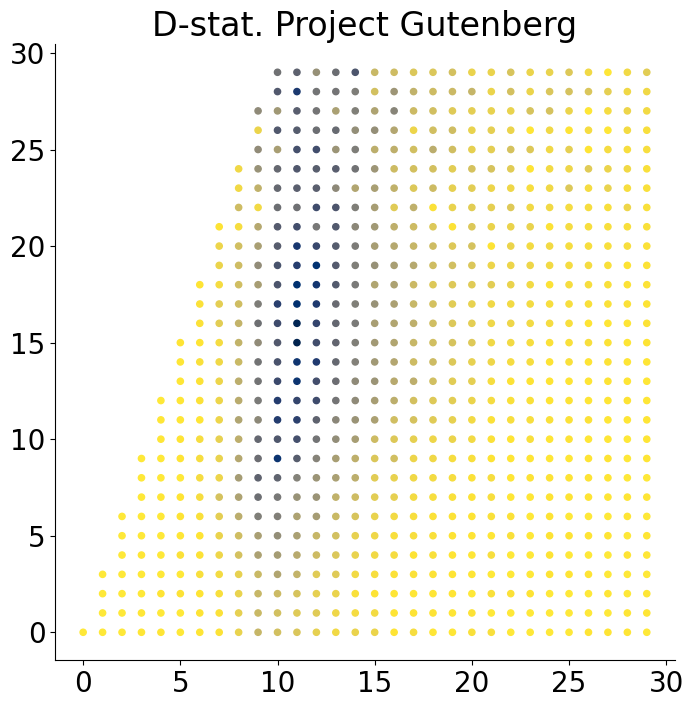

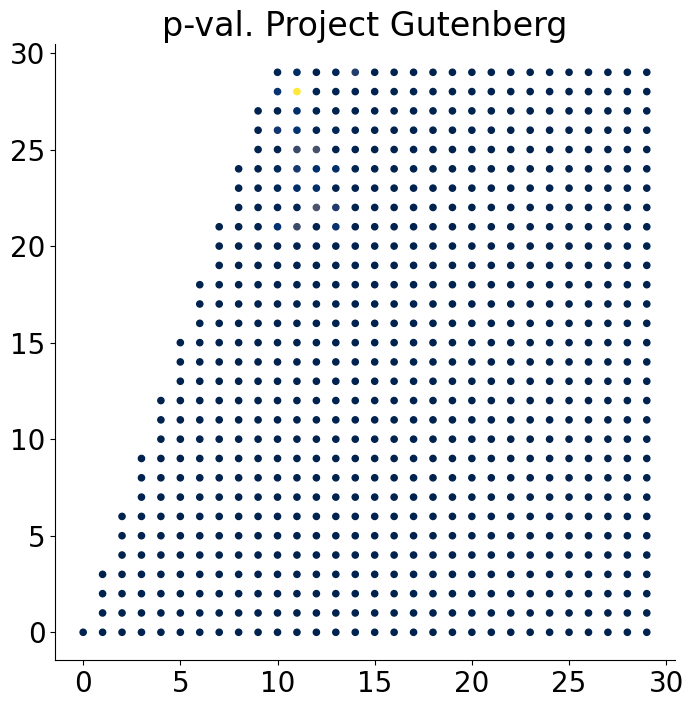

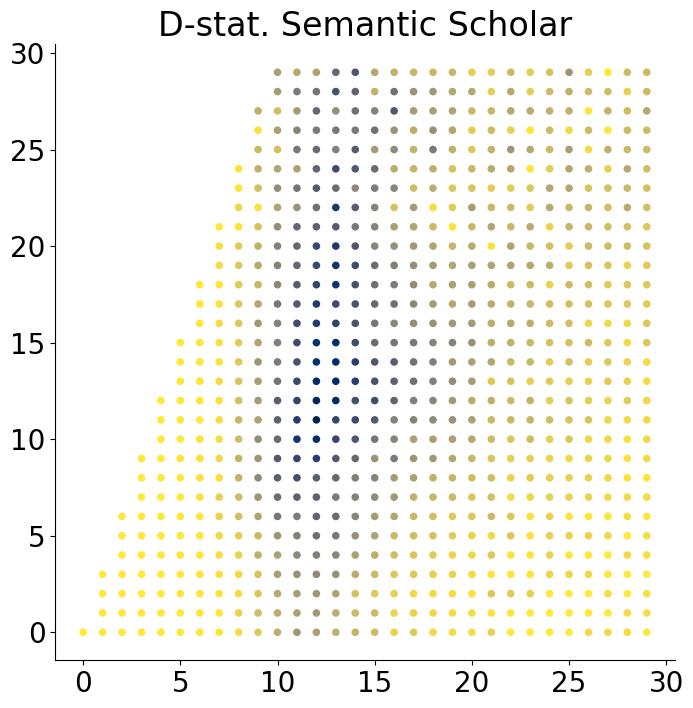

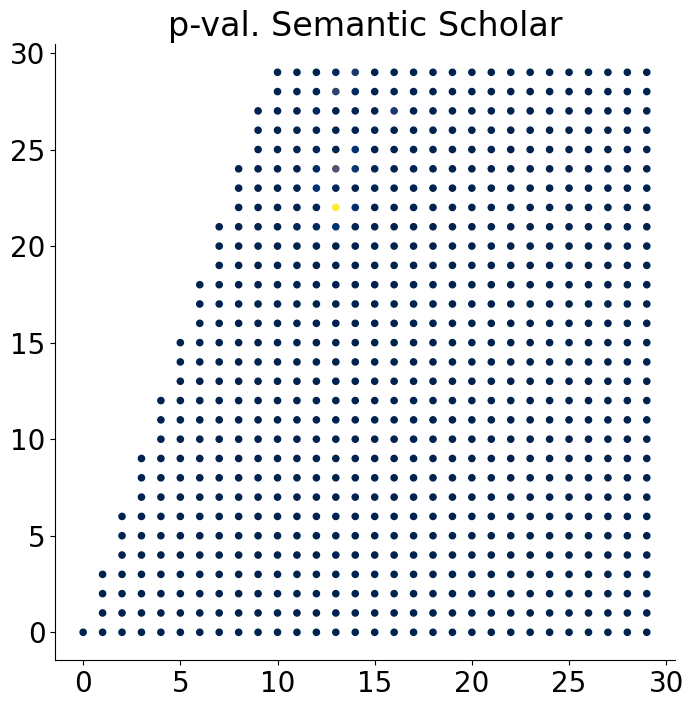

In [289]:
for dataset_label in data.keys():
    x = []
    y = []
    z = []
    for nu_1 in d_statistic_ks2d_dict2.keys():
        for nu_2 in d_statistic_ks2d_dict2[nu_1].keys():
            x.append(nu_1)
            y.append(nu_2)
            z.append(d_statistic_ks2d_dict2[nu_1][nu_2][dataset_label])
    fig,ax = plt.subplots(figsize=(8,8))
    scatter_with_density(
        x = x,
        y = y,
        z = z,
        ax = ax,
        label_scatter = dataset_label,
    )
    ax.set_title(f'D-stat. {dataset_label}')
    
    
    x = []
    y = []
    z = []
    for nu_1 in p_value_ks2d_dict2.keys():
        for nu_2 in p_value_ks2d_dict2[nu_1].keys():
            x.append(nu_1)
            y.append(nu_2)
            z.append(p_value_ks2d_dict2[nu_1][nu_2][dataset_label])
    fig,ax = plt.subplots(figsize=(8,8))
    scatter_with_density(
        x = x,
        y = y,
        z = z,
        ax = ax,
        label_scatter = dataset_label,
    )
    ax.set_title(f'p-val. {dataset_label}')
    

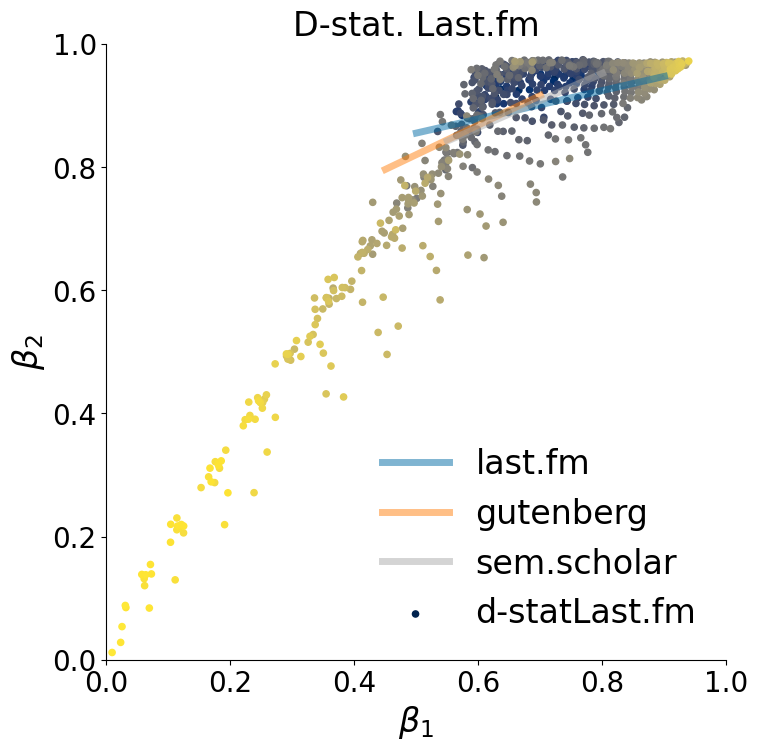

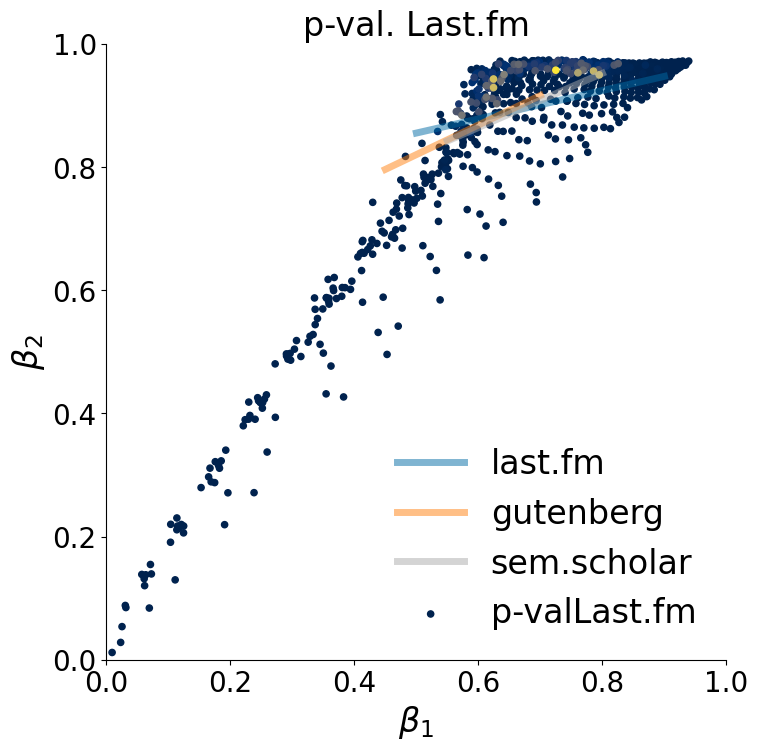

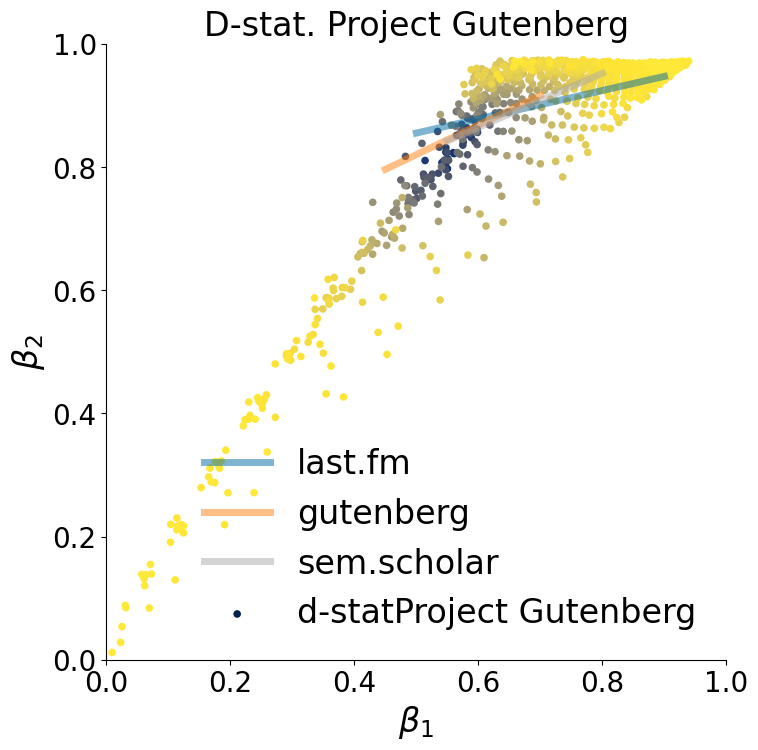

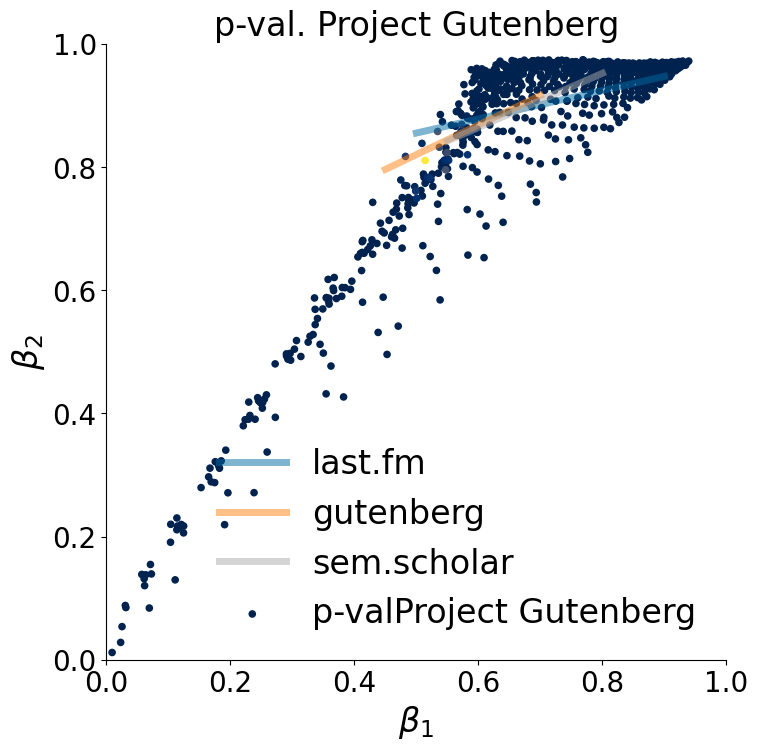

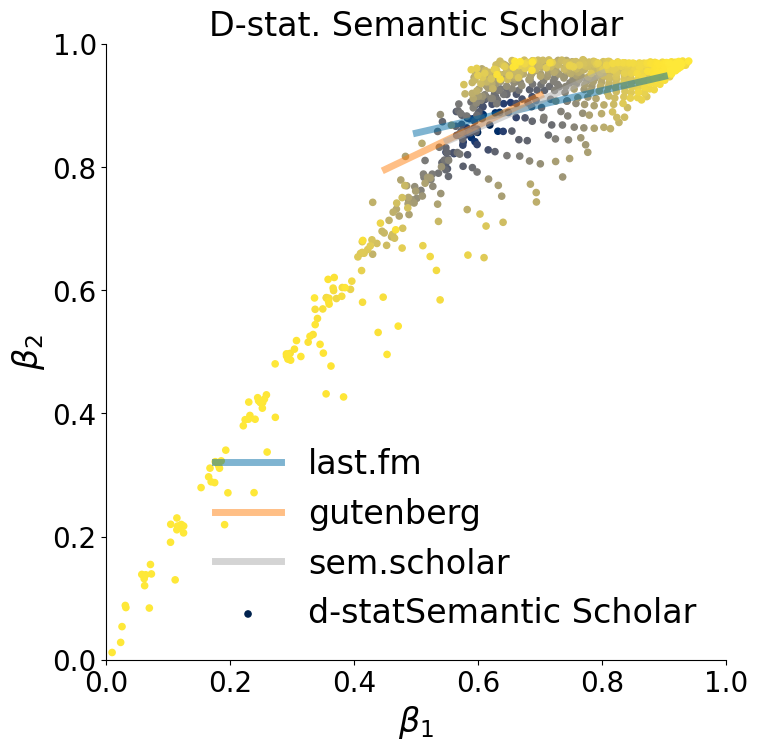

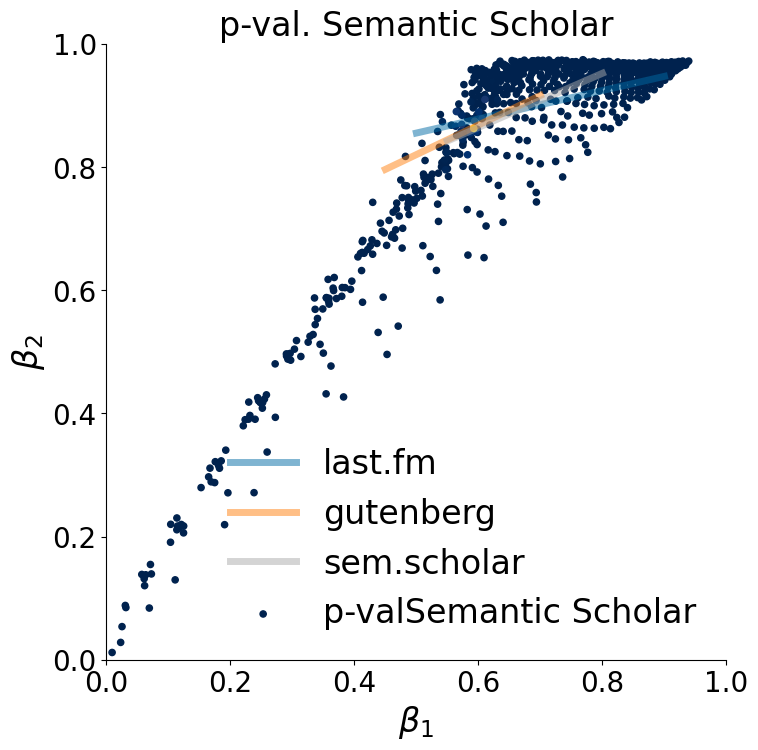

In [290]:
min_nu_1_cut = 0
max_nu_1_cut = 20
min_nu_2_cut = 0
fraction_nu_2_cut = 1
    
average_beta_dict = average_betas_dict_new_pairs_UMT[(1, 0)]
average_beta2_dict = average_beta2_dict_new_pairs_UMT[(1, 0)]

# average_beta_dict_to_plot = {}
# average_beta2_dict_to_plot = {}
# for nu_1 in tqdm(sorted(average_beta_dict.keys())):
#     if nu_1 <= max_nu_1_cut and nu_1 >= min_nu_1_cut:
#         nu_1_dict = average_beta_dict[nu_1]
#         for nu_2 in sorted(nu_1_dict.keys()):
#             if nu_2 <= fraction_nu_2_cut*nu_1 and nu_2 >= min_nu_2_cut:
#                 beta = average_beta_dict[nu_1][nu_2]
#                 beta_2 = average_beta2_dict[nu_1][nu_2]
#                 try:
#                     average_beta_dict_to_plot[nu_2+nu_2].append(beta)
#                     average_beta2_dict_to_plot[nu_1+nu_2].append(beta_2)
#                 except:
#                     average_beta_dict_to_plot[nu_1+nu_2] = [beta]
#                     average_beta2_dict_to_plot[nu_1+nu_2] = [beta_2]

                    
for dataset_label in data.keys():
    x = []
    y = []
    z = []
    for nu_1 in d_statistic_ks2d_dict2.keys():
        for nu_2 in d_statistic_ks2d_dict2[nu_1].keys():
            x.append(average_beta_dict[nu_1][nu_2])
            y.append(average_beta2_dict[nu_1][nu_2])
            z.append(d_statistic_ks2d_dict2[nu_1][nu_2][dataset_label])
    fig,ax = plt.subplots(figsize=(8,8))
    scatter_with_density(
        x = x,
        y = y,
        z = z,
        ax = ax,
        label_scatter = 'd-stat'+dataset_label,
    )
    ax.set_title(f'D-stat. {dataset_label}')
    ax.set_xlim([0,1])
    ax.set_ylim([0,1])
    ax.set_xlabel(r'$\beta_1$')
    ax.set_ylabel(r'$\beta_2$')
    x = np.array([0.5,.9])
    ax.plot(x, 0.23*x+0.74, label = 'last.fm', lw = 5, alpha = 0.5)
    x = np.array([.45,.7])
    ax.plot(x, 0.48*x+0.58, label = 'gutenberg', lw = 5, alpha = 0.5)
    x = np.array([0.55,.8])
    ax.plot(x, 0.44*x+0.60, label = 'sem.scholar', lw = 5, alpha = 0.5)
    ax.legend()
    
    x = []
    y = []
    z = []
    for nu_1 in p_value_ks2d_dict2.keys():
        for nu_2 in p_value_ks2d_dict2[nu_1].keys():
            x.append(average_beta_dict[nu_1][nu_2])
            y.append(average_beta2_dict[nu_1][nu_2])
            z.append(p_value_ks2d_dict2[nu_1][nu_2][dataset_label])
    fig,ax = plt.subplots(figsize=(8,8))
    scatter_with_density(
        x = x,
        y = y,
        z = z,
        ax = ax,
        label_scatter = 'p-val'+dataset_label,
    )
    ax.set_title(f'p-val. {dataset_label}')
    ax.set_xlim([0,1])
    ax.set_ylim([0,1])
    ax.set_xlabel(r'$\beta_1$')
    ax.set_ylabel(r'$\beta_2$')
    x = np.array([0.5,.9])
    ax.plot(x, 0.23*x+0.74, label = 'last.fm', lw = 5, alpha = 0.5)
    x = np.array([.45,.7])
    ax.plot(x, 0.48*x+0.58, label = 'gutenberg', lw = 5, alpha = 0.5)
    x = np.array([0.55,.8])
    ax.plot(x, 0.44*x+0.60, label = 'sem.scholar', lw = 5, alpha = 0.5)
    ax.legend()

In [291]:
def find_minimum(
    d_statistic_ks2d_dict,
    dataset_label,
):
    min_ = 10000000
    min_nu_1 = -1
    min_nu_2 = -1
    for nu_1 in d_statistic_ks2d_dict.keys():
        for nu_2 in d_statistic_ks2d_dict[nu_1].keys():
            if d_statistic_ks2d_dict[nu_1][nu_2][dataset_label] < min_:
                min_ = min(min_,d_statistic_ks2d_dict[nu_1][nu_2][dataset_label])
                min_nu_1 = nu_1
                min_nu_2 = nu_2
    return min_, min_nu_1, min_nu_2

In [293]:
for dataset_label in data.keys():
    min_, min_nu_1, min_nu_2 = find_minimum(
        d_statistic_ks2d_dict2,
        dataset_label,
    )
    print(dataset_label, min_, min_nu_1, min_nu_2)
    max_, max_nu_1, max_nu_2 = find_maximum(
        p_value_ks2d_dict2,
        dataset_label,
    )
    print(dataset_label, max_, max_nu_1, max_nu_2)

Last.fm 0.6132584269662922 15 17
Last.fm 0.0010050014829668986 22 19
Project Gutenberg 0.27573967510312164 11 15
Project Gutenberg 0.1377112338700524 11 28
Semantic Scholar 0.44313157894736843 12 11
Semantic Scholar 0.011037672649703331 13 22


In [292]:
def find_maximum(
    p_value_ks2d_dict,
    dataset_label,
):
    max_ = -1
    max_nu_1 = -1
    max_nu_2 = -1
    for nu_1 in p_value_ks2d_dict.keys():
        for nu_2 in p_value_ks2d_dict[nu_1].keys():
            if p_value_ks2d_dict[nu_1][nu_2][dataset_label] > max_:
                max_ = max(max_,p_value_ks2d_dict[nu_1][nu_2][dataset_label])
                max_nu_1 = nu_1
                max_nu_2 = nu_2
    return max_, max_nu_1, max_nu_2

In [293]:
for dataset_label in data.keys():
    min_, min_nu_1, min_nu_2 = find_minimum(
        d_statistic_ks2d_dict2,
        dataset_label,
    )
    print(dataset_label, min_, min_nu_1, min_nu_2)
    max_, max_nu_1, max_nu_2 = find_maximum(
        p_value_ks2d_dict2,
        dataset_label,
    )
    print(dataset_label, max_, max_nu_1, max_nu_2)

Last.fm 0.6132584269662922 15 17
Last.fm 0.0010050014829668986 22 19
Project Gutenberg 0.27573967510312164 11 15
Project Gutenberg 0.1377112338700524 11 28
Semantic Scholar 0.44313157894736843 12 11
Semantic Scholar 0.011037672649703331 13 22


##### less points

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/12 [00:00<?, ?it/s]

  0%|          | 0/13 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/17 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

  0%|          | 0/19 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

FOUND 	23100
look_only_among_extracted_colors,add_nu_2_not_1,attach_new_colors_to_random,directed
True False False False


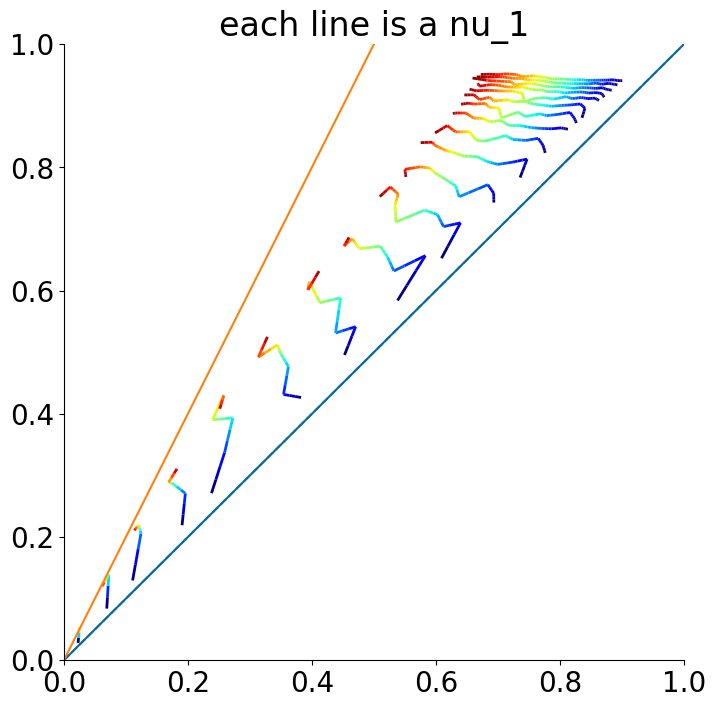

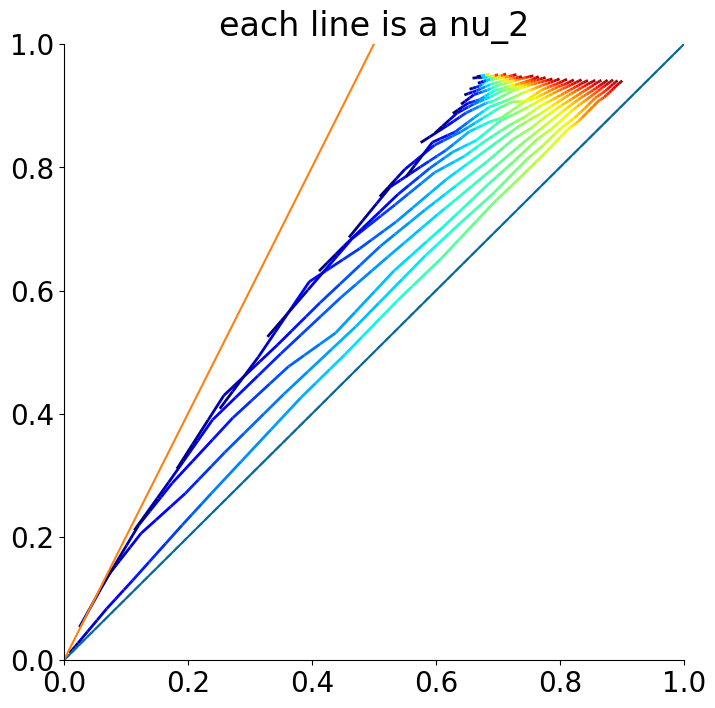

In [277]:
for look_only_among_extracted_colors in [True]:
    for add_nu_2_not_1 in [False]:
        attach_new_colors_to_random = False
        directed = False
        average_beta_dict, average_beta2_dict, average_beta, average_beta2, average_beta_inverse, average_beta2_inverse = get_average_data_new_pairs_UMT(
            rho = 10, 
            starting_nu_1 = 0, ending_nu_1 = 20,
            starting_nu_2 = 0, ending_nu_2 = None,
            fraction_nu_2_cut=1,
            N_0 = 1, 
            M_0 = 0, 
            Tmax = int(1e4),
            do_fig = True,
            t_to_use = 1e5,
            num_to_save = 1000,
            look_only_among_extracted_colors = look_only_among_extracted_colors,
            add_nu_2_not_1 = add_nu_2_not_1,
            attach_new_colors_to_random = attach_new_colors_to_random,
            look_among_all_non_explored_pairs_if_not_enough = False,
            color_by_key = 'nu_1/(nu_2+rho)',
            directed = directed,
        )
        average_betas_dict_new_pairs_UMT[(1,0)] = average_beta_dict
        average_beta2_dict_new_pairs_UMT[(1,0)] = average_beta2_dict
        average_betas_new_pairs_UMT[(1,0)] = average_beta
        average_beta2_new_pairs_UMT[(1,0)] = average_beta2
        average_beta_inverse_new_pairs_UMT[(1,0)] = average_beta_inverse
        average_beta2_inverse_new_pairs_UMT[(1,0)] = average_beta2_inverse
print('look_only_among_extracted_colors,add_nu_2_not_1,attach_new_colors_to_random,directed')
print(look_only_among_extracted_colors,add_nu_2_not_1,attach_new_colors_to_random,directed)

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

nu_1 1
nu_1 2
nu_1 3
nu_1 4
nu_1 5
nu_1 6
nu_1 7
nu_1 8
nu_1 9
nu_1 10
nu_1 11
nu_1 12
nu_1 13
nu_1 14
nu_1 15
nu_1 16
nu_1 17
nu_1 18
nu_1 19
nu_1 20


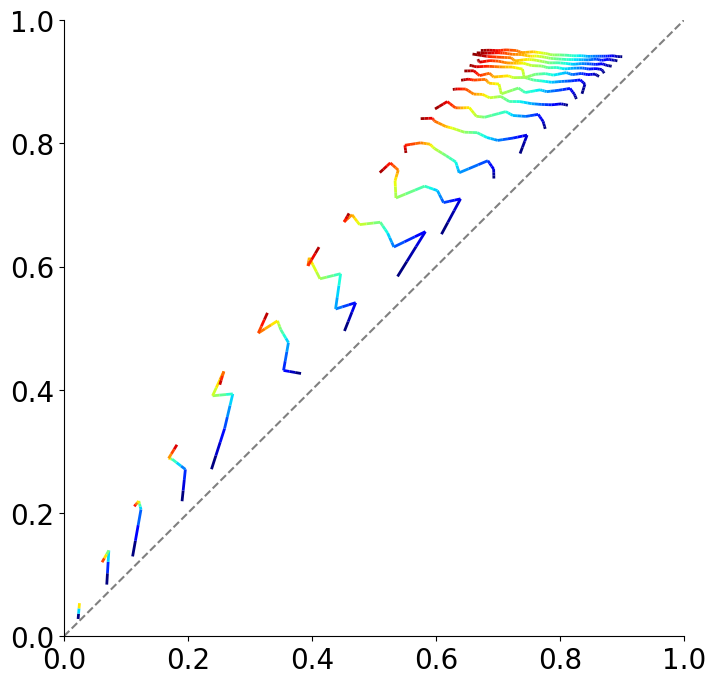

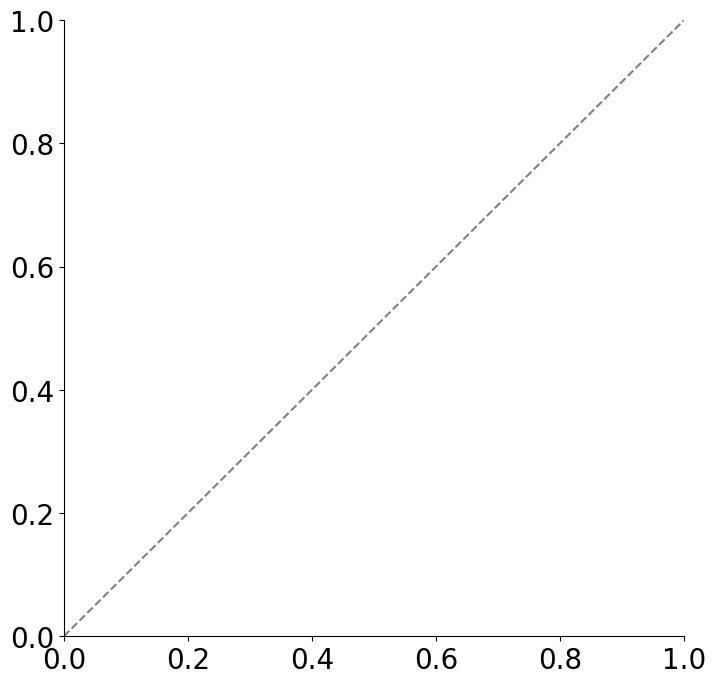

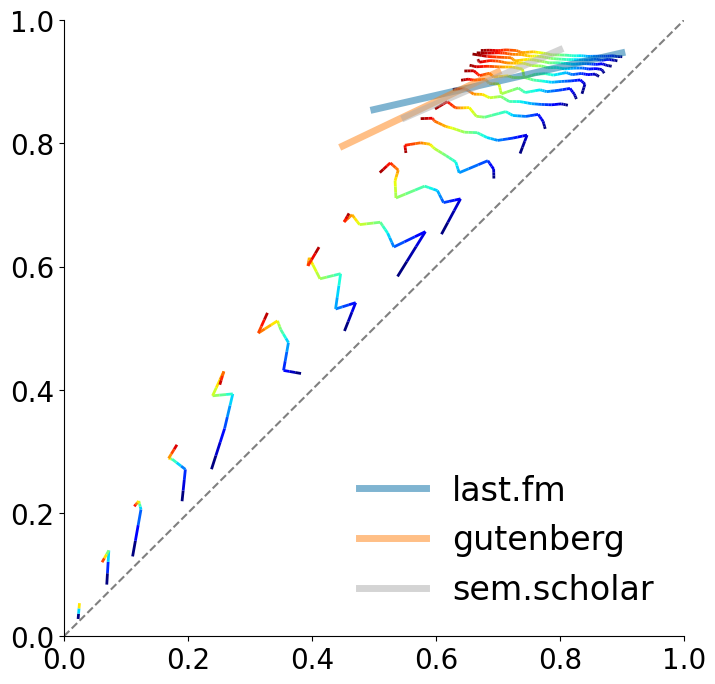

In [278]:

average_beta_dict = average_betas_dict_new_pairs_UMT[(1, 0)]
average_beta2_dict = average_beta2_dict_new_pairs_UMT[(1, 0)]


min_nu_1_cut = 0
max_nu_1_cut = 20
min_nu_2_cut = 0
fraction_nu_2_cut = 1
    
average_beta_to_plot = {}
average_beta2_to_plot = {}
for nu_1 in tqdm(sorted(average_beta_dict.keys())):
    nu_1_dict = average_beta_dict[nu_1]
    average_beta_to_plot[nu_1] = []
    average_beta2_to_plot[nu_1] = []
    for nu_2 in sorted(nu_1_dict.keys()):
        beta = average_beta_dict[nu_1][nu_2]
        beta_2 = average_beta2_dict[nu_1][nu_2]
        average_beta_to_plot[nu_1].append(beta)
        average_beta2_to_plot[nu_1].append(beta_2)


plot_average_beta_1_beta2_by_two_parameters(
    average_beta_to_plot,
    average_beta2_to_plot,
    ax = None,
    fig = None,
)

    
average_beta_to_plot = {}
average_beta2_to_plot = {}
for nu_1 in tqdm(sorted(average_beta_dict.keys())):
    if nu_1 > max_nu_1_cut or nu_1 < min_nu_1_cut:
        nu_1_dict = average_beta_dict[nu_1]
        average_beta_to_plot[nu_1] = []
        average_beta2_to_plot[nu_1] = []
        for nu_2 in sorted(nu_1_dict.keys()):
            beta = average_beta_dict[nu_1][nu_2]
            beta_2 = average_beta2_dict[nu_1][nu_2]
            average_beta_to_plot[nu_1].append(beta)
            average_beta2_to_plot[nu_1].append(beta_2)
    elif nu_1 <= max_nu_1_cut:
        nu_1_dict = average_beta_dict[nu_1]
        average_beta_to_plot[nu_1] = []
        average_beta2_to_plot[nu_1] = []
        for nu_2 in sorted(nu_1_dict.keys()):
            if nu_2 > fraction_nu_2_cut*nu_1 or nu_2 < min_nu_2_cut:
                beta = average_beta_dict[nu_1][nu_2]
                beta_2 = average_beta2_dict[nu_1][nu_2]
                average_beta_to_plot[nu_1].append(beta)
                average_beta2_to_plot[nu_1].append(beta_2)


plot_average_beta_1_beta2_by_two_parameters(
    average_beta_to_plot,
    average_beta2_to_plot,
    ax = None,
    fig = None,
)


fig,ax = plt.subplots(figsize=(8,8))

average_beta_to_plot = {}
average_beta2_to_plot = {}
for nu_1 in tqdm(sorted(average_beta_dict.keys())):
    if nu_1 <= max_nu_1_cut and nu_1 >= min_nu_1_cut:
        nu_1_dict = average_beta_dict[nu_1]
        average_beta_to_plot[nu_1] = []
        average_beta2_to_plot[nu_1] = []
        for nu_2 in sorted(nu_1_dict.keys()):
            if nu_2 <= fraction_nu_2_cut*nu_1 and nu_2 >= min_nu_2_cut:
                beta = average_beta_dict[nu_1][nu_2]
                beta_2 = average_beta2_dict[nu_1][nu_2]
                average_beta_to_plot[nu_1].append(beta)
                average_beta2_to_plot[nu_1].append(beta_2)


plot_average_beta_1_beta2_by_two_parameters(
    average_beta_to_plot,
    average_beta2_to_plot,
    ax = ax,
    fig = fig,
    print_values_parameters_plotted=True
)
x = np.array([0.5,.9])
plt.plot(x, 0.23*x+0.74, label = 'last.fm', lw = 5, alpha = 0.5)
x = np.array([.45,.7])
plt.plot(x, 0.48*x+0.58, label = 'gutenberg', lw = 5, alpha = 0.5)
x = np.array([0.55,.8])
plt.plot(x, 0.44*x+0.60, label = 'sem.scholar', lw = 5, alpha = 0.5)
plt.legend()

In [254]:
d_statistic_ks2d_dict, p_value_ks2d_dict = get_ks2d_with_data(
    data,
    rho = 10, 
    starting_nu_1 = 0, ending_nu_1 = 20,
    starting_nu_2 = 0, ending_nu_2 = None,
    fraction_nu_2_cut = 1,
    N_0 = 1, 
    M_0 = 0, 
    Tmax = int(1e4),
    do_fig = True,
    t_to_use = 1e5,
    num_to_save = 1000,
    look_only_among_extracted_colors = True,
    add_nu_2_not_1 = False,
    attach_new_colors_to_random = False,
    look_among_all_non_explored_pairs_if_not_enough = False,
    color_by_key = None,
    directed = False,
)

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/12 [00:00<?, ?it/s]

  0%|          | 0/13 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/17 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

  0%|          | 0/19 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

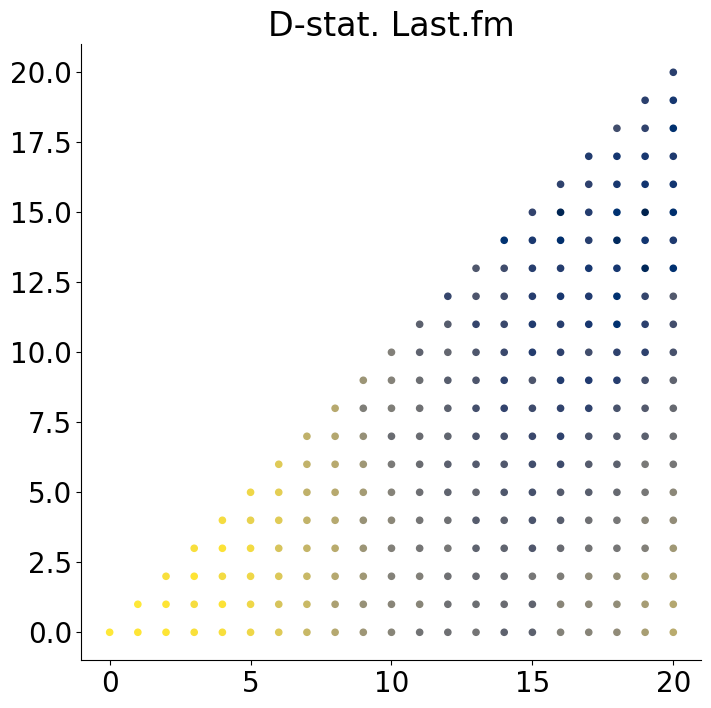

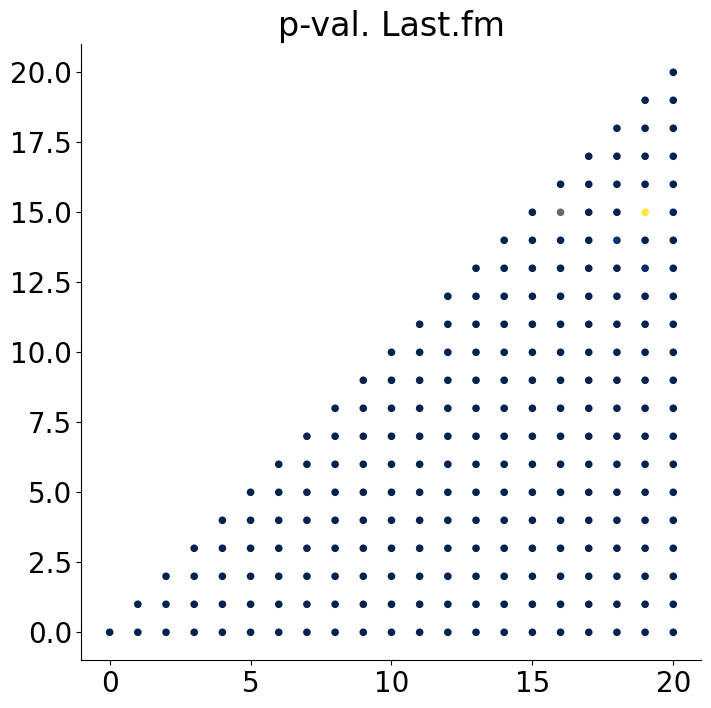

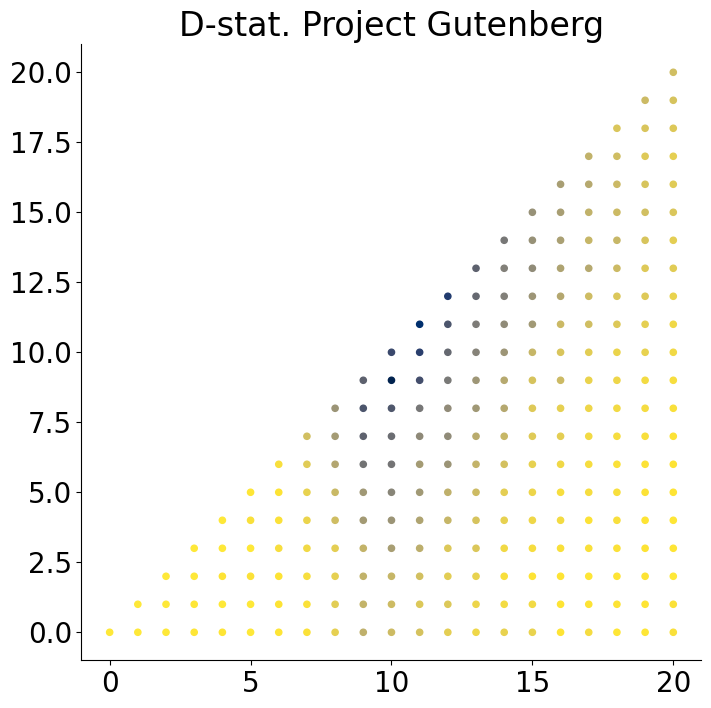

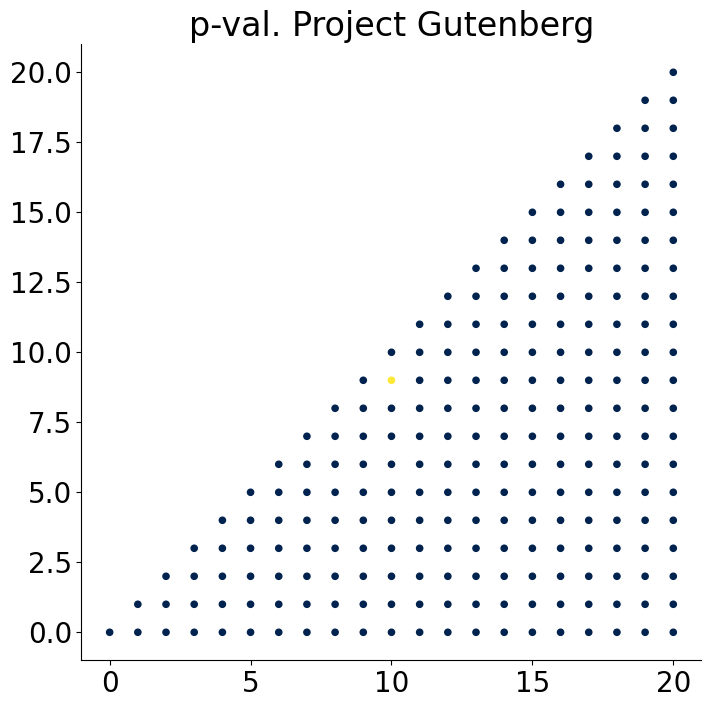

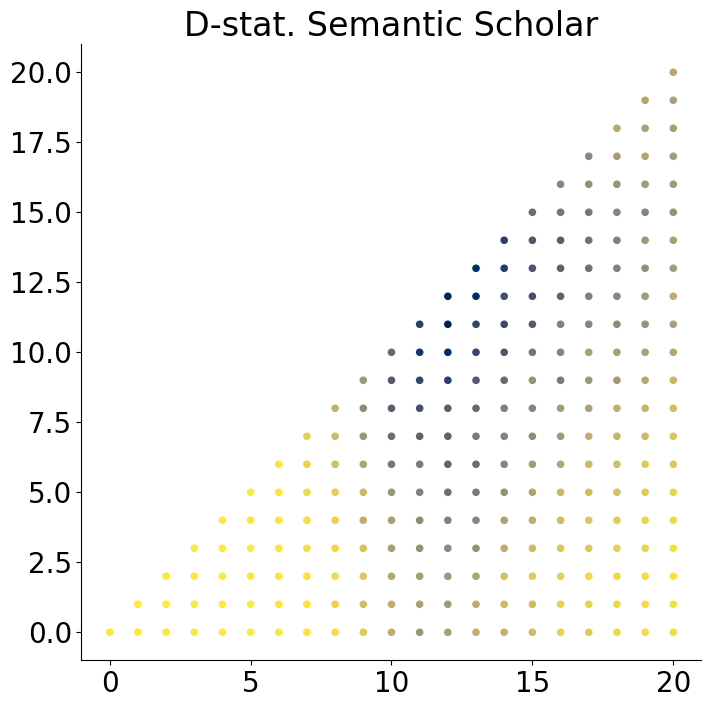

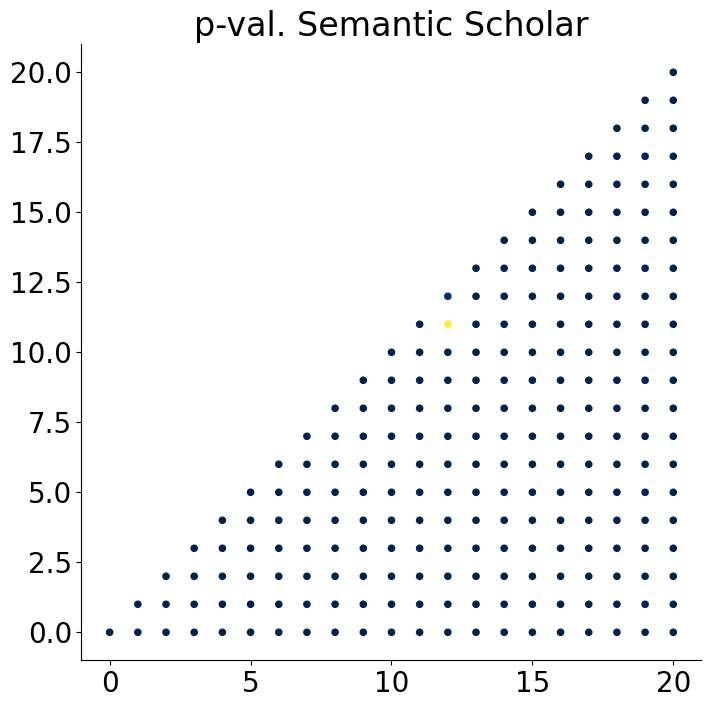

In [279]:
for dataset_label in data.keys():
    x = []
    y = []
    z = []
    for nu_1 in d_statistic_ks2d_dict.keys():
        for nu_2 in d_statistic_ks2d_dict[nu_1].keys():
            x.append(nu_1)
            y.append(nu_2)
            z.append(d_statistic_ks2d_dict[nu_1][nu_2][dataset_label])
    fig,ax = plt.subplots(figsize=(8,8))
    scatter_with_density(
        x = x,
        y = y,
        z = z,
        ax = ax,
        label_scatter = dataset_label,
    )
    ax.set_title(f'D-stat. {dataset_label}')
    
    
    x = []
    y = []
    z = []
    for nu_1 in p_value_ks2d_dict.keys():
        for nu_2 in p_value_ks2d_dict[nu_1].keys():
            x.append(nu_1)
            y.append(nu_2)
            z.append(p_value_ks2d_dict[nu_1][nu_2][dataset_label])
    fig,ax = plt.subplots(figsize=(8,8))
    scatter_with_density(
        x = x,
        y = y,
        z = z,
        ax = ax,
        label_scatter = dataset_label,
    )
    ax.set_title(f'p-val. {dataset_label}')
    

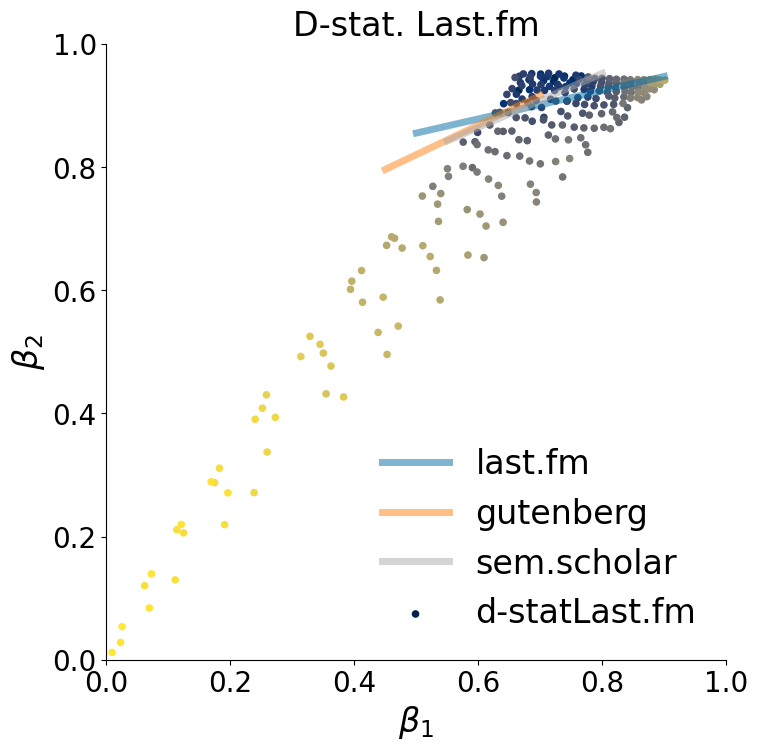

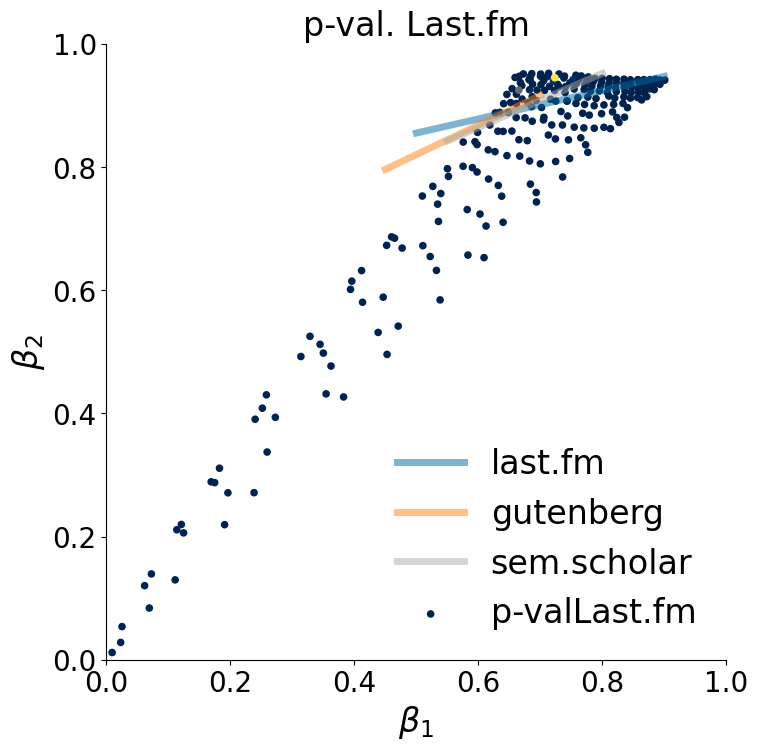

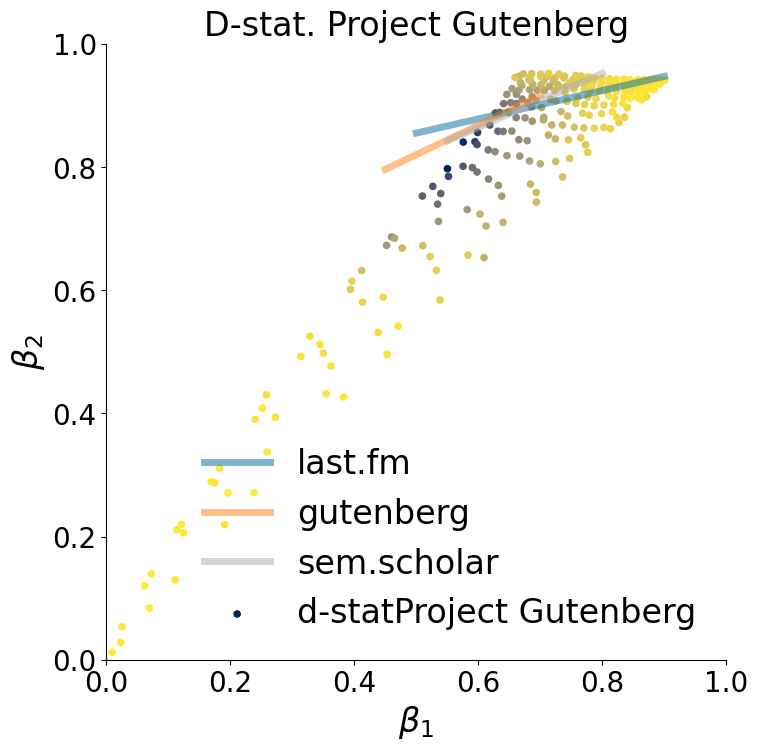

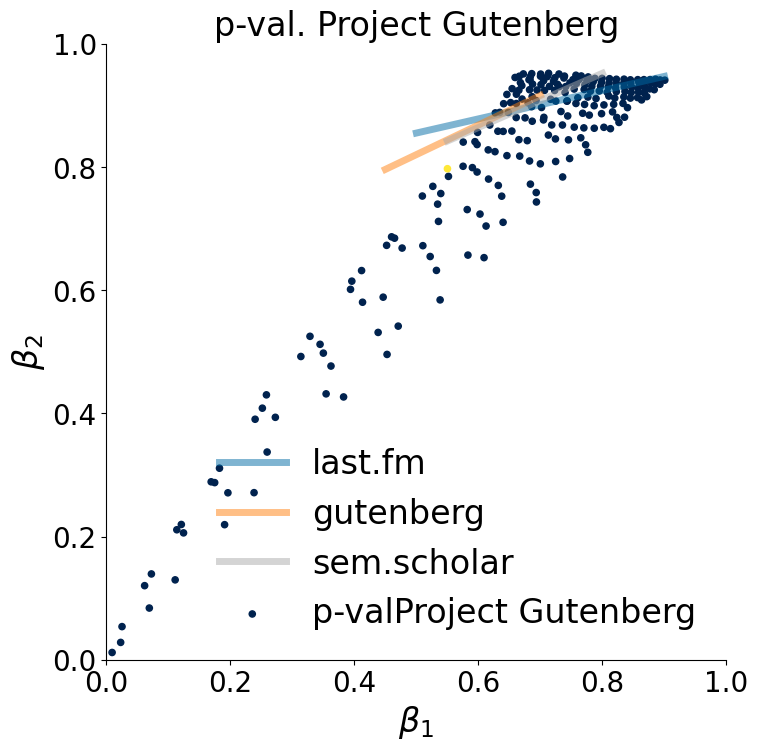

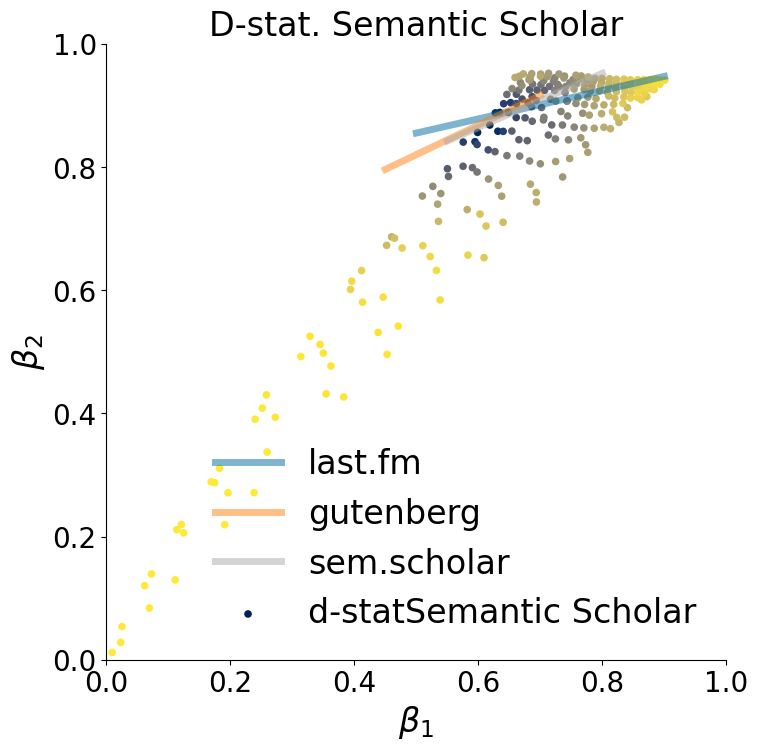

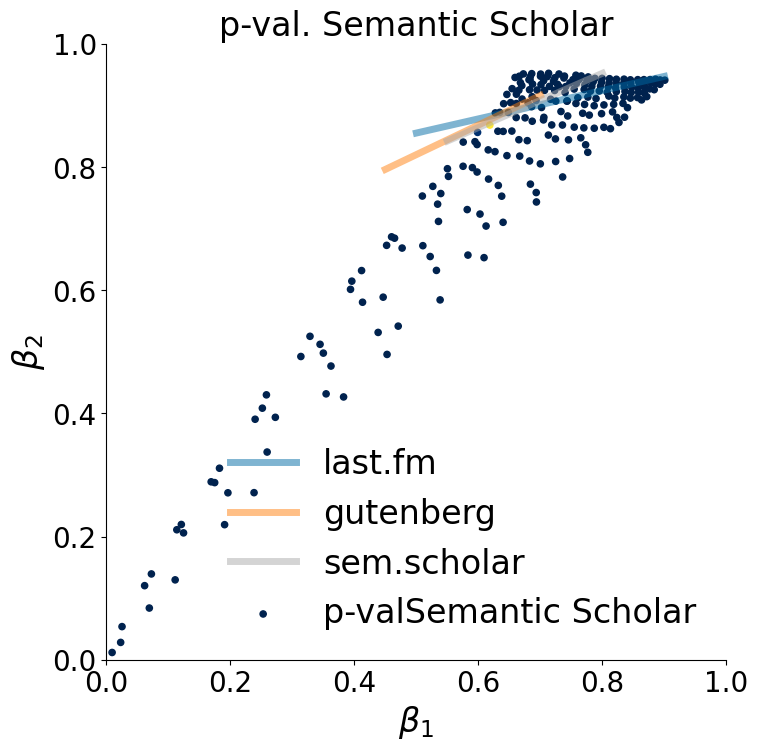

In [280]:
min_nu_1_cut = 0
max_nu_1_cut = 20
min_nu_2_cut = 0
fraction_nu_2_cut = 1
    
average_beta_dict = average_betas_dict_new_pairs_UMT[(1, 0)]
average_beta2_dict = average_beta2_dict_new_pairs_UMT[(1, 0)]

# average_beta_dict_to_plot = {}
# average_beta2_dict_to_plot = {}
# for nu_1 in tqdm(sorted(average_beta_dict.keys())):
#     if nu_1 <= max_nu_1_cut and nu_1 >= min_nu_1_cut:
#         nu_1_dict = average_beta_dict[nu_1]
#         for nu_2 in sorted(nu_1_dict.keys()):
#             if nu_2 <= fraction_nu_2_cut*nu_1 and nu_2 >= min_nu_2_cut:
#                 beta = average_beta_dict[nu_1][nu_2]
#                 beta_2 = average_beta2_dict[nu_1][nu_2]
#                 try:
#                     average_beta_dict_to_plot[nu_2+nu_2].append(beta)
#                     average_beta2_dict_to_plot[nu_1+nu_2].append(beta_2)
#                 except:
#                     average_beta_dict_to_plot[nu_1+nu_2] = [beta]
#                     average_beta2_dict_to_plot[nu_1+nu_2] = [beta_2]

                    
for dataset_label in data.keys():
    x = []
    y = []
    z = []
    for nu_1 in d_statistic_ks2d_dict.keys():
        for nu_2 in d_statistic_ks2d_dict[nu_1].keys():
            x.append(average_beta_dict[nu_1][nu_2])
            y.append(average_beta2_dict[nu_1][nu_2])
            z.append(d_statistic_ks2d_dict[nu_1][nu_2][dataset_label])
    fig,ax = plt.subplots(figsize=(8,8))
    scatter_with_density(
        x = x,
        y = y,
        z = z,
        ax = ax,
        label_scatter = 'd-stat'+dataset_label,
    )
    ax.set_title(f'D-stat. {dataset_label}')
    ax.set_xlim([0,1])
    ax.set_ylim([0,1])
    ax.set_xlabel(r'$\beta_1$')
    ax.set_ylabel(r'$\beta_2$')
    x = np.array([0.5,.9])
    ax.plot(x, 0.23*x+0.74, label = 'last.fm', lw = 5, alpha = 0.5)
    x = np.array([.45,.7])
    ax.plot(x, 0.48*x+0.58, label = 'gutenberg', lw = 5, alpha = 0.5)
    x = np.array([0.55,.8])
    ax.plot(x, 0.44*x+0.60, label = 'sem.scholar', lw = 5, alpha = 0.5)
    ax.legend()
    
    x = []
    y = []
    z = []
    for nu_1 in p_value_ks2d_dict.keys():
        for nu_2 in p_value_ks2d_dict[nu_1].keys():
            x.append(average_beta_dict[nu_1][nu_2])
            y.append(average_beta2_dict[nu_1][nu_2])
            z.append(p_value_ks2d_dict[nu_1][nu_2][dataset_label])
    fig,ax = plt.subplots(figsize=(8,8))
    scatter_with_density(
        x = x,
        y = y,
        z = z,
        ax = ax,
        label_scatter = 'p-val'+dataset_label,
    )
    ax.set_title(f'p-val. {dataset_label}')
    ax.set_xlim([0,1])
    ax.set_ylim([0,1])
    ax.set_xlabel(r'$\beta_1$')
    ax.set_ylabel(r'$\beta_2$')
    x = np.array([0.5,.9])
    ax.plot(x, 0.23*x+0.74, label = 'last.fm', lw = 5, alpha = 0.5)
    x = np.array([.45,.7])
    ax.plot(x, 0.48*x+0.58, label = 'gutenberg', lw = 5, alpha = 0.5)
    x = np.array([0.55,.8])
    ax.plot(x, 0.44*x+0.60, label = 'sem.scholar', lw = 5, alpha = 0.5)
    ax.legend()

In [281]:
def find_minimum(
    d_statistic_ks2d_dict,
    dataset_label,
):
    min_ = 10000000
    min_nu_1 = -1
    min_nu_2 = -1
    for nu_1 in d_statistic_ks2d_dict.keys():
        for nu_2 in d_statistic_ks2d_dict[nu_1].keys():
            if d_statistic_ks2d_dict[nu_1][nu_2][dataset_label] < min_:
                min_ = min(min_,d_statistic_ks2d_dict[nu_1][nu_2][dataset_label])
                min_nu_1 = nu_1
                min_nu_2 = nu_2
    return min_, min_nu_1, min_nu_2

In [282]:
def find_maximum(
    p_value_ks2d_dict,
    dataset_label,
):
    max_ = -1
    max_nu_1 = -1
    max_nu_2 = -1
    for nu_1 in p_value_ks2d_dict.keys():
        for nu_2 in p_value_ks2d_dict[nu_1].keys():
            if p_value_ks2d_dict[nu_1][nu_2][dataset_label] > max_:
                max_ = max(max_,p_value_ks2d_dict[nu_1][nu_2][dataset_label])
                max_nu_1 = nu_1
                max_nu_2 = nu_2
    return max_, max_nu_1, max_nu_2

In [283]:
for dataset_label in data.keys():
    min_, min_nu_1, min_nu_2 = find_minimum(
        d_statistic_ks2d_dict,
        dataset_label,
    )
    print(dataset_label, min_, min_nu_1, min_nu_2)
    max_, max_nu_1, max_nu_2 = find_maximum(
        p_value_ks2d_dict,
        dataset_label,
    )
    print(dataset_label, max_, max_nu_1, max_nu_2)

Last.fm 0.6264606741573033 19 15
Last.fm 4.663030853050394e-23 19 15
Project Gutenberg 0.35185364363191934 10 9
Project Gutenberg 4.183138033984717e-09 10 9
Semantic Scholar 0.44313157894736843 12 11
Semantic Scholar 1.1613070975116756e-13 12 11


#### Compare with formula

In [387]:
def get_expected_undirected(
    rho,
    nu_1,
    nu_2,
    used_rule_nu_2_plus_1 = True, # useless now
):
#     if used_rule_nu_2_plus_1 == False:
#         nu_2 = nu_2 - 1
#     if nu_1 >= rho:
#         beta_1 = beta_2 = 1
#     elif nu_2 >= rho:
#         beta_1 = nu_1/nu_2
#         beta_2 = 1
#     else:
#         beta_1 = nu_1/(rho)
#         beta_2 = np.max([nu_1,nu_2]) / (rho)
#     beta_2 = np.min([2*beta_1, beta_2])
    if nu_2 > 2*nu_1:
        nu_2 = 2*nu_1
    if nu_2 <= nu_1 and nu_1 <= rho:
        beta_1 = beta_2 = float(nu_1)/rho
    elif nu_1 < nu_2 and nu_2 <= rho:
        beta_1 = float(nu_1)/rho
        beta_2 = float(2*nu_2 - 1)/(2*rho)
    elif nu_1 < nu_2 and nu_2 > rho:
        beta_1 = float(2*nu_1)/(2*nu_2 - 1)
        beta_2 = 1.
    elif nu_1 >= rho:
        beta_1 = beta_2 = 1.
    return beta_1, beta_2

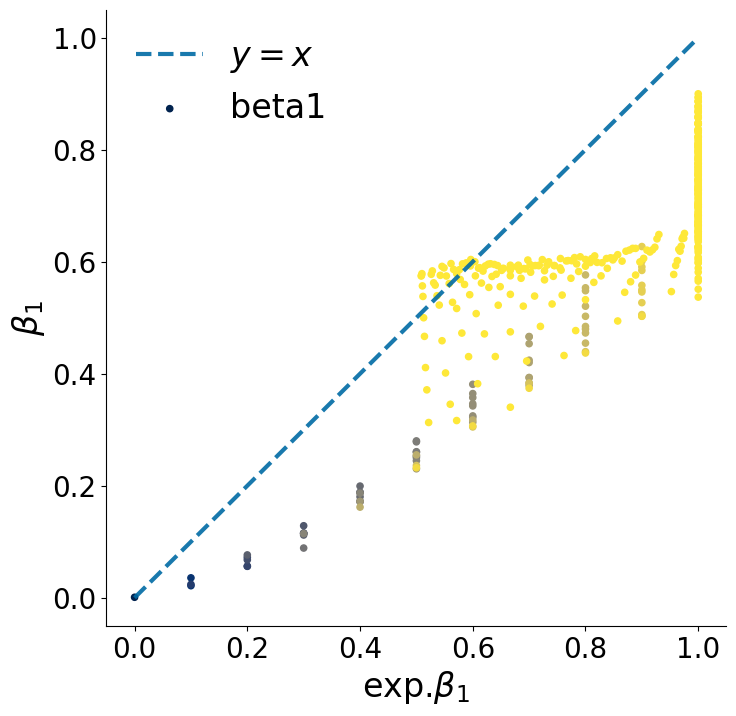

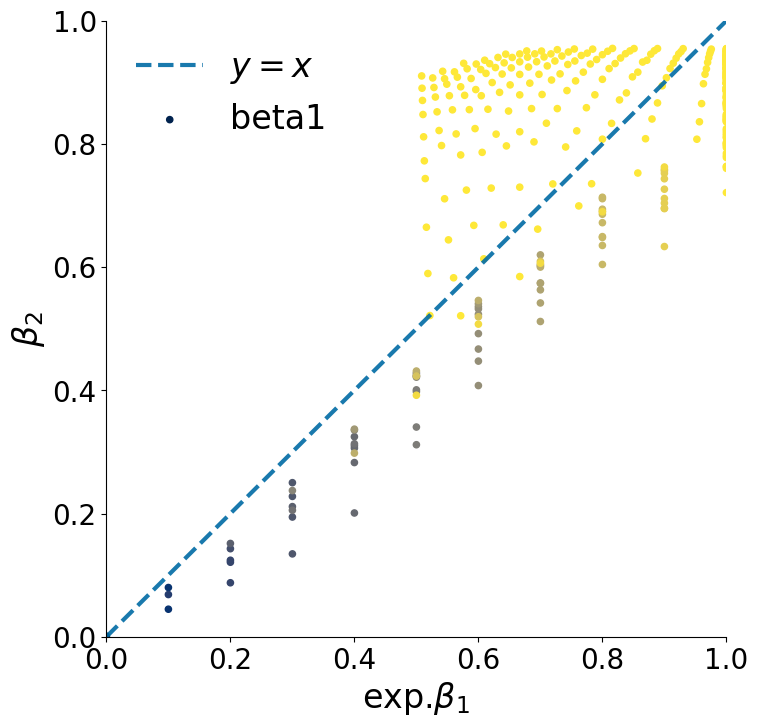

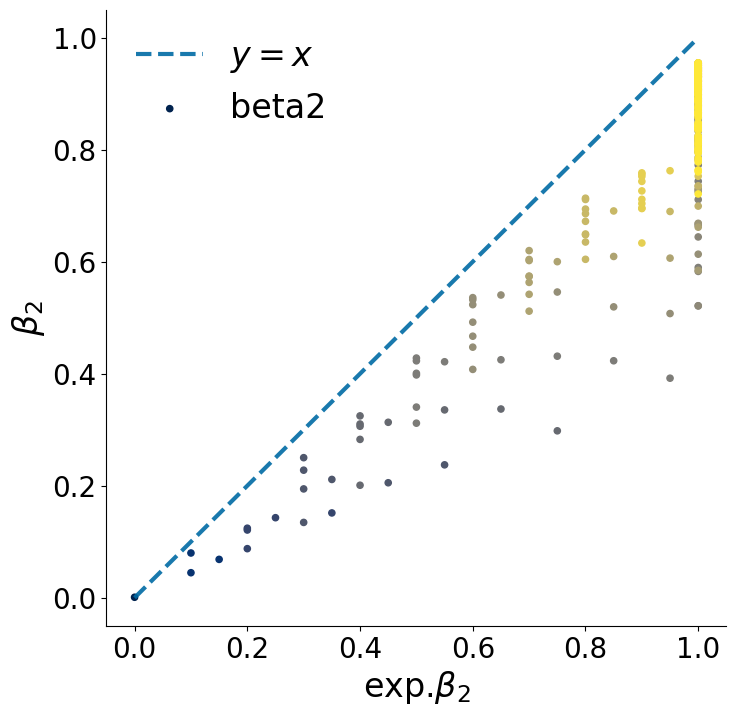

In [394]:
# min_nu_1_cut = 0
# max_nu_1_cut = 30
# min_nu_2_cut = 1
# fraction_nu_2_cut = 10
    
average_beta_dict = average_betas_dict_new_pairs_UMT[(1, 0)]
average_beta2_dict = average_beta2_dict_new_pairs_UMT[(1, 0)]

                    
x1 = []
x2 = []
y1 = []
y2 = []
for nu_1 in average_beta_dict.keys():
    for nu_2 in average_beta2_dict[nu_1].keys():
        y1.append(average_beta_dict[nu_1][nu_2])
        y2.append(average_beta2_dict[nu_1][nu_2])
        exp_beta, exp_beta2 = get_expected_undirected(
            10,
            nu_1,
            nu_2,
            used_rule_nu_2_plus_1 = False,
        )
        x1.append(exp_beta)
        x2.append(exp_beta2)
fig,ax = plt.subplots(figsize=(8,8))
scatter_with_density(
    x = x1,
    y = y1,
    z = x2,
    ax = ax,
    label_scatter = 'beta1',
)
# ax.set_xlim([0,1])
# ax.set_ylim([0,1])
ax.set_xlabel(r'exp.$\beta_1$')
ax.set_ylabel(r'$\beta_1$')
x = np.array([0,1])
ax.plot(x, x, '--', label = r'$y=x$', lw = 3, alpha = 0.9)
ax.legend()

fig,ax = plt.subplots(figsize=(8,8))
scatter_with_density(
    x = x1,
    y = y2,
    z = x2,
    ax = ax,
    label_scatter = 'beta1',
)
ax.set_xlim([0,1])
ax.set_ylim([0,1])
ax.set_xlabel(r'exp.$\beta_1$')
ax.set_ylabel(r'$\beta_2$')
x = np.array([0,1])
ax.plot(x, x, '--', label = r'$y=x$', lw = 3, alpha = 0.9)
ax.legend()

fig,ax = plt.subplots(figsize=(8,8))
scatter_with_density(
    x = x2,
    y = y2,
    z = x1,
    ax = ax,
    label_scatter = 'beta2',
)
# ax.set_xlim([0,1])
# ax.set_ylim([0,1])
ax.set_xlabel(r'exp.$\beta_2$')
ax.set_ylabel(r'$\beta_2$')
x = np.array([0,1])
ax.plot(x, x, '--', label = r'$y=x$', lw = 3, alpha = 0.9)
ax.legend()


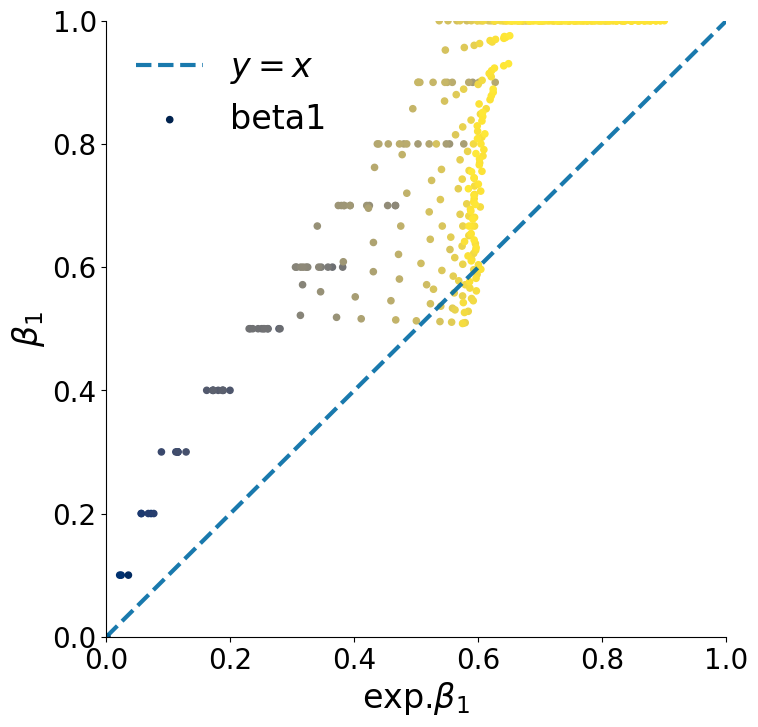

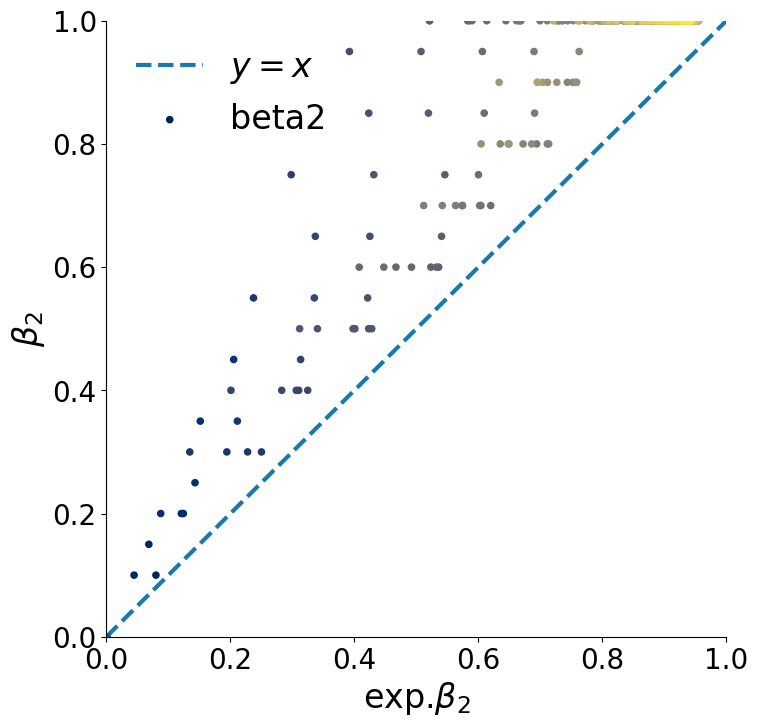

In [390]:
# min_nu_1_cut = 0
# max_nu_1_cut = 30
# min_nu_2_cut = 1
# fraction_nu_2_cut = 10
    
average_beta_dict = average_betas_dict_new_pairs_UMT[(1, 0)]
average_beta2_dict = average_beta2_dict_new_pairs_UMT[(1, 0)]

                    
x1 = []
x2 = []
y1 = []
y2 = []
for nu_1 in average_beta_dict.keys():
    for nu_2 in average_beta2_dict[nu_1].keys():
        x1.append(average_beta_dict[nu_1][nu_2])
        x2.append(average_beta2_dict[nu_1][nu_2])
#         exp_beta, exp_beta2 = get_expected_undirected(
#             10,
#             nu_1,
#             nu_2,
#             used_rule_nu_2_plus_1 = False,
#         )
        exp_beta = float(nu_1)/rho
        exp_beta2 = float(2*nu_2-1)/rho
        y1.append(exp_beta)
        y2.append(exp_beta2)
fig,ax = plt.subplots(figsize=(8,8))
scatter_with_density(
    x = x1,
    y = y1,
    z = x2,
    ax = ax,
    label_scatter = 'beta1',
)
ax.set_xlim([0,2])
ax.set_ylim([0,1])
ax.set_xlabel(r'$\nu_1/\rho$')
ax.set_ylabel(r'$\beta_1$')
x = np.array([0,1])
ax.plot(x, x, '--', label = r'$y=x$', lw = 3, alpha = 0.9)
ax.legend()

fig,ax = plt.subplots(figsize=(8,8))
scatter_with_density(
    x = x2,
    y = y2,
    z = x1,
    ax = ax,
    label_scatter = 'beta2',
)
ax.set_xlim([0,2])
ax.set_ylim([0,1])
ax.set_xlabel(r'\nu_1/\rho$')
ax.set_ylabel(r'$\beta_2$')
x = np.array([0,1])
ax.plot(x, x, '--', label = r'$y=x$', lw = 3, alpha = 0.9)
ax.legend()


  0%|          | 0/31 [00:00<?, ?it/s]

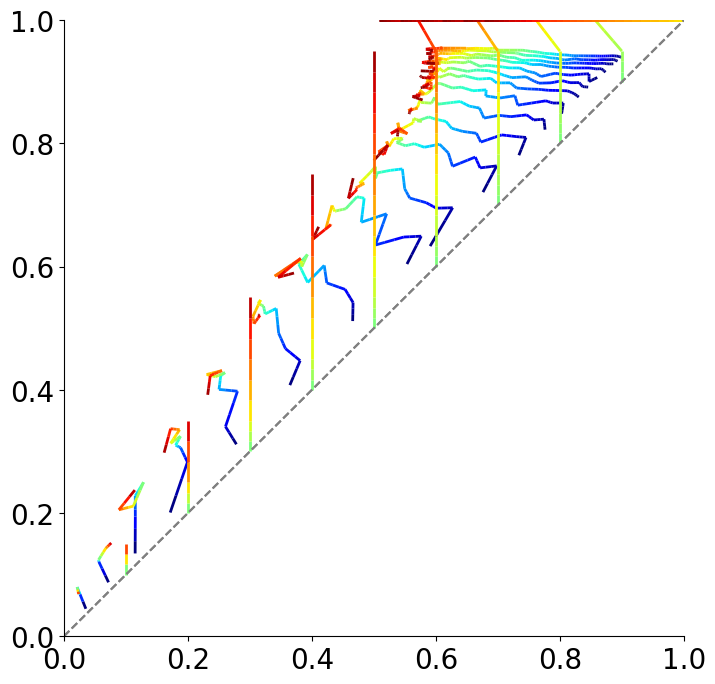

In [391]:
min_nu_1_cut = 0
max_nu_1_cut = 30
min_nu_2_cut = 0
fraction_nu_2_cut = None

average_beta_to_plot = {}
average_beta2_to_plot = {}
exp_average_beta_to_plot = {}
exp_average_beta2_to_plot = {}
for nu_1 in tqdm(sorted(average_beta_dict.keys())):
    if nu_1 <= max_nu_1_cut and nu_1 >= min_nu_1_cut:
        nu_1_dict = average_beta_dict[nu_1]
        average_beta_to_plot[nu_1] = []
        average_beta2_to_plot[nu_1] = []
        exp_average_beta_to_plot[nu_1] = []
        exp_average_beta2_to_plot[nu_1] = []
        for nu_2 in sorted(nu_1_dict.keys()):
            if nu_2 >= min_nu_2_cut and (fraction_nu_2_cut is None or ( fraction_nu_2_cut is not None and nu_2 <= fraction_nu_2_cut*nu_1)):
                exp_beta, exp_beta2 = get_expected_undirected(
                    10,
                    nu_1,
                    nu_2,
                    used_rule_nu_2_plus_1 = False,
                )
                exp_average_beta_to_plot[nu_1].append(exp_beta)
                exp_average_beta2_to_plot[nu_1].append(exp_beta2)
                beta = average_beta_dict[nu_1][nu_2]
                beta_2 = average_beta2_dict[nu_1][nu_2]
                average_beta_to_plot[nu_1].append(beta)
                average_beta2_to_plot[nu_1].append(beta_2)

fig,ax = plt.subplots(figsize=(8,8))

plot_average_beta_1_beta2_by_two_parameters(
    average_beta_to_plot,
    average_beta2_to_plot,
    ax = ax,
    fig = fig,
    print_values_parameters_plotted=False,
)
x = np.array([0,1])
# plt.plot(x, x, '--', label = 'y=x', lw = 5, alpha = 0.9)
plt.legend()

# fig,ax = plt.subplots(figsize=(8,8))

plot_average_beta_1_beta2_by_two_parameters(
    exp_average_beta_to_plot,
    exp_average_beta2_to_plot,
    ax = ax,
    fig = fig,
    print_values_parameters_plotted=False,
)
x = np.array([0,1])
# plt.plot(x, x, '--', label = 'y=x', lw = 5, alpha = 0.9)
plt.legend()

##### Without looking at other in actual

In [68]:
def plot_average_beta_1_beta2_by_two_parameters(
    average_beta,
    average_beta2,
    ax = None,
    fig = None,
    print_values_parameters_plotted = False,
):
    if ax == None:
        fig,ax = plt.subplots(figsize=(8,8))
    
    for nu_1 in average_beta.keys():
        x = np.array(average_beta[nu_1])
        y = np.array(average_beta2[nu_1])
        if len(x) > 1:
            if print_values_parameters_plotted:
                print('nu_1', nu_1)
            path = mpath.Path(np.column_stack([x, y]))
            verts = path.interpolated(steps=3).vertices
            x, y = verts[:, 0], verts[:, 1]
            z = np.linspace(0, 1, len(x))

            colorline(x, y, z, cmap=plt.get_cmap('jet'), linewidth=2, ax = ax)
    ax.plot([0,1],[0,1], '--', color='gray')
    ax.set_xlim([0,1])
    ax.set_ylim([0,1])

In [188]:
def scatter_with_expected(
    average_betas_dict,
    average_beta2_dict,
    rho = 10,
    m = 2,
    divisor_1 = 1,
    divisor_2 = 1,
    divisor_3 = 1,
):
    
    betas = []
    expected_betas = []
    betas2 = []
    expected_betas2 = []
    
    for nu_1 in average_betas_dict.keys():
        for nu_2 in average_betas_dict[nu_1].keys():
            betas.append(average_betas_dict[nu_1][nu_2])
            betas2.append(average_beta2_dict[nu_1][nu_2])
            expected_betas.append(min(1,1/m*nu_1/divisor_1/rho + (1 - 1/m)*nu_2/divisor_2/rho))
            expected_betas2.append(min(1,nu_1/divisor_3/rho))
    
    
    fig,ax = plt.subplots(figsize=(8,8))
    x = np.array(expected_betas)
    y = np.array(betas)
    z = None
    subplot_scatter_beta(
        x = x, 
        y = y, 
        z = z,
        ax = ax, 
#         min_x = 0,
#         max_x = 1,
#         min_y = 0,
#         max_y = 1,
        marker_size = 20, 
        xlabel = fr"exp. $\beta_1$", 
        ylabel = fr"$\beta_1$", 
    )
    fig.add_subplot(ax)
    
    fig,ax = plt.subplots(figsize=(8,8))
    x = np.array(expected_betas2)
    y = np.array(betas2)
    z = None
    subplot_scatter_beta(
        x = x, 
        y = y, 
        z = z,
        ax = ax, 
#         min_x = 0,
#         max_x = 1,
#         min_y = 0,
#         max_y = 1,
        marker_size = 20, 
        xlabel = fr"exp. $\beta_2$", 
        ylabel = fr"$\beta_2$", 
    )
    fig.add_subplot(ax)


#     ax.set_xlim([0,1])
#     ax.set_ylim([0,1])

In [186]:
min_nu_1_cut = 0
max_nu_1_cut = 20
min_nu_2_cut = 0
fraction_nu_2_cut = 1
    
average_beta_dict = average_betas_dict_new_pairs_UMT[(look_only_among_extracted_colors,add_nu_2_not_1,attach_new_colors_to_random,directed, 1, 0)]
average_beta2_dict = average_beta2_dict_new_pairs_UMT[(look_only_among_extracted_colors,add_nu_2_not_1,attach_new_colors_to_random,directed, 1, 0)]

average_beta_dict_to_plot = {}
average_beta2_dict_to_plot = {}
for nu_1 in tqdm(sorted(average_beta_dict.keys())):
    if nu_1 <= max_nu_1_cut and nu_1 >= min_nu_1_cut:
        average_beta_dict_to_plot[nu_1] = {}
        average_beta2_dict_to_plot[nu_1] = {}
        nu_1_dict = average_beta_dict[nu_1]
        for nu_2 in sorted(nu_1_dict.keys()):
            if nu_2 <= fraction_nu_2_cut*nu_1 and nu_2 >= min_nu_2_cut:
                beta = average_beta_dict[nu_1][nu_2]
                beta_2 = average_beta2_dict[nu_1][nu_2]
                average_beta_dict_to_plot[nu_1][nu_2] = beta
                average_beta2_dict_to_plot[nu_1][nu_2] = beta_2

  0%|          | 0/51 [00:00<?, ?it/s]

intercept 0.07831176419660689 slope 0.7382789504493898
p-value pearson between exp. $\beta_1$ and $\beta_1$ 5.137028636174845e-125
intercept 0.05574524687714329 slope 0.8732747889261274
p-value pearson between exp. $\beta_2$ and $\beta_2$ 4.10463816802053e-169


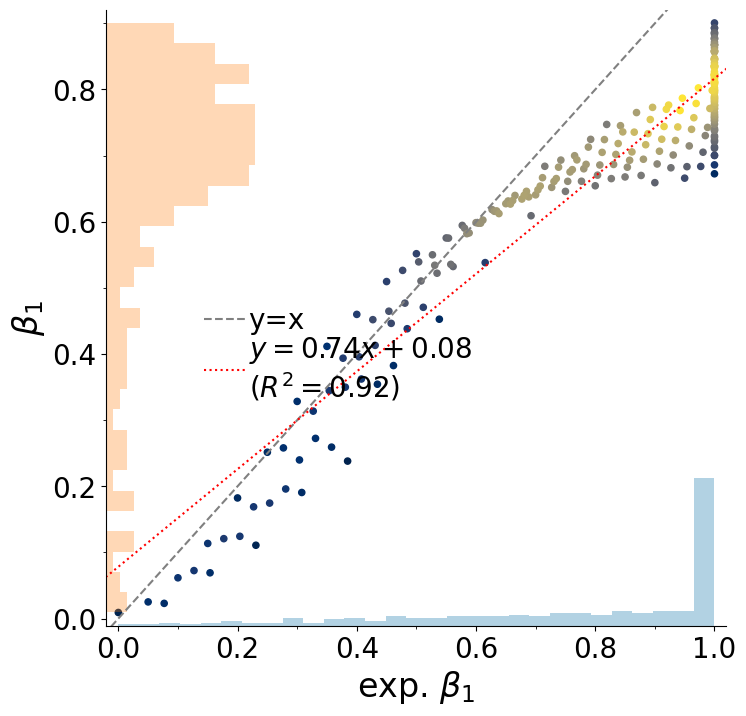

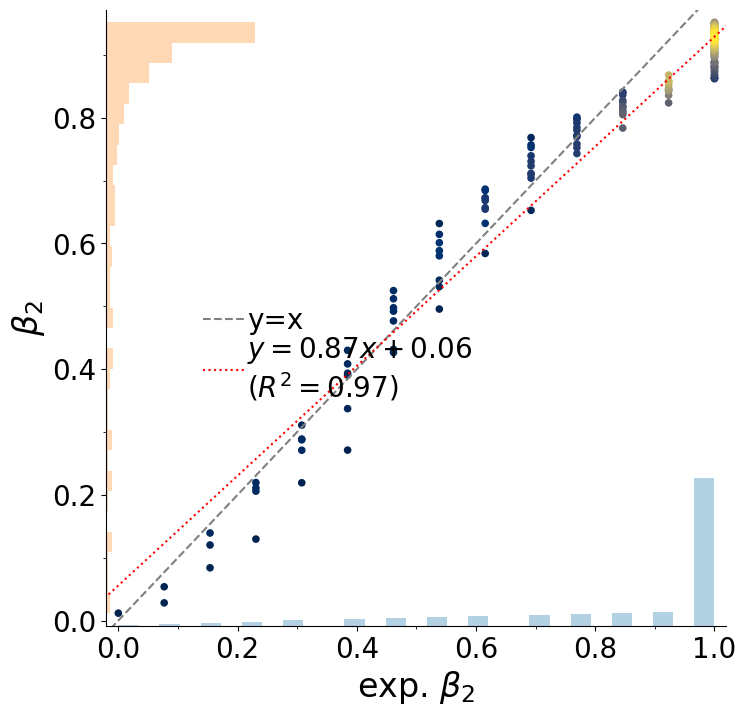

In [192]:
scatter_with_expected(
    average_betas_dict = average_beta_dict_to_plot,
    average_beta2_dict = average_beta2_dict_to_plot,
    rho = 10,
    m = .65,
    divisor_1 = 2.,
    divisor_2 = 2,
    divisor_3 = 1.3,
)

# OLD Figure: Higher order exponents in MODEL simulations

## Load data simulations

### Short simulations

In [17]:
path[:path.index("f'")]+path[path.index("f'")+2:]

'./data/UMST/simulations/raw_sequences/rho_20.00000/nu_1/Tmax_100000/eta_1.00000/5.txt'

In [15]:
path = "./data/UMST/simulations/raw_sequences/rho_20.00000/nu_1/Tmax_100000/eta_1.00000/f'5.txt"

In [19]:
os.rename(path, path[:path.index("f'")]+path[path.index("f'")+2:])

In [ ]:
find_pattern("f'", path)

In [20]:
Tmax = int(1e5)
use_scratch = False
results_simulations = {}
print('Simulations found:')
for eta in [1]:#,0.01,0.001,0]:
    for rho in [20]:
        for nu in range(1,21):# min(21,int(rho/eta))):
            workdir = f"./data/UMST/simulations/raw_sequences/rho_{rho:.5f}/nu_{nu}/Tmax_{Tmax}/eta_{eta:.5f}/"
            for path in find_pattern("*f'*", workdir):
                try:
                    os.rename(path, path[:path.index("f'")]+path[path.index("f'")+2:])
                except:
                    pass

Simulations found:


In [422]:
Tmax = int(1e5)
use_scratch = False
results_simulations = {}
print('Simulations found:')
for eta in [1,0.1]:#,0.01,0.001,0]:
    for rho in [1,2,3,4,5,10,20]:
        for nu in range(1,21):# min(21,int(rho/eta))):
            try:
                workdir = f"./data/simulations/rho_{rho:.5f}/nu_{nu}/Tmax_{Tmax}/eta_{eta:.5f}/"
                workdir_scratch = f"/data/scratch/ahw701/pairs/UMST/simulations/rho_{rho:.5f}/nu_{nu}/Tmax_{Tmax}/eta_{eta:.5f}/"
                if use_scratch == True:
                    with open(f"{workdir_scratch}average_UMT_results.pkl",'rb') as fp:
                        tmp = pickle.load(fp)
                else:
                    if os.path.exists(f"{workdir}average_UMT_light_results.pkl"):
                        with open(f"{workdir}average_UMT_light_results.pkl",'rb') as fp:
                            tmp = pickle.load(fp)
                    else:
                        with open(f"{workdir}average_UMT_light_results_old.pkl",'rb') as fp:
                            tmp = pickle.load(fp)
                if eta not in results_simulations:
                    results_simulations[eta] = {}
                if rho not in results_simulations[eta]:
                    results_simulations[eta][rho] = {}
                results_simulations[eta][rho][nu] = tmp.copy()
                print('eta',eta, 'rho',rho, 'nu',nu, 'num_sim:', len(results_simulations[eta][rho][nu]['beta_loglogregr_indices_geom_list_finals']))
            except:
                pass

Simulations found:
eta 1 rho 20 nu 1 num_sim: 100
eta 1 rho 20 nu 2 num_sim: 100
eta 1 rho 20 nu 3 num_sim: 100
eta 1 rho 20 nu 4 num_sim: 100
eta 1 rho 20 nu 5 num_sim: 100
eta 1 rho 20 nu 6 num_sim: 100
eta 1 rho 20 nu 7 num_sim: 100
eta 1 rho 20 nu 8 num_sim: 100
eta 1 rho 20 nu 9 num_sim: 100
eta 1 rho 20 nu 10 num_sim: 100
eta 1 rho 20 nu 11 num_sim: 100
eta 1 rho 20 nu 12 num_sim: 100
eta 1 rho 20 nu 13 num_sim: 100
eta 1 rho 20 nu 14 num_sim: 100
eta 1 rho 20 nu 15 num_sim: 100
eta 1 rho 20 nu 16 num_sim: 100
eta 1 rho 20 nu 17 num_sim: 100
eta 1 rho 20 nu 18 num_sim: 100
eta 1 rho 20 nu 19 num_sim: 100
eta 1 rho 20 nu 20 num_sim: 100
eta 0.1 rho 4 nu 1 num_sim: 100
eta 0.1 rho 4 nu 2 num_sim: 100
eta 0.1 rho 4 nu 3 num_sim: 100
eta 0.1 rho 4 nu 4 num_sim: 100
eta 0.1 rho 4 nu 5 num_sim: 100
eta 0.1 rho 4 nu 6 num_sim: 100
eta 0.1 rho 4 nu 7 num_sim: 100
eta 0.1 rho 4 nu 8 num_sim: 100
eta 0.1 rho 4 nu 9 num_sim: 100
eta 0.1 rho 4 nu 10 num_sim: 100
eta 0.1 rho 4 nu 11 num_sim: 

### Long simulations

In [88]:
Tmax = int(1e7)
use_scratch = False
results_simulations_long = {}
print('Simulations found:')
for eta in [1,0.1]:#,0.01,0.001,0]:
    for rho in [1,2,3,4,5,10,20]:
        for nu in range(1,21):# min(21,int(rho/eta))):
            try:
                workdir = f"./data/simulations/rho_{rho:.5f}/nu_{nu}/Tmax_{Tmax}/eta_{eta:.5f}/"
                workdir_scratch = f"/data/scratch/ahw701/pairs/UMST/simulations/rho_{rho:.5f}/nu_{nu}/Tmax_{Tmax}/eta_{eta:.5f}/"
                if rho == 20 and eta == 1:
                    for run in range(100):
                        try:
                            os.remove(f"{workdir}UMT_run_{run}.pkl")
                        except:
                            pass
                if use_scratch == True:
                    with open(f"{workdir_scratch}average_UMT_results.pkl",'rb') as fp:
                        tmp = pickle.load(fp)
                else:
                    with open(f"{workdir}average_UMT_light_results.pkl",'rb') as fp:
                        tmp = pickle.load(fp)
                if eta not in results_simulations_long:
                    results_simulations_long[eta] = {}
                if rho not in results_simulations_long[eta]:
                    results_simulations_long[eta][rho] = {}
                results_simulations_long[eta][rho][nu] = tmp.copy()
                if tmp['ts'][-1] == Tmax - 1 or tmp['D_indices'][0] > 1:
                    for _ in ['ts', 'ts_geom', 'indices','indices_geom']:
                        tmp[_] = [1] + list(np.array(tmp[_])+1)
                    for _ in ['D_indices', 'D2_indices', 'D3_indices','D4_indices']:
                        tmp[_] = np.array([1] + list(np.array(tmp[_])+1))
                    
                    for _ in ['ts', 'ts_geom', 'indices','indices_geom']:
                        tmp[_] = [1] + list(np.array(tmp[_])+1)
                    
                print('eta',eta, 'rho',rho, 'nu',nu, 'num_sim:', len(results_simulations_long[eta][rho][nu]['beta_loglogregr_indices_geom_list_finals']))
            except:
                pass

Simulations found:
eta 1 rho 4 nu 1 num_sim: 100
eta 1 rho 4 nu 2 num_sim: 100
eta 1 rho 4 nu 3 num_sim: 100
eta 1 rho 20 nu 1 num_sim: 100
eta 1 rho 20 nu 2 num_sim: 100
eta 1 rho 20 nu 3 num_sim: 100
eta 1 rho 20 nu 4 num_sim: 100
eta 1 rho 20 nu 5 num_sim: 100
eta 1 rho 20 nu 6 num_sim: 100
eta 1 rho 20 nu 7 num_sim: 100
eta 1 rho 20 nu 8 num_sim: 100
eta 1 rho 20 nu 9 num_sim: 100
eta 1 rho 20 nu 10 num_sim: 100
eta 1 rho 20 nu 11 num_sim: 100
eta 1 rho 20 nu 12 num_sim: 100
eta 1 rho 20 nu 13 num_sim: 100
eta 1 rho 20 nu 14 num_sim: 100
eta 1 rho 20 nu 15 num_sim: 100
eta 1 rho 20 nu 16 num_sim: 87
eta 1 rho 20 nu 17 num_sim: 59
eta 1 rho 20 nu 18 num_sim: 29
eta 1 rho 20 nu 19 num_sim: 13
eta 0.1 rho 4 nu 1 num_sim: 100
eta 0.1 rho 4 nu 2 num_sim: 100
eta 0.1 rho 4 nu 3 num_sim: 100
eta 0.1 rho 4 nu 4 num_sim: 100
eta 0.1 rho 4 nu 5 num_sim: 100
eta 0.1 rho 4 nu 6 num_sim: 100
eta 0.1 rho 4 nu 7 num_sim: 99
eta 0.1 rho 4 nu 8 num_sim: 91
eta 0.1 rho 4 nu 9 num_sim: 80
eta 0.1 rho

## Functions

In [170]:
def fig_2_subplot_a(average_result, 
                    ax = None, marker_size = 20, alpha = 1, 
                    number_to_write = 0, 
                    xlim_left = 1, xlim_right = 1, 
                    ylim_bottom = 1, ylim_top = 1, 
                    ylabel = None, xlabel = None, 
                    write_number = False):
    if ax == None:
        fig, ax = plt.subplots()
    labels = []
    for i,order in enumerate(['', '2', '3', '4']):
        ax.plot(average_result["ts"][i:]-i, average_result[f"D{order}_indices"][i:], color = CB_color_cycle[i])
#         ax.plot([1]+list(average_result["ts"]-i+1), [1]+list(average_result[f"D{order}_indices"]), color = CB_color_cycle[i])
#         ax.plot(average_result["ts"],average_result["ts"]**average_result[f"beta{order}"][-1] * (average_result[f"D{order}_indices"][-1]/average_result["ts"][-1]**average_result[f"beta{order}"][-1]), 
        if f"intercept{order}_loglogregr_indices_geom" in average_result:
            intercept = average_result[f"intercept{order}_loglogregr_indices_geom"][-1]
        else:
            intercept = 1
        ax.plot(average_result["ts"][i:]-i, intercept * (average_result["ts"][i:]-i)**average_result[f"beta{order}_loglogregr_indices_geom"][-1], # * (average_result[f"D{order}_indices"][-1]/average_result["ts"][-1]**average_result[f"beta{order}"][-1]), 
                color = CB_color_cycle[i], ls = "--", alpha=alpha)
        if order == '':
            labels.append(r"$D_1(t)\sim t^{%.2f}$"%(average_result["beta_loglogregr_indices_geom"][-1]))
        else:
            labels.append(r"$D_{%s}(t)\sim t^{%.2f}$"%(order, average_result[f"beta{order}_loglogregr_indices_geom"][-1]))
    ax.set_xlim(left = xlim_left, right = xlim_right)
    ax.set_ylim(bottom = ylim_bottom, top = ylim_top)
    ax.set_xlabel(xlabel, fontweight='bold')
    ax.set_ylabel(ylabel, fontweight='bold')
    ax.loglog()
    # Impose xticks
    locmaj = matplotlib.ticker.LogLocator(base=10,numticks=20) 
    ax.xaxis.set_major_locator(locmaj)
    locmin = matplotlib.ticker.LogLocator(base=10.0,subs=(np.arange(0.1,1,0.1)),numticks=20)
    ax.xaxis.set_minor_locator(locmin)
    ax.xaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
    # Impose yticks
    ax.yaxis.set_major_locator(locmaj)
    ax.yaxis.set_minor_locator(locmin)
    ax.yaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
    # Legend
    leg1 = ax.legend([(color,"--",True) for color in CB_color_cycle[:2]], labels[:2] , 
                     handler_map={tuple: continuous_and_dashed_line_handle()},
                     handletextpad=0.1, bbox_to_anchor=(-0.06,1.1), loc="upper left", labelspacing = 0, handlelength = 1.5
    ) 

    leg2 = ax.legend([(color,"--",True) for color in CB_color_cycle[2:4]], labels[2:] , 
                     handler_map={tuple: continuous_and_dashed_line_handle()},
                     handletextpad=0.1, bbox_to_anchor=(1.06,-0.06), loc="lower right", labelspacing = 0, handlelength = 1.5
    )
    ax.add_artist(leg1)
    if write_number == True:
        ax.text(0.5, 1.08, f"{letters[number_to_write]}", transform=ax.transAxes,fontweight='bold', horizontalalignment='center')
    return ax

In [171]:
# parameters_a_by_row = {'UMT' : (1,20,10), 'UMST':(.1, 4,4)}
# eta, rho, nu = parameters_a_by_row['UMT']
# average_result = results_simulations[eta][rho][nu]
# for i,order in enumerate(['', '2', '3', '4']):
#     print(average_result[f"D{order}_indices"][0],average_result[f"D{order}_indices"][i])
#     plt.plot(average_result["ts"][i:]-i, average_result[f"D{order}_indices"][i:])
# plt.loglog()

In [172]:
def fig_2(results_simulations, 
          parameters_a_by_row, # {'UMT':(eta, rho, nu)}
#           parameters_b_d_by_row, # [(eta, rho)] # this is not needed, since it takes eta and rho from a, and looks for all possible values of nu
          marker_size = 20, alpha_scatter = 1, alpha_histogram = 0.3, color_x = CB_color_cycle[0], color_y = CB_color_cycle[1], max_hist = 0.25, xlim_left_a = 1, ylim_bottom_a = 1,
          min_beta = 0,
          max_beta = 1,
          min_beta_higher = 0,
          max_beta_higher = 1,
          use_same_x_y_max_lim = True,
         ):
    num_datasets = len(parameters_a_by_row)
    fig = plt.figure(figsize=(width_fig,width_fig*2/3*num_datasets/3))
    outer = gridspec.GridSpec(nrows=num_datasets+1, ncols=1,height_ratios = [10]*num_datasets+[3],hspace=0.25)
    wspace = 0.38
    ncols = 4
    
    # get highest t and D to unify panel a
    if use_same_x_y_max_lim == True:
        max_t = 1
        max_D = 1
        for i, dataset_label in enumerate(parameters_a_by_row.keys()):
            eta, rho, nu = parameters_a_by_row[dataset_label]
            max_t = max(max_t, results_simulations[eta][rho][nu]["ts"][-1]+1)
            for order in ['', '2', '3', '4']:
                max_D = max(max_D, results_simulations[eta][rho][nu][f"D{order}_indices"][-1]+1)
                
    for i, dataset_label in enumerate(parameters_a_by_row.keys()):
        eta, rho, nu = parameters_a_by_row[dataset_label]
        dataset_dict = {}
        dataset_dict['average_results'] = results_simulations[eta][rho][nu]
        dataset_dict['betas'] = np.array([_ for tmp_nu in results_simulations[eta][rho].values() for _ in tmp_nu["beta_loglogregr_indices_geom_list_finals"]])
        dataset_dict['betas2'] = np.array([_ for tmp_nu in results_simulations[eta][rho].values() for _ in tmp_nu["beta2_loglogregr_indices_geom_list_finals"]])
        dataset_dict['betas3'] = np.array([_ for tmp_nu in results_simulations[eta][rho].values() for _ in tmp_nu["beta3_loglogregr_indices_geom_list_finals"]])
        dataset_dict['betas4'] = np.array([_ for tmp_nu in results_simulations[eta][rho].values() for _ in tmp_nu["beta4_loglogregr_indices_geom_list_finals"]])
        if use_same_x_y_max_lim == False:
            max_t = dataset_dict['average_results']["ts"][-1]+1
            max_D = 1
            for order in ['', '2', '3', '4']:
                max_D = max(max_D, dataset_dict['average_results'][f"D{order}_indices"][-1]+1)
        
        inner = gridspec.GridSpecFromSubplotSpec(1, ncols,
                            subplot_spec=outer[i],width_ratios=[1,1,1,1],wspace=wspace)
        if i == num_datasets - 1:
            xlabel_a = r"$t$"
            xlabel_b = r"$\beta_1$"
            xlabel_c = r"$\beta_1$"
            xlabel_d = r"$\beta_1$"
        else:
            xlabel_a = xlabel_b = xlabel_c = xlabel_d = None
        ax = plt.Subplot(fig, inner[0])
        if use_same_x_y_max_lim == False:
            max_t = dataset_dict['average_results']["ts"][-1]
            max_D = 1
            for order in ['', '2', '3', '4']:
                max_D = max(max_D, dataset_dict['average_results'][f"D{order}_indices"][-1])
        fig_2_subplot_a(dataset_dict['average_results'], 
                        ax = ax, 
                        marker_size = marker_size, alpha = alpha_scatter, 
                        number_to_write = i*ncols, 
                        xlim_left = xlim_left_a, xlim_right = max_t, 
                        ylim_bottom = ylim_bottom_a, ylim_top = max_D, 
                        ylabel = dataset_label, xlabel = xlabel_a, write_number = i==0,
                       )
        fig.add_subplot(ax)
        for i_order,n_order in enumerate([2,3,4], start=1):
            order = str(n_order)
            ax = plt.Subplot(fig, inner[i_order])
            fig_1_subplot_b_d(dataset_dict['betas'], dataset_dict[f'betas{order}'], 
                              ax = ax, 
                              marker_size = 20, alpha_scatter = alpha_scatter,
                              alpha_histogram = alpha_histogram, 
                              color_x = color_x, color_y = color_y, 
                              max_hist = max_hist, 
                              number_to_write = i*ncols+i_order, 
                              write_number = i==0, 
                              ylabel = fr"$\beta_{order}$", xlabel = xlabel_b, 
                              min_x=min_beta, max_x=max_beta, min_y=min_beta_higher, max_y=max_beta_higher,
                             )
            fig.add_subplot(ax)
    
    ####################### COLORBAR #######################
    
    inner = gridspec.GridSpecFromSubplotSpec(2, 1,
                            subplot_spec=outer[-1],height_ratios=[1,1],hspace=0)
    ax_cmap = plt.Subplot(fig, inner[1])
    vmin = 0
    vmax = 1
    cb = fig.colorbar(ScalarMappable(norm=Normalize(vmin=vmin,vmax=vmax)), ax=ax_cmap,shrink=0.5,pad=0., fraction=1,orientation='horizontal')
    cb.ax.get_xaxis().set_ticks([0,1]) 
    cb.ax.get_xaxis().set_ticklabels(['low density', 'high density']) 
    ax_cmap.axis('off')
    fig.add_subplot(ax_cmap)
    
    return fig

## Figure (Tmax = 10^5)

In [173]:
for eta,rho in [(1,20), (.1,4)]:
    print(eta, rho, results_simulations[eta][rho].keys(), sep = '\t')

1	20	dict_keys([1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20])
0.1	4	dict_keys([1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20])


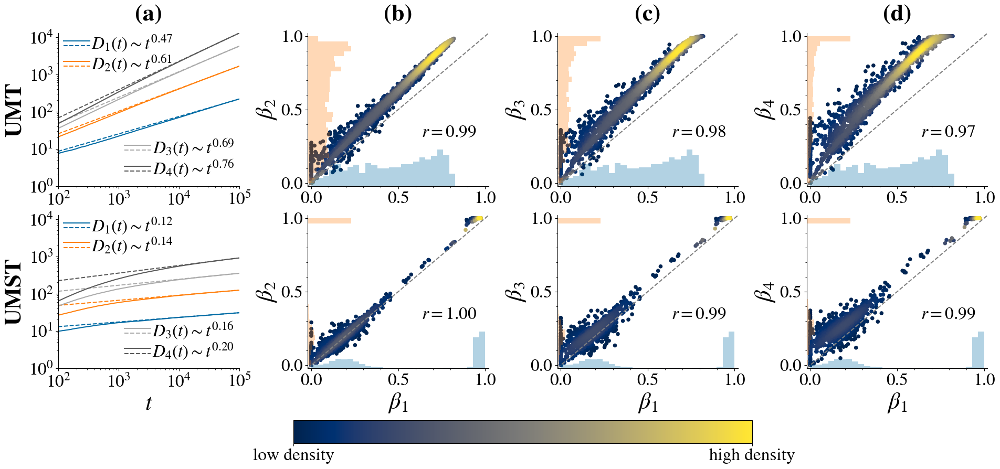

In [423]:
parameters_a_by_row = {'UMT' : (1,20,10), 'UMST':(.1, 4,4)}
Tmax = int(1e5)
fig = fig_2(
    results_simulations, 
    parameters_a_by_row,
    marker_size = 20, 
    alpha_scatter = 1, 
    alpha_histogram = 0.3, 
    color_x = CB_color_cycle[0], 
    color_y = CB_color_cycle[1], 
    max_hist = 0.25, 
    xlim_left_a = 1e2, 
    ylim_bottom_a = 1e0,
    min_beta = min_beta,
    max_beta = max_beta,
    min_beta_higher = min_beta_higher,
    max_beta_higher = max_beta_higher,
    use_same_x_y_max_lim = True,
)


fig.savefig(os.path.join(figures_folder, f"Fig2_Heaps_simulations_Tmax_%d.png"%(Tmax)))
fig.savefig(os.path.join(figures_folder, f"Fig2_Heaps_simulations_Tmax_%d_low_res.pdf"%(Tmax)),format='pdf',dpi=100)
fig.savefig(os.path.join(figures_folder, f"Fig2_Heaps_simulations_Tmax_%d.pdf"%(Tmax)),format='pdf')

## Functions new

In [211]:
def fig_2_new(results_simulations, 
          parameters_a_by_row, # {'UMT':(eta, rho, nu)}
#           parameters_b_d_by_row, # [(eta, rho)] # this is not needed, since it takes eta and rho from a, and looks for all possible values of nu
          marker_size = 20, alpha_scatter = 1, alpha_histogram = 0.3, color_x = CB_color_cycle[0], color_y = CB_color_cycle[1], max_hist = 0.25, xlim_left_a = 1, ylim_bottom_a = 1,
          min_beta = 0,
          max_beta = 1,
          min_beta_higher = 0,
          max_beta_higher = 1,
          use_same_x_y_max_lim = True,
              normalize = True,
         ):
    num_datasets = len(parameters_a_by_row)
    fig = plt.figure(figsize=(width_fig,width_fig*2/3*num_datasets/3))
    outer = gridspec.GridSpec(nrows=num_datasets+1, ncols=1,height_ratios = [10]*num_datasets+[3],hspace=0.25)
    wspace = 0.38
    ncols = 4
    
    # get highest t and D to unify panel a
    if use_same_x_y_max_lim == True:
        max_t = 1
        max_D = 1
        for i, dataset_label in enumerate(parameters_a_by_row.keys()):
            eta, rho, nu = parameters_a_by_row[dataset_label]
            max_t = max(max_t, results_simulations[eta][rho][nu]["ts"][-1]+1)
            for order in ['', '2', '3', '4']:
                max_D = max(max_D, results_simulations[eta][rho][nu][f"D{order}_indices"][-1]+1)
                
    for i, dataset_label in enumerate(parameters_a_by_row.keys()):
        eta, rho, nu = parameters_a_by_row[dataset_label]
        dataset_dict = {}
        dataset_dict['average_results'] = results_simulations[eta][rho][nu]
        dataset_dict['betas'] = np.array([_ for tmp_nu in results_simulations[eta][rho].values() for _ in tmp_nu["beta_loglogregr_indices_geom_list_finals"]])
        dataset_dict['betas2'] = np.array([_ for tmp_nu in results_simulations[eta][rho].values() for _ in tmp_nu["beta2_loglogregr_indices_geom_list_finals"]])
        dataset_dict['betas3'] = np.array([_ for tmp_nu in results_simulations[eta][rho].values() for _ in tmp_nu["beta3_loglogregr_indices_geom_list_finals"]])
        dataset_dict['betas4'] = np.array([_ for tmp_nu in results_simulations[eta][rho].values() for _ in tmp_nu["beta4_loglogregr_indices_geom_list_finals"]])
        if use_same_x_y_max_lim == False:
            max_t = dataset_dict['average_results']["ts"][-1]+1
            max_D = 1
            for order in ['', '2', '3', '4']:
                max_D = max(max_D, dataset_dict['average_results'][f"D{order}_indices"][-1]+1)
        
        inner = gridspec.GridSpecFromSubplotSpec(1, ncols,
                            subplot_spec=outer[i],width_ratios=[1,1,1,1],wspace=wspace)
        if i == num_datasets - 1:
            xlabel_a = r"$t$"
            xlabel_b = r"$\beta_1$"
            xlabel_c = r"$\beta_1$"
            xlabel_d = r"$\beta_1$"
        else:
            xlabel_a = xlabel_b = xlabel_c = xlabel_d = None
        ax = plt.Subplot(fig, inner[0])
        if use_same_x_y_max_lim == False:
            max_t = dataset_dict['average_results']["ts"][-1]
            max_D = 1
            for order in ['', '2', '3', '4']:
                max_D = max(max_D, dataset_dict['average_results'][f"D{order}_indices"][-1])
        fig_2_subplot_a(dataset_dict['average_results'], 
                        ax = ax, 
                        marker_size = marker_size, alpha = alpha_scatter, 
                        number_to_write = i*ncols, 
                        xlim_left = xlim_left_a, xlim_right = max_t, 
                        ylim_bottom = ylim_bottom_a, ylim_top = max_D, 
                        ylabel = dataset_label, xlabel = xlabel_a, write_number = i==0,
                       )
        fig.add_subplot(ax)
        for i_order,n_order in enumerate([2,3,4], start=1):
            order = str(n_order)
            ax = plt.Subplot(fig, inner[i_order])
            x = np.array(dataset_dict[f'betas'])
            y = np.array(dataset_dict[f'betas{order}'])
            y = (y-x)
            if normalize==True:
                y /= 1-x
            fig_1_subplot_b_d(x, y, 
                              ax = ax, 
                              marker_size = 20, alpha_scatter = alpha_scatter,
                              alpha_histogram = alpha_histogram, 
                              color_x = color_x, color_y = color_y, 
                              max_hist = max_hist, 
                              number_to_write = i*ncols+i_order, 
                              do_dashed_line = do_dashed_line,
                              write_number = i==0, 
                              x_correlation_text = x_correlation_text, 
                              y_correlation_text = y_correlation_text,
                              xlabel = xlabel_b, 
                              ylabel = fr"$(\beta_{order} - \beta_{1}) / (1 - \beta_{1})$" if normalize==True else fr"$beta_{order} - \beta_{1}$", 
                              min_x=min_beta, max_x=max_beta, min_y=min_beta_higher, max_y=max_beta_higher,
                             )
            fig.add_subplot(ax)
    
    ####################### COLORBAR #######################
    
    inner = gridspec.GridSpecFromSubplotSpec(2, 1,
                            subplot_spec=outer[-1],height_ratios=[1,1],hspace=0)
    ax_cmap = plt.Subplot(fig, inner[1])
    vmin = 0
    vmax = 1
    cb = fig.colorbar(ScalarMappable(norm=Normalize(vmin=vmin,vmax=vmax)), ax=ax_cmap,shrink=0.5,pad=0., fraction=1,orientation='horizontal')
    cb.ax.get_xaxis().set_ticks([0,1]) 
    cb.ax.get_xaxis().set_ticklabels(['low density', 'high density']) 
    ax_cmap.axis('off')
    fig.add_subplot(ax_cmap)
    
    return fig

## Figure new

p-value pearson between None and $(\beta_2 - \beta_1) / (1 - \beta_1)$ 0.0
p-value pearson between None and $(\beta_3 - \beta_1) / (1 - \beta_1)$ 0.0
p-value pearson between None and $(\beta_4 - \beta_1) / (1 - \beta_1)$ 0.0
p-value pearson between $\beta_1$ and $(\beta_2 - \beta_1) / (1 - \beta_1)$ 0.0
p-value pearson between $\beta_1$ and $(\beta_3 - \beta_1) / (1 - \beta_1)$ 0.0
p-value pearson between $\beta_1$ and $(\beta_4 - \beta_1) / (1 - \beta_1)$ 0.0


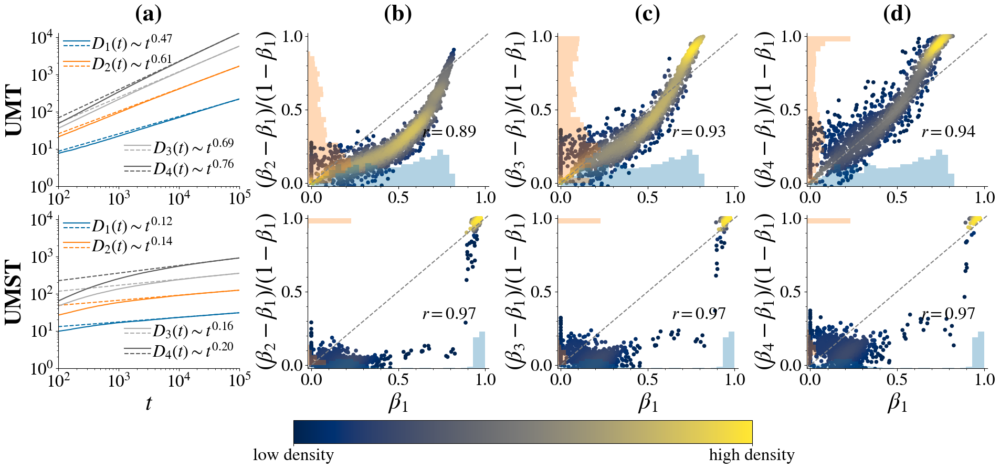

In [949]:
parameters_a_by_row = {'UMT' : (1,20,10), 'UMST':(.1, 4,4)}
Tmax = int(1e5)
fig = fig_2_new(
    results_simulations, 
    parameters_a_by_row,
    marker_size = 20, 
    alpha_scatter = 1, 
    alpha_histogram = 0.3, 
    color_x = CB_color_cycle[0], 
    color_y = CB_color_cycle[1], 
    max_hist = 0.25, 
    xlim_left_a = 1e2, 
    ylim_bottom_a = 1e0,
    min_beta = min_beta,
    max_beta = max_beta,
    min_beta_higher = min_beta_higher,
    max_beta_higher = max_beta_higher,
    use_same_x_y_max_lim = True,
)


fig.savefig(os.path.join(figures_folder, f"Fig2_Heaps_simulations_Tmax_%d_new.png"%(Tmax)))
fig.savefig(os.path.join(figures_folder, f"Fig2_Heaps_simulations_Tmax_%d_low_res_new.pdf"%(Tmax)),format='pdf',dpi=100)
fig.savefig(os.path.join(figures_folder, f"Fig2_Heaps_simulations_Tmax_%d_new.pdf"%(Tmax)),format='pdf')

## Figure SI (Tmax = 10^7)

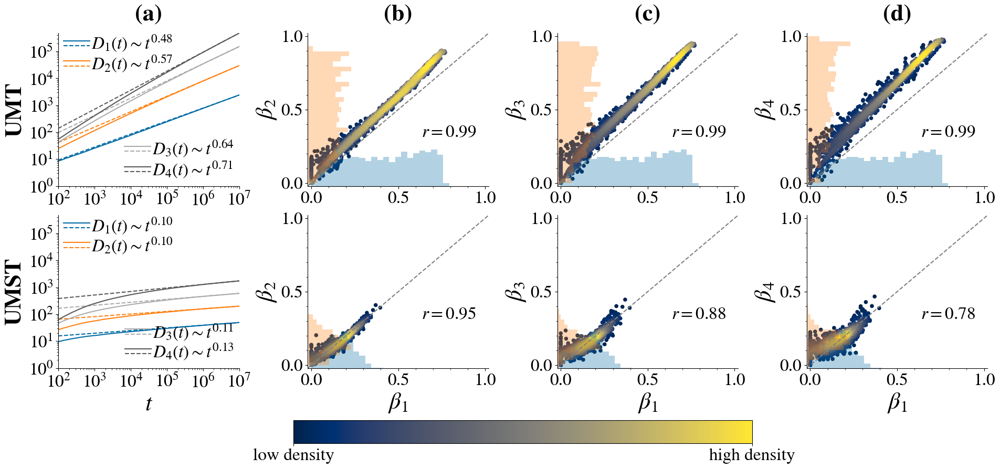

In [175]:
parameters_a_by_row = {'UMT' : (1,20,10), 'UMST':(.1, 4,4)}
Tmax = int(1e7)
fig = fig_2(
    results_simulations_long, 
    parameters_a_by_row,
    marker_size = 20, 
    alpha_scatter = 1, 
    alpha_histogram = 0.3, 
    color_x = CB_color_cycle[0], 
    color_y = CB_color_cycle[1], 
    max_hist = 0.25, 
    xlim_left_a = 1e2, 
    ylim_bottom_a = 1e0,
    min_beta = min_beta,
    max_beta = max_beta,
    min_beta_higher = min_beta_higher,
    max_beta_higher = max_beta_higher,
    use_same_x_y_max_lim = True,
)


fig.savefig(os.path.join(figures_folder, f"FigSI_Heaps_simulations_Tmax_%d.png"%(Tmax)))
fig.savefig(os.path.join(figures_folder, f"FigSI_Heaps_simulations_Tmax_%d_low_res.pdf"%(Tmax)),format='pdf',dpi=100)
fig.savefig(os.path.join(figures_folder, f"FigSI_Heaps_simulations_Tmax_%d.pdf"%(Tmax)),format='pdf')

## Figure SI: Comparison with $\nu/\rho$

### Functions

In [94]:
def fig_comparison_simulation_expected_beta(results_simulations, 
          parameters_by_row, # {'UMT':(eta, rho)}
          marker_size = 20, alpha_scatter = 1, alpha_histogram = 0.3, 
          y_correlation_text = .32, 
          color_x = CB_color_cycle[0], color_y = CB_color_cycle[1], max_hist = 0.25, xlim_left_a = 1, ylim_bottom_a = 1,
          min_beta = 0,
          max_beta = 1,
          min_beta_higher = 0,
          max_beta_higher = 1,
         ):
    num_datasets = len(parameters_a_by_row)
    fig = plt.figure(figsize=(width_fig,width_fig*2/3*num_datasets/3))
    outer = gridspec.GridSpec(nrows=num_datasets+1, ncols=1,height_ratios = [10]*num_datasets+[3],hspace=0.25)
    wspace = 0.38
    ncols = 4
    
    for i, dataset_label in enumerate(parameters_a_by_row.keys()):
        eta, rho = parameters_by_row[dataset_label]
        dataset_dict = {}
        dataset_dict['expected_betas'] = np.array([eta*nu/rho for nu,tmp_nu in results_simulations[eta][rho].items() for _ in tmp_nu["beta_loglogregr_indices_geom_list_finals"]])
        dataset_dict['betas'] = np.array([_ for nu,tmp_nu in results_simulations[eta][rho].items() for _ in tmp_nu["beta_loglogregr_indices_geom_list_finals"]])
        dataset_dict['betas2'] = np.array([_ for nu,tmp_nu in results_simulations[eta][rho].items() for _ in tmp_nu["beta2_loglogregr_indices_geom_list_finals"]])
        dataset_dict['betas3'] = np.array([_ for nu,tmp_nu in results_simulations[eta][rho].items() for _ in tmp_nu["beta3_loglogregr_indices_geom_list_finals"]])
        dataset_dict['betas4'] = np.array([_ for nu,tmp_nu in results_simulations[eta][rho].items() for _ in tmp_nu["beta4_loglogregr_indices_geom_list_finals"]])
        
        inner = gridspec.GridSpecFromSubplotSpec(1, ncols,
                            subplot_spec=outer[i],width_ratios=[1,1,1,1],wspace=wspace)
        if i == num_datasets - 1:
            xlabel = r"$\eta\nu/\rho$"
        else:
            xlabel = None
        
        for i_order, order in enumerate(['', '2', '3', '4']):
            n_order = i_order + 1
            ylabel = fr"$\beta_{n_order}$"
            ax = plt.Subplot(fig, inner[i_order])
            fig_1_subplot_b_d(dataset_dict['expected_betas'], dataset_dict[f'betas{order}'], 
                              ax = ax, 
                              marker_size = 20, alpha_scatter = alpha_scatter,
                              alpha_histogram = alpha_histogram, 
                              color_x = color_x, color_y = color_y, 
                              max_hist = max_hist, number_to_write = i*ncols+i_order,
                              write_number = i == 0, y_correlation_text = y_correlation_text,
                              ylabel = ylabel, xlabel = xlabel, 
                              min_x=min_beta, max_x=max_beta, min_y=min_beta_higher, max_y=max_beta_higher,
                             )
            if i_order == 0:
                ax.text(-0.33, 0.5, f"{dataset_label}", transform=ax.transAxes,fontweight='bold', horizontalalignment='right', verticalalignment='center', rotation = 90)
            fig.add_subplot(ax)
    
    ####################### COLORBAR #######################
    
    inner = gridspec.GridSpecFromSubplotSpec(2, 1,
                            subplot_spec=outer[-1],height_ratios=[1,1],hspace=0)
    ax_cmap = plt.Subplot(fig, inner[1])
    vmin = 0
    vmax = 1
    cb = fig.colorbar(ScalarMappable(norm=Normalize(vmin=vmin,vmax=vmax)), ax=ax_cmap,shrink=0.5,pad=0., fraction=1,orientation='horizontal')
    cb.ax.get_xaxis().set_ticks([0,1]) 
    cb.ax.get_xaxis().set_ticklabels(['low density', 'high density']) 
    ax_cmap.axis('off')
    fig.add_subplot(ax_cmap)
    
    return fig

### Figure (Tmax = 10^5)

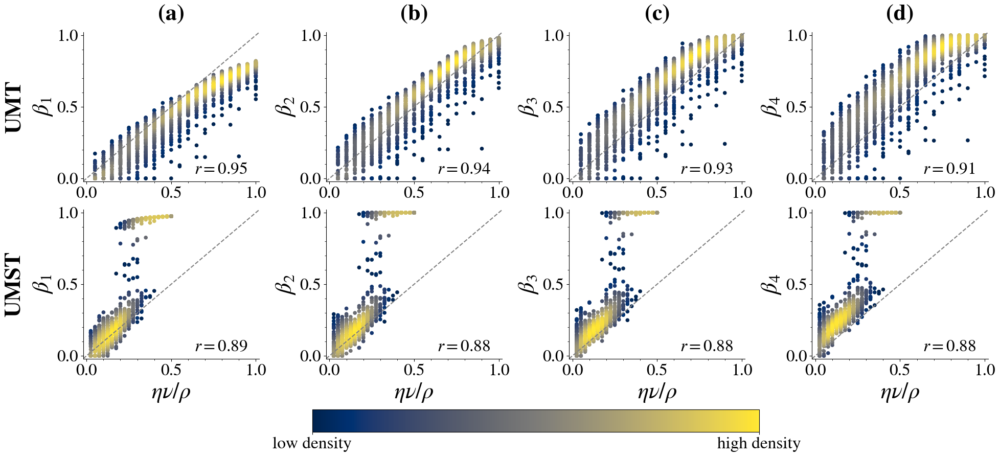

In [95]:
parameters_a_by_row = {'UMT' : (1,20), 'UMST':(.1, 4)}
Tmax = int(1e5)
fig = fig_comparison_simulation_expected_beta(
    results_simulations, 
    parameters_a_by_row,
    marker_size = 20, 
    alpha_scatter = 1, 
    alpha_histogram = 0, 
    y_correlation_text = .05,
    color_x = CB_color_cycle[0], 
    color_y = CB_color_cycle[1], 
    max_hist = 0.25, 
    xlim_left_a = 1e2, 
    ylim_bottom_a = 1e0,
#     min_beta = -0.02,
#     max_beta = 1.02,
#     min_beta_higher = -0.02,
#     max_beta_higher = 1.02,
    min_beta = 0,
    max_beta = 1,
    min_beta_higher = 0,
    max_beta_higher = 1,
)


fig.savefig(os.path.join(figures_folder, f"FigSI_Heaps_simulations_Tmax_%d_vs_expected.png"%(Tmax)))
fig.savefig(os.path.join(figures_folder, f"FigSI_Heaps_simulations_Tmax_%d_vs_expected_low_res.pdf"%(Tmax)),format='pdf',dpi=100)
fig.savefig(os.path.join(figures_folder, f"FigSI_Heaps_simulations_Tmax_%d_vs_expected.pdf"%(Tmax)),format='pdf')

### Figure (Tmax = 10^7)

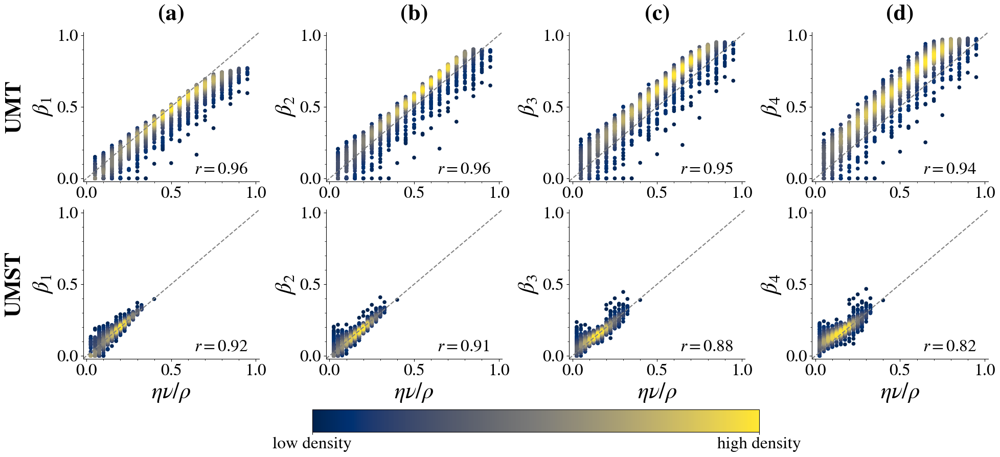

In [96]:
parameters_a_by_row = {'UMT' : (1,20), 'UMST':(.1, 4)}
Tmax = int(1e7)
fig = fig_comparison_simulation_expected_beta(
    results_simulations_long, 
    parameters_a_by_row,
    marker_size = 20, 
    alpha_scatter = 1, 
    alpha_histogram = 0, 
    y_correlation_text = .05,
    color_x = CB_color_cycle[0], 
    color_y = CB_color_cycle[1], 
    max_hist = 0.25, 
    xlim_left_a = 1e2, 
    ylim_bottom_a = 1e0,
#     min_beta = -0.02,
#     max_beta = 1.02,
#     min_beta_higher = -0.02,
#     max_beta_higher = 1.02,
    min_beta = 0,
    max_beta = 1,
    min_beta_higher = 0,
    max_beta_higher = 1,
)


fig.savefig(os.path.join(figures_folder, f"FigSI_Heaps_simulations_Tmax_%d_vs_expected.png"%(Tmax)))
fig.savefig(os.path.join(figures_folder, f"FigSI_Heaps_simulations_Tmax_%d_vs_expected_low_res.pdf"%(Tmax)),format='pdf',dpi=100)
fig.savefig(os.path.join(figures_folder, f"FigSI_Heaps_simulations_Tmax_%d_vs_expected.pdf"%(Tmax)),format='pdf')

## Table SI: Number of simulations not finished

### UMT

In [97]:
eta = 1
rho = 20
eta_list = []
rho_list = []
nu_list = []
Tmax_list = []
# ok_list = []
launched_list = []
finished_list = []
Tmax_long_list = []
# ok_long_list = []
launched_long_list = []
finished_long_list = []
for nu,tmp_nu in results_simulations[eta][rho].items():
    betas = tmp_nu['beta_loglogregr_indices_geom_list_finals']
    try:
        tmp_nu_long = results_simulations_long[eta][rho][nu]
        betas_long = tmp_nu_long['beta_loglogregr_indices_geom_list_finals']
    except:
        betas_long = []
#     num_ok = len([beta for beta in betas if beta < 0.9])
#     num_ok_long = len([beta for beta in betas_long if beta < 0.9])
    num_launched = 100
    num_launched_long = 100
    eta_list.append(eta)
    rho_list.append(rho)
    nu_list.append(nu)
    Tmax_list.append(r"$10^5$")
#     ok_list.append(num_ok)
    launched_list.append(num_launched)
    finished_list.append(len(betas))
    Tmax_long_list.append(r"$10^7$")
#     ok_long_list.append(num_ok_long)
    launched_long_list.append(num_launched_long)
    finished_long_list.append(len(betas_long))
df = pd.DataFrame(data = {
    r"$\eta$" : eta_list,
    r"$\rho$" : rho_list,
    r"$\nu$" : nu_list,
    r"$T$" : Tmax_list,
#     r"Ok" : ok_list,
    r"Launched" : launched_list,
    r"Finished" : finished_list,
    r" $T$" : Tmax_long_list,
#     r" Ok" : ok_long_list,
    r" Launched" : launched_list,
    r" Finished" : finished_long_list,
})
print(df.to_latex(index=False, column_format='c'*len(df.columns), float_format="%.2f", escape=False))

\begin{tabular}{ccccccccc}
\toprule
 $\eta$ &  $\rho$ &  $\nu$ &    $T$ &  Launched &  Finished &    $T$ &   Launched &   Finished \\
\midrule
      1 &      20 &      1 & $10^5$ &       100 &       100 & $10^7$ &        100 &        100 \\
      1 &      20 &      2 & $10^5$ &       100 &       100 & $10^7$ &        100 &        100 \\
      1 &      20 &      3 & $10^5$ &       100 &       100 & $10^7$ &        100 &        100 \\
      1 &      20 &      4 & $10^5$ &       100 &       100 & $10^7$ &        100 &        100 \\
      1 &      20 &      5 & $10^5$ &       100 &       100 & $10^7$ &        100 &        100 \\
      1 &      20 &      6 & $10^5$ &       100 &       100 & $10^7$ &        100 &        100 \\
      1 &      20 &      7 & $10^5$ &       100 &       100 & $10^7$ &        100 &        100 \\
      1 &      20 &      8 & $10^5$ &       100 &       100 & $10^7$ &        100 &        100 \\
      1 &      20 &      9 & $10^5$ &       100 &       100 & $10^7$ &   

### UMST

In [98]:
eta = 0.1
rho = 4
eta_list = []
rho_list = []
nu_list = []
Tmax_list = []
# ok_list = []
launched_list = []
finished_list = []
Tmax_long_list = []
# ok_long_list = []
launched_long_list = []
finished_long_list = []
for nu,tmp_nu in results_simulations[eta][rho].items():
    betas = tmp_nu['beta_loglogregr_indices_geom_list_finals']
    try:
        tmp_nu_long = results_simulations_long[eta][rho][nu]
        betas_long = tmp_nu_long['beta_loglogregr_indices_geom_list_finals']
    except:
        betas_long = []
#     num_ok = len([beta for beta in betas if beta < 0.9])
#     num_ok_long = len([beta for beta in betas_long if beta < 0.9])
    num_launched = 100
    num_launched_long = 100
    eta_list.append(eta)
    rho_list.append(rho)
    nu_list.append(nu)
    Tmax_list.append(r"$10^5$")
#     ok_list.append(num_ok)
    launched_list.append(num_launched)
    finished_list.append(len(betas))
    Tmax_long_list.append(r"$10^7$")
#     ok_long_list.append(num_ok_long)
    launched_long_list.append(num_launched_long)
    finished_long_list.append(len(betas_long))
df = pd.DataFrame(data = {
    r"$\eta$" : eta_list,
    r"$\rho$" : rho_list,
    r"$\nu$" : nu_list,
    r"$T$" : Tmax_list,
#     r"Ok" : ok_list,
    r"Launched" : launched_list,
    r"Finished" : finished_list,
    r" $T$" : Tmax_long_list,
#     r" Ok" : ok_long_list,
    r" Launched" : launched_list,
    r" Finished" : finished_long_list,
})
print(df.to_latex(index=False, column_format='c'*len(df.columns), float_format="%.1f", escape=False))

\begin{tabular}{ccccccccc}
\toprule
 $\eta$ &  $\rho$ &  $\nu$ &    $T$ &  Launched &  Finished &    $T$ &   Launched &   Finished \\
\midrule
    0.1 &       4 &      1 & $10^5$ &       100 &       100 & $10^7$ &        100 &        100 \\
    0.1 &       4 &      2 & $10^5$ &       100 &       100 & $10^7$ &        100 &        100 \\
    0.1 &       4 &      3 & $10^5$ &       100 &       100 & $10^7$ &        100 &        100 \\
    0.1 &       4 &      4 & $10^5$ &       100 &       100 & $10^7$ &        100 &        100 \\
    0.1 &       4 &      5 & $10^5$ &       100 &       100 & $10^7$ &        100 &        100 \\
    0.1 &       4 &      6 & $10^5$ &       100 &       100 & $10^7$ &        100 &        100 \\
    0.1 &       4 &      7 & $10^5$ &       100 &       100 & $10^7$ &        100 &         99 \\
    0.1 &       4 &      8 & $10^5$ &       100 &       100 & $10^7$ &        100 &         91 \\
    0.1 &       4 &      9 & $10^5$ &       100 &       100 & $10^7$ &   

### Together

In [99]:
max_count = 0
for label,eta in {'UMT':1, 'UMST':.1}.items():
    count = 0
    for rho in results_simulations[eta]:
        for nu,tmp_nu in results_simulations[eta][rho].items():
            count += 1
    print(eta, count)
    max_count = max(max_count, count)

1 20
0.1 20


In [100]:
data = {}
for label,eta in {'UMT':1, 'UMST':.1}.items():
    data[label] = {}
    data[label][r'$\eta$'] = []
    data[label][r'$\rho$'] = []
    data[label][r'$\nu$'] = []
    data[label][r'Reached $t=10^5$'] = []
    data[label][r'Reached $t=10^7$'] = []
    for rho,tmp_rho in results_simulations[eta].items():
        for nu,tmp_nu in tmp_rho.items():
            betas = tmp_nu['beta_loglogregr_indices_geom_list_finals']
            try:
                tmp_nu_long = results_simulations_long[eta][rho][nu]
                betas_long = tmp_nu_long['beta_loglogregr_indices_geom_list_finals']
            except:
                betas_long = []
            data[label][r'$\eta$'].append(eta)
            data[label][r'$\rho$'].append(rho)
            data[label][r'$\nu$'].append(nu)
            data[label][r'Reached $t=10^5$'].append(len(betas))
            data[label][r'Reached $t=10^7$'].append(len(betas_long))
#     df = pd.DataFrame(data = data[label])
# df = pd.DataFrame(data = {f"{label}_{key}":value for label,_ in data.items() for key,value in _.items()})
df = pd.DataFrame(data = {" "*i+key:value for i,(label,_) in enumerate(data.items()) for key,value in _.items()})
print(df.to_latex(index=False, column_format='c'*len(df.columns), float_format="%.1f", escape=False))

\begin{tabular}{cccccccccc}
\toprule
 $\eta$ &  $\rho$ &  $\nu$ &  Reached $t=10^5$ &  Reached $t=10^7$ &   $\eta$ &   $\rho$ &   $\nu$ &   Reached $t=10^5$ &   Reached $t=10^7$ \\
\midrule
      1 &      20 &      1 &               100 &               100 &      0.1 &        4 &       1 &                100 &                100 \\
      1 &      20 &      2 &               100 &               100 &      0.1 &        4 &       2 &                100 &                100 \\
      1 &      20 &      3 &               100 &               100 &      0.1 &        4 &       3 &                100 &                100 \\
      1 &      20 &      4 &               100 &               100 &      0.1 &        4 &       4 &                100 &                100 \\
      1 &      20 &      5 &               100 &               100 &      0.1 &        4 &       5 &                100 &                100 \\
      1 &      20 &      6 &               100 &               100 &      0.1 &        4 &

# OLD Figure3: $\beta_1$ vs $t$

## Functions

In [72]:
def fig_3_subplot(results_simulations,
                    parameters_to_plot,  # [(eta, rho, nu)] 
                    order,
                    beginning_index = 100, 
                    ax = None, marker_size = 20, alpha = 1, 
                    number_to_write = 0, 
                    xlim_left = 1e3, xlim_right = 1e7, 
                    ylim_bottom = 0, ylim_top = 1, 
                    ylabel = None, xlabel = None, 
                    do_horizontal_lines = True,
                    write_number = False):
    if ax == None:
        fig, ax = plt.subplots()
    
    if do_horizontal_lines:
        yticks = [0, 1]
    for i, (eta,rho,nu) in enumerate(parameters_to_plot):
#         ax.plot(results_simulations[eta][rho][nu]["ts_geom"][beginning_index:], results_simulations[eta][rho][nu][f"average_beta{order}_loglogregr_indices_geom"][beginning_index:], color=CB_color_cycle[i])
        ax.plot(results_simulations[eta][rho][nu]["ts_geom"][beginning_index:], results_simulations[eta][rho][nu][f"beta{order}_loglogregr_indices_geom"][beginning_index:], color=CB_color_cycle[i])
        expected_beta = float(eta)*float(nu)/rho
        if do_horizontal_lines:
            ax.axhline(expected_beta, ls='--', color=CB_color_cycle[i])
        if do_horizontal_lines and expected_beta not in yticks:
            yticks.append(expected_beta)

        
    ax.set_xlim(left = xlim_left, right = xlim_right)
    ax.set_ylim(bottom = ylim_bottom, top = ylim_top)
    ax.set_xlabel(xlabel, fontweight='bold')
    ax.set_ylabel(ylabel, fontweight='bold')
    ax.set_xscale("log")
    # Impose xticks
    locmaj = matplotlib.ticker.LogLocator(base=10,numticks=20) 
    ax.xaxis.set_major_locator(locmaj)
    locmin = matplotlib.ticker.LogLocator(base=10.0,subs=(np.arange(0.1,1,0.1)),numticks=20)
    ax.xaxis.set_minor_locator(locmin)
    ax.xaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
    
    if do_horizontal_lines:
        # y ticks
        ax.set_yticks(yticks)
    
    if write_number == True:
        ax.text(0.5, 1.08, f"{letters[number_to_write]}", transform=ax.transAxes,fontweight='bold', horizontalalignment='center')
    return ax

In [74]:
def fig_3(results_simulations, 
          parameters_to_plot, # [(eta, rho, nu)] 
          marker_size = 20, alpha = 1, 
          beginning_index = 100, 
          xlim_left = 1e3, xlim_right = 1e7, 
          min_beta = 0,
          max_beta = 1,
          do_horizontal_lines = True,
         ):
    fig, axes = plt.subplots(1,4,figsize=(width_fig,width_fig*2/3*1/3), gridspec_kw={'wspace':0.38})
    
    for i_order, order in enumerate(['', '2', '3', '4']):
        n_order = i_order + 1
        ax = axes[i_order]
        ax = fig_3_subplot(results_simulations,
                    parameters_to_plot, 
                    order,
                    beginning_index = beginning_index, 
                    ax = ax, alpha = 1, 
                    number_to_write = i_order, do_horizontal_lines = do_horizontal_lines, 
                    xlim_left = xlim_left, xlim_right = xlim_right, 
                    ylim_bottom = 0, ylim_top = 1, 
                    ylabel = fr"$\beta_{n_order}(t)$", xlabel = r"$t$", 
                    write_number = True)

    labels = []
    for i, (eta,rho,nu) in enumerate(parameters_to_plot):
        labels.append(r"$\rho=%d$"%rho+", "+r"$\nu=%d$"%nu+", "+r"$\eta=%s$"%str(eta))
    leg = ax.legend(
        [(color,"--",True) for color in CB_color_cycle[:4]], labels, 
                         handler_map={tuple: continuous_and_dashed_line_handle()},
        handletextpad=0.1, bbox_to_anchor=(0.5, -0.05), loc='upper center', bbox_transform=fig.transFigure, ncol=len(list(range(len(parameters_to_plot),20,len(parameters_to_plot))))+1)
    
    return fig

## Figure

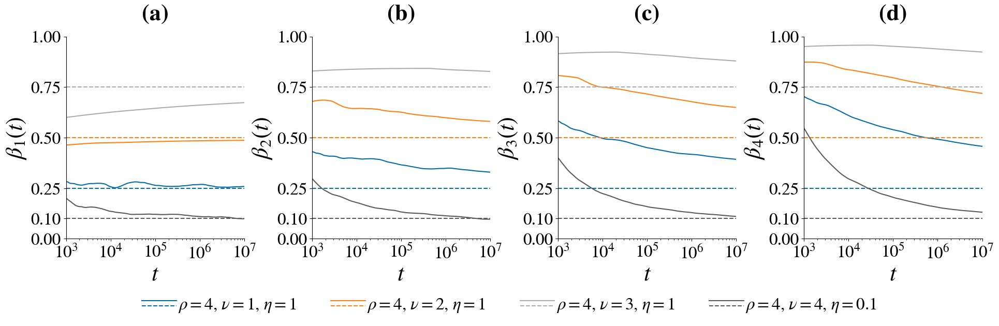

In [106]:
# parameters_to_plot = [(.1, 4, 4), (1, 20, 5), (1, 20, 10), (1, 20, 15)]
parameters_to_plot = [(1, 4, 1), (1, 4, 2), (1, 4, 3),(.1, 4, 4),]
fig = fig_3(
    results_simulations_long, 
    parameters_to_plot, # [(eta, rho, nu)] 
    marker_size = 20, alpha = 1, 
    beginning_index = 100, 
    min_beta = 0,
    max_beta = 1,
)
fig.savefig(os.path.join(figures_folder, f"Fig3_beta_changing_UMT_UMST_rho_4.png"))
fig.savefig(os.path.join(figures_folder, f"Fig3_beta_changing_UMT_UMST_rho_4.pdf"))

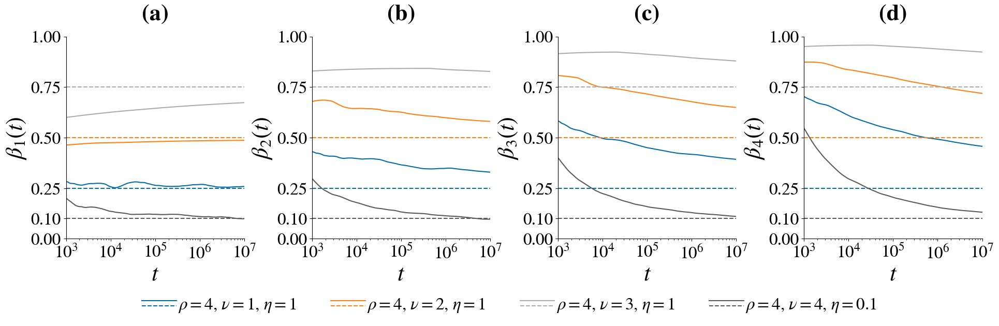

In [107]:
# parameters_to_plot = [(.1, 4, 4), (1, 20, 5), (1, 20, 10), (1, 20, 15)]
parameters_to_plot = [(1, 4, 1), (1, 4, 2), (1, 4, 3),(.1, 4, 4),]
fig = fig_3(
    results_simulations_long, 
    parameters_to_plot, # [(eta, rho, nu)] 
    marker_size = 20, alpha = 1, 
    beginning_index = 100, 
    min_beta = 0,
    max_beta = 1,
)
fig.savefig(os.path.join(figures_folder, f"Fig3_beta_changing_UMT_UMST_rho_4_fit_of_average.png"))
fig.savefig(os.path.join(figures_folder, f"Fig3_beta_changing_UMT_UMST_rho_4_fit_of_average.pdf"))

## With SINGLE UMST

In [116]:
def get_rho_nu_Tmax_eta_from_path_UMST(path):
    """
        This requires that after the last subfolder there is at least slash (doesn't matter if there is a filename as well) 
    """
    rho = float(path[-path[::-1].index('_ohr/'):path.index('/nu')])
    nu = int(path[-path[::-1].index('_un/'):path.index('/Tmax')])
    Tmax = int(path[-path[::-1].index('_xamT/'):path.index('/eta')])
    eta = float(path[-path[::-1].index('_ate/'):-path[::-1].index('/')-1])
    return rho, nu, Tmax, eta

In [117]:
def get_run_from_file_name_UMST(file_name):
    run = int(file_name[-file_name[::-1].index('_nur_'):-file_name[::-1].index('.')-1])
    return run

In [153]:
def get_all_data_UMST(
    rho=None,nu=None,Tmax=None,eta=None,run=None,
    starting_nu = None, ending_nu = None, 
    starting_run = None, ending_run = None,
#     consider_temporal_order_in_tuples = True,
#     folder = 'SW'
):
    """
        ACHTUNG: The output dictionary doesn't contain info on Tmax, so Tmax needs to be fixed in the parameters
    """
    UMST_results = {}
    count = 0
    all_folder = f"./data/UMST/simulations/analysis/"
    pattern = '*'
    if rho is not None:
        pattern += f'rho_{rho:.5f}/*'
    if nu is not None:
        pattern += f'nu_{int(nu)}/*'
    if Tmax is not None:
        pattern += f'Tmax_{int(Tmax)}/*'
    if eta is not None:
        pattern += f'eta_{eta:.5f}/*'
    if run is not None:
        pattern += f'UMT_run_{int(run)}.pkl'
    else:
        pattern += f'UMT_run_*.pkl'
    filepaths = sorted(find_pattern(pattern, all_folder))
    found_parameters = set()
    for path in tqdm(filepaths):
        file_name = path[-path[::-1].index('/'):path.index('.pkl')]
        rho, nu, Tmax, eta = get_rho_nu_Tmax_eta_from_path_UMST(path)
        run = get_run_from_file_name_UMST(path)
        if starting_nu is not None and nu < starting_nu:
            continue
        if ending_nu is not None and nu > ending_nu:
            continue
        if starting_run is not None and run < starting_run:
            continue
        if ending_run is not None and run > ending_run:
            continue
        try:
            with open(path, 'rb') as fp:
                result = joblib.load(fp)
        except:
            print("couldn't load", path)
            continue
        try:
            UMST_results[eta][rho][nu][run] = result
        except:
            try:
                UMST_results[eta][rho][nu] = {run : result}
            except:
                try:
                    UMST_results[eta][rho] = {nu : {run : result}}
                except:
                    UMST_results[eta] = {rho : {nu : {run : result}}}
        found_parameters.add((eta,rho,nu))
        count += 1
    print('FOUND',count, sep = "\t")
    print(list(found_parameters))
    return UMST_results

### Get data

In [154]:
UMST_results = get_all_data_UMST(
    rho=None,nu=10,Tmax=int(1e5),eta=None,run=None,
    starting_nu = None, ending_nu = None, 
    starting_run = 1, ending_run = 4,
#     consider_temporal_order_in_tuples = True,
#     folder = 'SW'
)

  0%|          | 0/290 [00:00<?, ?it/s]

FOUND	44
[(0.7, 10.0, 10), (1.0, 20.0, 10), (0.1, 4.0, 10), (0.6, 10.0, 10), (0.2, 10.0, 10), (0.9, 10.0, 10), (0.3, 10.0, 10), (0.4, 10.0, 10), (0.5, 10.0, 10), (0.1, 10.0, 10), (0.8, 10.0, 10)]


### Figures

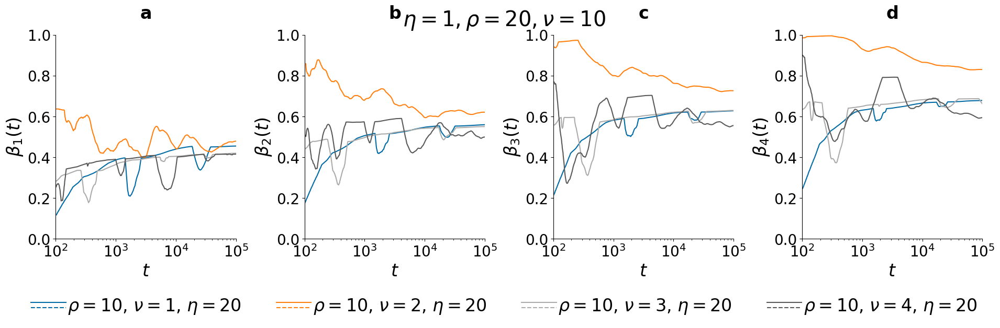

In [155]:
# parameters_to_plot = [(.1, 4, 4), (1, 20, 5), (1, 20, 10), (1, 20, 15)]
eta = 1
rho = 20
nu = 10
parameters_to_plot = [(rho, nu, 1), (rho, nu, 2), (rho, nu, 3),(rho, nu, 4)]
fig = fig_3(
    UMST_results[eta], 
    parameters_to_plot, # [(eta, rho, nu)] 
    marker_size = 20, alpha = 1, 
    beginning_index = 100, 
    xlim_left = 1e2, xlim_right = 1e5, 
    min_beta = 0,
    max_beta = 1,
    do_horizontal_lines = False,
)
plt.suptitle(fr"$\eta = {str(eta)}, \rho = {str(rho)}, \nu = {nu}$")
fig.savefig(os.path.join(figures_folder, f"Fig_beta_changing_eta_{str(eta)}_rho_{str(rho)}_nu_{nu}.png"))
fig.savefig(os.path.join(figures_folder, f"Fig_beta_changing_eta_{str(eta)}_rho_{str(rho)}_nu_{nu}.pdf"))

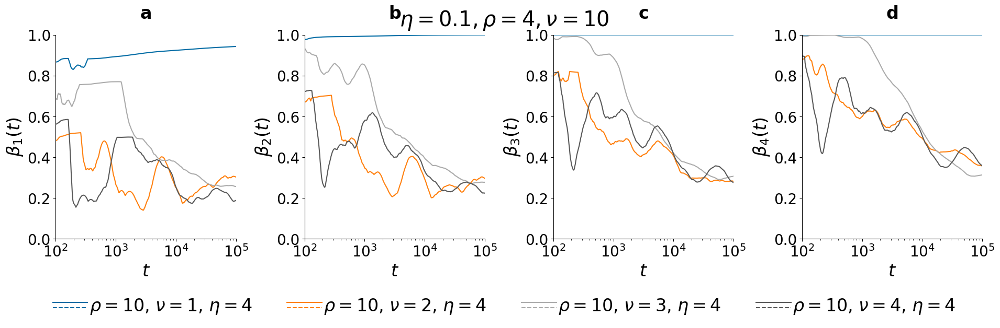

In [156]:
# parameters_to_plot = [(.1, 4, 4), (1, 20, 5), (1, 20, 10), (1, 20, 15)]
eta = .1
rho = 4
nu = 10
parameters_to_plot = [(rho, nu, 1), (rho, nu, 2), (rho, nu, 3),(rho, nu, 4)]
fig = fig_3(
    UMST_results[eta], 
    parameters_to_plot, # [(eta, rho, nu)] 
    marker_size = 20, alpha = 1, 
    beginning_index = 100, 
    xlim_left = 1e2, xlim_right = 1e5, 
    min_beta = 0,
    max_beta = 1,
    do_horizontal_lines = False,
)
plt.suptitle(fr"$\eta = {str(eta)}, \rho = {str(rho)}, \nu = {nu}$")
fig.savefig(os.path.join(figures_folder, f"Fig_beta_changing_eta_{str(eta)}_rho_{str(rho)}_nu_{nu}.png"))
fig.savefig(os.path.join(figures_folder, f"Fig_beta_changing_eta_{str(eta)}_rho_{str(rho)}_nu_{nu}.pdf"))

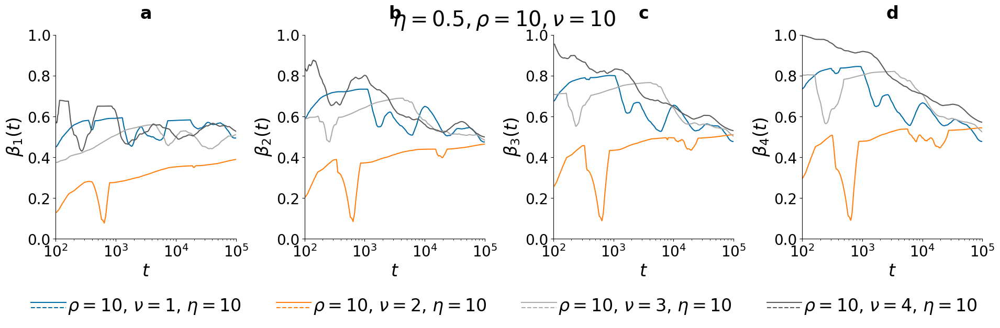

In [157]:
# parameters_to_plot = [(.1, 4, 4), (1, 20, 5), (1, 20, 10), (1, 20, 15)]
eta = .5
rho = 10
nu = 10
parameters_to_plot = [(rho, nu, 1), (rho, nu, 2), (rho, nu, 3),(rho, nu, 4)]
fig = fig_3(
    UMST_results[eta], 
    parameters_to_plot, # [(eta, rho, nu)] 
    marker_size = 20, alpha = 1, 
    beginning_index = 100, 
    xlim_left = 1e2, xlim_right = 1e5, 
    min_beta = 0,
    max_beta = 1,
    do_horizontal_lines = False,
)
plt.suptitle(fr"$\eta = {str(eta)}, \rho = {str(rho)}, \nu = {nu}$")
fig.savefig(os.path.join(figures_folder, f"Fig_beta_changing_eta_{str(eta)}_rho_{str(rho)}_nu_{nu}.png"))
fig.savefig(os.path.join(figures_folder, f"Fig_beta_changing_eta_{str(eta)}_rho_{str(rho)}_nu_{nu}.pdf"))

## With SINGLE ERRW

### Function

In [50]:
def get_p_dw_ID_from_file_name_ERRW(file_name):
    p = float(file_name[-file_name[::-1].index('p_'):file_name.index('_dw')])
    dw = float(file_name[-file_name[::-1].index('wd_'):file_name.index('_sim')])
    ID = int(file_name[-file_name[::-1].index('DImis_'):])
    return p, dw, ID

In [57]:
def get_all_data_ERRW(
    p=None,dw=None,min_dw = None, max_dw = None, 
    consider_temporal_order_in_tuples = True,
    folder = 'SW'
):
    ERRW_results = {}
    count = 0
    if consider_temporal_order_in_tuples:
        all_folder = f"./data/ERRW/{folder}/analysis/all_results/"
    else:
        all_folder = f"./data/ERRW/{folder}/analysis_tuples_without_order/all_results/"
    pattern = '*'
    if p is not None:
        pattern += f'p{p:.3f}*'
    if dw is not None:
        pattern += f'dw{dw:.5f}*' # f'dw{dw:.2f}*'
    filepaths = sorted(find_pattern(pattern+'.pkl', all_folder))
    for path in tqdm(filepaths):
        file_name = path[-path[::-1].index('/'):path.index('.pkl')]
        p, dw, ID = get_p_dw_ID_from_file_name_ERRW(file_name)
        if (min_dw is None or min_dw is not None and dw >= min_dw) and (max_dw is None or max_dw is not None and dw <= max_dw):
            try:
                with open(os.path.join(all_folder, f'{file_name}.pkl'), 'rb') as fp:
                    result = joblib.load(fp)
#                 ERRW_results[(p, dw, ID)] = result
                try:
                    ERRW_results[p][dw][ID] = result
                except:
                    try:
                        ERRW_results[p][dw] = {ID : result}
                    except:
                        ERRW_results[p] = {dw : {ID : result}}
                count += 1
            except:
                pass
    print('FOUND ',count, sep = "\t")
    return ERRW_results

### Get data

In [77]:
ERRW_results = get_all_data_ERRW(
    p=None,dw=None,min_dw = None, max_dw = None, 
    consider_temporal_order_in_tuples = True,
    folder = 'SW_longruns'
)

  0%|          | 0/10 [00:00<?, ?it/s]

FOUND 	10


In [81]:
ERRW_results_no_order = get_all_data_ERRW(
    p=None,dw=None,min_dw = None, max_dw = None, 
    consider_temporal_order_in_tuples = False,
    folder = 'SW_longruns'
)

  0%|          | 0/10 [00:00<?, ?it/s]

FOUND 	10


### Figures

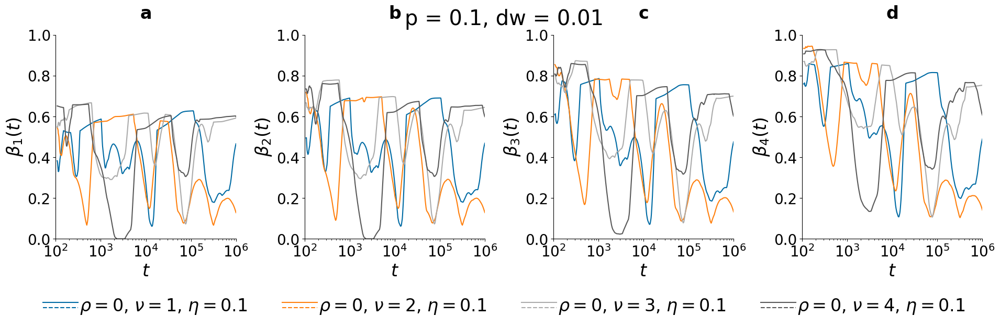

In [79]:
# parameters_to_plot = [(.1, 4, 4), (1, 20, 5), (1, 20, 10), (1, 20, 15)]
parameters_to_plot = [(0.1, 0.01, 1), (0.1, 0.01, 2), (0.1, 0.01, 3),(0.1, 0.01, 4)]
fig = fig_3(
    ERRW_results, 
    parameters_to_plot, # [(eta, rho, nu)] 
    marker_size = 20, alpha = 1, 
    beginning_index = 100, 
    xlim_left = 1e2, xlim_right = 1e6, 
    min_beta = 0,
    max_beta = 1,
    do_horizontal_lines = False,
)
plt.suptitle(r"p = 0.1, dw = 0.01")
fig.savefig(os.path.join(figures_folder, f"Fig_beta_changing_p0.100_dw0.01000.png"))
fig.savefig(os.path.join(figures_folder, f"Fig_beta_changing_p0.100_dw0.01000.pdf"))

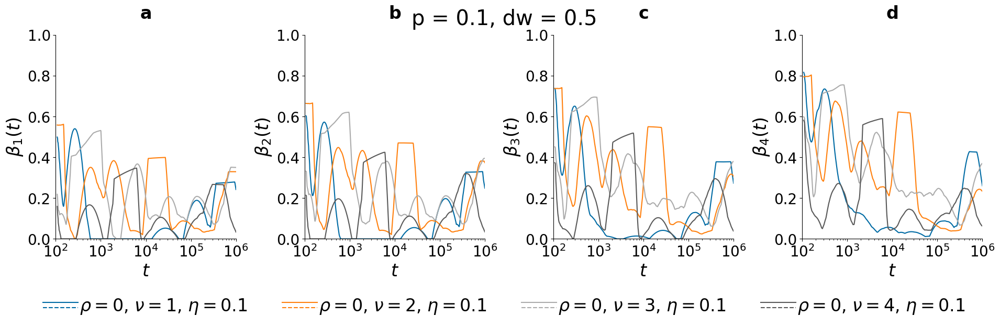

In [80]:
# parameters_to_plot = [(.1, 4, 4), (1, 20, 5), (1, 20, 10), (1, 20, 15)]
parameters_to_plot = [(0.1, 0.5, 1), (0.1, 0.5, 2), (0.1, 0.5, 3),(0.1, 0.5, 4),]
fig = fig_3(
    ERRW_results, 
    parameters_to_plot, # [(eta, rho, nu)] 
    marker_size = 20, alpha = 1, 
    beginning_index = 100, 
    xlim_left = 1e2, xlim_right = 1e6, 
    min_beta = 0,
    max_beta = 1,
    do_horizontal_lines = False,
)
plt.suptitle(r"p = 0.1, dw = 0.5")
fig.savefig(os.path.join(figures_folder, f"Fig_beta_changing_p0.100_dw0.50000.png"))
fig.savefig(os.path.join(figures_folder, f"Fig_beta_changing_p0.100_dw0.50000.pdf"))

#### No order

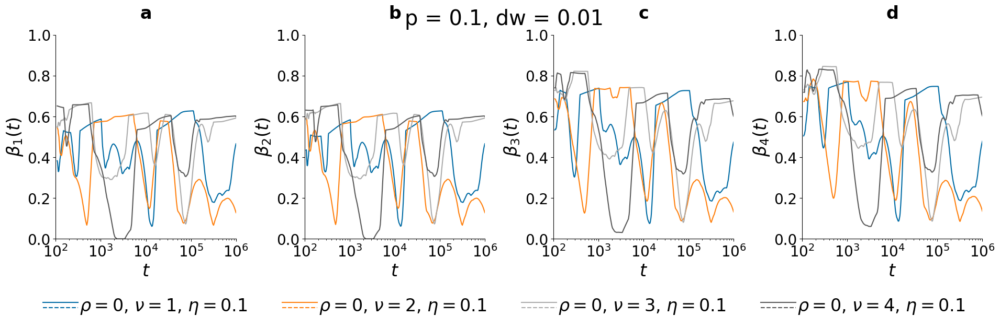

In [82]:
# parameters_to_plot = [(.1, 4, 4), (1, 20, 5), (1, 20, 10), (1, 20, 15)]
parameters_to_plot = [(0.1, 0.01, 1), (0.1, 0.01, 2), (0.1, 0.01, 3),(0.1, 0.01, 4)]
fig = fig_3(
    ERRW_results_no_order, 
    parameters_to_plot, # [(eta, rho, nu)] 
    marker_size = 20, alpha = 1, 
    beginning_index = 100, 
    xlim_left = 1e2, xlim_right = 1e6, 
    min_beta = 0,
    max_beta = 1,
    do_horizontal_lines = False,
)
plt.suptitle(r"p = 0.1, dw = 0.01")
fig.savefig(os.path.join(figures_folder, f"Fig_beta_changing_no_order_p0.100_dw0.01000.png"))
fig.savefig(os.path.join(figures_folder, f"Fig_beta_changing_no_order_p0.100_dw0.01000.pdf"))

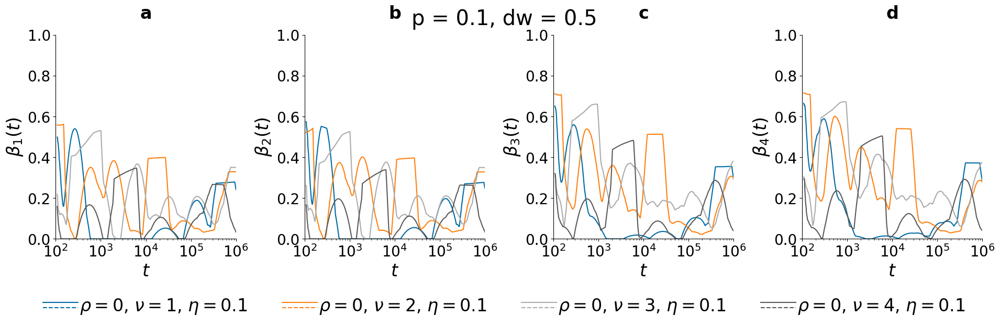

In [83]:
# parameters_to_plot = [(.1, 4, 4), (1, 20, 5), (1, 20, 10), (1, 20, 15)]
parameters_to_plot = [(0.1, 0.5, 1), (0.1, 0.5, 2), (0.1, 0.5, 3),(0.1, 0.5, 4),]
fig = fig_3(
    ERRW_results_no_order, 
    parameters_to_plot, # [(eta, rho, nu)] 
    marker_size = 20, alpha = 1, 
    beginning_index = 100, 
    xlim_left = 1e2, xlim_right = 1e6, 
    min_beta = 0,
    max_beta = 1,
    do_horizontal_lines = False,
)
plt.suptitle(r"p = 0.1, dw = 0.5")
fig.savefig(os.path.join(figures_folder, f"Fig_beta_changing_no_order_p0.100_dw0.50000.png"))
fig.savefig(os.path.join(figures_folder, f"Fig_beta_changing_no_order_p0.100_dw0.50000.pdf"))

# OLD Figure4 OLD: Entropy vs $\beta_1$

## Load data with entropy

In [ ]:
with gzip.open('./data/essential_data_with_entropy_for_figures.pkl.gz', "rb") as fp:
    data_with_entropy = joblib.load(fp)

## Preare data with entropy

Use this section only on the first run. Otherwise, just load the prepared data on the previous section

In [434]:
# Load one random individual result (not light) from each dataset
with open(f'./data/random_individual_lastfm.pkl', 'rb') as fp:
    random_individual_lastfm = joblib.load(fp)
with open(f'./data/random_individual_gutenberg.pkl', 'rb') as fp:
    random_individual_gutenberg = joblib.load(fp)
with open(f'./data/random_individual_journals.pkl', 'rb') as fp:
    random_individual_journals = joblib.load(fp)

In [435]:
data_with_entropy = data.copy()
data_with_entropy['Last.fm']['random_individual'] = random_individual_lastfm
data_with_entropy['Project Gutenberg']['random_individual'] = random_individual_gutenberg
data_with_entropy['Semantic Scholar']['random_individual'] = random_individual_journals

In [436]:
data['Last.fm']['weighted_diff_entropies'] = np.array([result["weighted_diff_entropies"] for result in results_light_individual_lastfm.values()])
data['Project Gutenberg']['weighted_diff_entropies'] = np.array([result["weighted_diff_entropies"] for result in results_light_individual_gutenberg.values()])
data['Semantic Scholar']['weighted_diff_entropies'] = np.array([result["weighted_diff_entropies"] for field, field_results in results_light_individual_journals_fieldsOfStudy.items() for result in field_results.values()])

In [437]:
# add data about model
use_long_simulations = False
if use_long_simulations:
    tmp_results_simulations = results_simulations_long
else:
    tmp_results_simulations = results_simulations
eta_rho_to_use = [(1, 20)]
nu_to_use = np.arange(1,21)
data_with_entropy['UMT'] = {}
for order in ['', '2', '3', '4']:
    data_with_entropy['UMT'][f'betas{order}'] = np.array([_ for eta,rho in eta_rho_to_use for nu in nu_to_use if nu in tmp_results_simulations[eta][rho] for _ in tmp_results_simulations[eta][rho][nu][f"beta{order}_loglogregr_indices_geom_list_finals"]])
data_with_entropy['UMT'][f'weighted_diff_entropies'] = np.array([_ for eta,rho in eta_rho_to_use for nu in nu_to_use if nu in tmp_results_simulations[eta][rho] for _ in tmp_results_simulations[eta][rho][nu][f"weighted_diff_entropies_list"]])

In [439]:
eta = 1
rho = 20
nu = 10
run = 1
Tmax = int(1e5)
with open(f"./data/simulations/rho_{rho:.5f}/nu_{nu}/Tmax_{Tmax}/eta_{eta:.5f}/UMT_run_{run}.pkl",'rb') as fp:
     data_with_entropy['UMT']['random_individual'] = pickle.load(fp)

In [440]:
# add data about model
use_long_simulations = False
if use_long_simulations:
    tmp_results_simulations = results_simulations_long
else:
    tmp_results_simulations = results_simulations
eta_rho_to_use = [(.1, 4)]
nu_to_use = np.arange(1,21)
data_with_entropy['UMST'] = {}
for order in ['', '2', '3', '4']:
    data_with_entropy['UMST'][f'betas{order}'] = np.array([_ for eta,rho in eta_rho_to_use for nu in nu_to_use if nu in tmp_results_simulations[eta][rho] for _ in tmp_results_simulations[eta][rho][nu][f"beta{order}_loglogregr_indices_geom_list_finals"]])
data_with_entropy['UMST'][f'weighted_diff_entropies'] = np.array([_ for eta,rho in eta_rho_to_use for nu in nu_to_use if nu in tmp_results_simulations[eta][rho] for _ in tmp_results_simulations[eta][rho][nu][f"weighted_diff_entropies_list"]])

In [441]:
eta = .1
rho = 4
nu = 10
run = 1
Tmax = int(1e5)
with open(f"./data/simulations/rho_{rho:.5f}/nu_{nu}/Tmax_{Tmax}/eta_{eta:.5f}/UMT_run_{run}.pkl",'rb') as fp:
     data_with_entropy['UMST']['random_individual'] = pickle.load(fp)

### Get data for (a)

#### Last.fm

In [442]:
with gzip.open("./data/ocelma-dataset/lastfm-dataset-1K/users_list_min_1000.pkl.gz", "rb") as fp:
    users_list = joblib.load(fp)

In [443]:
# data_with_entropy['Last.fm']['mean_entropies'] = {}
# data_with_entropy['Last.fm']['mean_entropies_glob'] = {}
# count = 0
# for i,userid in enumerate(tqdm(users_list)):
#     try:
#         save_all_file_path = f"./data/ocelma-dataset/lastfm-dataset-1K/individual_results/{userid}.pkl"
#         with open(save_all_file_path, 'rb') as fp:
#             user_result = pickle.load(fp)
#         data_with_entropy['Last.fm']['mean_entropies'][userid] = user_result['mean_entropies']
#         data_with_entropy['Last.fm']['mean_entropies_glob'][userid] = user_result['mean_entropies_glob']
#         count += 1
#     except:
#         pass
# print(f"Found {count} users out of {len(users_list)}")

In [444]:
data_with_entropy['Last.fm']['mean_entropies'] = {}
data_with_entropy['Last.fm']['mean_entropies_glob'] = {}
count = 0
for i,userid in enumerate(tqdm(users_list)):
    try:
        save_all_file_path = f"./data/ocelma-dataset/lastfm-dataset-1K/individual_results/{userid}.pkl"
        with open(save_all_file_path, 'rb') as fp:
            user_result = pickle.load(fp)
        for freq,value in user_result['mean_entropies'].items():
            try:
                data_with_entropy['Last.fm']['mean_entropies'][freq].append(value)
            except KeyError:
                data_with_entropy['Last.fm']['mean_entropies'][freq] = [value]
        for freq,value in user_result['mean_entropies_glob'].items():
            try:
                data_with_entropy['Last.fm']['mean_entropies_glob'][freq].append(value)
            except KeyError:
                data_with_entropy['Last.fm']['mean_entropies_glob'][freq] = [value]
        count += 1
    except:
        pass
print(f"Found {count} users out of {len(users_list)}")

  0%|          | 0/890 [00:00<?, ?it/s]

Found 890 users out of 890


#### Gutenberg

In [445]:
paths = glob.glob("./data/gutenberg/analysis/individual_results/*.pkl")
paths[:10]

['./data/gutenberg/analysis/individual_results/PG57676.pkl',
 './data/gutenberg/analysis/individual_results/PG62224.pkl',
 './data/gutenberg/analysis/individual_results/PG37412.pkl',
 './data/gutenberg/analysis/individual_results/PG57663.pkl',
 './data/gutenberg/analysis/individual_results/PG64397.pkl',
 './data/gutenberg/analysis/individual_results/PG42170.pkl',
 './data/gutenberg/analysis/individual_results/PG67188.pkl',
 './data/gutenberg/analysis/individual_results/PG49742.pkl',
 './data/gutenberg/analysis/individual_results/PG55584.pkl',
 './data/gutenberg/analysis/individual_results/PG42969.pkl']

In [446]:
data_with_entropy['Project Gutenberg']['mean_entropies'] = {}
data_with_entropy['Project Gutenberg']['mean_entropies_glob'] = {}
count = 0
for path in tqdm(paths):
#     ID = path.split('/')[-1].split(".pkl")[0]
    try:
        with open(path, 'rb') as fp:
            result = pickle.load(fp)
        for freq,value in result['mean_entropies'].items():
            try:
                data_with_entropy['Project Gutenberg']['mean_entropies'][freq].append(value)
            except KeyError:
                data_with_entropy['Project Gutenberg']['mean_entropies'][freq] = [value]
        for freq,value in result['mean_entropies_glob'].items():
            try:
                data_with_entropy['Project Gutenberg']['mean_entropies_glob'][freq].append(value)
            except KeyError:
                data_with_entropy['Project Gutenberg']['mean_entropies_glob'][freq] = [value]
        count += 1
    except:
        pass
print(f"Found {count} users out of {len(users_list)}")

  0%|          | 0/1492 [00:00<?, ?it/s]

Found 1492 users out of 890


#### Semantic Scholar

In [447]:
field = 'Art'
paths = glob.glob(f"data/semanticscholar/analysis/2022-01-01/journals_fieldsOfStudy/{field}/*.pkl")
paths[:10]

['data/semanticscholar/analysis/2022-01-01/journals_fieldsOfStudy/Art/419.pkl',
 'data/semanticscholar/analysis/2022-01-01/journals_fieldsOfStudy/Art/158.pkl',
 'data/semanticscholar/analysis/2022-01-01/journals_fieldsOfStudy/Art/121.pkl',
 'data/semanticscholar/analysis/2022-01-01/journals_fieldsOfStudy/Art/445.pkl',
 'data/semanticscholar/analysis/2022-01-01/journals_fieldsOfStudy/Art/390.pkl',
 'data/semanticscholar/analysis/2022-01-01/journals_fieldsOfStudy/Art/769.pkl',
 'data/semanticscholar/analysis/2022-01-01/journals_fieldsOfStudy/Art/732.pkl',
 'data/semanticscholar/analysis/2022-01-01/journals_fieldsOfStudy/Art/33.pkl',
 'data/semanticscholar/analysis/2022-01-01/journals_fieldsOfStudy/Art/471.pkl',
 'data/semanticscholar/analysis/2022-01-01/journals_fieldsOfStudy/Art/795.pkl']

In [448]:
data_with_entropy['Semantic Scholar']['mean_entropies'] = {}
data_with_entropy['Semantic Scholar']['mean_entropies_glob'] = {}
count = 0
for path in tqdm(paths):
#     ID = path.split('/')[-1].split(".pkl")[0]
    try:
        with open(path, 'rb') as fp:
            result = pickle.load(fp)
        for freq,value in result['mean_entropies'].items():
            try:
                data_with_entropy['Semantic Scholar']['mean_entropies'][freq].append(value)
            except KeyError:
                data_with_entropy['Semantic Scholar']['mean_entropies'][freq] = [value]
        for freq,value in result['mean_entropies_glob'].items():
            try:
                data_with_entropy['Semantic Scholar']['mean_entropies_glob'][freq].append(value)
            except KeyError:
                data_with_entropy['Semantic Scholar']['mean_entropies_glob'][freq] = [value]
        count += 1
    except:
        pass
print(f"Found {count} users out of {len(paths)}")

  0%|          | 0/1000 [00:00<?, ?it/s]

Found 1000 users out of 890


#### UMT

In [452]:
Tmax = int(1e5)
data_with_entropy['UMT']['mean_entropies'] = {}
data_with_entropy['UMT']['mean_entropies_glob'] = {}
count = 0
for eta in [1]:
    for rho in [20]:
        for nu in tqdm(range(21)):
            workdir = f"./data/simulations/rho_{rho:.5f}/nu_{nu}/Tmax_{Tmax}/eta_{eta:.5f}/"
            for run in range(100):
                try:
                    with open(f"{workdir}UMT_run_{run}.pkl", 'rb') as fp:
                        result = pickle.load(fp)
                    for freq,value in result['mean_entropies'].items():
                        try:
                            data_with_entropy['UMT']['mean_entropies'][freq].append(value)
                        except KeyError:
                            data_with_entropy['UMT']['mean_entropies'][freq] = [value]
                    for freq,value in result['mean_entropies_glob'].items():
                        try:
                            data_with_entropy['UMT']['mean_entropies_glob'][freq].append(value)
                        except KeyError:
                            data_with_entropy['UMT']['mean_entropies_glob'][freq] = [value]
                    count += 1
                except:
                    pass
print(f"Found {count} simulations")

  0%|          | 0/21 [00:00<?, ?it/s]

Found 1000 simulations


#### UMST

In [449]:
# Tmax = int(1e5)
# use_scratch = False
# for eta in [1]:#,0.01,0.001,0]:
#     for rho in [20]:
#         for nu in tqdm(range(1,11)):# min(21,int(rho/eta))):
#             workdir = f"./data/simulations/rho_{rho:.5f}/nu_{nu}/Tmax_{Tmax}/eta_{eta:.5f}/"
# #             print(glob.glob(workdir+"*"))
#             for run in range(100):
#                 try:
#                     os.rename(f"{workdir}UMT_light_run_{run}.pkl", f"{workdir}UMT_light_RUN_{run}_old.pkl", )
#                 except:
#                     pass
#             try:
#                 os.rename(f"{workdir}average_UMT_light_results.pkl", f"{workdir}average_UMT_light_results_old.pkl", )
#             except:
#                 pass

In [451]:
Tmax = int(1e5)
data_with_entropy['UMST']['mean_entropies'] = {}
data_with_entropy['UMST']['mean_entropies_glob'] = {}
count = 0
for eta in [.1]:
    for rho in [4]:
        for nu in tqdm(range(21)):
            workdir = f"./data/simulations/rho_{rho:.5f}/nu_{nu}/Tmax_{Tmax}/eta_{eta:.5f}/"
            for run in range(100):
                try:
                    with open(f"{workdir}UMT_run_{run}.pkl", 'rb') as fp:
                        result = pickle.load(fp)
                    for freq,value in result['mean_entropies'].items():
                        try:
                            data_with_entropy['UMST']['mean_entropies'][freq].append(value)
                        except KeyError:
                            data_with_entropy['UMST']['mean_entropies'][freq] = [value]
                    for freq,value in result['mean_entropies_glob'].items():
                        try:
                            data_with_entropy['UMST']['mean_entropies_glob'][freq].append(value)
                        except KeyError:
                            data_with_entropy['UMST']['mean_entropies_glob'][freq] = [value]
                    count += 1
                except:
                    pass
print(f"Found {count} simulations")

  0%|          | 0/21 [00:00<?, ?it/s]

Found 1012 simulations


### Dump data

In [453]:
with gzip.open('./data/essential_data_with_entropy_for_figures.pkl.gz', "wb") as fp:
    joblib.dump(data_with_entropy, fp)
print('Dumped')

Dumped


## Functions

In [473]:
def fig_4_subplot_a_old(result, 
                    ax = None, marker_size = 20, alpha = 0.5, 
                    dataset_label = None, 
                    number_to_write = 0, 
                    xlim_left = 1, xlim_right = None, 
                    ylim_bottom = 0, ylim_top = 1, 
                    ylabel = r"$S(f)$", xlabel = r"$f$", 
                    write_number = False):
    if ax == None:
        fig, ax = plt.subplots()
#        # orig 
#     ax.scatter(list(result["mean_entropies"].keys()),list(result["mean_entropies"].values()), rasterized = True, label=r"original", alpha=alpha)
#     ax.scatter(list(result["mean_entropies_glob"].keys()),list(result["mean_entropies_glob"].values()), marker='s', rasterized = True, label=r"reshuffled", alpha=alpha)
    # with all of them
#     ax.scatter(
#         [freq for tmp_i, tmp_dict in result["mean_entropies"].items() for freq,value in tmp_dict.items()],
#         [value for tmp_i, tmp_dict in result["mean_entropies"].items() for freq,value in tmp_dict.items()], 
#         rasterized = True, label=r"original", alpha=alpha, s=marker_size)
#     ax.scatter(
#         [freq for tmp_i, tmp_dict in result["mean_entropies_glob"].items() for freq,value in tmp_dict.items()],
#         [value for tmp_i, tmp_dict in result["mean_entropies_glob"].items() for freq,value in tmp_dict.items()], 
#         marker='s', rasterized = True, label=r"reshuffled", alpha=alpha, s=marker_size)
    # with average of them
    ax.scatter(
        [freq  for freq,value in result["mean_entropies"].items()],
        [np.mean(value)  for freq,value in result["mean_entropies"].items()],
        rasterized = True, label=r"original", alpha=alpha, s=marker_size)
    ax.scatter(
        [freq for freq,value in result["mean_entropies_glob"].items()],
        [np.mean(value) for freq,value in result["mean_entropies_glob"].items()],
        marker='s', rasterized = True, label=r"reshuffled", alpha=alpha, s=marker_size)
#     # with average of them binned
#     x = [freq  for freq,values in result["mean_entropies"].items() for value in values]
#     max_x = max(x)
#     min_x = min(x)
#     num_bins = 100
#     x_bins_lim = np.array([min_x-0.5] + list(np.array(np.unique(np.geomspace(min_x, max_x, num = num_bins, dtype=int)),dtype=float) + 0.5))
#     x_bins_centers = (x_bins_lim[1:] + x_bins_lim[:-1]) / 2
#     y = [value  for freq,values in result["mean_entropies"].items() for value in values]
#     y_bins_count = np.zeros(len(x_bins_centers))
#     y_bins_sum = np.zeros(len(x_bins_centers))
#     for index,freq in enumerate(x):
#         value = y[index]
#         for index_bin, x_bins_lim_right in enumerate(x_bins_lim[1:]):
#             if freq < x_bins_lim_right:
#                 break
#         y_bins_sum[index_bin] += value
#         y_bins_count[index_bin] += 1
#     y_bins = np.zeros(len(x_bins_centers))
#     for index,y_sum in enumerate(y_bins_sum):
#         y_count = y_bins_count[index]
#         if y_count > 0:
#             y_bins[index] = y_sum / y_count
# #     y_bins = y_bins_sum / y_bins_count
#     ax.scatter(
#         [_ for i_,_ in enumerate(x_bins_centers) if y_bins_count[i_] > 0], 
#         [_ for i_,_ in enumerate(y_bins) if y_bins_count[i_] > 0],
#         rasterized = True, label=r"original", alpha=alpha, s=marker_size)
    
#     x = [freq  for freq,values in result["mean_entropies_glob"].items() for value in values]
#     max_x = max(x)
#     min_x = min(x)
#     num_bins = 100
#     x_bins_lim = np.array([min_x-0.5] + list(np.array(np.unique(np.geomspace(min_x, max_x, num = num_bins, dtype=int)),dtype=float) + 0.5))
#     x_bins_centers = (x_bins_lim[1:] + x_bins_lim[:-1]) / 2
#     y = [value  for freq,values in result["mean_entropies_glob"].items() for value in values]
#     y_bins_count = np.zeros(len(x_bins_centers))
#     y_bins_sum = np.zeros(len(x_bins_centers))
#     for index,freq in enumerate(x):
#         value = y[index]
#         for index_bin, x_bins_lim_right in enumerate(x_bins_lim[1:]):
#             if freq < x_bins_lim_right:
#                 break
#         y_bins_sum[index_bin] += value
#         y_bins_count[index_bin] += 1
#     y_bins = np.zeros(len(x_bins_centers))
#     for index,y_sum in enumerate(y_bins_sum):
#         y_count = y_bins_count[index]
#         if y_count > 0:
#             y_bins[index] = y_sum / y_count
# #     y_bins = y_bins_sum / y_bins_count
#     ax.scatter(
#         [_ for i_,_ in enumerate(x_bins_centers) if y_bins_count[i_] > 0], 
#         [_ for i_,_ in enumerate(y_bins) if y_bins_count[i_] > 0],
#         marker='s', rasterized = True, label=r"reshuffled", alpha=alpha, s=marker_size)

    ax.set_xscale("log")
    ax.set_xlim(left = xlim_left, right = xlim_right)
    ax.set_ylim(bottom = ylim_bottom, top = ylim_top)
    ax.set_ylabel(ylabel)
    ax.set_xlabel(xlabel)
    if number_to_write == 0:
        leg = ax.legend(handletextpad=0.1, bbox_to_anchor=(1.06,-0.06), loc="lower right", labelspacing = 0) # , bbox_to_anchor=(0.0,1.06), loc="upper left") # labelspacing = 0, 
        for lh in leg.legendHandles: 
            lh.set_alpha(1)
    if dataset_label != None:
        ax.text(-0.33,0.5, dataset_label, rotation=90,verticalalignment='center',horizontalalignment='right',fontweight='bold', transform=ax.transAxes) 

    # Impose xticks
    locmaj = matplotlib.ticker.LogLocator(base=10,numticks=20) 
    ax.xaxis.set_major_locator(locmaj)
    locmin = matplotlib.ticker.LogLocator(base=10.0,subs=(np.arange(0.1,1,0.1)),numticks=20)
    ax.xaxis.set_minor_locator(locmin)
    ax.xaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
    # Impose yticks
    locmaj = matplotlib.ticker.LinearLocator(numticks=6) 
    ax.yaxis.set_major_locator(locmaj)
    locmin = matplotlib.ticker.LinearLocator(numticks=11)
    ax.yaxis.set_minor_locator(locmin)
    ax.yaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
    if write_number == True:
        ax.text(0.5, 1.08, f"{letters[number_to_write]}", transform=ax.transAxes,fontweight='bold', horizontalalignment='center')
    return ax

In [668]:
def fig_4_subplot_a_old2(result, 
                    ax = None, marker_size = 20, alpha = 0.5, 
                    dataset_label = None, 
                    number_to_write = 0, 
                    xlim_left = 1, xlim_right = None, 
                    ylim_bottom = 0, ylim_top = 1, 
                    ylabel = r"$S(f)$", xlabel = r"$f$", 
                    write_number = False):
    if ax == None:
        fig, ax = plt.subplots()
       # orig 
#     ax.scatter(list(result["mean_entropies"].keys()),list(result["mean_entropies"].values()), rasterized = True, label=r"original", alpha=alpha)
#     ax.scatter(list(result["mean_entropies_glob"].keys()),list(result["mean_entropies_glob"].values()), marker='s', rasterized = True, label=r"reshuffled", alpha=alpha)
    # with all of them
#     ax.scatter(
#         [freq for tmp_i, tmp_dict in result["mean_entropies"].items() for freq,value in tmp_dict.items()],
#         [value for tmp_i, tmp_dict in result["mean_entropies"].items() for freq,value in tmp_dict.items()], 
#         rasterized = True, label=r"original", alpha=alpha, s=marker_size)
#     ax.scatter(
#         [freq for tmp_i, tmp_dict in result["mean_entropies_glob"].items() for freq,value in tmp_dict.items()],
#         [value for tmp_i, tmp_dict in result["mean_entropies_glob"].items() for freq,value in tmp_dict.items()], 
#         marker='s', rasterized = True, label=r"reshuffled", alpha=alpha, s=marker_size)
#     # with average of them
#     ax.scatter(
#         [freq  for freq,value in result["mean_entropies"].items()],
#         [np.mean(value)  for freq,value in result["mean_entropies"].items()],
#         rasterized = True, label=r"original", alpha=alpha, s=marker_size)
#     ax.scatter(
#         [freq for freq,value in result["mean_entropies_glob"].items()],
#         [np.mean(value) for freq,value in result["mean_entropies_glob"].items()],
#         marker='s', rasterized = True, label=r"reshuffled", alpha=alpha, s=marker_size)
    # with average of them binned
    x = [freq  for freq,values in result["mean_entropies"].items() for value in values]
    max_x = max(x)
    min_x = min(x)
    num_bins = 100
    x_bins_lim = np.array([min_x-0.5] + list(np.array(np.unique(np.geomspace(min_x, max_x, num = num_bins, dtype=int)),dtype=float) + 0.5))
    x_bins_centers = (x_bins_lim[1:] + x_bins_lim[:-1]) / 2
    y = [value  for freq,values in result["mean_entropies"].items() for value in values]
    y_bins_count = np.zeros(len(x_bins_centers))
    y_bins_sum = np.zeros(len(x_bins_centers))
    for index,freq in enumerate(x):
        value = y[index]
        for index_bin, x_bins_lim_right in enumerate(x_bins_lim[1:]):
            if freq < x_bins_lim_right:
                break
        y_bins_sum[index_bin] += value
        y_bins_count[index_bin] += 1
    y_bins = np.zeros(len(x_bins_centers))
    for index,y_sum in enumerate(y_bins_sum):
        y_count = y_bins_count[index]
        if y_count > 0:
            y_bins[index] = y_sum / y_count
#     y_bins = y_bins_sum / y_bins_count
    ax.scatter(
        [_ for i_,_ in enumerate(x_bins_centers) if y_bins_count[i_] > 0], 
        [_ for i_,_ in enumerate(y_bins) if y_bins_count[i_] > 0],
        rasterized = True, label=r"original", alpha=alpha, s=marker_size)
    
    x = [freq  for freq,values in result["mean_entropies_glob"].items() for value in values]
    max_x = max(x)
    min_x = min(x)
    num_bins = 100
    x_bins_lim = np.array([min_x-0.5] + list(np.array(np.unique(np.geomspace(min_x, max_x, num = num_bins, dtype=int)),dtype=float) + 0.5))
    x_bins_centers = (x_bins_lim[1:] + x_bins_lim[:-1]) / 2
    y = [value  for freq,values in result["mean_entropies_glob"].items() for value in values]
    y_bins_count = np.zeros(len(x_bins_centers))
    y_bins_sum = np.zeros(len(x_bins_centers))
    for index,freq in enumerate(x):
        value = y[index]
        for index_bin, x_bins_lim_right in enumerate(x_bins_lim[1:]):
            if freq < x_bins_lim_right:
                break
        y_bins_sum[index_bin] += value
        y_bins_count[index_bin] += 1
    y_bins = np.zeros(len(x_bins_centers))
    for index,y_sum in enumerate(y_bins_sum):
        y_count = y_bins_count[index]
        if y_count > 0:
            y_bins[index] = y_sum / y_count
#     y_bins = y_bins_sum / y_bins_count
    ax.scatter(
        [_ for i_,_ in enumerate(x_bins_centers) if y_bins_count[i_] > 0], 
        [_ for i_,_ in enumerate(y_bins) if y_bins_count[i_] > 0],
        marker='s', rasterized = True, label=r"reshuffled", alpha=alpha, s=marker_size)

    ax.set_xscale("log")
    ax.set_xlim(left = xlim_left, right = xlim_right)
    ax.set_ylim(bottom = ylim_bottom, top = ylim_top)
    ax.set_ylabel(ylabel)
    ax.set_xlabel(xlabel)
    if number_to_write == 0:
        leg = ax.legend(handletextpad=0.1, bbox_to_anchor=(1.06,-0.06), loc="lower right", labelspacing = 0) # , bbox_to_anchor=(0.0,1.06), loc="upper left") # labelspacing = 0, 
        for lh in leg.legendHandles: 
            lh.set_alpha(1)
    if dataset_label != None:
        ax.text(-0.33,0.5, dataset_label, rotation=90,verticalalignment='center',horizontalalignment='right',fontweight='bold', transform=ax.transAxes) 

    # Impose xticks
    locmaj = matplotlib.ticker.LogLocator(base=10,numticks=20) 
    ax.xaxis.set_major_locator(locmaj)
    locmin = matplotlib.ticker.LogLocator(base=10.0,subs=(np.arange(0.1,1,0.1)),numticks=20)
    ax.xaxis.set_minor_locator(locmin)
    ax.xaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
    # Impose yticks
    locmaj = matplotlib.ticker.LinearLocator(numticks=6) 
    ax.yaxis.set_major_locator(locmaj)
    locmin = matplotlib.ticker.LinearLocator(numticks=11)
    ax.yaxis.set_minor_locator(locmin)
    ax.yaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
    if write_number == True:
        ax.text(0.5, 1.08, f"{letters[number_to_write]}", transform=ax.transAxes,fontweight='bold', horizontalalignment='center')
    return ax

In [656]:
def fig_4_subplot_a(result, 
                    ax = None, marker_size = 20, alpha = 0.5, 
                    dataset_label = None, 
                    number_to_write = 0, 
                    num_bins = 50,
                    xlim_left = 1, xlim_right = None, 
                    ylim_bottom = 0, ylim_top = 1, 
                    ylabel = r"$S(f)$", xlabel = r"$f$", 
                    write_number = False):
    if ax == None:
        fig, ax = plt.subplots()
       # orig 
#     ax.scatter(list(result["mean_entropies"].keys()),list(result["mean_entropies"].values()), rasterized = True, label=r"original", alpha=alpha)
#     ax.scatter(list(result["mean_entropies_glob"].keys()),list(result["mean_entropies_glob"].values()), marker='s', rasterized = True, label=r"reshuffled", alpha=alpha)
    # with all of them
#     ax.scatter(
#         [freq for tmp_i, tmp_dict in result["mean_entropies"].items() for freq,value in tmp_dict.items()],
#         [value for tmp_i, tmp_dict in result["mean_entropies"].items() for freq,value in tmp_dict.items()], 
#         rasterized = True, label=r"original", alpha=alpha, s=marker_size)
#     ax.scatter(
#         [freq for tmp_i, tmp_dict in result["mean_entropies_glob"].items() for freq,value in tmp_dict.items()],
#         [value for tmp_i, tmp_dict in result["mean_entropies_glob"].items() for freq,value in tmp_dict.items()], 
#         marker='s', rasterized = True, label=r"reshuffled", alpha=alpha, s=marker_size)
#     # with average of them
#     ax.scatter(
#         [freq  for freq,value in result["mean_entropies"].items()],
#         [np.mean(value)  for freq,value in result["mean_entropies"].items()],
#         rasterized = True, label=r"original", alpha=alpha, s=marker_size)
#     ax.scatter(
#         [freq for freq,value in result["mean_entropies_glob"].items()],
#         [np.mean(value) for freq,value in result["mean_entropies_glob"].items()],
#         marker='s', rasterized = True, label=r"reshuffled", alpha=alpha, s=marker_size)
    # with average of them binned
    x = [freq for i_order,order in enumerate(['', '_pairs']) for freq,values in result[f"mean_entropies{order}"].items() for value in values]
    max_x = max(x)
    min_x = min(x)
    num_bins = num_bins
    x_bins_lim = np.array([min_x-0.5] + list(np.array(np.unique(np.geomspace(min_x, max_x, num = num_bins, dtype=int)),dtype=float) + 0.5))
    x_bins_centers = (x_bins_lim[1:] + x_bins_lim[:-1]) / 2

    cycler = ax._get_lines.prop_cycler # to get the cycle of colors to use
    
    for i_order,order in enumerate(['', '_pairs']):
        n_order = i_order + 1  
        x = [freq  for freq,values in result[f"mean_entropies{order}"].items() for value in values]
#         max_x = max(x)
#         min_x = min(x)
#         num_bins = num_bins
#         x_bins_lim = np.array([min_x-0.5] + list(np.array(np.unique(np.geomspace(min_x, max_x, num = num_bins, dtype=int)),dtype=float) + 0.5))
#         x_bins_centers = (x_bins_lim[1:] + x_bins_lim[:-1]) / 2
        y = [value  for freq,values in result[f"mean_entropies{order}"].items() for value in values]
        y_bins_count = np.zeros(len(x_bins_centers))
        y_bins_sum = np.zeros(len(x_bins_centers))
        for index,freq in enumerate(x):
            value = y[index]
            for index_bin, x_bins_lim_right in enumerate(x_bins_lim[1:]):
                if freq < x_bins_lim_right:
                    break
            y_bins_sum[index_bin] += value
            y_bins_count[index_bin] += 1
        y_bins = np.zeros(len(x_bins_centers))
        for index,y_sum in enumerate(y_bins_sum):
            y_count = y_bins_count[index]
            if y_count > 0:
                y_bins[index] = y_sum / y_count
    #     y_bins = y_bins_sum / y_bins_count
        if i_order == 1:
            ax.scatter(
            [_ for i_,_ in enumerate(x_bins_centers) if y_bins_count[i_] > 0], 
            [_ for i_,_ in enumerate(y_bins) if y_bins_count[i_] > 0],
            marker='d', rasterized = True, facecolors='none', edgecolor=next(cycler)['color'], 
                linewidth=2, label='pairs', alpha=alpha, s=marker_size) # r"$\mathcal{S}_{%d}$"%n_order
        else:
#         if i_order == 0:
            ax.scatter(
            [_ for i_,_ in enumerate(x_bins_centers) if y_bins_count[i_] > 0], 
            [_ for i_,_ in enumerate(y_bins) if y_bins_count[i_] > 0],
            rasterized = True, facecolors='none', edgecolor=next(cycler)['color'], 
                linewidth=2, label='singletons', alpha=alpha, s=marker_size) # r"$\mathcal{Q}_{%d}$"%n_order
        
#             x = [freq  for freq,values in result[f"mean_entropies_glob{order}"].items() for value in values]
#             max_x = max(x)
#             min_x = min(x)
#             x_bins_lim = np.array([min_x-0.5] + list(np.array(np.unique(np.geomspace(min_x, max_x, num = num_bins, dtype=int)),dtype=float) + 0.5))
#             x_bins_centers = (x_bins_lim[1:] + x_bins_lim[:-1]) / 2
            y = [value  for freq,values in result[f"mean_entropies_glob{order}"].items() for value in values]
            y_bins_count = np.zeros(len(x_bins_centers))
            y_bins_sum = np.zeros(len(x_bins_centers))
            for index,freq in enumerate(x):
                value = y[index]
                for index_bin, x_bins_lim_right in enumerate(x_bins_lim[1:]):
                    if freq < x_bins_lim_right:
                        break
                y_bins_sum[index_bin] += value
                y_bins_count[index_bin] += 1
            y_bins = np.zeros(len(x_bins_centers))
            for index,y_sum in enumerate(y_bins_sum):
                y_count = y_bins_count[index]
                if y_count > 0:
                    y_bins[index] = y_sum / y_count
        #     y_bins = y_bins_sum / y_bins_count
            ax.scatter(
                [_ for i_,_ in enumerate(x_bins_centers) if y_bins_count[i_] > 0], 
                [_ for i_,_ in enumerate(y_bins) if y_bins_count[i_] > 0],
                marker='s', rasterized = True, facecolors='none', edgecolor=next(cycler)['color'], 
                linewidth=2, label="random", alpha=alpha, s=marker_size)

    ax.set_xscale("log")
    ax.set_xlim(left = xlim_left, right = xlim_right)
    ax.set_ylim(bottom = ylim_bottom, top = ylim_top)
    ax.set_ylabel(ylabel)
    ax.set_xlabel(xlabel)
    if number_to_write == 0:
        leg = ax.legend(handletextpad=0.1, bbox_to_anchor=(1.06,-0.06), loc="lower right", labelspacing = 0) # , bbox_to_anchor=(0.0,1.06), loc="upper left") # labelspacing = 0, 
        for lh in leg.legendHandles: 
            lh.set_alpha(1)
    if dataset_label != None:
        ax.text(-0.33,0.5, dataset_label, rotation=90,verticalalignment='center',horizontalalignment='right',fontweight='bold', transform=ax.transAxes) 

    # Impose xticks
    locmaj = matplotlib.ticker.LogLocator(base=10,numticks=20) 
    ax.xaxis.set_major_locator(locmaj)
    locmin = matplotlib.ticker.LogLocator(base=10.0,subs=(np.arange(0.1,1,0.1)),numticks=20)
    ax.xaxis.set_minor_locator(locmin)
    ax.xaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
    # Impose yticks
    locmaj = matplotlib.ticker.LinearLocator(numticks=6) 
    ax.yaxis.set_major_locator(locmaj)
    locmin = matplotlib.ticker.LinearLocator(numticks=11)
    ax.yaxis.set_minor_locator(locmin)
    ax.yaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
    if write_number == True:
        ax.text(0.5, 1.08, f"{letters[number_to_write]}", transform=ax.transAxes,fontweight='bold', horizontalalignment='center')
    return ax

In [455]:
def scatter_with_third_variable(x, y, z, ax = None, alpha = 1, marker_size = 20, label_scatter = None):
    if ax == None:
        fig, ax = plt.subplots()
    idx = z.argsort()
    x, y, z = x[idx], y[idx], z[idx]
    ax.scatter(x, y, c=z, s=marker_size, alpha = alpha, label = label_scatter, rasterized=True)

In [456]:
def fig_4_subplot_b_d(x, y, z, ax = None, marker_size = 20, alpha_scatter = 1, alpha_histogram = 0.3, x_correlation_text = .1, y_correlation_text = .8, color_x = CB_color_cycle[0], color_y = CB_color_cycle[1], max_hist = 0.25, number_to_write = 0, write_number = False, ylabel = None, xlabel = None, min_x = None, max_x = None, min_y = None, max_y = None):
    if min_x == None:
        min_x = min(x)
    if max_x == None:
        max_x = min(x)
    if min_y == None:
        min_y = min(y)
    if max_y == None:
        max_y = min(y)
    if ax == None:
        fig, ax = plt.subplots()
    scatter_with_third_variable(x, y, z, ax = ax, alpha = alpha_scatter, marker_size = marker_size)
#     plot_distribution_histograms_on_axes(x, y, ax = ax, color_x = color_x, color_y = color_y, alpha = alpha_histogram, max_hist = max_hist, min_x=min_x, max_x=max_x, min_y=min_y, max_y=max_y)
    last_modifications_fig_1_subplot_b_d(x, y, number_to_write = number_to_write, write_number = write_number, x_correlation_text = x_correlation_text, y_correlation_text = y_correlation_text, ax = ax, ylabel = ylabel, xlabel = xlabel, min_x=min_x, max_x=max_x, min_y=min_y, max_y=max_y)


In [457]:
def fig_4(data, marker_size = 20, alpha_scatter = 1, 
          min_x = 0,
          max_x = 1,
          min_y = None,
          max_y = None,
          x_correlation_text = .1, 
          y_correlation_text = .8,
          use_same_x_y_max_lim = True,
         ):
    num_datasets = len(data)
    fig = plt.figure(figsize=(width_fig,width_fig*2/3*num_datasets/3))
    outer = gridspec.GridSpec(nrows=num_datasets+1, ncols=1,height_ratios = [10]*num_datasets+[3],hspace=0.25)
    wspace = 0.38
    ncols = 4
    
    # get highest t and D to unify panel a
    if use_same_x_y_max_lim == True:
        min_x = 1
        max_x = -1
        min_y = 1
        max_y = -1
#         for i, (dataset_label, dataset_dict) in enumerate(data.items()):
        for dataset_label, dataset_dict in data.items():
            for i_order,order in enumerate(['2', '3', '4'], start=1):
                min_x = min(min_x, min(dataset_dict[f'betas{order}']))
                max_x = max(max_x, max(dataset_dict[f'betas{order}']))
            min_y = min(min_y, min(dataset_dict[f'weighted_diff_entropies']))
            max_y = max(max_y, max(dataset_dict[f'weighted_diff_entropies']))
                
    for i, (dataset_label, dataset_dict) in enumerate(data.items()):
        inner = gridspec.GridSpecFromSubplotSpec(1, ncols,
                            subplot_spec=outer[i],width_ratios=[1,1,1,1],wspace=wspace)
        if i == num_datasets - 1:
            xlabel_a = r"$f$"
            xlabel_b_d = {i_order: fr"$\beta_{order}$" for i_order,order in enumerate(['2', '3', '4'], start=1)}
        else:
            xlabel_a = None
            xlabel_b_d = {i_order: None for i_order,order in enumerate(['2', '3', '4'], start=1)}
        ax = plt.Subplot(fig, inner[0])
#         if use_same_x_y_max_lim == False:
#             max_t = dataset_dict['average_results']["ts"][-1]+1
#             max_D = 1
#             for order in ['', '2', '3', '4']:
#                 max_D = max(max_D, dataset_dict['average_results'][f"D{order}_indices"][-1]+1)
#         fig_4_subplot_a(dataset_dict['random_individual'], 
        fig_4_subplot_a(dataset_dict, 
                        ax = ax, dataset_label = dataset_label,
                        marker_size = marker_size, alpha = alpha_scatter, 
                        number_to_write = i*ncols, 
                        xlim_left = 1, xlim_right = None, 
                        ylim_bottom = 0, ylim_top = 1, 
                        ylabel = r"$S(f)$", xlabel = xlabel_a, write_number = i==0,
                       )
        fig.add_subplot(ax)
        
        for i_order,order in enumerate(['2', '3', '4'], start=1):
            ax = plt.Subplot(fig, inner[i_order])
            fig_4_subplot_b_d(dataset_dict[f'betas{order}'], dataset_dict['weighted_diff_entropies'], dataset_dict[f'betas'], 
                              ax = ax, 
                              marker_size = marker_size, alpha_scatter = alpha_scatter,
                              x_correlation_text = x_correlation_text, y_correlation_text = y_correlation_text,
#                               alpha_histogram = alpha_histogram, 
#                               color_x = color_x, color_y = color_y, 
#                               max_hist = max_hist, 
                              number_to_write = i*ncols+i_order, 
                              write_number = i==0, 
                              ylabel = r"$\langle\Delta S \rangle$", xlabel = xlabel_b_d[i_order], 
                              min_x=min_x, max_x=max_x, min_y=min_y, max_y=max_y,
                             )
            fig.add_subplot(ax)
    
    ####################### COLORBAR #######################
    
    inner = gridspec.GridSpecFromSubplotSpec(2, 1,
                            subplot_spec=outer[-1],height_ratios=[1,1],hspace=0)
    ax_cmap = plt.Subplot(fig, inner[1])
    vmin = 0
    vmax = 1
    cb = fig.colorbar(ScalarMappable(norm=Normalize(vmin=vmin,vmax=vmax)), ax=ax_cmap,shrink=0.5,pad=0., fraction=1,orientation='horizontal')
    cb.ax.get_xaxis().set_ticks([0,1]) 
    cb.ax.get_xaxis().set_ticklabels([r'$\min\,\left(\beta_1\right)$', r'$\max\,\left(\beta_1\right)$']) 
    ax_cmap.axis('off')
    fig.add_subplot(ax_cmap)
    
    return fig

In [519]:
def fig_4(data, marker_size = 20, alpha_scatter = 1, 
          min_x = 0,
          max_x = 1,
          min_y = None,
          max_y = None,
          x_correlation_text = .1, 
          y_correlation_text = .8,
          use_same_x_y_max_lim = True,
         ):
    num_datasets = len(data)
    fig = plt.figure(figsize=(width_fig,width_fig*2/3*num_datasets/3))
    outer = gridspec.GridSpec(nrows=num_datasets+1, ncols=1,height_ratios = [10]*num_datasets+[3],hspace=0.25)
    wspace = 0.38
    ncols = 4
    
    # get highest t and D to unify panel a
    if use_same_x_y_max_lim == True:
        min_x = 1
        max_x = -1
        min_y = 1
        max_y = -1
#         for i, (dataset_label, dataset_dict) in enumerate(data.items()):
        for dataset_label, dataset_dict in data.items():
            for i_order,order in enumerate(['2', '3', '4'], start=1):
                min_x = min(min_x, min(dataset_dict[f'betas{order}']))
                max_x = max(max_x, max(dataset_dict[f'betas{order}']))
            min_y = min(min_y, min(dataset_dict[f'weighted_diff_entropies']))
            max_y = max(max_y, max(dataset_dict[f'weighted_diff_entropies']))
                
    for i, (dataset_label, dataset_dict) in enumerate(data.items()):
        inner = gridspec.GridSpecFromSubplotSpec(1, ncols,
                            subplot_spec=outer[i],width_ratios=[1,1,1,1],wspace=wspace)
        if i == num_datasets - 1:
            xlabel_a = r"$f$"
            xlabel_b_d = {i_order: fr"$\beta_{order}$" for i_order,order in enumerate(['2', '3', '4'], start=1)}
        else:
            xlabel_a = None
            xlabel_b_d = {i_order: None for i_order,order in enumerate(['2', '3', '4'], start=1)}
        ax = plt.Subplot(fig, inner[0])
#         if use_same_x_y_max_lim == False:
#             max_t = dataset_dict['average_results']["ts"][-1]+1
#             max_D = 1
#             for order in ['', '2', '3', '4']:
#                 max_D = max(max_D, dataset_dict['average_results'][f"D{order}_indices"][-1]+1)
#         fig_4_subplot_a(dataset_dict['random_individual'], 
        fig_4_subplot_a(dataset_dict, 
                        ax = ax, dataset_label = dataset_label,
                        marker_size = marker_size, alpha = alpha_scatter, 
                        number_to_write = i*ncols, 
                        xlim_left = 1, xlim_right = None, 
                        ylim_bottom = 0, ylim_top = 1, 
                        ylabel = r"$S(f)$", xlabel = xlabel_a, write_number = i==0,
                       )
        fig.add_subplot(ax)
        
        for i_order,order in enumerate([''], start=1):
            ax = plt.Subplot(fig, inner[i_order])
            fig_4_subplot_b_d(dataset_dict[f'betas{order}'], dataset_dict['weighted_diff_entropies'], dataset_dict[f'betas'], 
                              ax = ax, 
                              marker_size = marker_size, alpha_scatter = alpha_scatter,
                              x_correlation_text = x_correlation_text, y_correlation_text = y_correlation_text,
#                               alpha_histogram = alpha_histogram, 
#                               color_x = color_x, color_y = color_y, 
#                               max_hist = max_hist, 
                              number_to_write = i*ncols+i_order, 
                              write_number = i==0, 
                              ylabel = r"$\langle\Delta S \rangle$", xlabel = xlabel_b_d[i_order], 
                              min_x=min_x, max_x=max_x, min_y=min_y, max_y=max_y,
                             )
            fig.add_subplot(ax)
    
    ####################### COLORBAR #######################
    
    inner = gridspec.GridSpecFromSubplotSpec(2, 1,
                            subplot_spec=outer[-1],height_ratios=[1,1],hspace=0)
    ax_cmap = plt.Subplot(fig, inner[1])
    vmin = 0
    vmax = 1
    cb = fig.colorbar(ScalarMappable(norm=Normalize(vmin=vmin,vmax=vmax)), ax=ax_cmap,shrink=0.5,pad=0., fraction=1,orientation='horizontal')
    cb.ax.get_xaxis().set_ticks([0,1]) 
    cb.ax.get_xaxis().set_ticklabels([r'$\min\,\left(\beta_1\right)$', r'$\max\,\left(\beta_1\right)$']) 
    ax_cmap.axis('off')
    fig.add_subplot(ax_cmap)
    
    return fig

## Figure

p-value pearson between None and $\langle\Delta S \rangle$ 4.099423569830891e-06
p-value pearson between None and $\langle\Delta S \rangle$ 1.1071019303359732e-129
p-value pearson between None and $\langle\Delta S \rangle$ 2.5444345126675577e-249
p-value pearson between None and $\langle\Delta S \rangle$ 0.2283735308639822
p-value pearson between $\beta_2$ and $\langle\Delta S \rangle$ 5.6400797834081e-156


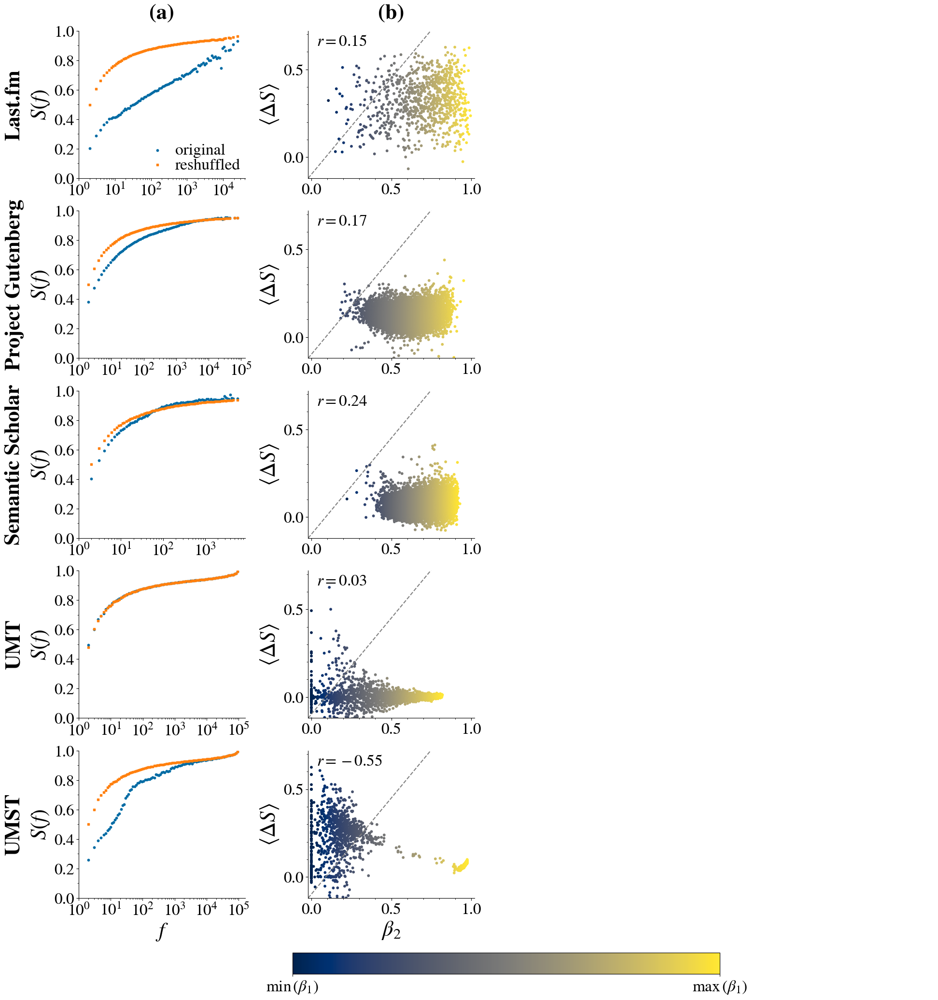

In [520]:
fig = fig_4(data_with_entropy, marker_size = 10, alpha_scatter = 1, 
          min_x = 0,
          max_x = 1,
          min_y = -0.1,
          max_y = 0.7,
          x_correlation_text = .05,
          y_correlation_text = .9,
          use_same_x_y_max_lim = False,
         )
fig.savefig(os.path.join(figures_folder, f"Fig4_entropy.png"))
fig.savefig(os.path.join(figures_folder, f"Fig4_entropy_low_res.pdf"),dpi=100)
fig.savefig(os.path.join(figures_folder, f"Fig4_entropy.pdf"))

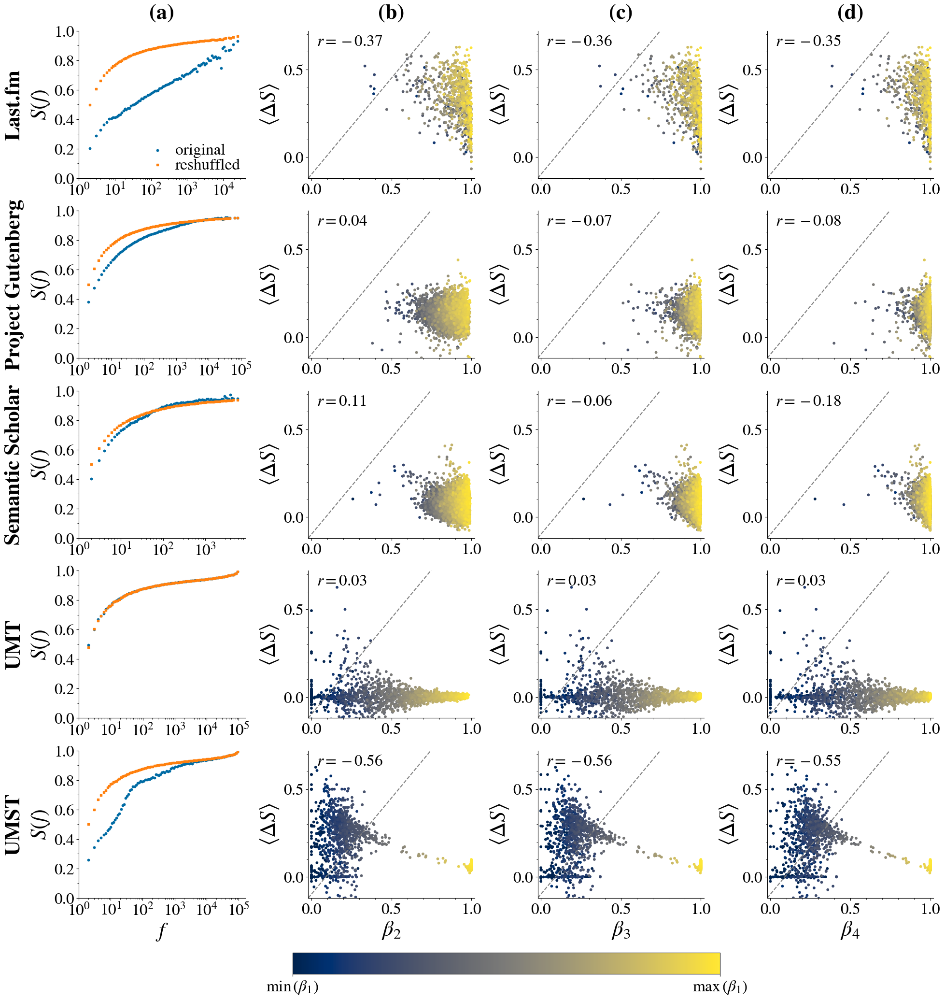

In [458]:
fig = fig_4(data_with_entropy, marker_size = 10, alpha_scatter = 1, 
          min_x = 0,
          max_x = 1,
          min_y = -0.1,
          max_y = 0.7,
          x_correlation_text = .05,
          y_correlation_text = .9,
          use_same_x_y_max_lim = False,
         )
fig.savefig(os.path.join(figures_folder, f"Fig4_entropy.png"))
fig.savefig(os.path.join(figures_folder, f"Fig4_entropy_low_res.pdf"),dpi=100)
fig.savefig(os.path.join(figures_folder, f"Fig4_entropy.pdf"))

### Other tries

<AxesSubplot:ylabel='$S(f)$'>

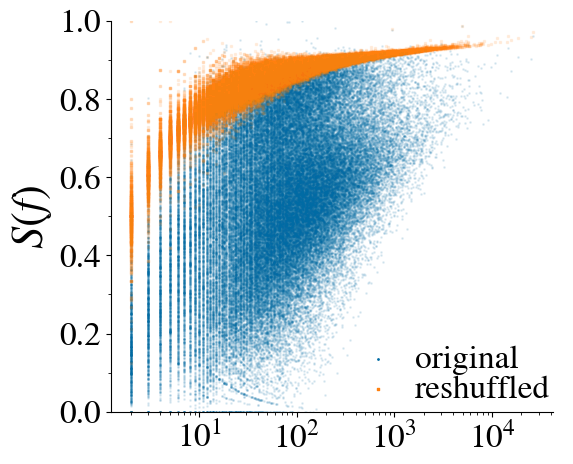

In [302]:
fig,ax = plt.subplots(figsize=(width_fig/4,width_fig*2/3*1/3))
fig_4_subplot_a(data_with_entropy['Last.fm'], 
                    ax = ax, marker_size = 1, alpha = 0.1, 
                    dataset_label = None, 
                    number_to_write = 0, 
                    xlim_left = None, xlim_right = None, 
                    ylim_bottom = 0, ylim_top = 1, 
                    ylabel = r"$S(f)$", xlabel = None, 
                    write_number = False)

<AxesSubplot:ylabel='$S(f)$'>

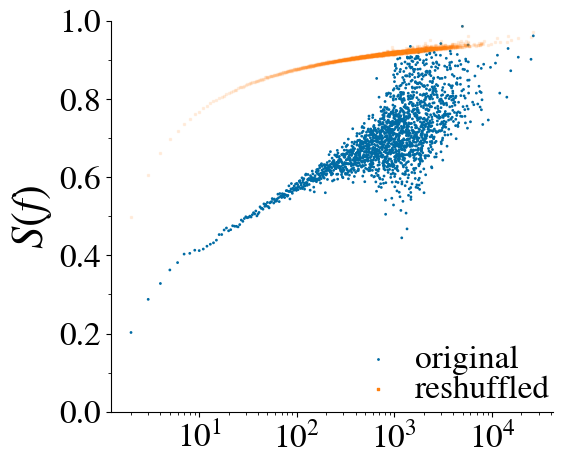

In [314]:
fig,ax = plt.subplots(figsize=(width_fig/4,width_fig*2/3*1/3))
fig_4_subplot_a(data_with_entropy['Last.fm'], 
                    ax = ax, marker_size = 1, alpha = .1, 
                    dataset_label = None, 
                    number_to_write = 0, 
                    xlim_left = None, xlim_right = None, 
                    ylim_bottom = 0, ylim_top = 1, 
                    ylabel = r"$S(f)$", xlabel = None, 
                    write_number = False)

<AxesSubplot:xlabel='$f$', ylabel='$S(f)$'>

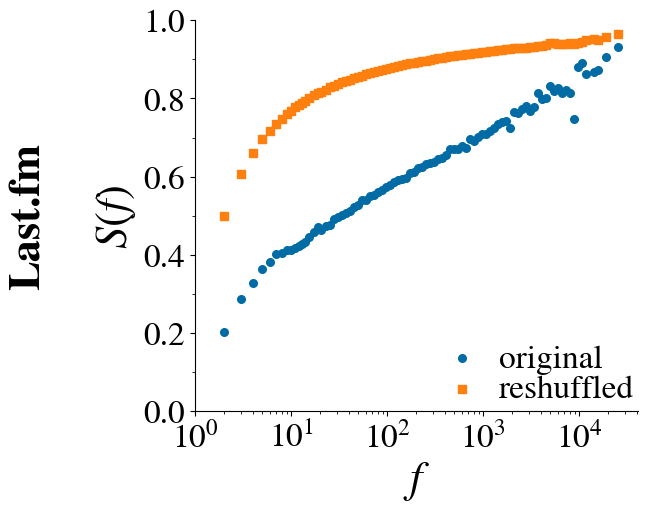

In [386]:
fig,ax = plt.subplots(figsize=(width_fig/4,width_fig*2/3*1/3))
fig_4_subplot_a(data_with_entropy['Last.fm'], 
                    ax = ax, marker_size = 30, alpha = 1, 
                    dataset_label = 'Last.fm', 
                    number_to_write = 0, 
                    write_number = False)

<AxesSubplot:xlabel='$f$', ylabel='$S(f)$'>

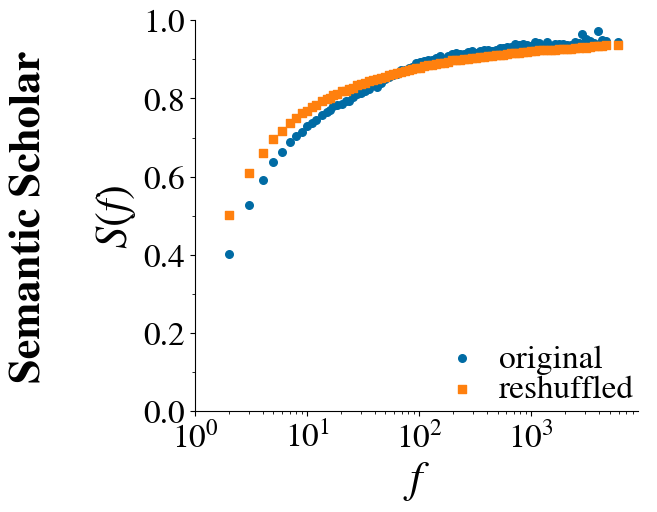

In [460]:
fig,ax = plt.subplots(figsize=(width_fig/4,width_fig*2/3*1/3))
fig_4_subplot_a(data_with_entropy['Semantic Scholar'], 
                    ax = ax, marker_size = 30, alpha = 1, 
                    dataset_label = 'Semantic Scholar', 
                    number_to_write = 0, 
                    write_number = False)

#### Semantic Scholar

In [475]:
field = 'Art'
paths = glob.glob(f"data/semanticscholar/analysis/2022-01-01/journals_fieldsOfStudy/{field}/*.pkl")

dataset['mean_entropies'] = {}
dataset['mean_entropies_glob'] = {}
count = 0
for path in tqdm(paths[500:1000]):
#     ID = path.split('/')[-1].split(".pkl")[0]
    try:
        with open(path, 'rb') as fp:
            result = pickle.load(fp)
        for freq,value in result['mean_entropies'].items():
            try:
                dataset['mean_entropies'][freq].append(value)
            except KeyError:
                dataset['mean_entropies'][freq] = [value]
        for freq,value in result['mean_entropies_glob'].items():
            try:
                dataset['mean_entropies_glob'][freq].append(value)
            except KeyError:
                dataset['mean_entropies_glob'][freq] = [value]
    except:
        pass


  0%|          | 0/500 [00:00<?, ?it/s]

<AxesSubplot:xlabel='$f$', ylabel='$S(f)$'>

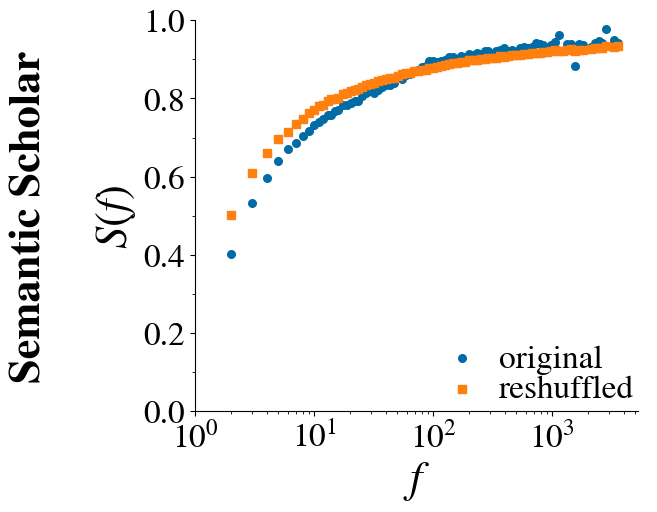

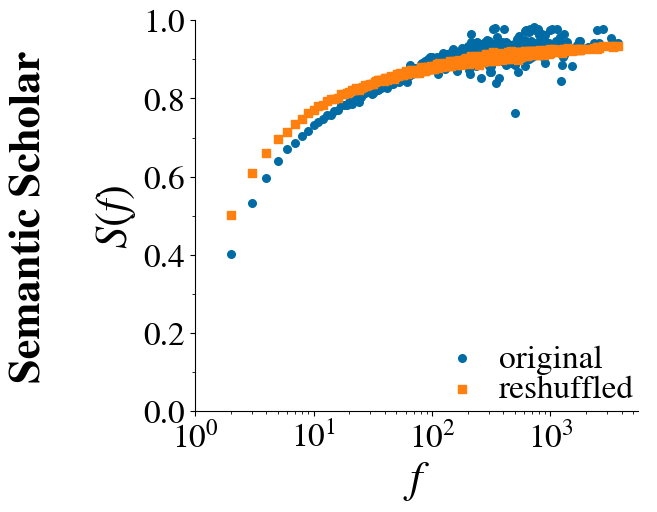

In [476]:
fig,ax = plt.subplots(figsize=(width_fig/4,width_fig*2/3*1/3))
fig_4_subplot_a(dataset, 
                    ax = ax, marker_size = 30, alpha = 1, 
                    dataset_label = 'Semantic Scholar', 
                    number_to_write = 0, 
                    write_number = False)
fig,ax = plt.subplots(figsize=(width_fig/4,width_fig*2/3*1/3))
fig_4_subplot_a_old(dataset, 
                    ax = ax, marker_size = 30, alpha = 1, 
                    dataset_label = 'Semantic Scholar', 
                    number_to_write = 0, 
                    write_number = False)

#### UMST

In [477]:
Tmax = int(1e5)
dataset['mean_entropies'] = {}
dataset['mean_entropies_glob'] = {}
count = 0
for eta in [.1]:
    for rho in [4]:
        for nu in tqdm(range(10,11)):
            workdir = f"./data/simulations/rho_{rho:.5f}/nu_{nu}/Tmax_{Tmax}/eta_{eta:.5f}/"
            for run in range(100):
                try:
                    with open(f"{workdir}UMT_run_{run}.pkl", 'rb') as fp:
                        result = pickle.load(fp)
                    for freq,value in result['mean_entropies'].items():
                        try:
                            dataset['mean_entropies'][freq].append(value)
                        except KeyError:
                            dataset['mean_entropies'][freq] = [value]
                    for freq,value in result['mean_entropies_glob'].items():
                        try:
                            dataset['mean_entropies_glob'][freq].append(value)
                        except KeyError:
                            dataset['mean_entropies_glob'][freq] = [value]
                    count += 1
                except:
                    pass
print(f"Found {count} simulations")

  0%|          | 0/1 [00:00<?, ?it/s]

Found 100 simulations


<AxesSubplot:xlabel='$f$', ylabel='$S(f)$'>

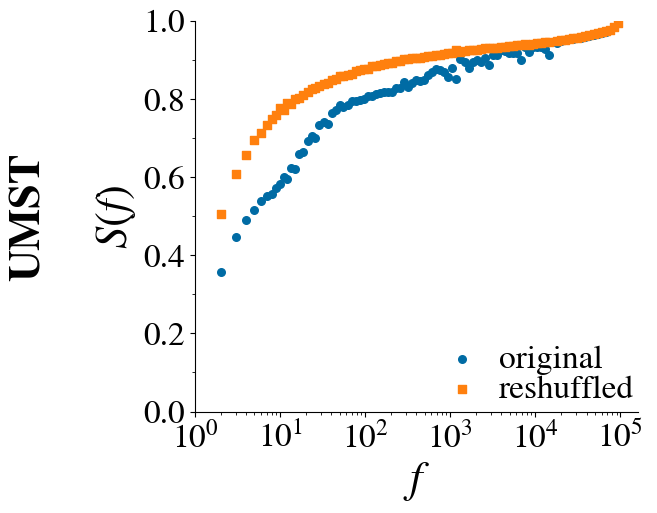

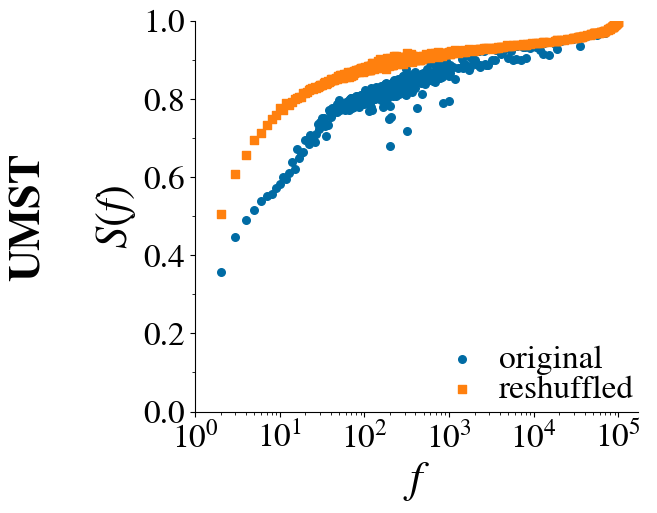

In [478]:
fig,ax = plt.subplots(figsize=(width_fig/4,width_fig*2/3*1/3))
fig_4_subplot_a(dataset, 
                    ax = ax, marker_size = 30, alpha = 1, 
                    dataset_label = 'UMST', 
                    number_to_write = 0, 
                    write_number = False)
fig,ax = plt.subplots(figsize=(width_fig/4,width_fig*2/3*1/3))
fig_4_subplot_a_old(dataset, 
                    ax = ax, marker_size = 30, alpha = 1, 
                    dataset_label = 'UMST', 
                    number_to_write = 0, 
                    write_number = False)

  0%|          | 0/10 [00:00<?, ?it/s]

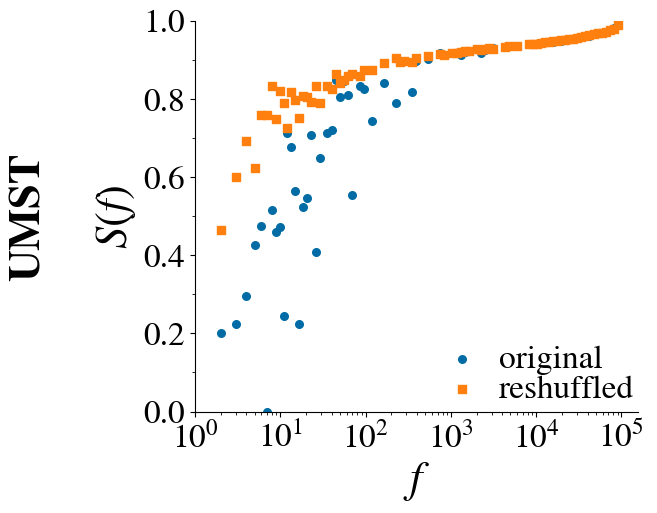

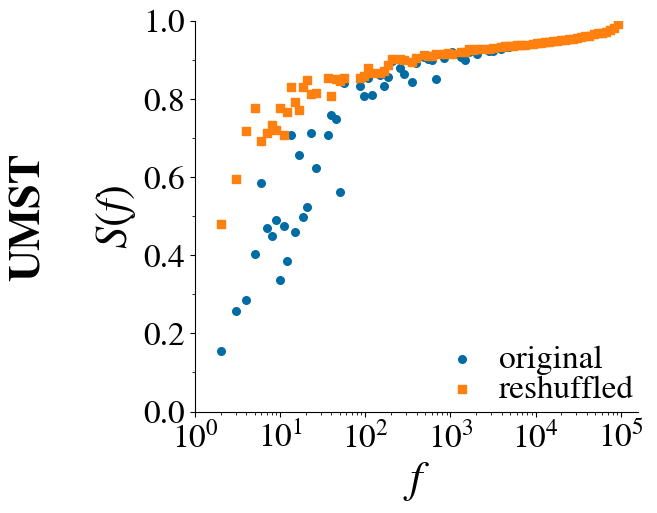

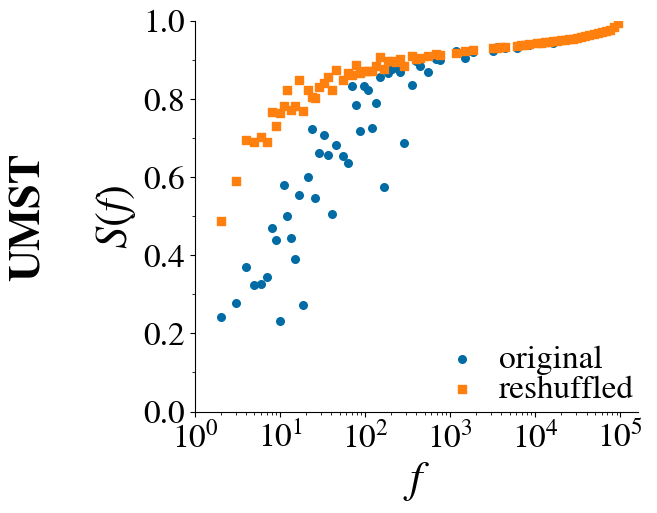

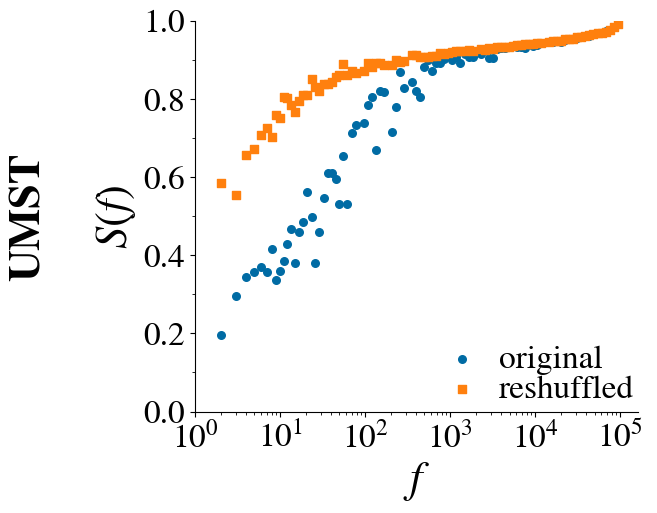

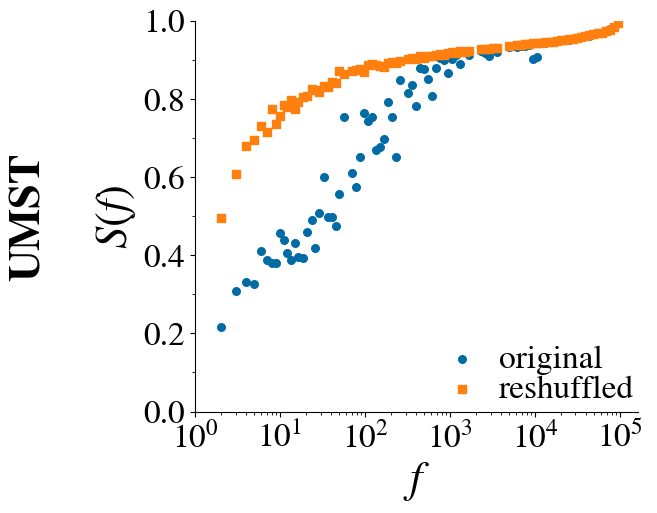

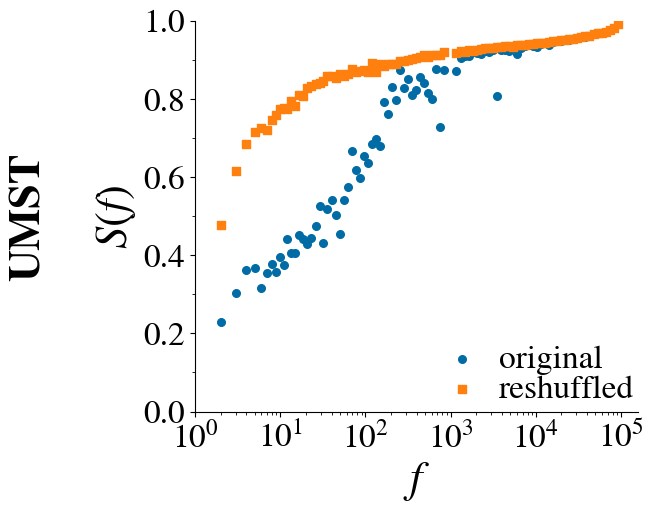

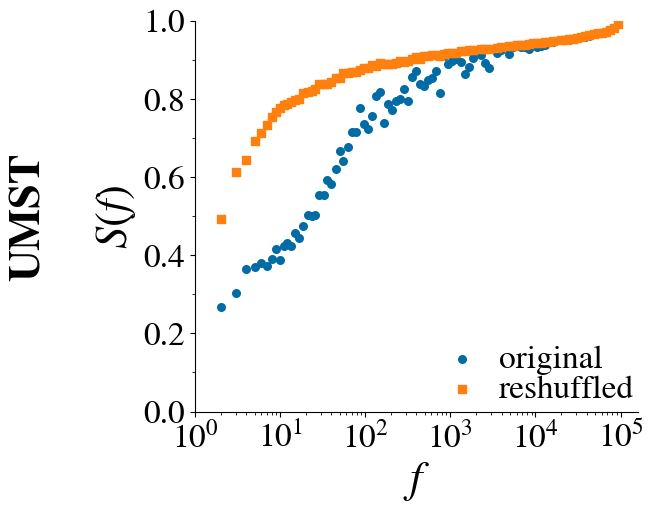

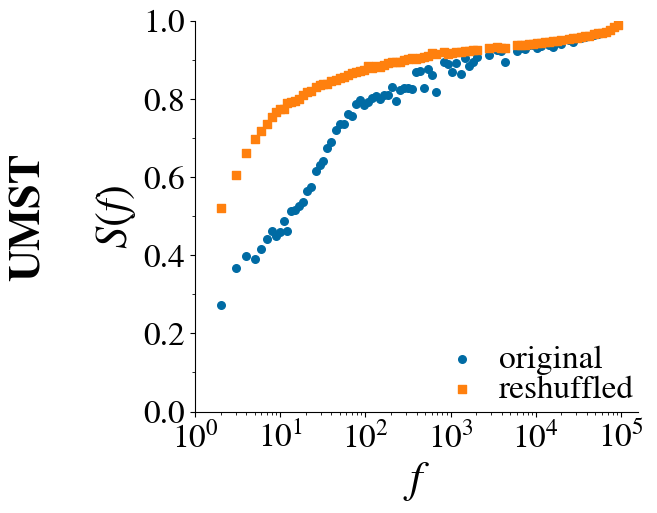

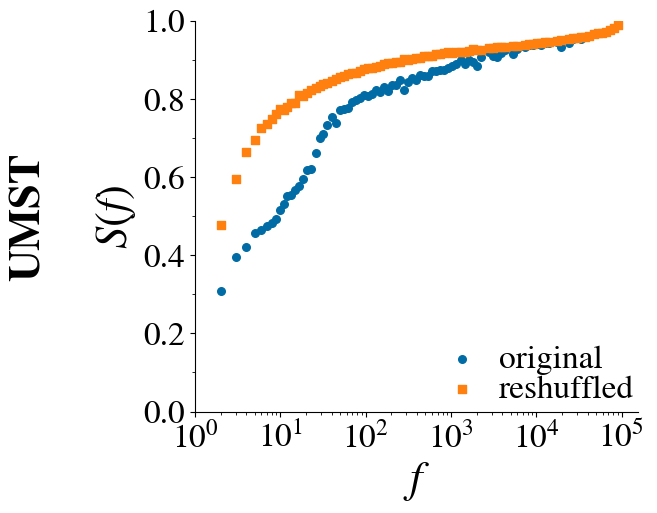

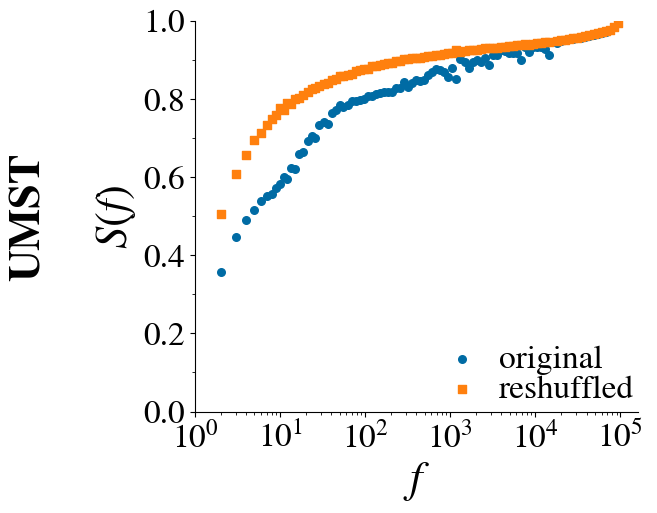

In [480]:
Tmax = int(1e5)
for eta in [.1]:
    for rho in [4]:
        for nu in tqdm(range(1,11)):
            dataset['mean_entropies'] = {}
            dataset['mean_entropies_glob'] = {}
            count = 0
            workdir = f"./data/simulations/rho_{rho:.5f}/nu_{nu}/Tmax_{Tmax}/eta_{eta:.5f}/"
            for run in range(100):
                try:
                    with open(f"{workdir}UMT_run_{run}.pkl", 'rb') as fp:
                        result = pickle.load(fp)
                    for freq,value in result['mean_entropies'].items():
                        try:
                            dataset['mean_entropies'][freq].append(value)
                        except KeyError:
                            dataset['mean_entropies'][freq] = [value]
                    for freq,value in result['mean_entropies_glob'].items():
                        try:
                            dataset['mean_entropies_glob'][freq].append(value)
                        except KeyError:
                            dataset['mean_entropies_glob'][freq] = [value]
                    count += 1
                except:
                    pass
            
            fig,ax = plt.subplots(figsize=(width_fig/4,width_fig*2/3*1/3))
            fig_4_subplot_a(dataset, 
                                ax = ax, marker_size = 30, alpha = 1, 
                                dataset_label = 'UMST', 
                                number_to_write = 0, 
                                write_number = False)

# OLD Figure4: Entropy vs $\beta_1$

## Load data with entropy

In [ ]:
with gzip.open('./data/essential_entropy_data_for_figure4.pkl.gz', "rb") as fp:
    data_with_entropy = joblib.load(fp)

## Create data with entropy

Use this section only on the first run. Otherwise, just load the prepared data on the previous section

In [802]:
data_with_entropy = {}
data_with_entropy['Last.fm'] = {}
data_with_entropy['Project Gutenberg'] = {}
data_with_entropy['Semantic Scholar'] = {}
data_with_entropy['UMST'] = {}

### Last.fm

In [803]:
data_folder = "./data/ocelma-dataset/lastfm-dataset-1K/"
analysis_folder = data_folder

dataset = {}

paths = glob.glob(os.path.join(analysis_folder, 'individual_results_entropy','*.pkl'))

dataset['mean_entropies'] = {}
dataset['mean_entropies_glob'] = {}
dataset['mean_entropies_pairs'] = {}
dataset['mean_entropies_glob_pairs'] = {}
dataset['weighted_diff_entropies'] = []
dataset['weighted_diff_entropies_pairs'] = []
for n_order, order in enumerate(['','2','3','4'], start=1):
    dataset[f'betas{order}'] = []
    dataset[f'intercepts{order}'] = []
count = 0
for path in tqdm(paths):
    try:
        file_name = path[-path[::-1].index('/'):path.index('.pkl')]
        with open(path, 'rb') as fp:
            entropy_result = joblib.load(fp)
        with open(os.path.join(analysis_folder, 'individual_results_light',f'{file_name}_light.pkl'), 'rb') as fp:
            result = joblib.load(fp)
        for i_order,order in enumerate(['', '_pairs']):
            n_order = i_order + 1
            for freq,value in entropy_result[f'mean_entropies{order}'].items():
                try:
                    dataset[f'mean_entropies{order}'][freq].append(value)
                except KeyError:
                    dataset[f'mean_entropies{order}'][freq] = [value]
            for freq,value in entropy_result[f'mean_entropies_glob{order}'].items():
                try:
                    dataset[f'mean_entropies_glob{order}'][freq].append(value)
                except KeyError:
                    dataset[f'mean_entropies_glob{order}'][freq] = [value]
        dataset['weighted_diff_entropies'].append(entropy_result['weighted_diff_entropies'])
        dataset['weighted_diff_entropies_pairs'].append(entropy_result['weighted_diff_entropies_pairs'])
        # Add also information on beta
        for n_order, order in enumerate(['','2','3','4'], start=1):
            dataset[f'betas{order}'].append(result[f'beta{order}_loglogregr_indices_geom'][-1])
            dataset[f'intercepts{order}'].append(result[f'intercept{order}_loglogregr_indices_geom'][-1])
        # Add correct entropy difference to light result
        result['weighted_diff_entropies'] = entropy_result['weighted_diff_entropies']
        result['weighted_diff_entropies_pairs'] = entropy_result['weighted_diff_entropies_pairs']
        with open(os.path.join(analysis_folder, 'individual_results_light',f'{file_name}_light.pkl'), 'wb') as fp:
            pickle.dump(result,fp)
        count += 1
    except:
        pass
print(count)
data_with_entropy['Last.fm'] = dataset.copy()

  0%|          | 0/890 [00:00<?, ?it/s]

890


### Gutenberg

In [804]:
data_folder = './data/gutenberg/sequences_indexed/'
analysis_folder = './data/gutenberg/analysis/'

dataset = {}

paths = glob.glob(os.path.join(analysis_folder, 'individual_results_entropy','*.pkl'))

dataset['mean_entropies'] = {}
dataset['mean_entropies_glob'] = {}
dataset['mean_entropies_pairs'] = {}
dataset['mean_entropies_glob_pairs'] = {}
dataset['weighted_diff_entropies'] = []
dataset['weighted_diff_entropies_pairs'] = []
for n_order, order in enumerate(['','2','3','4'], start=1):
    dataset[f'betas{order}'] = []
    dataset[f'intercepts{order}'] = []
count = 0
for path in tqdm(paths):
#     try:
        file_name = path[-path[::-1].index('/'):path.index('.pkl')]
        with open(path, 'rb') as fp:
            entropy_result = joblib.load(fp)
#         with open(os.path.join(analysis_folder, 'individual_results_light',f'{file_name}_light.pkl'), 'rb') as fp:
#             result = joblib.load(fp)
        result = results_light_individual_gutenberg[file_name]
        for i_order,order in enumerate(['', '_pairs']):
            n_order = i_order + 1
            for freq,value in entropy_result[f'mean_entropies{order}'].items():
                try:
                    dataset[f'mean_entropies{order}'][freq].append(value)
                except KeyError:
                    dataset[f'mean_entropies{order}'][freq] = [value]
            for freq,value in entropy_result[f'mean_entropies_glob{order}'].items():
                try:
                    dataset[f'mean_entropies_glob{order}'][freq].append(value)
                except KeyError:
                    dataset[f'mean_entropies_glob{order}'][freq] = [value]
        dataset['weighted_diff_entropies'].append(entropy_result['weighted_diff_entropies'])
        dataset['weighted_diff_entropies_pairs'].append(entropy_result['weighted_diff_entropies_pairs'])
        # Add also information on beta
        for n_order, order in enumerate(['','2','3','4'], start=1):
            dataset[f'betas{order}'].append(result[f'beta{order}_loglogregr_indices_geom'][-1])
            dataset[f'intercepts{order}'].append(result[f'intercept{order}_loglogregr_indices_geom'][-1])
        # Add correct entropy difference to light result
        result['weighted_diff_entropies'] = entropy_result['weighted_diff_entropies']
        result['weighted_diff_entropies_pairs'] = entropy_result['weighted_diff_entropies_pairs']
        with open(os.path.join(analysis_folder, 'individual_results_light',f'{file_name}_light.pkl'), 'wb') as fp:
            pickle.dump(result,fp)
        count += 1
#     except:
#         pass
print(count)
data_with_entropy['Project Gutenberg'] = dataset.copy()

  0%|          | 0/19637 [00:00<?, ?it/s]

19637


### Semantic Scholar

In [862]:
corpus_version = '2022-01-01'
data_folder = os.path.join('./data/semanticscholar',corpus_version, 'data')
analysis_folder = os.path.join('./data/semanticscholar',corpus_version, 'analysis')
with open(os.path.join(data_folder,'all_fieldsOfStudy.tsv'), 'r', newline='\n') as fp:
    tsv_output = csv.reader(fp, delimiter='\n')
    all_fieldsOfStudy = [] 
    for _ in tsv_output:
        all_fieldsOfStudy.append(_[0])

dataset = {}
dataset['mean_entropies'] = {}
dataset['mean_entropies_glob'] = {}
dataset['mean_entropies_pairs'] = {}
dataset['mean_entropies_glob_pairs'] = {}
dataset['weighted_diff_entropies'] = []
dataset['weighted_diff_entropies_pairs'] = []
for n_order, order in enumerate(['','2','3','4'], start=1):
    dataset[f'betas{order}'] = []
    dataset[f'intercepts{order}'] = []
count = 0

num_journals = 1000
for fieldOfStudy in tqdm(all_fieldsOfStudy):
    paths = sorted(find_pattern('*.pkl', os.path.join(analysis_folder, 'journals_fieldsOfStudy_entropy',fieldOfStudy)))
    if len(paths) != num_journals:
        print(f'Error! Found {len(paths)} journals for {fieldOfStudy} instead of {num_journals}')
#         break

    for path in tqdm(paths):
        try:
            file_name = path[-path[::-1].index('/'):path.index('.pkl')]
            with open(path, 'rb') as fp:
                entropy_result = joblib.load(fp)
            try:
                os.rename(os.path.join(analysis_folder, 'journals_fieldsOfStudy_light', fieldOfStudy,f'{file_name}.pkl'), os.path.join(analysis_folder, 'journals_fieldsOfStudy_light', fieldOfStudy,f'{file_name}_light.pkl'))
            except:
                pass
            with open(os.path.join(analysis_folder, 'journals_fieldsOfStudy_light', fieldOfStudy,f'{file_name}_light.pkl'), 'rb') as fp:
                result = joblib.load(fp)
            for i_order,order in enumerate(['', '_pairs']):
                n_order = i_order + 1
                for freq,value in entropy_result[f'mean_entropies{order}'].items():
                    try:
                        dataset[f'mean_entropies{order}'][freq].append(value)
                    except KeyError:
                        dataset[f'mean_entropies{order}'][freq] = [value]
                for freq,value in entropy_result[f'mean_entropies_glob{order}'].items():
                    try:
                        dataset[f'mean_entropies_glob{order}'][freq].append(value)
                    except KeyError:
                        dataset[f'mean_entropies_glob{order}'][freq] = [value]
            dataset['weighted_diff_entropies'].append(entropy_result['weighted_diff_entropies'])
            dataset['weighted_diff_entropies_pairs'].append(entropy_result['weighted_diff_entropies_pairs'])
            # Add also information on beta
            for n_order, order in enumerate(['','2','3','4'], start=1):
                dataset[f'betas{order}'].append(result[f'beta{order}_loglogregr_indices_geom'][-1])
                dataset[f'intercepts{order}'].append(result[f'intercept{order}_loglogregr_indices_geom'][-1])
            # Add correct entropy difference to light result
            result['weighted_diff_entropies'] = entropy_result['weighted_diff_entropies']
            result['weighted_diff_entropies_pairs'] = entropy_result['weighted_diff_entropies_pairs']
            with open(os.path.join(analysis_folder, 'journals_fieldsOfStudy_light', fieldOfStudy, f'{file_name}_light.pkl'), 'wb') as fp:
                pickle.dump(result,fp)
            count += 1
        except:
            pass
print(count)
data_with_entropy['Semantic Scholar'] = dataset.copy()

  0%|          | 0/19 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

19000


### UMST

In [863]:
Tmax = int(1e5)
eta = .1
rho = 4
starting_nu = 1
ending_nu = 20


dataset = {}
dataset['mean_entropies'] = {}
dataset['mean_entropies_glob'] = {}
dataset['mean_entropies_pairs'] = {}
dataset['mean_entropies_glob_pairs'] = {}
dataset['weighted_diff_entropies'] = []
dataset['weighted_diff_entropies_pairs'] = []
for n_order, order in enumerate(['','2','3','4'], start=1):
    dataset[f'betas{order}'] = []
    dataset[f'intercepts{order}'] = []
count = 0

num_runs = 100
for nu in tqdm(range(starting_nu, ending_nu+1)):
    data_folder = f"./data/simulations/rho_{rho:.5f}/nu_{nu}/Tmax_{Tmax}/eta_{eta:.5f}/"
    analysis_folder = data_folder
    for run in range(num_runs):
        path = os.path.join(analysis_folder,f'UMT_entropy_run_{run}.pkl')
        try:
            with open(path, 'rb') as fp:
                entropy_result = joblib.load(fp)
            with open(os.path.join(analysis_folder,f'UMT_light_run_{run}.pkl'), 'rb') as fp:
                result = joblib.load(fp)
            for i_order,order in enumerate(['', '_pairs']):
                n_order = i_order + 1
                for freq,value in entropy_result[f'mean_entropies{order}'].items():
                    try:
                        dataset[f'mean_entropies{order}'][freq].append(value)
                    except KeyError:
                        dataset[f'mean_entropies{order}'][freq] = [value]
                for freq,value in entropy_result[f'mean_entropies_glob{order}'].items():
                    try:
                        dataset[f'mean_entropies_glob{order}'][freq].append(value)
                    except KeyError:
                        dataset[f'mean_entropies_glob{order}'][freq] = [value]
            dataset['weighted_diff_entropies'].append(entropy_result['weighted_diff_entropies'])
            dataset['weighted_diff_entropies_pairs'].append(entropy_result['weighted_diff_entropies_pairs'])
            # Add also information on beta
            for n_order, order in enumerate(['','2','3','4'], start=1):
                dataset[f'betas{order}'].append(result[f'beta{order}_loglogregr_indices_geom'][-1])
                dataset[f'intercepts{order}'].append(result[f'intercept{order}_loglogregr_indices_geom'][-1])
            # Add correct entropy difference to light result
#             result['weighted_diff_entropies'] = entropy_result['weighted_diff_entropies']
#             result['weighted_diff_entropies_pairs'] = entropy_result['weighted_diff_entropies_pairs']
#             with open(os.path.join(analysis_folder,f'UMT_light_run_{run}.pkl'), 'wb') as fp:
#                 pickle.dump(result,fp)
            count += 1
        except:
            pass
print(count)
data_with_entropy['UMST'] = dataset.copy()

  0%|          | 0/20 [00:00<?, ?it/s]

2000


  0%|          | 0/20 [00:00<?, ?it/s]

100


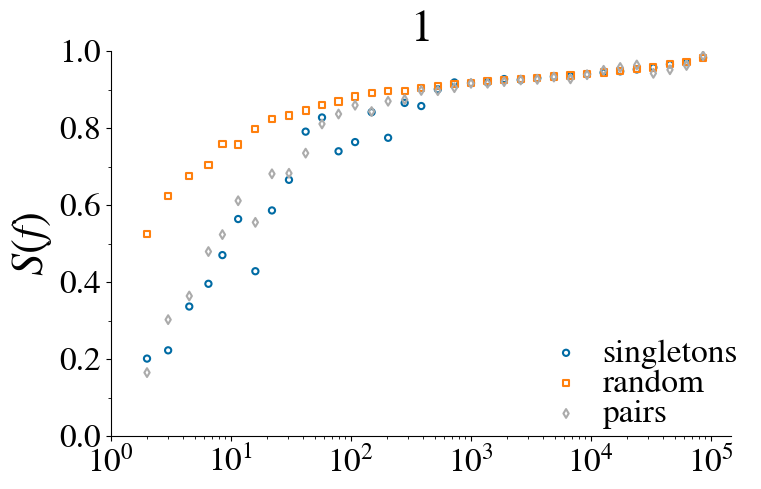

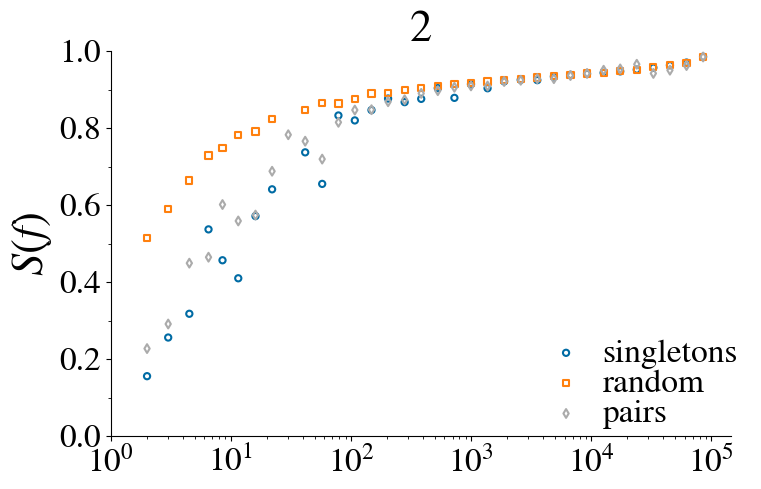

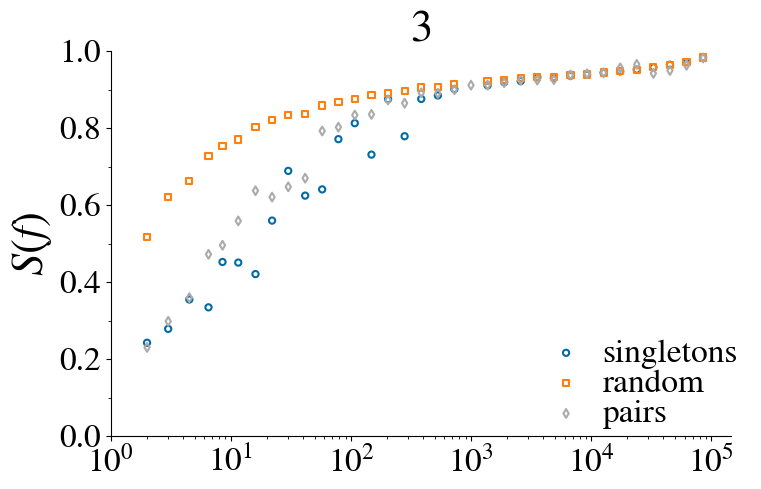

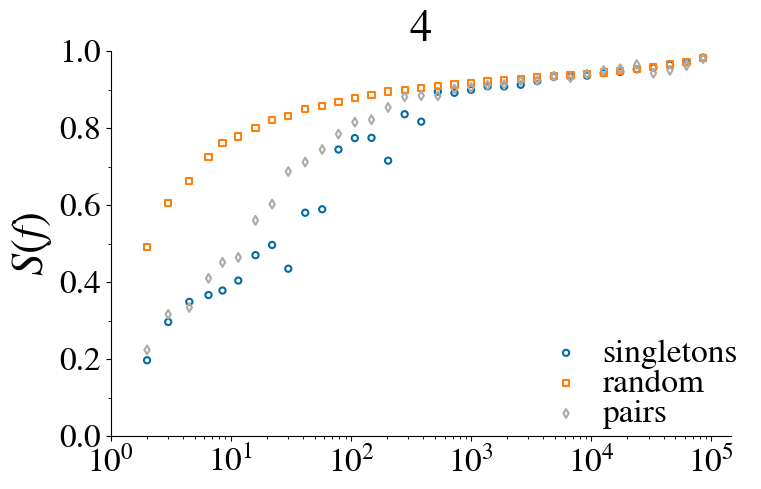

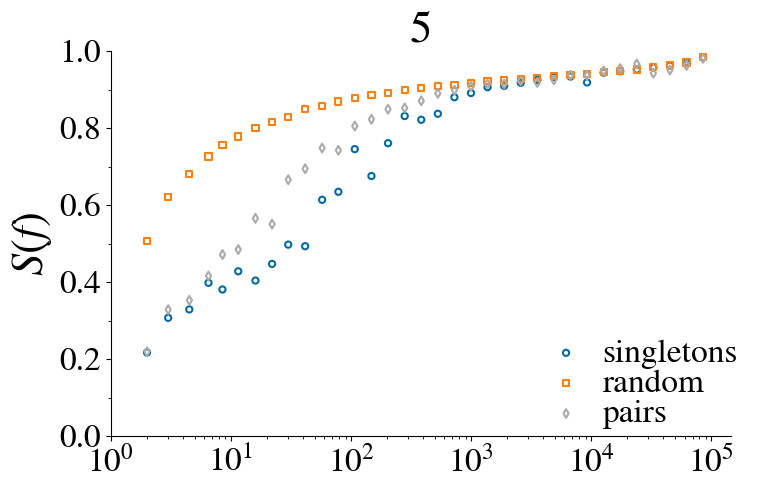

...

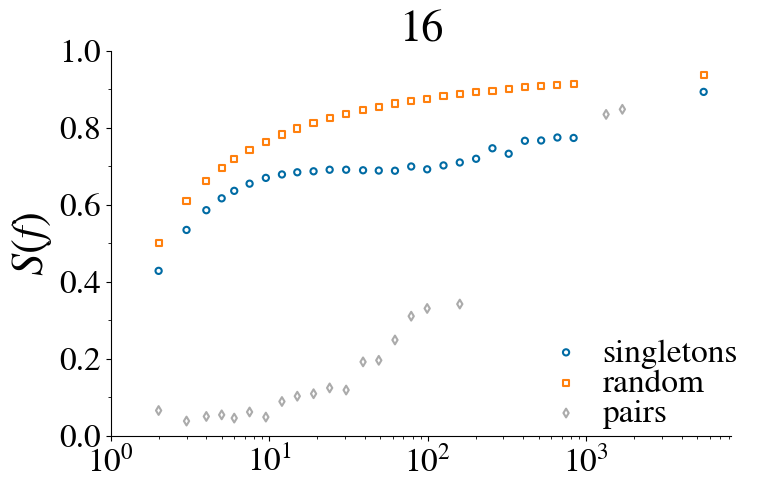

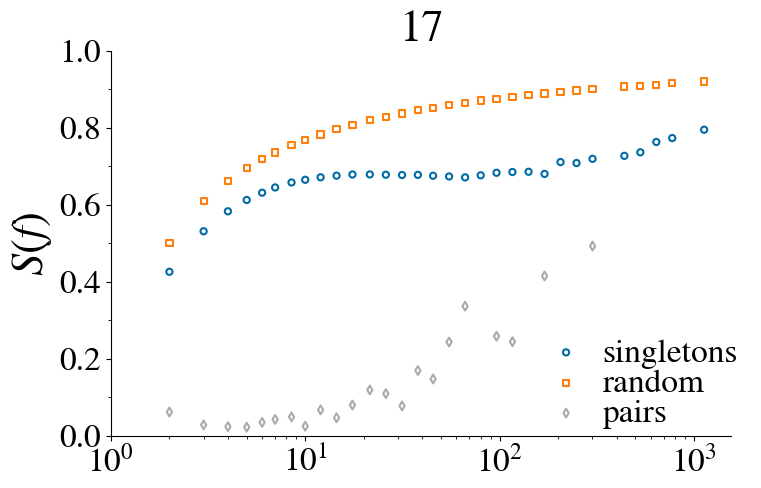

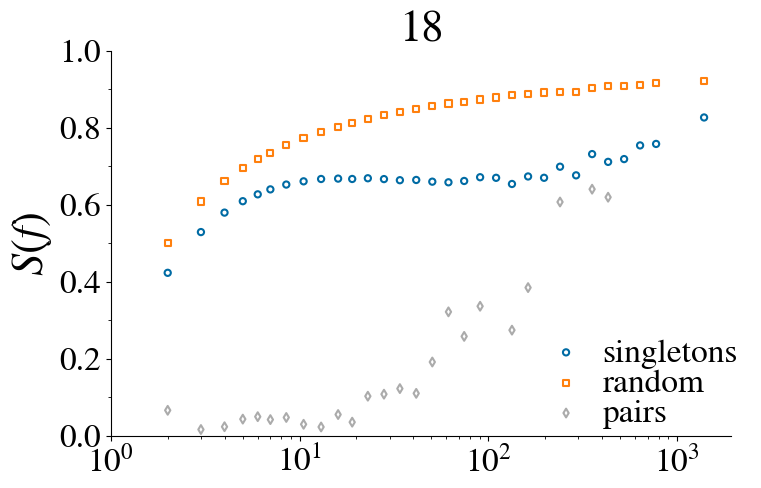

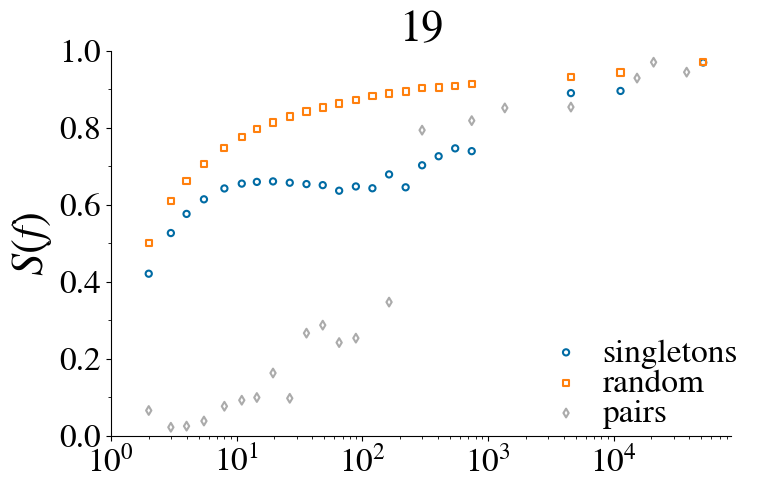

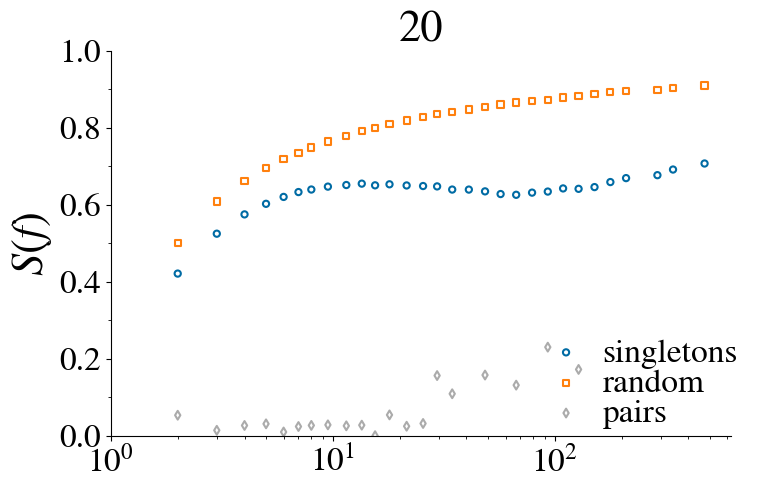

In [857]:
Tmax = int(1e5)
eta = .1
rho = 4
starting_nu = 1
ending_nu = 20



num_runs = 100
for nu in tqdm(range(starting_nu, ending_nu+1)):
    fig,ax = plt.subplots(figsize=(8,5))
    dataset = {}
    dataset['mean_entropies'] = {}
    dataset['mean_entropies_glob'] = {}
    dataset['mean_entropies_pairs'] = {}
    dataset['mean_entropies_glob_pairs'] = {}
    dataset['weighted_diff_entropies'] = []
    dataset['weighted_diff_entropies_pairs'] = []
    for n_order, order in enumerate(['','2','3','4'], start=1):
        dataset[f'betas{order}'] = []
        dataset[f'intercepts{order}'] = []
    count = 0

    data_folder = f"./data/simulations/rho_{rho:.5f}/nu_{nu}/Tmax_{Tmax}/eta_{eta:.5f}/"
    analysis_folder = data_folder
    for run in range(num_runs):
        path = os.path.join(analysis_folder,f'UMT_entropy_run_{run}.pkl')
        try:
            with open(path, 'rb') as fp:
                entropy_result = joblib.load(fp)
            with open(os.path.join(analysis_folder,f'UMT_light_run_{run}.pkl'), 'rb') as fp:
                result = joblib.load(fp)
            for i_order,order in enumerate(['', '_pairs']):
                n_order = i_order + 1
                for freq,value in entropy_result[f'mean_entropies{order}'].items():
                    try:
                        dataset[f'mean_entropies{order}'][freq].append(value)
                    except KeyError:
                        dataset[f'mean_entropies{order}'][freq] = [value]
                for freq,value in entropy_result[f'mean_entropies_glob{order}'].items():
                    try:
                        dataset[f'mean_entropies_glob{order}'][freq].append(value)
                    except KeyError:
                        dataset[f'mean_entropies_glob{order}'][freq] = [value]
            dataset['weighted_diff_entropies'].append(entropy_result['weighted_diff_entropies'])
            dataset['weighted_diff_entropies_pairs'].append(entropy_result['weighted_diff_entropies_pairs'])
            # Add also information on beta
            for n_order, order in enumerate(['','2','3','4'], start=1):
                dataset[f'betas{order}'].append(result[f'beta{order}_loglogregr_indices_geom'][-1])
                dataset[f'intercepts{order}'].append(result[f'intercept{order}_loglogregr_indices_geom'][-1])
            # Add correct entropy difference to light result
#             result['weighted_diff_entropies'] = entropy_result['weighted_diff_entropies']
#             result['weighted_diff_entropies_pairs'] = entropy_result['weighted_diff_entropies_pairs']
#             with open(os.path.join(analysis_folder,f'UMT_light_run_{run}.pkl'), 'wb') as fp:
#                 pickle.dump(result,fp)
            count += 1
        except:
            pass
    fig_4_subplot_a(dataset, 
                        ax = ax, dataset_label = None,
                        marker_size = 20, alpha = 1, 
                        number_to_write = 0, 
                        xlim_left = 1, xlim_right = None, 
                        ylim_bottom = 0, ylim_top = 1, 
                        ylabel = r"$S(f)$", xlabel = None, write_number = False,
                       )
    ax.set_title(nu)
print(count)
# data_with_entropy['UMST'] = dataset.copy()

### LOAD ERRW

In [1015]:
ERRW_data = {}

In [1016]:
field = "astro"
dw = 330
with open(f"./data/ERRW/web_of_science/{field}_abs2_net_dw{dw}_seqs.p", "rb") as fp:
    ERRW_data[(field, dw)] = pickle.load(fp, encoding='latin1')

In [1017]:
field = "mat"
dw = 20
with open(f"./data/ERRW/web_of_science/{field}_abs2_net_dw{dw}_seqs.p", "rb") as fp:
    ERRW_data[(field, dw)] = pickle.load(fp, encoding='latin1')

In [1021]:
[len(value) for value in ERRW_data.values()]

[30, 35]

In [1028]:
ERRW_betas = {key:[np.log10(len(set(_)))/np.log10(len(_)) for _ in value] for key,value in ERRW_data.items()}

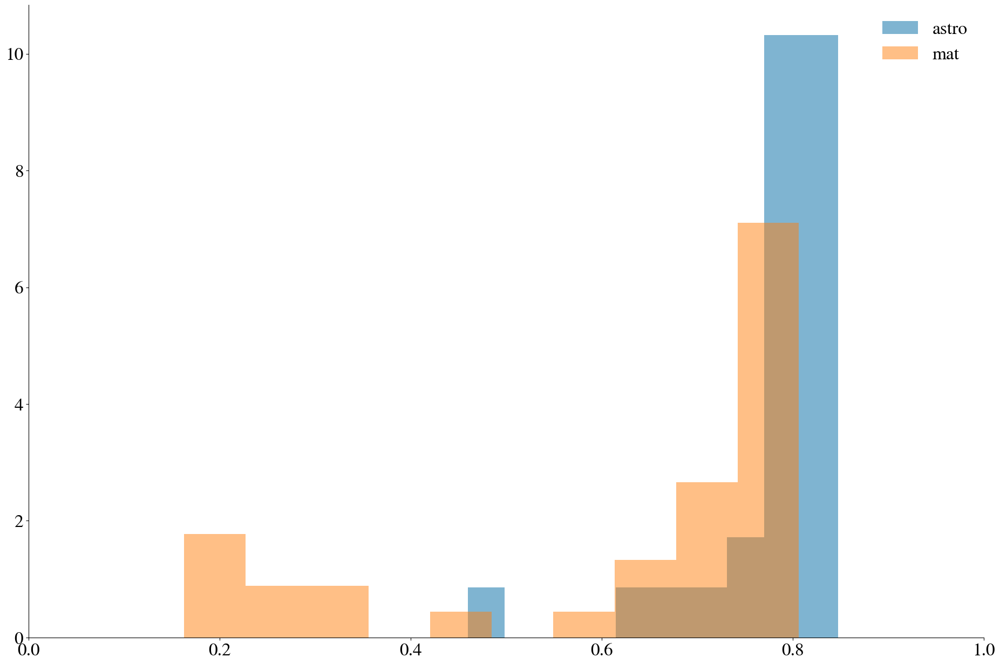

In [1031]:
for key,betas in ERRW_betas.items():
    plt.hist(betas,density=True,label = key, alpha=0.5)
    plt.xlim(0,1)
    plt.legend()

### Tries on UMST diff eta

In [872]:
UMST_data_with_entropy = {}

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

0.1	10	199


  0%|          | 0/20 [00:00<?, ?it/s]

0.2	10	196


  0%|          | 0/20 [00:00<?, ?it/s]

0.30000000000000004	10	189


  0%|          | 0/20 [00:00<?, ?it/s]

0.4	10	191


  0%|          | 0/20 [00:00<?, ?it/s]

0.5	10	195


  0%|          | 0/20 [00:00<?, ?it/s]

0.6	10	193


  0%|          | 0/20 [00:00<?, ?it/s]

0.7000000000000001	10	194


  0%|          | 0/20 [00:00<?, ?it/s]

0.8	10	187


  0%|          | 0/20 [00:00<?, ?it/s]

0.9	10	189


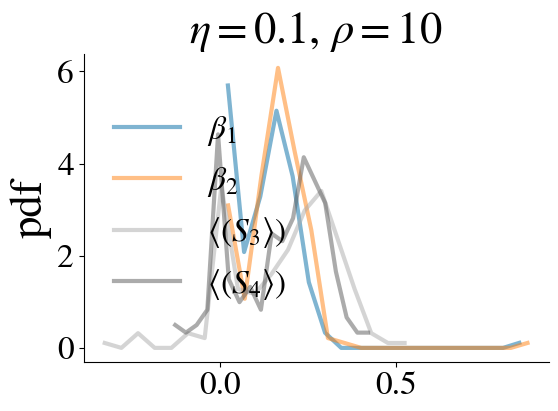

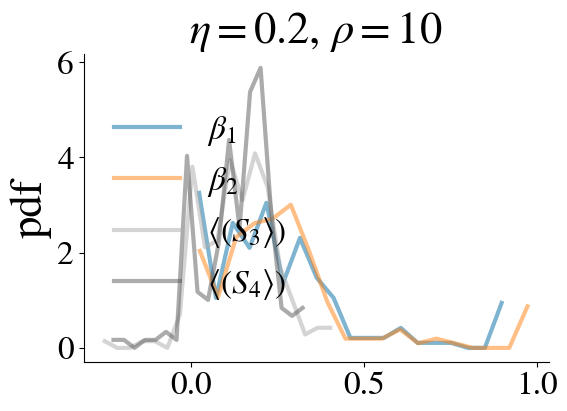

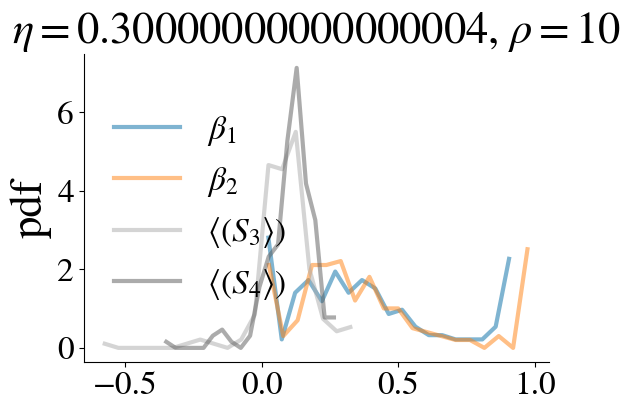

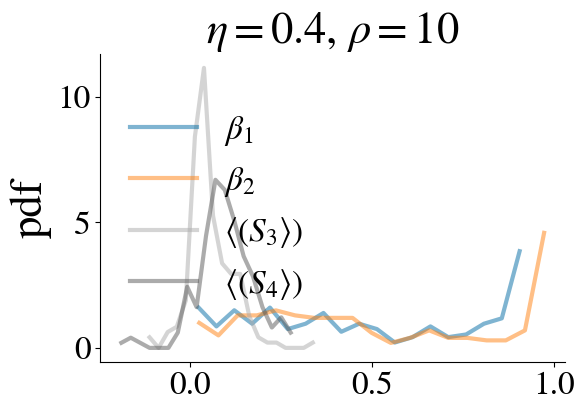

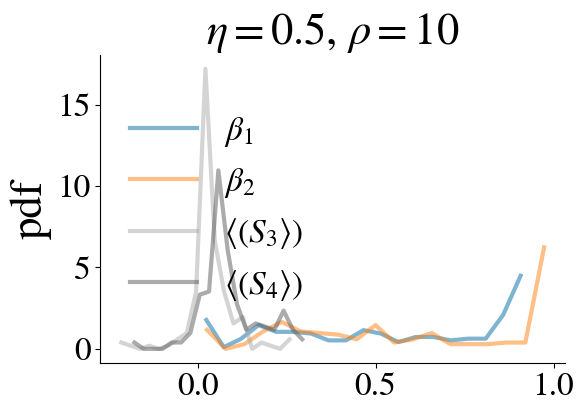

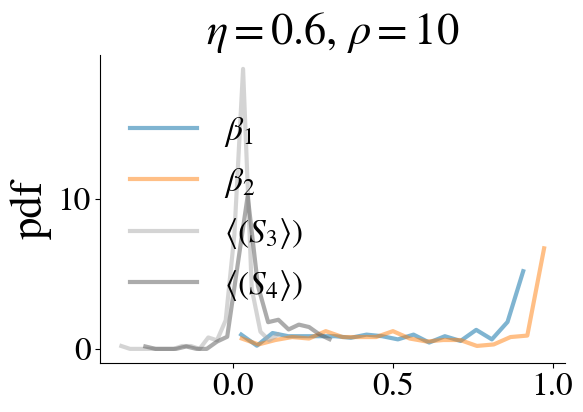

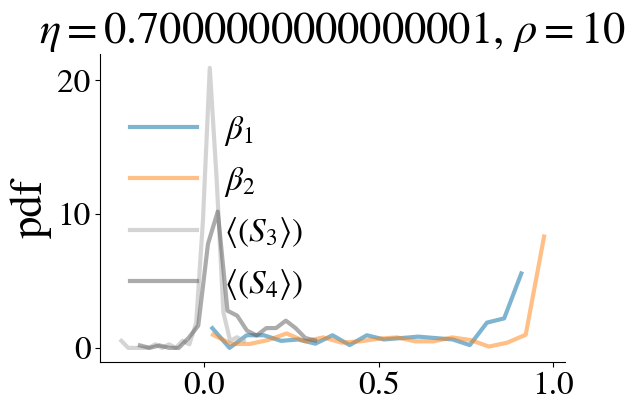

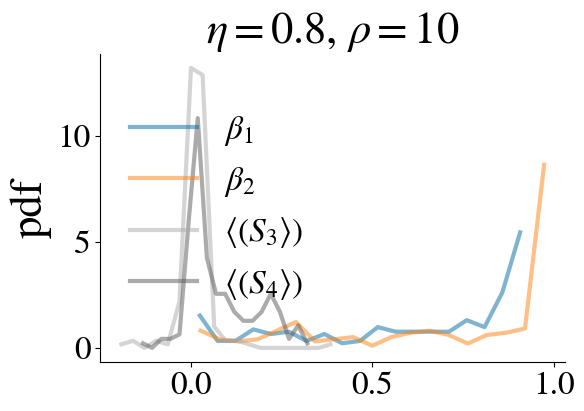

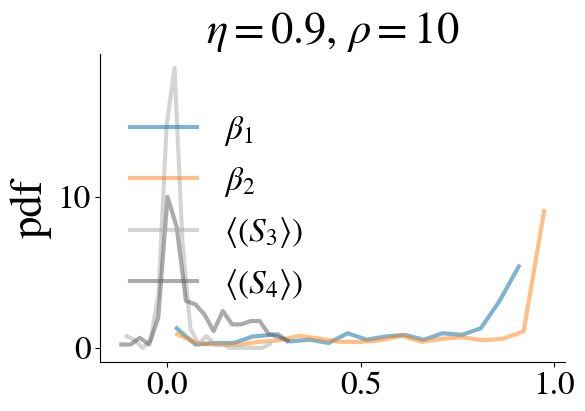

In [884]:
Tmax = int(1e5)
for eta in tqdm(np.arange(0.1,1,step=.1)):
    rho = 10
    starting_nu = 1
    ending_nu = 20


    dataset = {}
    dataset['mean_entropies'] = {}
    dataset['mean_entropies_glob'] = {}
    dataset['mean_entropies_pairs'] = {}
    dataset['mean_entropies_glob_pairs'] = {}
    dataset['weighted_diff_entropies'] = []
    dataset['weighted_diff_entropies_pairs'] = []
    for n_order, order in enumerate(['','2','3','4'], start=1):
        dataset[f'betas{order}'] = []
        dataset[f'intercepts{order}'] = []
    count = 0

    num_runs = 100
    for nu in tqdm(range(starting_nu, ending_nu+1)):
        data_folder = f"./data/simulations/rho_{rho:.5f}/nu_{nu}/Tmax_{Tmax}/eta_{eta:.5f}/"
        analysis_folder = data_folder
        for run in range(num_runs):
            path = os.path.join(analysis_folder,f'UMT_entropies_run_{run}.pkl')
            try:
                with open(path, 'rb') as fp:
                    entropy_result = joblib.load(fp)
                with open(os.path.join(analysis_folder,f'UMT_light_run_{run}.pkl'), 'rb') as fp:
                    result = joblib.load(fp)
                for i_order,order in enumerate(['', '_pairs']):
                    n_order = i_order + 1
                    for freq,value in entropy_result[f'mean_entropies{order}'].items():
                        try:
                            dataset[f'mean_entropies{order}'][freq].append(value)
                        except KeyError:
                            dataset[f'mean_entropies{order}'][freq] = [value]
                    for freq,value in entropy_result[f'mean_entropies_glob{order}'].items():
                        try:
                            dataset[f'mean_entropies_glob{order}'][freq].append(value)
                        except KeyError:
                            dataset[f'mean_entropies_glob{order}'][freq] = [value]
                dataset['weighted_diff_entropies'].append(entropy_result['weighted_diff_entropies'])
                dataset['weighted_diff_entropies_pairs'].append(entropy_result['weighted_diff_entropies_pairs'])
                # Add also information on beta
                for n_order, order in enumerate(['','2','3','4'], start=1):
                    dataset[f'betas{order}'].append(result[f'beta{order}_loglogregr_indices_geom'][-1])
                    dataset[f'intercepts{order}'].append(result[f'intercept{order}_loglogregr_indices_geom'][-1])
                # Add correct entropy difference to light result
    #             result['weighted_diff_entropies'] = entropy_result['weighted_diff_entropies']
    #             result['weighted_diff_entropies_pairs'] = entropy_result['weighted_diff_entropies_pairs']
    #             with open(os.path.join(analysis_folder,f'UMT_light_run_{run}.pkl'), 'wb') as fp:
    #                 pickle.dump(result,fp)
                count += 1
            except:
                pass
    
    if count > 0:
        fig,ax = plt.subplots(figsize=(6,4))
        num_bins = 20
        for order,key in enumerate(['betas', 'betas2', 'weighted_diff_entropies', 'weighted_diff_entropies_pairs']):
            data_to_hist = dataset[key]
            hist,bin_edges = np.histogram(data_to_hist, 
                    np.linspace(np.min(data_to_hist), np.max(data_to_hist), num_bins), 
                    density=True)
            bin_centers = (bin_edges[1:]+bin_edges[:-1])/2
            p = ax.plot(bin_centers, hist, alpha=0.5,lw=3, label = r"$\beta_%d$"%(order+1) if order<2 else r"$\langle( S_%d \rangle)$"%(order+1))
        ax.axhline(0, '--', color='gray')
        ax.legend(loc='center left')
        ax.set_ylabel('pdf')
        ax.set_title(r'$\eta = %s$, $\rho = %s$'%(str(eta), str(rho)))
        fig.add_subplot(ax)


    print(eta, rho,count, sep = "\t")
    UMST_data_with_entropy[(eta, rho)] = dataset.copy()

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

0.1	10	200


  0%|          | 0/20 [00:00<?, ?it/s]

0.2	10	200


  0%|          | 0/20 [00:00<?, ?it/s]

0.30000000000000004	10	200


  0%|          | 0/20 [00:00<?, ?it/s]

0.4	10	200


  0%|          | 0/20 [00:00<?, ?it/s]

0.5	10	200


  0%|          | 0/16 [00:00<?, ?it/s]

0.6	10	160


  0%|          | 0/14 [00:00<?, ?it/s]

0.7000000000000001	10	140


  0%|          | 0/12 [00:00<?, ?it/s]

0.8	10	120


  0%|          | 0/11 [00:00<?, ?it/s]

0.9	10	110


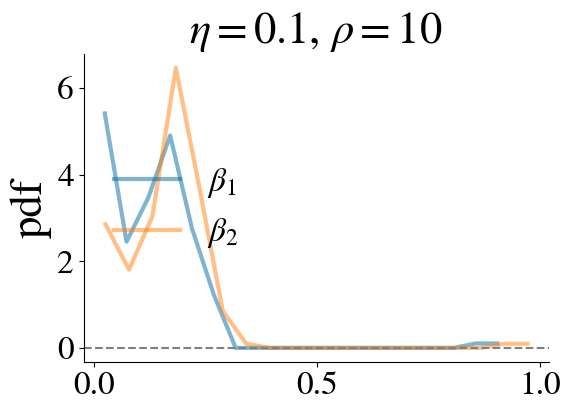

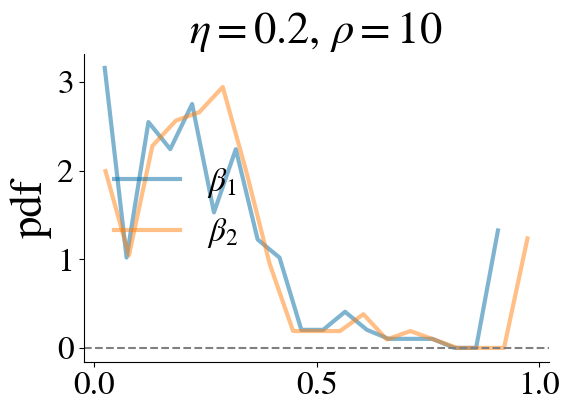

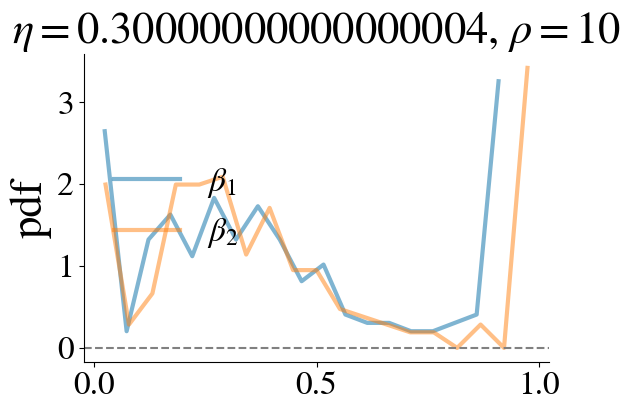

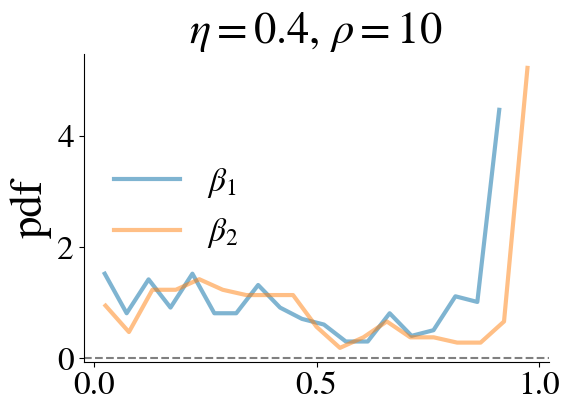

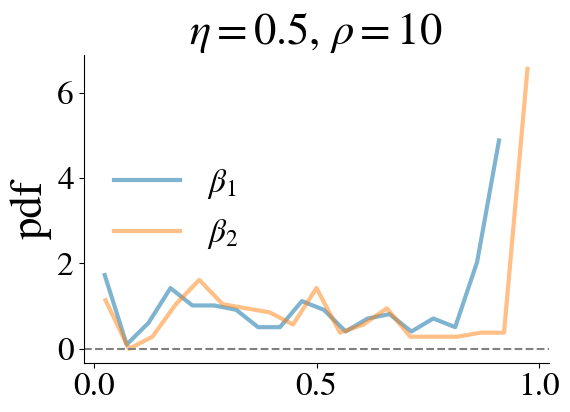

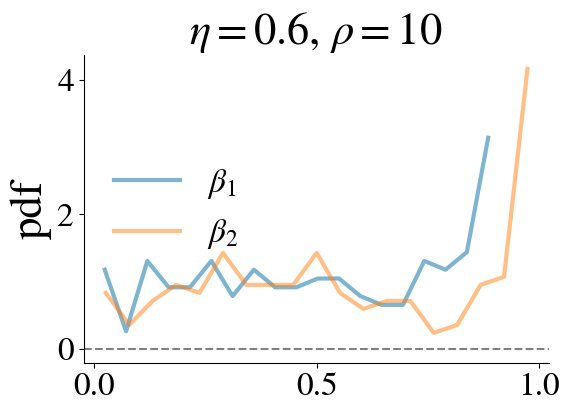

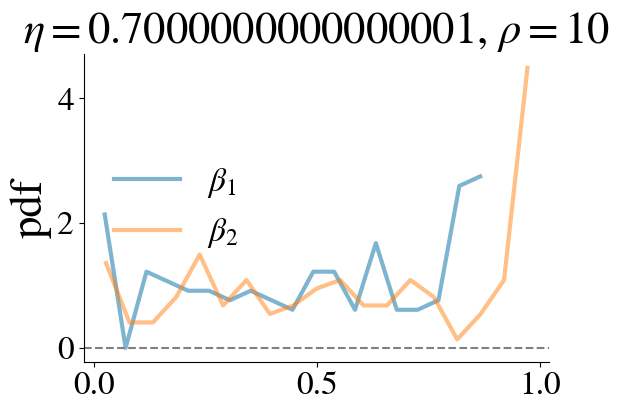

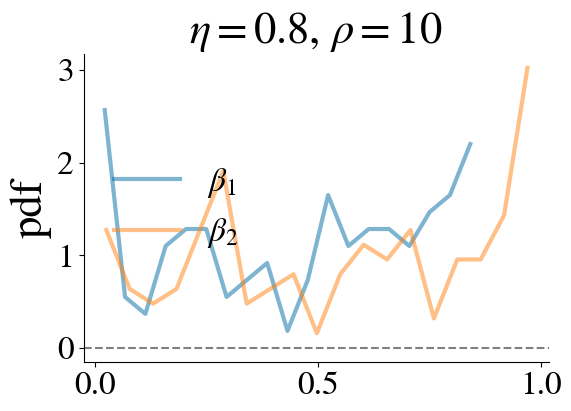

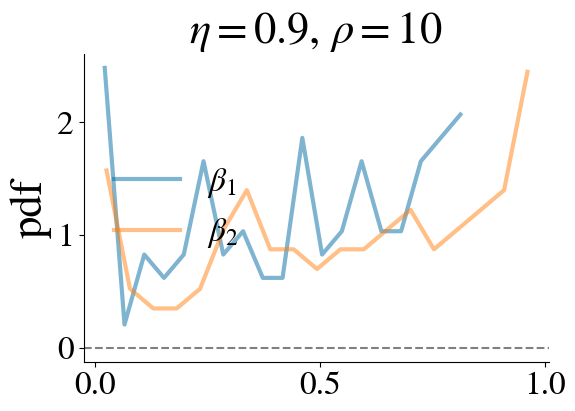

In [887]:
Tmax = int(1e5)
for eta in tqdm(np.arange(0.1,1,step=.1)):
    rho = 10
    starting_nu = 1
    ending_nu = min(20, int(rho/eta))


    dataset = {}
    dataset['mean_entropies'] = {}
    dataset['mean_entropies_glob'] = {}
    dataset['mean_entropies_pairs'] = {}
    dataset['mean_entropies_glob_pairs'] = {}
    dataset['weighted_diff_entropies'] = []
    dataset['weighted_diff_entropies_pairs'] = []
    for n_order, order in enumerate(['','2','3','4'], start=1):
        dataset[f'betas{order}'] = []
        dataset[f'intercepts{order}'] = []
    count = 0

    num_runs = 100
    for nu in tqdm(range(starting_nu, ending_nu+1)):
        data_folder = f"./data/simulations/rho_{rho:.5f}/nu_{nu}/Tmax_{Tmax}/eta_{eta:.5f}/"
        analysis_folder = data_folder
        for run in range(num_runs):
            path = os.path.join(analysis_folder,f'UMT_entropies_run_{run}.pkl')
            try:
                with open(path, 'rb') as fp:
                    entropy_result = joblib.load(fp)
                with open(os.path.join(analysis_folder,f'UMT_light_run_{run}.pkl'), 'rb') as fp:
                    result = joblib.load(fp)
                for i_order,order in enumerate(['', '_pairs']):
                    n_order = i_order + 1
                    for freq,value in entropy_result[f'mean_entropies{order}'].items():
                        try:
                            dataset[f'mean_entropies{order}'][freq].append(value)
                        except KeyError:
                            dataset[f'mean_entropies{order}'][freq] = [value]
                    for freq,value in entropy_result[f'mean_entropies_glob{order}'].items():
                        try:
                            dataset[f'mean_entropies_glob{order}'][freq].append(value)
                        except KeyError:
                            dataset[f'mean_entropies_glob{order}'][freq] = [value]
                dataset['weighted_diff_entropies'].append(entropy_result['weighted_diff_entropies'])
                dataset['weighted_diff_entropies_pairs'].append(entropy_result['weighted_diff_entropies_pairs'])
                # Add also information on beta
                for n_order, order in enumerate(['','2','3','4'], start=1):
                    dataset[f'betas{order}'].append(result[f'beta{order}_loglogregr_indices_geom'][-1])
                    dataset[f'intercepts{order}'].append(result[f'intercept{order}_loglogregr_indices_geom'][-1])
                # Add correct entropy difference to light result
    #             result['weighted_diff_entropies'] = entropy_result['weighted_diff_entropies']
    #             result['weighted_diff_entropies_pairs'] = entropy_result['weighted_diff_entropies_pairs']
    #             with open(os.path.join(analysis_folder,f'UMT_light_run_{run}.pkl'), 'wb') as fp:
    #                 pickle.dump(result,fp)
                count += 1
            except:
                pass
    
    if count > 0:
        fig,ax = plt.subplots(figsize=(6,4))
        num_bins = 20
        for order,key in enumerate(['betas', 'betas2']):#, 'weighted_diff_entropies', 'weighted_diff_entropies_pairs']):
            data_to_hist = dataset[key]
            hist,bin_edges = np.histogram(data_to_hist, 
                    np.linspace(np.min(data_to_hist), np.max(data_to_hist), num_bins), 
                    density=True)
            bin_centers = (bin_edges[1:]+bin_edges[:-1])/2
            p = ax.plot(bin_centers, hist, alpha=0.5,lw=3, label = r"$\beta_%d$"%(order+1) if order<2 else r"$\langle( S_%d \rangle)$"%(order+1))
        ax.axhline(0, ls='--', color='gray')
        ax.legend(loc='center left')
        ax.set_ylabel('pdf')
        ax.set_title(r'$\eta = %s$, $\rho = %s$'%(str(eta), str(rho)))
        fig.add_subplot(ax)


    print(eta, rho,count, sep = "\t")
    UMST_data_with_entropy[(eta, rho)] = dataset.copy()

#### Try specific

In [958]:
marker_size = 20
alpha_scatter = 1

##### eta 0.5 rho 20

  0%|          | 0/7 [00:00<?, ?it/s]

0.5	20	700


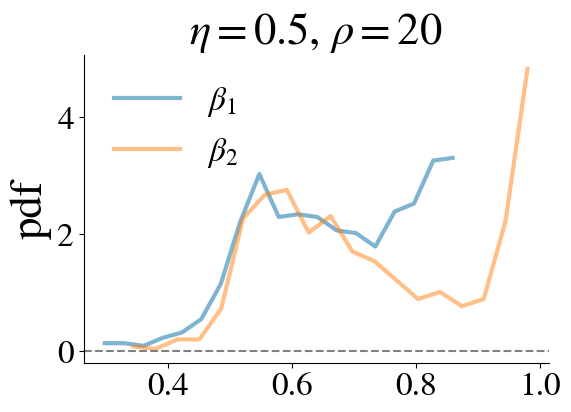

In [994]:
Tmax = int(1e5)
eta = 0.5
rho = 20
starting_nu = 20
ending_nu = 26 #min(20, int(rho/eta))


dataset = {}
dataset['mean_entropies'] = {}
dataset['mean_entropies_glob'] = {}
dataset['mean_entropies_pairs'] = {}
dataset['mean_entropies_glob_pairs'] = {}
dataset['weighted_diff_entropies'] = []
dataset['weighted_diff_entropies_pairs'] = []
for n_order, order in enumerate(['','2','3','4'], start=1):
    dataset[f'betas{order}'] = []
    dataset[f'intercepts{order}'] = []
count = 0

num_runs = 100
for nu in tqdm(range(starting_nu, ending_nu+1)):
    data_folder = f"./data/simulations/rho_{rho:.5f}/nu_{nu}/Tmax_{Tmax}/eta_{eta:.5f}/"
    analysis_folder = data_folder
    for run in range(num_runs):
        path = os.path.join(analysis_folder,f'UMT_entropy_run_{run}.pkl')
        try:
            try:
                with open(path, 'rb') as fp:
                    entropy_result = joblib.load(fp)
            except:
                path = os.path.join(analysis_folder,f'UMT_entropies_run_{run}.pkl')
                with open(path, 'rb') as fp:
                    entropy_result = joblib.load(fp)
            with open(os.path.join(analysis_folder,f'UMT_light_run_{run}.pkl'), 'rb') as fp:
                result = joblib.load(fp)
            for i_order,order in enumerate(['', '_pairs']):
                n_order = i_order + 1
                for freq,value in entropy_result[f'mean_entropies{order}'].items():
                    try:
                        dataset[f'mean_entropies{order}'][freq].append(value)
                    except KeyError:
                        dataset[f'mean_entropies{order}'][freq] = [value]
                for freq,value in entropy_result[f'mean_entropies_glob{order}'].items():
                    try:
                        dataset[f'mean_entropies_glob{order}'][freq].append(value)
                    except KeyError:
                        dataset[f'mean_entropies_glob{order}'][freq] = [value]
            dataset['weighted_diff_entropies'].append(entropy_result['weighted_diff_entropies'])
            dataset['weighted_diff_entropies_pairs'].append(entropy_result['weighted_diff_entropies_pairs'])
            # Add also information on beta
            for n_order, order in enumerate(['','2','3','4'], start=1):
                dataset[f'betas{order}'].append(result[f'beta{order}_loglogregr_indices_geom'][-1])
                dataset[f'intercepts{order}'].append(result[f'intercept{order}_loglogregr_indices_geom'][-1])
            # Add correct entropy difference to light result
#             result['weighted_diff_entropies'] = entropy_result['weighted_diff_entropies']
#             result['weighted_diff_entropies_pairs'] = entropy_result['weighted_diff_entropies_pairs']
#             with open(os.path.join(analysis_folder,f'UMT_light_run_{run}.pkl'), 'wb') as fp:
#                 pickle.dump(result,fp)
            count += 1
        except:
            pass

if count > 0:
    fig,ax = plt.subplots(figsize=(6,4))
    num_bins = 20
    for order,key in enumerate(['betas', 'betas2']):#, 'weighted_diff_entropies', 'weighted_diff_entropies_pairs']):
        data_to_hist = dataset[key]
        hist,bin_edges = np.histogram(data_to_hist, 
                np.linspace(np.min(data_to_hist), np.max(data_to_hist), num_bins), 
                density=True)
        bin_centers = (bin_edges[1:]+bin_edges[:-1])/2
        p = ax.plot(bin_centers, hist, alpha=0.5,lw=3, label = r"$\beta_%d$"%(order+1) if order<2 else r"$\langle( S_%d \rangle)$"%(order+1))
    ax.axhline(0, ls='--', color='gray')
    ax.legend(loc='best')
    ax.set_ylabel('pdf')
    ax.set_title(r'$\eta = %s$, $\rho = %s$'%(str(eta), str(rho)))
    fig.add_subplot(ax)


print(eta, rho,count, sep = "\t")
UMST_data_with_entropy[(eta, rho)] = dataset.copy()

p-value pearson between $\beta_1$ and $\langle\Delta S \rangle$ 3.193685770203051e-86
p-value pearson between $\beta_2$ and $\langle\Delta S_2 \rangle$ 6.9806196563161895e-15
p-value pearson between $\langle\Delta S \rangle$ and $\langle\Delta S_2 \rangle$ 9.005430196404126e-76
p-value pearson between $\beta_1$ and $\beta_2$ 0.0
p-value pearson between $\beta_1$ and $(\beta_2 - \beta_1) / (1 - \beta_1)$ 2.9318616993782767e-157


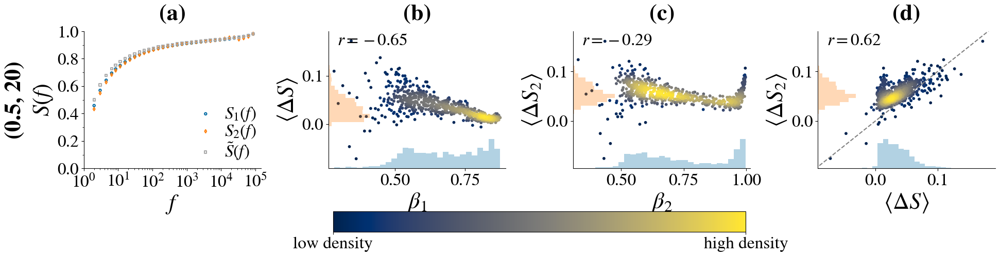

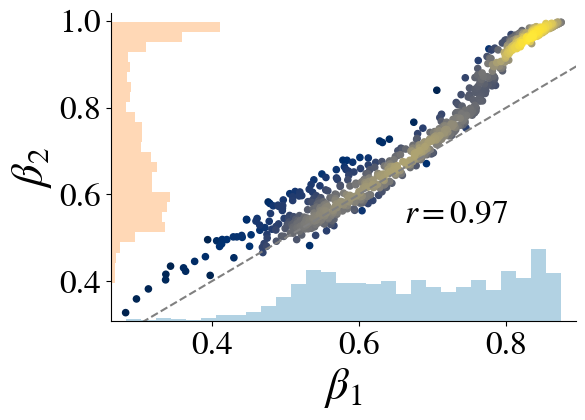

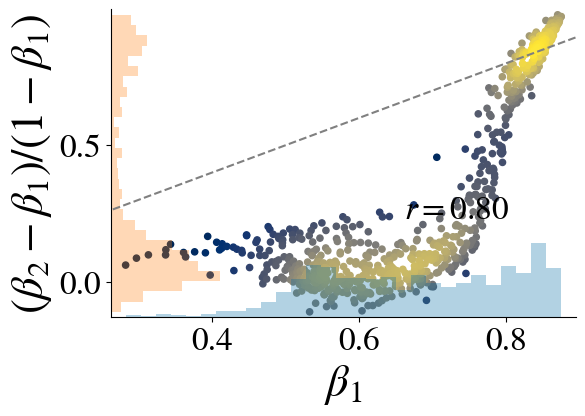

In [995]:
eta = 0.5
rho = 20
dataset_dict = UMST_data_with_entropy[(eta,rho)]
fig = fig_4({(eta,rho):dataset_dict}, marker_size = 10, alpha_scatter = 1, 
          min_x = 0,
          max_x = 1,
          min_y = -0.1,
          max_y = 0.7,
          x_correlation_text = .05,
          y_correlation_text = .9,
          use_same_x_y_max_lim = False,
         )


fig,ax=plt.subplots(figsize=(6,4))
x = np.array(dataset_dict[f'betas'])
y = np.array(dataset_dict[f'betas{2}'])
fig_1_subplot_b_d(x, y, 
                  ax = ax, 
                  marker_size = marker_size, alpha_scatter = alpha_scatter,
                  ylabel = fr"$\beta_{2}$", xlabel = fr"$\beta_{1}$", 
#                   min_x=0, max_x=1, min_y=0, max_y=1,
                 )
fig,ax=plt.subplots(figsize=(6,4))
x = np.array(dataset_dict[f'betas'])
y = np.array(dataset_dict[f'betas{2}'])
y = (y-x)/(1-x)
fig_1_subplot_b_d(x, y, 
                  ax = ax, 
                  marker_size = marker_size, alpha_scatter = alpha_scatter,
                  ylabel = fr"$(\beta_{2} - \beta_{1}) / (1 - \beta_{1})$", xlabel = fr"$\beta_{1}$", 
#                   min_x=min_beta, max_x=max_beta, min_y=min_beta_higher, max_y=max_beta_higher,
                 )

##### eta 0.25 rho 10

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

0.25	10	2000


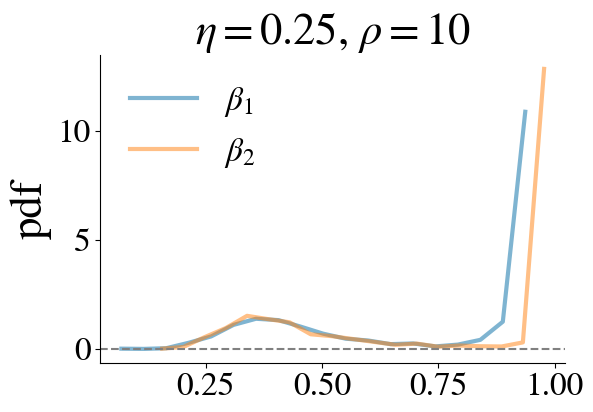

In [956]:
Tmax = int(1e5)
eta = 0.25
rho = 10
starting_nu = 11
ending_nu = 30 #min(20, int(rho/eta))


dataset = {}
dataset['mean_entropies'] = {}
dataset['mean_entropies_glob'] = {}
dataset['mean_entropies_pairs'] = {}
dataset['mean_entropies_glob_pairs'] = {}
dataset['weighted_diff_entropies'] = []
dataset['weighted_diff_entropies_pairs'] = []
for n_order, order in enumerate(['','2','3','4'], start=1):
    dataset[f'betas{order}'] = []
    dataset[f'intercepts{order}'] = []
count = 0

num_runs = 100
for nu in tqdm(range(starting_nu, ending_nu+1)):
    data_folder = f"./data/simulations/rho_{rho:.5f}/nu_{nu}/Tmax_{Tmax}/eta_{eta:.5f}/"
    analysis_folder = data_folder
    for run in range(num_runs):
        path = os.path.join(analysis_folder,f'UMT_entropy_run_{run}.pkl')
        try:
            try:
                with open(path, 'rb') as fp:
                    entropy_result = joblib.load(fp)
            except:
                path = os.path.join(analysis_folder,f'UMT_entropies_run_{run}.pkl')
                with open(path, 'rb') as fp:
                    entropy_result = joblib.load(fp)
            with open(os.path.join(analysis_folder,f'UMT_light_run_{run}.pkl'), 'rb') as fp:
                result = joblib.load(fp)
            for i_order,order in enumerate(['', '_pairs']):
                n_order = i_order + 1
                for freq,value in entropy_result[f'mean_entropies{order}'].items():
                    try:
                        dataset[f'mean_entropies{order}'][freq].append(value)
                    except KeyError:
                        dataset[f'mean_entropies{order}'][freq] = [value]
                for freq,value in entropy_result[f'mean_entropies_glob{order}'].items():
                    try:
                        dataset[f'mean_entropies_glob{order}'][freq].append(value)
                    except KeyError:
                        dataset[f'mean_entropies_glob{order}'][freq] = [value]
            dataset['weighted_diff_entropies'].append(entropy_result['weighted_diff_entropies'])
            dataset['weighted_diff_entropies_pairs'].append(entropy_result['weighted_diff_entropies_pairs'])
            # Add also information on beta
            for n_order, order in enumerate(['','2','3','4'], start=1):
                dataset[f'betas{order}'].append(result[f'beta{order}_loglogregr_indices_geom'][-1])
                dataset[f'intercepts{order}'].append(result[f'intercept{order}_loglogregr_indices_geom'][-1])
            # Add correct entropy difference to light result
#             result['weighted_diff_entropies'] = entropy_result['weighted_diff_entropies']
#             result['weighted_diff_entropies_pairs'] = entropy_result['weighted_diff_entropies_pairs']
#             with open(os.path.join(analysis_folder,f'UMT_light_run_{run}.pkl'), 'wb') as fp:
#                 pickle.dump(result,fp)
            count += 1
        except:
            pass

if count > 0:
    fig,ax = plt.subplots(figsize=(6,4))
    num_bins = 20
    for order,key in enumerate(['betas', 'betas2']):#, 'weighted_diff_entropies', 'weighted_diff_entropies_pairs']):
        data_to_hist = dataset[key]
        hist,bin_edges = np.histogram(data_to_hist, 
                np.linspace(np.min(data_to_hist), np.max(data_to_hist), num_bins), 
                density=True)
        bin_centers = (bin_edges[1:]+bin_edges[:-1])/2
        p = ax.plot(bin_centers, hist, alpha=0.5,lw=3, label = r"$\beta_%d$"%(order+1) if order<2 else r"$\langle( S_%d \rangle)$"%(order+1))
    ax.axhline(0, ls='--', color='gray')
    ax.legend(loc='best')
    ax.set_ylabel('pdf')
    ax.set_title(r'$\eta = %s$, $\rho = %s$'%(str(eta), str(rho)))
    fig.add_subplot(ax)


print(eta, rho,count, sep = "\t")
UMST_data_with_entropy[(eta, rho)] = dataset.copy()

p-value pearson between $\beta_1$ and $\langle\Delta S \rangle$ 2.1569768867462946e-36
p-value pearson between $\beta_2$ and $\langle\Delta S_2 \rangle$ 9.060272080652131e-30
p-value pearson between $\langle\Delta S \rangle$ and $\langle\Delta S_2 \rangle$ 1.2502086413776855e-97
p-value pearson between $\beta_1$ and $\beta_2$ 5.96584e-319
p-value pearson between $\beta_1$ and $(\beta_2 - \beta_1) / (1 - \beta_1)$ 5.971675948896435e-77


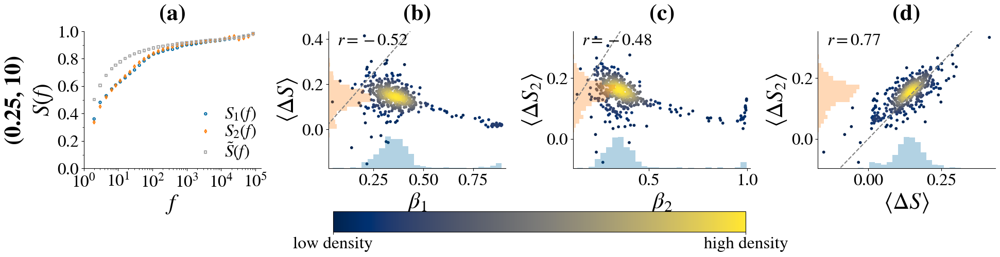

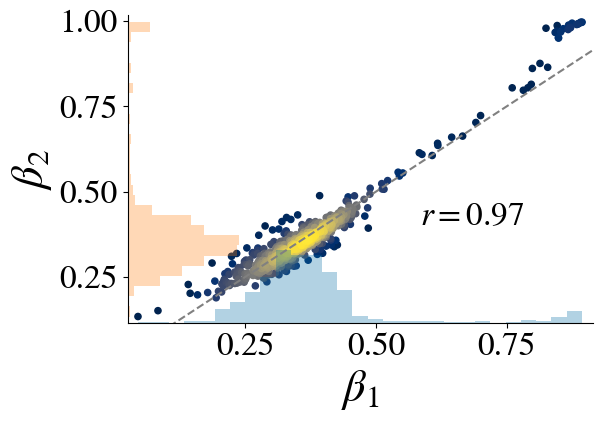

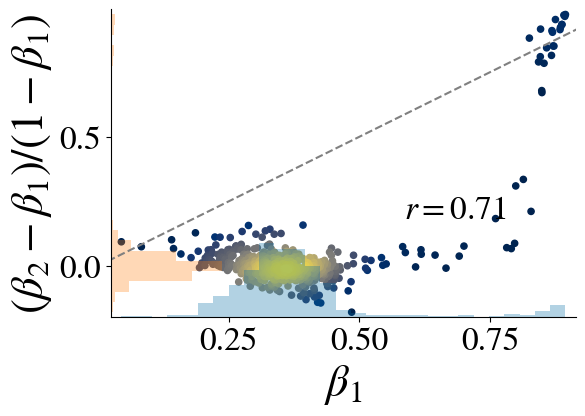

In [996]:
eta = 0.25
rho = 10
dataset_dict = UMST_data_with_entropy[(eta,rho)]
fig = fig_4({(eta,rho):dataset_dict}, marker_size = 10, alpha_scatter = 1, 
          min_x = 0,
          max_x = 1,
          min_y = -0.1,
          max_y = 0.7,
          x_correlation_text = .05,
          y_correlation_text = .9,
          use_same_x_y_max_lim = False,
         )


fig,ax=plt.subplots(figsize=(6,4))
x = np.array(dataset_dict[f'betas'][:1000])
y = np.array(dataset_dict[f'betas{2}'][:1000])
fig_1_subplot_b_d(x, y, 
                  ax = ax, 
                  marker_size = marker_size, alpha_scatter = alpha_scatter,
                  ylabel = fr"$\beta_{2}$", xlabel = fr"$\beta_{1}$", 
#                   min_x=0, max_x=1, min_y=0, max_y=1,
                 )
fig,ax=plt.subplots(figsize=(6,4))
x = np.array(dataset_dict[f'betas'][:1000])
y = np.array(dataset_dict[f'betas{2}'][:1000])
y = (y-x)/(1-x)
fig_1_subplot_b_d(x, y, 
                  ax = ax, 
                  marker_size = marker_size, alpha_scatter = alpha_scatter,
                  ylabel = fr"$(\beta_{2} - \beta_{1}) / (1 - \beta_{1})$", xlabel = fr"$\beta_{1}$", 
#                   min_x=min_beta, max_x=max_beta, min_y=min_beta_higher, max_y=max_beta_higher,
                 )

##### eta 0.1 rho 4

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

0.1	4	1100


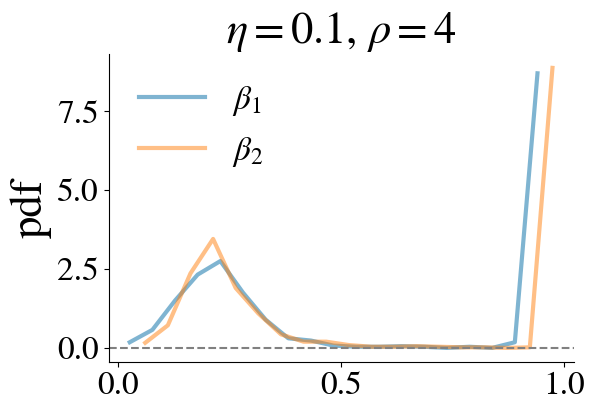

In [968]:
Tmax = int(1e5)
for i,eta in enumerate(tqdm(np.arange(0.1,0.11,step=.1))):
    rho = 4
    starting_nu = 4
    ending_nu = 15 #min(20, int(rho/eta))


    dataset = {}
    dataset['mean_entropies'] = {}
    dataset['mean_entropies_glob'] = {}
    dataset['mean_entropies_pairs'] = {}
    dataset['mean_entropies_glob_pairs'] = {}
    dataset['weighted_diff_entropies'] = []
    dataset['weighted_diff_entropies_pairs'] = []
    for n_order, order in enumerate(['','2','3','4'], start=1):
        dataset[f'betas{order}'] = []
        dataset[f'intercepts{order}'] = []
    count = 0

    num_runs = 100
    for nu in tqdm(range(starting_nu, ending_nu+1)):
        data_folder = f"./data/simulations/rho_{rho:.5f}/nu_{nu}/Tmax_{Tmax}/eta_{eta:.5f}/"
        analysis_folder = data_folder
        for run in range(num_runs):
            path = os.path.join(analysis_folder,f'UMT_entropy_run_{run}.pkl')
            try:
                try:
                    with open(path, 'rb') as fp:
                        entropy_result = joblib.load(fp)
                except:
                    path = os.path.join(analysis_folder,f'UMT_entropies_run_{run}.pkl')
                    with open(path, 'rb') as fp:
                        entropy_result = joblib.load(fp)
                with open(os.path.join(analysis_folder,f'UMT_light_run_{run}.pkl'), 'rb') as fp:
                    result = joblib.load(fp)
                for i_order,order in enumerate(['', '_pairs']):
                    n_order = i_order + 1
                    for freq,value in entropy_result[f'mean_entropies{order}'].items():
                        try:
                            dataset[f'mean_entropies{order}'][freq].append(value)
                        except KeyError:
                            dataset[f'mean_entropies{order}'][freq] = [value]
                    for freq,value in entropy_result[f'mean_entropies_glob{order}'].items():
                        try:
                            dataset[f'mean_entropies_glob{order}'][freq].append(value)
                        except KeyError:
                            dataset[f'mean_entropies_glob{order}'][freq] = [value]
                dataset['weighted_diff_entropies'].append(entropy_result['weighted_diff_entropies'])
                dataset['weighted_diff_entropies_pairs'].append(entropy_result['weighted_diff_entropies_pairs'])
                # Add also information on beta
                for n_order, order in enumerate(['','2','3','4'], start=1):
                    dataset[f'betas{order}'].append(result[f'beta{order}_loglogregr_indices_geom'][-1])
                    dataset[f'intercepts{order}'].append(result[f'intercept{order}_loglogregr_indices_geom'][-1])
                # Add correct entropy difference to light result
    #             result['weighted_diff_entropies'] = entropy_result['weighted_diff_entropies']
    #             result['weighted_diff_entropies_pairs'] = entropy_result['weighted_diff_entropies_pairs']
    #             with open(os.path.join(analysis_folder,f'UMT_light_run_{run}.pkl'), 'wb') as fp:
    #                 pickle.dump(result,fp)
                count += 1
            except:
                pass
    
    if count > 0:
        fig,ax = plt.subplots(figsize=(6,4))
        num_bins = 20
        for order,key in enumerate(['betas', 'betas2']):#, 'weighted_diff_entropies', 'weighted_diff_entropies_pairs']):
            data_to_hist = dataset[key]
            hist,bin_edges = np.histogram(data_to_hist, 
                    np.linspace(np.min(data_to_hist), np.max(data_to_hist), num_bins), 
                    density=True)
            bin_centers = (bin_edges[1:]+bin_edges[:-1])/2
            p = ax.plot(bin_centers, hist, alpha=0.5,lw=3, label = r"$\beta_%d$"%(order+1) if order<2 else r"$\langle( S_%d \rangle)$"%(order+1))
        ax.axhline(0, ls='--', color='gray')
        ax.legend(loc='best')
        ax.set_ylabel('pdf')
        ax.set_title(r'$\eta = %s$, $\rho = %s$'%(str(eta), str(rho)))
        fig.add_subplot(ax)


    print(eta, rho,count, sep = "\t")
    UMST_data_with_entropy[(eta, rho)] = dataset.copy()

p-value pearson between $\beta_1$ and $\langle\Delta S \rangle$ 0.0
p-value pearson between $\beta_2$ and $\langle\Delta S_2 \rangle$ 1.0703085232010275e-160
p-value pearson between $\langle\Delta S \rangle$ and $\langle\Delta S_2 \rangle$ 4.1051698267259884e-58
p-value pearson between $\beta_1$ and $\beta_2$ 0.0
p-value pearson between $\beta_1$ and $(\beta_2 - \beta_1) / (1 - \beta_1)$ 0.0


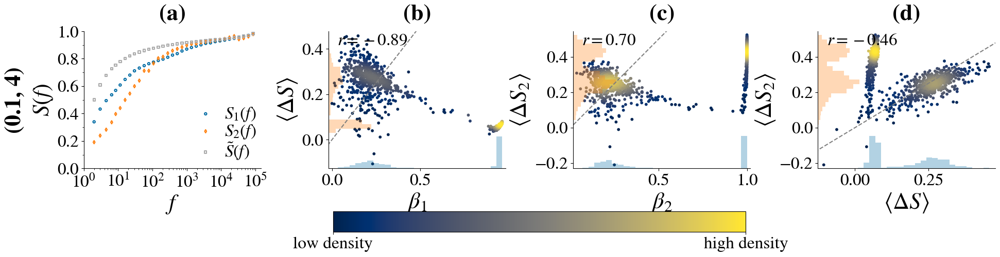

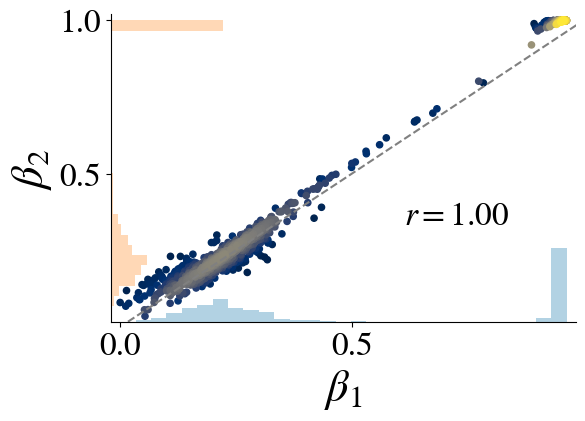

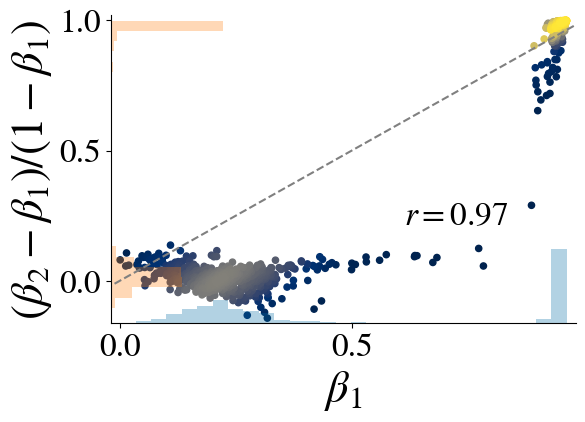

In [997]:
eta = 0.1
rho = 4
dataset_dict = UMST_data_with_entropy[(eta,rho)]
fig = fig_4({(eta,rho):dataset_dict}, marker_size = 10, alpha_scatter = 1, 
          min_x = 0,
          max_x = 1,
          min_y = -0.1,
          max_y = 0.7,
          x_correlation_text = .05,
          y_correlation_text = .9,
          use_same_x_y_max_lim = False,
         )


fig,ax=plt.subplots(figsize=(6,4))
x = np.array(dataset_dict[f'betas'][:1000])
y = np.array(dataset_dict[f'betas{2}'][:1000])
fig_1_subplot_b_d(x, y, 
                  ax = ax, 
                  marker_size = marker_size, alpha_scatter = alpha_scatter,
                  ylabel = fr"$\beta_{2}$", xlabel = fr"$\beta_{1}$", 
#                   min_x=0, max_x=1, min_y=0, max_y=1,
                 )
fig,ax=plt.subplots(figsize=(6,4))
x = np.array(dataset_dict[f'betas'][:1000])
y = np.array(dataset_dict[f'betas{2}'][:1000])
y = (y-x)/(1-x)
fig_1_subplot_b_d(x, y, 
                  ax = ax, 
                  marker_size = marker_size, alpha_scatter = alpha_scatter,
                  ylabel = fr"$(\beta_{2} - \beta_{1}) / (1 - \beta_{1})$", xlabel = fr"$\beta_{1}$", 
#                   min_x=min_beta, max_x=max_beta, min_y=min_beta_higher, max_y=max_beta_higher,
                 )

### Dump data

In [864]:
with gzip.open('./data/essential_entropy_data_for_figure4.pkl.gz', "wb") as fp:
    joblib.dump(data_with_entropy, fp)
print('Dumped')

Dumped


## Functions

In [473]:
def fig_4_subplot_a_old(result, 
                    ax = None, marker_size = 20, alpha = 0.5, 
                    dataset_label = None, 
                    number_to_write = 0, 
                    xlim_left = 1, xlim_right = None, 
                    ylim_bottom = 0, ylim_top = 1, 
                    ylabel = r"$S(f)$", xlabel = r"$f$", 
                    write_number = False):
    if ax == None:
        fig, ax = plt.subplots()
#        # orig 
#     ax.scatter(list(result["mean_entropies"].keys()),list(result["mean_entropies"].values()), rasterized = True, label=r"original", alpha=alpha)
#     ax.scatter(list(result["mean_entropies_glob"].keys()),list(result["mean_entropies_glob"].values()), marker='s', rasterized = True, label=r"reshuffled", alpha=alpha)
    # with all of them
#     ax.scatter(
#         [freq for tmp_i, tmp_dict in result["mean_entropies"].items() for freq,value in tmp_dict.items()],
#         [value for tmp_i, tmp_dict in result["mean_entropies"].items() for freq,value in tmp_dict.items()], 
#         rasterized = True, label=r"original", alpha=alpha, s=marker_size)
#     ax.scatter(
#         [freq for tmp_i, tmp_dict in result["mean_entropies_glob"].items() for freq,value in tmp_dict.items()],
#         [value for tmp_i, tmp_dict in result["mean_entropies_glob"].items() for freq,value in tmp_dict.items()], 
#         marker='s', rasterized = True, label=r"reshuffled", alpha=alpha, s=marker_size)
    # with average of them
    ax.scatter(
        [freq  for freq,value in result["mean_entropies"].items()],
        [np.mean(value)  for freq,value in result["mean_entropies"].items()],
        rasterized = True, label=r"original", alpha=alpha, s=marker_size)
    ax.scatter(
        [freq for freq,value in result["mean_entropies_glob"].items()],
        [np.mean(value) for freq,value in result["mean_entropies_glob"].items()],
        marker='s', rasterized = True, label=r"reshuffled", alpha=alpha, s=marker_size)
#     # with average of them binned
#     x = [freq  for freq,values in result["mean_entropies"].items() for value in values]
#     max_x = max(x)
#     min_x = min(x)
#     num_bins = 100
#     x_bins_lim = np.array([min_x-0.5] + list(np.array(np.unique(np.geomspace(min_x, max_x, num = num_bins, dtype=int)),dtype=float) + 0.5))
#     x_bins_centers = (x_bins_lim[1:] + x_bins_lim[:-1]) / 2
#     y = [value  for freq,values in result["mean_entropies"].items() for value in values]
#     y_bins_count = np.zeros(len(x_bins_centers))
#     y_bins_sum = np.zeros(len(x_bins_centers))
#     for index,freq in enumerate(x):
#         value = y[index]
#         for index_bin, x_bins_lim_right in enumerate(x_bins_lim[1:]):
#             if freq < x_bins_lim_right:
#                 break
#         y_bins_sum[index_bin] += value
#         y_bins_count[index_bin] += 1
#     y_bins = np.zeros(len(x_bins_centers))
#     for index,y_sum in enumerate(y_bins_sum):
#         y_count = y_bins_count[index]
#         if y_count > 0:
#             y_bins[index] = y_sum / y_count
# #     y_bins = y_bins_sum / y_bins_count
#     ax.scatter(
#         [_ for i_,_ in enumerate(x_bins_centers) if y_bins_count[i_] > 0], 
#         [_ for i_,_ in enumerate(y_bins) if y_bins_count[i_] > 0],
#         rasterized = True, label=r"original", alpha=alpha, s=marker_size)
    
#     x = [freq  for freq,values in result["mean_entropies_glob"].items() for value in values]
#     max_x = max(x)
#     min_x = min(x)
#     num_bins = 100
#     x_bins_lim = np.array([min_x-0.5] + list(np.array(np.unique(np.geomspace(min_x, max_x, num = num_bins, dtype=int)),dtype=float) + 0.5))
#     x_bins_centers = (x_bins_lim[1:] + x_bins_lim[:-1]) / 2
#     y = [value  for freq,values in result["mean_entropies_glob"].items() for value in values]
#     y_bins_count = np.zeros(len(x_bins_centers))
#     y_bins_sum = np.zeros(len(x_bins_centers))
#     for index,freq in enumerate(x):
#         value = y[index]
#         for index_bin, x_bins_lim_right in enumerate(x_bins_lim[1:]):
#             if freq < x_bins_lim_right:
#                 break
#         y_bins_sum[index_bin] += value
#         y_bins_count[index_bin] += 1
#     y_bins = np.zeros(len(x_bins_centers))
#     for index,y_sum in enumerate(y_bins_sum):
#         y_count = y_bins_count[index]
#         if y_count > 0:
#             y_bins[index] = y_sum / y_count
# #     y_bins = y_bins_sum / y_bins_count
#     ax.scatter(
#         [_ for i_,_ in enumerate(x_bins_centers) if y_bins_count[i_] > 0], 
#         [_ for i_,_ in enumerate(y_bins) if y_bins_count[i_] > 0],
#         marker='s', rasterized = True, label=r"reshuffled", alpha=alpha, s=marker_size)

    ax.set_xscale("log")
    ax.set_xlim(left = xlim_left, right = xlim_right)
    ax.set_ylim(bottom = ylim_bottom, top = ylim_top)
    ax.set_ylabel(ylabel)
    ax.set_xlabel(xlabel)
    if number_to_write == 0:
        leg = ax.legend(handletextpad=0.1, bbox_to_anchor=(1.06,-0.06), loc="lower right", labelspacing = 0) # , bbox_to_anchor=(0.0,1.06), loc="upper left") # labelspacing = 0, 
        for lh in leg.legendHandles: 
            lh.set_alpha(1)
    if dataset_label != None:
        ax.text(-0.33,0.5, dataset_label, rotation=90,verticalalignment='center',horizontalalignment='right',fontweight='bold', transform=ax.transAxes) 

    # Impose xticks
    locmaj = matplotlib.ticker.LogLocator(base=10,numticks=20) 
    ax.xaxis.set_major_locator(locmaj)
    locmin = matplotlib.ticker.LogLocator(base=10.0,subs=(np.arange(0.1,1,0.1)),numticks=20)
    ax.xaxis.set_minor_locator(locmin)
    ax.xaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
    # Impose yticks
    locmaj = matplotlib.ticker.LinearLocator(numticks=6) 
    ax.yaxis.set_major_locator(locmaj)
    locmin = matplotlib.ticker.LinearLocator(numticks=11)
    ax.yaxis.set_minor_locator(locmin)
    ax.yaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
    if write_number == True:
        ax.text(0.5, 1.08, f"{letters[number_to_write]}", transform=ax.transAxes,fontweight='bold', horizontalalignment='center')
    return ax

In [668]:
def fig_4_subplot_a_old2(result, 
                    ax = None, marker_size = 20, alpha = 0.5, 
                    dataset_label = None, 
                    number_to_write = 0, 
                    xlim_left = 1, xlim_right = None, 
                    ylim_bottom = 0, ylim_top = 1, 
                    ylabel = r"$S(f)$", xlabel = r"$f$", 
                    write_number = False):
    if ax == None:
        fig, ax = plt.subplots()
       # orig 
#     ax.scatter(list(result["mean_entropies"].keys()),list(result["mean_entropies"].values()), rasterized = True, label=r"original", alpha=alpha)
#     ax.scatter(list(result["mean_entropies_glob"].keys()),list(result["mean_entropies_glob"].values()), marker='s', rasterized = True, label=r"reshuffled", alpha=alpha)
    # with all of them
#     ax.scatter(
#         [freq for tmp_i, tmp_dict in result["mean_entropies"].items() for freq,value in tmp_dict.items()],
#         [value for tmp_i, tmp_dict in result["mean_entropies"].items() for freq,value in tmp_dict.items()], 
#         rasterized = True, label=r"original", alpha=alpha, s=marker_size)
#     ax.scatter(
#         [freq for tmp_i, tmp_dict in result["mean_entropies_glob"].items() for freq,value in tmp_dict.items()],
#         [value for tmp_i, tmp_dict in result["mean_entropies_glob"].items() for freq,value in tmp_dict.items()], 
#         marker='s', rasterized = True, label=r"reshuffled", alpha=alpha, s=marker_size)
#     # with average of them
#     ax.scatter(
#         [freq  for freq,value in result["mean_entropies"].items()],
#         [np.mean(value)  for freq,value in result["mean_entropies"].items()],
#         rasterized = True, label=r"original", alpha=alpha, s=marker_size)
#     ax.scatter(
#         [freq for freq,value in result["mean_entropies_glob"].items()],
#         [np.mean(value) for freq,value in result["mean_entropies_glob"].items()],
#         marker='s', rasterized = True, label=r"reshuffled", alpha=alpha, s=marker_size)
    # with average of them binned
    x = [freq  for freq,values in result["mean_entropies"].items() for value in values]
    max_x = max(x)
    min_x = min(x)
    num_bins = 100
    x_bins_lim = np.array([min_x-0.5] + list(np.array(np.unique(np.geomspace(min_x, max_x, num = num_bins, dtype=int)),dtype=float) + 0.5))
    x_bins_centers = (x_bins_lim[1:] + x_bins_lim[:-1]) / 2
    y = [value  for freq,values in result["mean_entropies"].items() for value in values]
    y_bins_count = np.zeros(len(x_bins_centers))
    y_bins_sum = np.zeros(len(x_bins_centers))
    for index,freq in enumerate(x):
        value = y[index]
        for index_bin, x_bins_lim_right in enumerate(x_bins_lim[1:]):
            if freq < x_bins_lim_right:
                break
        y_bins_sum[index_bin] += value
        y_bins_count[index_bin] += 1
    y_bins = np.zeros(len(x_bins_centers))
    for index,y_sum in enumerate(y_bins_sum):
        y_count = y_bins_count[index]
        if y_count > 0:
            y_bins[index] = y_sum / y_count
#     y_bins = y_bins_sum / y_bins_count
    ax.scatter(
        [_ for i_,_ in enumerate(x_bins_centers) if y_bins_count[i_] > 0], 
        [_ for i_,_ in enumerate(y_bins) if y_bins_count[i_] > 0],
        rasterized = True, label=r"original", alpha=alpha, s=marker_size)
    
    x = [freq  for freq,values in result["mean_entropies_glob"].items() for value in values]
    max_x = max(x)
    min_x = min(x)
    num_bins = 100
    x_bins_lim = np.array([min_x-0.5] + list(np.array(np.unique(np.geomspace(min_x, max_x, num = num_bins, dtype=int)),dtype=float) + 0.5))
    x_bins_centers = (x_bins_lim[1:] + x_bins_lim[:-1]) / 2
    y = [value  for freq,values in result["mean_entropies_glob"].items() for value in values]
    y_bins_count = np.zeros(len(x_bins_centers))
    y_bins_sum = np.zeros(len(x_bins_centers))
    for index,freq in enumerate(x):
        value = y[index]
        for index_bin, x_bins_lim_right in enumerate(x_bins_lim[1:]):
            if freq < x_bins_lim_right:
                break
        y_bins_sum[index_bin] += value
        y_bins_count[index_bin] += 1
    y_bins = np.zeros(len(x_bins_centers))
    for index,y_sum in enumerate(y_bins_sum):
        y_count = y_bins_count[index]
        if y_count > 0:
            y_bins[index] = y_sum / y_count
#     y_bins = y_bins_sum / y_bins_count
    ax.scatter(
        [_ for i_,_ in enumerate(x_bins_centers) if y_bins_count[i_] > 0], 
        [_ for i_,_ in enumerate(y_bins) if y_bins_count[i_] > 0],
        marker='s', rasterized = True, label=r"reshuffled", alpha=alpha, s=marker_size)

    ax.set_xscale("log")
    ax.set_xlim(left = xlim_left, right = xlim_right)
    ax.set_ylim(bottom = ylim_bottom, top = ylim_top)
    ax.set_ylabel(ylabel)
    ax.set_xlabel(xlabel)
    if number_to_write == 0:
        leg = ax.legend(handletextpad=0.1, bbox_to_anchor=(1.06,-0.06), loc="lower right", labelspacing = 0) # , bbox_to_anchor=(0.0,1.06), loc="upper left") # labelspacing = 0, 
        for lh in leg.legendHandles: 
            lh.set_alpha(1)
    if dataset_label != None:
        ax.text(-0.33,0.5, dataset_label, rotation=90,verticalalignment='center',horizontalalignment='right',fontweight='bold', transform=ax.transAxes) 

    # Impose xticks
    locmaj = matplotlib.ticker.LogLocator(base=10,numticks=20) 
    ax.xaxis.set_major_locator(locmaj)
    locmin = matplotlib.ticker.LogLocator(base=10.0,subs=(np.arange(0.1,1,0.1)),numticks=20)
    ax.xaxis.set_minor_locator(locmin)
    ax.xaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
    # Impose yticks
    locmaj = matplotlib.ticker.LinearLocator(numticks=6) 
    ax.yaxis.set_major_locator(locmaj)
    locmin = matplotlib.ticker.LinearLocator(numticks=11)
    ax.yaxis.set_minor_locator(locmin)
    ax.yaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
    if write_number == True:
        ax.text(0.5, 1.08, f"{letters[number_to_write]}", transform=ax.transAxes,fontweight='bold', horizontalalignment='center')
    return ax

In [1003]:
def fig_4_subplot_a(result, 
                    ax = None, marker_size = 20, alpha = 0.5, 
                    dataset_label = None, 
                    number_to_write = 0, 
                    num_bins = 35,
                    xlim_left = 1, xlim_right = None, 
                    ylim_bottom = 0, ylim_top = 1, 
                    ylabel = r"$S(f)$", xlabel = r"$f$", 
                    write_number = False):
    if ax == None:
        fig, ax = plt.subplots()
       # orig 
#     ax.scatter(list(result["mean_entropies"].keys()),list(result["mean_entropies"].values()), rasterized = True, label=r"original", alpha=alpha)
#     ax.scatter(list(result["mean_entropies_glob"].keys()),list(result["mean_entropies_glob"].values()), marker='s', rasterized = True, label=r"reshuffled", alpha=alpha)
    # with all of them
#     ax.scatter(
#         [freq for tmp_i, tmp_dict in result["mean_entropies"].items() for freq,value in tmp_dict.items()],
#         [value for tmp_i, tmp_dict in result["mean_entropies"].items() for freq,value in tmp_dict.items()], 
#         rasterized = True, label=r"original", alpha=alpha, s=marker_size)
#     ax.scatter(
#         [freq for tmp_i, tmp_dict in result["mean_entropies_glob"].items() for freq,value in tmp_dict.items()],
#         [value for tmp_i, tmp_dict in result["mean_entropies_glob"].items() for freq,value in tmp_dict.items()], 
#         marker='s', rasterized = True, label=r"reshuffled", alpha=alpha, s=marker_size)
#     # with average of them
#     ax.scatter(
#         [freq  for freq,value in result["mean_entropies"].items()],
#         [np.mean(value)  for freq,value in result["mean_entropies"].items()],
#         rasterized = True, label=r"original", alpha=alpha, s=marker_size)
#     ax.scatter(
#         [freq for freq,value in result["mean_entropies_glob"].items()],
#         [np.mean(value) for freq,value in result["mean_entropies_glob"].items()],
#         marker='s', rasterized = True, label=r"reshuffled", alpha=alpha, s=marker_size)
    # with average of them binned
    x = [freq for i_order,order in enumerate(['', '_pairs']) for freq,values in result[f"mean_entropies{order}"].items() for value in values]
    max_x = max(x)
    min_x = min(x)
    num_bins = num_bins
    x_bins_lim = np.array([min_x-0.5] + list(np.array(np.unique(np.geomspace(min_x, max_x, num = num_bins, dtype=int)),dtype=float) + 0.5))
    x_bins_centers = (x_bins_lim[1:] + x_bins_lim[:-1]) / 2

    cycler = ax._get_lines.prop_cycler # to get the cycle of colors to use
    
    for i_order,order in enumerate(['', '_pairs']):
        n_order = i_order + 1  
        x = [freq  for freq,values in result[f"mean_entropies{order}"].items() for value in values]
#         max_x = max(x)
#         min_x = min(x)
#         num_bins = num_bins
#         x_bins_lim = np.array([min_x-0.5] + list(np.array(np.unique(np.geomspace(min_x, max_x, num = num_bins, dtype=int)),dtype=float) + 0.5))
#         x_bins_centers = (x_bins_lim[1:] + x_bins_lim[:-1]) / 2
        y = [value  for freq,values in result[f"mean_entropies{order}"].items() for value in values]
        y_bins_count = np.zeros(len(x_bins_centers))
        y_bins_sum = np.zeros(len(x_bins_centers))
        for index,freq in enumerate(x):
            value = y[index]
            for index_bin, x_bins_lim_right in enumerate(x_bins_lim[1:]):
                if freq < x_bins_lim_right:
                    break
            y_bins_sum[index_bin] += value
            y_bins_count[index_bin] += 1
        y_bins = np.zeros(len(x_bins_centers))
        for index,y_sum in enumerate(y_bins_sum):
            y_count = y_bins_count[index]
            if y_count > 0:
                y_bins[index] = y_sum / y_count
    #     y_bins = y_bins_sum / y_bins_count
        if i_order == 1:
            ax.scatter(
            [_ for i_,_ in enumerate(x_bins_centers) if y_bins_count[i_] > 0], 
            [_ for i_,_ in enumerate(y_bins) if y_bins_count[i_] > 0],
            marker='d', rasterized = True, facecolors='none', edgecolor=next(cycler)['color'], 
                linewidth=1.5, label=r'$S_2(f)$', alpha=alpha, s=marker_size) # r"$\mathcal{S}_{%d}$"%n_order
        else:
#         if i_order == 0:
            ax.scatter(
            [_ for i_,_ in enumerate(x_bins_centers) if y_bins_count[i_] > 0], 
            [_ for i_,_ in enumerate(y_bins) if y_bins_count[i_] > 0],
            rasterized = True, facecolors='none', edgecolor=next(cycler)['color'], 
                linewidth=1.5, label=r'$S_1(f)$', alpha=alpha, s=marker_size) # r"$\mathcal{Q}_{%d}$"%n_order
        
#             x = [freq  for freq,values in result[f"mean_entropies_glob{order}"].items() for value in values]
#             max_x = max(x)
#             min_x = min(x)
#             x_bins_lim = np.array([min_x-0.5] + list(np.array(np.unique(np.geomspace(min_x, max_x, num = num_bins, dtype=int)),dtype=float) + 0.5))
#             x_bins_centers = (x_bins_lim[1:] + x_bins_lim[:-1]) / 2
    x = [freq  for freq,values in result[f"mean_entropies_glob"].items() for value in values]
    y = [value  for freq,values in result[f"mean_entropies_glob"].items() for value in values]
    y_bins_count = np.zeros(len(x_bins_centers))
    y_bins_sum = np.zeros(len(x_bins_centers))
    for index,freq in enumerate(x):
        value = y[index]
        for index_bin, x_bins_lim_right in enumerate(x_bins_lim[1:]):
            if freq < x_bins_lim_right:
                break
        y_bins_sum[index_bin] += value
        y_bins_count[index_bin] += 1
    y_bins = np.zeros(len(x_bins_centers))
    for index,y_sum in enumerate(y_bins_sum):
        y_count = y_bins_count[index]
        if y_count > 0:
            y_bins[index] = y_sum / y_count
#     y_bins = y_bins_sum / y_bins_count
    ax.scatter(
        [_ for i_,_ in enumerate(x_bins_centers) if y_bins_count[i_] > 0], 
        [_ for i_,_ in enumerate(y_bins) if y_bins_count[i_] > 0],
        marker='s', rasterized = True, facecolors='none', edgecolor=next(cycler)['color'], 
        linewidth=1.5, label=r"$\tilde{S}(f)$", alpha=alpha, s=marker_size, )

    ax.set_xscale("log")
    ax.set_xlim(left = xlim_left, right = xlim_right)
    ax.set_ylim(bottom = ylim_bottom, top = ylim_top)
    ax.set_ylabel(ylabel)
    ax.set_xlabel(xlabel)
    if number_to_write == 0:
        leg = ax.legend(handletextpad=0.1, bbox_to_anchor=(1.06,-0.06), loc="lower right", labelspacing = 0) # , bbox_to_anchor=(0.0,1.06), loc="upper left") # labelspacing = 0, 
        for lh in leg.legendHandles: 
            lh.set_alpha(1)
    if dataset_label != None:
#         ax.text(-0.33,0.5, dataset_label, rotation=90,verticalalignment='center',horizontalalignment='right',fontweight='bold', transform=ax.transAxes) 
        ax.set_title(dataset_label,verticalalignment='center',horizontalalignment='right',fontweight='bold', transform=ax.transAxes) 

    # Impose xticks
    locmaj = matplotlib.ticker.LogLocator(base=10,numticks=20) 
    ax.xaxis.set_major_locator(locmaj)
    locmin = matplotlib.ticker.LogLocator(base=10.0,subs=(np.arange(0.1,1,0.1)),numticks=20)
    ax.xaxis.set_minor_locator(locmin)
    ax.xaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
    # Impose yticks
    locmaj = matplotlib.ticker.LinearLocator(numticks=6) 
    ax.yaxis.set_major_locator(locmaj)
    locmin = matplotlib.ticker.LinearLocator(numticks=11)
    ax.yaxis.set_minor_locator(locmin)
    ax.yaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
    if write_number == True:
        ax.text(0.5, 1.05, f"{letters[number_to_write]}", transform=ax.transAxes,fontweight='bold', horizontalalignment='center')
    return ax

In [1004]:
def scatter_with_third_variable(x, y, z, ax = None, alpha = 1, marker_size = 20, label_scatter = None):
    if ax == None:
        fig, ax = plt.subplots()
    x = np.array(x)
    y = np.array(y)
    z = np.array(z)
    idx = z.argsort()
    x, y, z = x[idx], y[idx], z[idx]
    ax.scatter(x, y, c=z, s=marker_size, alpha = alpha, label = label_scatter, rasterized=True)

In [912]:
def fig_4_subplot_b_d(x, y, z, ax = None, marker_size = 20, alpha_scatter = 1, alpha_histogram = 0.3, x_correlation_text = .1, y_correlation_text = .8, color_x = CB_color_cycle[0], color_y = CB_color_cycle[1], max_hist = 0.25, number_to_write = 0, write_number = False, ylabel = None, xlabel = None, min_x = None, max_x = None, min_y = None, max_y = None):
    if min_x == None:
        min_x = min(x)
    if max_x == None:
        max_x = min(x)
    if min_y == None:
        min_y = min(y)
    if max_y == None:
        max_y = min(y)
    if ax == None:
        fig, ax = plt.subplots()
    scatter_with_third_variable(x, y, z, ax = ax, alpha = alpha_scatter, marker_size = marker_size)
#     plot_distribution_histograms_on_axes(x, y, ax = ax, color_x = color_x, color_y = color_y, alpha = alpha_histogram, max_hist = max_hist, min_x=min_x, max_x=max_x, min_y=min_y, max_y=max_y)
    last_modifications_fig_1_subplot_b_d(x, y, number_to_write = number_to_write, write_number = write_number, x_correlation_text = x_correlation_text, y_correlation_text = y_correlation_text, ax = ax, ylabel = ylabel, xlabel = xlabel, min_x=min_x, max_x=max_x, min_y=min_y, max_y=max_y)


In [953]:
def fig_4_old(data, marker_size = 20, alpha_scatter = 1, 
#           min_x = 0,
#           max_x = 1,
#           min_y = None,
#           max_y = None,
          
            min_x = -0.15,
            max_x = 1,
            min_y = -0.15,
            max_y = 1,
          x_correlation_text = .1, 
          y_correlation_text = .8,
          use_same_x_y_max_lim = True,
         ):
    num_datasets = len(data)
    fig = plt.figure(figsize=(width_fig,width_fig*2/3*num_datasets/3))
    outer = gridspec.GridSpec(nrows=num_datasets+1, ncols=1,height_ratios = [10]*num_datasets+[3],hspace=0.25)
    wspace = 0.38
    ncols = 4
    
    # get highest t and D to unify panel a
    if use_same_x_y_max_lim == True:
        min_x = 1
        max_x = -1
        min_y = 1
        max_y = -1
#         for i, (dataset_label, dataset_dict) in enumerate(data.items()):
        for dataset_label, dataset_dict in data.items():
            for i_order,order in enumerate(['2', '3', '4'], start=1):
                min_x = min(min_x, min(dataset_dict[f'betas{order}']))
                max_x = max(max_x, max(dataset_dict[f'betas{order}']))
            min_y = min(min_y, min(dataset_dict[f'weighted_diff_entropies']))
            max_y = max(max_y, max(dataset_dict[f'weighted_diff_entropies']))
                
    for i, (dataset_label, dataset_dict) in enumerate(data.items()):
        inner = gridspec.GridSpecFromSubplotSpec(1, ncols,
                            subplot_spec=outer[i],width_ratios=[1,1,1,1],wspace=wspace)
        if i == num_datasets - 1:
            xlabel_a = r"$f$"
            xlabel_b_d = {i_order: fr"$\beta_{order}$" for i_order,order in enumerate(['2', '3', '4'], start=1)}
        else:
            xlabel_a = None
            xlabel_b_d = {i_order: None for i_order,order in enumerate(['2', '3', '4'], start=1)}
        ax = plt.Subplot(fig, inner[0])
#         if use_same_x_y_max_lim == False:
#             max_t = dataset_dict['average_results']["ts"][-1]+1
#             max_D = 1
#             for order in ['', '2', '3', '4']:
#                 max_D = max(max_D, dataset_dict['average_results'][f"D{order}_indices"][-1]+1)
#         fig_4_subplot_a(dataset_dict['random_individual'], 
        fig_4_subplot_a(dataset_dict, 
                        ax = ax, dataset_label = dataset_label,
                        marker_size = marker_size, alpha = alpha_scatter, 
                        number_to_write = i*ncols, 
                        xlim_left = 1, xlim_right = None, 
                        ylim_bottom = 0, ylim_top = 1, 
                        ylabel = r"$S(f)$", xlabel = xlabel_a, write_number = i==0,
                       )
        fig.add_subplot(ax)
        
#         for i_order,order in enumerate(['2', '3', '4'], start=1):
#         n_order_beta = 1
#         order_beta = str(n_order_beta) if n_order_beta in [2,3,4] else ''
        for i_panel,(x_key, y_key) in enumerate([(f'betas{""}', 'weighted_diff_entropies'), (f'betas{"2"}', 'weighted_diff_entropies_pairs'), ('weighted_diff_entropies', 'weighted_diff_entropies_pairs'), ], start=1):
            labels = []
            for key in [x_key, y_key]:
                if 'betas' in key:
                    n_order_beta = i_panel
                    labels.append(fr"$\beta_{n_order_beta}$")
                elif key == 'weighted_diff_entropies':
                    labels.append(r"$\langle\Delta S \rangle$")
                elif key == 'weighted_diff_entropies_pairs':
                    labels.append(r"$\langle\Delta S_2 \rangle$")
                else:
                    labels.append(None)
            if i != num_datasets - 1:
                labels[0] = None
            ax = plt.Subplot(fig, inner[i_panel])
            fig_1_subplot_b_d(dataset_dict[x_key], dataset_dict[y_key], #dataset_dict[f'betas'], 
                              ax = ax, 
                              marker_size = marker_size, alpha_scatter = alpha_scatter,
                              x_correlation_text = x_correlation_text, y_correlation_text = y_correlation_text,
#                               alpha_histogram = alpha_histogram, 
#                               color_x = color_x, color_y = color_y, 
#                               max_hist = max_hist, 
                              number_to_write = i*ncols+i_panel, 
                              write_number = i==0, 
                              xlabel = labels[0], 
                              ylabel = labels[1], 
#                               ylabel = r"$\langle\Delta S \rangle$", xlabel = xlabel_b_d[i_order], 
#                               min_x=min_x, max_x=max_x, min_y=min_y, max_y=max_y,
                              min_x=None, max_x=None, min_y=None, max_y=None,
                             )
            fig.add_subplot(ax)
    
    ####################### COLORBAR #######################
    
    inner = gridspec.GridSpecFromSubplotSpec(2, 1,
                            subplot_spec=outer[-1],height_ratios=[1,1],hspace=0)
    ax_cmap = plt.Subplot(fig, inner[1])
    vmin = 0
    vmax = 1
    cb = fig.colorbar(ScalarMappable(norm=Normalize(vmin=vmin,vmax=vmax)), ax=ax_cmap,shrink=0.5,pad=0., fraction=1,orientation='horizontal')
    cb.ax.get_xaxis().set_ticks([0,1]) 
#     cb.ax.get_xaxis().set_ticklabels([r'$\min\,\left(\beta_1\right)$', r'$\max\,\left(\beta_1\right)$']) 
    cb.ax.get_xaxis().set_ticklabels([r'low density', r'high density']) 
    ax_cmap.axis('off')
    fig.add_subplot(ax_cmap)
    
    return fig

In [1005]:
def fig_4(data, marker_size = 20, alpha_scatter = 1, 
#           min_x = 0,
#           max_x = 1,
#           min_y = None,
#           max_y = None,
            min_x = -0.15,
            max_x = 1,
            min_y = -0.15,
            max_y = 1,
          x_correlation_text = .1, 
          y_correlation_text = .8,
          use_same_x_y_max_lim = True,
         ):
    num_datasets = len(data)
    ncols = 3 # 4
    nrows = 2 # num_datasets
    fig = plt.figure(figsize=(width_fig,width_fig*2/3*nrows/3))
    # this outer includes the colorbar
    outer = gridspec.GridSpec(nrows=nrows+1, ncols=1,height_ratios = [10]*nrows+[3],hspace=0.25)
    wspace = 0.38
    
    # get highest t and D to unify panel a
    if use_same_x_y_max_lim == True:
        min_x = 1
        max_x = -1
        min_y = 1
        max_y = -1
#         for i, (dataset_label, dataset_dict) in enumerate(data.items()):
        for dataset_label, dataset_dict in data.items():
            for i_order,order in enumerate(['2', '3', '4'], start=1):
                min_x = min(min_x, min(dataset_dict[f'betas{order}']))
                max_x = max(max_x, max(dataset_dict[f'betas{order}']))
            min_y = min(min_y, min(dataset_dict[f'weighted_diff_entropies']))
            max_y = max(max_y, max(dataset_dict[f'weighted_diff_entropies']))
    
    
    row = 0
    inner = gridspec.GridSpecFromSubplotSpec(1, ncols,
                            subplot_spec=outer[row],width_ratios=[1]*ncols,wspace=wspace)
    for column, (dataset_label, dataset_dict) in enumerate(data.items()):
        xlabel_a = r"$f$"
        xlabel_b_d = {i_order: fr"$\beta_{order}$" for i_order,order in enumerate(['2', '3', '4'], start=1)}
        ax = plt.Subplot(fig, inner[column])
#         if use_same_x_y_max_lim == False:
#             max_t = dataset_dict['average_results']["ts"][-1]+1
#             max_D = 1
#             for order in ['', '2', '3', '4']:
#                 max_D = max(max_D, dataset_dict['average_results'][f"D{order}_indices"][-1]+1)
#         fig_4_subplot_a(dataset_dict['random_individual'], 
        fig_4_subplot_a(dataset_dict, 
                        ax = ax, dataset_label = dataset_label,
                        marker_size = marker_size, alpha = alpha_scatter, 
                        number_to_write = row*ncols+column, 
                        xlim_left = 1, xlim_right = None, 
                        ylim_bottom = 0, ylim_top = 1, 
                        ylabel = r"$S(f)$", xlabel = xlabel_a, write_number = True,
                       )
        fig.add_subplot(ax)
        
#         for i_order,order in enumerate(['2', '3', '4'], start=1):
#         n_order_beta = 1
#         order_beta = str(n_order_beta) if n_order_beta in [2,3,4] else ''
    row = 1
    inner = gridspec.GridSpecFromSubplotSpec(1, ncols,
                            subplot_spec=outer[row],width_ratios=[1]*ncols,wspace=wspace)
    for column, (dataset_label, dataset_dict) in enumerate(data.items()):
#         for i_panel,(x_key, y_key) in enumerate([(f'betas{""}', 'weighted_diff_entropies'), (f'betas{"2"}', 'weighted_diff_entropies_pairs'), ('weighted_diff_entropies', 'weighted_diff_entropies_pairs'), ], start=1):
        (x_key, y_key) = ('weighted_diff_entropies', 'weighted_diff_entropies_pairs')
        labels = []
        for key in [x_key, y_key]:
            if 'betas' in key:
                n_order_beta = i_panel
                labels.append(fr"$\beta_{n_order_beta}$")
            elif key == 'weighted_diff_entropies':
                labels.append(r"$\langle\Delta S \rangle$")
            elif key == 'weighted_diff_entropies_pairs':
                labels.append(r"$\langle\Delta S_2 \rangle$")
            else:
                labels.append(None)
        if i != num_datasets - 1:
            labels[0] = None
        ax = plt.Subplot(fig, inner[column])
        fig_1_subplot_b_d(dataset_dict[x_key], dataset_dict[y_key], #dataset_dict[f'betas'], 
                          ax = ax, 
                          marker_size = marker_size, alpha_scatter = alpha_scatter,
                          x_correlation_text = x_correlation_text, y_correlation_text = y_correlation_text,
#                               alpha_histogram = alpha_histogram, 
#                               color_x = color_x, color_y = color_y, 
#                               max_hist = max_hist, 
                          number_to_write = row*ncols+column, 
                          write_number = True, 
                          xlabel = labels[0], 
                          ylabel = labels[1], 
#                               ylabel = r"$\langle\Delta S \rangle$", xlabel = xlabel_b_d[i_order], 
#                               min_x=min_x, max_x=max_x, min_y=min_y, max_y=max_y,
                          min_x=None, max_x=None, min_y=None, max_y=None,
                         )
        fig.add_subplot(ax)
    
    ####################### COLORBAR #######################
    
    inner = gridspec.GridSpecFromSubplotSpec(2, 1,
                            subplot_spec=outer[-1],height_ratios=[1,1],hspace=0)
    ax_cmap = plt.Subplot(fig, inner[1])
    vmin = 0
    vmax = 1
    cb = fig.colorbar(ScalarMappable(norm=Normalize(vmin=vmin,vmax=vmax)), ax=ax_cmap,shrink=0.5,pad=0., fraction=1,orientation='horizontal')
    cb.ax.get_xaxis().set_ticks([0,1]) 
#     cb.ax.get_xaxis().set_ticklabels([r'$\min\,\left(\beta_1\right)$', r'$\max\,\left(\beta_1\right)$']) 
    cb.ax.get_xaxis().set_ticklabels([r'low density', r'high density']) 
    ax_cmap.axis('off')
    fig.add_subplot(ax_cmap)
    
    return fig

## Figure

In [1007]:
data_with_entropy.keys()

dict_keys(['Last.fm', 'Project Gutenberg', 'Semantic Scholar', 'UMST'])

p-value pearson between None and $\langle\Delta S_2 \rangle$ 6.907131956589577e-158
p-value pearson between None and $\langle\Delta S_2 \rangle$ 0.0
p-value pearson between None and $\langle\Delta S_2 \rangle$ 0.0


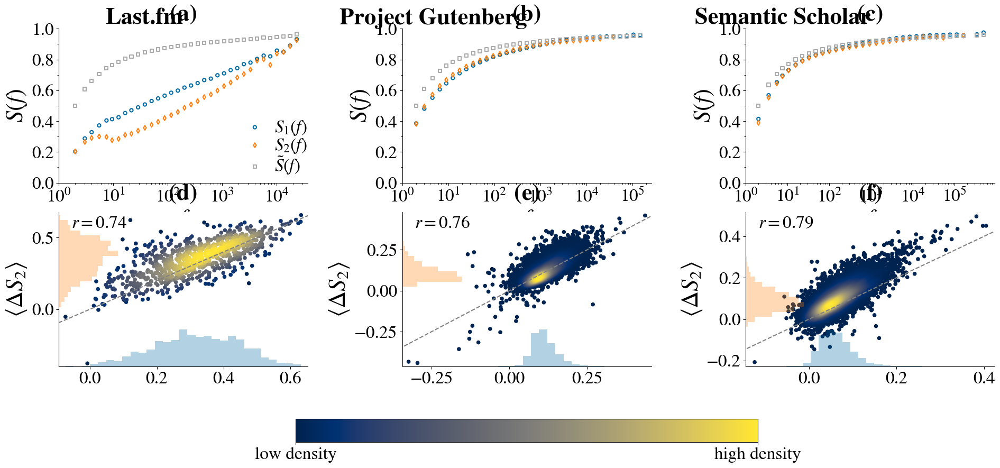

In [1008]:
fig = fig_4({key:data_with_entropy[key] for key in ['Last.fm', 'Project Gutenberg', 'Semantic Scholar']}, marker_size = 20, alpha_scatter = 1, 
          min_x = 0,
          max_x = 1,
          min_y = -0.1,
          max_y = 0.7,
          x_correlation_text = .05,
          y_correlation_text = .9,
          use_same_x_y_max_lim = False,
         )
fig.savefig(os.path.join(figures_folder, f"Fig4_entropy_beta_2.png"))
fig.savefig(os.path.join(figures_folder, f"Fig4_entropy_low_res_beta_2.pdf"),dpi=100)
fig.savefig(os.path.join(figures_folder, f"Fig4_entropy_beta_2.pdf"))

p-value pearson between None and $\langle\Delta S \rangle$ 2.4556612484583385e-06
p-value pearson between None and $\langle\Delta S_2 \rangle$ 4.596948264111428e-11
p-value pearson between None and $\langle\Delta S_2 \rangle$ 6.907131956589577e-158
p-value pearson between None and $\langle\Delta S \rangle$ 1.0797027291466465e-131
p-value pearson between None and $\langle\Delta S_2 \rangle$ 0.0
p-value pearson between None and $\langle\Delta S_2 \rangle$ 0.0
p-value pearson between None and $\langle\Delta S \rangle$ 8.185399436005836e-218
p-value pearson between None and $\langle\Delta S_2 \rangle$ 1.3305214081438763e-301
p-value pearson between None and $\langle\Delta S_2 \rangle$ 0.0
p-value pearson between $\beta_1$ and $\langle\Delta S \rangle$ 2.2839264783179714e-210
p-value pearson between $\beta_2$ and $\langle\Delta S_2 \rangle$ 0.0
p-value pearson between $\langle\Delta S \rangle$ and $\langle\Delta S_2 \rangle$ 1.6221697216721574e-23


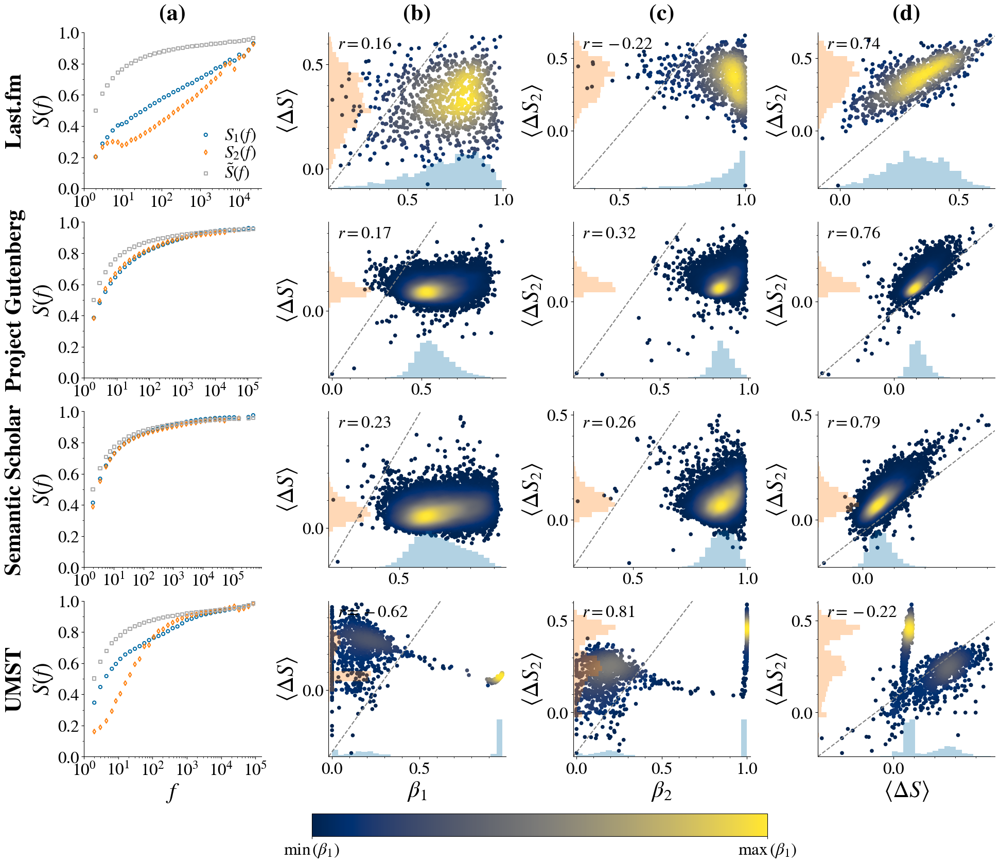

In [947]:
fig = fig_4(data_with_entropy, marker_size = 20, alpha_scatter = 1, 
          min_x = 0,
          max_x = 1,
          min_y = -0.1,
          max_y = 0.7,
          x_correlation_text = .05,
          y_correlation_text = .9,
          use_same_x_y_max_lim = False,
         )
fig.savefig(os.path.join(figures_folder, f"Fig4_entropy_beta_2.png"))
fig.savefig(os.path.join(figures_folder, f"Fig4_entropy_low_res_beta_2.pdf"),dpi=100)
fig.savefig(os.path.join(figures_folder, f"Fig4_entropy_beta_2.pdf"))

### Figures with UMST until nu = 10

p-value pearson between None and $\langle\Delta S \rangle$ 1.2034278963553053e-30
p-value pearson between None and $\langle\Delta S_2 \rangle$ 4.596948264111428e-11
p-value pearson between None and $\langle\Delta S_2 \rangle$ 6.907131956589577e-158
p-value pearson between None and $\langle\Delta S \rangle$ 1.2716750886150943e-07
p-value pearson between None and $\langle\Delta S_2 \rangle$ 0.0
p-value pearson between None and $\langle\Delta S_2 \rangle$ 0.0
p-value pearson between None and $\langle\Delta S \rangle$ 7.528467657611713e-33
p-value pearson between None and $\langle\Delta S_2 \rangle$ 9.692054212000998e-302
p-value pearson between None and $\langle\Delta S_2 \rangle$ 0.0
p-value pearson between $\beta_2$ and $\langle\Delta S \rangle$ 2.260517578240683e-19
p-value pearson between $\beta_2$ and $\langle\Delta S_2 \rangle$ 5.1269654548279894e-20
p-value pearson between $\langle\Delta S \rangle$ and $\langle\Delta S_2 \rangle$ 4.052796802407886e-112


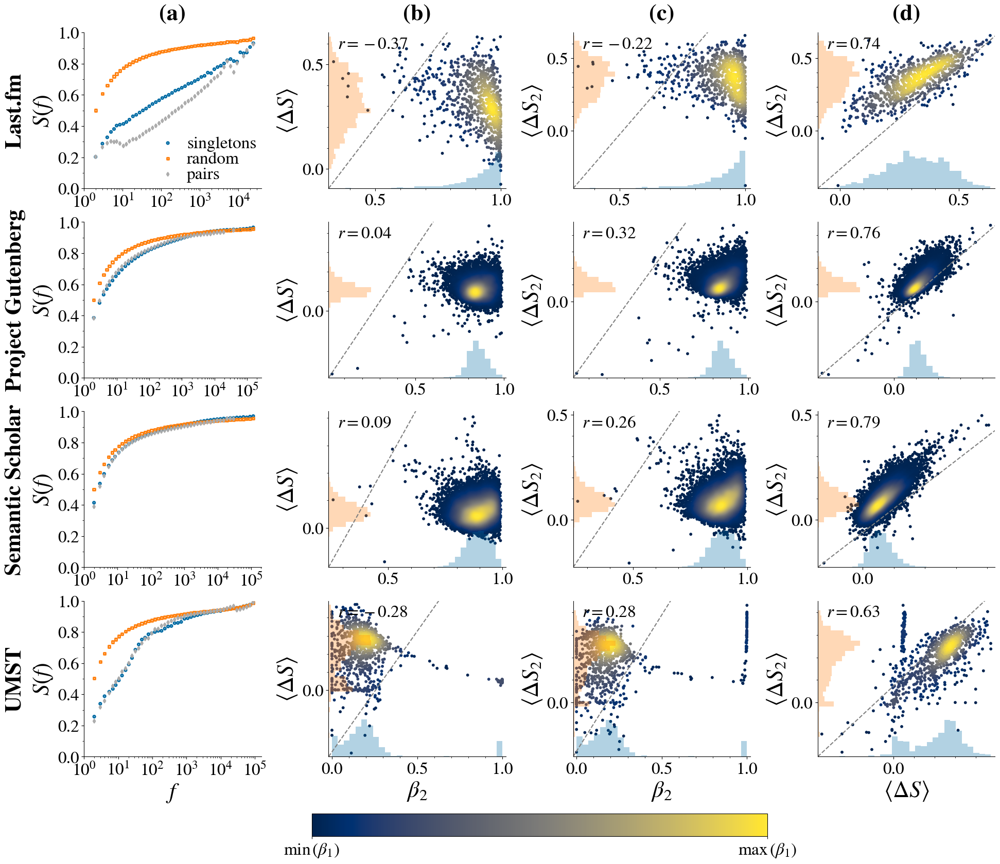

In [850]:
fig = fig_4(data_with_entropy, marker_size = 10, alpha_scatter = 1, 
          min_x = 0,
          max_x = 1,
          min_y = -0.1,
          max_y = 0.7,
          x_correlation_text = .05,
          y_correlation_text = .9,
          use_same_x_y_max_lim = False,
         )
fig.savefig(os.path.join(figures_folder, f"Fig4_entropy.png"))
fig.savefig(os.path.join(figures_folder, f"Fig4_entropy_low_res.pdf"),dpi=100)
fig.savefig(os.path.join(figures_folder, f"Fig4_entropy.pdf"))

p-value pearson between None and $\langle\Delta S \rangle$ 1.2034278963553053e-30
p-value pearson between None and $\langle\Delta S_2 \rangle$ 4.596948264111428e-11
p-value pearson between None and $\langle\Delta S_2 \rangle$ 6.907131956589577e-158
p-value pearson between None and $\langle\Delta S \rangle$ 1.2716750886150943e-07
p-value pearson between None and $\langle\Delta S_2 \rangle$ 0.0
p-value pearson between None and $\langle\Delta S_2 \rangle$ 0.0
p-value pearson between None and $\langle\Delta S \rangle$ 7.528467657611713e-33
p-value pearson between None and $\langle\Delta S_2 \rangle$ 9.692054212000998e-302
p-value pearson between None and $\langle\Delta S_2 \rangle$ 0.0
p-value pearson between $\beta_2$ and $\langle\Delta S \rangle$ 2.260517578240683e-19
p-value pearson between $\beta_2$ and $\langle\Delta S_2 \rangle$ 5.1269654548279894e-20
p-value pearson between $\langle\Delta S \rangle$ and $\langle\Delta S_2 \rangle$ 4.052796802407886e-112


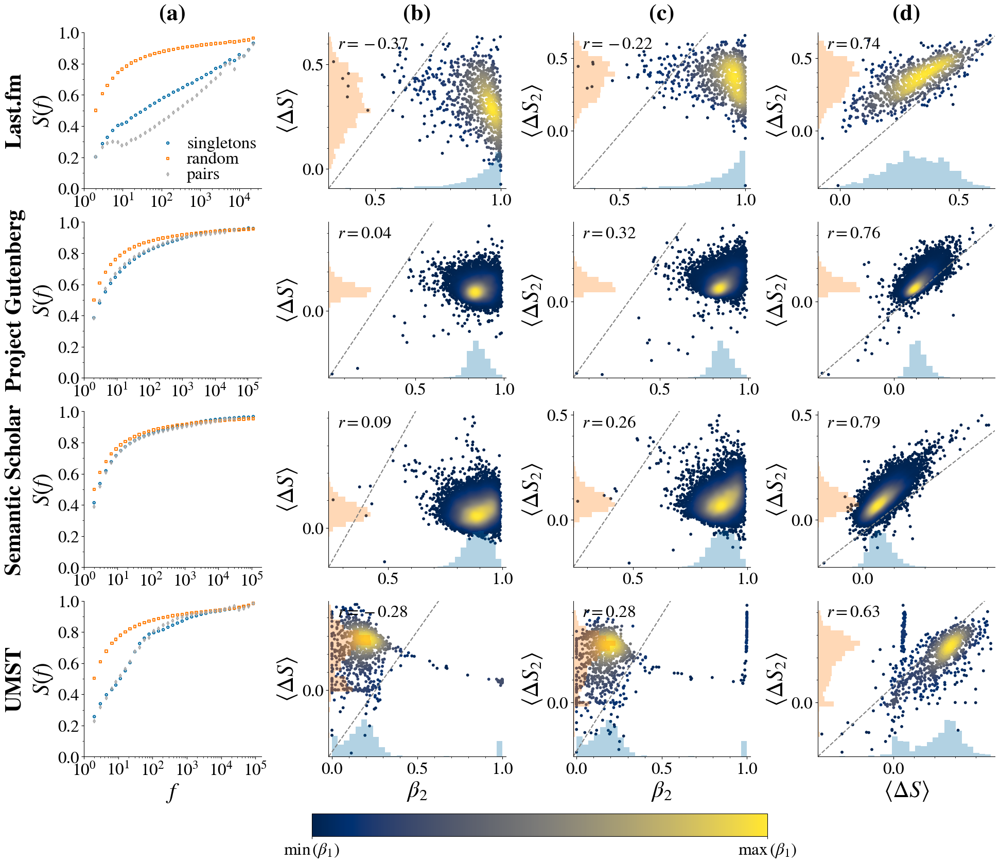

In [861]:
fig = fig_4(data_with_entropy, marker_size = 10, alpha_scatter = 1, 
#           min_x = 0,
#           max_x = 1,
#           min_y = -0.1,
#           max_y = 0.7,
          x_correlation_text = .05,
          y_correlation_text = .9,
          use_same_x_y_max_lim = False,
         )
fig.savefig(os.path.join(figures_folder, f"Fig4_entropy.png"))
fig.savefig(os.path.join(figures_folder, f"Fig4_entropy_low_res.pdf"),dpi=100)
fig.savefig(os.path.join(figures_folder, f"Fig4_entropy.pdf"))

### OLD Figures

p-value pearson between None and $\langle\Delta S \rangle$ 4.099423569830891e-06
p-value pearson between None and $\langle\Delta S \rangle$ 1.1071019303359732e-129
p-value pearson between None and $\langle\Delta S \rangle$ 2.5444345126675577e-249
p-value pearson between None and $\langle\Delta S \rangle$ 0.2283735308639822
p-value pearson between $\beta_2$ and $\langle\Delta S \rangle$ 5.6400797834081e-156


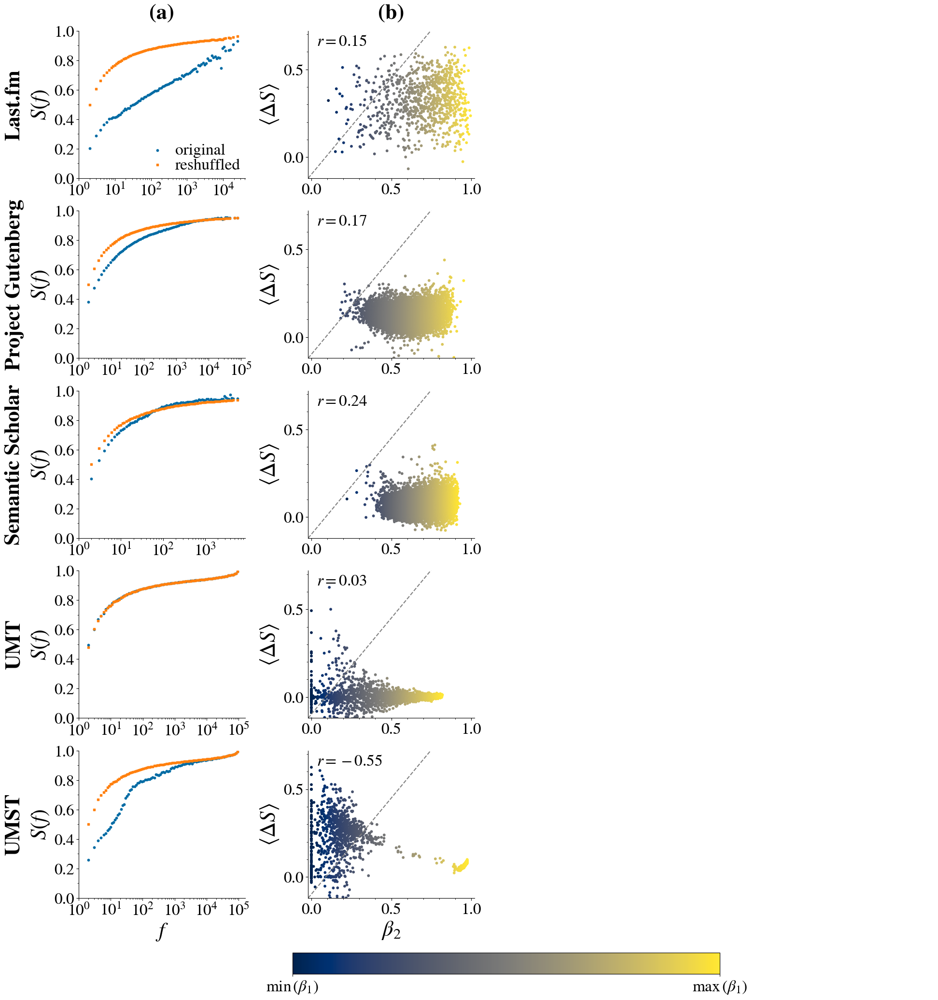

In [520]:
fig = fig_4(data_with_entropy, marker_size = 10, alpha_scatter = 1, 
          min_x = 0,
          max_x = 1,
          min_y = -0.1,
          max_y = 0.7,
          x_correlation_text = .05,
          y_correlation_text = .9,
          use_same_x_y_max_lim = False,
         )
fig.savefig(os.path.join(figures_folder, f"Fig4_entropy.png"))
fig.savefig(os.path.join(figures_folder, f"Fig4_entropy_low_res.pdf"),dpi=100)
fig.savefig(os.path.join(figures_folder, f"Fig4_entropy.pdf"))

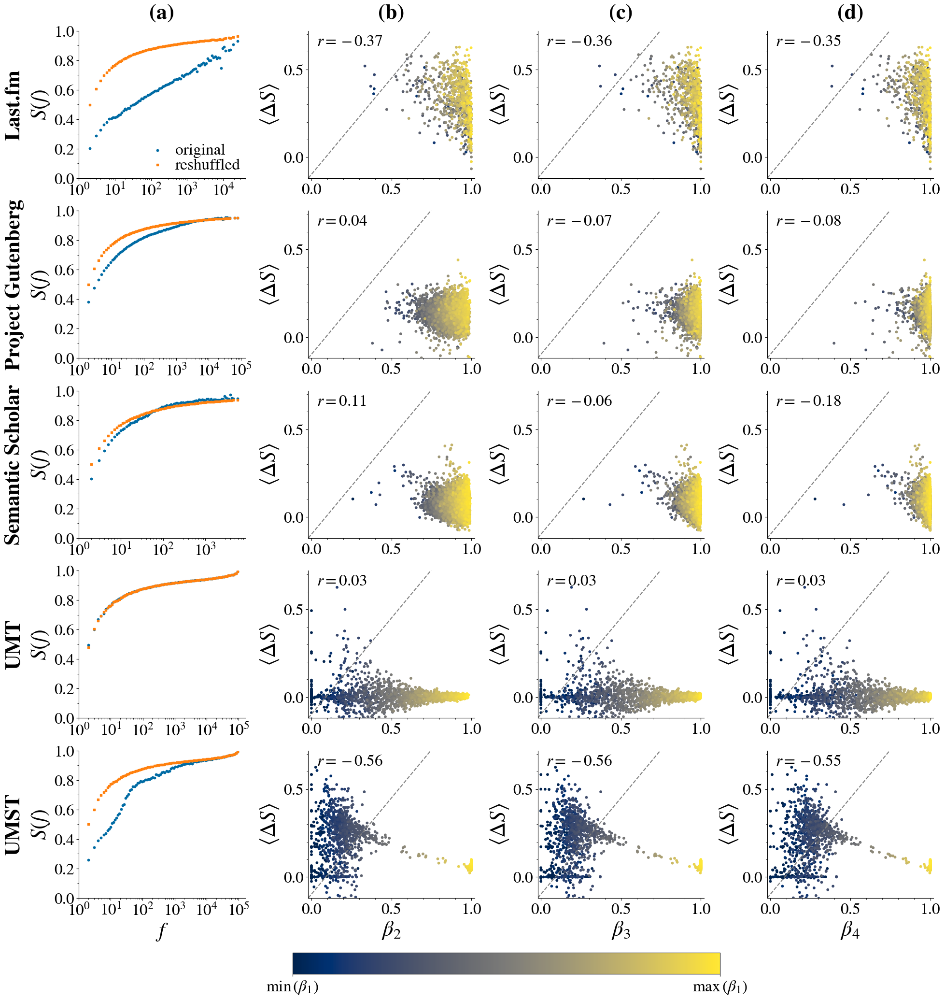

In [458]:
fig = fig_4(data_with_entropy, marker_size = 10, alpha_scatter = 1, 
          min_x = 0,
          max_x = 1,
          min_y = -0.1,
          max_y = 0.7,
          x_correlation_text = .05,
          y_correlation_text = .9,
          use_same_x_y_max_lim = False,
         )
fig.savefig(os.path.join(figures_folder, f"Fig4_entropy.png"))
fig.savefig(os.path.join(figures_folder, f"Fig4_entropy_low_res.pdf"),dpi=100)
fig.savefig(os.path.join(figures_folder, f"Fig4_entropy.pdf"))

# Figure5: UMT numeric vs analytical

## Load simulations

In [7]:
Tmax = int(1e7)
results_simulations_long = {}
print('Simulations found:')
for eta in [1,0.1]:#,0.01,0.001,0]:
    for rho in [1,2,3,4,5,10,20]:
        for nu in range(1,21):# min(21,int(rho/eta))):
            try:
                workdir = f"./data/UMST/simulations/analysis/rho_{rho:.5f}/nu_{nu}/Tmax_{Tmax}/eta_{eta:.5f}/"
                with open(f"{workdir}average_UMT_light_results.pkl",'rb') as fp:
                    tmp = pickle.load(fp)
                if eta not in results_simulations_long:
                    results_simulations_long[eta] = {}
                if rho not in results_simulations_long[eta]:
                    results_simulations_long[eta][rho] = {}
                results_simulations_long[eta][rho][nu] = tmp.copy()
                if tmp['ts'][-1] == Tmax - 1 or tmp['D_indices'][0] > 1:
                    for _ in ['ts', 'ts_geom', 'indices','indices_geom']:
                        tmp[_] = [1] + list(np.array(tmp[_])+1)
                    for _ in ['D_indices', 'D2_indices', 'D3_indices','D4_indices']:
                        tmp[_] = np.array([1] + list(np.array(tmp[_])+1))
                    
                    for _ in ['ts', 'ts_geom', 'indices','indices_geom']:
                        tmp[_] = [1] + list(np.array(tmp[_])+1)
                print('eta',eta, 'rho',rho, 'nu',nu, 'num_sim:', len(results_simulations_long[eta][rho][nu]['beta_loglogregr_indices_geom_list_finals']))
            except:
                pass

Simulations found:
eta 1 rho 4 nu 1 num_sim: 100
eta 1 rho 4 nu 2 num_sim: 100
eta 1 rho 4 nu 3 num_sim: 100
eta 1 rho 20 nu 1 num_sim: 100
eta 1 rho 20 nu 2 num_sim: 100
eta 1 rho 20 nu 3 num_sim: 100
eta 1 rho 20 nu 4 num_sim: 100
eta 1 rho 20 nu 5 num_sim: 100
eta 1 rho 20 nu 6 num_sim: 100
eta 1 rho 20 nu 7 num_sim: 100
eta 1 rho 20 nu 8 num_sim: 100
eta 1 rho 20 nu 9 num_sim: 100
eta 1 rho 20 nu 10 num_sim: 100
eta 1 rho 20 nu 11 num_sim: 100
eta 1 rho 20 nu 12 num_sim: 100
eta 1 rho 20 nu 13 num_sim: 100
eta 1 rho 20 nu 14 num_sim: 100
eta 1 rho 20 nu 15 num_sim: 100
eta 1 rho 20 nu 16 num_sim: 87
eta 1 rho 20 nu 17 num_sim: 59
eta 1 rho 20 nu 18 num_sim: 29
eta 1 rho 20 nu 19 num_sim: 13
eta 0.1 rho 4 nu 1 num_sim: 100
eta 0.1 rho 4 nu 2 num_sim: 100
eta 0.1 rho 4 nu 3 num_sim: 100
eta 0.1 rho 4 nu 4 num_sim: 100
eta 0.1 rho 4 nu 5 num_sim: 100
eta 0.1 rho 4 nu 6 num_sim: 100
eta 0.1 rho 4 nu 7 num_sim: 99
eta 0.1 rho 4 nu 8 num_sim: 91
eta 0.1 rho 4 nu 9 num_sim: 80
eta 0.1 rho

## Pairs

### Functions

In [8]:
def fit_to_str(a,b,c,d):
#     return r"$%.1f t^{%.2f+%.1f/(%.1f+\log_2(t))}$"%(a,b,c,d)
    return r"$%.1f t^{%.2f+\frac{%.1f}{%.1f+\log_2(t)}}$"%(a,b,c,d)

def get_dD2(analytic_data, nu, rho, ax, fontsize=16, print_all_legend_labels = True, use_approximated=True):
    """
    Takes the analytic data and finds a fit of the type a * x ** (b+c/(d+np.log2(x))). 
    If it does not give ERROR (a), it does not impose any constraint on b.
    """
    xs = np.array(list(analytic_data.t))
    Cs = np.array(list(analytic_data.data))
    beta_1 = float(nu)/rho
    b = (rho - nu)**beta_1
    factors = b * beta_1 * (xs ** (beta_1 - 1))
    ys = 2*factors - factors*factors + (1-factors)**2 * Cs
    if use_approximated:
        ys = 2*factors + Cs

    e=1
    f=0
    
    def func(x,a,b,c,d):
        return a * x ** (b+c/(d+np.log2(e*x))) + f
    def func_log(x,a,b,c,d):
        return np.log2(a) + x * (b+c/(d+np.log2(e*2**x))) 
    xs_log = np.log2(xs)
    ys_log = np.log2(ys)
    try:
        popt_log_B, pcov = curve_fit(func_log, xs_log, ys_log,p0=[1,nu/rho-1,1,1], bounds=([0,-1,0,0], [np.inf,0,np.inf,np.inf]))
    except RuntimeError as er:
        print('ERROR (a)',er)
        popt_log_B, pcov = curve_fit(func_log, xs_log, ys_log,bounds=([0,nu/rho-0.000000001-1,0,0.1], [np.inf,nu/rho+0.000000001-1,np.inf,np.inf]))
    a,b,c,d = popt_log_B
    b_old = b
    residuals = ys - func(xs, *popt_log_B)
    ss_res = np.sqrt(np.sum(residuals**2)/(len(residuals)-2))
    residuals = ys_log - func_log(xs_log, *popt_log_B)
    ss_res_log = np.sqrt(np.sum(residuals**2)/(len(residuals)-2))
    R_squared = 1-(ss_res**2)/np.var(ys)
    R_squared_log = 1-(ss_res_log**2)/np.var(ys_log)

    exponents_log = np.array([b+c*d/((d+np.log2(e*x))**2) for x in xs])

    return popt_log_B

In [22]:
def exp_to_str(a,b,c,d):
#    return r"$%.2f+%.1f/(%.1f+\log_2(t))$"%(b,c,d)
    return r"$%.2f+\frac{%.1f}{%.1f+\log_2(t)}$"%(np.round(b,decimals=2),np.round(c, decimals=1),np.round(d, decimals=1))
    
def get_D2(analytic_data,mean_urn, popt_log_B, nu, rho, ax, expMin=0, expMax=16, fontsize=16, 
            print_all_legend_labels = True,
            use_odeint = False,
           ):
    """
    Takes the fitted analytic function to dD2 analytic data and integrates it analytically.
    Then, it is both fitted with the power law function as in the simulations, and fitted to a similar function type as done with dD2, 
    i.e. of the type a * x ** (b+c/(d+np.log2(x))).  If it does not give ERROR (b), it does not impose any constraint on b.
    
    A similar analytical fit is done for the data from the simulations (using ts_geom >= 10**exmMin and D2 in loglog), 
    i.e. of the type a * x ** (b+c/(d+np.log2(x))).  If it does not give ERROR (c), it does not impose any constraint on b.
    
    if use_odeint == False, instead of integrating analytically, the new function is given by the same parameters obtained for dD2, 
    with just b += 1 and a /= b
    """
    from scipy.integrate import odeint
    e=1
    f=0
    def func(x,a,b,c,d):
        return a * x ** (b+c/(d+np.log2(e*x))) + f
    t0 = 1 
    y0 = 1 
    ts_system = np.geomspace(t0,10**expMax,10000)
    if use_odeint == True:
        # y'(t) = func(t,a,b,c,d)
        def system(y, t, *popt_log_B):
            dy = [func(t,*popt_log_B)]
            return dy
        a,b,c,d = popt_log_B
        sol = odeint(system, y0 , ts_system, args=(a,b,c,d))
        sol = np.transpose(sol)[0]
    else:
        a,b,c,d = popt_log_B
        b += 1
        a /= b
        sol = func(ts_system,a,b,c,d)
        popt_log = (a,b,c,d)
        sol = sol - sol[0] + 1
    
    last_to_check = 100
    mean_urn["new_analytic2_loglogregr_points"] = np.array([powerLawRegrPoints(ts_system[max(0,i-last_to_check):i], sol[max(0,i-last_to_check):i])[0]
                                               for i in range(last_to_check,len(ts_system))])
    mean_urn["new_analytic2_loglogregr_points_xs"] = ts_system[last_to_check:]

    if print_all_legend_labels:
        label1 = r"equation"
    else:
        label1 = ""

    def func_log(x,a,b,c,d):
        return np.log2(a) + x * (b+c/(d+np.log2(e*2**x))) 
    ts_log = np.log2(ts_system)
    sol_log = np.log2(sol)
    if use_odeint == True:
        try:
            raise RuntimeError
            popt_log, pcov = curve_fit(func_log, ts_log, sol_log,p0=[1,float(nu)/rho,1,1], bounds=([0,0,0,0], [np.inf,1,np.inf,np.inf]))
        except RuntimeError as er:
            print('ERROR (b)',er)
            popt_log, pcov = curve_fit(func_log, ts_log, sol_log,p0=[1,float(nu)/rho,1,1],bounds=([0,float(nu)/rho-0.000000001,0,0.1], [np.inf,nu/rho+0.000000001,np.inf,np.inf]))
        a,b,c,d = popt_log
    b_free = b
    exp_law_free = exp_to_str(a,b,c,d)
    residuals = sol - func(ts_system, *popt_log)
    ss_res = np.sqrt(np.sum(residuals**2)/(len(residuals)-2))
    residuals = sol_log - func_log(ts_log, *popt_log)
    ss_res_log = np.sqrt(np.sum(residuals**2)/(len(residuals)-2))
    R_squared = 1-(ss_res**2)/np.var(sol)
    R_squared_log = 1-(ss_res_log**2)/np.var(sol_log)
    label2 = 'an.fit: %s'%fit_to_str(a,b,c,d) + "\n"+r"$SER$=%.2f"%ss_res_log + r", $R^2=%.2f$"%(R_squared_log)
    print(label2)

    exponents_eq = np.array([b+c*d/((d+np.log2(e*x))**2) for x in ts_system])
    
    mean_urn['eq_fit_beta2_xs'] = ts_system
    mean_urn['eq_fit_beta2'] = exponents_eq

    
    if print_all_legend_labels:
        label3 = r"simulation"
    else:
        label3 = ""
    
    def func_log(x,a,b,c,d):
        return np.log2(a) + x * (b+c/(d+np.log2(e*2**x))) 
    ts_log = np.array([np.log2(_) for _ in mean_urn["ts_geom"][1:]-1 if np.log10(_) >= expMin])
    D2_indices_log = np.array([np.log2(_) for i_,_ in enumerate(mean_urn["D2_indices"][mean_urn['indices_geom']][1:]) if np.log10(mean_urn["ts_geom"][1:]-1)[i_] >= expMin])
    try:
        raise RuntimeError
        popt_sim, pcov = curve_fit(func_log, ts_log, D2_indices_log,p0=[1,float(nu)/rho,1,1],bounds=([0,0,0,0], [np.inf,1,np.inf,np.inf]))
    except RuntimeError as er:
        print('ERROR (c)',er)
        popt_sim, pcov = curve_fit(func_log, ts_log, D2_indices_log,p0=[1,float(nu)/rho,1,1],bounds=([0,nu/rho-0.000000001,0,0], [np.inf,nu/rho+0.000000001,np.inf,np.inf]))
    a,b,c,d = popt_sim 
    b_sim = b
    exp_law_sim = exp_to_str(a,b,c,d)
    residuals = mean_urn["D2_indices"][mean_urn['indices_geom']][1:] - func(mean_urn["ts_geom"][1:]-1, *popt_sim)
    ss_res = np.sqrt(np.sum(residuals**2)/(len(residuals)-2))
    residuals = D2_indices_log - func_log(ts_log, *popt_sim)
    ss_res_log = np.sqrt(np.sum(residuals**2)/(len(residuals)-2))
    R_squared = 1-(ss_res**2)/np.var(mean_urn["D2_indices"][mean_urn['indices_geom']][1:])
    R_squared_log = 1-(ss_res_log**2)/np.var(D2_indices_log)
    label4 = 'an.fit: %s'%fit_to_str(a,b,c,d) + "\n"+r"$SER$=%.2f"%ss_res_log + r", $R^2=%.2f$"%(R_squared_log)
    print(label4)
    exponents_sim = np.array([b+c*d/((d+np.log2(e*x))**2) for x in ts_system]) # mean_urn["ts_geom"][1:]-1])
    
    mean_urn['sim_fit_beta2_xs'] = ts_system # mean_urn["ts_geom"][1:]-1])
    mean_urn['sim_fit_beta2'] = exponents_sim

    return mean_urn, ts_system, exponents_eq, exponents_sim, exp_law_free, exp_law_sim

In [29]:
def final_plot_fits(urn, nu, rho, ax, exp_law_free, exp_law_sim,fontsize=16, print_all_legend_labels = True, max_num_major_xticks = 5):
    ax.axhline(nu/rho,ls="--",color="gray",lw=3,label=r"$\nu/\rho=%.2f$"%(nu/rho))
#     ax.plot(urn["ts_geom"][100:]-1, np.array(urn["beta2_loglogregr_indices_geom"])[100:],lw=3, color = CB_color_cycle[1], 
#             label = "power-law fit simul." if print_all_legend_labels else None) # label = r"$\beta_2(t)$ (sim. p.l. fit)")
    ax.plot(urn["sim_fit_beta2_xs"], np.array(urn["sim_fit_beta2"]),ls='-',lw=3, color = None, #"red", #CB_color_cycle[1], 
            label = f"simulation" if print_all_legend_labels else None)
#             label = fr"{exp_law_sim}") # label = r"$\beta_2(t)$ (sim. an. fit)")
#     ax.plot(urn["new_analytic2_loglogregr_points_xs"],np.array(urn["new_analytic2_loglogregr_points"]),lw=3, color = CB_color_cycle[0], 
#             label = "power-law fit Eq. 9" if print_all_legend_labels else None) # label = r"$\beta_2(t)$ (eq. p.l. fit)")
    ax.plot(urn["eq_fit_beta2_xs"], np.array(urn["eq_fit_beta2"]),ls='-',lw=3, color = None, #"blue", #CB_color_cycle[0], 
            label = f"analytical" if print_all_legend_labels else None)
#             label = fr"{exp_law_free}") # label = r"$\beta_2(t)$ (eq. an. fit)")
#     if print_all_legend_labels:
    if nu/rho > 0.4:
        ax.legend(fontsize=fontsize, loc = "lower right", bbox_to_anchor = (1,-0.04), labelspacing = 0.3,)
    else:
        print('CCC')
        ax.legend(fontsize=fontsize, loc = "upper right", bbox_to_anchor = (1,1.04), labelspacing = 0.3,)

    
    ax.set_xlim((100,Tmax))
    ax.set_ylim((0,1.01))
    ax.set_xscale("log")
    ax.set_xlabel(r"$t$")
    ax.set_ylabel(r"$\beta_2(t)$" if print_all_legend_labels else None)
    # Impose xticks
    locmaj = matplotlib.ticker.LogLocator(base=10,numticks=max_num_major_xticks) 
    ax.xaxis.set_major_locator(locmaj)
    # locmin = matplotlib.ticker.LogLocator(base=10.0,subs=(np.arange(0.1,1,0.1)),numticks=20)
    locmin = matplotlib.ticker.LogLocator(base=10.0,numticks=100)
    ax.xaxis.set_minor_locator(locmin)
    ax.xaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
    return None

In [30]:
def simulation_vs_analytic_plot(rho, results_simulations,
                                fontsize_legend=16, lower_bound = 1e3, upper_bound = 1e7, 
                                use_approximated=True, expMin=3, expMax=7, 
                                max_num_major_xticks = 5, 
                                use_odeint=False,):
    ncols = rho - 1
    Tmax = int(1e7)
    eta = 1
    letters = "ABCDEFGHIJKLMNOPQRSTUVWXYZ".lower()
    fig, axes = plt.subplots(1,rho-1,figsize=(width_fig*ncols/3,width_fig*2/3/3*9/10), gridspec_kw={'hspace':.35,'wspace':0.25})
    
    
    for counter,nu in enumerate(range(1,rho)):
        print(nu)
        ax = axes[counter]
        if counter== 0:
            print_all_legend_labels = True
        else:
            print_all_legend_labels = False
        mean_urn = results_simulations[eta][rho][nu]
        indices = mean_urn["indices"]
        indices_geom = mean_urn["indices_geom"]
        ts = mean_urn["ts"]
        ts_geom = mean_urn["ts_geom"]

        if expMax <= 7:
            analytic_data = pd.read_csv(f"./data/UMST/Analytic_UMT/Analytic_data_independent/rho{rho}_nu{nu}_expMin{expMin}_expMax{expMax}_data.csv",names=["t","data"])
        else:
            analytic_data = pd.read_csv(f"./data/UMST/Analytic_UMT/Analytic_data_independent/rho{rho}_nu{nu}_expMin{3}_expMax{7}_data.csv",names=["t","data"])
            analytic_data2 = pd.read_csv(f"./data/UMST/Analytic_UMT/Analytic_data_independent/rho{rho}_nu{nu}_expMin{7}_expMax{10}_data.csv",names=["t","data"])
            analytic_data2.drop(analytic_data2.index[0], inplace=True)
            analytic_data = analytic_data.append(analytic_data2, ignore_index=True)
            if expMax > 10:
                analytic_data2 = pd.read_csv(f"./data/UMST/Analytic_UMT/Analytic_data_independent/rho{rho}_nu{nu}_expMin{10}_expMax{20}_data.csv",names=["t","data"])
                analytic_data2.drop(analytic_data2.index[0], inplace=True)
                analytic_data = analytic_data.append(analytic_data2, ignore_index=True)
            analytic_data = analytic_data[analytic_data.t <= 10**expMax]
        
        popt_log_B = get_dD2(analytic_data, nu, rho, ax, fontsize=fontsize_legend, print_all_legend_labels=True,use_approximated=use_approximated)
        results_simulations[eta][rho][nu]['parameters_dD2'] = popt_log_B

        mean_urn, ts_system, exponents_eq, exponents_sim, exp_law_eq, exp_law_sim = get_D2(
            analytic_data, mean_urn, popt_log_B, nu, rho, ax, 
            expMin=expMin, expMax=expMax,
            fontsize=fontsize_legend, 
            print_all_legend_labels=print_all_legend_labels,
            use_odeint = use_odeint, 
        )

        final_plot_fits(
            mean_urn, nu, rho, ax, exp_law_eq, exp_law_sim,
            fontsize=fontsize_legend, 
            print_all_legend_labels=print_all_legend_labels,
            max_num_major_xticks = max_num_major_xticks, 
        )
        
#         if nu != 1:
#             ax.legend( [r"$\nu/\rho=%.2f$"%(nu/rho)], loc='lower right', fontsize=fontsize_legend, )#[ax.plot([],[],ls="--",color="gray",lw=3)],
        ax.text(0.05, 1, f"{letters[counter]}", transform=ax.transAxes,fontweight='bold', horizontalalignment='left', verticalalignment='bottom')
        ax.set_xlim(lower_bound, upper_bound)
#         ax.set_xticks([10**3, 10**5, 10**7])
        counter += 1
        
    if use_odeint == True:
        fig.savefig(os.path.join(figures_folder, f"Fig5_UMT_numeric_vs_analytic_rho_%d_expMin_%d_expMax_%d_odeint.png"%(rho, expMin, expMax)))
        fig.savefig(os.path.join(figures_folder, f"Fig5_UMT_numeric_vs_analytic_rho_%d_expMin_%d_expMax_%d_odeint.pdf"%(rho, expMin, expMax)))
    else:
        fig.savefig(os.path.join(figures_folder, f"Fig5_UMT_numeric_vs_analytic_rho_%d_expMin_%d_expMax_%d_from_dD2.png"%(rho, expMin, expMax)))
        fig.savefig(os.path.join(figures_folder, f"Fig5_UMT_numeric_vs_analytic_rho_%d_expMin_%d_expMax_%d_from_dD2.pdf"%(rho, expMin, expMax)))
        
    return(results_simulations)

### Figures

expMax must be 16, because after 16 there is a change in behaviour in the numerical results of the integral done in Mathematica (referring to $C(t)$ in the main paper), either because of working precision errors or similar issues.

1
ERROR (b) 
an.fit: $1.1 t^{0.25+\frac{5.5}{18.2+\log_2(t)}}$
$SER$=0.01, $R^2=1.00$
ERROR (c) 
an.fit: $1.0 t^{0.25+\frac{7.2}{16.1+\log_2(t)}}$
$SER$=0.01, $R^2=1.00$
CCC
2
ERROR (b) 
an.fit: $1.6 t^{0.50+\frac{6.5}{14.6+\log_2(t)}}$
$SER$=0.07, $R^2=1.00$
ERROR (c) 
an.fit: $0.6 t^{0.50+\frac{7.5}{18.3+\log_2(t)}}$
$SER$=0.01, $R^2=1.00$
3
ERROR (b) 
an.fit: $0.7 t^{0.75+\frac{8.6}{13.4+\log_2(t)}}$
$SER$=0.05, $R^2=1.00$
ERROR (c) 
an.fit: $0.7 t^{0.75+\frac{8.1}{46.4+\log_2(t)}}$
$SER$=0.00, $R^2=1.00$


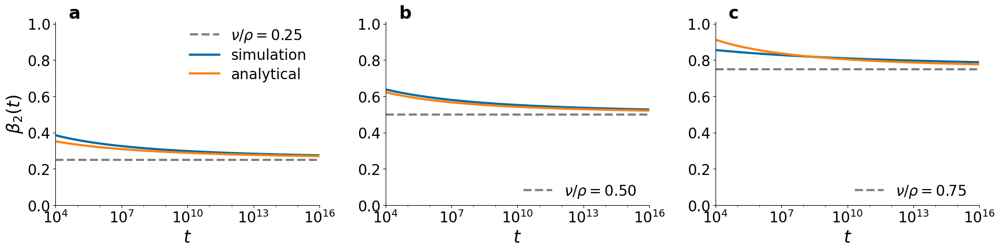

In [31]:
rho = 4
expMin = 2
expMax = 16
results_simulations_long = simulation_vs_analytic_plot(
    rho, results_simulations_long,fontsize_legend=20,
    lower_bound = 10**4, upper_bound = 10**expMax,
    expMin=expMin,expMax=expMax,
    use_odeint=True, 
    max_num_major_xticks = 5, 
    use_approximated=True,
)

## Figure SI: more details

### Pairs

#### Functions

In [157]:
def fit_to_str(a,b,c,d):
#     return r"$%.1f t^{%.2f+%.1f/(%.1f+\log_2(t))}$"%(a,b,c,d)
    return r"$%.1f t^{%.2f+\frac{%.1f}{%.1f+\log_2(t)}}$"%(a,b,c,d)

def plot_dD2_SI(analytic_data, nu, rho, ax, fontsize=16, print_all_legend_labels = True, use_approximated=True):
    xs = np.array(list(analytic_data.t))
    Cs = np.array(list(analytic_data.data))
    beta_1 = float(nu)/rho
    b = (rho - nu)**beta_1
    factors = b * beta_1 * (xs ** (beta_1 - 1))
    ys = 2*factors - factors*factors + (1-factors)**2 * Cs
    if use_approximated:
        ys = 2*factors + Cs

    e=1
    f=0
    
    def func(x,a,b,c,d):
        return a * x ** (b+c/(d+np.log2(e*x))) + f
    if print_all_legend_labels:
        ax.plot(xs,ys, lw=3, label=r"$\nu = %d, \, \rho = %d$"%(nu,rho), color = CB_color_cycle[0],)
    else:
        ax.plot(xs,ys, lw=3, color = CB_color_cycle[0],) 
    def func_log(x,a,b,c,d):
        return np.log2(a) + x * (b+c/(d+np.log2(e*2**x))) 
    xs_log = np.log2(xs)
    ys_log = np.log2(ys)
    try:
        popt_log_B, pcov = curve_fit(func_log, xs_log, ys_log,p0=[1,nu/rho-1,1,1], bounds=([0,-1,0,0], [np.inf,0,np.inf,np.inf]))
    except RuntimeError as er:
        print('ERROR (a)',er)
        popt_log_B, pcov = curve_fit(func_log, xs_log, ys_log,bounds=([0,nu/rho-0.000000001-1,0,0.1], [np.inf,nu/rho+0.000000001-1,np.inf,np.inf]))
    a,b,c,d = popt_log_B
    b_old = b
    residuals = ys - func(xs, *popt_log_B)
    ss_res = np.sqrt(np.sum(residuals**2)/(len(residuals)-2))
    residuals = ys_log - func_log(xs_log, *popt_log_B)
    ss_res_log = np.sqrt(np.sum(residuals**2)/(len(residuals)-2))
    R_squared = 1-(ss_res**2)/np.var(ys)
    R_squared_log = 1-(ss_res_log**2)/np.var(ys_log)
    ax.plot(xs, func(xs,*popt_log_B), '--', color = "blue", #CB_color_cycle[0],
             label=fit_to_str(a,b,c,d) + 
            "\n"+r"$SER$=%.2f"%ss_res_log + r", $R^2=%.2f$"%(R_squared_log))

    exponents_log = np.array([b+c*d/((d+np.log2(e*x))**2) for x in xs])

    ax.set_xscale("log")
    ax.set_yscale("log")
    if nu/rho < 0.:
        ax.legend(fontsize=fontsize, loc = "upper right") 
    else:
        ax.legend(fontsize=fontsize, loc = "lower left")
    ax.set_xlabel(r"$t$")
    ax.set_ylabel(r"$\mathrm{d}D_2(t)/\mathrm{d}t}$")
    
    return popt_log_B

In [181]:
def exp_to_str(a,b,c,d):
#     return r"$%.2f+%.1f/(%.1f+\log_2(t))$"%(b,c,d)
    return r"$%.2f+\frac{%.1f}{%.1f+\log_2(t)}$"%(np.round(b,decimals=2),np.round(c, decimals=1),np.round(d, decimals=1))
    
def plot_D2_SI(analytic_data,mean_urn, popt_log_B, nu, rho, ax, expMax=16, fontsize=16, 
            print_all_legend_labels = True,
            use_odeint = False,
           ):
    def func(x,a,b,c,d,e=1,f=0):#,x2):
        return a * x ** (b+c/(d+np.log2(e*x))) + f
    t0 = 1 
    y0 = 1 
    e=1
    f=0
    ts_system = np.geomspace(t0,10**expMax,10000)
    if use_odeint == True:
        # y'(t) = func(t,a,b,c,d)
        def system(y, t, *popt_log_B):
            dy =  [func(t,*popt_log_B)]
            return dy
        a,b,c,d = popt_log_B
        sol = odeint(system, y0 , ts_system, args=(a,b,c,d))
        sol = np.transpose(sol)[0]
    else:
        a,b,c,d = popt_log_B
        b += 1
        a /= b
        sol = func(ts_system,a,b,c,d)
        popt_log = (a,b,c,d)
        sol = sol - sol[0] + 1
    
    last_to_check = 100
    mean_urn["new_analytic2_loglogregr_points"] = np.array([powerLawRegrPoints(ts_system[max(0,i-last_to_check):i], sol[max(0,i-last_to_check):i])[0]
                                               for i in range(last_to_check,len(ts_system))])
    mean_urn["new_analytic2_loglogregr_points_xs"] = ts_system[last_to_check:]


    if print_all_legend_labels:
        label1 = r"equation"
    else:
        label1 = ""
    p1, = ax.plot(ts_system,sol, label=label1, lw=3, color = CB_color_cycle[0],)
    def func_log(x,a,b,c,d):
        return np.log2(a) + x * (b+c/(d+np.log2(e*2**x))) 
    ts_log = np.log2(ts_system)
    sol_log = np.log2(sol)
    if use_odeint == True:
        try:
            popt_log, pcov = curve_fit(func_log, ts_log, sol_log,p0=[1,float(nu)/rho,1,1], bounds=([0,0,0,0], [np.inf,1,np.inf,np.inf]))
        except RuntimeError as er:
            print('ERROR (b)',er)
            popt_log, pcov = curve_fit(func_log, ts_log, sol_log,p0=[1,float(nu)/rho,1,1],bounds=([0,float(nu)/rho-0.000000001,0,0.1], [2,nu/rho+0.000000001,100,100]))
        a,b,c,d = popt_log
    b_free = b
    exp_law_free = exp_to_str(a,b,c,d)
    residuals = sol - func(ts_system, *popt_log)
    ss_res = np.sqrt(np.sum(residuals**2)/(len(residuals)-2))
    residuals = sol_log - func_log(ts_log, *popt_log)
    ss_res_log = np.sqrt(np.sum(residuals**2)/(len(residuals)-2))
    R_squared = 1-(ss_res**2)/np.var(sol)
    R_squared_log = 1-(ss_res_log**2)/np.var(sol_log)
    label2 = fit_to_str(a,b,c,d) + "\n"+r"$SER$=%.2f"%ss_res_log + r", $R^2=%.2f$"%(R_squared_log)
    p2, = ax.plot(ts_system, func(ts_system,*popt_log), '--', color = "blue", #CB_color_cycle[0], 
                  label=label2)
    exponents_eq = np.array([b+c*d/((d+np.log2(e*x))**2) for x in ts_system])
    
    mean_urn['eq_fit_beta2_xs'] = ts_system
    mean_urn['eq_fit_beta2'] = exponents_eq

    
    if print_all_legend_labels:
        label3 = r"simulation"
    else:
        label3 = ""
    
    p3, = ax.plot(mean_urn["ts_geom"][1:]-1,mean_urn["D2_indices"][mean_urn['indices_geom']][1:], label=label3, lw=3, color = CB_color_cycle[1],)
    def func_log(x,a,b,c,d):
        return np.log2(a) + x * (b+c/(d+np.log2(e*2**x))) 
    ts_log = np.log2(mean_urn["ts_geom"][1:]-1)
    D2_indices_log = np.log2(mean_urn["D2_indices"][mean_urn['indices_geom']][1:])
    try:
        raise RuntimeError
        popt_sim, pcov = curve_fit(func_log, ts_log[30:], D2_indices_log[30:],p0=[1,float(nu)/rho,1,1],bounds=([0,0,0,0], [2,1,1000,1000]))
    except RuntimeError as er:
        print('ERROR (c)',er)
        popt_sim, pcov = curve_fit(func_log, ts_log, D2_indices_log,p0=[1,float(nu)/rho,1,1],bounds=([0,nu/rho-0.000000001,0,0], [np.inf,nu/rho+0.000000001,np.inf,np.inf]))
    a,b,c,d = popt_sim 
    b_sim = b
    exp_law_sim = exp_to_str(a,b,c,d)
    residuals = mean_urn["D2_indices"][mean_urn['indices_geom']][1:] - func(mean_urn["ts_geom"][1:]-1, *popt_sim)
    ss_res = np.sqrt(np.sum(residuals**2)/(len(residuals)-2))
    residuals = D2_indices_log - func_log(ts_log, *popt_sim)
    ss_res_log = np.sqrt(np.sum(residuals**2)/(len(residuals)-2))
    R_squared = 1-(ss_res**2)/np.var(mean_urn["D2_indices"][mean_urn['indices_geom']][1:])
    R_squared_log = 1-(ss_res_log**2)/np.var(D2_indices_log)
    label4 = fit_to_str(a,b,c,d) + "\n"+r"$SER$=%.2f"%ss_res_log + r", $R^2=%.2f$"%(R_squared_log)
    # USE same as system
#     p4, = ax.plot(mean_urn["ts_geom"], func(mean_urn["ts_geom"],*popt_sim), '--', color = "red", #CB_color_cycle[1],
    p4, = ax.plot(ts_system, func(ts_system,*popt_sim), '--', color = "red", #CB_color_cycle[1],
             label=label4)
    exponents_sim = np.array([b+c*d/((d+np.log2(e*x))**2) for x in ts_system])# mean_urn["ts_geom"]])
    
    mean_urn['sim_fit_beta2_xs'] = ts_system# mean_urn['ts_geom']
    mean_urn['sim_fit_beta2'] = exponents_sim

#     # REPEAT FOR D
    
#     ts_log = np.log2(mean_urn["ts_geom"])
#     D_indices_log = np.log2(mean_urn["D_indices"][mean_urn["indices_geom"]])
#     # popt_sim, pcov = curve_fit(func_log, ts_log, D2_indices_log,bounds=([0,0,0,0], [10,1,100,100]))
#     try:
#         raise RuntimeError
# #         popt_sim, pcov = curve_fit(func_log, ts_log, D2_indices_log,p0=[1,nu/rho,1,1],bounds=([0,0,0,0], [1,1,np.inf,np.inf]))
#         popt_sim, pcov = curve_fit(func_log, ts_log, D_indices_log,p0=[1,nu/rho,1,1],bounds=([0.9,0,0,0], [1,np.inf,np.inf,np.inf]))
#     except RuntimeError as er:
#         print('ERROR (d)',er)
#         popt_sim, pcov = curve_fit(func_log, ts_log, D_indices_log,p0=[1,nu/rho,1,1],bounds=([0,nu/rho-0.000000001,0,0], [np.inf,nu/rho+0.000000001,np.inf,np.inf]))
#     a,b,c,d = popt_sim # [2.30976089, -0.52648358,  4.94643769,  7.35037396]
#     b_sim = b
#     exp_law_sim = exp_to_str(a,b,c,d)
# #     print(popt_sim)
#     residuals = mean_urn["D2_indices"][mean_urn["indices_geom"]] - func(mean_urn["ts_geom"], *popt_sim)
#     ss_res = np.sqrt(np.sum(residuals**2)/(len(residuals)-2))
#     residuals = D_indices_log - func_log(ts_log, *popt_sim)
#     ss_res_log = np.sqrt(np.sum(residuals**2)/(len(residuals)-2))
#     R_squared = 1-(ss_res**2)/np.var(mean_urn["D2_indices"][mean_urn["indices_geom"]])
#     R_squared_log = 1-(ss_res_log**2)/np.var(D2_indices_log)
#     labelD = 'fit: %s'%fit_to_str(a,b,c,d) + "\n"+r"$SER$=%.2f"%ss_res_log + r", $R^2=%.2f$"%(R_squared_log)
#     exponents_simD = np.array([b+c*d/((d+np.log2(e*x))**2) for x in ts_system])# mean_urn["ts_geom"]])

#     mean_urn['sim_fit_beta_xs'] = ts_system# mean_urn["ts_geom"]
#     mean_urn['sim_fit_beta'] = exponents_simD
    
    
    ax.set_xlim(left=100, right = 1e7)
    ax.set_ylim(bottom=1, top=1e7)
    
    if nu/rho < 0.4:
        ax.legend(fontsize=fontsize, loc='upper left', bbox_to_anchor=(0., 1.05)) # loc = "upper left")
    else:
        if print_all_legend_labels:
            l1 = ax.legend([p1, p2],[label1,label2], fontsize=fontsize, loc='upper left', bbox_to_anchor=(0., 1.05)) #, loc="upper left")
            l2 = ax.legend([p3, p4],[label3,label4], fontsize=fontsize, loc='lower right', bbox_to_anchor=(1.04, 0)) # , loc="lower right")
        else:
            l1 = ax.legend([p2],[label2], fontsize=fontsize, loc='upper left', bbox_to_anchor=(0., 1.05)) #, loc="upper left")
            l2 = ax.legend([p4],[label4], fontsize=fontsize, loc='lower right', bbox_to_anchor=(1.04, 0)) # , loc="lower right")
        ax.add_artist(l1)

    ax.set_xscale("log")
    ax.set_yscale("log")
    ax.set_xlabel(r"$t$")
    ax.set_ylabel(r"$D_2(t)$")

    return mean_urn, ts_system, exponents_eq, exponents_sim, exp_law_free, exp_law_sim

In [182]:
def final_plot_fits(urn, nu, rho, ax, exp_law_free, exp_law_sim,fontsize=16, print_all_legend_labels = True, max_num_major_xticks = 5):
    ax.axhline(nu/rho,ls="--",color="gray",lw=3,label=r"$\nu/\rho=%.2f$"%(nu/rho))
    ax.plot(urn["new_analytic2_loglogregr_points_xs"],np.array(urn["new_analytic2_loglogregr_points"]),lw=3, color = CB_color_cycle[0], 
            label = "power-law fit Eq. 9" if print_all_legend_labels else None) # label = r"$\beta_2(t)$ (eq. p.l. fit)")
    ax.plot(urn["eq_fit_beta2_xs"], np.array(urn["eq_fit_beta2"]),ls='--',lw=2, color = "blue", #CB_color_cycle[0], 
            label = fr"{exp_law_free}") # label = r"$\beta_2(t)$ (eq. an. fit)")
    ax.plot(urn["ts_geom"][100:]-1, np.array(urn["beta2_loglogregr_indices_geom"])[100:],lw=3, color = CB_color_cycle[1], 
            label = "power-law fit simul." if print_all_legend_labels else None) # label = r"$\beta_2(t)$ (sim. p.l. fit)")
    ax.plot(urn["sim_fit_beta2_xs"], np.array(urn["sim_fit_beta2"]),ls='--',lw=2, color = "red", #CB_color_cycle[1], 
            label = fr"{exp_law_sim}") # label = r"$\beta_2(t)$ (sim. an. fit)")
    
#     if print_all_legend_labels:
    if nu/rho > 0.4:
        ax.legend(fontsize=fontsize, loc = "lower right", labelspacing = 0.3,)
    else:
        ax.legend(fontsize=fontsize, loc = "upper right", labelspacing = 0.3,)

    
    ax.set_xlim((100,Tmax))
    ax.set_ylim((0,1.01))
    ax.set_xscale("log")
    ax.set_xlabel(r"$t$")
    ax.set_ylabel(r"$\beta_2(t)$" if print_all_legend_labels else None)
    # Impose xticks
    locmaj = matplotlib.ticker.LogLocator(base=10,numticks=max_num_major_xticks) 
    ax.xaxis.set_major_locator(locmaj)
    # locmin = matplotlib.ticker.LogLocator(base=10.0,subs=(np.arange(0.1,1,0.1)),numticks=20)
    locmin = matplotlib.ticker.LogLocator(base=10.0,numticks=100)
    ax.xaxis.set_minor_locator(locmin)
    ax.xaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
    return None

In [183]:
def simulation_vs_analytic_plot_SI(rho, results_simulations,
                                fontsize_legend=16, lower_bound = 1e3, upper_bound = 1e7, 
                                use_approximated=True, expMin=3, expMax=7, 
                                max_num_major_xticks = 5,
                                use_odeint=False,):
    Tmax = int(1e7)
    eta = 1
    counter = 0
    letters = "ABCDEFGHIJKLMNOPQRSTUVWXYZ".lower()
    fig, axes = plt.subplots(rho-1,3,figsize=(width_fig,width_fig*2/3*(rho-1)/3), gridspec_kw={'hspace':.2,'wspace':0.33})
    for row,nu in enumerate(range(1,rho)):
        print(nu)
        if row == 0:
            print_all_legend_labels = True
        else:
            print_all_legend_labels = False
        mean_urn = results_simulations[eta][rho][nu]
        indices = mean_urn["indices"]
        indices_geom = mean_urn["indices_geom"]
        ts = mean_urn["ts"]
        ts_geom = mean_urn["ts_geom"]

        if expMax <= 7:
            analytic_data = pd.read_csv(f"./data/UMST/Analytic_UMT/Analytic_data_independent/rho{rho}_nu{nu}_expMin{expMin}_expMax{expMax}_data.csv",names=["t","data"])
        else:
            analytic_data = pd.read_csv(f"./data/UMST/Analytic_UMT/Analytic_data_independent/rho{rho}_nu{nu}_expMin{0}_expMax{7}_data.csv",names=["t","data"])
            analytic_data2 = pd.read_csv(f"./data/UMST/Analytic_UMT/Analytic_data_independent/rho{rho}_nu{nu}_expMin{7}_expMax{10}_data.csv",names=["t","data"])
            analytic_data2.drop(analytic_data2.index[0], inplace=True)
            analytic_data = analytic_data.append(analytic_data2, ignore_index=True)
            if expMax > 10:
                analytic_data2 = pd.read_csv(f"./data/UMST/Analytic_UMT/Analytic_data_independent/rho{rho}_nu{nu}_expMin{10}_expMax{20}_data.csv",names=["t","data"])
                analytic_data2.drop(analytic_data2.index[0], inplace=True)
                analytic_data = analytic_data.append(analytic_data2, ignore_index=True)
            analytic_data = analytic_data[analytic_data.t <= 10**expMax]
#         analytic_data.data = analytic_data.data.apply(lambda x:min(x,1))
        
        ax = axes[row,0] if rho > 2 else axes[0]
        popt_log_B = plot_dD2_SI(analytic_data, nu, rho, ax, fontsize=fontsize_legend, print_all_legend_labels=True,use_approximated=use_approximated)
        results_simulations[eta][rho][nu]['parameters_dD2'] = popt_log_B
        if nu != rho-1:
            ax.set_xlabel("")
        if row == 0:
            ax.text(0.5, 1.08, f"({letters[counter]})", transform=ax.transAxes, fontweight='bold', horizontalalignment='center')
        ax.set_xlim(lower_bound, upper_bound)
        # Impose xticks
        locmaj = matplotlib.ticker.LogLocator(base=10,numticks=max_num_major_xticks) 
        ax.xaxis.set_major_locator(locmaj)
        # locmin = matplotlib.ticker.LogLocator(base=10.0,subs=(np.arange(0.1,1,0.1)),numticks=20)
        locmin = matplotlib.ticker.LogLocator(base=10.0,numticks=100)
        ax.xaxis.set_minor_locator(locmin)
        ax.xaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
#         ax.set_xticks([10**3, 10**5, 10**7])
        counter += 1
        
        ax = axes[row,1] if rho > 2 else axes[1]
        mean_urn, ts_system, exponents_eq, exponents_sim, exp_law_eq, exp_law_sim = plot_D2_SI(
            analytic_data, mean_urn, popt_log_B, nu, rho, ax, 
            expMax=expMax,
            fontsize=fontsize_legend, 
            print_all_legend_labels=print_all_legend_labels,
            use_odeint = use_odeint, 
        )
        if nu != rho-1:
            ax.set_xlabel("")
        if row == 0:
            ax.text(0.5, 1.08, f"({letters[counter]})", transform=ax.transAxes, fontweight='bold', horizontalalignment='center')
        ax.set_xlim(lower_bound, upper_bound)
        # Impose xticks
        locmaj = matplotlib.ticker.LogLocator(base=10,numticks=max_num_major_xticks) 
        ax.xaxis.set_major_locator(locmaj)
        # locmin = matplotlib.ticker.LogLocator(base=10.0,subs=(np.arange(0.1,1,0.1)),numticks=20)
        locmin = matplotlib.ticker.LogLocator(base=10.0,numticks=100)
        ax.xaxis.set_minor_locator(locmin)
        ax.xaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
#         ax.set_xticks([10**3, 10**5, 10**7])
        counter += 1
        ax.set_ylim(1,upper_bound)
        
#         ax = axes[row,2] if rho > 2 else axes[2]
#         plot_b2_fit(ts_system, mean_urn,exponents_eq, exponents_sim, exp_law_free, exp_law_sim, ax, fontsize=16)

        ax = axes[row,2] if rho > 2 else axes[2]
        final_plot_fits(
            mean_urn, nu, rho, ax, exp_law_eq, exp_law_sim,
            fontsize=fontsize_legend, 
            print_all_legend_labels=print_all_legend_labels,
            max_num_major_xticks = max_num_major_xticks, 
        )
        if nu != rho-1:
            ax.set_xlabel("")
        if row == 0:
            ax.text(0.5, 1.08, f"({letters[counter]})", transform=ax.transAxes, fontweight='bold', horizontalalignment='center')
        ax.set_xlim(lower_bound, upper_bound)
#         ax.set_xticks([10**3, 10**5, 10**7])
        ax.set_ylabel(r"$\beta_2(t)$")
        counter += 1
        
    if use_odeint == True:
        fig.savefig(os.path.join(figures_folder, f"FigSI_UMT_numeric_vs_analytic_rho_%d_odeint_expMin_%d.png"%(rho,expMin)))
        fig.savefig(os.path.join(figures_folder, f"FigSI_UMT_numeric_vs_analytic_rho_%d_odeint_expMin_%d.pdf"%(rho,expMin)))
    else:
        fig.savefig(os.path.join(figures_folder, f"FigSI_UMT_numeric_vs_analytic_rho_%d_from_dD2_expMin_%d.png"%(rho,expMin)))
        fig.savefig(os.path.join(figures_folder, f"FigSI_UMT_numeric_vs_analytic_rho_%d_from_dD2_expMin_%d.pdf"%(rho,expMin)))
        
    return(results_simulations)

#### Figures

expMax must be 16, because after 16 there is a change in behaviour in the numerical results of the integral done in Mathematica (referring to $C(t)$ in the main paper), either because of working precision errors or similar issues.

1
ERROR (c) 
2
ERROR (c) 
3
ERROR (c) 


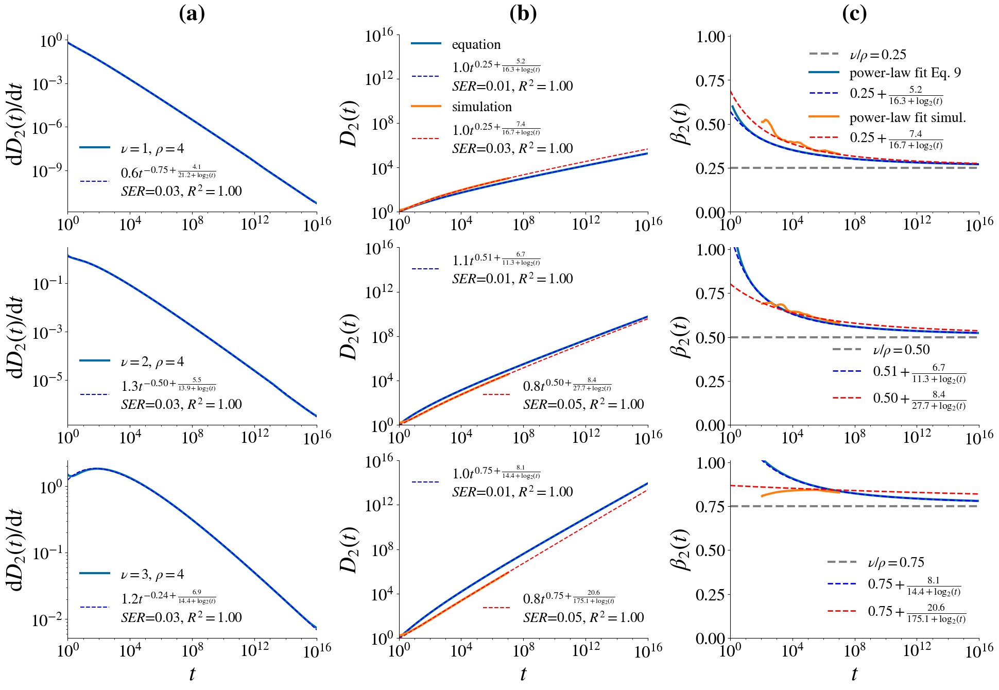

In [184]:
rho = 4
expMin = 0
expMax = 16
_ = simulation_vs_analytic_plot_SI(
    rho, results_simulations_long,fontsize_legend=20,
    lower_bound = 10**expMin, upper_bound = 10**expMax,
    expMin=expMin,expMax=expMax,
    use_odeint=True, 
    max_num_major_xticks = 5, 
    use_approximated=True,
)

1
ERROR (c) 
2
ERROR (c) 
3
ERROR (c) 


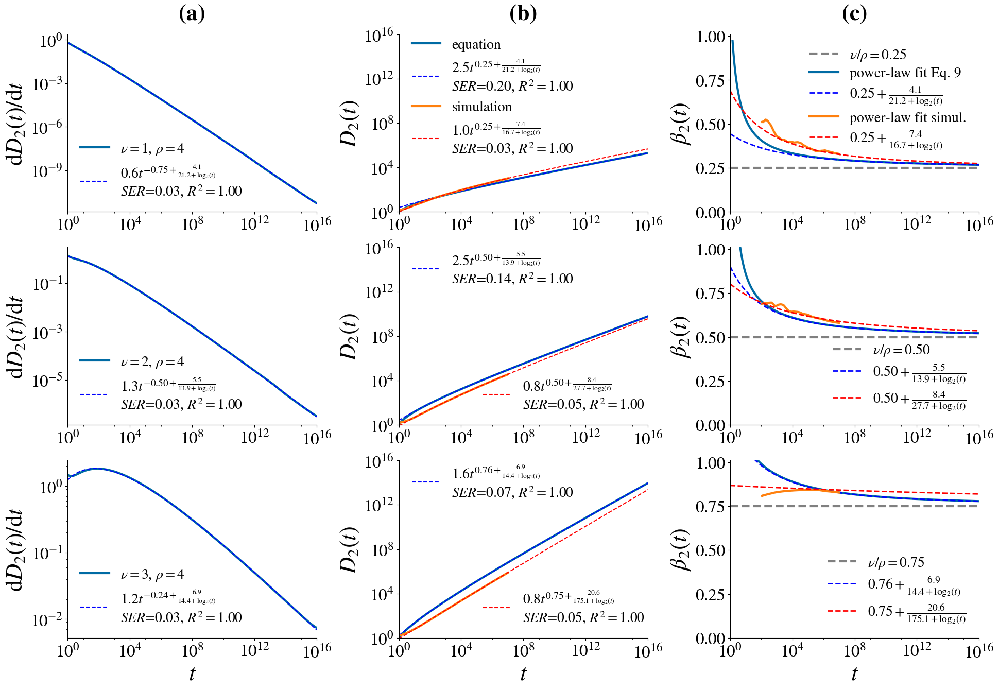

In [185]:
rho = 4
expMin = 0
expMax = 16
_ = simulation_vs_analytic_plot_SI(
    rho, results_simulations_long,fontsize_legend=20,
    lower_bound = 10**expMin, upper_bound = 10**expMax,
    expMin=expMin,expMax=expMax,
    use_odeint=False, 
    max_num_major_xticks = 5, 
    use_approximated=True,
)

### Triplets

#### Functions

In [187]:
def fit_to_str(a,b,c,d):
#     return r"$%.1f t^{%.2f+%.1f/(%.1f+\log_2(t))}$"%(a,b,c,d)
    return r"$%.1f t^{%.2f+\frac{%.1f}{%.1f+\log_2(t)}}$"%(a,b,c,d)


def plot_dD3(analytic_data, nu, rho, ax, results_simulations, fontsize=16, print_all_legend_labels = True, use_approximated=True):
    xs = np.array(list(analytic_data.t))
    Cs = np.array(list(analytic_data.data))
    beta_1 = float(nu)/rho
    b = (rho - nu)**beta_1
    dD1 = b * beta_1 * (xs ** (beta_1 - 1))
    dD2_popt_log = results_simulations[1][rho][nu]['parameters_dD2']
    e=1
    f=0
    def func(x,a,b,c,d):
        return a * x ** (b+c/(d+np.log2(e*x))) + f
    dD2 = func(xs,*dD2_popt_log)
    ys = dD2 + dD1 + Cs

    
    if print_all_legend_labels:
        ax.plot(xs,ys, lw=3, label=r"$\nu = %d, \, \rho = %d$"%(nu,rho))
    else:
        ax.plot(xs,ys, lw=3) 
    def func_log(x,a,b,c,d):
        return np.log2(a) + x * (b+c/(d+np.log2(e*2**x))) 
    xs_log = np.log2(xs)
    ys_log = np.log2(ys)
    try:
        raise RuntimeError
        popt_log_B, pcov = curve_fit(func_log, xs_log, ys_log,p0=[1,nu/rho-1,1,1], bounds=([0,-1,0,0], [np.inf,0,np.inf,np.inf]))
    except RuntimeError as er:
        print('ERROR (a)',er)
        popt_log_B, pcov = curve_fit(func_log, xs_log, ys_log,bounds=([0,nu/rho-0.000000001-1,0,0.1], [np.inf,nu/rho+0.000000001-1,np.inf,np.inf]))
    a,b,c,d = popt_log_B
    b_old = b
    residuals = ys - func(xs, *popt_log_B)
    ss_res = np.sqrt(np.sum(residuals**2)/(len(residuals)-2))
    residuals = ys_log - func_log(xs_log, *popt_log_B)
    ss_res_log = np.sqrt(np.sum(residuals**2)/(len(residuals)-2))
    R_squared = 1-(ss_res**2)/np.var(ys)
    R_squared_log = 1-(ss_res_log**2)/np.var(ys_log)
    ax.plot(xs, func(xs,*popt_log_B), 'b--',
             label=fit_to_str(a,b,c,d) + 
            "\n"+r"$SER$=%.2f"%ss_res_log + r", $R^2=%.2f$"%(R_squared_log))

    exponents_log = np.array([b+c*d/((d+np.log2(e*x))**2) for x in xs])

    ax.set_xscale("log")
    ax.set_yscale("log")
    if nu/rho < 0.:
        ax.legend(fontsize=fontsize, loc = "upper right") 
    else:
        ax.legend(fontsize=fontsize, loc = "lower left")
    ax.set_xlabel(r"$t$")
    ax.set_ylabel(r"$\mathrm{d}D_3(t)/\mathrm{d}t}$")
    
    return popt_log_B

In [199]:
def exp_to_str(a,b,c,d):
#         return r"$%.2f+%.1f/(%.1f+\log_2(t))$"%(b,c,d)
    return r"$%.2f+\frac{%.1f}{%.1f+\log_2(t)}$"%(np.round(b,decimals=2),np.round(c, decimals=1),np.round(d, decimals=1))
    
def plot_D3(analytic_data,mean_urn, popt_log_B, nu, rho, ax, expMax=16, fontsize=16, 
            print_all_legend_labels = True,
            use_odeint = False,
           ):
    from scipy.integrate import odeint
    def func(x,a,b,c,d,e=1,f=0):#,x2):
        return a * x ** (b+c/(d+np.log2(e*x))) + f
    t0 = 1 
    y0 = 1 
    e=1
    f=0
    ts_system = np.geomspace(t0,10**expMax,10000)
    if use_odeint == True:
        # y'(t) = func(t,a,b,c,d)
        def system(y, t, *popt_log_B):
            dy = [func(t,*popt_log_B)]
            return dy
        a,b,c,d = popt_log_B
        sol = odeint(system, y0 , ts_system, args=(a,b,c,d))
        sol = np.transpose(sol)[0]
    else:
        a,b,c,d = popt_log_B
        b += 1
        a /= b
        sol = func(ts_system,a,b,c,d)
        popt_log = (a,b,c,d)
        sol = sol - sol[0] + 1
    
    last_to_check = 100
    mean_urn["new_analytic3_loglogregr_points"] = np.array([powerLawRegrPoints(ts_system[max(0,i-last_to_check):i], sol[max(0,i-last_to_check):i])[0]
                                               for i in range(last_to_check,len(ts_system))])
    mean_urn["new_analytic3_loglogregr_points_xs"] = ts_system[last_to_check:]


    if print_all_legend_labels:
        label1 = r"equation"
    else:
        label1 = ""
    p1, = ax.plot(ts_system,sol, label=label1, lw=3)
    def func_log(x,a,b,c,d):
        return np.log2(a) + x * (b+c/(d+np.log2(e*2**x))) 
    ts_log = np.log2(ts_system)
    sol_log = np.log2(sol)
    if use_odeint == True:
        try:
            raise RuntimeError
            popt_log, pcov = curve_fit(func_log, ts_log, sol_log,p0=[1,float(nu)/rho,1,1], bounds=([0,0,0,0], [2,1,100,100]))
        except RuntimeError as er:
            print('ERROR (b)',er)
            popt_log, pcov = curve_fit(func_log, ts_log, sol_log,p0=[1,float(nu)/rho,1,1],bounds=([0,float(nu)/rho-0.000000001,0,0.1], [2,nu/rho+0.000000001,100,100]))
        a,b,c,d = popt_log
    b_free = b
    exp_law_free = exp_to_str(a,b,c,d)
    residuals = sol - func(ts_system, *popt_log)
    ss_res = np.sqrt(np.sum(residuals**2)/(len(residuals)-2))
    residuals = sol_log - func_log(ts_log, *popt_log)
    ss_res_log = np.sqrt(np.sum(residuals**2)/(len(residuals)-2))
    R_squared = 1-(ss_res**2)/np.var(sol)
    R_squared_log = 1-(ss_res_log**2)/np.var(sol_log)
    label2 = fit_to_str(a,b,c,d) + "\n"+r"$SER$=%.2f"%ss_res_log + r", $R^2=%.2f$"%(R_squared_log)
    p2, = ax.plot(ts_system, func(ts_system,*popt_log), 'b--',label=label2)
    exponents_eq = np.array([b+c*d/((d+np.log2(e*x))**2) for x in ts_system])
    
    mean_urn['eq_fit_beta3_xs'] = ts_system
    mean_urn['eq_fit_beta3'] = exponents_eq

    
    if print_all_legend_labels:
        label3 = r"simulation"
    else:
        label3 = ""
    
    p3, = ax.plot(mean_urn["ts_geom"][2:]-2,mean_urn["D3_indices"][mean_urn['indices_geom']][2:], label= label3, lw=3)
    def func_log(x,a,b,c,d):
        return np.log2(a) + x * (b+c/(d+np.log2(e*2**x))) 
    ts_log = np.log2(mean_urn["ts_geom"][2:]-2)
    D3_indices_log = np.log2(mean_urn["D3_indices"][mean_urn['indices_geom']][2:])
    try:
        raise RuntimeError
        popt_sim, pcov = curve_fit(func_log, ts_log[30:], D3_indices_log[30:],p0=[1,float(nu)/rho,1,1],bounds=([0,0,0,0], [2,1,1000,1000]))
    except RuntimeError as er:
        print('ERROR (c)',er)
        popt_sim, pcov = curve_fit(func_log, ts_log, D3_indices_log,p0=[1,float(nu)/rho,1,1],bounds=([0,nu/rho-0.000000001,0,0], [1000,nu/rho+0.000000001,1000,1000]))
    a,b,c,d = popt_sim 
    b_sim = b
    exp_law_sim = exp_to_str(a,b,c,d)
    residuals = mean_urn["D3_indices"][mean_urn['indices_geom']][2:] - func(mean_urn["ts_geom"][2:]-2, *popt_sim)
    ss_res = np.sqrt(np.sum(residuals**2)/(len(residuals)-2))
    residuals = D3_indices_log - func_log(ts_log, *popt_sim)
    ss_res_log = np.sqrt(np.sum(residuals**2)/(len(residuals)-2))
    R_squared = 1-(ss_res**2)/np.var(mean_urn["D3_indices"][mean_urn['indices_geom']][2:])
    R_squared_log = 1-(ss_res_log**2)/np.var(D3_indices_log)
    label4 = fit_to_str(a,b,c,d) + "\n"+r"$SER$=%.2f"%ss_res_log + r", $R^2=%.2f$"%(R_squared_log)
    p4, = ax.plot(mean_urn["ts_geom"][2:]-2, func(mean_urn["ts_geom"][2:]-2,*popt_sim), 'r--',
             label=label4)
    exponents_sim = np.array([b+c*d/((d+np.log2(e*x))**2) for x in ts_system])# mean_urn["ts_geom"]])
    
    mean_urn['sim_fit_beta3_xs'] = ts_system# mean_urn['ts_geom']
    mean_urn['sim_fit_beta3'] = exponents_sim

#     # REPEAT FOR D
    
#     ts_log = np.log2(mean_urn["ts_geom"])
#     D_indices_log = np.log2(mean_urn["D_indices"][mean_urn["indices_geom"]])
#     # popt_sim, pcov = curve_fit(func_log, ts_log, D2_indices_log,bounds=([0,0,0,0], [10,1,100,100]))
#     try:
#         raise RuntimeError
# #         popt_sim, pcov = curve_fit(func_log, ts_log, D2_indices_log,p0=[1,nu/rho,1,1],bounds=([0,0,0,0], [1,1,np.inf,np.inf]))
#         popt_sim, pcov = curve_fit(func_log, ts_log, D_indices_log,p0=[1,nu/rho,1,1],bounds=([0.9,0,0,0], [1,np.inf,np.inf,np.inf]))
#     except RuntimeError as er:
#         print('ERROR (d)',er)
#         popt_sim, pcov = curve_fit(func_log, ts_log, D_indices_log,p0=[1,nu/rho,1,1],bounds=([0,nu/rho-0.000000001,0,0], [np.inf,nu/rho+0.000000001,np.inf,np.inf]))
#     a,b,c,d = popt_sim # [2.30976089, -0.52648358,  4.94643769,  7.35037396]
#     b_sim = b
#     exp_law_sim = exp_to_str(a,b,c,d)
# #     print(popt_sim)
#     residuals = mean_urn["D2_indices"][mean_urn["indices_geom"]] - func(mean_urn["ts_geom"], *popt_sim)
#     ss_res = np.sqrt(np.sum(residuals**2)/(len(residuals)-2))
#     residuals = D_indices_log - func_log(ts_log, *popt_sim)
#     ss_res_log = np.sqrt(np.sum(residuals**2)/(len(residuals)-2))
#     R_squared = 1-(ss_res**2)/np.var(mean_urn["D2_indices"][mean_urn["indices_geom"]])
#     R_squared_log = 1-(ss_res_log**2)/np.var(D2_indices_log)
#     labelD = 'fit: %s'%fit_to_str(a,b,c,d) + "\n"+r"$SER$=%.2f"%ss_res_log + r", $R^2=%.2f$"%(R_squared_log)
#     exponents_simD = np.array([b+c*d/((d+np.log2(e*x))**2) for x in ts_system])# mean_urn["ts_geom"]])

#     mean_urn['sim_fit_beta_xs'] = ts_system# mean_urn["ts_geom"]
#     mean_urn['sim_fit_beta'] = exponents_simD
    
    
    ax.set_xlim(left=100, right = 1e7)
    ax.set_ylim(bottom=1, top=1e7)
    
    if nu/rho < 0.4:
        ax.legend(fontsize=fontsize, loc='upper left', bbox_to_anchor=(0., 1.05)) # loc = "upper left")
    else:
        if print_all_legend_labels:
            l1 = ax.legend([p1, p2],[label1,label2], fontsize=fontsize, loc='upper left', bbox_to_anchor=(0., 1.05)) #, loc="upper left")
            l2 = ax.legend([p3, p4],[label3,label4], fontsize=fontsize, loc='lower right', bbox_to_anchor=(1.04, 0)) # , loc="lower right")
        else:
            l1 = ax.legend([p2],[label2], fontsize=fontsize, loc='upper left', bbox_to_anchor=(0., 1.05)) #, loc="upper left")
            l2 = ax.legend([p4],[label4], fontsize=fontsize, loc='lower right', bbox_to_anchor=(1.04, 0)) # , loc="lower right")
        ax.add_artist(l1)

    ax.set_xscale("log")
    ax.set_yscale("log")
    ax.set_xlabel(r"$t$")
    ax.set_ylabel(r"$D_3(t)$")

    return mean_urn, ts_system, exponents_eq, exponents_sim, exp_law_free, exp_law_sim

In [200]:
def final_plot_fits_D3(urn, nu, rho, ax, exp_law_free, exp_law_sim,fontsize=16, print_all_legend_labels = True, max_num_major_xticks = 5):
    ax.axhline(nu/rho,ls="--",color="gray",lw=3,label=r"$\nu/\rho=%.2f$"%(nu/rho))
    ax.plot(urn["new_analytic3_loglogregr_points_xs"],np.array(urn["new_analytic3_loglogregr_points"]),lw=3, color = CB_color_cycle[0], 
            label = "power-law fit Eq. 31" if print_all_legend_labels else None) # label = r"$\beta_2$ (eq. p.l. fit)")
    ax.plot(urn["eq_fit_beta3_xs"], np.array(urn["eq_fit_beta3"]),ls='--',lw=2, color = "blue", #CB_color_cycle[0], 
            label = fr"{exp_law_free}") # label = r"$\beta_2$ (eq. an. fit)")
    ax.plot(urn["ts_geom"][100:], np.array(urn["beta3_loglogregr_indices_geom"])[100:],lw=3, color = CB_color_cycle[1], 
            label = "power-law fit simul." if print_all_legend_labels else None) # label = r"$\beta_2$ (sim. p.l. fit)")
    ax.plot(urn["sim_fit_beta3_xs"], np.array(urn["sim_fit_beta3"]),ls='--',lw=2, color = "red", #CB_color_cycle[1], 
            label = fr"{exp_law_sim}") # label = r"$\beta_2$ (sim. an. fit)")
    
#     if print_all_legend_labels:
    if nu/rho > 0.4:
        ax.legend(fontsize=fontsize, loc = "lower right", labelspacing = 0.3,)
    else:
        ax.legend(fontsize=fontsize, loc = "upper right", labelspacing = 0)

    
    ax.set_xlim((100,Tmax))
    ax.set_ylim((0,1.01))
    ax.set_xscale("log")
    ax.set_xlabel(r"$t$")
    ax.set_ylabel(r"$\beta_3(t)$")
    # Impose xticks
    locmaj = matplotlib.ticker.LogLocator(base=10,numticks=max_num_major_xticks) 
    ax.xaxis.set_major_locator(locmaj)
    # locmin = matplotlib.ticker.LogLocator(base=10.0,subs=(np.arange(0.1,1,0.1)),numticks=20)
    locmin = matplotlib.ticker.LogLocator(base=10.0,numticks=100)
    ax.xaxis.set_minor_locator(locmin)
    ax.xaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
    return None

In [201]:
def simulation_vs_analytic_plot_D3(rho, results_simulations,
                                fontsize_legend=16, lower_bound = 1e3, upper_bound = 1e7, 
                                use_approximated=True, expMin=3, expMax=7, 
                                   max_num_major_xticks = 5,
                                use_odeint=False,):
    Tmax = int(1e7)
    eta = 1
    counter = 0
    letters = "ABCDEFGHIJKLMNOPQRSTUVWXYZ".lower()
    fig, axes = plt.subplots(rho-1,3,figsize=(width_fig,width_fig*2/3*(rho-1)/3), gridspec_kw={'hspace':.2,'wspace':0.33})
    for row,nu in enumerate(range(1,rho)):
        print(nu)
        if row == 0:
            print_all_legend_labels = True
        else:
            print_all_legend_labels = False
        mean_urn = results_simulations[eta][rho][nu]
        indices = mean_urn["indices"]
        indices_geom = mean_urn["indices_geom"]
        ts = mean_urn["ts"]
        ts_geom = mean_urn["ts_geom"]

        if expMax <= 7:
            analytic_data = pd.read_csv(f"./data/UMST/Analytic_UMT/Analytic_data_independent_triplet/rho{rho}_nu{nu}_expMin{expMin}_expMax{expMax}_data.csv",names=["t","data"])
        else:
            analytic_data = pd.read_csv(f"./data/UMST/Analytic_UMT/Analytic_data_independent_triplet/rho{rho}_nu{nu}_expMin{expMin}_expMax{7}_data.csv",names=["t","data"])
            analytic_data2 = pd.read_csv(f"./data/UMST/Analytic_UMT/Analytic_data_independent_triplet/rho{rho}_nu{nu}_expMin{7}_expMax{10}_data.csv",names=["t","data"])
            analytic_data2.drop(analytic_data2.index[0], inplace=True)
            analytic_data = analytic_data.append(analytic_data2, ignore_index=True)
            if expMax > 10:
                analytic_data2 = pd.read_csv(f"./data/UMST/Analytic_UMT/Analytic_data_independent_triplet/rho{rho}_nu{nu}_expMin{10}_expMax{20}_data.csv",names=["t","data"])
                analytic_data2.drop(analytic_data2.index[0], inplace=True)
                analytic_data = analytic_data.append(analytic_data2, ignore_index=True)
            analytic_data = analytic_data[analytic_data.t <= 10**expMax]
#         analytic_data.data = analytic_data.data.apply(lambda x:min(x,1))
        
        ax = axes[row,0] if rho > 2 else axes[0]
        popt_log_B = plot_dD3(analytic_data, nu, rho, ax, results_simulations, fontsize=fontsize_legend, print_all_legend_labels=True,use_approximated=use_approximated)
        results_simulations[eta][rho][nu]['parameters_dD3'] = popt_log_B
        if nu != rho-1:
            ax.set_xlabel("")
        if row == 0:
            ax.text(0.5, 1.08, f"({letters[counter]})", transform=ax.transAxes, fontweight='bold', horizontalalignment='center')
        ax.set_xlim(lower_bound, upper_bound)
        # Impose xticks
        locmaj = matplotlib.ticker.LogLocator(base=10,numticks=max_num_major_xticks) 
        ax.xaxis.set_major_locator(locmaj)
        # locmin = matplotlib.ticker.LogLocator(base=10.0,subs=(np.arange(0.1,1,0.1)),numticks=20)
        locmin = matplotlib.ticker.LogLocator(base=10.0,numticks=100)
        ax.xaxis.set_minor_locator(locmin)
        ax.xaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
#         ax.set_xticks([10**3, 10**5, 10**7])
        counter += 1
        
        ax = axes[row,1] if rho > 2 else axes[1]
        mean_urn, ts_system, exponents_eq, exponents_sim, exp_law_eq, exp_law_sim = plot_D3(
            analytic_data, mean_urn, popt_log_B, nu, rho, ax, 
            expMax=expMax,
            fontsize=fontsize_legend, 
            print_all_legend_labels=print_all_legend_labels,
            use_odeint = use_odeint, 
        )
        if nu != rho-1:
            ax.set_xlabel("")
        if row == 0:
            ax.text(0.5, 1.08, f"({letters[counter]})", transform=ax.transAxes, fontweight='bold', horizontalalignment='center')
        ax.set_xlim(lower_bound, upper_bound)
#         ax.set_xticks([10**3, 10**5, 10**7])
        counter += 1
        ax.set_ylim(1,upper_bound)
        
        # Impose xticks
        locmaj = matplotlib.ticker.LogLocator(base=10,numticks=max_num_major_xticks) 
        ax.xaxis.set_major_locator(locmaj)
        # locmin = matplotlib.ticker.LogLocator(base=10.0,subs=(np.arange(0.1,1,0.1)),numticks=20)
        locmin = matplotlib.ticker.LogLocator(base=10.0,numticks=100)
        ax.xaxis.set_minor_locator(locmin)
        ax.xaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
        

        ax = axes[row,2] if rho > 2 else axes[2]
        final_plot_fits_D3(
            mean_urn, nu, rho, ax, exp_law_eq, exp_law_sim,
            fontsize=fontsize_legend, 
            print_all_legend_labels=print_all_legend_labels,
            max_num_major_xticks = max_num_major_xticks, 
        )
        
        if nu != rho-1:
            ax.set_xlabel("")
        if row == 0:
            ax.text(0.5, 1.08, f"({letters[counter]})", transform=ax.transAxes, fontweight='bold', horizontalalignment='center')
        ax.set_xlim(lower_bound, upper_bound)
# #         ax.set_xticks([10**3, 10**5, 10**7])
#         ax.set_ylabel(r"$\beta_n$")
        counter += 1
        # Impose xticks
        locmaj = matplotlib.ticker.LogLocator(base=10,numticks=max_num_major_xticks) 
        ax.xaxis.set_major_locator(locmaj)
        # locmin = matplotlib.ticker.LogLocator(base=10.0,subs=(np.arange(0.1,1,0.1)),numticks=20)
        locmin = matplotlib.ticker.LogLocator(base=10.0,numticks=100)
        ax.xaxis.set_minor_locator(locmin)
        ax.xaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
        
    if use_odeint == True:
        fig.savefig(os.path.join(figures_folder, f"FigSI_D3_UMT_numeric_vs_analytic_rho_%d_odeint.png"%(rho)))
        fig.savefig(os.path.join(figures_folder, f"FigSI_D3_UMT_numeric_vs_analytic_rho_%d_odeint.pdf"%(rho)))
    else:
        fig.savefig(os.path.join(figures_folder, f"FigSI_D3_UMT_numeric_vs_analytic_rho_%d_from_dD3.png"%(rho)))
        fig.savefig(os.path.join(figures_folder, f"FigSI_D3_UMT_numeric_vs_analytic_rho_%d_from_dD3.pdf"%(rho)))
        
    return(results_simulations)

#### Figures

In [260]:
with open('./data/simulations/rho_4.00000/nu_1/Tmax_10000000/eta_1.00000/UMT_light_run_38.pkl', 'rb') as fp:
    tmp = pickle.load(fp)

In [261]:
tmp.keys()

dict_keys(['ts', 'indices', 'ts_geom', 'indices_geom', 'D_indices', 'D2_indices', 'D3_indices', 'D4_indices', 'weighted_diff_entropies', 'beta_mean_indices', 'beta2_mean_indices', 'beta3_mean_indices', 'beta4_mean_indices', 'beta_loglogregr_indices_geom', 'beta2_loglogregr_indices_geom', 'beta3_loglogregr_indices_geom', 'beta4_loglogregr_indices_geom', 'intercept_loglogregr_indices_geom', 'intercept2_loglogregr_indices_geom', 'intercept3_loglogregr_indices_geom', 'intercept4_loglogregr_indices_geom', 'std_err_beta_loglogregr_indices_geom', 'std_err_beta2_loglogregr_indices_geom', 'std_err_beta3_loglogregr_indices_geom', 'std_err_beta4_loglogregr_indices_geom', 'std_err_intercept_loglogregr_indices_geom', 'std_err_intercept2_loglogregr_indices_geom', 'std_err_intercept3_loglogregr_indices_geom', 'std_err_intercept4_loglogregr_indices_geom'])

In [250]:
eta = .1
rho = 4
nu = 1
mean_urn = results_simulations_long[eta][rho][nu]
indices = mean_urn["indices"]
indices_geom = mean_urn["indices_geom"]
ts = mean_urn["ts"]
ts_geom = mean_urn["ts_geom"]
D = mean_urn["D_indices"]
D2 = mean_urn["D2_indices"]
D3 = mean_urn["D3_indices"]

In [251]:
len(ts), len(indices), len(D), len(D2), len(indices_geom), len(mean_urn["beta3_loglogregr_indices_geom"])

(1803, 1803, 1803, 1803, 805, 805)

In [262]:
results = tmp
if results['ts'][-1] == Tmax - 1 or results['D_indices'][0] > 1:
        # adjust the results from the old setup to the new one
        right_len_indices = len(results['indices'])+1
        right_len_indices_geom = len(results['indices_geom'])+1
        for _ in results.keys():
            if _ in ['indices','indices_geom']:
                results[_] = [1] + list(np.array(results[_])+1)
            elif _ in ['ts', 'ts_geom']:
                results[_] = np.array([1] + list(np.array(results[_])+1))
            elif _ in ['D_indices']:
                results[_] = np.array([1] + list(np.array(results[_])))
            elif _ in ['D2_indices', 'D3_indices','D4_indices']:
                results[_] = np.array([0] + list(np.array(results[_])))
            else:
                if 'geom' in _ and len(_) == right_len_indices_geom - 1:
                    results[_] = np.array(list(results[_])+results[_][-1])
                elif len(_) == right_len_indices - 1:
                    results[_] = np.array(list(results[_])+results[_][-1])
                else:
                    print('problem with', _,)

problem with weighted_diff_entropies
problem with beta_mean_indices
problem with beta2_mean_indices
problem with beta3_mean_indices
problem with beta4_mean_indices
problem with beta_loglogregr_indices_geom
problem with beta2_loglogregr_indices_geom
problem with beta3_loglogregr_indices_geom
problem with beta4_loglogregr_indices_geom
problem with intercept_loglogregr_indices_geom
problem with intercept2_loglogregr_indices_geom
problem with intercept3_loglogregr_indices_geom
problem with intercept4_loglogregr_indices_geom
problem with std_err_beta_loglogregr_indices_geom
problem with std_err_beta2_loglogregr_indices_geom
problem with std_err_beta3_loglogregr_indices_geom
problem with std_err_beta4_loglogregr_indices_geom
problem with std_err_intercept_loglogregr_indices_geom
problem with std_err_intercept2_loglogregr_indices_geom
problem with std_err_intercept3_loglogregr_indices_geom
problem with std_err_intercept4_loglogregr_indices_geom


In [265]:
right_len_indices

1804

In [266]:
results['indices']

[1,
 2,
 3,
 4,
 5,
 6,
 7,
 8,
 9,
 10,
 11,
 12,
 13,
 14,
 15,
 16,
 17,
 18,
 19,
 20,
 21,
 22,
 23,
 24,
 25,
 26,
 27,
 28,
 29,
 30,
 31,
 32,
 33,
 34,
 35,
 36,
 37,
 38,
 39,
 40,
 41,
 42,
 43,
 44,
 45,
 46,
 47,
 48,
 49,
 50,
 51,
 52,
 53,
 54,
 55,
 56,
 57,
 58,
 59,
 60,
 61,
 62,
 63,
 64,
 65,
 66,
 67,
 68,
 69,
 70,
 71,
 72,
 74,
 75,
 76,
 77,
 78,
 80,
 81,
 82,
 84,
 85,
 86,
 88,
 89,
 91,
 92,
 94,
 95,
 97,
 98,
 100,
 101,
 103,
 105,
 106,
 108,
 110,
 112,
 113,
 115,
 117,
 119,
 121,
 123,
 125,
 127,
 129,
 131,
 133,
 135,
 138,
 140,
 142,
 144,
 147,
 149,
 152,
 154,
 157,
 159,
 162,
 164,
 167,
 170,
 172,
 175,
 178,
 181,
 184,
 187,
 190,
 193,
 196,
 199,
 202,
 206,
 209,
 212,
 216,
 219,
 223,
 227,
 230,
 234,
 238,
 242,
 246,
 250,
 254,
 258,
 262,
 266,
 271,
 275,
 279,
 284,
 289,
 293,
 298,
 303,
 308,
 313,
 318,
 323,
 328,
 334,
 339,
 344,
 350,
 356,
 362,
 367,
 373,
 379,
 386,
 392,
 398,
 405,
 411,
 418,
 425,
 432,
 4

In [264]:
len(results['beta_mean_indices'])

1803

[]

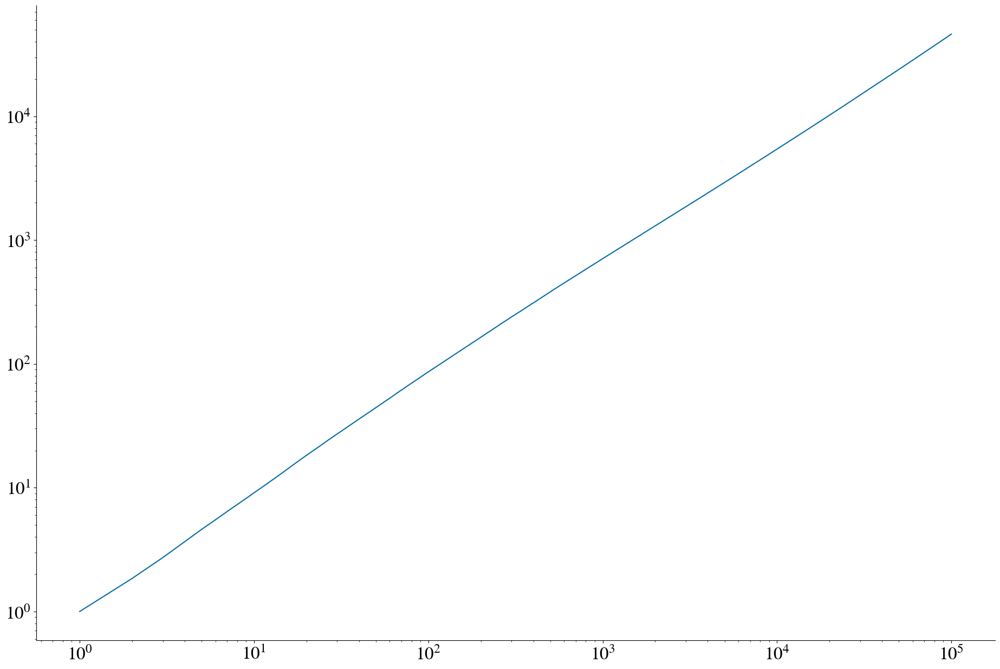

In [207]:
plt.plot(mean_urn["ts_geom"][2:]-2,mean_urn["D3_indices"][mean_urn['indices_geom']][2:])
plt.loglog()

1
ERROR (a) 
ERROR (b) 
ERROR (c) 
2
ERROR (a) 
ERROR (b) 
ERROR (c) 
3
ERROR (a) 
ERROR (b) 
ERROR (c) 


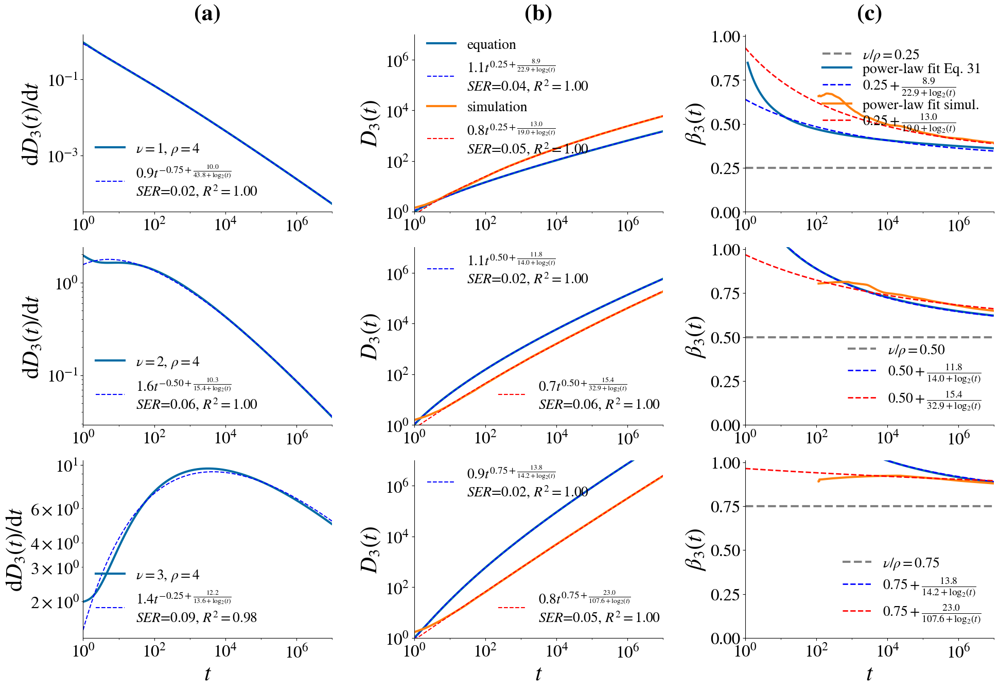

In [202]:
expMax = 7
_ = simulation_vs_analytic_plot_D3(4, results_simulations_long,fontsize_legend=20,
                                       lower_bound = 1e0, upper_bound = 10**(expMax),
                                       expMin=0,expMax=expMax,
                                   max_num_major_xticks = 5,
                                       use_odeint=True, 
                                       use_approximated=True,)